In [1]:
import os
import sys
import json
import ipaddress
import numpy as np
from torch import nn
from sklearn.model_selection import train_test_split

class Resource:
  def __init__(self, RequestID, Site, LoadURL, LoadDomain, 
      Type, MimeType, RemoteIPAddr, ModTime):
    self.request_id = RequestID
    self.site = Site
    self.load_url = LoadURL
    self.load_domain = LoadDomain
    self.resource_type = Type
    self.mimetype = MimeType
    self.ip_addr = RemoteIPAddr
    self.mod_time = ModTime

# Function to parse and create Resources from JSON
def extract_from_JSON(filename):
    ip_to_occurrences = dict()
    ip_to_sites = dict()
    site_date_ipset = dict()
    with open(filename) as f:
        for line in f:
            data = json.loads(line)
            resource = Resource(data["RequestID"], data["Site"], data["LoadURL"], 
                                data["LoadDomain"], data["Type"], data["MimeType"], 
                                data["RemoteIPAddr"], data["ModTime"])
            
            # For ip occurrence filtering in entire dataset
            ip_to_occurrences.setdefault(resource.ip_addr, set())
            occurrence_event = resource.mod_time + " " + resource.site
            ip_to_occurrences[resource.ip_addr].add(occurrence_event)
    
            # For ips unique to a website
            ip_to_sites.setdefault(resource.ip_addr, set())
            ip_to_sites[resource.ip_addr].add(resource.site)
            
            # extracting samples
            site_date_ipset.setdefault(resource.site, dict())
            site_date_ipset[resource.site].setdefault(resource.mod_time, set())
            site_date_ipset[resource.site][resource.mod_time].add(resource.ip_addr)
    return ip_to_occurrences, ip_to_sites, site_date_ipset

In [3]:
filename = "../output/02-25-2020_maj-4k_output.json"
add_name = filename.split("/")[2].split(".")[0]
print(add_name)
ip_to_occurrences, ip_to_sites, site_date_ipset = extract_from_JSON(filename)

02-25-2020_maj-4k_output


In [4]:
print(len(site_date_ipset), len(ip_to_occurrences), len(ip_to_sites))

3620 63003 63003


In [5]:
# filtering passes: 
ips_to_remove = set()
for ip in ip_to_occurrences:
    occurrences = ip_to_occurrences[ip]
    if len(occurrences) < 20:
       ips_to_remove.add(ip)

for ip in ips_to_remove:
    try:
        del ip_to_occurrences[ip]
        del ip_to_sites[ip]
    except KeyError:
        print(ip, " Not Present")
     
unique_ip_to_site = dict()
# Does it make sense to filter the site out?
for ip in ip_to_sites:
    if len(ip_to_sites[ip]) == 1:
        site = ip_to_sites[ip].pop()
        unique_ip_to_site[ip] = site
        try:
            del site_date_ipset[site]
        except KeyError:
            pass
            #print(site, " Not Present in map")
        try:
            del ip_to_occurrences[ip]
        except KeyError:
            pass
            #print(ip, " Not Present")

# ip_to_occurrences holds all ips after filtering
try:
    del site_date_ipset["!"]
except KeyError:
    print(site, " Not Present in map")

zzxinguangda.com  Not Present in map


In [6]:
print(len(site_date_ipset.keys()))

923


In [7]:
# create site to encoded ipset mapping
labels = []
encodings = []
all_ips = list(ip_to_occurrences.keys())
print(len(all_ips))
for site in site_date_ipset:
    date_to_ipset = site_date_ipset[site]
    for date in date_to_ipset:
        ipset = date_to_ipset[date]
        iparray = [0] * len(all_ips)
        for ip in ipset:
            if ip in ip_to_occurrences:
                iparray[all_ips.index(ip)] = 1
        labels.append(site)
        encodings.append(np.asarray(iparray))

print(len(labels), len(encodings))
                

14291
20553 20553


In [9]:
print(len(labels), len(encodings[0]))

20553 14291


In [10]:
import pyasn
asndb = pyasn.pyasn('pyasn')
asn_set = set()
ip_to_asn = dict()
for ip in ip_to_occurrences:
    try:
        asn,_= asndb.lookup(ip)
        ip_to_asn[ip] = asn
        asn_set.add(asn)
    except:
        print(ip, " not mapped to asn")
        continue

  not mapped to asn


In [11]:
sites_asn = []
asn_enc = []
asn_list = list(asn_set)
for site in site_date_ipset:
    date_to_ipset = site_date_ipset[site]
    for date in date_to_ipset:
        ipset = date_to_ipset[date]
        asn_array = [0]*len(asn_list)
        for ip in ipset:
            if ip in ip_to_occurrences:
                try:
                    asn_array[asn_list.index(ip_to_asn[ip])] = 1
                except Exception as e:
                    continue
        sites_asn.append(site)
        asn_enc.append(np.asarray(asn_array))

In [13]:
print(len(sites_asn), len(asn_enc[0]))
print(len(labels), len(encodings[0]))

20553 434
20553 14291


In [14]:
import torch.nn.functional as F
class NNet(nn.Module):
    def __init__(self, input_size, output_size):
        super(NNet, self).__init__()
        self.fc1 = nn.Linear(input_size, 400)
#         self.fc2 = nn.Linear(400, 100)
        self.fc3 = nn.Linear(400, output_size)
    
    def forward(self, x):
        x = self.fc1(x)
#         x = self.fc2(x)
        return self.fc3(x)

In [15]:
from sklearn import preprocessing
import torch

tensor_encodings = torch.Tensor(encodings)
le_labels = preprocessing.LabelEncoder()
tensor_labels = le_labels.fit_transform(labels)
tensor_labels = torch.as_tensor(tensor_labels)

tensor_asn_enc = torch.Tensor(asn_enc)
le_asn = preprocessing.LabelEncoder()
tensor_sites_asn = le_asn.fit_transform(sites_asn)
tensor_sites_asn = torch.as_tensor(tensor_sites_asn)

In [16]:
import torch.utils.data as data

ip_dataset = data.TensorDataset(tensor_encodings,tensor_labels)
asn_dataset = data.TensorDataset(tensor_asn_enc,tensor_sites_asn)

batch_size = 64
validation_split = .2
# shuffle_dataset = True
shuffle_dataset = False
# random_seed= 42

train_size = int(0.8 * len(asn_dataset))
test_size = len(asn_dataset) - train_size
asn_train_dataset, asn_test_dataset = torch.utils.data.random_split(asn_dataset, [train_size, test_size])
asn_train_loader = torch.utils.data.DataLoader(asn_train_dataset, batch_size=batch_size, shuffle=True)
asn_test_loader = torch.utils.data.DataLoader(asn_test_dataset, batch_size=batch_size, shuffle=True)
print(len(asn_train_loader.dataset), len(asn_test_loader.dataset))

train_size = int(0.8 * len(ip_dataset))
test_size = len(ip_dataset) - train_size
ip_train_dataset, ip_test_dataset = torch.utils.data.random_split(ip_dataset, [train_size, test_size])
ip_train_loader = torch.utils.data.DataLoader(ip_train_dataset, batch_size=batch_size, shuffle=True)
ip_test_loader = torch.utils.data.DataLoader(ip_test_dataset, batch_size=batch_size, shuffle=True)
print(len(ip_train_loader.dataset), len(ip_test_loader.dataset))

print (len(ip_train_loader)) 
print (len(ip_test_loader))

input_size_ipdataset = len(tensor_encodings[0])
output_size_ipdataset = len(site_date_ipset)
embed_size_ipdataset = 1000

input_size_asndataset = len(tensor_asn_enc[0])
output_size_asndataset = len(site_date_ipset)
embed_size_asndataset = 270
print(input_size_ipdataset, output_size_ipdataset)
print(input_size_asndataset, output_size_asndataset)

model_ip = NNet(input_size_ipdataset, output_size_ipdataset)
model_asn = NNet(input_size_asndataset, output_size_asndataset)

criterion = nn.CrossEntropyLoss(reduction='mean')
optimizer_ip = torch.optim.SGD(model_ip.parameters(), lr=0.5)
optimizer_asn = torch.optim.SGD(model_asn.parameters(), lr=0.5)

len(ip_test_loader.dataset)

16442 4111
16442 4111
257
65
14291 923
434 923


4111

In [21]:
# Reference: https://github.com/hunkim/PyTorchZeroToAll

from torch.autograd import Variable
from sklearn.metrics import confusion_matrix
import time
device = 'cpu'

def confusion_mat(preds, labels, conf_matrix, labels_to_predicted):
    preds = torch.argmax(preds, 1)
#     stacked = torch.stack((labels,preds),dim=1)
    
#     for elem in stacked:
#         t, p = elem.tolist()
#         conf_matrix[p, t] += 1

    for p, t in zip(preds, labels):
        t_class = le_labels.classes_[t.item()]
        p_class = le_labels.classes_[p.item()]
        labels_to_predicted.setdefault(t_class, set())
        labels_to_predicted[t_class].add(p_class)
        conf_matrix[p.item(), t.item()] += 1
    
    return conf_matrix

def train(epoch, train_loader, model, optimizer):
    model.train()
    total_loss = 0.0
    for batch_idx, (data, target) in enumerate(train_loader):
        data, target = data.to(device), target.to(device)
        optimizer.zero_grad()
        output = model(data)
        loss = criterion(output, target)
        total_loss += loss.item() 
        loss.backward()
        optimizer.step()
        if batch_idx % 10 == 0:
            print('Train Epoch: {} | Batch Status: {}/{} ({:.0f}%) | Loss: {:.6f}'.format(
                epoch, batch_idx * len(data), len(train_loader.dataset),
                100. * batch_idx / len(train_loader), loss.item()))
    return total_loss / len(train_loader)

def test(test_loader, model, conf_matrix, labels_to_predicted, top_elems_list, corresponding_target):
    model.eval()
    test_loss = 0
    correct = 0
    for data, target in test_loader:
        data, target = data.to(device), target.to(device)
        output = model(data)
        conf_matrix = confusion_mat(output, target, conf_matrix, labels_to_predicted)
        # sum up batch loss
        test_loss += criterion(output, target).item()
        # get the index of the max
        pred = output.data.max(1, keepdim=True)[1]
        
        print("le_labels.classes_: ", len(le_labels.classes_))
        print("target.tolist(): ", len(target.tolist()), target.tolist()[0])
        top5 = torch.topk(output,5,1)[1]
        print("top5:", top5.size(), target.size())
        for obj in top5.tolist():
            top_elems_list.extend(le_labels.classes_[obj])
            print("added: ", le_labels.classes_[obj])
        for obj in target.tolist():
            corresponding_target.extend(le_labels.classes_[obj])
            print("c_added: ", le_labels.classes_[obj])
        correct += pred.eq(target.data.view_as(pred)).cpu().sum()

    test_loss /= len(test_loader)
    print(f'===========================\nTest set: Average loss: {test_loss:.4f}, Accuracy: {correct}/{len(test_loader.dataset)} '
          f'({100. * correct / len(test_loader.dataset):.0f}%)')
    return test_loss
    
    

In [22]:
# first ip dataset training and tests
since = time.time()
labels_to_predicted_ip = dict()
top_elems_list_ip = []
corresponding_target_ip = []
print(len(ip_train_loader.dataset), len(ip_test_loader.dataset))
print(output_size_ipdataset)
conf_matrix_ip = torch.zeros(output_size_ipdataset, output_size_ipdataset)
train_losses, test_losses = [], []
for epoch in range(1, 10):
    epoch_start = time.time()
    epoch_train_loss = train(epoch, ip_train_loader, model_ip, optimizer_ip)
    train_losses.append(epoch_train_loss)
    m, s = divmod(time.time() - epoch_start, 60)
    print(f'Training time: {m:.0f}m {s:.0f}s')
    epoch_test_loss = test(ip_test_loader, model_ip, conf_matrix_ip, 
                           labels_to_predicted_ip, top_elems_list_ip, corresponding_target_ip)
    test_losses.append(epoch_test_loss)
    m, s = divmod(time.time() - epoch_start, 60)
    print(f'Testing time: {m:.0f}m {s:.0f}s')

m, s = divmod(time.time() - since, 60)
print(f'Total Time: {m:.0f}m {s:.0f}s\nModel was trained on {device}!')

print("conf mat ip: ", conf_matrix_ip)

16442 4111
923
Train Epoch: 1 | Batch Status: 0/16442 (0%) | Loss: 2.342225
Train Epoch: 1 | Batch Status: 640/16442 (4%) | Loss: 2.351604
Train Epoch: 1 | Batch Status: 1280/16442 (8%) | Loss: 2.148056
Train Epoch: 1 | Batch Status: 1920/16442 (12%) | Loss: 1.659266
Train Epoch: 1 | Batch Status: 2560/16442 (16%) | Loss: 1.886311
Train Epoch: 1 | Batch Status: 3200/16442 (19%) | Loss: 2.138616
Train Epoch: 1 | Batch Status: 3840/16442 (23%) | Loss: 1.904439
Train Epoch: 1 | Batch Status: 4480/16442 (27%) | Loss: 2.340776
Train Epoch: 1 | Batch Status: 5120/16442 (31%) | Loss: 2.058167
Train Epoch: 1 | Batch Status: 5760/16442 (35%) | Loss: 2.046124
Train Epoch: 1 | Batch Status: 6400/16442 (39%) | Loss: 2.012095
Train Epoch: 1 | Batch Status: 7040/16442 (43%) | Loss: 1.794796
Train Epoch: 1 | Batch Status: 7680/16442 (47%) | Loss: 1.886737
Train Epoch: 1 | Batch Status: 8320/16442 (51%) | Loss: 1.553441
Train Epoch: 1 | Batch Status: 8960/16442 (54%) | Loss: 1.935210
Train Epoch: 1 | 

le_labels.classes_:  923
target.tolist():  64 608
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['viewco.org' 'aeroinsiderrewards.com' 'corrite.com' 'higinfo.com'
 'keithsweathotel.com']
added:  ['culinate.com' 'hewitthomeschooling.com' 'autocenterofcanton.com'
 'peacockknits.com' 'dailydoseofdaf.com']
added:  ['5pb.jp' 'wikipedia.org' 'sourceware.org' 'i0.wp.com' 'grevin.com']
added:  ['silive.com' 'oregonlive.com' 'elledecor.com' 'roadandtrack.com'
 'gizmodo.com']
added:  ['fb.me' 'web.facebook.com' 'fbcdn.net' 'facebook.com'
 'staticxx.facebook.com']
added:  ['5pb.jp' 'wikipedia.org' 'www.gov.uk' 'sourceware.org' 'cygwin.com']
added:  ['google.nl' 'blogspot.fr' 'withgoogle.com' 'google.com.sa' 'google.ca']
added:  ['5pb.jp' 'wikipedia.org' 'www.gov.uk' 'sourceware.org' 'cygwin.com']
added:  ['archives.gov' 'ofr.gov' '1.usa.gov' 'usa.gov' 'ice.gov']
added:  ['shamlany.com' 'zoraholidays.com' 'culinate.com' 'peacockknits.com'
 'hewitthomeschooling.com']
added:  ['hugedomains.com'

le_labels.classes_:  923
target.tolist():  64 34
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['get.adobe.com' 'acrobat.com' 'adobe.com' 'fpdownload.macromedia.com'
 'photoshop.com']
added:  ['bbc.com' 'bbc.co.uk' 'internetnews.com' 'imdb.com' 'reddit.com']
added:  ['chrome.google.com' 'drive.google.com' 'isc.org' 'ipl.org' 'sumerasm.com']
added:  ['5pb.jp' 'wikipedia.org' 'www.gov.uk' 'sourceware.org' 'cygwin.com']
added:  ['amzn.to' 'amazon.ca' 'amazon.com' 'amazon.com.br' 'imdb.com']
added:  ['5pb.jp' 'wikipedia.org' 'www.gov.uk' 'sourceware.org' 'wljg.gdgs.gov.cn']
added:  ['viewco.org' 'aeroinsiderrewards.com' 'corrite.com' 'keithsweathotel.com'
 'higinfo.com']
added:  ['trade.gov' 'export.gov' 'bls.gov' 'stumbleupon.com'
 'feedproxy.google.com']
added:  ['disqus.com' 'web.whatsapp.com' 'forms.gle' 'girls-nsk.name'
 'mcga.gov.uk']
added:  ['500px.com' 'dosomething.org' 'meetup.com' 'bellmedia.ca' 'hyatt.com']
added:  ['fb.me' 'web.facebook.com' 'fbcdn.net' 'staticxx.facebook

c_added:  v.youku.com
c_added:  drupal.org
c_added:  opencart.tech
c_added:  wp.com
c_added:  ft.dk
c_added:  classifiedsadsnow.online
c_added:  fushi.1688.com
c_added:  bravehost.com
c_added:  sfgate.com
c_added:  globuz.grandhost.pl
c_added:  thecrimson.com
c_added:  list-manage2.com
c_added:  intagram.com
c_added:  costa.co.uk
c_added:  omnihotels.com
c_added:  bmwgroup.com
c_added:  omahapublicpowerdistrict.org
c_added:  intagram.com
c_added:  bloomberg.com
c_added:  thomsonreuters.com
c_added:  s3.amazonaws.com
c_added:  marketingweek.com
c_added:  wa.gov
c_added:  williamhill.com
c_added:  alienware.com
c_added:  widgets.wp.com
c_added:  sunherald.com
c_added:  ru.wikipedia.org
c_added:  votesmart.org
c_added:  i2.wp.com
c_added:  costa.co.uk
c_added:  google.cn
c_added:  herschel.com
c_added:  independentmail.com
c_added:  cn.wordpress.org
c_added:  000webhostapp.com
c_added:  tokafi.com
c_added:  scholar.google.com
c_added:  fox13news.com
c_added:  howdns.works
c_added:  39yst.

c_added:  abcnews.com
c_added:  dell.com
c_added:  w3.org
c_added:  letsencrypt.org
c_added:  pokemon.co.jp
c_added:  wiktionary.org
c_added:  bigcartel.com
c_added:  redhat.com
c_added:  nrscrisisline.org
c_added:  fpdownload.macromedia.com
c_added:  winningtheworldoveronemeteratatime.com
c_added:  accounts.google.com
c_added:  fb.com
c_added:  i1.wp.com
c_added:  www.bl.uk
c_added:  bizjournals.com
c_added:  vk.com
c_added:  businesswire.com
c_added:  ready.gov
c_added:  oregonlive.com
c_added:  news-leader.com
c_added:  iyfubh.com
c_added:  fpdownload.macromedia.com
c_added:  livescience.com
c_added:  jnypowerjacket.com
c_added:  redplaylists.com
c_added:  hewitthomeschooling.com
c_added:  getandroidstuff.com
c_added:  businesswire.com
c_added:  nobelprize.org
c_added:  eu.com
c_added:  twitter.com
c_added:  thehill.com
c_added:  wtsdvd.com
c_added:  investopedia.com
c_added:  sunrise-dance.de
c_added:  elledecor.com
c_added:  amazon.ca
c_added:  racked.com
c_added:  google.ca
c_add

added:  ['creativecommons.org' 'automattic.com' 'home.blog' 'health.blog'
 'hewitthomeschooling.com']
added:  ['uw.edu' 'washington.edu' 'trade.gov' 'export.gov' 'google.nl']
added:  ['campaign-archive2.com' 'campaign-archive1.com' 'mailchimp.com'
 'getdropbox.com' 'omnihotels.com']
added:  ['cctv.com' 'cntv.cn' 'forms.gle' 'web.whatsapp.com' 'lemonde.fr']
added:  ['kelkoo.co.uk' 'ipl.org' 'groupe-ecomedia.com' 'cn.wordpress.org'
 'mozilla.org']
added:  ['feedproxy.google.com' 'openoffice.org' 'kaist.ac.kr' 'tokafi.com'
 'stumbleupon.com']
added:  ['tripadvisor.com' 'paypal.com' 'sierranevada.edu' 'playbuzz.com'
 'meetup.com']
added:  ['daringfireball.net' 'eu.com' 'bandcamp.com' 'howdns.works' 'us.com']
added:  ['ur-maks.ru' 'mybb.ru' 'viagra-cz.com' 'enmcafee.com' 'google.cn']
added:  ['windows.net' 'technet.microsoft.com' 'openoffice.org' 'stumbleupon.com'
 'live.com']
added:  ['5pb.jp' 'wikipedia.org' 'aol.de' 'www.gov.uk' 'sourceware.org']
added:  ['greatist.com' 'medicalnewstoday

c_added:  citi.com
c_added:  nydailynews.com
c_added:  nhwatersheds.com
c_added:  ginniglobal.com
le_labels.classes_:  923
target.tolist():  64 275
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['fdnweb.org' 'usembassy.gov' 'radiolab.org' 'authentichomes.com'
 'jetpack.wordpress.com']
added:  ['pennantmanagement.net' 'wtsdvd.com' 'oneurbanstop.com' 'imlgrpllc.net'
 'girlfriendweekend.com']
added:  ['5pb.jp' 'wikipedia.org' 'www.gov.uk' 'sourceware.org' 'aol.de']
added:  ['bravehost.com' 'bravejournal.com' 'instagram.com'
 'foreignminister.gov.au' 'intagram.com']
added:  ['campaign-archive2.com' 'campaign-archive1.com' 'mailchimp.com'
 'getdropbox.com' 'omnihotels.com']
added:  ['www.gov.uk' '5pb.jp' 'wikipedia.org' 'sourceware.org' 'cygwin.com']
added:  ['newyorker.com' 'vanityfair.com' 'gq.com' 'cntraveler.com'
 'surveymonkey.com']
added:  ['feedproxy.google.com' '5pb.jp' 'openoffice.org' 'tokafi.com'
 '1password.com']
added:  ['google.nl' 'google.com.sa' 'google.com.au' 'google.

added:  ['ncsu.edu' 'votesmart.org' 'hootsuite.com' 'snyk.io' 'docker.com']
added:  ['google.nl' 'google.com.sa' 'google.com.au' 'google.ee' 'maps.google.com']
added:  ['fb.me' 'web.facebook.com' 'fbcdn.net' 'staticxx.facebook.com'
 'facebook.com']
added:  ['google.nl' 'blogspot.fr' 'google.com.sa' 'chrome.google.com'
 'google.com.au']
added:  ['chrome.google.com' 'drive.google.com' 'isc.org' 'sumerasm.com'
 'youtube.com']
added:  ['abnehmenplus.ch' 'whitehousehealthclub.com' 'blogspot.com.es'
 'googleapis.com' 'beeg.blog']
added:  ['kjrh.com' 'wptv.com' 'abc15.com' 'cheezburger.com' 'akinator.com']
added:  ['9553.com' '5pb.jp' 'haole.com' '39yst.com' 'wikipedia.org']
added:  ['imeem.com' 'myspace.com' 'footyheadlines.com' 'doubleclick.com'
 'tensorflow.org']
added:  ['doubleclick.com' 'doubleclick.net' 'developers.google.com'
 'business.site' 'chrome.google.com']
added:  ['knoxnews.com' 'detroitnews.com' 'democratandchronicle.com'
 'jsonline.com' 'independentmail.com']
added:  ['readt

le_labels.classes_:  923
target.tolist():  64 159
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['bigcartel.com' 'centrelink.gov.au' 'projectlibre.com'
 'fierceenterprisecommunications.com' 'ustreas.gov']
added:  ['thinkwithgoogle.com' 'fbrie.com' 'googleblog.com'
 'developers.google.com' 'doubleclick.com']
added:  ['pennantmanagement.net' 'oneurbanstop.com' 'wtsdvd.com' 'imlgrpllc.net'
 'girlfriendweekend.com']
added:  ['blogspot.fr' 'google.nl' 'withgoogle.com' 'google.com.sa' 'google.ca']
added:  ['freewebs.com' 'webs.com' '123helpme.com' 'doubleclick.com'
 'hugedomains.com']
added:  ['uw.edu' 'washington.edu' 'chrome.google.com' 'isc.org'
 'drive.google.com']
added:  ['slideshare.net' 'untappd.com' 'mozilla.org' 'girls-nsk.name'
 'mozilla.com']
added:  ['ucsb.edu' 'trincoll.edu' 'bu.edu' 'upenn.edu' 'cirrusaircraft.com']
added:  ['twitter.com' 'mozilla.org' 'pbs.twimg.com' 'mozilla.com'
 'mp.weixin.qq.com']
added:  ['thecrimson.com' 'getandroidstuff.com' 'labnol.org' 't.cn' 'y

 'whitehouse.gov']
added:  ['flic.kr' 'flickr.com' 'bing.com' 'forms.gle' 'mp.weixin.qq.com']
added:  ['viewco.org' 'aeroinsiderrewards.com' 'corrite.com'
 'winningtheworldoveronemeteratatime.com' 'campyonly.com']
added:  ['ebay.com.au' 'ebay.co.uk' 'thecrimson.com' 'getandroidstuff.com'
 'adidasoriginals.org.uk']
added:  ['5pb.jp' 'wikipedia.org' 'www.gov.uk' 'sourceware.org' 'cygwin.com']
added:  ['roadandtrack.com' 'elledecor.com' 'palestinechronicle.com'
 'hotchip.co.uk' 't.cn']
added:  ['daringfireball.net' 'bandcamp.com' 'us.com' 'eu.com' 'howdns.works']
added:  ['technet.microsoft.com' 'msdn.com' 'w.soundcloud.com' '1.usa.gov'
 'mit.edu']
added:  ['boutell.com' 'boutell.co.uk' 'culinate.com' 'autocenterofcanton.com'
 'peacockknits.com']
added:  ['5pb.jp' 'wikipedia.org' 'aol.de' 'www.gov.uk' 'sourceware.org']
added:  ['5pb.jp' 'wikipedia.org' 'www.gov.uk' 'sourceware.org' 'cygwin.com']
added:  ['widgets.wp.com' 'wp.me' 'wp.com' 'wordpress.com' 'trustpilot.com']
added:  ['uitzend

le_labels.classes_:  923
target.tolist():  64 591
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['oreilly.com' 'ora.com' 'meetup.com' 'docker.com' 'tridenthotels.com']
added:  ['m.me' 'api.whatsapp.com' 'wa.me' 'm.facebook.com' 'whatsapp.com']
added:  ['gamesradar.com' 'techradar.com' 'livescience.com' 'mercurynews.com'
 'yogajournal.com']
added:  ['5pb.jp' 'wikipedia.org' 'www.gov.uk' 'sourceware.org' 'cygwin.com']
added:  ['5pb.jp' 'wikipedia.org' 'www.gov.uk' 'sourceware.org' 'cygwin.com']
added:  ['fastcoexist.com' 'fastcompany.com' 'inc.com' 'ntlworld.com'
 'dccomics.com']
added:  ['5pb.jp' 'wikipedia.org' 'www.gov.uk' 'sourceware.org' 'cygwin.com']
added:  ['creativecommons.org' 'data.gov' 'stumbleupon.com' 'letsencrypt.org'
 'trade.gov']
added:  ['slate.com' 'greatist.com' 'usatoday.com' 'gamesradar.com'
 'medicalnewstoday.com']
added:  ['bethesda.net' 'buffer.com' 'bethsoft.com' 'discordapp.com' 'discord.gg']
added:  ['untappd.com' 'slideshare.net' 'mozilla.org' 'weather.g

le_labels.classes_:  923
target.tolist():  64 104
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['blackmagicdesign.com' 'thinkwithgoogle.com' 't.cn' 'freewebs.com'
 'ornekmahallesicilingiranahtarci.com']
added:  ['5pb.jp' 'wikipedia.org' 'www.gov.uk' 'sourceware.org' 'cygwin.com']
added:  ['inc.com' 'fastcoexist.com' 'mnn.com' 'tridenthotels.com'
 'timeoutdubai.com']
added:  ['amazon.com.br' 'amzn.to' 'amazon.ca' 'smile.amazon.com' 'amazon.com']
added:  ['5pb.jp' 'wikipedia.org' 'www.gov.uk' 'sourceware.org' 'cygwin.com']
added:  ['fox30jax.com' 'kiro7.com' 'wftv.com' 'kirotv.com' 'mercurynews.com']
added:  ['steampowered.com' 'store.steampowered.com' 'mozilla.org'
 'mp.weixin.qq.com' 'forms.gle']
added:  ['weather.com' 'wunderground.com' 'independentmail.com' 'fresnobee.com'
 'thecrimson.com']
added:  ['paraorkut.com' 'newdirectionconsulting.com' 'laounlock.net'
 'ntlworld.com' 'mtv.com']
added:  ['daringfireball.net' 'bandcamp.com' 'eu.com' 'us.com' 'howdns.works']
added:  ['alt

le_labels.classes_:  923
target.tolist():  64 425
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['independent.co.uk' 'standard.co.uk' 'uiuc.edu' 'emmys.org'
 'dailyrecord.co.uk']
added:  ['fb.me' 'web.facebook.com' 'fbcdn.net' 'staticxx.facebook.com'
 'facebook.com']
added:  ['eurosport.com' 'ntlworld.com' 'mtv.com' 'politico.com' 'nature.com']
added:  ['wikipedia.org' 'en.wikipedia.org' 'wikimedia.org' 'de.wikipedia.org'
 'ru.wikipedia.org']
added:  ['stackexchange.com' 'jpacschoolclubs.co.uk' 'g.co' 'zoraholidays.com'
 'hugedomains.com']
added:  ['9553.com' '5pb.jp' 'wikipedia.org' 'www.gov.uk' 'haole.com']
added:  ['bestessayes.com' 'professionalessayhelp.com' 'thedissertationhouse.com'
 'paytowriteessays.net' 'nato.int']
added:  ['loc.gov' 'apple.com' 'spiegel.de' 'mysql.com' 'mastercard.us']
added:  ['girls-nsk.name' 'sns.qzone.qq.com' 'web.whatsapp.com' 'forms.gle'
 'mp.weixin.qq.com']
added:  ['treelinebuilders.ca' 'ipl.org' 'mozilla.org' 'cn.wordpress.org'
 'groupe-ecomedi

le_labels.classes_:  923
target.tolist():  64 367
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['greenbiz.com' 'gqjapan.jp' 'gartner.com' 'trustpilot.com' 'femina.se']
added:  ['yogajournal.com' 'broadcastingcable.com' 'defensemaven.io' 'pcworld.com'
 'billboard.biz']
added:  ['bandsintown.com' 'm.me' 'bloglovin.com' 'wa.me' 'api.whatsapp.com']
added:  ['5pb.jp' 'wikipedia.org' 'aol.de' 'www.gov.uk' 'sourceware.org']
added:  ['5pb.jp' 'abnehmenplus.ch' 'wikipedia.org' 'blogspot.com.es'
 'wljg.gdgs.gov.cn']
added:  ['whatvwant.com' 'doubleclick.com' 'reddit.com' 'chrome.google.com'
 'designtaxi.com']
added:  ['projectlibre.com' 'bigcartel.com' 'centrelink.gov.au' 'panthercamps.com'
 'support.google.com']
added:  ['clicrbs.com.br' 'mercurynews.com' 'come.to' 'scientificamerican.com'
 'defensemaven.io']
added:  ['engadget.com' 'hochi.co.jp' 'news.google.com' 'usda.gov' 'nivea.com']
added:  ['get.adobe.com' 'adobe.com' 'acrobat.com' 'fpdownload.macromedia.com'
 'ntlworld.com']
added:

le_labels.classes_:  923
target.tolist():  64 404
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['huffingtonpost.com' 'huffpost.com' 'aol.com' 'yahoo.com' 'netscape.com']
added:  ['technet.microsoft.com' 'msdn.com' 'w.soundcloud.com' '1.usa.gov'
 'mit.edu']
added:  ['addthis.com' 'sierranevada.edu' 'mnn.com' 'inuth.com' 'paypal.com']
added:  ['google.nl' 'google.com.sa' 'blogspot.fr' 'google.com.au'
 'withgoogle.com']
added:  ['kelkoo.co.uk' 'ipl.org' 'groupe-ecomedia.com' 'cn.wordpress.org'
 'todoist.com']
added:  ['mp.weixin.qq.com' 'sns.qzone.qq.com' 'forms.gle' 'web.whatsapp.com'
 'web.archive.org']
added:  ['inc.com' 'business.site' 'tridenthotels.com' 'fastcoexist.com'
 'designtaxi.com']
added:  ['technet.microsoft.com' 'msdn.com' 'wikihow.com' 'kleinerperkins.com'
 'hochi.co.jp']
added:  ['youtube2019.ru' 'kunogo.ru' 'baskuno.ru' 'usa-24.ru' 'airforce.gov.au']
added:  ['openoffice.org' 'feedproxy.google.com' 'tokafi.com' '1password.com'
 'agilemanifesto.org']
added:  ['s.cl

added:  ['gartner.com' 'bethesda.net' 'trustpilot.com' 'greenbiz.com' 'ntu.ac.uk']
added:  ['delicious.com' 'fbrie.com' 'googleblog.com' '1.usa.gov' 'g.co']
added:  ['google.nl' 'google.com.sa' 'blogspot.fr' 'google.ca' 'google.com.au']
added:  ['tripadvisor.com' 'playbuzz.com' 'paypal.com' 'inuth.com'
 'sierranevada.edu']
added:  ['en.wikipedia.org' 'wikimedia.org' 'wikipedia.org' 'ru.wikipedia.org'
 'de.wikipedia.org']
added:  ['docs.google.com' 'plus.google.com' 'accounts.google.com'
 'picasaweb.google.com' 'mail.google.com']
added:  ['thelawyer.com' 'salesforce.com' 'ntlworld.com' 'bitly.com' 'flickr.com']
added:  ['eventbrite.com' 'eventbrite.com.au' 'eventbrite.co.uk'
 'stackexchange.com' 'data.gov']
added:  ['gartner.com' 'trustpilot.com' 'greenbiz.com' 'ntu.ac.uk' 'bethesda.net']
added:  ['wufoo.com' 'arizona.edu' 'harvard.edu' 'projectlibre.com' 'ucdavis.edu']
added:  ['loc.gov' 'apple.com' 'spiegel.de' 'mysql.com' 'amazonaws.com']
c_added:  london2012.com
c_added:  sohu.com
c

le_labels.classes_:  923
target.tolist():  64 337
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['video.google.com' 'google.nl' 'blogspot.fr' 'withgoogle.com'
 'google.com.sa']
added:  ['ath.cx' 'homeip.net' 'paypal.com' 'weezevent.com' 'herschel.com']
added:  ['5pb.jp' 'wikipedia.org' 'pp9.wang' 'zlbx33.top' 'www.gov.uk']
added:  ['upenn.edu' 'whitehouse.gov' 'yale.edu' 'ucsb.edu' 'trincoll.edu']
added:  ['loc.gov' 'apple.com' 'spiegel.de' 'mysql.com' 'mac.com']
added:  ['feedproxy.google.com' 'openoffice.org' 'tokafi.com' '1password.com'
 'telegram.me']
added:  ['cpanel.com' 'cpanel.net' 'cn.wordpress.org' 'treelinebuilders.ca'
 'html5rocks.com']
added:  ['widgets.wp.com' 'wp.me' 'wp.com' 'wordpress.com' 'jetpack.wordpress.com']
added:  ['cheezburger.com' 'rollingstone.com' 'wptv.com' 'dailynews.com'
 'middletownpress.com']
added:  ['5pb.jp' 'wikipedia.org' 'aol.de' 'www.gov.uk' 'sourceware.org']
added:  ['sohu.com' 'news.sohu.com' 'news.sina.com.cn' 'tianqi.com' 'tiexue.net']
a

c_added:  geo.itunes.apple.com
c_added:  photoshop.com
c_added:  beeg.blog
c_added:  girls-nsk.name
c_added:  support.apple.com
c_added:  coca-colacompany.com
c_added:  coloradoinvestmentadvice.com
c_added:  upload.wikimedia.org
c_added:  bravejournal.com
c_added:  pcworld.com
c_added:  mnn.com
c_added:  api.whatsapp.com
c_added:  strikingly.com
c_added:  mysql.com
c_added:  nysenate.gov
c_added:  thinkwithgoogle.com
c_added:  headlines.yahoo.co.jp
c_added:  enoi.de
c_added:  shareasale.com
c_added:  freewebs.com
c_added:  pewresearch.org
c_added:  earthlink.net
c_added:  thegalour.com
c_added:  fb.com
c_added:  kjrh.com
c_added:  blogspot.com.es
c_added:  cdn.shopify.com
c_added:  projectbuckets.com
c_added:  sec.gov
c_added:  defensemaven.io
c_added:  wmmail.site
c_added:  marketwatch.com
c_added:  slideshare.net
c_added:  bitly.com
c_added:  discordapp.com
c_added:  fresnobee.com
c_added:  appspot.com
c_added:  toolparty.net
c_added:  explore.bl.uk
c_added:  wiley.com
c_added:  poke

 't.cn']
added:  ['nbcconnecticut.com' 'nbcwashington.com' 'ft.com' 'flickr.com'
 'comedycentral.com']
added:  ['uitzendinggemist.nl' 'nederland3.nl' 'vigraformen.com' 'emmys.org'
 'tc.tradetracker.net']
added:  ['fb.me' 'web.facebook.com' 'fbcdn.net' 'facebook.com'
 'staticxx.facebook.com']
c_added:  aol.com
c_added:  umd.edu
c_added:  cntraveler.com
c_added:  thepetitionsite.com
c_added:  ivillage.com
c_added:  successfactors.com
c_added:  bluetooth.com
c_added:  fr.wikipedia.org
c_added:  tianqi.com
c_added:  tianqi.com
c_added:  agilemanifesto.org
c_added:  ucsb.edu
c_added:  jekyllrb.com
c_added:  tridenthotels.com
c_added:  javunsensored.com
c_added:  bloomberg.com
c_added:  netscape.com
c_added:  responsiblegamblingtrust.org.uk
c_added:  citi.com
c_added:  storify.com
c_added:  playbuzz.com
c_added:  en-officecom.com
c_added:  adidasoriginals.org.uk
c_added:  com.com
c_added:  ploughshares.org
c_added:  mail.google.com
c_added:  gatech.edu
c_added:  oregonlive.com
c_added:  yoga

le_labels.classes_:  923
target.tolist():  64 904
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['youtube.com' 'youtu.be' 'chrome.google.com' 'sumerasm.com'
 'palestinechronicle.com']
added:  ['ucsb.edu' 'trincoll.edu' 'bu.edu' 'upenn.edu' 'cirrusaircraft.com']
added:  ['bestessayes.com' 'professionalessayhelp.com' 'thedissertationhouse.com'
 'paytowriteessays.net' 'cirrusaircraft.com']
added:  ['blogher.com' 'slate.com' 'xobni.com' 'bitguild.io'
 'medicalnewstoday.com']
added:  ['mac.com' 'apple.com' 'books.apple.com' 'support.apple.com'
 'itunes.apple.com']
added:  ['accounts.google.com' 'docs.google.com' 'plus.google.com'
 'picasaweb.google.com' 'mail.google.com']
added:  ['instagram.com' 'intagram.com' 'vkontakte.ru' 'web.facebook.com' 'm.me']
added:  ['5pb.jp' 'wikipedia.org' 'www.gov.uk' 'sourceware.org' 'aol.de']
added:  ['a16z.com' 'bigcartel.com' 'centrelink.gov.au'
 'fierceenterprisecommunications.com' 'projectlibre.com']
added:  ['nielsen.com' 'drupal.org' 'people-press

added:  ['smile.amazon.com' 'amazon.com.br' '5pb.jp' 'aol.de' 'sourceware.org']
added:  ['yahoo.co.jp' 'headlines.yahoo.co.jp' 'instagram.com' 'vkontakte.ru'
 'web.facebook.com']
added:  ['5pb.jp' 'wikipedia.org' 'www.gov.uk' 'abnehmenplus.ch' 'grevin.com']
added:  ['usmint.gov' 'imf.org' 'emmys.org' 'data.gov' 'tc.tradetracker.net']
added:  ['mozilla.org' 'mozilla.com' 'todoist.com' 'addtoany.com'
 'steampowered.com']
added:  ['wikia.com' 'feedly.com' 'theconversation.com' 'suny.edu' 'reddit.com']
added:  ['5pb.jp' 'wikipedia.org' 'www.gov.uk' 'sourceware.org' 'aol.de']
added:  ['designtaxi.com' 'doubleclick.com' 'freewebs.com' 'footyheadlines.com'
 'utoronto.ca']
added:  ['privacyshield.gov' 'groupsite.com' 'thearabweekly.com' 'ipl.org'
 'treelinebuilders.ca']
added:  ['g.co' 'video.google.com' 'gplus.to' 'wa.gov' 'hewitthomeschooling.com']
added:  ['5pb.jp' 'wikipedia.org' 'www.gov.uk' 'sourceware.org' 'wljg.gdgs.gov.cn']
added:  ['femina.se' 'wired.de' 'trustpilot.com' 'gqjapan.jp'

le_labels.classes_:  923
target.tolist():  64 719
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['mystrikingly.com' 'strikingly.com' 'mixcloud.com' 'humboldt.edu'
 'cirrusaircraft.com']
added:  ['qconline.com' 'nwitimes.com' 'madison.com' 'pressofatlanticcity.com'
 'livescience.com']
added:  ['techradar.com' 'gamesradar.com' 'livescience.com' 'toptenreviews.com'
 'mercurynews.com']
added:  ['athemes.com' 'ploughshares.org' 'thesleepstore.co.nz' 'discordapp.com'
 'discord.gg']
added:  ['m.me' 'api.whatsapp.com' 'wa.me' 'm.facebook.com' 'whatsapp.com']
added:  ['dccomics.com' 'addthis.com' 'instagram.com' 'intagram.com' 'ath.cx']
added:  ['kiro7.com' 'kirotv.com' 'fox30jax.com' 'wftv.com' 'canadianbusiness.com']
added:  ['pennantmanagement.net' 'wtsdvd.com' 'oneurbanstop.com'
 'girlfriendweekend.com' 'imlgrpllc.net']
added:  ['comedycentral.com' 'mtv.com' 'washingtonpost.com' 'spiegel.de'
 'ntlworld.com']
added:  ['trincoll.edu' 'ucsb.edu' 'upenn.edu' 'sec.gov' 'whitehouse.gov']
add

le_labels.classes_:  923
target.tolist():  64 867
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['wikipedia.org' 'en.wikipedia.org' 'wikimedia.org' 'de.wikipedia.org'
 'ru.wikipedia.org']
added:  ['today.com' 'ivillage.com' 'msnbc.com' 'nbcconnecticut.com' 'slate.com']
added:  ['wikihow.com' 'android.com' 'ideo.com' 'financialcontent.com'
 'kleinerperkins.com']
added:  ['pinterest.com' 'pinterest.ca' 'm.facebook.com' 'pinimg.com'
 'del.icio.us']
added:  ['news-leader.com' 'independentmail.com' 'knoxnews.com' 'detroitnews.com'
 'democratandchronicle.com']
added:  ['crossyroad.com' 'github.io' 'sumerasm.com' 'apache.org'
 'thenorthfacecanada.ca']
added:  ['arizona.edu' 'projectlibre.com' 'harvard.edu' 'dosomething.org'
 'humboldt.edu']
added:  ['thetimes.co.uk' 'timesonline.co.uk' 'soundcloud.com' 'bloomberg.com'
 'forbes.com']
added:  ['cuteteenie.com' 'viewco.org' 'schrammyrpg.de' 'aurima.de' 'g.co']
added:  ['uitzendinggemist.nl' 'nederland3.nl' 'vigraformen.com'
 'tc.tradetracke

le_labels.classes_:  923
target.tolist():  64 210
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['dell.com' 'alienware.com' 'ntlworld.com' 'loc.gov' 'scotiabank.com']
added:  ['t.cn' 'weibo.com' 'doubleclick.com' 'developers.google.com' 'labnol.org']
added:  ['widgets.wp.com' 'wp.me' 'wp.com' 'wordpress.com' 'jetpack.wordpress.com']
added:  ['gplus.to' 'g.co' 'nbajerseysvip.com' 'hewitthomeschooling.com'
 'cuteteenie.com']
added:  ['health.blog' 'home.blog' 'gravatar.com' 'hewitthomeschooling.com'
 'culinate.com']
added:  ['bandcamp.com' 'daringfireball.net' 'eu.com' 'howdns.works' 'us.com']
added:  ['5pb.jp' 'wikipedia.org' 'www.gov.uk' 'sourceware.org' 'cygwin.com']
added:  ['google.nl' 'blogspot.fr' 'google.com.sa' 'google.ca' 'google.com.au']
added:  ['foreignminister.gov.au' 'airforce.gov.au' 'instagram.com' 'vkontakte.ru'
 'quarks.de']
added:  ['wikipedia.org' 'en.wikipedia.org' 'wikimedia.org' 'de.wikipedia.org'
 'ru.wikipedia.org']
added:  ['businessweek.com' 'bloomberg.co

c_added:  archive.org
c_added:  archive.org
c_added:  rollingstone.com
c_added:  adidasoriginals.org.uk
c_added:  javunsensored.com
c_added:  imgur.com
c_added:  omahapublicpowerdistrict.org
c_added:  lg.com
c_added:  disqus.com
c_added:  zeiss.de
c_added:  blogspot.de
le_labels.classes_:  923
target.tolist():  64 192
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['5pb.jp' 'wikipedia.org' 'www.gov.uk' 'sourceware.org' 'cygwin.com']
added:  ['5pb.jp' 'wikipedia.org' 'www.gov.uk' 'sourceware.org' 'cygwin.com']
added:  ['enmcafee.com' 'culinate.com' 'peacockknits.com' 'herobo.com'
 'hewitthomeschooling.com']
added:  ['infreactor.org' 'laounlock.net' 'paraorkut.com' 'athemes.com'
 'sciencemag.org']
added:  ['5pb.jp' 'wikipedia.org' 'www.gov.uk' 'sourceware.org' 'cygwin.com']
added:  ['5pb.jp' 'wikipedia.org' 'www.gov.uk' 'w3.org' 'sourceware.org']
added:  ['disqus.com' 'web.whatsapp.com' 'forms.gle' 'girls-nsk.name'
 'mcga.gov.uk']
added:  ['palestinechronicle.com' 'github.io' 'sumera

le_labels.classes_:  923
target.tolist():  64 701
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['sonystyle.com' 'sony.com' 'honeywell.com' 'citibank.com' 'lg.com']
added:  ['csmonitor.com' 'theconversation.com' 'hbr.org' 'sciencemag.org'
 'palestinechronicle.com']
added:  ['zapier.com' 'carfromjapan.com' 'thesleepstore.co.nz' 'pinterest.com'
 'discordapp.com']
added:  ['sfgate.com' 'middletownpress.com' 'chron.com' 'investopedia.com'
 'thesprucecrafts.com']
added:  ['000webhostapp.com' '000webhost.com' 'trappist.net' 'com.com'
 'playbuzz.com']
added:  ['docs.google.com' 'accounts.google.com' 'plus.google.com'
 'mail.google.com' 'appspot.com']
added:  ['about.com' 'bestessayes.com' 'soundcloud.com' 'authentichomes.com'
 'wgtn.ac.nz']
added:  ['businesswire.com' 'johnlewis.com' 'e.issuu.com' 'bu.edu' 'bigcartel.com']
added:  ['abnehmenplus.ch' '5pb.jp' 'wikipedia.org' 'blogspot.com.es' 'www.gov.uk']
added:  ['5pb.jp' 'www.gov.uk' 'aol.de' 'wikipedia.org' 'sourceware.org']
added:  [

le_labels.classes_:  923
target.tolist():  64 833
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['votesmart.org' 'zapier.com' 'hotchip.co.uk' 'sierranevada.edu'
 'nato.int']
added:  ['nivea.com' '1.usa.gov' 'usda.gov' 'mit.edu' 'googleblog.com']
added:  ['mtv.com' 'ntlworld.com' 'eurosport.com' 'comedycentral.com' 'hyatt.com']
added:  ['livescience.com' 'toptenreviews.com' 'gamesradar.com' 'techradar.com'
 'kjrh.com']
added:  ['saatchiart.com' 'electroluxvacuumcleaner.com' 'gmu.edu' 'votesmart.org'
 'suny.edu']
added:  ['aol.com' 'yahoo.com' 'netscape.com' 'huffingtonpost.com' 'huffpost.com']
added:  ['tomtunguz.com' 'authentictopnfljersey.com' 'gbcinternetenforcement.net'
 'hewitthomeschooling.com' 'culinate.com']
added:  ['wfs.org' 'cirrusaircraft.com' 'ucsb.edu' 'e3expo.com' 'mystrikingly.com']
added:  ['google.nl' 'google.com.sa' 'blogspot.fr' 'google.com.au' 'google.ee']
added:  ['cntraveler.com' 'vanityfair.com' 'gq.com' 'newyorker.com'
 'player.vimeo.com']
added:  ['wljg.gd

added:  ['abnehmenplus.ch' 'whitehousehealthclub.com' 'wsoc2019.com' 'beeg.blog'
 'nrscrisisline.org']
added:  ['alienware.com' 'dell.com' 'loc.gov' 'apple.com' 'photoshop.com']
added:  ['fb.me' 'web.facebook.com' 'fbcdn.net' 'de-de.facebook.com'
 'facebook.com']
added:  ['feedly.com' 'platform.twitter.com' 'coca-colacompany.com'
 'theconversation.com' 'dol.gov']
added:  ['thetimes.co.uk' 'timesonline.co.uk' 'dccomics.com' 'nature.com'
 'stussy.com']
added:  ['treelinebuilders.ca' 'ipl.org' 'cn.wordpress.org' 'groupe-ecomedia.com'
 'html5rocks.com']
added:  ['punchdrink.com' 'nfwf.org' 'harvard.edu' 'bellmedia.ca' 'mnn.com']
c_added:  greatist.com
c_added:  reddit.com
c_added:  youtube.com
c_added:  wix.com
c_added:  ebay.co.uk
c_added:  pornozzo.com
c_added:  scholar.google.com
c_added:  kelkoo.co.uk
c_added:  3.bp.blogspot.com
c_added:  m.me
c_added:  sistersongs.org
c_added:  behavioralogic.com
c_added:  radiokotha.com
c_added:  linkedin.com
c_added:  google.co.jp
c_added:  thelawye

le_labels.classes_:  923
target.tolist():  64 724
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['sun.com' 'successfactors.com' 'ntlworld.com' 'nvidia.com'
 'get.adobe.com']
added:  ['investopedia.com' 'thoughtco.com' 'thesprucecrafts.com' 'mashable.com'
 'theguardian.com']
added:  ['javunsensored.com' 'ice.gov' 'panthercamps.com' 'gromada.ru' 'mybb.ru']
added:  ['tiexue.net' 'tianqi.com' 'ocn.com.cn' '39yst.com' 'v.youku.com']
added:  ['haole.com' '5pb.jp' '9553.com' 'wikipedia.org' 'www.gov.uk']
added:  ['nrscrisisline.org' 'freedomsex.com' 'andoseguro.com' 'abnehmenplus.ch'
 'whitehousehealthclub.com']
added:  ['freewebs.com' 'webs.com' 'thinkwithgoogle.com' 'doubleclick.com'
 'blackmagicdesign.com']
added:  ['spotify.com' 'ntu.ac.uk' 'fool.com' 'wix.com' 'domain.com']
added:  ['placehold.it' 'gatech.edu' '123helpme.com' 'hugedomains.com'
 'doubleclick.com']
added:  ['wix.com' 'omnihotels.com' 'trappist.net' 'herschel.com'
 'player.vimeo.com']
added:  ['eventbrite.com' 'eventbr

le_labels.classes_:  923
target.tolist():  64 135
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['brookings.edu' 'olympic.org' 'georgetown.edu' 'pewresearch.org'
 'newamerica.org']
added:  ['fb.me' 'web.facebook.com' 'fbcdn.net' 'facebook.com'
 'staticxx.facebook.com']
added:  ['pennantmanagement.net' 'wtsdvd.com' 'oneurbanstop.com'
 'girlfriendweekend.com' 'reininghorsearena.com']
added:  ['jpacschoolclubs.co.uk' 'thesleepstore.co.nz' 'stackexchange.com'
 'zoraholidays.com' 'shamlany.com']
added:  ['billboard.com' 'billboard.biz' 'gizmodo.com' 'chroniclet.com'
 'pressofatlanticcity.com']
added:  ['bmwgroup.com' '5pb.jp' 'www.gov.uk' 'wikipedia.org' 'sourceware.org']
added:  ['dhs.gov' 'nysenate.gov' 'whitehouse.gov' 'trincoll.edu' 'aacap.org']
added:  ['t.cn' 'weibo.com' 'labnol.org' 'isc.org' 'reddit.com']
added:  ['5pb.jp' 'wikipedia.org' 'www.gov.uk' 'sourceware.org' 'cygwin.com']
added:  ['espn.com' 'espnfc.com' 'ntlworld.com' 'eurosport.com' 'mtv.com']
added:  ['alienware.co

added:  ['come.to' 'accuweather.com' 'mercurynews.com' 'fox30jax.com'
 'dailynews.com']
added:  ['github.io' 'apache.org' 'youtu.be' 'palestinechronicle.com'
 'sumerasm.com']
added:  ['blubrry.com' '1.usa.gov' 'usgs.gov' 'mit.edu' 'w.soundcloud.com']
added:  ['nwitimes.com' 'qconline.com' 'madison.com' 'pressofatlanticcity.com'
 'livescience.com']
added:  ['nbcconnecticut.com' 'nbcwashington.com' 'manulife.com'
 'comedycentral.com' 'bellmedia.ca']
added:  ['bravehost.com' 'bravejournal.com' 'uiuc.edu' 'discordapp.com'
 'thesleepstore.co.nz']
added:  ['zzy29.com' 'usa-24.ru' 'panthercamps.com' 'treelinebuilders.ca'
 'cn.wordpress.org']
added:  ['pennantmanagement.net' 'wtsdvd.com' 'oneurbanstop.com'
 'girlfriendweekend.com' 'imlgrpllc.net']
added:  ['udemy.com' 'web.facebook.com' 'fb.me' 'fbcdn.net' 'instagram.com']
added:  ['google.nl' 'google.com.sa' 'google.com.au' 'google.ee' 'blogspot.fr']
added:  ['healthfreakrn.com' 'yakasee.com' 'projectbuckets.com'
 'creativecloggy.nl' 'abnehme

Train Epoch: 2 | Batch Status: 1920/16442 (12%) | Loss: 1.439352
Train Epoch: 2 | Batch Status: 2560/16442 (16%) | Loss: 1.450484
Train Epoch: 2 | Batch Status: 3200/16442 (19%) | Loss: 2.234583
Train Epoch: 2 | Batch Status: 3840/16442 (23%) | Loss: 1.523312
Train Epoch: 2 | Batch Status: 4480/16442 (27%) | Loss: 1.399799
Train Epoch: 2 | Batch Status: 5120/16442 (31%) | Loss: 1.184137
Train Epoch: 2 | Batch Status: 5760/16442 (35%) | Loss: 1.326043
Train Epoch: 2 | Batch Status: 6400/16442 (39%) | Loss: 1.527433
Train Epoch: 2 | Batch Status: 7040/16442 (43%) | Loss: 1.858376
Train Epoch: 2 | Batch Status: 7680/16442 (47%) | Loss: 1.685513
Train Epoch: 2 | Batch Status: 8320/16442 (51%) | Loss: 1.437112
Train Epoch: 2 | Batch Status: 8960/16442 (54%) | Loss: 1.573469
Train Epoch: 2 | Batch Status: 9600/16442 (58%) | Loss: 1.577618
Train Epoch: 2 | Batch Status: 10240/16442 (62%) | Loss: 1.264486
Train Epoch: 2 | Batch Status: 10880/16442 (66%) | Loss: 1.187079
Train Epoch: 2 | Batch 

le_labels.classes_:  923
target.tolist():  64 378
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['hartlepoolmail.co.uk' 'runnersworld.com' 'oregonlive.com'
 'timesonline.co.uk' 'bloomberg.com']
added:  ['abcnews.go.com' 'abcnews.com' 'comedycentral.com' 'disney.com'
 'bellmedia.ca']
added:  ['johnlewis.com' 'businesswire.com' 'e.issuu.com' 'bu.edu'
 'readthedocs.io']
added:  ['imlgrpllc.net' 'pennantmanagement.net' 'wtsdvd.com'
 'reininghorsearena.com' 'oneurbanstop.com']
added:  ['usarchery.org' 'responsiblegamblingtrust.org.uk' 'gravatar.com'
 'hewitthomeschooling.com' 'creativecommons.org']
added:  ['privacyshield.gov' 'groupsite.com' 'thearabweekly.com' 'ipl.org'
 'groupe-ecomedia.com']
added:  ['consumerreports.org' 'dccomics.com' 'kirotv.com' 'sony.com' 'xing.com']
added:  ['agridatacanada.com' 'esoils.com' 'theandycunninghamgroup.net'
 'higinfo.com' 'aeroinsiderrewards.com']
added:  ['sohu.com' 'news.sohu.com' '39yst.com' 'news.sina.com.cn' 'tiexue.net']
added:  ['nfwf.org'

added:  ['staticxx.facebook.com' 'web.facebook.com' 'fb.me' 'fbcdn.net' 'fb.com']
added:  ['aliexpress.com' 's.click.aliexpress.com' 'santiclub.cn' 'alibaba.com'
 'm.me']
added:  ['esoils.com' 'agridatacanada.com' 'easyskirental.com'
 'theandycunninghamgroup.net' 'toolparty.net']
added:  ['pbs.twimg.com' 'forms.gle' 'twitter.com' 'mcga.gov.uk' 'bing.com']
added:  ['scientificamerican.com' 'radiolab.org' 'theappleblog.com' 'fdnweb.org'
 'femina.se']
added:  ['pinterest.ca' 'pinimg.com' 'pinterest.com' 'm.facebook.com'
 'del.icio.us']
added:  ['pinterest.ca' 'pinimg.com' 'pinterest.com' 'm.facebook.com'
 'trappist.net']
added:  ['disqus.com' 'forms.gle' 'mcga.gov.uk' 'web.whatsapp.com'
 'sns.qzone.qq.com']
added:  ['earthlink.net' 'govexec.com' 'monteiths.co.nz' 'hotchip.co.uk'
 'infreactor.org']
added:  ['cuteteenie.com' 'agridatacanada.com' 'campyonly.com' 'esoils.com'
 'schrammyrpg.de']
added:  ['accounts.google.com' 'gmail.com' 'sites.google.com' 'appspot.com'
 'maps.google.com']
add

le_labels.classes_:  923
target.tolist():  64 387
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['autocenterofcanton.com' 'peacockknits.com' 'herobo.com' 'culinate.com'
 'dailydoseofdaf.com']
added:  ['maps.google.com' 'google.co.uk' 'blogspot.ca' 'google.fr'
 'withgoogle.com']
added:  ['lemonde.fr' 'forms.gle' 'mcga.gov.uk' 'bing.com' 'sns.qzone.qq.com']
added:  ['google.co.uk' 'google.fr' 'google.ca' 'google.nl' 'google.jo']
added:  ['kickstarter.com' 'nysenate.gov' 'electroluxvacuumcleaner.com'
 'goldenglobes.com' 'feedly.com']
added:  ['usa-24.ru' 'shamlany.com' 'ur-maks.ru' 'gromada.ru' 'viagra-cz.com']
added:  ['doubleclick.net' 'doubleclick.com' 'tensorflow.org' 'footyheadlines.com'
 'business.site']
added:  ['get.adobe.com' 'adobe.com' 'acrobat.com' 'photoshop.com'
 'successfactors.com']
added:  ['newyorker.com' 'cntraveler.com' 'vanityfair.com' 'gq.com'
 'surveymonkey.com']
added:  ['trincoll.edu' 'upenn.edu' 'ucsb.edu' 'sec.gov' 'whitehouse.gov']
added:  ['youtube.com' '

c_added:  aacap.org
le_labels.classes_:  923
target.tolist():  64 843
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['wdr.de' 'quarks.de' 'swr.de' 'br.de' 'bing.com']
added:  ['cambridge.org' 'readthedocs.io' 'ready.gov' 'whitehouse.gov'
 'ustreas.gov']
added:  ['2.bp.blogspot.com' 'zlib.net' '3.bp.blogspot.com' '4.bp.blogspot.com'
 'cpan.org']
added:  ['whatsapp.com' 'api.whatsapp.com' 'wa.me' 'm.facebook.com' 'm.me']
added:  ['web.archive.org' 'forms.gle' 'bing.com' 'mcga.gov.uk' 'sns.qzone.qq.com']
added:  ['reddit.com' 'scificrypto.info' 'ebay.co.uk' 'labnol.org' 'ft.com']
added:  ['zlib.net' 'cpan.org' 'wikispaces.com' 'i1.wp.com' 'google.cn']
added:  ['ginniglobal.com' 'w.soundcloud.com' 'dropmark.com' 'mit.edu'
 'pastebin.com']
added:  ['en.wikipedia.org' 'es.wikipedia.org' 'wikimedia.org' 'ru.wikipedia.org'
 'zh.wikipedia.org']
added:  ['gartner.com' 'bethesda.net' 'trustpilot.com' 'buffer.com' 'issuu.com']
added:  ['kunogo.ru' 'baskuno.ru' 'youtube2019.ru' 'usa-24.ru' 'ai

le_labels.classes_:  923
target.tolist():  64 541
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['nbcwashington.com' 'nbcconnecticut.com' 'comedycentral.com'
 'manulife.com' 'bellmedia.ca']
added:  ['cirrusaircraft.com' 'e3expo.com' 'mixcloud.com' 'mystrikingly.com'
 'humboldt.edu']
added:  ['professionalessayhelp.com' 'bestessayes.com' 'thedissertationhouse.com'
 'paytowriteessays.net' 'cirrusaircraft.com']
added:  ['google.co.uk' 'google.fr' 'google.ca' 'google.nl' 'google.co.in']
added:  ['bravejournal.com' 'bravehost.com' 'infreactor.org' 'mixcloud.com'
 'carfromjapan.com']
added:  ['govexec.com' 'earthlink.net' 'marketingweek.com' 'meetup.com' 'udel.edu']
added:  ['tweetdeck.com' 'ginniglobal.com' 'w.soundcloud.com' 'mit.edu'
 'dropmark.com']
added:  ['eurosport.com' 'mtv.com' 'hbr.org' 'nbcwashington.com' 'sciencemag.org']
added:  ['lemonde.fr' 'forms.gle' 'mcga.gov.uk' 'bing.com' 'sns.qzone.qq.com']
added:  ['html5rocks.com' 'vso-software.fr' 'treelinebuilders.ca' 'wordpres

le_labels.classes_:  923
target.tolist():  64 583
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['wtsdvd.com' 'imlgrpllc.net' 'pennantmanagement.net'
 'reininghorsearena.com' 'oneurbanstop.com']
added:  ['zlib.net' 'gmpg.org' 'cpan.org' 'i1.wp.com' 'google.cn']
added:  ['udemy.com' 'web.facebook.com' 'staticxx.facebook.com' 'fb.me'
 'fbcdn.net']
added:  ['us.com' 'bandcamp.com' 'daringfireball.net' 'eu.com' 'howdns.works']
added:  ['huffingtonpost.com' 'huffpost.com' 'xobni.com' 'johnlewis.com'
 'readthedocs.io']
added:  ['s.click.aliexpress.com' 'santiclub.cn' 'alimama.com' 'wmmail.site'
 'alibaba.com']
added:  ['esoils.com' 'nhwatersheds.com' 'theandycunninghamgroup.net'
 'agridatacanada.com' 'lifeschedule.com']
added:  ['canadianbusiness.com' 'timeoutdubai.com' 'billboard.biz' 'kirotv.com'
 'gamespot.com']
added:  ['freedomsex.com' 'andoseguro.com' 'nrscrisisline.org'
 'whitehousehealthclub.com' 'abnehmenplus.ch']
added:  ['e3expo.com' 'authentichomes.com' 'professionalessayhel

le_labels.classes_:  923
target.tolist():  64 539
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['nature.com' 'latimes.com' 'fastcompany.com' 'racked.com' 'pcworld.com']
added:  ['brandman.edu' 'harrypotterwizardsunite.com' 'sierranevada.edu'
 'zapier.com' 'votesmart.org']
added:  ['london2012.com' 'olympic.org' 'designtaxi.com' 'timeoutdubai.com'
 'footyheadlines.com']
added:  ['nobelprize.org' 'georgetown.edu' 'upenn.edu' 'trincoll.edu'
 'tensorflow.org']
added:  ['theappleblog.com' 'scientificamerican.com' 'radiolab.org' 'blubrry.com'
 'monteiths.co.nz']
added:  ['loc.gov' 'apple.com' 'kpmg.com' 'spiegel.de' 'mysql.com']
added:  ['news.bbc.co.uk' 'swr.de' 'bing.com' 'forms.gle' 'mcga.gov.uk']
added:  ['web.facebook.com' 'staticxx.facebook.com' 'fb.me' 'tonawanda-news.com'
 'fb.com']
added:  ['googleblog.com' 'nps.gov' 'fbrie.com' '123helpme.com' 'dropmark.com']
added:  ['madison.com' 'qconline.com' 'nwitimes.com' 'pressofatlanticcity.com'
 'goskagit.com']
added:  ['airforce.gov

added:  ['xobni.com' 'aol.de' 'bitguild.io' 'zlib.net' 'cpan.org']
added:  ['mystrikingly.com' 'strikingly.com' 'mixcloud.com' 'humboldt.edu'
 'cirrusaircraft.com']
added:  ['openoffice.org' 'kaist.ac.kr' 'agilemanifesto.org'
 'feeds.feedburner.com' 'stumbleupon.com']
added:  ['comedycentral.com' 'bellmedia.ca' 'mtv.com' 'washingtonpost.com'
 'spiegel.de']
added:  ['canadianbusiness.com' 'kirotv.com' 'gamespot.com' 'inc.com'
 'timeoutdubai.com']
added:  ['technet.microsoft.com' 'msdn.com' 'ginniglobal.com' 'w.soundcloud.com'
 'mit.edu']
added:  ['web.facebook.com' 'staticxx.facebook.com' 'fb.me' 'tonawanda-news.com'
 'fb.com']
added:  ['zoraholidays.com' 'blogspot.com' 'autocenterofcanton.com'
 'peacockknits.com' 'herobo.com']
c_added:  thelancet.com
c_added:  bestessayes.com
c_added:  cambridge.org
c_added:  stackoverflow.com
c_added:  samsung.com
c_added:  bing.com
c_added:  amazon.fr
c_added:  ustreas.gov
c_added:  mailchimp.com
c_added:  wsoc2019.com
c_added:  misterlink.net
c_adde

le_labels.classes_:  923
target.tolist():  64 11
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['2.bp.blogspot.com' '3.bp.blogspot.com' 'lh3.googleusercontent.com'
 '4.bp.blogspot.com' 'googleapis.com']
added:  ['jekyllrb.com' 'quarks.de' 'airforce.gov.au' 'zlib.net' 'wooorm.com']
added:  ['zlib.net' '5pb.jp' 'cpan.org' 'i1.wp.com' 'list-manage2.com']
added:  ['forumer.com' 'tapatalk.com' 'airforce.gov.au' 'ipl.org'
 'gbcinternetenforcement.net']
added:  ['citibank.com' 'citi.com' 'flickr.com' 'loc.gov' 'scotiabank.com']
added:  ['zeiss.de' 'zeiss.com' 'ideo.com' 'hochi.co.jp' 'wikihow.com']
added:  ['people-press.org' 'pewresearch.org' 'cirrusaircraft.com'
 'newamerica.org' 'brookings.edu']
added:  ['agridatacanada.com' 'cuteteenie.com' 'esoils.com' 'keithsweathotel.com'
 'easyskirental.com']
added:  ['thinkwithgoogle.com' 'googleblog.com' 'nps.gov' 'fbrie.com'
 'doubleclick.net']
added:  ['bigcartel.com' 'centrelink.gov.au' 'projectlibre.com' 'ustreas.gov'
 'a16z.com']
added:  [

le_labels.classes_:  923
target.tolist():  64 413
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['zlib.net' 'cpan.org' 'list-manage2.com' 'i1.wp.com' 'google.cn']
added:  ['salesforce.com' 'force.com' 'com.com' 'disney.com' 'thinkwithgoogle.com']
added:  ['books.apple.com' 'support.apple.com' 'apps.apple.com' 'mac.com'
 'apple.com']
added:  ['lge.com' 'lg.com' 'usgs.gov' 'explore.bl.uk' 'bethesda.net']
added:  ['professionalessayhelp.com' 'bestessayes.com' 'thedissertationhouse.com'
 'paytowriteessays.net' 'financialcontent.com']
added:  ['i1.wp.com' 'i0.wp.com' 'zlib.net' 'cpan.org' 'list-manage2.com']
added:  ['m.facebook.com' 'api.whatsapp.com' 'wa.me' 'm.me' 'whatsapp.com']
added:  ['creativecommons.org' 'stumbleupon.com' 'house.gov' 'data.gov'
 'letsencrypt.org']
added:  ['creativecommons.org' 'home.blog' 'automattic.com'
 'hewitthomeschooling.com' 'stumbleupon.com']
added:  ['olympic.org' 'london2012.com' 'palestinechronicle.com' 'brookings.edu'
 'govexec.com']
added:  ['ste

le_labels.classes_:  923
target.tolist():  64 100
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['bitguild.io' 'xobni.com' 'zlib.net' 'storify.com' 'cumhuriyetasm.gov.tr']
added:  ['zlib.net' 'cpan.org' 'i1.wp.com' 'list-manage2.com' 'google.cn']
added:  ['yale.edu' 'upenn.edu' 'whitehouse.gov' '123helpme.com' 'e3expo.com']
added:  ['addtoany.com' 'costa.co.uk' 'steampowered.com' 'snapchat.com'
 'todoist.com']
added:  ['ploughshares.org' 'discordapp.com' 'discord.gg' 'thesleepstore.co.nz'
 'stackexchange.com']
added:  ['zlib.net' 'cpan.org' 'i1.wp.com' 'google.cn' 'list-manage2.com']
added:  ['weezevent.com' 'zoo.org.au' 'tridenthotels.com' 'trappist.net' 'm.me']
added:  ['delicious.com' 'googleblog.com' 'fbrie.com' 'policies.google.com'
 'thinkwithgoogle.com']
added:  ['zlib.net' 'gzip.org' 'cpan.org' 'i1.wp.com' 'list-manage2.com']
added:  ['whitehouse.gov' 'upenn.edu' 'yale.edu' 'mit.edu' 'dropmark.com']
added:  ['mit.edu' 'ginniglobal.com' 'pastebin.com' 'googleblog.com' '1.us

le_labels.classes_:  923
target.tolist():  64 313
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['gatech.edu' 'emmys.org' '123helpme.com' 'tc.tradetracker.net'
 'responsiblegamblingtrust.org.uk']
added:  ['cell.com' 'thelancet.com' 'palestinechronicle.com' 's3.amazonaws.com'
 'cizremerkezkonakasm.com']
added:  ['bravejournal.com' 'bravehost.com' 'infreactor.org' 'carfromjapan.com'
 'ipl.org']
added:  ['madison.com' 'qconline.com' 'nwitimes.com' 'pressofatlanticcity.com'
 'pastebin.com']
added:  ['cancer.gov' 'businesswire.com' 'fierceenterprisecommunications.com'
 'steampowered.com' 'bigcartel.com']
added:  ['doubleclick.net' 'doubleclick.com' 'thinkwithgoogle.com'
 'developers.google.com' 'footyheadlines.com']
added:  ['outlook.com' 'live.com' 'bvmev.de' 'google.cn' 'cpan.org']
added:  ['groupsite.com' 'privacyshield.gov' 'thearabweekly.com' 'vortexology.net'
 'treelinebuilders.ca']
added:  ['healthline.com' 'medicalnewstoday.com' 'greatist.com'
 'campaign-archive2.com' 'trustpil

le_labels.classes_:  923
target.tolist():  64 383
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['healthfreakrn.com' 'yakasee.com' 'projectbuckets.com'
 'creativecloggy.nl' '2.bp.blogspot.com']
added:  ['roadandtrack.com' 'elledecor.com' 'about.com' 'hotchip.co.uk'
 'explore.bl.uk']
added:  ['cirrusaircraft.com' 'e3expo.com' 'wfs.org' 'upenn.edu'
 'authentichomes.com']
added:  ['gmail.com' 'accounts.google.com' 'appspot.com' 'maps.google.com'
 'sites.google.com']
added:  ['statcounter.com' 'heritagefund.org.uk' 'blubrry.com' 'psblaw.com'
 'goldenglobes.com']
added:  ['nature.com' 'latimes.com' 'london2012.com' 'infreactor.org'
 'getandroidstuff.com']
added:  ['discordapp.com' 'discord.gg' 'ploughshares.org' 'del.icio.us'
 'stackexchange.com']
added:  ['commons.wikimedia.org' 'fr.wikipedia.org' 'upload.wikimedia.org'
 'es.wikipedia.org' 'ru.wikipedia.org']
added:  ['9553.com' 'haole.com' 'soft999.com' '39yst.com' 'zlib.net']
added:  ['esoils.com' 'easyskirental.com' 'theandycunning

le_labels.classes_:  923
target.tolist():  64 751
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['thegalour.com' 'igetexpress.com' 'whitehousehealthclub.com'
 'abnehmenplus.ch' 'beeg.blog']
added:  ['zzy29.com' 'wordpressfoundation.org' 'usa-24.ru' 'html5rocks.com'
 'panthercamps.com']
added:  ['amazon.com' 'amazon.com.br' 'amazon.ca' 'imdb.com' 'amzn.to']
added:  ['blackberry.com' 'xing.com' 'tridenthotels.com' 'marketingweek.com'
 'lge.com']
added:  ['bu.edu' 'businesswire.com' 'fierceenterprisecommunications.com'
 'ucsb.edu' 'todoist.com']
added:  ['web.facebook.com' 'staticxx.facebook.com' 'fb.me' 'fb.com' 'fbcdn.net']
added:  ['autocenterofcanton.com' 'dailydoseofdaf.com' 'peacockknits.com'
 'culinate.com' 'herobo.com']
added:  ['pewresearch.org' 'people-press.org' 'cirrusaircraft.com'
 'newamerica.org' 'wfs.org']
added:  ['stussy.com' 'linkedin.com' 'm.me' 'api.whatsapp.com' 'm.facebook.com']
added:  ['panthercamps.com' 'blogspot.com' 'responsiblegamblingtrust.org.uk'
 'ipl.

le_labels.classes_:  923
target.tolist():  64 824
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['viagra-cz.com' 'ur-maks.ru' 'mybb.ru' 'gromada.ru' 'google.cn']
added:  ['umd.edu' 'support.google.com' 'blogspot.com' 'thenorthfacecanada.ca'
 'goo.gl']
added:  ['10086crk.com' 'mcga.gov.uk' 'forms.gle' 'bing.com' 'sns.qzone.qq.com']
added:  ['zlib.net' 'cpan.org' 'i1.wp.com' 'list-manage2.com' 'google.cn']
added:  ['who.int' 'tensorflow.org' 'developers.google.com' 'hochi.co.jp'
 'nasa.gov']
added:  ['umd.edu' 'thenorthfacecanada.ca' 'hhs.gov' 'support.google.com'
 'responsiblegamblingtrust.org.uk']
added:  ['000webhost.com' '000webhostapp.com' 'trappist.net' 'tridenthotels.com'
 'playbuzz.com']
added:  ['get.adobe.com' 'adobe.com' 'acrobat.com' 'photoshop.com'
 'successfactors.com']
added:  ['sonypictures.com' 'cancer.gov' 'businesswire.com' 'nfwf.org'
 'bigcartel.com']
added:  ['gamesradar.com' 'techradar.com' 'toptenreviews.com' 'zoraholidays.com'
 'jpacschoolclubs.co.uk']
added:

c_added:  cancer.gov
c_added:  whitehouse.gov
c_added:  cirrusaircraft.com
c_added:  ow.ly
c_added:  googleblog.com
c_added:  getandroidstuff.com
c_added:  ucdavis.edu
c_added:  adidasoriginals.org.uk
c_added:  bluesolshamanism.com
c_added:  eurosport.com
c_added:  bu.edu
c_added:  eepurl.com
c_added:  efcs.de
c_added:  strikingly.com
c_added:  cntraveler.com
c_added:  e.issuu.com
c_added:  financialcontent.com
c_added:  hardenshoes.us.com
c_added:  del.icio.us
c_added:  timesonline.co.uk
c_added:  player.vimeo.com
c_added:  thomsonreuters.com
c_added:  usa.gov
c_added:  panthercamps.com
c_added:  sunrise-dance.de
c_added:  news.cn
c_added:  flowplayer.org
c_added:  ginniglobal.com
c_added:  newyorker.com
c_added:  thearabweekly.com
c_added:  tomtunguz.com
c_added:  youtube2019.ru
le_labels.classes_:  923
target.tolist():  64 316
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['books.apple.com' 'support.apple.com' 'apps.apple.com' 'mac.com'
 'geo.itunes.apple.com']
added:  ['video.

le_labels.classes_:  923
target.tolist():  64 362
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['gplus.to' 'nbajerseysvip.com' 'cuteteenie.com' 'bluesolshamanism.com'
 'schrammyrpg.de']
added:  ['accounts.google.com' 'gmail.com' 'appspot.com' 'sites.google.com'
 'plus.google.com']
added:  ['virginmedia.com' 'ntlworld.com' 'spiegel.de' 'apple.com'
 'books.apple.com']
added:  ['link.springer.com' 'palestinechronicle.com' 'isc.org' 'labnol.org'
 'ft.com']
added:  ['aliexpress.com' 'm.me' 's.click.aliexpress.com' 'api.whatsapp.com'
 'm.facebook.com']
added:  ['www.bl.uk' 'explore.bl.uk' 'who.int' 'harrypotterwizardsunite.com'
 'foodsafety.gov']
added:  ['culinate.com' 'autocenterofcanton.com' 'peacockknits.com' 'herobo.com'
 'hewitthomeschooling.com']
added:  ['qconline.com' 'madison.com' 'nwitimes.com' 'pressofatlanticcity.com'
 'pastebin.com']
added:  ['whatvwant.com' 'thinkwithgoogle.com' 'prnewswire.com' 'doubleclick.net'
 'tensorflow.org']
added:  ['forms.gle' 'bing.com' 'mcga.g

c_added:  alibaba.com
c_added:  wp.me
c_added:  e.issuu.com
c_added:  abcnews.go.com
c_added:  runnersworld.com
c_added:  globuz.grandhost.pl
c_added:  businesswire.com
c_added:  bestessayes.com
c_added:  americanrhetoric.com
c_added:  easyskirental.com
c_added:  itunes.apple.com
c_added:  amazon.it
c_added:  blogspot.com.es
c_added:  readthedocs.io
c_added:  bondoweb.dk
c_added:  mybb.ru
c_added:  wovenbywords.com
c_added:  twitter.com
c_added:  merriam-webster.com
c_added:  eventbrite.co.uk
c_added:  winningtheworldoveronemeteratatime.com
le_labels.classes_:  923
target.tolist():  64 104
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['blackmagicdesign.com' 'thinkwithgoogle.com'
 'ornekmahallesicilingiranahtarci.com' 'freewebs.com' 'prnewswire.com']
added:  ['inc.com' 'business.site' 'tridenthotels.com' 'designtaxi.com'
 'fastcoexist.com']
added:  ['2.bp.blogspot.com' '3.bp.blogspot.com' 'lh3.googleusercontent.com'
 '4.bp.blogspot.com' 'blogspot.com.es']
added:  ['gmail.com' 'acc

le_labels.classes_:  923
target.tolist():  64 709
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['forms.gle' 'bing.com' 'mcga.gov.uk' 'sns.qzone.qq.com' 'pbs.twimg.com']
added:  ['cell.com' 'thelancet.com' 'palestinechronicle.com' 'wired.de'
 's3.amazonaws.com']
added:  ['humboldt.edu' 'mixcloud.com' 'thepetitionsite.com' 'oxy.edu'
 'mystrikingly.com']
added:  ['airforce.gov.au' 'html5rocks.com' 'treelinebuilders.ca' 'forumer.com'
 'ipl.org']
added:  ['democratandchronicle.com' 'knoxnews.com' 'independentmail.com'
 'jsonline.com' 'news-leader.com']
added:  ['weather.gov' 'slideshare.net' 'untappd.com' 'us.com' 'todoist.com']
added:  ['flickr.com' 'flic.kr' 'spiegel.de' 'scificrypto.info' 'ebay.co.uk']
added:  ['femina.se' 'trustpilot.com' 'greenbiz.com' 'gqjapan.jp' 'wired.de']
added:  ['alexa.com' 'goldenglobes.com' 'nysenate.gov' 'feedly.com' 'aacap.org']
added:  ['georgetown.edu' 'nfwf.org' 'harvard.edu' 'hochi.co.jp' 'trincoll.edu']
added:  ['pressofatlanticcity.com' 'qconline

le_labels.classes_:  923
target.tolist():  64 34
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['get.adobe.com' 'adobe.com' 'acrobat.com' 'photoshop.com'
 'successfactors.com']
added:  ['zlib.net' 'cpan.org' 'i1.wp.com' 'list-manage2.com' 'google.cn']
added:  ['sun.com' 'get.adobe.com' 'oracle.com' 'successfactors.com' 'nvidia.com']
added:  ['zlib.net' 'cpan.org' 'i1.wp.com' 'list-manage2.com' 'google.cn']
added:  ['api.whatsapp.com' 'wa.me' 'm.facebook.com' 'whatsapp.com' 'del.icio.us']
added:  ['professionalessayhelp.com' 'bestessayes.com' 'thedissertationhouse.com'
 'paytowriteessays.net' 'financialcontent.com']
added:  ['msdn.com' 'technet.microsoft.com' 'wikihow.com' 'ideo.com'
 'financialcontent.com']
added:  ['zlib.net' 'cpan.org' 'i1.wp.com' 'list-manage2.com' 'google.cn']
added:  ['123helpme.com' 'googleblog.com' 'hugedomains.com' 'dropmark.com'
 'nps.gov']
added:  ['mnn.com' 'bloglovin.com' 'zoo.org.au' 'sierranevada.edu' 'herschel.com']
added:  ['sec.gov' 'ice.gov' 'hhs

le_labels.classes_:  923
target.tolist():  64 692
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['slashdot.org' 'getandroidstuff.com' 'labnol.org' 'akinator.com'
 'madison.com']
added:  ['amazon.it' 'amazon.co.uk' 'amazon.fr' 'amazon.com.br' 'imdb.com']
added:  ['eventbrite.co.uk' 'eventbrite.com' 'eventbrite.com.au'
 'stackexchange.com' 'ploughshares.org']
added:  ['santiclub.cn' 's.click.aliexpress.com' 'alimama.com' 'fushi.1688.com'
 'v.youku.com']
added:  ['del.icio.us' 'api.whatsapp.com' 'wa.me' 'm.me' 'discordapp.com']
added:  ['imdb.com' 'amazon.com' 'amazon.com.br' 'amazon.ca' 'amzn.to']
added:  ['bvmev.de' 'heimerzheim.net' 'zlib.net' 'cpan.org' 'hnss.de']
added:  ['2.bp.blogspot.com' '3.bp.blogspot.com' 'lh3.googleusercontent.com'
 'blogspot.com.es' 'googleapis.com']
added:  ['house.gov' 'secureserver.net' 'stumbleupon.com' 'wa.gov' 'arrayate.com']
added:  ['accounts.google.com' 'gmail.com' 'appspot.com' 'sites.google.com'
 'plus.google.com']
added:  ['zlib.net' 'cpan.or

le_labels.classes_:  923
target.tolist():  64 268
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['fastcoexist.com' 'fastcompany.com' 'inc.com' 'virginmedia.com'
 'eurosport.com']
added:  ['illinois.edu' 'uiuc.edu' 'infreactor.org' 'bravejournal.com'
 'stackexchange.com']
added:  ['tomtunguz.com' 'autocenterofcanton.com' 'peacockknits.com'
 'hewitthomeschooling.com' 'herobo.com']
added:  ['iht.com' 'nytimes.com' 'tensorflow.org' 'prnewswire.com'
 'developers.google.com']
added:  ['cntraveler.com' 'vanityfair.com' 'gq.com' 'newyorker.com'
 'surveymonkey.com']
added:  ['sec.gov' 'upenn.edu' 'whitehouse.gov' 'nivea.com' 'bls.gov']
added:  ['us.com' 'daringfireball.net' 'eu.com' 'bandcamp.com' 'howdns.works']
added:  ['defensemaven.io' 'getandroidstuff.com' 'labnol.org' 'com.com'
 'business.site']
added:  ['culinate.com' 'autocenterofcanton.com' 'peacockknits.com' 'herobo.com'
 'dailydoseofdaf.com']
added:  ['marketwatch.com' 'punchdrink.com' 'sonypictures.com' 'comedycentral.com'
 'nf

le_labels.classes_:  923
target.tolist():  15 687
top5: torch.Size([15, 5]) torch.Size([15])
added:  ['siemens.com' 'lemonde.fr' 'forms.gle' 'costa.co.uk' 'bing.com']
added:  ['get.adobe.com' 'acrobat.com' 'adobe.com' 'photoshop.com'
 'windowsphone.com']
added:  ['accounts.google.com' 'gmail.com' 'maps.google.com' 'sites.google.com'
 'appspot.com']
added:  ['s3.amazonaws.com' 'amazonaws.com' 'mastercard.us' 'github.io'
 'flickr.com']
added:  ['bravejournal.com' 'bravehost.com' 'illinois.edu' 'stackexchange.com'
 'infreactor.org']
added:  ['cell.com' 'palestinechronicle.com' 'thelancet.com' 'wired.de'
 'thecrimson.com']
added:  ['ginniglobal.com' 'mit.edu' 'w.soundcloud.com' 'pastebin.com'
 'dropmark.com']
added:  ['i1.wp.com' 'i0.wp.com' 'zlib.net' 'cpan.org' 'list-manage2.com']
added:  ['redplaylists.com' 'iyfubh.com' 'imlgrpllc.net' 'pennantmanagement.net'
 'wtsdvd.com']
added:  ['uk.com' 'us.org' 'camprehoboth.com' 'us.com' 'abbottvascular.com']
added:  ['books.google.com' 'maps.goo

added:  ['web.archive.org' 'mcga.gov.uk' 'vso-software.fr' 'sns.qzone.qq.com'
 'web.whatsapp.com']
added:  ['huffingtonpost.com' 'huffpost.com' 'netscape.com' 'johnlewis.com'
 'aol.com']
added:  ['uitzendinggemist.nl' 'nederland3.nl' 'vigraformen.com' 'shamlany.com'
 'pornozzo.com']
added:  ['daringfireball.net' 'us.com' 'eu.com' 'bandcamp.com' 'howdns.works']
added:  ['thelawyer.com' 'bit.ly' 'theconversation.com' 'salesforce.com'
 'bitly.com']
added:  ['higinfo.com' 'niccanada.net' 'theandycunninghamgroup.net' 'viewco.org'
 'coloradoinvestmentadvice.com']
added:  ['blackberry.com' 'xing.com' 'accenture.com' 'lge.com' 'm.me']
added:  ['nato.int' 'googleblog.com' 'harrypotterwizardsunite.com'
 'tensorflow.org' 'paytowriteessays.net']
added:  ['espn.com' 'espnfc.com' 'hbr.org' 'sciencemag.org' 'eurosport.com']
added:  ['metacritic.com' 'zdnet.com' 'activision.com' 'cnet.com' 'nysenate.gov']
added:  ['xinhuanet.com' 'news.cn' 'vso-software.fr' 'mcga.gov.uk'
 'web.whatsapp.com']
added:  [

le_labels.classes_:  923
target.tolist():  64 855
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['wgtn.ac.nz' 'authentichomes.com' 'foreignminister.gov.au'
 'explore.bl.uk' 'zoo.org.au']
added:  ['radiokotha.com' 'hugedomains.com' 'bandcamp.com' 'mit.edu'
 'daringfireball.net']
added:  ['google.fr' 'google.gp' 'google.ca' 'google.de' 'google.si']
added:  ['bravehost.com' 'bravejournal.com' 'thesleepstore.co.nz' 'infreactor.org'
 'uiuc.edu']
added:  ['policies.google.com' 'android.com' 'news.google.com' 'tensorflow.org'
 'developers.google.com']
added:  ['android.com' 'wikihow.com' 'ideo.com' 'financialcontent.com'
 'policies.google.com']
added:  ['rhcloud.com' 'linkedin.com' 'thomsonreuters.com' 'redhat.com'
 'williamhill.com']
added:  ['yahoo.co.jp' 'headlines.yahoo.co.jp' 'web.whatsapp.com'
 'web.archive.org' 'bing.com']
added:  ['fb.com' 'web.facebook.com' 'fb.me' 'de-de.facebook.com'
 'staticxx.facebook.com']
added:  ['gmail.com' 'appspot.com' 'docs.google.com' 'picasaweb.goog

 'blackmagicdesign.com']
added:  ['mixcloud.com' 'mystrikingly.com' 'businesswire.com' 'cirrusaircraft.com'
 'e3expo.com']
added:  ['bethesda.net' 'bethsoft.com' 'buffer.com' 'discordapp.com' 'discord.gg']
added:  ['doubleclick.com' 'doubleclick.net' 'webs.com' 'footyheadlines.com'
 'developers.google.com']
added:  ['usarchery.org' 'responsiblegamblingtrust.org.uk' 'creativecommons.org'
 'data.gov' 'en-officecom.com']
added:  ['cycanfood.com' 'i2.wp.com' '5pb.jp' 'i0.wp.com' 'zlib.net']
added:  ['link.springer.com' 'palestinechronicle.com' 'isc.org'
 'getandroidstuff.com' 'labnol.org']
added:  ['google.com.au' 'google.fr' 'google.com.sa' 'google.ru' 'google.de']
added:  ['google.fr' 'google.de' 'google.com.au' 'google.ca' 'google.gp']
added:  ['sohu.com' 'news.sohu.com' '39yst.com' 'news.sina.com.cn' 'tiexue.net']
added:  ['500px.com' 'meetup.com' 'paypal.com' 'dosomething.org' 'la-croix.com']
added:  ['steampowered.com' 'store.steampowered.com' 'addtoany.com' 'snapchat.com'
 'costa.co

 'scientificamerican.com' 'weezevent.com']
added:  ['geo.itunes.apple.com' 'apple.com' 'apps.apple.com' 'mac.com'
 'itunes.apple.com']
added:  ['kpmg.com' 'mastercard.us' 'cdc.gov' 'costa.co.uk' 'addtoany.com']
added:  ['govexec.com' 'earthlink.net' 'marketingweek.com' 'meetup.com' 'udel.edu']
added:  ['thetimes.co.uk' 'timesonline.co.uk' 'forbes.com' 'bloomberg.com'
 'oregonlive.com']
added:  ['m.facebook.com' 'wa.me' 'api.whatsapp.com' 'm.me' 'pinimg.com']
added:  ['feedproxy.google.com' 't.me' 'feeds.feedburner.com' 'tokafi.com'
 'telegram.me']
added:  ['10086crk.com' 'mcga.gov.uk' 'vso-software.fr' 'sns.qzone.qq.com'
 'web.archive.org']
added:  ['daringfireball.net' 'us.com' 'eu.com' 'howdns.works' 'bandcamp.com']
added:  ['niccanada.net' 'theandycunninghamgroup.net' 'easyskirental.com'
 'higinfo.com' 'viewco.org']
added:  ['emmys.org' 'responsiblegamblingtrust.org.uk' 'vigraformen.com'
 'blogspot.com' 'gatech.edu']
added:  ['vanityfair.com' 'cntraveler.com' 'gq.com' 'newyorker.com

added:  ['cycanfood.com' 'i2.wp.com' 'vhostgo.com' 'px4china.com' 'scfuwu.com']
added:  ['addthis.com' 'inuth.com' 'mnn.com' 'trappist.net' 'sierranevada.edu']
added:  ['miamiherald.com' 'sunherald.com' 'fresnobee.com' 'nydailynews.com'
 'usatoday.com']
added:  ['tianqi.com' 'tiexue.net' '9553.com' '39yst.com' 'ocn.com.cn']
added:  ['gmail.com' 'appspot.com' 'docs.google.com' 'feedburner.com'
 'picasaweb.google.com']
added:  ['cambridge.org' 'ready.gov' 'readthedocs.io' 'businesswire.com'
 'ustreas.gov']
added:  ['gmail.com' 'maps.google.com' 'books.google.com' 'picasaweb.google.com'
 'appspot.com']
added:  ['venturebeat.com' 'dailynews.com' 'mercurynews.com' 'seattletimes.com'
 'fresnobee.com']
added:  ['gofundme.com' 'london2012.com' 'bluetooth.com' 'people-press.org'
 'infreactor.org']
added:  ['come.to' 'accuweather.com' 'mercurynews.com' 'goo.gl' 'emmys.org']
added:  ['slashdot.org' 'getandroidstuff.com' 'labnol.org' 'ebay.com.au'
 'link.springer.com']
added:  ['igetexpress.com' '

le_labels.classes_:  923
target.tolist():  64 356
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['3.bp.blogspot.com' 'googleapis.com' '1.bp.blogspot.com'
 'googletagmanager.com' 'serendipityrefined.com']
added:  ['carfromjapan.com' 'thesleepstore.co.nz' 'zapier.com' 'ploughshares.org'
 'discordapp.com']
added:  ['translate.google.com' 'perl.org' 'tomtunguz.com' 'support.google.com'
 'gbcinternetenforcement.net']
added:  ['google.fr' 'google.gp' 'google.ca' 'google.de' 'google.com.au']
added:  ['gmail.com' 'picasaweb.google.com' 'appspot.com' 'docs.google.com'
 'feedburner.com']
added:  ['come.to' 'accuweather.com' 'mercurynews.com' 'merriam-webster.com'
 'dailynews.com']
added:  ['67b.wang' 'pp9.wang' 'scfuwu.com' 'wmmail.site' 'cycanfood.com']
added:  ['cctv.com' 'cntv.cn' 'oracle.com' 'mcga.gov.uk' 'forms.gle']
added:  ['news-leader.com' 'independentmail.com' 'knoxnews.com'
 'democratandchronicle.com' 'yale.edu']
added:  ['commons.wikimedia.org' 'fr.wikipedia.org' 'upload.wikime

le_labels.classes_:  923
target.tolist():  64 686
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['shipstation.com' 'brookings.edu' 'domain.com' 'infreactor.org' 'snyk.io']
added:  ['nivea.com' 'usda.gov' 'news.google.com' 'hochi.co.jp' 'bls.gov']
added:  ['mcga.gov.uk' 'vso-software.fr' 'web.whatsapp.com' 'sns.qzone.qq.com'
 'forms.gle']
added:  ['google.fr' 'google.de' 'google.ca' 'google.gp' 'google.si']
added:  ['cycanfood.com' 'i2.wp.com' '5pb.jp' 'i0.wp.com' 'bvmev.de']
added:  ['i2.wp.com' 'cycanfood.com' '5pb.jp' 'i0.wp.com' 'gcyq.petra-barfs.de']
added:  ['house.gov' 'stumbleupon.com' 'eepurl.com' 'secureserver.net' 'oup.com']
added:  ['drive.google.com' 'chrome.google.com' 'isc.org'
 'cizremerkezkonakasm.com' 'youtube.com']
added:  ['bbc.co.uk' 'bbc.com' 'imdb.com' 'scificrypto.info' 'internetnews.com']
added:  ['pinimg.com' 'pinterest.ca' 'pinterest.com' 'm.facebook.com'
 'trappist.net']
added:  ['gamestop.com' 'timeoutdubai.com' 'getandroidstuff.com' 'thecrimson.com'
 '

le_labels.classes_:  923
target.tolist():  64 204
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['de-de.facebook.com' 'fb.com' 'web.facebook.com' 'fb.me' 'facebook.com']
added:  ['marketingweek.com' 'earthlink.net' 'govexec.com' 'turnitin.com'
 'london2012.com']
added:  ['fb.com' 'web.facebook.com' 'tonawanda-news.com' 'fb.me' 'facebook.com']
added:  ['weather.gov' 'slideshare.net' 'untappd.com' 'shareasale.com'
 'daringfireball.net']
added:  ['cheezburger.com' 'kjrh.com' 'rollingstone.com' 'pastebin.com'
 'middletownpress.com']
added:  ['google.fr' 'google.com.au' 'google.com.sa' 'google.si' 'google.com.tw']
added:  ['pastebin.com' 'financialcontent.com' 'airforce.gov.au' 'dropmark.com'
 'msdn.com']
added:  ['niccanada.net' 'theandycunninghamgroup.net' 'viewco.org'
 'easyskirental.com' 'higinfo.com']
added:  ['turnitin.com' 'gofundme.com' 'marketingweek.com' 'zapier.com'
 'infreactor.org']
added:  ['cntraveler.com' 'gq.com' 'vanityfair.com' 'newyorker.com'
 'newamerica.org']
adde

added:  ['whitehouse.gov' 'upenn.edu' 'yale.edu' 'e3expo.com' 'sec.gov']
added:  ['ivillage.com' 'today.com' 'msnbc.com' 'netscape.com' 'spiegel.de']
added:  ['mastercard.us' 'kpmg.com' 'cdc.gov' 's3.amazonaws.com' 'loc.gov']
added:  ['nrscrisisline.org' 'freedomsex.com' 'andoseguro.com'
 'lh3.googleusercontent.com' '3.bp.blogspot.com']
added:  ['e.issuu.com' 'mcga.gov.uk' 'vso-software.fr' 'bing.com'
 'sns.qzone.qq.com']
added:  ['i2.wp.com' 'cycanfood.com' 'i0.wp.com' '5pb.jp' 'tinypic.com']
added:  ['thehill.com' 'wikia.com' 'getandroidstuff.com' 'theconversation.com'
 'abcnews.com']
added:  ['businesswire.com' 'bu.edu' 'e.issuu.com' 'johnlewis.com'
 'fierceenterprisecommunications.com']
added:  ['silive.com' 'oregonlive.com' 'pressofatlanticcity.com' 'elledecor.com'
 'scientificamerican.com']
added:  ['67b.wang' 'pp9.wang' 'cycanfood.com' '5pb.jp' 'i2.wp.com']
added:  ['gplus.to' 'hardenshoes.us.com' 'bluesolshamanism.com'
 'nbajerseysvip.com' 'g.co']
added:  ['businesswire.com' 'b

le_labels.classes_:  923
target.tolist():  64 361
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['govexec.com' 'earthlink.net' 'marketingweek.com' 'meetup.com'
 'monteiths.co.nz']
added:  ['paytowriteessays.net' 'professionalessayhelp.com' 'bestessayes.com'
 'thedissertationhouse.com' 'financialcontent.com']
added:  ['sohu.com' 'news.sohu.com' '39yst.com' 'news.sina.com.cn' 'tianqi.com']
added:  ['theguardian.com' 'scificrypto.info' 'mashable.com' 'com.com'
 'adidasoriginals.org.uk']
added:  ['gmail.com' 'appspot.com' 'picasaweb.google.com' 'docs.google.com'
 'feedburner.com']
added:  ['whatvwant.com' 'tensorflow.org' 'developers.google.com'
 'doubleclick.com' 'thinkwithgoogle.com']
added:  ['foodsafety.gov' 'stopbullying.gov' 'csmonitor.com'
 'palestinechronicle.com' 'hhs.gov']
added:  ['i2.wp.com' 'cycanfood.com' 'i0.wp.com' 'gcyq.petra-barfs.de' 'bvmev.de']
added:  ['mnn.com' 'sierranevada.edu' 'inuth.com' 'timeoutdubai.com'
 'tridenthotels.com']
added:  ['playbuzz.com' 'paypal

 'apache.org' 'github.io']
added:  ['grevin.com' 'storify.com' 'i0.wp.com' 'i2.wp.com' '5pb.jp']
added:  ['treelinebuilders.ca' 'html5rocks.com' 'vso-software.fr'
 'groupe-ecomedia.com' 'wordpress.org']
added:  ['cycanfood.com' 'i2.wp.com' '5pb.jp' 'i0.wp.com' 'bvmev.de']
added:  ['video.google.com' 'eepurl.com' 'feeds.feedburner.com'
 'feedproxy.google.com' 'kaist.ac.kr']
added:  ['nrscrisisline.org' 'andoseguro.com' 'freedomsex.com'
 'whitehousehealthclub.com' 'wsoc2019.com']
added:  ['live.com' 'outlook.com' 'i2.wp.com' '5pb.jp' 'bvmev.de']
added:  ['3.bp.blogspot.com' 'googleapis.com' '1.bp.blogspot.com'
 'serendipityrefined.com' 'googletagmanager.com']
added:  ['greatist.com' 'medicalnewstoday.com' 'mashable.com' 'healthline.com'
 'businessinsider.com']
added:  ['mayoclinic.org' 'georgetown.edu' 'nivea.com' 'sec.gov' 'tensorflow.org']
added:  ['cuteteenie.com' 'bluesolshamanism.com' 'schrammyrpg.de' 'aurima.de'
 'gplus.to']
added:  ['blogspot.de' 'blogspot.co.uk' 'google.de' 'blog

le_labels.classes_:  923
target.tolist():  64 136
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['bsigroup.com' 'ideo.com' 'flowplayer.org' 'android.com' 'todoist.com']
added:  ['jpacschoolclubs.co.uk' 'shamlany.com' 'support.google.com'
 'thesleepstore.co.nz' 'zoraholidays.com']
added:  ['fool.com' 'ntu.ac.uk' 'spotify.com' 'ucdavis.edu' 'issuu.com']
added:  ['youtu.be' 'thatguywiththeglasses.com' 'youtube.com'
 'cizremerkezkonakasm.com' 'sumerasm.com']
added:  ['miamiherald.com' 'fresnobee.com' 'sunherald.com' 'weather.com'
 'nydailynews.com']
added:  ['niccanada.net' 'theandycunninghamgroup.net' 'higinfo.com'
 'campyonly.com' 'winningtheworldoveronemeteratatime.com']
added:  ['responsiblegamblingtrust.org.uk' 'usarchery.org' 'shamlany.com'
 'blogspot.com' 'blogger.com']
added:  ['zeiss.de' 'zeiss.com' 'ideo.com' 'wikihow.com' 'financialcontent.com']
added:  ['bigcartel.com' 'businesswire.com' 'centrelink.gov.au' 'projectlibre.com'
 'fierceenterprisecommunications.com']
added:  

le_labels.classes_:  923
target.tolist():  64 725
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['sunherald.com' 'miamiherald.com' 'fresnobee.com' 'nydailynews.com'
 'businessweek.com']
added:  ['mozilla.com' 'mozilla.org' 'shareasale.com' 'addtoany.com' 'todoist.com']
added:  ['hbr.org' 'csmonitor.com' 'sciencemag.org' 'bellmedia.ca' 'govexec.com']
added:  ['fb.com' 'web.facebook.com' 'tonawanda-news.com' 'fb.me' 'l.facebook.com']
added:  ['paytowriteessays.net' 'professionalessayhelp.com'
 'thedissertationhouse.com' 'bestessayes.com' 'financialcontent.com']
added:  ['i2.wp.com' 'cycanfood.com' '5pb.jp' 'i0.wp.com' 'gcyq.petra-barfs.de']
added:  ['youtube2019.ru' 'baskuno.ru' 'kunogo.ru' 'usa-24.ru' 'airforce.gov.au']
added:  ['webs.com' 'freewebs.com' 'thinkwithgoogle.com' 'doubleclick.com'
 'doubleclick.net']
added:  ['gmail.com' 'picasaweb.google.com' 'appspot.com' 'feedburner.com'
 'docs.google.com']
added:  ['forumer.com' 'tapatalk.com' 'airforce.gov.au' 'jekyllrb.com'
 'for

le_labels.classes_:  923
target.tolist():  64 452
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['i2.wp.com' 'cycanfood.com' '5pb.jp' 'i0.wp.com' 'gcyq.petra-barfs.de']
added:  ['uiuc.edu' 'illinois.edu' 'data.gov' 'infreactor.org' 'bravehost.com']
added:  ['ebay.com.au' 'getandroidstuff.com' 'ebay.co.uk' 'scificrypto.info'
 'labnol.org']
added:  ['punchdrink.com' 'nfwf.org' 'harvard.edu' 'cancer.gov' 'georgetown.edu']
added:  ['cuteteenie.com' 'nbajerseysvip.com' 'schrammyrpg.de' 'igetexpress.com'
 'bluesolshamanism.com']
added:  ['latimes.com' 'lifehacker.com' 'racked.com' 'politico.com' 'pcworld.com']
added:  ['abcnews.com' 'abcnews.go.com' 'comedycentral.com' 'wunderground.com'
 'getandroidstuff.com']
added:  ['techradar.com' 'gamesradar.com' 'livescience.com' 'blogspot.com'
 'zoraholidays.com']
added:  ['sohu.com' 'news.sohu.com' '39yst.com' 'news.sina.com.cn' 'tiexue.net']
added:  ['force.com' 'salesforce.com' 'newamerica.org' 'bitly.com' 'bellmedia.ca']
added:  ['zeiss.de' 

le_labels.classes_:  923
target.tolist():  64 403
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['huffingtonpost.com' 'huffpost.com' 'netscape.com' 'aol.de' 'aol.com']
added:  ['geo.itunes.apple.com' 'apple.com' 'apps.apple.com' 'mac.com'
 'itunes.apple.com']
added:  ['variety.com' 'scientificamerican.com' 'rollingstone.com' 'wp.com'
 'lge.com']
added:  ['google.fr' 'google.ca' 'google.gp' 'google.de' 'google.com.br']
added:  ['slate.com' 'medicalnewstoday.com' 'usatoday.com' 'gamesradar.com'
 'theguardian.com']
added:  ['commons.wikimedia.org' 'fr.wikipedia.org' 'upload.wikimedia.org'
 'wiktionary.org' 'ru.wikipedia.org']
added:  ['goskagit.com' 'madison.com' 'kjrh.com' 'livescience.com' 'apnews.com']
added:  ['pcworld.com' 'computerworld.com' 'latimes.com' 'timeoutdubai.com'
 'mercurynews.com']
added:  ['dosomething.org' '500px.com' 'meetup.com' 'la-croix.com' 'isc.org']
added:  ['tiexue.net' 'tianqi.com' '39yst.com' '9553.com' 'ocn.com.cn']
added:  ['ucdavis.edu' 'wufoo.com' 'n

le_labels.classes_:  923
target.tolist():  64 141
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['businessinsider.com' 'techinsider.io' 'greatist.com' 'mashable.com'
 'slate.com']
added:  ['thesleepstore.co.nz' 'jpacschoolclubs.co.uk' 'ploughshares.org'
 'carfromjapan.com' 'discordapp.com']
added:  ['wikia.com' 'feedly.com' 'reddit.com' 'fandom.com' 'platform.twitter.com']
added:  ['myzaker.com' 'scificrypto.info' 'adidasoriginals.org.uk' 'ft.com'
 'ebay.co.uk']
added:  ['creativecommons.org' 'stumbleupon.com' 'usarchery.org' 'oup.com'
 'letsencrypt.org']
added:  ['feedproxy.google.com' 'feeds.feedburner.com' 'kaist.ac.kr' 't.me'
 'nivea.com']
added:  ['buffer.com' 'bethesda.net' 'issuu.com' 'thesleepstore.co.nz'
 'statcounter.com']
added:  ['i2.wp.com' 'cycanfood.com' '5pb.jp' 'i0.wp.com' 'gcyq.petra-barfs.de']
added:  ['gmail.com' 'picasaweb.google.com' 'appspot.com' 'feedburner.com'
 'docs.google.com']
added:  ['groupe-ecomedia.com' 'treelinebuilders.ca' 'html5rocks.com' 'ipl.o

le_labels.classes_:  923
target.tolist():  64 461
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['kleinerperkins.com' 'ideo.com' 'android.com' 'wikihow.com'
 'financialcontent.com']
added:  ['gplus.to' 'shamlany.com' 'hardenshoes.us.com' 'nbajerseysvip.com'
 'zoraholidays.com']
added:  ['washingtonpost.com' 'readthedocs.io' 'comedycentral.com' 'bellmedia.ca'
 'whitehouse.gov']
added:  ['nrscrisisline.org' 'andoseguro.com' 'freedomsex.com' 'wsoc2019.com'
 'whitehousehealthclub.com']
added:  ['higinfo.com' 'niccanada.net' 'viewco.org' 'theandycunninghamgroup.net'
 'agridatacanada.com']
added:  ['feedproxy.google.com' 'feeds.feedburner.com' 'kaist.ac.kr' 't.me'
 'tokafi.com']
added:  ['goo.gl' 'thatguywiththeglasses.com' 'support.google.com' 'business.site'
 'youtu.be']
added:  ['vaoroi.tv' 'letsencrypt.org' 'jekyllrb.com' 'tc.tradetracker.net'
 'privacyshield.gov']
added:  ['alienware.com' 'dell.com' 'apple.com' 'loc.gov' 'xing.com']
added:  ['i2.wp.com' 'cycanfood.com' '5pb.jp' 'i0

le_labels.classes_:  923
target.tolist():  64 692
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['slashdot.org' 'getandroidstuff.com' 'labnol.org' 'akinator.com'
 'madison.com']
added:  ['pinimg.com' 'pinterest.ca' 'pinterest.com' 'm.facebook.com'
 'trappist.net']
added:  ['spotify.com' 'fool.com' 'ntu.ac.uk' 'statcounter.com' 'surveymonkey.com']
added:  ['kjrh.com' 'wptv.com' 'abc15.com' 'cheezburger.com' 'goskagit.com']
added:  ['whitehouse.gov' 'upenn.edu' 'yale.edu' 'mit.edu' 'ucsb.edu']
added:  ['mcga.gov.uk' 'vso-software.fr' 'web.whatsapp.com' 'sns.qzone.qq.com'
 'forms.gle']
added:  ['i2.wp.com' 'cycanfood.com' '5pb.jp' 'i0.wp.com' 'gcyq.petra-barfs.de']
added:  ['shipstation.com' 'london2012.com' 'brookings.edu' 'domain.com' 'snyk.io']
added:  ['fb.com' 'web.facebook.com' 'fb.me' 'de-de.facebook.com' 'fbcdn.net']
added:  ['greatist.com' 'medicalnewstoday.com' 'healthline.com' 'slate.com'
 'mashable.com']
added:  ['johnlewis.com' 'e.issuu.com' 'businesswire.com' 'bu.edu'
 

le_labels.classes_:  923
target.tolist():  64 281
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['femsplain.com' 'wikihow.com' 'financialcontent.com' 'ideo.com'
 'android.com']
added:  ['typeform.com' 'groupsite.com' 'mozilla.com' 'privacyshield.gov'
 'mozilla.org']
added:  ['cycanfood.com' 'i2.wp.com' '5pb.jp' 'i0.wp.com' 'gcyq.petra-barfs.de']
added:  ['autocenterofcanton.com' 'culinate.com' 'dailydoseofdaf.com' 'herobo.com'
 'tomrennen.com']
added:  ['thearabweekly.com' 'groupsite.com' 'privacyshield.gov' 'html5rocks.com'
 'goo.gl']
added:  ['imlgrpllc.net' 'reininghorsearena.com' 'omahapublicpowerdistrict.org'
 'pennantmanagement.net' 'oneurbanstop.com']
added:  ['citibank.com' 'citi.com' 'flickr.com' 'loc.gov' 'scotiabank.com']
added:  ['snapchat.com' 'addtoany.com' 'costa.co.uk' 'steampowered.com'
 'mozilla.org']
added:  ['ntu.ac.uk' 'domain.com' 'tandfonline.com' 'buffer.com'
 'surveymonkey.com']
added:  ['policies.google.com' 'news.google.com' 'android.com' 'fbrie.com'
 't

le_labels.classes_:  923
target.tolist():  64 375
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['haole.com' 'soft999.com' '9553.com' '39yst.com' '5pb.jp']
added:  ['tc.tradetracker.net' 'pornozzo.com' 'vigraformen.com' 'groupsite.com'
 'emmys.org']
added:  ['livescience.com' 'toptenreviews.com' 'madison.com' 'kjrh.com'
 'thoughtco.com']
added:  ['wiktionary.org' 'de.wikipedia.org' 'en.wikipedia.org' 'zh.wikipedia.org'
 'ru.wikipedia.org']
added:  ['bitguild.io' 'xobni.com' 'storify.com' 'cycanfood.com' 'bvmev.de']
added:  ['suny.edu' 'sciencemag.org' 'ora.com' 'tridenthotels.com' 'mnn.com']
added:  ['etonline.com' 'zdnet.com' 'cnet.com' 'metacritic.com' 'hyatt.com']
added:  ['financialcontent.com' 'wikihow.com' 'ideo.com' 'nps.gov' 'android.com']
added:  ['dropmark.com' 'nps.gov' 'w.soundcloud.com' 'ginniglobal.com' 'fbrie.com']
added:  ['airforce.gov.au' 'foreignminister.gov.au' 'forumer.com' 'jekyllrb.com'
 'tapatalk.com']
added:  ['i2.wp.com' 'cycanfood.com' '5pb.jp' 'i0.wp.co

le_labels.classes_:  923
target.tolist():  64 484
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['i2.wp.com' 'cycanfood.com' '5pb.jp' 'i0.wp.com' 'bvmev.de']
added:  ['gqjapan.jp' 'wired.de' 'greenbiz.com' 'trustpilot.com' 'femina.se']
added:  ['medicalnewstoday.com' 'greatist.com' 'healthline.com' 'slate.com'
 'aol.de']
added:  ['purl.org' 'archive.org' '5pb.jp' 'i2.wp.com' 'cycanfood.com']
added:  ['atlassian.com' 'jira.com' 'ow.ly' 'docker.com' 'pewresearch.org']
added:  ['higinfo.com' 'niccanada.net' 'theandycunninghamgroup.net' 'viewco.org'
 'nextbigfranchise.net']
added:  ['cycanfood.com' 'i2.wp.com' '5pb.jp' 'i0.wp.com' 'zlib.net']
added:  ['paypal.com' 'scificrypto.info' 'sierranevada.edu' 'ebay.co.uk'
 'bing.com']
added:  ['niccanada.net' 'theandycunninghamgroup.net' 'viewco.org'
 'easyskirental.com' 'higinfo.com']
added:  ['cycanfood.com' 'i2.wp.com' '5pb.jp' 'i0.wp.com' 'gcyq.petra-barfs.de']
added:  ['google.fr' 'google.nl' 'google.ca' 'google.com.au' 'google.gp']
adde

le_labels.classes_:  923
target.tolist():  64 707
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['mcga.gov.uk' 'vso-software.fr' 'web.whatsapp.com' 'sns.qzone.qq.com'
 'forms.gle']
added:  ['sonypictures.com' 'cancer.gov' 'nfwf.org' 'centrelink.gov.au'
 'businesswire.com']
added:  ['i2.wp.com' 'cycanfood.com' 'i0.wp.com' '5pb.jp' 'gcyq.petra-barfs.de']
added:  ['i2.wp.com' 'cycanfood.com' '5pb.jp' 'i0.wp.com' 'gcyq.petra-barfs.de']
added:  ['gbcinternetenforcement.net' 'authentictopnfljersey.com' 'perl.org'
 'tomtunguz.com' 'usarchery.org']
added:  ['livescience.com' 'toptenreviews.com' 'madison.com' 'kjrh.com'
 'techradar.com']
added:  ['m.me' 'm.facebook.com' 'wa.me' 'api.whatsapp.com' 'intagram.com']
added:  ['wix.com' 'omnihotels.com' 'trappist.net' 'herschel.com'
 'player.vimeo.com']
added:  ['readthedocs.io' 'ready.gov' 'businesswire.com' 'ustreas.gov'
 'cambridge.org']
added:  ['zeiss.de' 'ideo.com' 'zeiss.com' 'android.com' 'wikihow.com']
added:  ['tweetdeck.com' 'ginniglo

le_labels.classes_:  923
target.tolist():  64 457
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['t.me' 'tokafi.com' 'stumbleupon.com' 'telegram.me' 'eepurl.com']
added:  ['independentmail.com' 'news-leader.com' 'knoxnews.com'
 'democratandchronicle.com' 'jsonline.com']
added:  ['picasaweb.google.com' 'maps.google.com' 'gmail.com' 'appspot.com'
 'feedburner.com']
added:  ['olympic.org' 'umd.edu' 'london2012.com' 'projectlibre.com'
 'palestinechronicle.com']
added:  ['business.site' 'doubleclick.com' 'goo.gl' 'doubleclick.net'
 'blogspot.com']
added:  ['mysql.com' 'loc.gov' 'apple.com' 'oracle.com' 'geo.itunes.apple.com']
added:  ['finance.sina.com.cn' 'news.sina.com.cn' 'haole.com' 'soft999.com'
 '39yst.com']
added:  ['google.fr' 'google.gp' 'google.de' 'google.ca' 'google.com.br']
added:  ['i2.wp.com' 'cycanfood.com' 'i0.wp.com' 'gcyq.petra-barfs.de' 'bvmev.de']
added:  ['suny.edu' 'tridenthotels.com' 'mnn.com' 'sciencemag.org' 'ora.com']
added:  ['iht.com' 'nytimes.com' 'tensorf

added:  ['fastcompany.com' 'fastcoexist.com' 'eurosport.com'
 'canadianbusiness.com' 'gq.com']
added:  ['thomsonreuters.com' 'coca-colacompany.com' 'stussy.com'
 'windowsphone.com' 'linkedin.com']
added:  ['people-press.org' 'pewresearch.org' 'cirrusaircraft.com'
 'newamerica.org' 'nielsen.com']
added:  ['support.google.com' 'blogspot.com' 'blogger.com' 'zoraholidays.com'
 'jpacschoolclubs.co.uk']
added:  ['wsoc2019.com' 'whitehousehealthclub.com' 'abnehmenplus.ch'
 'lh3.googleusercontent.com' '3.bp.blogspot.com']
added:  ['scientificamerican.com' 'radiolab.org' 'theappleblog.com'
 'usembassy.gov' 'blubrry.com']
added:  ['wiktionary.org' 'de.wikipedia.org' 'en.wikipedia.org' 'zh.wikipedia.org'
 'ru.wikipedia.org']
added:  ['nvidia.ru' 'loc.gov' 'apple.com' 'mysql.com' 'nvidia.com']
added:  ['bvmev.de' 'efcs.de' 'heimerzheim.net' 'hnss.de' '5pb.jp']
added:  ['greatist.com' 'medicalnewstoday.com' 'healthline.com' 'mashable.com'
 'cpan.org']
added:  ['explore.bl.uk' 'zoo.org.au' 'playbuzz

le_labels.classes_:  923
target.tolist():  64 110
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['blogspot.de' 'blogspot.hr' 'blogspot.co.at' 'google.com' 'blogspot.ch']
added:  ['tweetdeck.com' 'ginniglobal.com' 'nps.gov' 'w.soundcloud.com' 'mit.edu']
added:  ['zlib.net' 'cycanfood.com' 'i2.wp.com' 'i0.wp.com' '5pb.jp']
added:  ['nydailynews.com' 'thatguywiththeglasses.com' 'theguardian.com'
 'lifehacker.com' 'seattletimes.com']
added:  ['tweetdeck.com' 'ginniglobal.com' 'w.soundcloud.com' 'nps.gov' 'mit.edu']
added:  ['greatist.com' 'medicalnewstoday.com' 'mashable.com' 'healthline.com'
 'businessinsider.com']
added:  ['xobni.com' 'aol.de' 'bitguild.io' 'bvmev.de' 'storify.com']
added:  ['ucdavis.edu' 'pokemon.co.jp' 'fool.com' 'nobelprize.org' 'wufoo.com']
added:  ['sfgate.com' 'chron.com' 'middletownpress.com' 'hartlepoolmail.co.uk'
 'investopedia.com']
added:  ['thesprucecrafts.com' 'thoughtco.com' 'ginniglobal.com'
 'investopedia.com' 'w.soundcloud.com']
added:  ['news.bbc.c

Train Epoch: 4 | Batch Status: 640/16442 (4%) | Loss: 1.135741
Train Epoch: 4 | Batch Status: 1280/16442 (8%) | Loss: 0.903176
Train Epoch: 4 | Batch Status: 1920/16442 (12%) | Loss: 1.013861
Train Epoch: 4 | Batch Status: 2560/16442 (16%) | Loss: 0.943749
Train Epoch: 4 | Batch Status: 3200/16442 (19%) | Loss: 1.335034
Train Epoch: 4 | Batch Status: 3840/16442 (23%) | Loss: 1.096532
Train Epoch: 4 | Batch Status: 4480/16442 (27%) | Loss: 1.186187
Train Epoch: 4 | Batch Status: 5120/16442 (31%) | Loss: 1.227912
Train Epoch: 4 | Batch Status: 5760/16442 (35%) | Loss: 1.119801
Train Epoch: 4 | Batch Status: 6400/16442 (39%) | Loss: 1.320903
Train Epoch: 4 | Batch Status: 7040/16442 (43%) | Loss: 1.388944
Train Epoch: 4 | Batch Status: 7680/16442 (47%) | Loss: 1.209630
Train Epoch: 4 | Batch Status: 8320/16442 (51%) | Loss: 1.145078
Train Epoch: 4 | Batch Status: 8960/16442 (54%) | Loss: 1.457837
Train Epoch: 4 | Batch Status: 9600/16442 (58%) | Loss: 1.094219
Train Epoch: 4 | Batch Statu

le_labels.classes_:  923
target.tolist():  64 277
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['feedly.com' 'platform.twitter.com' 'aacap.org' 'coca-colacompany.com'
 'theconversation.com']
added:  ['github.io' 'apache.org' 'youtu.be' 'thatguywiththeglasses.com'
 'palestinechronicle.com']
added:  ['illinois.edu' 'uiuc.edu' 'data.gov' 'bravejournal.com' 'infreactor.org']
added:  ['businesswire.com' 'e.issuu.com' 'bu.edu' 'johnlewis.com' 'bigcartel.com']
added:  ['ucdavis.edu' 'nobelprize.org' 'newamerica.org' 'wufoo.com'
 'surveymonkey.com']
added:  ['livescience.com' 'toptenreviews.com' 'madison.com' 'techradar.com'
 'gamesradar.com']
added:  ['webs.com' 'freewebs.com' 'doubleclick.com' 'thinkwithgoogle.com'
 'business.site']
added:  ['eventbrite.com' 'eventbrite.co.uk' 'eventbrite.com.au' 'g.co'
 'thesleepstore.co.nz']
added:  ['daringfireball.net' 'us.com' 'howdns.works' 'bandcamp.com' 'eu.com']
added:  ['uw.edu' 'washington.edu' 'trade.gov' 'export.gov' 'emmys.org']
added:  [

le_labels.classes_:  923
target.tolist():  64 219
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['disney.com' 'flickr.com' 'com.com' 'scificrypto.info' 'ft.com']
added:  ['untappd.com' 'slideshare.net' 'weather.gov' 'us.com'
 'daringfireball.net']
added:  ['google.ee' 'blogspot.co.at' 'google.com.hk' 'google.nl' 'google.com.sa']
added:  ['igetexpress.com' 'thegalour.com' 'lh3.googleusercontent.com'
 'wsoc2019.com' 'abnehmenplus.ch']
added:  ['herobo.com' 'autocenterofcanton.com' 'tomrennen.com'
 'dailydoseofdaf.com' 'culinate.com']
added:  ['instagram.com' 'intagram.com' 'vkontakte.ru' 'tonawanda-news.com' 'm.me']
added:  ['bubblegumfitness.com' 'prestigediamond.net' 'vsus.org' 'viewco.org'
 'niccanada.net']
added:  ['gamesradar.com' 'techradar.com' 'toptenreviews.com' 'livescience.com'
 'slate.com']
added:  ['blackmagicdesign.com' 'house.gov' 'thinkwithgoogle.com' 'usa.gov'
 'eepurl.com']
added:  ['mayoclinic.org' 'georgetown.edu' 'mit.edu' 'sec.gov' 'nivea.com']
added:  ['nvidia

le_labels.classes_:  923
target.tolist():  64 139
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['buffer.com' 'thesleepstore.co.nz' 'issuu.com' 'ploughshares.org'
 'discord.gg']
added:  ['mystrikingly.com' 'strikingly.com' 'businesswire.com' 'mixcloud.com'
 'wfs.org']
added:  ['mirror.co.uk' 'dailyrecord.co.uk' 'seattletimes.com'
 'heritagefund.org.uk' 'independent.co.uk']
added:  ['slashdot.org' 'getandroidstuff.com' 'labnol.org' 'myspace.com'
 'akinator.com']
added:  ['abcnews.go.com' 'abcnews.com' 'thehill.com' 'comedycentral.com'
 'espnfc.com']
added:  ['csmonitor.com' 'chroniclet.com' 'youtu.be' 'labnol.org' 'hbr.org']
added:  ['comedycentral.com' 'readthedocs.io' 'itunes.apple.com' 'iyfubh.com'
 'support.apple.com']
added:  ['oup.com' 'stumbleupon.com' 'feeds.feedburner.com' 'youtube-nocookie.com'
 'tokafi.com']
added:  ['bubblegumfitness.com' 'prestigediamond.net' 'viewco.org' 'vsus.org'
 'misterlink.net']
added:  ['bubblegumfitness.com' 'prestigediamond.net' 'nextbigfranch

c_added:  aol.de
c_added:  sciencemag.org
c_added:  mtv.com
c_added:  coloradoinvestmentadvice.com
c_added:  cerobics.com
c_added:  venturebeat.com
c_added:  zeiss.de
c_added:  amazon.co.uk
c_added:  redplaylists.com
c_added:  github.io
c_added:  oup.com
c_added:  addthis.com
c_added:  imgur.com
c_added:  android.com
c_added:  del.icio.us
c_added:  readthedocs.io
c_added:  zlib.net
c_added:  get.adobe.com
c_added:  fresnobee.com
c_added:  cdc.gov
c_added:  chrome.google.com
c_added:  apple.com
c_added:  madison.com
c_added:  usa.gov
c_added:  mystrikingly.com
c_added:  inc.com
c_added:  paytowriteessays.net
c_added:  rollingstone.com
c_added:  forms.gle
c_added:  mystrikingly.com
c_added:  agilemanifesto.org
c_added:  amazon.it
le_labels.classes_:  923
target.tolist():  64 901
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['yale.edu' 'upenn.edu' 'whitehouse.gov' 'noaa.gov' 'e3expo.com']
added:  ['en.wikipedia.org' 'ru.wikipedia.org' 'de.wikipedia.org'
 'es.wikipedia.org' 'wikimedi

le_labels.classes_:  923
target.tolist():  64 447
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['jpacschoolclubs.co.uk' 'thesleepstore.co.nz' 'blogspot.com'
 'shamlany.com' 'zoraholidays.com']
added:  ['fastcoexist.com' 'fastcompany.com' 'inc.com' 'eurosport.com'
 'ntlworld.com']
added:  ['tweetdeck.com' 'ginniglobal.com' 'twitter.com' 'mit.edu'
 'w.soundcloud.com']
added:  ['designtaxi.com' 'doubleclick.com' 'footyheadlines.com' 'webs.com'
 'link.springer.com']
added:  ['sumerasm.com' 'cizremerkezkonakasm.com' 'apache.org'
 'thatguywiththeglasses.com' 'github.io']
added:  ['ncsu.edu' 'votesmart.org' 'snyk.io' 'eventbrite.com' 'wufoo.com']
added:  ['punchdrink.com' 'nfwf.org' 'harvard.edu' 'imgur.com' 'cancer.gov']
added:  ['live.com' 'outlook.com' 'keshdigital.com' 'cycanfood.com' 'efcs.de']
added:  ['zlbx33.top' '67b.wang' 'pp9.wang' 'keshdigital.com'
 'gcyq.petra-barfs.de']
added:  ['billboard.biz' 'billboard.com' 'pressofatlanticcity.com'
 'venturebeat.com' 'lifehacker.com']


le_labels.classes_:  923
target.tolist():  64 918
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['keshdigital.com' 'gzip.org' 'qvqc.juergen-schmitz-consulting.de'
 'gcyq.petra-barfs.de' 'zlbx33.top']
added:  ['bmwgroup.com' 'keshdigital.com' 'zlbx33.top' 'gcyq.petra-barfs.de'
 'qvqc.juergen-schmitz-consulting.de']
added:  ['adidasoriginals.org.uk' 'scificrypto.info'
 'ornekmahallesicilingiranahtarci.com' 'blogspot.co.at' 'blogspot.co.uk']
added:  ['domain.com' 'ntu.ac.uk' 'buffer.com' 'tandfonline.com' 'trustpilot.com']
added:  ['feeds.feedburner.com' 't.me' 'feedproxy.google.com' 'tokafi.com'
 '1password.com']
added:  ['bubblegumfitness.com' 'prestigediamond.net' 'nextbigfranchise.net'
 'corrite.com' 'viewco.org']
added:  ['nytimes.com' 'iht.com' 'developers.google.com' 'tensorflow.org' 't.cn']
added:  ['xobni.com' 'aol.de' 'bitguild.io' 'usarchery.org' 'keshdigital.com']
added:  ['abcnews.go.com' 'abcnews.com' 'comedycentral.com' 'washingtonpost.com'
 'bellmedia.ca']
added:  ['h

le_labels.classes_:  923
target.tolist():  64 137
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['bu.edu' 'businesswire.com' 'e.issuu.com' 'ucsb.edu'
 'fierceenterprisecommunications.com']
added:  ['adidasoriginals.org.uk' 'blogspot.co.at'
 'ornekmahallesicilingiranahtarci.com' 'scificrypto.info'
 '3.bp.blogspot.com']
added:  ['herschel.com' 'wix.com' 'zoo.org.au' 'playbuzz.com' 'wordpress.com']
added:  ['news-leader.com' 'independentmail.com' 'knoxnews.com'
 'democratandchronicle.com' 'upenn.edu']
added:  ['keshdigital.com' 'gcyq.petra-barfs.de'
 'qvqc.juergen-schmitz-consulting.de' 'zlbx33.top' 'w3.org']
added:  ['greatist.com' 'medicalnewstoday.com' 'cpan.org' 'healthline.com'
 'mashable.com']
added:  ['readthedocs.io' 'ready.gov' 'cambridge.org' 'businesswire.com'
 'ustreas.gov']
added:  ['bubblegumfitness.com' 'vsus.org' 'prestigediamond.net' 'viewco.org'
 'bodysource.biz']
added:  ['racked.com' 'latimes.com' 'theverge.com' 'timesonline.co.uk'
 'forbes.com']
added:  ['herobo.

added:  ['freedomsex.com' 'nrscrisisline.org' 'andoseguro.com'
 'lh3.googleusercontent.com' 'wsoc2019.com']
added:  ['googletagmanager.com' '3.bp.blogspot.com' 'blogspot.com.es'
 'googleapis.com' 'serendipityrefined.com']
added:  ['apnews.com' 'fox13news.com' 'akinator.com' 'goskagit.com'
 'merriam-webster.com']
added:  ['who.int' 'developers.google.com' 'tensorflow.org' 'hochi.co.jp'
 'nasa.gov']
added:  ['wsoc2019.com' 'abnehmenplus.ch' 'beeg.blog' 'whitehousehealthclub.com'
 'lh3.googleusercontent.com']
added:  ['myspace.com' 'imeem.com' 'footyheadlines.com' 'doubleclick.com'
 'tensorflow.org']
added:  ['variety.com' 'scientificamerican.com' 'mirror.co.uk' 'rollingstone.com'
 'vox.com']
added:  ['store.steampowered.com' 'steampowered.com' 'forms.gle' 'mcga.gov.uk'
 'addtoany.com']
added:  ['stackexchange.com' 'blogspot.com' 'g.co'
 'responsiblegamblingtrust.org.uk' 'shamlany.com']
added:  ['espnfc.com' 'espn.com' 'sciencemag.org' 'hbr.org' 'ntlworld.com']
added:  ['ice.gov' 'javunse

le_labels.classes_:  923
target.tolist():  64 893
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['keshdigital.com' 'gcyq.petra-barfs.de' 'www.nhs.uk'
 'qvqc.juergen-schmitz-consulting.de' 'zlbx33.top']
added:  ['oracle.com' 'mysql.com' 'loc.gov' 'itunes.apple.com' 'spiegel.de']
added:  ['autocenterofcanton.com' 'herobo.com' 'google.cn' 'enmcafee.com'
 'tomrennen.com']
added:  ['en.wikipedia.org' 'ru.wikipedia.org' 'de.wikipedia.org'
 'es.wikipedia.org' 'wikimedia.org']
added:  ['dhs.gov' 'nysenate.gov' 'whitehouse.gov' 'aacap.org' 'trincoll.edu']
added:  ['forbes.com' 'timesonline.co.uk' 'us.org' 'gq.com' 'abc15.com']
added:  ['blogspot.co.at' 'google.com.hk' 'google.ee' 'blogspot.co.uk'
 'blogspot.fr']
added:  ['keshdigital.com' 'scfuwu.com' 'vhostgo.com' 'gcyq.petra-barfs.de'
 'cycanfood.com']
added:  ['theguardian.com' 'scificrypto.info' 'adidasoriginals.org.uk'
 'mashable.com' 'greatist.com']
added:  ['keshdigital.com' 'gcyq.petra-barfs.de'
 'qvqc.juergen-schmitz-consulting.de

added:  ['wfs.org' 'tonawanda-news.com' 'mystrikingly.com' 'cirrusaircraft.com'
 'bu.edu']
added:  ['girls-nsk.name' 'gromada.ru' 'vintagefree.com' 'forms.gle' 'ur-maks.ru']
added:  ['bloglovin.com' 'm.facebook.com' 'pinterest.com' 'zoo.org.au'
 'carfromjapan.com']
added:  ['amazonaws.com' 's3.amazonaws.com' 'loc.gov' 'apple.com' 'mastercard.us']
added:  ['blogspot.com' 'support.google.com' 'blogger.com' 'zoraholidays.com'
 'jpacschoolclubs.co.uk']
added:  ['keshdigital.com' 'gcyq.petra-barfs.de' 'zlbx33.top' 'w3.org'
 'qvqc.juergen-schmitz-consulting.de']
added:  ['bluetooth.com' 'flowplayer.org' 't.co' 'thearabweekly.com'
 'groupsite.com']
added:  ['labnol.org' 'getandroidstuff.com' 'youtu.be' 'youtube.com' 'isc.org']
added:  ['googletagmanager.com' 'scholar.google.com' 'googleapis.com'
 '3.bp.blogspot.com' 'blogspot.com.es']
added:  ['madison.com' 'qconline.com' 'nwitimes.com' 'pressofatlanticcity.com'
 'goskagit.com']
added:  ['independentmail.com' 'news-leader.com' 'knoxnews.com' 

le_labels.classes_:  923
target.tolist():  64 652
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['reddit.com' 'snapchat.com' 'mozilla.org' 'ebay.co.uk' 'github.io']
added:  ['flic.kr' 'forms.gle' 'mcga.gov.uk' 'cdn.shopify.com' 'bing.com']
added:  ['tokafi.com' 't.me' 'kingdomofloathing.com' '1password.com'
 'openoffice.org']
added:  ['brookings.edu' 'olympic.org' 'pewresearch.org' 'georgetown.edu'
 'earthlink.net']
added:  ['bubblegumfitness.com' 'prestigediamond.net' 'nextbigfranchise.net'
 'corrite.com' 'misterlink.net']
added:  ['campaign-archive1.com' 'campaign-archive2.com' 'docker.com' 'mailchi.mp'
 'getdropbox.com']
added:  ['culinate.com' 'autocenterofcanton.com' 'herobo.com' 'google.cn'
 'enmcafee.com']
added:  ['us.com' 'bandcamp.com' 'daringfireball.net' 'howdns.works' 'eu.com']
added:  ['thenorthfacecanada.ca' 'apache.org' 'thatguywiththeglasses.com'
 'sumerasm.com' 'youtu.be']
added:  ['disqus.com' 'forms.gle' 'mcga.gov.uk' 'web.whatsapp.com'
 'cdn.shopify.com']
adde

le_labels.classes_:  923
target.tolist():  64 851
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['t.cn' 'weibo.com' 'developers.google.com' 'doubleclick.com'
 'thinkwithgoogle.com']
added:  ['wikihow.com' 'ideo.com' 'financialcontent.com' 'ginniglobal.com'
 'msdn.com']
added:  ['athemes.com' 'ploughshares.org' 'thesleepstore.co.nz' 'discord.gg'
 'authentichomes.com']
added:  ['billboard.com' 'thehill.com' 'wikia.com' 'reddit.com' 'nature.com']
added:  ['l.facebook.com' 'fb.me' 'fb.com' 'fbcdn.net' 'tonawanda-news.com']
added:  ['drive.google.com' 'chrome.google.com' 'isc.org' 'labnol.org'
 'business.site']
added:  ['scientificamerican.com' 'radiolab.org' 'theappleblog.com' 'fdnweb.org'
 'psblaw.com']
added:  ['iyfubh.com' 'redplaylists.com' 'girlfriendweekend.com' 'wtsdvd.com'
 'omahapublicpowerdistrict.org']
added:  ['lge.com' 'lg.com' 'usgs.gov' 'bls.gov' 'usda.gov']
added:  ['oracle.com' 'loc.gov' 'mysql.com' 'spiegel.de' 'itunes.apple.com']
added:  ['netscape.com' 'aol.com' 'x

c_added:  mirror.co.uk
c_added:  windowsphone.com
c_added:  lrju.emc-post-sanssouci.de
c_added:  aol.de
c_added:  oregonlive.com
c_added:  democratandchronicle.com
c_added:  jimkirby.org
c_added:  google.es
c_added:  ajc.com
c_added:  widgets.wp.com
c_added:  9553.com
c_added:  globuz.grandhost.pl
c_added:  variety.com
c_added:  efcs.de
c_added:  london2012.com
c_added:  67b.wang
c_added:  parked-content.godaddy.com
c_added:  sohu.com
c_added:  gbcinternetenforcement.net
c_added:  mybb.ru
c_added:  wikimedia.org
c_added:  come.to
c_added:  zdnet.com
c_added:  hartlepoolmail.co.uk
c_added:  blogspot.be
c_added:  gplus.to
c_added:  dailydoseofdaf.com
c_added:  addthis.com
c_added:  cdn.shopify.com
c_added:  tianqi.com
c_added:  google.com
c_added:  feedburner.com
c_added:  latimes.com
c_added:  washington.edu
c_added:  wordpressfoundation.org
c_added:  thoughtco.com
c_added:  dailynews.com
c_added:  imeem.com
c_added:  strikingly.com
c_added:  hnss.de
c_added:  mp3.com
c_added:  issuu.co

le_labels.classes_:  923
target.tolist():  64 922
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['zzy29.com' 'spin360studios.com' 'usa-24.ru' 'html5rocks.com'
 'panthercamps.com']
added:  ['google.ee' 'blogspot.co.at' 'google.nl' 'google.com.sa' 'google.fr']
added:  ['books.google.com' 'sites.google.com' 'googlepages.com' 'maps.google.com'
 'docs.google.com']
added:  ['wgtn.ac.nz' 'authentichomes.com' 'explore.bl.uk' 'zoo.org.au' 'mit.edu']
added:  ['kelkoo.co.uk' 'ipl.org' 'en-officecom.com' 'groupe-ecomedia.com'
 'html5rocks.com']
added:  ['e3expo.com' 'cirrusaircraft.com' 'wfs.org' 'upenn.edu' 'trincoll.edu']
added:  ['tianqi.com' 'tiexue.net' '9553.com' '39yst.com' 'soft999.com']
added:  ['keshdigital.com' 'gcyq.petra-barfs.de'
 'qvqc.juergen-schmitz-consulting.de' 'zlbx33.top' 'w3.org']
added:  ['sunherald.com' 'fresnobee.com' 'miamiherald.com' 'weather.com'
 'nydailynews.com']
added:  ['force.com' 'salesforce.com' 'newamerica.org' 'bellmedia.ca' 'bitly.com']
added:  ['comedy

le_labels.classes_:  923
target.tolist():  64 768
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['timesonline.co.uk' 'thetimes.co.uk' 'us.org' 'forbes.com'
 'soundcloud.com']
added:  ['thepetitionsite.com' 'humboldt.edu' 'mixcloud.com' 'oxy.edu'
 'drupal.org']
added:  ['manulife.com' 'cancer.gov' 'mastercard.us' 'video.google.com'
 'scotiabank.com']
added:  ['thepetitionsite.com' 'humboldt.edu' 'mixcloud.com' 'oxy.edu'
 'drupal.org']
added:  ['bubblegumfitness.com' 'prestigediamond.net' 'nextbigfranchise.net'
 'niccanada.net' 'vsus.org']
added:  ['wordpressfoundation.org' 'vso-software.fr' 'cn.wordpress.org'
 'html5rocks.com' 'de.wordpress.org']
added:  ['cuteteenie.com' 'aurima.de' 'schrammyrpg.de' 'bluesolshamanism.com'
 'bubblegumfitness.com']
added:  ['ubereats.com' 'keshdigital.com' 'qvqc.juergen-schmitz-consulting.de'
 'scholar.google.com' '5pb.jp']
added:  ['google.com.hk' 'google.ee' 'google.nl' 'google.ca' 'blogspot.co.at']
added:  ['honeywell.com' 'uber.com' 'coca-colaco

le_labels.classes_:  923
target.tolist():  64 363
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['gq.com' 'vanityfair.com' 'cntraveler.com' 'johnlewis.com'
 'newyorker.com']
added:  ['whatvwant.com' 'stackoverflow.com' 'chrome.google.com' 'doubleclick.com'
 'isc.org']
added:  ['ginniglobal.com' 'w.soundcloud.com' 'mit.edu' 'dropmark.com' '1.usa.gov']
added:  ['blogspot.co.at' 'fusion.google.com' 'blogspot.co.uk' 'google.ee'
 'blogspot.fr']
added:  ['imf.org' 'hugedomains.com' '123helpme.com' 'gatech.edu' 'googleblog.com']
added:  ['about.com' 'ideo.com' 'pastebin.com' 'soundcloud.com' 'mit.edu']
added:  ['wsoc2019.com' 'abnehmenplus.ch' 'beeg.blog' 'whitehousehealthclub.com'
 'lh3.googleusercontent.com']
added:  ['slate.com' 'medicalnewstoday.com' 'usatoday.com' 'theguardian.com'
 'techradar.com']
added:  ['knoxnews.com' 'democratandchronicle.com' 'news-leader.com'
 'jsonline.com' 'independentmail.com']
added:  ['london2012.com' 'timeoutdubai.com' 'olympic.org' 'designtaxi.com'
 '

le_labels.classes_:  923
target.tolist():  64 595
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['ow.ly' 'hootsuite.com' 'atlassian.com' 'ncsu.edu' 'wufoo.com']
added:  ['eventbrite.com' 'eventbrite.co.uk' 'eventbrite.com.au' 'wa.gov'
 'ploughshares.org']
added:  ['keshdigital.com' 'list-manage1.com' 'qvqc.juergen-schmitz-consulting.de'
 'gcyq.petra-barfs.de' 'cycanfood.com']
added:  ['amazon.com' 'amzn.to' 'amazon.ca' 'amazon.com.br' 'imdb.com']
added:  ['itunes.apple.com' 'geo.itunes.apple.com' 'support.apple.com' 'mac.com'
 'books.apple.com']
added:  ['blogspot.co.at' 'google.ee' 'blogspot.co.uk' 'fusion.google.com'
 'google.com.hk']
added:  ['palestinechronicle.com' 'thenorthfacecanada.ca' 'chrome.google.com'
 'goo.gl' 'youtu.be']
added:  ['feeds.feedburner.com' 'feedproxy.google.com' 'kaist.ac.kr' 't.me'
 'kingdomofloathing.com']
added:  ['google.ee' 'google.com.sa' 'google.nl' 'maps.google.com' 'google.fr']
added:  ['spotify.com' 'fool.com' 'wix.com' 'nature.com' 'ntu.ac.uk'

added:  ['girlfriendweekend.com' 'pennantmanagement.net' 'wtsdvd.com'
 'omahapublicpowerdistrict.org' 'reininghorsearena.com']
added:  ['drupal.org' 'mixcloud.com' 'nielsen.com' 'stussy.com' 'ripple.com']
added:  ['l.facebook.com' 'tonawanda-news.com' 'fb.me' 'fb.com' 'fbcdn.net']
added:  ['wix.com' 'omnihotels.com' 'player.vimeo.com' 'london2012.com'
 'campaign-archive1.com']
added:  ['johnlewis.com' 'e.issuu.com' 'businesswire.com' 'bu.edu'
 'readthedocs.io']
added:  ['spotify.com' 'fool.com' 'campaign-archive1.com' 'domain.com' 'wix.com']
added:  ['thearabweekly.com' 'groupsite.com' 'privacyshield.gov' 'html5rocks.com'
 'goo.gl']
added:  ['daringfireball.net' 'bandcamp.com' 'us.com' 'howdns.works' 'eu.com']
added:  ['healthfreakrn.com' 'projectbuckets.com' 'yakasee.com'
 'creativecloggy.nl' 'googleapis.com']
added:  ['wunderground.com' 'thecrimson.com' 'independentmail.com' 'johnlewis.com'
 'weather.com']
added:  ['campaign-archive1.com' 'campaign-archive2.com' 'mailchi.mp'
 'omniho

le_labels.classes_:  923
target.tolist():  64 882
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['wordpressfoundation.org' 'vso-software.fr' 'cn.wordpress.org'
 'bluesolshamanism.com' 'de.wordpress.org']
added:  ['stackoverflow.com' 'blogspot.com' 'blogger.com'
 'responsiblegamblingtrust.org.uk' 'shamlany.com']
added:  ['i0.wp.com' 'i1.wp.com' 'i2.wp.com' 'keshdigital.com'
 'qvqc.juergen-schmitz-consulting.de']
added:  ['bizjournals.com' 'trincoll.edu' 'prnewswire.com' 'johnlewis.com'
 'ucsb.edu']
added:  ['domain.com' 'ntu.ac.uk' 'trappist.net' 'tandfonline.com'
 'tridenthotels.com']
added:  ['paypal.com' 'ebay.co.uk' 'scificrypto.info' 'bing.com'
 'tonawanda-news.com']
added:  ['mysql.com' 'loc.gov' 'apple.com' 'oracle.com' 'geo.itunes.apple.com']
added:  ['reininghorsearena.com' 'girlfriendweekend.com' 'oneurbanstop.com'
 'wtsdvd.com' 'pennantmanagement.net']
added:  ['keshdigital.com' 'lh3.googleusercontent.com' 'gcyq.petra-barfs.de'
 'qvqc.juergen-schmitz-consulting.de' 'cyca

le_labels.classes_:  923
target.tolist():  64 770
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['ivillage.com' 'today.com' 'msnbc.com' 'slate.com' 'spiegel.de']
added:  ['etonline.com' 'zdnet.com' 'metacritic.com' 'sonypictures.com' 'oxy.edu']
added:  ['dhs.gov' 'nysenate.gov' 'aacap.org' 'whitehouse.gov' 'tweetdeck.com']
added:  ['blogspot.co.at' 'blogspot.co.uk' 'fusion.google.com' 'google.ee'
 'blogspot.fr']
added:  ['canadianbusiness.com' 'zoraholidays.com' 'billboard.biz'
 'uitzendinggemist.nl' 'usmint.gov']
added:  ['discord.gg' 'discordapp.com' 'del.icio.us' 'ploughshares.org' 'm.me']
added:  ['keshdigital.com' 'gcyq.petra-barfs.de' 'amoxicillin500.com'
 'qvqc.juergen-schmitz-consulting.de' 'w3.org']
added:  ['wsoc2019.com' 'beeg.blog' 'abnehmenplus.ch' 'whitehousehealthclub.com'
 'lh3.googleusercontent.com']
added:  ['alibaba.com' 'alimama.com' 's.click.aliexpress.com' 'wikihow.com'
 'ideo.com']
added:  ['yahoo.co.jp' 'headlines.yahoo.co.jp' 'forms.gle' 'web.archive.org'


added:  ['blogspot.co.at' 'fusion.google.com' 'blogspot.fr' 'blogspot.co.uk'
 'blogspot.ch']
added:  ['abcnews.go.com' 'abcnews.com' 'comedycentral.com' 'disney.com'
 'thehill.com']
added:  ['fpdownload.macromedia.com' 'acrobat.com' 'adobe.com' 'get.adobe.com'
 'photoshop.com']
added:  ['blackmagicdesign.com' 'thinkwithgoogle.com'
 'ornekmahallesicilingiranahtarci.com' 'webs.com' 'com.com']
c_added:  ready.gov
c_added:  grevin.com
c_added:  zeiss.de
c_added:  girls-nsk.name
c_added:  2.bp.blogspot.com
c_added:  timeoutdubai.com
c_added:  fr.wikipedia.org
c_added:  foreignminister.gov.au
c_added:  secureserver.net
c_added:  ready.gov
c_added:  techinsider.io
c_added:  billboard.com
c_added:  10086crk.com
c_added:  doubleclick.net
c_added:  m.me
c_added:  people-press.org
c_added:  femina.se
c_added:  a16z.com
c_added:  guba.hexun.com
c_added:  jira.com
c_added:  hhs.gov
c_added:  mnn.com
c_added:  andoseguro.com
c_added:  cirrusaircraft.com
c_added:  harvard.edu
c_added:  finance.sina.c

le_labels.classes_:  923
target.tolist():  64 485
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['keshdigital.com' 'list-manage1.com' 'qvqc.juergen-schmitz-consulting.de'
 'gcyq.petra-barfs.de' 'cycanfood.com']
added:  ['sumerasm.com' 'cizremerkezkonakasm.com' 'thatguywiththeglasses.com'
 'apache.org' 'thenorthfacecanada.ca']
added:  ['georgetown.edu' 'hochi.co.jp' 'upenn.edu' 'trincoll.edu' 'ucsb.edu']
added:  ['udemy.com' 'tonawanda-news.com' 'snapchat.com' 'l.facebook.com'
 'wfs.org']
added:  ['google.ee' 'blogspot.co.at' 'google.nl' 'google.com.sa' 'google.com.hk']
added:  ['stussy.com' 'soundcloud.com' 't.co' 'linkedin.com' 'pewresearch.org']
added:  ['kpmg.com' 'loc.gov' 'mastercard.us' 'apple.com' 'amazonaws.com']
added:  ['thesprucecrafts.com' 'thoughtco.com' 'investopedia.com'
 'ginniglobal.com' 'pastebin.com']
added:  ['nobelprize.org' 'hochi.co.jp' 'upenn.edu' 'trincoll.edu'
 'georgetown.edu']
added:  ['zdnet.com' 'etonline.com' 'metacritic.com' 'wunderground.com' 'cnet

 'qvqc.juergen-schmitz-consulting.de' 'zlbx33.top' 'w3.org']
c_added:  youtu.be
c_added:  microsoft.com
c_added:  viagra-cz.com
c_added:  zdnet.com
c_added:  ow.ly
c_added:  bravehost.com
c_added:  wtsdvd.com
c_added:  ath.cx
c_added:  jira.com
c_added:  wikimedia.org
c_added:  maps.google.com
c_added:  nbajerseysvip.com
c_added:  doubleclick.net
c_added:  theappleblog.com
c_added:  dailyrecord.co.uk
c_added:  labnol.org
c_added:  hardenshoes.us.com
c_added:  ice.gov
c_added:  yogajournal.com
c_added:  atlassian.com
c_added:  nytimes.com
c_added:  archive.org
c_added:  ploughshares.org
c_added:  coloradoinvestmentadvice.com
c_added:  iht.com
c_added:  wa.gov
c_added:  zamdr.com
c_added:  bodysource.biz
c_added:  bravehost.com
c_added:  pornozzo.com
c_added:  weezevent.com
c_added:  cpanel.net
c_added:  yale.edu
c_added:  discovery.com
c_added:  creativecommons.org
c_added:  es.wikipedia.org
c_added:  goskagit.com
c_added:  dccomics.com
c_added:  video.google.com
c_added:  fastcoexist.c

le_labels.classes_:  923
target.tolist():  64 316
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['itunes.apple.com' 'geo.itunes.apple.com' 'support.apple.com' 'mac.com'
 'books.apple.com']
added:  ['boutell.com' 'boutell.co.uk' 'autocenterofcanton.com' 'herobo.com'
 'dailydoseofdaf.com']
added:  ['kelkoo.co.uk' 'ipl.org' 'groupe-ecomedia.com' 'en-officecom.com'
 'bluesolshamanism.com']
added:  ['pinterest.com' 'pinterest.ca' 'pinimg.com' 'm.facebook.com'
 'trappist.net']
added:  ['dell.com' 'alienware.com' 'apple.com' 'loc.gov' 'amazonaws.com']
added:  ['bubblegumfitness.com' 'prestigediamond.net' 'viewco.org' 'vsus.org'
 'niccanada.net']
added:  ['thomsonreuters.com' 'amazonaws.com' 'coca-colacompany.com'
 'activision.com' 'rhcloud.com']
added:  ['blogspot.co.at' 'blogspot.co.uk' 'google.com.hk' 'google.ee'
 'fusion.google.com']
added:  ['disqus.com' 'forms.gle' 'mcga.gov.uk' 'web.whatsapp.com'
 'cdn.shopify.com']
added:  ['placehold.it' 'financialcontent.com' 'gatech.edu' 'group

Train Epoch: 5 | Batch Status: 640/16442 (4%) | Loss: 0.936127
Train Epoch: 5 | Batch Status: 1280/16442 (8%) | Loss: 1.067056
Train Epoch: 5 | Batch Status: 1920/16442 (12%) | Loss: 1.025742
Train Epoch: 5 | Batch Status: 2560/16442 (16%) | Loss: 0.741496
Train Epoch: 5 | Batch Status: 3200/16442 (19%) | Loss: 1.055681
Train Epoch: 5 | Batch Status: 3840/16442 (23%) | Loss: 1.561801
Train Epoch: 5 | Batch Status: 4480/16442 (27%) | Loss: 0.825877
Train Epoch: 5 | Batch Status: 5120/16442 (31%) | Loss: 1.295794
Train Epoch: 5 | Batch Status: 5760/16442 (35%) | Loss: 1.168661
Train Epoch: 5 | Batch Status: 6400/16442 (39%) | Loss: 1.318095
Train Epoch: 5 | Batch Status: 7040/16442 (43%) | Loss: 1.374926
Train Epoch: 5 | Batch Status: 7680/16442 (47%) | Loss: 0.984178
Train Epoch: 5 | Batch Status: 8320/16442 (51%) | Loss: 1.054736
Train Epoch: 5 | Batch Status: 8960/16442 (54%) | Loss: 0.743145
Train Epoch: 5 | Batch Status: 9600/16442 (58%) | Loss: 0.761306
Train Epoch: 5 | Batch Statu

le_labels.classes_:  923
target.tolist():  64 582
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['olympic.org' 'london2012.com' 'suny.edu' 'brookings.edu'
 'palestinechronicle.com']
added:  ['ocn.com.cn' '9553.com' 'soft999.com' '39yst.com' 'haole.com']
added:  ['abnehmenplus.ch' 'wsoc2019.com' 'beeg.blog' 'whitehousehealthclub.com'
 'lh3.googleusercontent.com']
added:  ['manulife.com' 'cancer.gov' 'scotiabank.com' 'mastercard.us' 'nfwf.org']
added:  ['books.google.com' 'docs.google.com' 'sites.google.com' 'play.google.com'
 'accounts.google.com']
added:  ['williamhill.com' 'xing.com' 'soundcloud.com' 'thomsonreuters.com'
 'pewresearch.org']
added:  ['professionalessayhelp.com' 'paytowriteessays.net'
 'thedissertationhouse.com' 'bestessayes.com' 'nps.gov']
added:  ['issuu.com' 'buffer.com' 'zapier.com' 'bethesda.net'
 'thesleepstore.co.nz']
added:  ['spotify.com' 'fool.com' 'gqjapan.jp' 'tripadvisor.com' 'trustpilot.com']
added:  ['html5rocks.com' 'vso-software.fr' 'treelinebuilde

le_labels.classes_:  923
target.tolist():  64 288
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['foodsafety.gov' 'stopbullying.gov' 'who.int' 'nasa.gov' 'hhs.gov']
added:  ['cancer.org' 'goo.gl' 'palestinechronicle.com' 'votesmart.org'
 'link.springer.com']
added:  ['logmein.com' 'ploughshares.org' 'thesleepstore.co.nz' '123helpme.com'
 'authentichomes.com']
added:  ['techradar.com' 'gamesradar.com' 'toptenreviews.com' 'zoraholidays.com'
 'livescience.com']
added:  ['andoseguro.com' 'nrscrisisline.org' 'freedomsex.com' 'beeg.blog'
 'lh3.googleusercontent.com']
added:  ['cpanel.com' 'cpanel.net' 'vso-software.fr' 'html5rocks.com'
 'spin360studios.com']
added:  ['marketwatch.com' 'sonypictures.com' 'punchdrink.com' 'comedycentral.com'
 'independentmail.com']
added:  ['professionalessayhelp.com' 'paytowriteessays.net'
 'thedissertationhouse.com' 'bestessayes.com' 'cirrusaircraft.com']
added:  ['video.google.com' 'feeds.feedburner.com' 'kaist.ac.kr'
 'feedproxy.google.com' 'eepurl.co

top5: torch.Size([64, 5]) torch.Size([64])
added:  ['fresnobee.com' 'sunherald.com' 'miamiherald.com' 'weather.com'
 'wunderground.com']
added:  ['alienware.com' 'dell.com' 'apple.com' 'loc.gov' 'bing.com']
added:  ['t.me' 'telegram.me' 'kingdomofloathing.com' '1password.com' 'tokafi.com']
added:  ['olympic.org' 'london2012.com' 'utoronto.ca' 'palestinechronicle.com'
 'fdnweb.org']
added:  ['stussy.com' 'linkedin.com' 'soundcloud.com' 'pewresearch.org'
 'intagram.com']
added:  ['fr.wikipedia.org' 'upload.wikimedia.org' 'commons.wikimedia.org'
 'es.wikipedia.org' 'ru.wikipedia.org']
added:  ['flickr.com' 'scificrypto.info' 'flic.kr' 'spiegel.de' 'ebay.co.uk']
added:  ['buffer.com' 'bethesda.net' 'issuu.com' 'm.me' 'statcounter.com']
added:  ['jetpack.wordpress.com' 'responsiblegamblingtrust.org.uk'
 'tridenthotels.com' 'widgets.wp.com' 'buffer.com']
added:  ['gofundme.com' 'london2012.com' 'turnitin.com' 'people-press.org'
 'olympic.org']
added:  ['beeg.blog' 'abnehmenplus.ch' 'wsoc2019

c_added:  mercurynews.com
c_added:  4.bp.blogspot.com
c_added:  s3.amazonaws.com
c_added:  nytimes.com
c_added:  i1.wp.com
c_added:  mysql.com
c_added:  isc.org
c_added:  noaa.gov
c_added:  noaa.gov
c_added:  johnlewis.com
c_added:  sites.google.com
c_added:  classifiedsadsnow.online
c_added:  cygwin.com
c_added:  tc.tradetracker.net
c_added:  bvmev.de
c_added:  uitzendinggemist.nl
c_added:  tripadvisor.com
le_labels.classes_:  923
target.tolist():  64 526
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['mp.weixin.qq.com' 'mcga.gov.uk' 'cdn.shopify.com' 'forms.gle'
 'web.whatsapp.com']
added:  ['yogajournal.com' 'broadcastingcable.com' 'venturebeat.com'
 'billboard.biz' 'seattletimes.com']
added:  ['mp3.com' 'kirotv.com' 'gamespot.com' 'canadianbusiness.com'
 'nbcwashington.com']
added:  ['shipstation.com' 'campaign-archive1.com' 'weezevent.com'
 'london2012.com' 'docker.com']
added:  ['santiclub.cn' 'wmmail.site' 's.click.aliexpress.com' 'fushi.1688.com'
 'alimama.com']
added:  ['

 'defensemaven.io']
added:  ['campyonly.com' 'cantonablue.net' 'idahosugar.net'
 'winningtheworldoveronemeteratatime.com' 'judd1776pattern.net']
added:  ['tinypic.com' '5pb.jp' 'list-manage2.com' 'list-manage1.com'
 'list-manage.com']
added:  ['mp3.com' 'stackexchange.com' 'msnbc.com' 'news.com.au' 'etonline.com']
added:  ['winningtheworldoveronemeteratatime.com' 'idahosugar.net'
 'aeroinsiderrewards.com' 'judd1776pattern.net' 'misterlink.net']
added:  ['live.com' 'outlook.com' '5pb.jp' 'lrju.emc-post-sanssouci.de' 'purl.org']
added:  ['disqus.com' 'web.whatsapp.com' 'forms.gle' 'mcga.gov.uk'
 'sns.qzone.qq.com']
added:  ['jsonline.com' 'democratandchronicle.com' 'detroitnews.com'
 'usatoday.com' 'knoxnews.com']
added:  ['javunsensored.com' 'ice.gov' 'mybb.ru' 'gromada.ru' 'panthercamps.com']
added:  ['thepetitionsite.com' 'humboldt.edu' 'mystrikingly.com' 'oxy.edu'
 'readthedocs.io']
added:  ['tinypic.com' '5pb.jp' 'google.cn' 'lrju.emc-post-sanssouci.de'
 'gzip.org']
added:  ['ginnig

le_labels.classes_:  923
target.tolist():  64 911
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['zdnet.com' 'etonline.com' 'metacritic.com' 'punchdrink.com'
 'marketwatch.com']
added:  ['xobni.com' 'aol.de' 'bitguild.io' 'usarchery.org' 'tinypic.com']
added:  ['instagram.com' 'intagram.com' 'vkontakte.ru' 'tonawanda-news.com'
 'fb.com']
added:  ['player.vimeo.com' 'wix.com' 'getdropbox.com' 'docker.com'
 'campaign-archive2.com']
added:  ['play.google.com' 'books.google.com' 'thatguywiththeglasses.com'
 'docs.google.com' 'sites.google.com']
added:  ['google.com.hk' 'google.ca' 'google.com.tw' 'google.ee' 'google.fr']
added:  ['weather.gov' 'slideshare.net' 'untappd.com' 'shareasale.com' 'eu.com']
added:  ['nwitimes.com' 'qconline.com' 'madison.com' 'tensorflow.org'
 'pastebin.com']
added:  ['shipstation.com' 'xobni.com' 't.co' 'campaign-archive1.com'
 'brookings.edu']
added:  ['theverge.com' 'vox.com' 'abc15.com' 'aol.de' 'businessinsider.com']
added:  ['investopedia.com' 'thought

le_labels.classes_:  923
target.tolist():  64 220
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['web.whatsapp.com' 'forms.gle' 'mcga.gov.uk' 'sns.qzone.qq.com'
 'cdn.shopify.com']
added:  ['docs.google.com' 'sites.google.com' 'accounts.google.com'
 'feedburner.com' 'plusone.google.com']
added:  ['tinypic.com' '5pb.jp' 'google.cn' 'lrju.emc-post-sanssouci.de'
 'gzip.org']
added:  ['dailynews.com' 'mercurynews.com' 'ajc.com' 'venturebeat.com'
 'youtube2019.ru']
added:  ['treelinebuilders.ca' 'html5rocks.com' 'de.wordpress.org'
 'groupe-ecomedia.com' 'cn.wordpress.org']
added:  ['usembassy.gov' 'psblaw.com' 'hhs.gov' 'usgs.gov' 'gatech.edu']
added:  ['placehold.it' 'financialcontent.com' 'gatech.edu' 'nps.gov'
 '123helpme.com']
added:  ['goldenglobes.com' 'heritagefund.org.uk' 'statcounter.com' 'alexa.com'
 'nysenate.gov']
added:  ['openoffice.org' 't.me' 'kingdomofloathing.com' 'tokafi.com'
 '1password.com']
added:  ['usda.gov' 'nivea.com' '1.usa.gov' 'bls.gov' 'hochi.co.jp']
added

added:  ['tinypic.com' '5pb.jp' 'google.cn' 'lrju.emc-post-sanssouci.de'
 'dmoz.org']
added:  ['pp9.wang' 'zlbx33.top' '67b.wang' 'wmmail.site' 'tinypic.com']
added:  ['healthfreakrn.com' 'projectbuckets.com' 'creativecloggy.nl'
 'yakasee.com' 'parked-content.godaddy.com']
added:  ['winningtheworldoveronemeteratatime.com' 'idahosugar.net'
 'prestigediamond.net' 'misterlink.net' 'keithsweathotel.com']
added:  ['tweetdeck.com' 'ginniglobal.com' 'w.soundcloud.com' 'twitter.com'
 'nps.gov']
added:  ['omahapublicpowerdistrict.org' 'wtsdvd.com' 'imlgrpllc.net'
 'pennantmanagement.net' 'girlfriendweekend.com']
added:  ['vintagefree.com' 'en-officecom.com' 'g.co' 'beeg.blog' 'wa.gov']
added:  ['winningtheworldoveronemeteratatime.com' 'misterlink.net'
 'idahosugar.net' 'aeroinsiderrewards.com' 'nhwatersheds.com']
added:  ['alexa.com' 'goldenglobes.com' 'nysenate.gov' 'feedly.com' 'aacap.org']
added:  ['i2.wp.com' 'i1.wp.com' 'i0.wp.com' 'tinypic.com' '5pb.jp']
added:  ['greatist.com' 'medicalne

added:  ['businessinsider.com' 'techinsider.io' 'greatist.com' 'slate.com'
 'bloomberg.com']
added:  ['mp.weixin.qq.com' 'mcga.gov.uk' 'cdn.shopify.com' 'forms.gle'
 'web.whatsapp.com']
added:  ['10086crk.com' 'mcga.gov.uk' 'forms.gle' 'web.archive.org'
 'sns.qzone.qq.com']
added:  ['cygwin.com' 'sourceware.org' '5pb.jp' 'tinypic.com'
 'lrju.emc-post-sanssouci.de']
added:  ['tinypic.com' '5pb.jp' 'google.cn' 'lrju.emc-post-sanssouci.de'
 'gzip.org']
added:  ['eu.com' 'us.com' 'howdns.works' 'daringfireball.net' 'bandcamp.com']
added:  ['xobni.com' 'bitguild.io' 'aol.de' 'tinypic.com' 'aacap.org']
added:  ['oracle.com' 'mysql.com' 'loc.gov' 'bmwgroup.com' 'itunes.apple.com']
added:  ['grevin.com' 'storify.com' '5pb.jp' 'tinypic.com' 'i1.wp.com']
added:  ['prnewswire.com' 'weibo.com' 'blackmagicdesign.com' 'thinkwithgoogle.com'
 'flickr.com']
added:  ['itunes.apple.com' 'books.apple.com' 'support.apple.com' 'mac.com'
 'apps.apple.com']
added:  ['oreilly.com' 'ora.com' 'suny.edu' 'kicksta

le_labels.classes_:  923
target.tolist():  64 707
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['spin360studios.com' 'usa-24.ru' 'html5rocks.com' 'zzy29.com'
 'panthercamps.com']
added:  ['tandfonline.com' 'ntu.ac.uk' 'com.com' 'domain.com'
 'jetpack.wordpress.com']
added:  ['amazon.co.uk' 'amazon.it' 'amazon.fr' 'smile.amazon.com' 'imdb.com']
added:  ['m.facebook.com' 'googleapis.com' 'blogspot.com.es' 'api.whatsapp.com'
 'm.me']
added:  ['runnersworld.com' 'elledecor.com' 'bbc.com' 'roadandtrack.com'
 'timeoutdubai.com']
added:  ['wufoo.com' 'ucdavis.edu' 'arizona.edu' 'hootsuite.com' 'olympic.org']
added:  ['steampowered.com' 'store.steampowered.com' 'addtoany.com' 'snapchat.com'
 'costa.co.uk']
added:  ['agridatacanada.com' 'bubblegumfitness.com' 'higinfo.com'
 'jnypowerjacket.com' 'keithsweathotel.com']
added:  ['prestigediamond.net' 'aeroinsiderrewards.com' 'agridatacanada.com'
 'sistersongs.org' 'idahosugar.net']
added:  ['harrypotterwizardsunite.com' 'nato.int' 'novascoti

 'ustreas.gov']
added:  ['huffingtonpost.com' 'huffpost.com' 'netscape.com' 'aol.com' 'aol.de']
added:  ['kunogo.ru' 'baskuno.ru' 'youtube2019.ru' 'airforce.gov.au' 'usa-24.ru']
added:  ['aeroinsiderrewards.com' 'keithsweathotel.com' 'agridatacanada.com'
 'shamlany.com' 'higinfo.com']
added:  ['translate.google.com' 'support.google.com' 'feeds.feedburner.com'
 'feedproxy.google.com' 'kaist.ac.kr']
added:  ['ploughshares.org' 'thesleepstore.co.nz' 'discord.gg' 'athemes.com'
 'discordapp.com']
added:  ['1.bp.blogspot.com' '3.bp.blogspot.com' 'googleapis.com'
 'blogspot.com.es' '2.bp.blogspot.com']
added:  ['abc15.com' 'wptv.com' 'kjrh.com' 'cheezburger.com' 'theverge.com']
added:  ['humboldt.edu' 'e3expo.com' 'thepetitionsite.com' 'arizona.edu'
 'mixcloud.com']
added:  ['novell.com' 'turnitin.com' 'redhat.com' 'marketingweek.com'
 'flowplayer.org']
added:  ['wovenbywords.com' 'ornekmahallesicilingiranahtarci.com'
 'adidasoriginals.org.uk' 'eu.com' 'scificrypto.info']
added:  ['maps.googl

le_labels.classes_:  923
target.tolist():  64 719
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['mystrikingly.com' 'strikingly.com' 'cirrusaircraft.com' 'wfs.org'
 'mixcloud.com']
added:  ['archives.gov' 'ofr.gov' 'nps.gov' '1.usa.gov' 'usa.gov']
added:  ['news.google.com' 'policies.google.com' 'hochi.co.jp' 'tensorflow.org'
 'nivea.com']
added:  ['forumer.com' 'tapatalk.com' 'airforce.gov.au' 'jekyllrb.com'
 'fierceenterprisecommunications.com']
added:  ['acrobat.com' 'fpdownload.macromedia.com' 'get.adobe.com' 'adobe.com'
 'photoshop.com']
added:  ['haole.com' 'soft999.com' '9553.com' 'tinypic.com' '5pb.jp']
added:  ['tinypic.com' '5pb.jp' 'google.cn' 'lrju.emc-post-sanssouci.de'
 'gzip.org']
added:  ['weezevent.com' 'zoo.org.au' 'm.me' 'm.facebook.com' 'trappist.net']
added:  ['etonline.com' 'zdnet.com' 'cnet.com' 'metacritic.com' 'hyatt.com']
added:  ['dhs.gov' 'wikihow.com' 'tweetdeck.com' 'whitehouse.gov' 'noaa.gov']
added:  ['mastercard.us' 'loc.gov' 'kpmg.com' 'apple.com'

le_labels.classes_:  923
target.tolist():  64 322
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['pennantmanagement.net' 'imlgrpllc.net' 'omahapublicpowerdistrict.org'
 'wtsdvd.com' 'girlfriendweekend.com']
added:  ['psblaw.com' 'statcounter.com' 'heritagefund.org.uk' 'usarchery.org'
 'usembassy.gov']
added:  ['sciencemag.org' 'suny.edu' 'activision.com' 'thomsonreuters.com'
 'laounlock.net']
added:  ['cctv.com' 'cntv.cn' 'forms.gle' 'e.issuu.com' 'web.whatsapp.com']
added:  ['zzy29.com' 'lemonde.fr' 'spin360studios.com' 'cpan.org'
 'web.whatsapp.com']
added:  ['parked-content.godaddy.com' 'tinypic.com' '5pb.jp' 'google.cn'
 'wljg.gdgs.gov.cn']
added:  ['cdc.gov' 'itunes.apple.com' 'books.apple.com' 'apps.apple.com'
 'support.apple.com']
added:  ['silive.com' 'oregonlive.com' 'pressofatlanticcity.com' 'imdb.com'
 'elledecor.com']
added:  ['abc15.com' 'wptv.com' 'kjrh.com' 'theverge.com' 'cheezburger.com']
added:  ['johnlewis.com' 'e.issuu.com' 'businesswire.com' 'bu.edu'
 'readthe

le_labels.classes_:  923
target.tolist():  64 154
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['carfromjapan.com' 'thesleepstore.co.nz' 'm.facebook.com' 'zapier.com'
 'bloglovin.com']
added:  ['parked-content.godaddy.com' 'tinypic.com' '5pb.jp' 'google.cn'
 'wljg.gdgs.gov.cn']
added:  ['withgoogle.com' 'google.com.hk' 'blogspot.co.at' 'google.com'
 'blogspot.fr']
added:  ['pinterest.ca' 'pinterest.com' 'pinimg.com' 'm.facebook.com'
 'trappist.net']
added:  ['api.whatsapp.com' 'wa.me' 'whatsapp.com' 'm.me' 'm.facebook.com']
added:  ['drupal.org' 'nielsen.com' 'mixcloud.com' 'stussy.com' 'ripple.com']
added:  ['wgtn.ac.nz' 'explore.bl.uk' 'authentichomes.com' 'mit.edu'
 'thinkwithgoogle.com']
added:  ['hardenshoes.us.com' 'gplus.to' 'bluesolshamanism.com'
 'nbajerseysvip.com' 'zoraholidays.com']
added:  ['tinypic.com' '5pb.jp' 'keshdigital.com' 'lh3.googleusercontent.com'
 'google.cn']
added:  ['1.usa.gov' 'pastebin.com' 'mit.edu' 'ginniglobal.com' 'w.soundcloud.com']
added:  ['om

added:  ['atlassian.com' 'jira.com' 'hootsuite.com' 'ow.ly' 'pewresearch.org']
added:  ['10086crk.com' 'mcga.gov.uk' 'forms.gle' 'web.archive.org'
 'sns.qzone.qq.com']
added:  ['wljg.gdgs.gov.cn' 'tinypic.com' '5pb.jp' 'lrju.emc-post-sanssouci.de'
 'google.cn']
added:  ['zeiss.com' 'ideo.com' 'zeiss.de' 'android.com' 'hochi.co.jp']
added:  ['withgoogle.com' 'blogspot.hr' 'google.com.hk' 'google.com.tw'
 'google.com']
added:  ['a16z.com' 'centrelink.gov.au' 'bigcartel.com'
 'fierceenterprisecommunications.com' 'e3expo.com']
added:  ['thesleepstore.co.nz' 'ploughshares.org' 'carfromjapan.com'
 'jpacschoolclubs.co.uk' 'athemes.com']
added:  ['turnitin.com' 'marketingweek.com' 'authentichomes.com' 'gofundme.com'
 '000webhost.com']
added:  ['tinypic.com' '5pb.jp' 'lrju.emc-post-sanssouci.de' 'wljg.gdgs.gov.cn'
 'google.cn']
added:  ['fastcompany.com' 'fastcoexist.com' 'espnfc.com' 'canadianbusiness.com'
 'inc.com']
added:  ['thesprucecrafts.com' 'thoughtco.com' 'pastebin.com' 'investopedia.

le_labels.classes_:  923
target.tolist():  64 76
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['atlassian.com' 'jira.com' 'nfwf.org' 'hootsuite.com' 'pewresearch.org']
added:  ['perl.org' 'autocenterofcanton.com' 'cpan.org' 'tomrennen.com'
 'hewitthomeschooling.com']
added:  ['uk.com' 'us.org' 'amazon.com.br' 'abbottvascular.com' 'camprehoboth.com']
added:  ['panthercamps.com' 'responsiblegamblingtrust.org.uk' 'business.site'
 'ipl.org' 'groupe-ecomedia.com']
added:  ['fb.com' 'fb.me' 'l.facebook.com' 'web.facebook.com' 'fbcdn.net']
added:  ['docker.com' 'bit.ly' 'getdropbox.com' 'oreilly.com' 'tandfonline.com']
added:  ['feeds.feedburner.com' '1password.com' 'youtube-nocookie.com'
 'kingdomofloathing.com' 'feedproxy.google.com']
added:  ['amazon.com.br' 'smile.amazon.com' 'amzn.to' 'amazon.ca' 'amazon.com']
added:  ['slate.com' 'usatoday.com' 'businessinsider.com' 'ok.ru' 'netscape.com']
added:  ['pinterest.ca' 'pinterest.com' 'pinimg.com' 'trappist.net'
 'm.facebook.com']
added

le_labels.classes_:  923
target.tolist():  64 136
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['bsigroup.com' 'ideo.com' 'android.com' 'kleinerperkins.com'
 'radiokotha.com']
added:  ['itunes.apple.com' 'books.apple.com' 'support.apple.com' 'apps.apple.com'
 'mac.com']
added:  ['twitter.com' 'pbs.twimg.com' 'addtoany.com' 'tweetdeck.com'
 'snapchat.com']
added:  ['canadianbusiness.com' 'kirotv.com' 'inc.com' 'gamespot.com'
 'fastcompany.com']
added:  ['sohu.com' 'news.sohu.com' '39yst.com' 'news.sina.com.cn' 'tiexue.net']
added:  ['dccomics.com' 'addthis.com' 'intagram.com' 'instagram.com' 'gqjapan.jp']
added:  ['paytowriteessays.net' 'professionalessayhelp.com'
 'thedissertationhouse.com' 'bestessayes.com' 'cirrusaircraft.com']
added:  ['seattletimes.com' 'mirror.co.uk' 'goskagit.com' 'venturebeat.com'
 'mercurynews.com']
added:  ['livescience.com' 'toptenreviews.com' 'techradar.com' 'gamesradar.com'
 'myspace.com']
added:  ['zoraholidays.com' 'projectbuckets.com' 'healthfreakr

le_labels.classes_:  923
target.tolist():  64 721
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['stussy.com' 'linkedin.com' 'm.me' 'api.whatsapp.com' 't.co']
added:  ['pennantmanagement.net' 'imlgrpllc.net' 'omahapublicpowerdistrict.org'
 'girlfriendweekend.com' 'wtsdvd.com']
added:  ['explore.bl.uk' 'zoo.org.au' 'playbuzz.com' 'bloglovin.com' 'wgtn.ac.nz']
added:  ['docs.google.com' 'feedburner.com' 'sites.google.com'
 'accounts.google.com' 'appspot.com']
added:  ['tripadvisor.com' 'paypal.com' 'meetup.com' 'playbuzz.com' 'herschel.com']
added:  ['thelancet.com' 'cell.com' 'palestinechronicle.com' 'goo.gl' 'youtu.be']
added:  ['wdr.de' 'quarks.de' 'br.de' 'swr.de' 'grevin.com']
added:  ['cntraveler.com' 'gq.com' 'vanityfair.com' 'newyorker.com'
 'surveymonkey.com']
added:  ['m.me' 'api.whatsapp.com' 'wa.me' 'm.facebook.com' 'whatsapp.com']
added:  ['live.com' 'outlook.com' '5pb.jp' 'lrju.emc-post-sanssouci.de' 'purl.org']
added:  ['nwitimes.com' 'qconline.com' 'madison.com' 'pre

le_labels.classes_:  923
target.tolist():  64 760
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['thetimes.co.uk' 'timesonline.co.uk' 'nature.com' 'dccomics.com'
 'siemens.com']
added:  ['bizjournals.com' 'comedycentral.com' 'marketwatch.com' 'prnewswire.com'
 'trincoll.edu']
added:  ['vkontakte.ru' 'vk.com' 'instagram.com' 'intagram.com' 'm.me']
added:  ['imlgrpllc.net' 'omahapublicpowerdistrict.org' 'wtsdvd.com'
 'pennantmanagement.net' 'reininghorsearena.com']
added:  ['go.microsoft.com' 'microsoft.com' 'windowsphone.com' 'sharepoint.com'
 'scotiabank.com']
added:  ['doubleclick.net' 'doubleclick.com' 'myspace.com' 'footyheadlines.com'
 'webs.com']
added:  ['wfs.org' 'cirrusaircraft.com' 'ucsb.edu' 'e3expo.com' 'femsplain.com']
added:  ['5pb.jp' 'tinypic.com' 'lrju.emc-post-sanssouci.de' 'purl.org'
 'cygwin.com']
added:  ['readthedocs.io' 'cambridge.org' 'ready.gov' 'whitehouse.gov'
 'ustreas.gov']
added:  ['news.bbc.co.uk' 'swr.de' 'web.whatsapp.com' 'cdn.shopify.com'
 'forms.

 'ustreas.gov']
added:  ['web.whatsapp.com' 'news.bbc.co.uk' 'forms.gle' 'cdn.shopify.com'
 'mcga.gov.uk']
added:  ['jira.com' 'atlassian.com' 'meetup.com' 'docker.com' 'dosomething.org']
added:  ['wfs.org' 'cirrusaircraft.com' 'ucsb.edu' 'e3expo.com' 'mystrikingly.com']
added:  ['rhcloud.com' 'play.google.com' 'honeywell.com' 'redhat.com'
 'linkedin.com']
added:  ['doi.org' 'tinypic.com' '5pb.jp' 'dmoz.org' 'lrju.emc-post-sanssouci.de']
added:  ['bls.gov' 'feeds.feedburner.com' 'feedproxy.google.com' 'trade.gov'
 'kaist.ac.kr']
added:  ['inuth.com' 'isc.org' 'scificrypto.info' 'labnol.org' 'mnn.com']
added:  ['huffingtonpost.com' 'huffpost.com' 'aol.com' 'netscape.com' 'yahoo.com']
added:  ['trade.gov' 'export.gov' 'usa.gov' 'oup.com' 'stumbleupon.com']
added:  ['loc.gov' 'apple.com' 'amazonaws.com' 'spiegel.de' 'mysql.com']
added:  ['tomtunguz.com' 'authentictopnfljersey.com' 'perl.org'
 'autocenterofcanton.com' 'gbcinternetenforcement.net']
added:  ['people-press.org' 'pewresearch.o

le_labels.classes_:  923
target.tolist():  64 121
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['bluesolshamanism.com' 'wordpressfoundation.org' 'vso-software.fr'
 'ipl.org' 'kelkoo.co.uk']
added:  ['flickr.com' 'flic.kr' 'scificrypto.info' 'spiegel.de' 'ebay.co.uk']
added:  ['scientificamerican.com' 'theappleblog.com' 'radiolab.org' 'fdnweb.org'
 'monteiths.co.nz']
added:  ['hootsuite.com' 'ow.ly' 'atlassian.com' 'wufoo.com' 'ncsu.edu']
added:  ['professionalessayhelp.com' 'paytowriteessays.net'
 'thedissertationhouse.com' 'bestessayes.com' 'financialcontent.com']
added:  ['ucdavis.edu' 'nobelprize.org' 'newamerica.org' 'wufoo.com'
 'surveymonkey.com']
added:  ['people-press.org' 'pewresearch.org' 'nielsen.com' 'cirrusaircraft.com'
 'athemes.com']
added:  ['hyatt.com' 'hbr.org' 'xing.com' 'bellmedia.ca' '500px.com']
added:  ['amzn.to' 'amazon.com' 'amazon.ca' 'amazon.com.br' 'imdb.com']
added:  ['creativecommons.org' 'automattic.com' 'home.blog'
 'hewitthomeschooling.com' 'stumb

le_labels.classes_:  923
target.tolist():  64 513
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['metacritic.com' 'zdnet.com' 'billboard.biz' 'cnet.com'
 'sonypictures.com']
added:  ['feedly.com' 'platform.twitter.com' 'aacap.org' 'coca-colacompany.com'
 'nysenate.gov']
added:  ['nato.int' '123helpme.com' 'harrypotterwizardsunite.com' 'googleblog.com'
 'usembassy.gov']
added:  ['costa.co.uk' 'addtoany.com' 'snapchat.com' 'shareasale.com'
 'steampowered.com']
added:  ['etonline.com' 'zdnet.com' 'cnet.com' 'metacritic.com' 'abcnews.com']
added:  ['tinypic.com' '5pb.jp' 'google.cn' 'lrju.emc-post-sanssouci.de'
 'gzip.org']
added:  ['airforce.gov.au' 'foreignminister.gov.au' 'jekyllrb.com' 'tapatalk.com'
 'fierceenterprisecommunications.com']
added:  ['tinypic.com' '5pb.jp' 'google.cn' 'lrju.emc-post-sanssouci.de'
 'gzip.org']
added:  ['saatchiart.com' 'electroluxvacuumcleaner.com' 'usembassy.gov'
 'bethsoft.com' 'umd.edu']
added:  ['uw.edu' 'washington.edu' 'trade.gov' 'export.gov' '

c_added:  play.google.com
c_added:  nydailynews.com
c_added:  girls-nsk.name
c_added:  uw.edu
c_added:  typeform.com
le_labels.classes_:  923
target.tolist():  64 317
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['georgetown.edu' 'nivea.com' 'nfwf.org' 'harvard.edu' 'nobelprize.org']
added:  ['news.sohu.com' 'sohu.com' '39yst.com' 'tiexue.net' 'tianqi.com']
added:  ['tinypic.com' 'amoxicillin500.com' '5pb.jp' 'google.cn'
 'wljg.gdgs.gov.cn']
added:  ['democratandchronicle.com' 'knoxnews.com' 'jsonline.com'
 'detroitnews.com' 'news-leader.com']
added:  ['herschel.com' 'fb.com' 'fb.me' 'staticxx.facebook.com' 'l.facebook.com']
added:  ['soundcloud.com' 'pewresearch.org' 'linkedin.com' 'williamhill.com'
 'stussy.com']
added:  ['tinypic.com' '5pb.jp' 'google.cn' 'lrju.emc-post-sanssouci.de'
 'gzip.org']
added:  ['t.co' 'aacap.org' 'pbs.twimg.com' 'myshopify.com' '5pb.jp']
added:  ['girls-nsk.name' 'vintagefree.com' 'todoist.com' 'slideshare.net'
 'usa-24.ru']
added:  ['usgs.gov' 'niv

le_labels.classes_:  923
target.tolist():  64 540
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['nbajerseysvip.com' 'gplus.to' 'hardenshoes.us.com' 'schrammyrpg.de'
 'beeg.blog']
added:  ['feedproxy.google.com' 'feeds.feedburner.com' 'kingdomofloathing.com'
 't.me' 'tokafi.com']
added:  ['tinypic.com' '5pb.jp' 'google.cn' 'lrju.emc-post-sanssouci.de'
 'gzip.org']
added:  ['schrammyrpg.de' 'cuteteenie.com' 'aurima.de' 'bluesolshamanism.com'
 'campyonly.com']
added:  ['tinypic.com' '5pb.jp' 'wljg.gdgs.gov.cn' 'lrju.emc-post-sanssouci.de'
 'gzip.org']
added:  ['altervista.org' 'perl.org' 'authentictopnfljersey.com'
 'ploughshares.org' 'gbcinternetenforcement.net']
added:  ['theverge.com' 'vox.com' 'businessinsider.com' 'slate.com'
 'healthline.com']
added:  ['widgets.wp.com' 'wordpress.com' 'wp.me' 'wp.com' 'jetpack.wordpress.com']
added:  ['wikispaces.com' 'tinypic.com' '5pb.jp' 'wljg.gdgs.gov.cn'
 'lrju.emc-post-sanssouci.de']
added:  ['winningtheworldoveronemeteratatime.com' 'ida

le_labels.classes_:  923
target.tolist():  64 199
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['dailynews.com' 'mercurynews.com' 'ajc.com' 'venturebeat.com'
 'cheezburger.com']
added:  ['myspace.com' 'footyheadlines.com' 'imeem.com' 'tensorflow.org'
 'doubleclick.net']
added:  ['daringfireball.net' 'eu.com' 'howdns.works' 'us.com' 'bandcamp.com']
added:  ['pp9.wang' '67b.wang' 'zlbx33.top' 'scfuwu.com' 'wmmail.site']
added:  ['uiuc.edu' 'illinois.edu' 'data.gov' 'infreactor.org' 'bravejournal.com']
added:  ['aol.de' 'xobni.com' 'tinypic.com' '5pb.jp' 'gzip.org']
added:  ['espn.com' 'espnfc.com' 'hbr.org' 'sciencemag.org' 'thelawyer.com']
added:  ['ft.dk' 'trade.gov' 'export.gov' 'bing.com' 'addtoany.com']
added:  ['idahosugar.net' 'agridatacanada.com' 'aeroinsiderrewards.com'
 'jnypowerjacket.com' 'bubblegumfitness.com']
added:  ['groupe-ecomedia.com' 'ipl.org' 'en-officecom.com' 'treelinebuilders.ca'
 'html5rocks.com']
added:  ['google.com.tw' 'google.ee' 'google.com.au' 'googl

c_added:  gizmodo.com
c_added:  girlfriendweekend.com
c_added:  thearabweekly.com
c_added:  zdnet.com
c_added:  nivea.com
c_added:  youtube2019.ru
c_added:  kelkoo.co.uk
c_added:  news.cn
c_added:  nbcconnecticut.com
c_added:  mirror.co.uk
c_added:  spotify.com
c_added:  campaign-archive1.com
c_added:  del.icio.us
Test set: Average loss: 1.1792, Accuracy: 2748/4111 (67%)
Testing time: 0m 19s
Train Epoch: 6 | Batch Status: 0/16442 (0%) | Loss: 0.824662
Train Epoch: 6 | Batch Status: 640/16442 (4%) | Loss: 0.753775
Train Epoch: 6 | Batch Status: 1280/16442 (8%) | Loss: 0.908347
Train Epoch: 6 | Batch Status: 1920/16442 (12%) | Loss: 1.288839
Train Epoch: 6 | Batch Status: 2560/16442 (16%) | Loss: 1.249442
Train Epoch: 6 | Batch Status: 3200/16442 (19%) | Loss: 0.964320
Train Epoch: 6 | Batch Status: 3840/16442 (23%) | Loss: 0.896209
Train Epoch: 6 | Batch Status: 4480/16442 (27%) | Loss: 0.921624
Train Epoch: 6 | Batch Status: 5120/16442 (31%) | Loss: 1.046759
Train Epoch: 6 | Batch Stat

le_labels.classes_:  923
target.tolist():  64 625
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['books.google.com' 'gmail.com' 'sites.google.com' 'docs.google.com'
 'appspot.com']
added:  ['wljg.gdgs.gov.cn' 'officialgrizzliestore.com' 'guba.hexun.com'
 'cumhuriyetasm.gov.tr' 'zehan-tech.cn']
added:  ['wikimedia.org' 'wikipedia.org' 'wiktionary.org' 'ru.wikipedia.org'
 'en.wikipedia.org']
added:  ['nytimes.com' 'iht.com' 'prnewswire.com' 'developers.google.com' 't.cn']
added:  ['hardenshoes.us.com' 'gplus.to' 'bluesolshamanism.com' 'zoraholidays.com'
 'nbajerseysvip.com']
added:  ['blogspot.hr' 'blogspot.be' 'blogspot.co.uk' 'blogspot.ca' 'blogspot.fr']
added:  ['sistersongs.org' 'viewco.org' 'idahosugar.net' 'keithsweathotel.com'
 'bodysource.biz']
added:  ['arizona.edu' 'projectlibre.com' 'harvard.edu' 'nato.int' 'wufoo.com']
added:  ['imf.org' 'hugedomains.com' '123helpme.com' 'data.gov'
 'responsiblegamblingtrust.org.uk']
added:  ['wp.me' 'widgets.wp.com' 'wp.com' 'wordpress.

le_labels.classes_:  923
target.tolist():  64 600
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['wljg.gdgs.gov.cn' 'officialgrizzliestore.com' 'amoxicillin500.com'
 'parked-content.godaddy.com' 'cumhuriyetasm.gov.tr']
added:  ['whatvwant.com' 'thinkwithgoogle.com' 'prnewswire.com' 'ideo.com'
 'doubleclick.net']
added:  ['wufoo.com' 'tensorflow.org' 'harrypotterwizardsunite.com' 'ucdavis.edu'
 'sec.gov']
added:  ['blogspot.hr' 'google.it' 'blogspot.ch' 'google.com.hk' 'blogspot.fr']
added:  ['youtube2019.ru' 'kunogo.ru' 'baskuno.ru' 'usa-24.ru' 'airforce.gov.au']
added:  ['autocenterofcanton.com' 'herobo.com' 'enmcafee.com' 'tomrennen.com'
 'peacockknits.com']
added:  ['fr.wikipedia.org' 'commons.wikimedia.org' 'upload.wikimedia.org'
 'ru.wikipedia.org' 'forms.gle']
added:  ['boutell.co.uk' 'boutell.com' 'autocenterofcanton.com' 'enmcafee.com'
 'herobo.com']
added:  ['officialgrizzliestore.com' 'wljg.gdgs.gov.cn' 'amoxicillin500.com'
 'cumhuriyetasm.gov.tr' 'w3.org']
added:  ['gro

c_added:  technet.microsoft.com
c_added:  madison.com
c_added:  bethsoft.com
c_added:  google.si
c_added:  oracle.com
c_added:  dell.com
c_added:  export.gov
c_added:  headlines.yahoo.co.jp
c_added:  mp3.com
c_added:  utoronto.ca
le_labels.classes_:  923
target.tolist():  64 735
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['tandfonline.com' 'ntu.ac.uk' 'domain.com' 'jetpack.wordpress.com'
 'radiolab.org']
added:  ['list-manage1.com' 'list-manage2.com' 'officialgrizzliestore.com'
 'wljg.gdgs.gov.cn' 'list-manage.com']
added:  ['bravejournal.com' 'bravehost.com' 'thesleepstore.co.nz' 'ipl.org'
 'infreactor.org']
added:  ['msdn.com' 'technet.microsoft.com' 'pastebin.com' 'ginniglobal.com'
 'w.soundcloud.com']
added:  ['usa.gov' '1.usa.gov' 'noaa.gov' 'usda.gov' 'pastebin.com']
added:  ['health.blog' 'home.blog' 'hewitthomeschooling.com'
 'autocenterofcanton.com' 'wordpressfoundation.org']
added:  ['sfgate.com' 'middletownpress.com' 'chron.com' 'hartlepoolmail.co.uk'
 'mirror.co.uk'

added:  ['nhwatersheds.com' 'keithsweathotel.com' 'corrite.com' 'esoils.com'
 'viewco.org']
added:  ['blogspot.hr' 'blogspot.be' 'blogspot.co.uk' 'blogspot.ca' 'google.it']
added:  ['illinois.edu' 'uiuc.edu' 'infreactor.org' 'bravejournal.com'
 'responsiblegamblingtrust.org.uk']
added:  ['newamerica.org' 'upenn.edu' 'readthedocs.io' 't.co' 'whitehouse.gov']
added:  ['businessinsider.com' 'techinsider.io' 'cpan.org' 'greatist.com'
 'mashable.com']
added:  ['defensemaven.io' 'ok.ru' 'slate.com' 'medicalnewstoday.com'
 'yogajournal.com']
added:  ['heritagefund.org.uk' 'statcounter.com' 'blubrry.com' 'psblaw.com'
 'goldenglobes.com']
added:  ['list-manage1.com' 'list-manage2.com' 'officialgrizzliestore.com'
 'wljg.gdgs.gov.cn' 'list-manage.com']
added:  ['imf.org' 'hugedomains.com' 'usmint.gov' 'data.gov' '123helpme.com']
added:  ['linkedin.com' 'whatsapp.com' 'api.whatsapp.com' 'wa.me' 'stussy.com']
added:  ['tiexue.net' 'tianqi.com' 'soft999.com' '9553.com' '39yst.com']
added:  ['nato.in

le_labels.classes_:  923
target.tolist():  64 846
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['web.archive.org' 'forms.gle' 'sns.qzone.qq.com' 'vso-software.fr'
 'mcga.gov.uk']
added:  ['turnitin.com' 'ora.com' 'marketingweek.com' 'tridenthotels.com'
 'london2012.com']
added:  ['gromada.ru' 'mybb.ru' 'viagra-cz.com' 'kingdomofloathing.com'
 'tokafi.com']
added:  ['cell.com' 'thelancet.com' 'palestinechronicle.com' 'wired.de' 'youtu.be']
added:  ['thatguywiththeglasses.com' 'apache.org' 'youtube.com'
 'thenorthfacecanada.ca' 'youtu.be']
added:  ['drive.google.com' 'chrome.google.com' 'youtube.com' 'goo.gl' 'ipl.org']
added:  ['player.youku.com' 'officialgrizzliestore.com' 'wljg.gdgs.gov.cn'
 'amoxicillin500.com' 'cumhuriyetasm.gov.tr']
added:  ['plusone.google.com' 'feedburner.com' 'gmail.com' 'appspot.com'
 'docs.google.com']
added:  ['hootsuite.com' 'ow.ly' 'atlassian.com' 'ncsu.edu' 'wufoo.com']
added:  ['uitzendinggemist.nl' 'nederland3.nl' 'vigraformen.com' 'blogspot.com'
 

le_labels.classes_:  923
target.tolist():  64 817
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['washington.edu' 'uw.edu' 'thinkwithgoogle.com' 'trade.gov' 'export.gov']
added:  ['list-manage1.com' 'list-manage2.com' 'officialgrizzliestore.com'
 'wljg.gdgs.gov.cn' 'list-manage.com']
added:  ['chroniclet.com' 'palestinechronicle.com' 'who.int' 'utoronto.ca'
 'tensorflow.org']
added:  ['google.it' 'google.com.hk' 'google.jo' 'google.de' 'google.com.br']
added:  ['playbuzz.com' 'tridenthotels.com' 'trappist.net' '000webhostapp.com'
 'adidasoriginals.org.uk']
added:  ['000webhostapp.com' '000webhost.com' 'tridenthotels.com' 'trappist.net'
 'radiolab.org']
added:  ['googleapis.com' '3.bp.blogspot.com' '1.bp.blogspot.com'
 'googletagmanager.com' 'serendipityrefined.com']
added:  ['translate.google.com' 'video.google.com' 'support.google.com'
 'feeds.feedburner.com' 'play.google.com']
added:  ['democratandchronicle.com' 'knoxnews.com' 'news.google.com'
 'news-leader.com' 'jsonline.com']

c_added:  playbuzz.com
c_added:  gatech.edu
c_added:  w.soundcloud.com
c_added:  mailchimp.com
c_added:  ae01.alicdn.com
c_added:  bodysource.biz
c_added:  today.com
le_labels.classes_:  923
target.tolist():  64 365
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['gravatar.com' 'usarchery.org' 'automattic.com'
 'responsiblegamblingtrust.org.uk' 'home.blog']
added:  ['blogspot.hr' 'blogspot.be' 'google.com.hk' 'blogspot.co.uk' 'google.it']
added:  ['todoist.com' 'shareasale.com' 'groupe-ecomedia.com' 'mozilla.com'
 'wilsoncenter.org']
added:  ['archive.org' 'purl.org' 'officialgrizzliestore.com' 'w3.org'
 'wljg.gdgs.gov.cn']
added:  ['youtube2019.ru' 'baskuno.ru' 'kunogo.ru' 'airforce.gov.au' 'usa-24.ru']
added:  ['uber.com' 'microsoft.com' 'sharepoint.com' 'tonawanda-news.com'
 'paypal.com']
added:  ['bravejournal.com' 'bravehost.com' 'groupe-ecomedia.com' 'ipl.org'
 'uiuc.edu']
added:  ['archives.gov' 'ofr.gov' '1.usa.gov' 'pastebin.com' 'googleblog.com']
added:  ['tripadvisor.com

le_labels.classes_:  923
target.tolist():  64 807
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['usa.gov' '1.usa.gov' 'noaa.gov' 'pastebin.com' 'archives.gov']
added:  ['googleapis.com' 'serendipityrefined.com' '3.bp.blogspot.com'
 '1.bp.blogspot.com' 'googletagmanager.com']
added:  ['m.me' 'api.whatsapp.com' 'wa.me' 'm.facebook.com' 'intagram.com']
added:  ['spotify.com' 'fool.com' 'campaign-archive1.com' 'wp.me' 'domain.com']
added:  ['broadcastingcable.com' 'yogajournal.com' 'dailyrecord.co.uk' 'ok.ru'
 'mashable.com']
added:  ['archive.org' 'purl.org' 'officialgrizzliestore.com' 'w3.org'
 'wljg.gdgs.gov.cn']
added:  ['ae01.alicdn.com' 'officialgrizzliestore.com' 'wljg.gdgs.gov.cn'
 'amoxicillin500.com' 'w3.org']
added:  ['officialgrizzliestore.com' 'wljg.gdgs.gov.cn' 'icio.us'
 'amoxicillin500.com' 'cumhuriyetasm.gov.tr']
added:  ['fresnobee.com' 'sunherald.com' 'miamiherald.com' 'wunderground.com'
 'weather.com']
added:  ['officialgrizzliestore.com' 'wljg.gdgs.gov.cn' 'bbka.

added:  ['officialgrizzliestore.com' 'wljg.gdgs.gov.cn' 'bbka.de' 'enoi.de'
 'w3.org']
added:  ['centrelink.gov.au' 'html5rocks.com' 'bigcartel.com' 'projectlibre.com'
 'spin360studios.com']
added:  ['tonawanda-news.com' 'uber.com' 'wiley.com' 'paypal.com' 'ath.cx']
added:  ['vso-software.fr' 'html5rocks.com' 'forms.gle' 'cpanel.net'
 'sns.qzone.qq.com']
added:  ['omnihotels.com' 'campaign-archive1.com' 'wix.com' 'trappist.net'
 'player.vimeo.com']
added:  ['wikimedia.org' 'wiktionary.org' 'ru.wikipedia.org' 'en.wikipedia.org'
 'zh.wikipedia.org']
added:  ['usgs.gov' 'blubrry.com' 'usda.gov' 'stopbullying.gov' '1.usa.gov']
added:  ['windows.net' 'technet.microsoft.com' 'stumbleupon.com' 'msdn.com'
 'nivea.com']
added:  ['kleinerperkins.com' 'ideo.com' 'wikihow.com' 'android.com'
 'arrayate.com']
added:  ['forumer.com' 'tapatalk.com' 'airforce.gov.au' 'jekyllrb.com'
 'foreignminister.gov.au']
added:  ['nhwatersheds.com' 'idahosugar.net' 'sistersongs.org'
 'keithsweathotel.com' 'niccanad

le_labels.classes_:  923
target.tolist():  64 147
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['campaign-archive1.com' 'campaign-archive2.com' 'getdropbox.com'
 'healthline.com' 'mailchi.mp']
added:  ['google.com.hk' 'google.it' 'google.jo' 'google.gp' 'google.com.au']
added:  ['homeip.net' 'ath.cx' 'weezevent.com' 'kirotv.com' 'scotiabank.com']
added:  ['freedomsex.com' 'nrscrisisline.org' 'andoseguro.com'
 'lh3.googleusercontent.com' '3.bp.blogspot.com']
added:  ['paytowriteessays.net' 'bestessayes.com' 'professionalessayhelp.com'
 'thedissertationhouse.com' 'cirrusaircraft.com']
added:  ['google.it' 'google.jo' 'google.com.hk' 'google.com.br' 'google.ca']
added:  ['ripple.com' 'projectlibre.com' 'nielsen.com' 'nato.int'
 'support.google.com']
added:  ['comedycentral.com' 'mtv.com' 'bellmedia.ca' 'washingtonpost.com'
 'readthedocs.io']
added:  ['gartner.com' 'flowplayer.org' 'trustpilot.com' 'statcounter.com'
 'bethesda.net']
added:  ['fdnweb.org' 'buffer.com' 'ntu.ac.uk' 'sur

le_labels.classes_:  923
target.tolist():  64 556
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['nhwatersheds.com' 'higinfo.com' 'idahosugar.net' 'niccanada.net'
 'viewco.org']
added:  ['10086crk.com' 'forms.gle' 'sns.qzone.qq.com' 'mcga.gov.uk'
 'parto-system.com']
added:  ['explore.bl.uk' 'zoo.org.au' 'blackmagicdesign.com' 'wgtn.ac.nz'
 'playbuzz.com']
added:  ['abcnews.go.com' 'abcnews.com' 'comedycentral.com' 'thehill.com'
 'espnfc.com']
added:  ['slideshare.net' 'weather.gov' 'eu.com' 'untappd.com' 'us.com']
added:  ['nhwatersheds.com' 'cerobics.com' 'keithsweathotel.com' 'higinfo.com'
 'niccanada.net']
added:  ['10086crk.com' 'forms.gle' 'sns.qzone.qq.com' 'mcga.gov.uk'
 'parto-system.com']
added:  ['gatech.edu' 'nps.gov' '123helpme.com' 'googleblog.com' 'placehold.it']
added:  ['zlbx33.top' 'pp9.wang' '67b.wang' 'wmmail.site'
 'officialgrizzliestore.com']
added:  ['3.bp.blogspot.com' 'googleapis.com' '1.bp.blogspot.com'
 '4.bp.blogspot.com' 'googletagmanager.com']
added: 

le_labels.classes_:  923
target.tolist():  64 788
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['twitter.com' 'pbs.twimg.com' 'addtoany.com' 'tweetdeck.com' 't.co']
added:  ['citibank.com' 'citi.com' 's3.amazonaws.com' 'flickr.com' 'sony.com']
added:  ['blogspot.hr' 'blogspot.co.uk' 'google.it' 'blogspot.be' 'blogspot.ch']
added:  ['policies.google.com' 'android.com' 'news.google.com'
 'developers.google.com' 'tensorflow.org']
added:  ['emmys.org' 'responsiblegamblingtrust.org.uk' 'data.gov' 'gatech.edu'
 'groupsite.com']
added:  ['idahosugar.net' 'keithsweathotel.com' 'nhwatersheds.com' 'higinfo.com'
 'niccanada.net']
added:  ['stumbleupon.com' 'oup.com' 'house.gov' '1password.com' 'letsencrypt.org']
added:  ['hartlepoolmail.co.uk' 'runnersworld.com' 'timesonline.co.uk'
 'oregonlive.com' 'bloomberg.com']
added:  ['privacyshield.gov' 'ipl.org' 'thearabweekly.com' 'en-officecom.com'
 'goo.gl']
added:  ['trincoll.edu' 'ucsb.edu' 'upenn.edu' 'businesswire.com' 'e3expo.com']
added:  

c_added:  google.it
c_added:  harrypotterwizardsunite.com
c_added:  businessinsider.com
c_added:  technet.microsoft.com
c_added:  punchdrink.com
c_added:  eventbrite.com.au
c_added:  pinimg.com
c_added:  radiokotha.com
c_added:  successfactors.com
c_added:  data.gov
c_added:  dropmark.com
c_added:  dol.gov
c_added:  fr.wikipedia.org
c_added:  lifeschedule.com
c_added:  gamesradar.com
c_added:  merriam-webster.com
c_added:  jira.com
c_added:  nysenate.gov
c_added:  usa.gov
c_added:  dhs.gov
c_added:  staticxx.facebook.com
c_added:  egmp.de
c_added:  agilemanifesto.org
c_added:  stussy.com
c_added:  google.com
c_added:  inuth.com
c_added:  withgoogle.com
c_added:  zzy29.com
c_added:  humboldt.edu
c_added:  cizremerkezkonakasm.com
c_added:  google.com.au
c_added:  scholar.google.com
c_added:  2.bp.blogspot.com
c_added:  google.si
c_added:  stussy.com
c_added:  fushi.1688.com
c_added:  greatist.com
c_added:  archive.org
c_added:  redcross.org
c_added:  sciencebasedmedicine.org
c_added:  se

le_labels.classes_:  923
target.tolist():  64 473
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['letsencrypt.org' 'arrayate.com' 'vaoroi.tv' 'stumbleupon.com'
 'groupsite.com']
added:  ['politico.com' 'latimes.com' 'eurosport.com'
 'electroluxvacuumcleaner.com' 'as.com']
added:  ['utoronto.ca' 'thinkwithgoogle.com' 'designtaxi.com' 'freewebs.com'
 'gatech.edu']
added:  ['youtube2019.ru' 'baskuno.ru' 'kunogo.ru' 'usa-24.ru' 'airforce.gov.au']
added:  ['39yst.com' 'soft999.com' '9553.com' 'haole.com' '9188qhl.com']
added:  ['nivea.com' 'feeds.feedburner.com' 'feedproxy.google.com' 't.me'
 'kingdomofloathing.com']
added:  ['santiclub.cn' 's.click.aliexpress.com' 'wmmail.site' 'alimama.com'
 'fushi.1688.com']
added:  ['fastcoexist.com' 'fastcompany.com' 'inc.com' 'eurosport.com'
 'ntlworld.com']
added:  ['higinfo.com' 'idahosugar.net' 'jnypowerjacket.com' 'viewco.org'
 'bodysource.biz']
added:  ['dailyrecord.co.uk' 'mirror.co.uk' 'jekyllrb.com' 'seattletimes.com'
 'madison.com']
adde

added:  ['idahosugar.net' 'nhwatersheds.com' 'keithsweathotel.com'
 'lifeschedule.com' 'corrite.com']
added:  ['ice.gov' 'javunsensored.com' 't.me' 'kingdomofloathing.com'
 'telegram.me']
added:  ['000webhostapp.com' '000webhost.com' 'com.com' 'blogspot.ch'
 'trappist.net']
added:  ['knoxnews.com' 'democratandchronicle.com' 'jsonline.com'
 'independentmail.com' 'detroitnews.com']
added:  ['docker.com' 'ora.com' 'oreilly.com' 'm.facebook.com' 'bitly.com']
added:  ['books.apple.com' 'mac.com' 'apps.apple.com' 'support.apple.com'
 'itunes.apple.com']
added:  ['blogspot.hr' 'blogspot.be' 'blogspot.co.uk' 'google.com.hk'
 'blogspot.ca']
added:  ['books.apple.com' 'mac.com' 'apps.apple.com' 'support.apple.com'
 'itunes.apple.com']
added:  ['de-de.facebook.com' 'fbcdn.net' 'l.facebook.com' 'tonawanda-news.com'
 'staticxx.facebook.com']
added:  ['cpanel.net' 'cpanel.com' 'html5rocks.com' 'vso-software.fr'
 'spin360studios.com']
added:  ['mp.weixin.qq.com' 'forms.gle' 'sns.qzone.qq.com' 'mcga.g

c_added:  wa.gov
c_added:  intagram.com
c_added:  reddit.com
c_added:  feeds.feedburner.com
c_added:  eepurl.com
c_added:  apache.org
c_added:  weezevent.com
c_added:  cntv.cn
c_added:  html5rocks.com
c_added:  3.bp.blogspot.com
c_added:  dosomething.org
c_added:  roadandtrack.com
c_added:  feedly.com
c_added:  buffer.com
c_added:  latimes.com
c_added:  play.google.com
c_added:  us.com
c_added:  thenorthfacecanada.ca
c_added:  xxx-news.su
c_added:  cumhuriyetasm.gov.tr
c_added:  logmein.com
c_added:  harvard.edu
c_added:  projectlibre.com
c_added:  bandsintown.com
c_added:  bls.gov
c_added:  baskuno.ru
c_added:  m.facebook.com
c_added:  hartlepoolmail.co.uk
c_added:  bls.gov
c_added:  aliexpress.com
c_added:  designtaxi.com
c_added:  bitly.com
c_added:  t.co
c_added:  thesprucecrafts.com
c_added:  bbc.co.uk
c_added:  ctbtv.com.cn
c_added:  sfgate.com
c_added:  px4china.com
c_added:  altervista.org
c_added:  wilsoncenter.org
c_added:  youtube.com
c_added:  docker.com
c_added:  zdnet.com

le_labels.classes_:  923
target.tolist():  64 820
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['vaoroi.tv' 'letsencrypt.org' 'tc.tradetracker.net' 'groupsite.com'
 'privacyshield.gov']
added:  ['zdnet.com' 'wunderground.com' 'metacritic.com' 'etonline.com' 'cnet.com']
added:  ['billboard.biz' 'billboard.com' 'pressofatlanticcity.com'
 'chroniclet.com' 'racked.com']
added:  ['viewco.org' 'keithsweathotel.com' 'higinfo.com' 'idahosugar.net'
 'sistersongs.org']
added:  ['sun.com' 'successfactors.com' 'oracle.com' 'adobe.com' 'espn.com']
added:  ['mtv.com' 'eurosport.com' 'ntlworld.com' 'comedycentral.com'
 'successfactors.com']
added:  ['campaign-archive1.com' 'campaign-archive2.com' 'mailchi.mp'
 'omnihotels.com' 'getdropbox.com']
added:  ['explore.bl.uk' 'zoo.org.au' 'nivea.com' 'wgtn.ac.nz' 'hotchip.co.uk']
added:  ['humboldt.edu' 'mixcloud.com' 'e3expo.com' 'thepetitionsite.com'
 'strikingly.com']
added:  ['news.bbc.co.uk' 'forms.gle' 'sns.qzone.qq.com' 'parto-system.com'
 'zam

le_labels.classes_:  923
target.tolist():  64 32
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['addtoany.com' 'snapchat.com' 'hochi.co.jp' 'steampowered.com'
 'costa.co.uk']
added:  ['samsung.com' 'mtv.com' 'hbr.org' 'hyatt.com' 'force.com']
added:  ['feedburner.com' 'gmail.com' 'docs.google.com' 'plus.google.com'
 'plusone.google.com']
added:  ['jekyllrb.com' 'agilemanifesto.org' 'airforce.gov.au' 'tokafi.com'
 'youtube-nocookie.com']
added:  ['vk.com' 'vkontakte.ru' 'intagram.com' 'tonawanda-news.com' 'm.me']
added:  ['thecrimson.com' 'youtube.com' 'getandroidstuff.com' 'labnol.org'
 'timeoutdubai.com']
added:  ['investopedia.com' 'thesprucecrafts.com' 'eu.com' 'us.com'
 'thoughtco.com']
added:  ['healthfreakrn.com' 'creativecloggy.nl' 'yakasee.com'
 'projectbuckets.com' 'parked-content.godaddy.com']
added:  ['t.co' 'aacap.org' 'pbs.twimg.com' 'wljg.gdgs.gov.cn' 'tweetdeck.com']
added:  ['3.bp.blogspot.com' '1.bp.blogspot.com' 'googleapis.com'
 '4.bp.blogspot.com' '2.bp.blogspo

le_labels.classes_:  923
target.tolist():  64 835
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['vso-software.fr' 'forms.gle' 'html5rocks.com' 'sns.qzone.qq.com'
 'mcga.gov.uk']
added:  ['harrypotterwizardsunite.com' 'doubleclick.net' 'nato.int'
 'novascotia.com' 'tensorflow.org']
added:  ['youtube.com' 'youtu.be' 'sumerasm.com' 'thatguywiththeglasses.com'
 'palestinechronicle.com']
added:  ['buffer.com' 'statcounter.com' 'issuu.com' 'psblaw.com' 'bethsoft.com']
added:  ['ajc.com' 'dailynews.com' 'lifehacker.com' 'latimes.com' 'come.to']
added:  ['about.com' 'pastebin.com' 'elledecor.com' 'thoughtco.com' 'ideo.com']
added:  ['aol.de' 'xobni.com' 'wljg.gdgs.gov.cn' 'zehan-tech.cn'
 'amoxicillin500.com']
added:  ['tc.tradetracker.net' 'pornozzo.com' 'vigraformen.com' 'groupsite.com'
 'emmys.org']
added:  ['disney.com' 'usa-24.ru' 'flickr.com' 'com.com' 'business.site']
added:  ['dropmark.com' 'w.soundcloud.com' 'nps.gov' 'pastebin.com' '1.usa.gov']
added:  ['officialgrizzliestore.c

le_labels.classes_:  923
target.tolist():  64 308
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['g.co' 'wa.gov' 'hewitthomeschooling.com' 'en-officecom.com'
 'delicious.com']
added:  ['books.apple.com' 'mac.com' 'apps.apple.com' 'support.apple.com'
 'apple.com']
added:  ['gravatar.com' 'usarchery.org' 'home.blog' 'hewitthomeschooling.com'
 'automattic.com']
added:  ['eurosport.com' 'mtv.com' 'nature.com' 'politico.com' 'imgur.com']
added:  ['kingdomofloathing.com' 'tokafi.com' 't.me' 'doi.org'
 'youtube-nocookie.com']
added:  ['android.com' 'ideo.com' 'wikihow.com' 'policies.google.com'
 'pastebin.com']
added:  ['votesmart.org' 'play.google.com' 'thearabweekly.com'
 'palestinechronicle.com' 'hotchip.co.uk']
added:  ['higinfo.com' 'viewco.org' 'nhwatersheds.com' 'jimkirby.org'
 'idahosugar.net']
added:  ['fbcdn.net' 'l.facebook.com' 'staticxx.facebook.com' 'web.facebook.com'
 'tonawanda-news.com']
added:  ['people-press.org' 'pewresearch.org' 'cirrusaircraft.com' 'placehold.it'
 '

le_labels.classes_:  923
target.tolist():  64 472
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['lemonde.fr' 'cpan.org' 'forms.gle' 'sns.qzone.qq.com' 'mcga.gov.uk']
added:  ['wsoc2019.com' 'abnehmenplus.ch' 'whitehousehealthclub.com' 'beeg.blog'
 'lh3.googleusercontent.com']
added:  ['accuweather.com' 'come.to' 'billboard.biz' 'medicalnewstoday.com'
 'fox13news.com']
added:  ['weather.gov' 'slideshare.net' 'eu.com' 'untappd.com'
 'daringfireball.net']
added:  ['cygwin.com' 'sourceware.org' 'officialgrizzliestore.com'
 'wljg.gdgs.gov.cn' 'zehan-tech.cn']
added:  ['wikimedia.org' 'wiktionary.org' 'ru.wikipedia.org' 'en.wikipedia.org'
 'zh.wikipedia.org']
added:  ['bitguild.io' 'xobni.com' 'usarchery.org' 'cumhuriyetasm.gov.tr'
 'amoxicillin500.com']
added:  ['googleapis.com' '3.bp.blogspot.com' '1.bp.blogspot.com'
 'googletagmanager.com' 'serendipityrefined.com']
added:  ['kingdomofloathing.com' 't.me' 'tokafi.com' '1password.com' 'telegram.me']
added:  ['humboldt.edu' 'e3expo.com

le_labels.classes_:  923
target.tolist():  64 891
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['www.bl.uk' 'blubrry.com' 'uk.com' 'camprehoboth.com' 'ucdavis.edu']
added:  ['zapier.com' 'thesleepstore.co.nz' 'carfromjapan.com'
 'authentichomes.com' 'turnitin.com']
added:  ['vanityfair.com' 'gq.com' 'cntraveler.com' 'newyorker.com'
 'rollingstone.com']
added:  ['blogspot.hr' 'blogspot.be' 'blogspot.ch' 'blogspot.co.uk' 'blogspot.fr']
added:  ['elledecor.com' 'roadandtrack.com' 't.cn' 'silive.com' 'fandom.com']
added:  ['wikimedia.org' 'wiktionary.org' 'ru.wikipedia.org' 'en.wikipedia.org'
 'wikipedia.org']
added:  ['techradar.com' 'gamesradar.com' 'zoraholidays.com' 'toptenreviews.com'
 'yogajournal.com']
added:  ['cirrusaircraft.com' 'e3expo.com' 'strikingly.com' 'mixcloud.com'
 'upenn.edu']
added:  ['wljg.gdgs.gov.cn' 'officialgrizzliestore.com' 'amoxicillin500.com'
 'cumhuriyetasm.gov.tr' 'w3.org']
added:  ['youtu.be' 'google.com.hk' 'thatguywiththeglasses.com' 'blogspot.hr'
 

added:  ['gmail.com' 'appspot.com' 'feedburner.com' 'plusone.google.com'
 'docs.google.com']
added:  ['pinterest.com' 'pinterest.ca' 'pinimg.com' 'm.facebook.com'
 'trappist.net']
added:  ['paytowriteessays.net' 'bestessayes.com' 'professionalessayhelp.com'
 'thedissertationhouse.com' 'cirrusaircraft.com']
added:  ['officialgrizzliestore.com' 'wljg.gdgs.gov.cn' 'amoxicillin500.com'
 'cumhuriyetasm.gov.tr' 'w3.org']
added:  ['kleinerperkins.com' 'wikihow.com' 'ideo.com' 'android.com'
 'arrayate.com']
added:  ['panthercamps.com' 'youtube2019.ru' 'blogspot.com' 'spin360studios.com'
 'responsiblegamblingtrust.org.uk']
added:  ['addthis.com' 'harrypotterwizardsunite.com' 'mnn.com' 'cancer.org'
 'intagram.com']
added:  ['dell.com' 'alienware.com' 'apple.com' 'bing.com' 'loc.gov']
added:  ['autocenterofcanton.com' 'herobo.com' 'tomrennen.com' 'enmcafee.com'
 'peacockknits.com']
added:  ['costa.co.uk' 'addtoany.com' 'snapchat.com' 'shareasale.com'
 'steampowered.com']
added:  ['pinterest.com' 

 'parto-system.com']
added:  ['nature.com' 'latimes.com' 'fastcompany.com' 'espnfc.com' 'racked.com']
added:  ['alienware.com' 'dell.com' 'apple.com' 'bing.com' 'loc.gov']
added:  ['3.bp.blogspot.com' 'googleapis.com' '1.bp.blogspot.com'
 '4.bp.blogspot.com' 'googletagmanager.com']
added:  ['lge.com' 'lg.com' 'usda.gov' 'usgs.gov' 'explore.bl.uk']
added:  ['pinterest.com' 'pinterest.ca' 'pinimg.com' 'm.facebook.com'
 'trappist.net']
added:  ['mit.edu' 'pastebin.com' '1.usa.gov' 'radiokotha.com' 'stumbleupon.com']
added:  ['variety.com' 'rollingstone.com' 'venturebeat.com' 'mirror.co.uk'
 'storify.com']
added:  ['nhwatersheds.com' 'niccanada.net' 'idahosugar.net' 'higinfo.com'
 'keithsweathotel.com']
added:  ['trade.gov' 'export.gov' 'bls.gov' 'ft.dk' 'noaa.gov']
added:  ['wired.de' 'gqjapan.jp' 'ft.com' 'scificrypto.info' 'link.springer.com']
added:  ['sohu.com' 'news.sohu.com' 'news.sina.com.cn' '39yst.com' 'tiexue.net']
added:  ['wgtn.ac.nz' 'explore.bl.uk' 'authentichomes.com' 'mit.

le_labels.classes_:  923
target.tolist():  64 751
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['thegalour.com' 'igetexpress.com' 'googleapis.com'
 'lh3.googleusercontent.com' 'campyonly.com']
added:  ['electroluxvacuumcleaner.com' 'thesleepstore.co.nz' 'blogspot.com'
 'jpacschoolclubs.co.uk' 'alexa.com']
added:  ['drive.google.com' 'chrome.google.com' 'isc.org' 'ipl.org'
 'business.site']
added:  ['steampowered.com' 'store.steampowered.com' 'addtoany.com' 'snapchat.com'
 'costa.co.uk']
added:  ['latimes.com' 'politico.com' 'abc15.com' 'nydailynews.com' 'racked.com']
added:  ['youtube2019.ru' 'baskuno.ru' 'kunogo.ru' 'usa-24.ru'
 'spin360studios.com']
added:  ['intagram.com' 'instagram.com' 'vk.com' 'tonawanda-news.com' 'm.me']
added:  ['atlassian.com' 'hootsuite.com' 'jira.com' 'nfwf.org' 'ow.ly']
added:  ['kingdomofloathing.com' 't.me' 'youtube-nocookie.com' 'tokafi.com'
 'telegram.me']
added:  ['perl.org' 'blogger.com' 'authentictopnfljersey.com'
 'gbcinternetenforcement.net' 

c_added:  px4china.com
c_added:  docs.google.com
c_added:  venturebeat.com
c_added:  hhs.gov
c_added:  kingdomofloathing.com
c_added:  corrite.com
c_added:  hootsuite.com
c_added:  pp9.wang
c_added:  eventbrite.co.uk
c_added:  translate.google.com
c_added:  ornekmahallesicilingiranahtarci.com
c_added:  data.gov
c_added:  outlook.com
c_added:  google.es
c_added:  link.springer.com
c_added:  xxx-news.su
c_added:  tiexue.net
c_added:  daringfireball.net
c_added:  herobo.com
c_added:  zlib.net
c_added:  gamespot.com
c_added:  sumerasm.com
c_added:  link.springer.com
c_added:  amazon.it
c_added:  zjwzwl.com
c_added:  news.bbc.co.uk
c_added:  cpanel.com
c_added:  1.usa.gov
c_added:  forms.gle
c_added:  bsigroup.com
c_added:  classifiedsadsnow.online
c_added:  bbc.co.uk
c_added:  vsus.org
c_added:  labnol.org
c_added:  4.bp.blogspot.com
c_added:  thenorthfacecanada.ca
c_added:  thinkwithgoogle.com
c_added:  wp.com
le_labels.classes_:  923
target.tolist():  64 738
top5: torch.Size([64, 5]) tor

le_labels.classes_:  923
target.tolist():  64 747
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['thearabweekly.com' 'groupsite.com' 'privacyshield.gov' 'html5rocks.com'
 'goo.gl']
added:  ['trincoll.edu' 'sec.gov' 'nobelprize.org' 'georgetown.edu' 'android.com']
added:  ['wptv.com' 'kjrh.com' 'mit.edu' '1.usa.gov' 'abc15.com']
added:  ['headlines.yahoo.co.jp' 'yahoo.co.jp' 'wljg.gdgs.gov.cn'
 'cumhuriyetasm.gov.tr' 'list-manage1.com']
added:  ['medium.com' 'femsplain.com' 'costa.co.uk' 'snapchat.com' 'addtoany.com']
added:  ['mcga.gov.uk' 'forms.gle' 'sns.qzone.qq.com' 'web.whatsapp.com'
 'vso-software.fr']
added:  ['ginniglobal.com' 'w.soundcloud.com' 'pastebin.com' '1.usa.gov' 'mit.edu']
added:  ['vox.com' 'theverge.com' 'drupal.org' 'news-leader.com' 'ripple.com']
added:  ['daringfireball.net' 'eu.com' 'us.com' 'howdns.works' 'bandcamp.com']
added:  ['girlfriendweekend.com' 'pennantmanagement.net' 'reininghorsearena.com'
 'omahapublicpowerdistrict.org' 'imlgrpllc.net']
added: 

added:  ['blogger.com' 'perl.org' 'authentictopnfljersey.com'
 'gbcinternetenforcement.net' 'viagra-cz.com']
added:  ['alexa.com' 'nysenate.gov' 'goldenglobes.com' 'feedly.com'
 'electroluxvacuumcleaner.com']
added:  ['paytowriteessays.net' 'bestessayes.com' 'professionalessayhelp.com'
 'thedissertationhouse.com' 'cirrusaircraft.com']
added:  ['wptv.com' 'kjrh.com' 'abc15.com' 'cheezburger.com' 'goskagit.com']
added:  ['thearabweekly.com' 'groupsite.com' 'privacyshield.gov' 'html5rocks.com'
 'thenorthfacecanada.ca']
added:  ['newyorker.com' 'cntraveler.com' 'vanityfair.com' 'gq.com'
 'rollingstone.com']
added:  ['google.it' 'google.gp' 'google.jo' 'google.ee' 'google.ru']
added:  ['fresnobee.com' 'miamiherald.com' 'sunherald.com' 'spiegel.de'
 'discovery.com']
added:  ['google.com.hk' 'google.it' 'google.ca' 'google.jo' 'google.gp']
added:  ['tianqi.com' 'tiexue.net' '9553.com' 'soft999.com' '39yst.com']
added:  ['pastebin.com' 'financialcontent.com' 'airforce.gov.au' 'googleblog.com'


 'trappist.net']
added:  ['gplus.to' 'hardenshoes.us.com' 'bluesolshamanism.com'
 'nbajerseysvip.com' 'schrammyrpg.de']
c_added:  umd.edu
c_added:  loc.gov
c_added:  classifiedsadsnow.online
c_added:  thoughtco.com
c_added:  businessweek.com
c_added:  mashable.com
c_added:  girls-nsk.name
c_added:  accounts.google.com
c_added:  cycanfood.com
c_added:  bethsoft.com
c_added:  steampowered.com
c_added:  discovery.com
c_added:  georgetown.edu
c_added:  sonypictures.com
c_added:  tomtunguz.com
c_added:  nytimes.com
c_added:  boutell.com
c_added:  gartner.com
c_added:  tripadvisor.com
c_added:  blogspot.de
c_added:  marketwatch.com
c_added:  femsplain.com
c_added:  apps.apple.com
c_added:  e3expo.com
c_added:  javunsensored.com
c_added:  disqus.com
c_added:  placehold.it
c_added:  wgtn.ac.nz
c_added:  a16z.com
c_added:  healthline.com
c_added:  come.to
c_added:  healthfreakrn.com
c_added:  oneurbanstop.com
c_added:  w.soundcloud.com
c_added:  es.wikipedia.org
c_added:  domain.com
c_added:  m

added:  ['politico.com' 'latimes.com' 'timesonline.co.uk' 'eurosport.com'
 'bbc.co.uk']
added:  ['jira.com' 'atlassian.com' 'docker.com' 'dosomething.org' 'meetup.com']
added:  ['bluetooth.com' 'en-officecom.com' 'flowplayer.org' 'groupe-ecomedia.com'
 'thearabweekly.com']
added:  ['github.io' 'agilemanifesto.org' 'thatguywiththeglasses.com' 'youtu.be'
 'apache.org']
added:  ['de.wordpress.org' 'cn.wordpress.org' 'treelinebuilders.ca'
 'wordpress.org' 'en-officecom.com']
added:  ['disqus.com' 'forms.gle' 'mcga.gov.uk' 'web.whatsapp.com'
 'sns.qzone.qq.com']
added:  ['inc.com' 'timeoutdubai.com' 'tridenthotels.com' 'ft.com' 'business.site']
added:  ['mail.google.com' 'accounts.google.com' 'picasaweb.google.com'
 'plus.google.com' 'docs.google.com']
added:  ['thehill.com' 'wikia.com' 'abcnews.com' 'thecrimson.com' 'eurosport.com']
added:  ['apnews.com' 'fox13news.com' 'akinator.com' 'goskagit.com'
 'merriam-webster.com']
added:  ['creativecommons.org' 'home.blog' 'automattic.com' 'bondow

added:  ['pennantmanagement.net' 'girlfriendweekend.com' 'oneurbanstop.com'
 'omahapublicpowerdistrict.org' 'wtsdvd.com']
added:  ['apnews.com' 'akinator.com' 'fox13news.com' 'goskagit.com' 'kjrh.com']
added:  ['bravehost.com' 'bravejournal.com' 'ipl.org' 'infreactor.org'
 'groupe-ecomedia.com']
added:  ['fox30jax.com' 'wftv.com' 'kirotv.com' 'kiro7.com' 'greatist.com']
added:  ['addtoany.com' 'store.steampowered.com' 'shareasale.com' 'snapchat.com'
 'costa.co.uk']
added:  ['healthfreakrn.com' 'yakasee.com' 'creativecloggy.nl'
 'projectbuckets.com' 'parked-content.godaddy.com']
c_added:  flic.kr
c_added:  w.soundcloud.com
c_added:  agilemanifesto.org
c_added:  newamerica.org
c_added:  sites.google.com
c_added:  mac.com
c_added:  policies.google.com
c_added:  nbcconnecticut.com
c_added:  wufoo.com
c_added:  googleapis.com
c_added:  foreignminister.gov.au
c_added:  vsus.org
c_added:  home.blog
c_added:  v.youku.com
c_added:  k1300.de
c_added:  groupe-ecomedia.com
c_added:  bethesda.net
c

le_labels.classes_:  923
target.tolist():  64 337
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['google.it' 'google.fr' 'google.gp' 'google.si' 'google.com.hk']
added:  ['runnersworld.com' 'elledecor.com' 'roadandtrack.com'
 'hartlepoolmail.co.uk' 'bbc.com']
added:  ['arrayate.com' 'letsencrypt.org' 'oup.com' 'stumbleupon.com'
 'kleinerperkins.com']
added:  ['billboard.com' 'billboard.biz' 'espnfc.com' 'yogajournal.com'
 'pressofatlanticcity.com']
added:  ['vhostgo.com' 'px4china.com' 'scfuwu.com' 'zlib.net' 'dmoz.org']
added:  ['ft.com' 'scificrypto.info' 'adidasoriginals.org.uk' 'labnol.org'
 'ebay.co.uk']
added:  ['nato.int' 'harrypotterwizardsunite.com' 'news.google.com'
 'googleblog.com' 'authentichomes.com']
added:  ['oreilly.com' 'ora.com' 'suny.edu' 'kickstarter.com' 'nysenate.gov']
added:  ['viagra-cz.com' 'telegram.me' 'stumbleupon.com' 'youtube-nocookie.com'
 'usarchery.org']
added:  ['ginniglobal.com' 'w.soundcloud.com' 'pastebin.com' 'mit.edu' 'nps.gov']
added:  ['ih

added:  ['cnet.com' 'gamespot.com' 'etonline.com' 'zdnet.com' 'metacritic.com']
added:  ['inc.com' 'fastcoexist.com' 'timeoutdubai.com' 'disney.com'
 'link.springer.com']
added:  ['zlib.net' 'dmoz.org' 'w3.org' 'opencart.tech' 'www.gov.uk']
added:  ['wfs.org' 'cirrusaircraft.com' 'ucsb.edu' 'femsplain.com' 'e3expo.com']
added:  ['agridatacanada.com' 'bubblegumfitness.com' 'sistersongs.org'
 'bodysource.biz' 'aeroinsiderrewards.com']
added:  ['huffingtonpost.com' 'huffpost.com' 'netscape.com' 'aol.de'
 'johnlewis.com']
added:  ['ready.gov' 'readthedocs.io' 'cambridge.org' 'ustreas.gov'
 'businesswire.com']
added:  ['shipstation.com' 'london2012.com' 'domain.com' 'weezevent.com' 'snyk.io']
added:  ['citibank.com' 'citi.com' 'sony.com' 'flickr.com' 'scotiabank.com']
added:  ['pennantmanagement.net' 'girlfriendweekend.com' 'oneurbanstop.com'
 'wtsdvd.com' 'omahapublicpowerdistrict.org']
added:  ['paytowriteessays.net' 'bestessayes.com' 'thedissertationhouse.com'
 'professionalessayhelp.com

c_added:  tridenthotels.com
c_added:  hugedomains.com
c_added:  soundcloud.com
c_added:  play.google.com
c_added:  oup.com
c_added:  wa.me
c_added:  abcnews.go.com
c_added:  panthercamps.com
c_added:  beeg.blog
c_added:  kiro7.com
c_added:  google.es
c_added:  icio.us
c_added:  abc15.com
c_added:  wgtn.ac.nz
c_added:  ginniglobal.com
c_added:  labnol.org
c_added:  google.co.in
c_added:  forumer.com
c_added:  politico.com
c_added:  bvmev.de
c_added:  issuu.com
c_added:  carfromjapan.com
c_added:  weibo.com
c_added:  lg.com
c_added:  zeiss.com
c_added:  labnol.org
c_added:  wptv.com
c_added:  zh.wikipedia.org
c_added:  s3.amazonaws.com
c_added:  news.google.com
c_added:  pegasusholidays.com
c_added:  commons.wikimedia.org
c_added:  fdnweb.org
c_added:  linksoflondonus.com
c_added:  rhcloud.com
c_added:  variety.com
le_labels.classes_:  923
target.tolist():  64 23
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['abcnews.com' 'abcnews.go.com' 'as.com' 'etonline.com' 'thehill.com']
adde

 'wtsdvd.com' 'omahapublicpowerdistrict.org']
added:  ['cambridge.org' 'ready.gov' 'readthedocs.io' 'businesswire.com'
 'whitehouse.gov']
added:  ['zlib.net' 'dmoz.org' 'w3.org' 'opencart.tech' 'www.gov.uk']
added:  ['maps.google.com' 'books.google.com' 'mail.google.com'
 'picasaweb.google.com' 'docs.google.com']
added:  ['whatsapp.com' 'api.whatsapp.com' 'wa.me' 'm.facebook.com' 'm.me']
added:  ['bluetooth.com' 'flowplayer.org' 'thearabweekly.com' 't.co'
 'groupsite.com']
added:  ['acrobat.com' 'fpdownload.macromedia.com' 'adobe.com' 'get.adobe.com'
 'photoshop.com']
added:  ['espn.com' 'espnfc.com' 'hbr.org' 'platform.twitter.com'
 'virginmedia.com']
added:  ['vhostgo.com' 'px4china.com' 'scfuwu.com' 'zlib.net' 'dmoz.org']
added:  ['list-manage1.com' 'list-manage2.com' 'list-manage.com' 'zlib.net'
 'dmoz.org']
added:  ['secureserver.net' 'house.gov' 'eepurl.com' 'wa.gov' 'en-officecom.com']
added:  ['pinimg.com' 'pinterest.ca' 'pinterest.com' 'video.google.com'
 'm.facebook.com']
add

le_labels.classes_:  923
target.tolist():  64 9
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['serendipityrefined.com' 'blogspot.com.es' 'googleapis.com'
 '3.bp.blogspot.com' '4.bp.blogspot.com']
added:  ['adidasoriginals.org.uk' 'scificrypto.info'
 'ornekmahallesicilingiranahtarci.com' 'com.com' 'google.com']
added:  ['internetnews.com' 'thecrimson.com' 'getandroidstuff.com' 'labnol.org'
 'reddit.com']
added:  ['gatech.edu' 'emmys.org' 'tc.tradetracker.net' 'placehold.it'
 '123helpme.com']
added:  ['wsoc2019.com' 'whitehousehealthclub.com' 'abnehmenplus.ch' 'beeg.blog'
 'lh3.googleusercontent.com']
added:  ['blogspot.fr' 'blogspot.ca' 'fusion.google.com' 'blogspot.co.uk'
 'withgoogle.com']
added:  ['independentmail.com' 'knoxnews.com' 'news-leader.com' 'detroitnews.com'
 'democratandchronicle.com']
added:  ['technet.microsoft.com' 'msdn.com' 'w.soundcloud.com' 'pastebin.com'
 'ginniglobal.com']
added:  ['bubblegumfitness.com' 'agridatacanada.com' 'sistersongs.org'
 'aeroinsiderr

le_labels.classes_:  923
target.tolist():  64 542
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['nbcwashington.com' 'nbcconnecticut.com' 'johnlewis.com'
 'comedycentral.com' 'discovery.com']
added:  ['disqus.com' 'forms.gle' 'mcga.gov.uk' 'web.whatsapp.com'
 'sns.qzone.qq.com']
added:  ['statcounter.com' 'heritagefund.org.uk' 'psblaw.com' 'blubrry.com'
 'usgs.gov']
added:  ['scificrypto.info' 'ebay.co.uk' 'adidasoriginals.org.uk' 'ft.com'
 'myzaker.com']
added:  ['standard.co.uk' 'independent.co.uk' 'youtube2019.ru' 'kunogo.ru'
 'uiuc.edu']
added:  ['marketingweek.com' 'earthlink.net' 'govexec.com' 'turnitin.com'
 'london2012.com']
added:  ['mail.google.com' 'accounts.google.com' 'picasaweb.google.com'
 'plus.google.com' 'docs.google.com']
added:  ['mastercard.us' 'loc.gov' 'apple.com' 'kpmg.com' 'cdc.gov']
added:  ['today.com' 'ivillage.com' 'msnbc.com' 'spiegel.de' 'nbcwashington.com']
added:  ['aeroinsiderrewards.com' 'corrite.com' 'sistersongs.org'
 'judd1776pattern.net' 'bub

c_added:  canadianbusiness.com
c_added:  securityfocus.com
c_added:  daringfireball.net
c_added:  tinypic.com
c_added:  ru.wikipedia.org
c_added:  blogger.com
c_added:  winningtheworldoveronemeteratatime.com
c_added:  webs.com
c_added:  4.bp.blogspot.com
c_added:  adobe.com
c_added:  nowpublic.com
c_added:  ofr.gov
c_added:  egmp.de
c_added:  readthedocs.io
c_added:  fastcompany.com
c_added:  gplus.to
c_added:  gamesradar.com
c_added:  efcs.de
le_labels.classes_:  923
target.tolist():  64 592
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['zlib.net' 'dmoz.org' 'w3.org' 'opencart.tech' 'www.gov.uk']
added:  ['bubblegumfitness.com' 'agridatacanada.com' 'sistersongs.org'
 'higinfo.com' 'bodysource.biz']
added:  ['fb.me' 'fbcdn.net' 'l.facebook.com' 'facebook.com' 'fb.com']
added:  ['doubleclick.com' 'doubleclick.net' 'myspace.com' 'business.site'
 'footyheadlines.com']
added:  ['alienware.com' 'dell.com' 'apple.com' 'photoshop.com' 'scotiabank.com']
added:  ['cumhuriyetasm.gov.tr' 'z

le_labels.classes_:  923
target.tolist():  64 808
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['usarchery.org' 'viagra-cz.com' 'responsiblegamblingtrust.org.uk'
 'en-officecom.com' 'hewitthomeschooling.com']
added:  ['de.wikipedia.org' 'zh.wikipedia.org' 'wiktionary.org' 'wikimedia.org'
 'en.wikipedia.org']
added:  ['responsiblegamblingtrust.org.uk' 'blogger.com' 'usarchery.org'
 'blogspot.com' '123helpme.com']
added:  ['who.int' 'tensorflow.org' 'developers.google.com' 'nasa.gov'
 'hochi.co.jp']
added:  ['wovenbywords.com' 'ornekmahallesicilingiranahtarci.com' 'eu.com'
 'daringfireball.net' 'howdns.works']
added:  ['googleapis.com' 'blogspot.com.es' 'serendipityrefined.com'
 '3.bp.blogspot.com' 'lh3.googleusercontent.com']
added:  ['goldenglobes.com' 'heritagefund.org.uk' 'statcounter.com' 'alexa.com'
 'nysenate.gov']
added:  ['3.bp.blogspot.com' '1.bp.blogspot.com' 'googleapis.com'
 'blogspot.com.es' '4.bp.blogspot.com']
added:  ['espnfc.com' 'espn.com' 'platform.twitter.com' 

le_labels.classes_:  923
target.tolist():  64 2
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['serendipityrefined.com' 'blogspot.com.es' 'googleapis.com'
 '3.bp.blogspot.com' '4.bp.blogspot.com']
added:  ['flickr.com' 'flic.kr' 'scificrypto.info' 'spiegel.de' 'ebay.co.uk']
added:  ['emmys.org' 'responsiblegamblingtrust.org.uk' 'tc.tradetracker.net'
 'gatech.edu' 'data.gov']
added:  ['googleapis.com' 'blogspot.com.es' 'serendipityrefined.com'
 '3.bp.blogspot.com' 'lh3.googleusercontent.com']
added:  ['pinimg.com' 'pinterest.ca' 'pinterest.com' 'trappist.net'
 'm.facebook.com']
added:  ['msnbc.com' 'ivillage.com' 'today.com' 'slate.com' 'netscape.com']
added:  ['cdc.gov' 'apps.apple.com' 'geo.itunes.apple.com' 'books.apple.com'
 'support.apple.com']
added:  ['flic.kr' 'flickr.com' 'forms.gle' 'sns.qzone.qq.com' 'scificrypto.info']
added:  ['widgets.wp.com' 'wp.me' 'wordpress.com' 'wp.com' 'jetpack.wordpress.com']
added:  ['video.google.com' 'fusion.google.com' 'withgoogle.com' 'blo

le_labels.classes_:  923
target.tolist():  64 87
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['bing.com' 'bbc.co.uk' 'forms.gle' 'bbc.com' 'usa-24.ru']
added:  ['paypal.com' 'de-de.facebook.com' 'bing.com' 'forms.gle'
 'cdn.shopify.com']
added:  ['mirror.co.uk' 'dailyrecord.co.uk' 'seattletimes.com'
 'heritagefund.org.uk' 'independent.co.uk']
added:  ['ucsb.edu' 'upenn.edu' 'bu.edu' 'wfs.org' 'wikihow.com']
added:  ['people-press.org' 'pewresearch.org' 'cirrusaircraft.com'
 'newamerica.org' 'yale.edu']
added:  ['amazon.com' 'amzn.to' 'amazon.ca' 'amazon.com.br' 'amazon.fr']
added:  ['salesforce.com' 'force.com' 'virginmedia.com' 'spiegel.de' 'flickr.com']
added:  ['fb.me' 'fbcdn.net' 'l.facebook.com' 'facebook.com' 'fb.com']
added:  ['upenn.edu' 'whitehouse.gov' 'nps.gov' 'sec.gov' 'googleblog.com']
added:  ['playbuzz.com' 'adidasoriginals.org.uk' 'com.com' '000webhost.com'
 'trappist.net']
added:  ['bubblegumfitness.com' 'aeroinsiderrewards.com' 'pegasusholidays.com'
 'corrite.

c_added:  intagram.com
c_added:  wiley.com
c_added:  maps.google.com
c_added:  mnn.com
c_added:  ripple.com
c_added:  weather.gov
c_added:  wikipedia.org
c_added:  vox.com
c_added:  bloglovin.com
c_added:  microsoft.com
c_added:  domain.com
c_added:  merriam-webster.com
c_added:  cambridge.org
c_added:  ice.gov
c_added:  americanrhetoric.com
c_added:  domain.com
c_added:  e.issuu.com
c_added:  independent.co.uk
c_added:  timesonline.co.uk
c_added:  palestinechronicle.com
c_added:  ebay.com.au
c_added:  scificrypto.info
c_added:  google.it
c_added:  enoi.de
c_added:  huffpost.com
c_added:  vhostgo.com
c_added:  untappd.com
c_added:  jnypowerjacket.com
c_added:  imgur.com
c_added:  earthlink.net
c_added:  thecrimson.com
c_added:  georgetown.edu
c_added:  nysenate.gov
c_added:  humboldt.edu
c_added:  amzn.to
c_added:  icio.us
c_added:  washington.edu
c_added:  mastercard.us
c_added:  bu.edu
c_added:  slideshare.net
c_added:  panthercamps.com
c_added:  sunrise-dance.de
c_added:  vintagefre

added:  ['blogspot.fr' 'withgoogle.com' 'blogspot.de' 'blogspot.co.uk'
 'blogspot.ca']
added:  ['doubleclick.com' 'doubleclick.net' 'business.site' 'myspace.com'
 'freewebs.com']
added:  ['fb.me' 'fbcdn.net' 'l.facebook.com' 'facebook.com' 'de-de.facebook.com']
added:  ['cheezburger.com' 'rollingstone.com' 'dailynews.com'
 'middletownpress.com' 'wptv.com']
added:  ['consumerreports.org' 'dccomics.com' 'kirotv.com' 'citibank.com'
 'sony.com']
added:  ['000webhost.com' '000webhostapp.com' 'com.com' 'trappist.net'
 'playbuzz.com']
added:  ['list-manage1.com' 'list-manage2.com' 'list-manage.com' 'zlib.net'
 'dmoz.org']
added:  ['bubblegumfitness.com' 'sistersongs.org' 'aeroinsiderrewards.com'
 'agridatacanada.com' 'bodysource.biz']
added:  ['bitguild.io' 'xobni.com' 'usarchery.org' 'cumhuriyetasm.gov.tr'
 'zlib.net']
added:  ['google.com.br' 'google.ae' 'google.com.hk' 'google.si' 'google.de']
c_added:  blogspot.be
c_added:  georgetown.edu
c_added:  coca-colacompany.com
c_added:  investope

c_added:  google.es
c_added:  vox.com
c_added:  wsoc2019.com
c_added:  ebay.com.au
c_added:  foodsafety.gov
c_added:  bbka.de
c_added:  usa-24.ru
c_added:  withgoogle.com
c_added:  sun.com
c_added:  accenture.com
c_added:  howdns.works
c_added:  delicious.com
c_added:  westerndigital.com
c_added:  4.bp.blogspot.com
c_added:  santiclub.cn
c_added:  centrelink.gov.au
c_added:  jnypowerjacket.com
le_labels.classes_:  923
target.tolist():  64 518
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['bubblegumfitness.com' 'higinfo.com' 'aeroinsiderrewards.com'
 'agridatacanada.com' 'oneurbanstop.com']
added:  ['zeiss.de' 'zeiss.com' 'ideo.com' 'wikihow.com' 'android.com']
added:  ['sfgate.com' 'chron.com' 'middletownpress.com' 'culinate.com' 'cpan.org']
added:  ['nato.int' 'hochi.co.jp' 'treelinebuilders.ca' 'foreignminister.gov.au'
 'harrypotterwizardsunite.com']
added:  ['femsplain.com' 'medium.com' 'wikihow.com' 'financialcontent.com'
 'android.com']
added:  ['akinator.com' 'getandroidstu

added:  ['panthercamps.com' 'business.site' 'ipl.org'
 'responsiblegamblingtrust.org.uk' 'shamlany.com']
added:  ['domain.com' 'ntu.ac.uk' 'trappist.net' 'humboldt.edu' 'drupal.org']
added:  ['news.bbc.co.uk' 'swr.de' 'sns.qzone.qq.com' 'forms.gle' 'zamdr.com']
added:  ['dropmark.com' 'w.soundcloud.com' 'nps.gov' 'googleblog.com'
 'pastebin.com']
added:  ['wtsdvd.com' 'omahapublicpowerdistrict.org' 'redplaylists.com'
 'iyfubh.com' 'oneurbanstop.com']
added:  ['aol.de' 'netscape.com' 'xobni.com' 'bing.com' 'sns.qzone.qq.com']
added:  ['mysql.com' 'loc.gov' 'apple.com' 'geo.itunes.apple.com' 'apps.apple.com']
added:  ['gamesradar.com' 'techradar.com' 'slate.com' 'greatist.com'
 'livescience.com']
added:  ['radiokotha.com' 'hugedomains.com' 'bandcamp.com' 'pastebin.com' 'eu.com']
added:  ['openoffice.org' 'telegram.me' 'kingdomofloathing.com' 'tokafi.com'
 'youtube-nocookie.com']
added:  ['mailchi.mp' 'mailchimp.com' 'campaign-archive1.com'
 'campaign-archive2.com' 'wix.com']
added:  ['fb

added:  ['bandcamp.com' 'eu.com' 'howdns.works' 'daringfireball.net' 'us.com']
added:  ['gizmodo.com' 'lifehacker.com' 'ebay.com.au' 'timeoutdubai.com'
 'thecrimson.com']
added:  ['books.google.com' 'play.google.com' 'maps.google.com' 'mail.google.com'
 'sites.google.com']
added:  ['nvidia.com' 'nvidia.ru' 'windowsphone.com' 'fpdownload.macromedia.com'
 'loc.gov']
added:  ['pressofatlanticcity.com' 'nwitimes.com' 'chroniclet.com' 'qconline.com'
 'goo.gl']
added:  ['latimes.com' 'billboard.biz' 'politico.com' 'come.to' 'pcworld.com']
added:  ['list-manage1.com' 'list-manage2.com' 'list-manage.com' 'zlib.net'
 'dmoz.org']
added:  ['privacyshield.gov' 'groupsite.com' 'thearabweekly.com' 'goo.gl'
 'tc.tradetracker.net']
added:  ['google.ae' 'google.si' 'google.fr' 'google.gp' 'google.it']
added:  ['doubleclick.com' 'doubleclick.net' 'chrome.google.com' 'business.site'
 'tensorflow.org']
added:  ['greenbiz.com' 'gqjapan.jp' 'meetup.com' 'gartner.com' 'femina.se']
added:  ['thesprucecrafts.c

target.tolist():  64 206
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['de.wordpress.org' 'cn.wordpress.org' 'wordpress.org'
 'treelinebuilders.ca' 'html5rocks.com']
added:  ['knoxnews.com' 'democratandchronicle.com' 'jsonline.com'
 'news-leader.com' 'independentmail.com']
added:  ['amazon.com.br' 'smile.amazon.com' 'amazon.ca' 'amazon.com' 'amzn.to']
added:  ['telegram.me' 'youtube-nocookie.com' 'kingdomofloathing.com'
 'kaist.ac.kr' 'tokafi.com']
added:  ['costa.co.uk' 'addtoany.com' 'snapchat.com' 'store.steampowered.com'
 'sns.qzone.qq.com']
added:  ['alienware.com' 'dell.com' 'bing.com' 'apple.com' 'amazonaws.com']
added:  ['umd.edu' 'house.gov' 'thenorthfacecanada.ca' 'data.gov' 'nivea.com']
added:  ['ntu.ac.uk' 'tandfonline.com' 'domain.com' 'buffer.com'
 'surveymonkey.com']
added:  ['aeroinsiderrewards.com' 'bubblegumfitness.com' 'judd1776pattern.net'
 'niccanada.net' 'sistersongs.org']
added:  ['kunogo.ru' 'baskuno.ru' 'youtube2019.ru' 'usa-24.ru' 'shamlany.com']
added: 

c_added:  de.wikipedia.org
c_added:  meetup.com
c_added:  sohu.com
c_added:  cambridge.org
c_added:  salesforce.com
c_added:  google.co.uk
c_added:  london2012.com
c_added:  higinfo.com
c_added:  wovenbywords.com
c_added:  andoseguro.com
c_added:  youtube.com
c_added:  mystrikingly.com
c_added:  consumerreports.org
c_added:  books.google.com
le_labels.classes_:  923
target.tolist():  64 718
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['zlib.net' 'dmoz.org' 'w3.org' 'opencart.tech' 'www.gov.uk']
added:  ['timeoutdubai.com' 'getandroidstuff.com' 'footyheadlines.com'
 'business.site' 'tridenthotels.com']
added:  ['runnersworld.com' 'elledecor.com' 'roadandtrack.com' 'inuth.com'
 'sierranevada.edu']
added:  ['nederland3.nl' 'uitzendinggemist.nl' 'vigraformen.com' 'pornozzo.com'
 'shamlany.com']
added:  ['govexec.com' 'earthlink.net' 'marketingweek.com' 'monteiths.co.nz'
 'harrypotterwizardsunite.com']
added:  ['forms.gle' 'sns.qzone.qq.com' 'mcga.gov.uk' 'zamdr.com'
 'vso-software.f

added:  ['earthlink.net' 'hotchip.co.uk' 'designtaxi.com' 'london2012.com'
 'linternaute.fr']
added:  ['nps.gov' 'googleblog.com' 'fbrie.com' '123helpme.com' 'dropmark.com']
added:  ['bit.ly' 'bitly.com' 't.co' 'bluetooth.com' 'docker.com']
added:  ['ploughshares.org' 'thesleepstore.co.nz' 'discord.gg' 'discordapp.com'
 'athemes.com']
added:  ['cygwin.com' 'sourceware.org' 'zlib.net' 'dmoz.org' 'w3.org']
added:  ['nydailynews.com' 'theguardian.com' 'gizmodo.com' 'abc15.com'
 'fresnobee.com']
added:  ['noaa.gov' 'usa.gov' 'bls.gov' 'dropmark.com' 'usda.gov']
added:  ['apps.apple.com' 'geo.itunes.apple.com' 'books.apple.com'
 'support.apple.com' 'mac.com']
added:  ['mail.google.com' 'accounts.google.com' 'docs.google.com'
 'plus.google.com' 'appspot.com']
added:  ['issuu.com' 'buffer.com' 'mystrikingly.com' 'bethsoft.com' 'bethesda.net']
added:  ['bubblegumfitness.com' 'aeroinsiderrewards.com' 'agridatacanada.com'
 'sistersongs.org' 'bodysource.biz']
added:  ['mayoclinic.org' 'readthedoc

 'footyheadlines.com' 'tensorflow.org']
added:  ['timeoutdubai.com' 'chroniclet.com' 'getandroidstuff.com'
 'tridenthotels.com' 'footyheadlines.com']
added:  ['amoxicillin500.com' 'zlib.net' 'w3.org' 'dmoz.org' 'wljg.gdgs.gov.cn']
added:  ['parked-content.godaddy.com' 'zlib.net' 'dmoz.org' 'w3.org'
 'opencart.tech']
added:  ['latimes.com' 'imdb.com' 'billboard.biz' 'pcworld.com' 'come.to']
added:  ['del.icio.us' 'boutell.co.uk' 'wa.me' 'boutell.com' 'api.whatsapp.com']
added:  ['harvard.edu' 'arizona.edu' 'humboldt.edu' 'play.google.com'
 'votesmart.org']
added:  ['get.adobe.com' 'adobe.com' 'acrobat.com' 'photoshop.com'
 'fpdownload.macromedia.com']
added:  ['amazon.fr' 'amazon.co.uk' 'amazon.it' 'amazon.ca' 'amazon.com']
added:  ['tripadvisor.com' 'paypal.com' 'meetup.com' 'playbuzz.com' 'herschel.com']
added:  ['eurosport.com' 'mtv.com' 'hbr.org' 'nature.com' 'getandroidstuff.com']
added:  ['gizmodo.com' 'lifehacker.com' 'imdb.com' 'ajc.com' 'cnet.com']
added:  ['bravehost.com' 'bra

top5: torch.Size([64, 5]) torch.Size([64])
added:  ['espnfc.com' 'espn.com' 'platform.twitter.com' 'virginmedia.com'
 'eurosport.com']
added:  ['pinimg.com' 'pinterest.ca' 'pinterest.com' 'trappist.net'
 'm.facebook.com']
added:  ['ready.gov' 'businesswire.com' 'cambridge.org' 'readthedocs.io'
 'eepurl.com']
added:  ['bubblegumfitness.com' 'agridatacanada.com' 'aeroinsiderrewards.com'
 'sistersongs.org' 'lifeschedule.com']
added:  ['developers.google.com' 'tensorflow.org' 'doubleclick.com'
 'doubleclick.net' 'thinkwithgoogle.com']
added:  ['cntraveler.com' 'gq.com' 'vanityfair.com' 'newyorker.com'
 'surveymonkey.com']
added:  ['mail.google.com' 'accounts.google.com' 'docs.google.com'
 'plusone.google.com' 'feedburner.com']
added:  ['netscape.com' 'aol.com' 'aol.de' 'autoblog.com' 'huffingtonpost.com']
added:  ['youtu.be' 'cizremerkezkonakasm.com' 'youtube.com'
 'thenorthfacecanada.ca' 'thatguywiththeglasses.com']
added:  ['successfactors.com' 'virginmedia.com' 'nvidia.com' 'amazonaws.c

 'get.adobe.com']
added:  ['dol.gov' 'nasa.gov' 'bls.gov' 'play.google.com' 'stopbullying.gov']
added:  ['costa.co.uk' 'snapchat.com' 'addtoany.com' 'shareasale.com'
 'store.steampowered.com']
added:  ['pp9.wang' 'zlbx33.top' '67b.wang' 'wmmail.site' 'zlib.net']
added:  ['techradar.com' 'gamesradar.com' 'zoraholidays.com' 'toptenreviews.com'
 'yogajournal.com']
added:  ['wsoc2019.com' 'abnehmenplus.ch' 'whitehousehealthclub.com' 'beeg.blog'
 'lh3.googleusercontent.com']
added:  ['openoffice.org' 'telegram.me' 'w3.org' 'kingdomofloathing.com'
 'youtube-nocookie.com']
added:  ['zlib.net' 'dmoz.org' 'w3.org' 'opencart.tech' 'www.gov.uk']
added:  ['bubblegumfitness.com' 'sistersongs.org' 'aeroinsiderrewards.com'
 'toolparty.net' 'bodysource.biz']
added:  ['olympic.org' 'london2012.com' 'palestinechronicle.com' 'utoronto.ca'
 'suny.edu']
added:  ['wdr.de' 'quarks.de' 'br.de' 'swr.de' 'grevin.com']
added:  ['dailydoseofdaf.com' 'autocenterofcanton.com' 'peacockknits.com'
 'enmcafee.com' 'her

added:  ['atlassian.com' 'jira.com' 'hootsuite.com' 'ow.ly' 'pewresearch.org']
added:  ['vanityfair.com' 'gq.com' 'cntraveler.com' 'healthline.com'
 'newyorker.com']
added:  ['archives.gov' 'ofr.gov' 'usa.gov' '1.usa.gov' 'hhs.gov']
added:  ['1.usa.gov' 'pastebin.com' 'w.soundcloud.com' 'mit.edu' 'usa.gov']
added:  ['huffingtonpost.com' 'huffpost.com' 'com.com' 'yahoo.com'
 'scificrypto.info']
added:  ['merriam-webster.com' 'nwitimes.com' 'gatech.edu' 'livescience.com'
 'medicalnewstoday.com']
added:  ['reddit.com' 'getandroidstuff.com' 'scificrypto.info' 'wikia.com'
 'labnol.org']
added:  ['blogspot.fr' 'blogspot.hr' 'fusion.google.com' 'blogspot.ca'
 'blogspot.de']
added:  ['redhat.com' 'novell.com' 'successfactors.com' 'palestinechronicle.com'
 'atlassian.com']
added:  ['000webhost.com' '000webhostapp.com' 'thinkwithgoogle.com'
 'thesleepstore.co.nz' 'g.co']
added:  ['espnfc.com' 'espn.com' 'hbr.org' 'abcnews.com' 'mtv.com']
added:  ['abcnews.com' 'abcnews.go.com' 'getandroidstuff.c

added:  ['udel.edu' 'trincoll.edu' 'georgetown.edu' 'sec.gov' 'tensorflow.org']
added:  ['freewebs.com' 'webs.com' 'thinkwithgoogle.com' 'doubleclick.com'
 'myspace.com']
added:  ['de.wikipedia.org' 'zh.wikipedia.org' 'wiktionary.org' 'wikimedia.org'
 'wikipedia.org']
added:  ['virginmedia.com' 'ntlworld.com' 'spiegel.de' 'apple.com' 'flickr.com']
added:  ['bit.ly' 'bitly.com' 't.co' 'bluetooth.com' 'flowplayer.org']
added:  ['scotiabank.com' 'loc.gov' 'apple.com' 'kpmg.com' 'mastercard.us']
added:  ['zlib.net' 'dmoz.org' 'w3.org' 'opencart.tech' 'www.gov.uk']
added:  ['store.steampowered.com' 'steampowered.com' 'addtoany.com'
 'parto-system.com' 'sns.qzone.qq.com']
added:  ['fastcoexist.com' 'fastcompany.com' 'inc.com' 'eurosport.com'
 'london2012.com']
added:  ['nielsen.com' 'people-press.org' 'drupal.org' 'ripple.com' 'mixcloud.com']
added:  ['foodsafety.gov' 'stopbullying.gov' 'hhs.gov' 'csmonitor.com'
 'palestinechronicle.com']
added:  ['zeiss.de' 'zeiss.com' 'ideo.com' 'wikihow.c

added:  ['playbuzz.com' 'tridenthotels.com' 'trappist.net' '000webhost.com'
 'adidasoriginals.org.uk']
added:  ['nytimes.com' 'iht.com' 'prnewswire.com' 'blackmagicdesign.com'
 'developers.google.com']
added:  ['nielsen.com' 'people-press.org' 'ripple.com' 'ploughshares.org'
 'drupal.org']
added:  ['html5rocks.com' 'airforce.gov.au' 'treelinebuilders.ca'
 'vso-software.fr' 'de.wordpress.org']
added:  ['thesleepstore.co.nz' 'ploughshares.org' 'jpacschoolclubs.co.uk'
 'carfromjapan.com' 'athemes.com']
added:  ['qconline.com' 'madison.com' 'nwitimes.com' 'pressofatlanticcity.com'
 'livescience.com']
added:  ['bbka.de' 'zlib.net' 'w3.org' 'dmoz.org' 'opencart.tech']
added:  ['disqus.com' 'forms.gle' 'mcga.gov.uk' 'web.whatsapp.com'
 'sns.qzone.qq.com']
added:  ['google.it' 'google.si' 'google.co.uk' 'google.fr' 'google.co.in']
added:  ['cpanel.com' 'cpanel.net' 'vso-software.fr' 'html5rocks.com'
 'spin360studios.com']
added:  ['google.it' 'google.si' 'google.com.hk' 'google.de' 'google.ae'

c_added:  vso-software.fr
c_added:  professionalessayhelp.com
c_added:  shareasale.com
c_added:  cumhuriyetasm.gov.tr
c_added:  tc.tradetracker.net
c_added:  dosomething.org
c_added:  idahosugar.net
c_added:  mail.google.com
c_added:  thearabweekly.com
c_added:  abcnews.go.com
c_added:  swr.de
c_added:  parked-content.godaddy.com
c_added:  oup.com
c_added:  manulife.com
c_added:  outlook.com
c_added:  lifeschedule.com
c_added:  scificrypto.info
c_added:  linternaute.fr
c_added:  wix.com
c_added:  px4china.com
c_added:  link.springer.com
c_added:  go.microsoft.com
c_added:  cdn.shopify.com
c_added:  icio.us
c_added:  lh3.googleusercontent.com
c_added:  hugedomains.com
c_added:  geo.itunes.apple.com
c_added:  bethsoft.com
c_added:  nato.int
c_added:  cantonablue.net
c_added:  venturebeat.com
c_added:  accuweather.com
c_added:  cntraveler.com
c_added:  trade.gov
c_added:  dubaishoppingforum.com
c_added:  delicious.com
c_added:  wp.me
c_added:  medicalnewstoday.com
c_added:  cancer.org
c_a

le_labels.classes_:  923
target.tolist():  64 100
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['bitguild.io' 'xobni.com' 'usarchery.org' 'cumhuriyetasm.gov.tr'
 'zlib.net']
added:  ['groupe-ecomedia.com' 'fierceenterprisecommunications.com'
 'treelinebuilders.ca' 'html5rocks.com' 'ipl.org']
added:  ['dell.com' 'alienware.com' 'loc.gov' 'bing.com' 'spiegel.de']
added:  ['g.co' 'wa.gov' 'en-officecom.com' 'data.gov' 'hewitthomeschooling.com']
added:  ['hackables.cc' 'authentictopnfljersey.com' 'agilemanifesto.org'
 'gbcinternetenforcement.net' 'perl.org']
added:  ['hootsuite.com' 'ow.ly' 'atlassian.com' 'ncsu.edu' 'wufoo.com']
added:  ['thesleepstore.co.nz' 'ploughshares.org' 'carfromjapan.com'
 'jpacschoolclubs.co.uk' 'athemes.com']
added:  ['myspace.com' 'imeem.com' 'footyheadlines.com' 'labnol.org'
 'getandroidstuff.com']
added:  ['shamlany.com' 'bondoweb.dk' 'pornozzo.com' 'panthercamps.com'
 'zoraholidays.com']
added:  ['gq.com' 'vanityfair.com' 'cntraveler.com' 'newyorker.co

added:  ['store.steampowered.com' 'steampowered.com' 'addtoany.com' 'snapchat.com'
 'costa.co.uk']
added:  ['ebay.com.au' 'thecrimson.com' 'ebay.co.uk' 'scificrypto.info'
 'adidasoriginals.org.uk']
added:  ['cirrusaircraft.com' 'e3expo.com' 'upenn.edu' 'bestessayes.com'
 'authentichomes.com']
added:  ['mnn.com' 'tridenthotels.com' 'sierranevada.edu' 'dosomething.org'
 'timeoutdubai.com']
added:  ['zoraholidays.com' 'healthfreakrn.com' 'bluesolshamanism.com'
 'creativecloggy.nl' 'yakasee.com']
added:  ['nytimes.com' 'iht.com' 'developers.google.com' 'prnewswire.com'
 'reddit.com']
added:  ['amazonaws.com' 'apple.com' 's3.amazonaws.com' 'loc.gov' 'mastercard.us']
added:  ['privacyshield.gov' 'groupsite.com' 'thearabweekly.com' 'ipl.org'
 'en-officecom.com']
added:  ['drive.google.com' 'chrome.google.com' 'isc.org' 'business.site'
 'groupe-ecomedia.com']
added:  ['issuu.com' 'buffer.com' 'kelkoo.co.uk' 'pinimg.com' 'mystrikingly.com']
added:  ['alimama.com' 's.click.aliexpress.com' 'v.you

Train Epoch: 8 | Batch Status: 0/16442 (0%) | Loss: 0.839044
Train Epoch: 8 | Batch Status: 640/16442 (4%) | Loss: 0.600084
Train Epoch: 8 | Batch Status: 1280/16442 (8%) | Loss: 0.611664
Train Epoch: 8 | Batch Status: 1920/16442 (12%) | Loss: 0.776028
Train Epoch: 8 | Batch Status: 2560/16442 (16%) | Loss: 0.702449
Train Epoch: 8 | Batch Status: 3200/16442 (19%) | Loss: 0.617242
Train Epoch: 8 | Batch Status: 3840/16442 (23%) | Loss: 0.861742
Train Epoch: 8 | Batch Status: 4480/16442 (27%) | Loss: 0.917971
Train Epoch: 8 | Batch Status: 5120/16442 (31%) | Loss: 0.469938
Train Epoch: 8 | Batch Status: 5760/16442 (35%) | Loss: 0.865880
Train Epoch: 8 | Batch Status: 6400/16442 (39%) | Loss: 0.843472
Train Epoch: 8 | Batch Status: 7040/16442 (43%) | Loss: 0.800603
Train Epoch: 8 | Batch Status: 7680/16442 (47%) | Loss: 0.578270
Train Epoch: 8 | Batch Status: 8320/16442 (51%) | Loss: 0.860360
Train Epoch: 8 | Batch Status: 8960/16442 (54%) | Loss: 0.754969
Train Epoch: 8 | Batch Status: 9

c_added:  blogspot.de
c_added:  andoseguro.com
c_added:  nhwatersheds.com
c_added:  manulife.com
c_added:  kjrh.com
le_labels.classes_:  923
target.tolist():  64 817
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['uw.edu' 'washington.edu' 'trade.gov' 'export.gov' 'emmys.org']
added:  ['web.archive.org' 'archive.org' 'forms.gle' 'sns.qzone.qq.com' 'purl.org']
added:  ['brandman.edu' 'umd.edu' 'projectlibre.com' 'wufoo.com'
 'harrypotterwizardsunite.com']
added:  ['getandroidstuff.com' 'akinator.com' 'thecrimson.com' 'labnol.org'
 'timeoutdubai.com']
added:  ['flic.kr' 'flickr.com' 'forms.gle' 'sns.qzone.qq.com' 'scificrypto.info']
added:  ['keithsweathotel.com' 'coloradoinvestmentadvice.com' 'misterlink.net'
 'winningtheworldoveronemeteratatime.com' 'nhwatersheds.com']
added:  ['googletagmanager.com' 'serendipityrefined.com' 'blogspot.com.es'
 '4.bp.blogspot.com' 'scholar.google.com']
added:  ['arrayate.com' 'letsencrypt.org' 'stumbleupon.com' 'kleinerperkins.com'
 'oup.com']
added

c_added:  apnews.com
c_added:  treelinebuilders.ca
c_added:  google.com.sa
c_added:  player.vimeo.com
c_added:  dailyrecord.co.uk
c_added:  news.bbc.co.uk
c_added:  weather.gov
c_added:  vhostgo.com
c_added:  spotify.com
c_added:  fdnweb.org
c_added:  foodsafety.gov
c_added:  t.co
c_added:  freedomsex.com
c_added:  zjwzwl.com
c_added:  ocn.com.cn
c_added:  ripple.com
c_added:  qconline.com
c_added:  bsigroup.com
c_added:  blubrry.com
c_added:  mit.edu
c_added:  kunogo.ru
c_added:  ebay.co.uk
c_added:  cheezburger.com
c_added:  cdc.gov
c_added:  gizmodo.com
c_added:  marketingweek.com
c_added:  blogspot.fr
c_added:  swr.de
c_added:  wikipedia.org
c_added:  sonystyle.com
c_added:  tinypic.com
c_added:  webs.com
c_added:  amzn.to
c_added:  ofr.gov
c_added:  theandycunninghamgroup.net
c_added:  bu.edu
c_added:  bu.edu
c_added:  mixcloud.com
c_added:  lifeschedule.com
le_labels.classes_:  923
target.tolist():  64 4
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['10086crk.com' 'sns.qzon

added:  ['w3.org' 'icio.us' 'player.youku.com' 'opencart.tech'
 'gcyq.petra-barfs.de']
added:  ['nederland3.nl' 'uitzendinggemist.nl' 'vigraformen.com' 'pornozzo.com'
 'tc.tradetracker.net']
added:  ['ucsb.edu' 'upenn.edu' 'bu.edu' 'wfs.org' 'wikihow.com']
added:  ['t.me' 'telegram.me' 'tokafi.com' 'kingdomofloathing.com' 'doi.org']
added:  ['google.fr' 'google.com.au' 'google.it' 'google.ru' 'google.gp']
added:  ['wgtn.ac.nz' 'explore.bl.uk' 'authentichomes.com' 'mit.edu' 'lg.com']
added:  ['govexec.com' 'earthlink.net' 'meetup.com' 'marketingweek.com'
 '500px.com']
added:  ['sharepoint.com' 'go.microsoft.com' 'uber.com' 'microsoft.com'
 'acrobat.com']
added:  ['blogspot.be' 'fusion.google.com' 'blogspot.fr' 'blogspot.hr'
 'blogspot.co.uk']
added:  ['nwitimes.com' 'qconline.com' 'madison.com' 'tensorflow.org'
 'googleblog.com']
added:  ['gq.com' 'cntraveler.com' 'vanityfair.com' 'johnlewis.com'
 'newyorker.com']
added:  ['blogspot.fr' 'blogspot.hr' 'blogspot.be' 'withgoogle.com' 'goog

le_labels.classes_:  923
target.tolist():  64 362
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['gplus.to' 'hardenshoes.us.com' 'shamlany.com' 'nbajerseysvip.com'
 'newdirectionconsulting.com']
added:  ['medium.com' 'femsplain.com' 'costa.co.uk' 'snapchat.com' 'addtoany.com']
added:  ['zlbx33.top' '67b.wang' 'pp9.wang' 'wmmail.site' 'icio.us']
added:  ['dosomething.org' 'arizona.edu' 'la-croix.com' 'isc.org' 'mnn.com']
added:  ['whatsapp.com' 'wa.me' 'api.whatsapp.com' 'player.youku.com'
 'm.facebook.com']
added:  ['authentictopnfljersey.com' 'gbcinternetenforcement.net' 'perl.org'
 'blogger.com' 'translate.google.com']
added:  ['ucdavis.edu' 'nobelprize.org' 'heritagefund.org.uk' 'ntu.ac.uk'
 'surveymonkey.com']
added:  ['google.co.jp' 'google.com.au' 'google.jo' 'google.fr' 'google.com.tw']
added:  ['timesonline.co.uk' 'thetimes.co.uk' 'soundcloud.com' 'bloomberg.com'
 'forbes.com']
added:  ['forbes.com' 'techinsider.io' 'thetimes.co.uk' 'timesonline.co.uk'
 'us.org']
added:  [

le_labels.classes_:  923
target.tolist():  64 501
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['maps.google.com' 'books.google.com' 'plusone.google.com'
 'googlepages.com' 'sites.google.com']
added:  ['girls-nsk.name' 'vintagefree.com' 'sns.qzone.qq.com' 'todoist.com'
 'forms.gle']
added:  ['com.com' 'scificrypto.info' 'ornekmahallesicilingiranahtarci.com'
 'getandroidstuff.com' 'google.ae']
added:  ['enoi.de' 'bbka.de' 'icio.us' 'player.youku.com' 'opencart.tech']
added:  ['fbrie.com' 'nps.gov' 'thinkwithgoogle.com' 'googleblog.com'
 'policies.google.com']
added:  ['icio.us' 'player.youku.com' 'opencart.tech' 'gcyq.petra-barfs.de'
 'zehan-tech.cn']
added:  ['amazon.com' 'amzn.to' 'amazon.ca' 'amazon.com.br' 'amazon.co.uk']
added:  ['shamlany.com' 'bondoweb.dk' 'pornozzo.com' 'panthercamps.com'
 'zoraholidays.com']
added:  ['gplus.to' 'hardenshoes.us.com' 'bluesolshamanism.com'
 'nbajerseysvip.com' 'newdirectionconsulting.com']
added:  ['web.facebook.com' 'staticxx.facebook.com'

added:  ['keithsweathotel.com' 'misterlink.net'
 'winningtheworldoveronemeteratatime.com' 'coloradoinvestmentadvice.com'
 'esoils.com']
added:  ['classifiedsadsnow.online' 'wtsdvd.com' 'newdirectionconsulting.com'
 'girlfriendweekend.com' 'shamlany.com']
added:  ['manulife.com' 'cancer.gov' 'scotiabank.com' 'hochi.co.jp'
 'mastercard.us']
added:  ['misterlink.net' 'bubblegumfitness.com' 'jimkirby.org'
 'jnypowerjacket.com' 'agridatacanada.com']
added:  ['wordpressfoundation.org' 'vso-software.fr' 'de.wordpress.org'
 'i2.wp.com' 'bluesolshamanism.com']
added:  ['globuz.grandhost.pl' 'icio.us' 'player.youku.com' 'gcyq.petra-barfs.de'
 'opencart.tech']
added:  ['live.com' 'outlook.com' 'player.youku.com' 'opencart.tech'
 'zehan-tech.cn']
added:  ['gartner.com' 'trustpilot.com' 'bethesda.net' 'statcounter.com'
 'buffer.com']
added:  ['billboard.biz' 'billboard.com' 'espnfc.com' 'fresnobee.com'
 'venturebeat.com']
added:  ['zh.wikipedia.org' 'ru.wikipedia.org' 'wikimedia.org' 'de.wikipedia.

le_labels.classes_:  923
target.tolist():  64 624
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['ploughshares.org' 'discordapp.com' 'thesleepstore.co.nz' 'discord.gg'
 'stackexchange.com']
added:  ['secureserver.net' 'house.gov' 'eepurl.com' 'googletagmanager.com'
 'googleapis.com']
added:  ['cctv.com' 'cntv.cn' 'forms.gle' 'oracle.com' 'mcga.gov.uk']
added:  ['html5rocks.com' 'treelinebuilders.ca' 'airforce.gov.au'
 'vso-software.fr' 'de.wordpress.org']
added:  ['abnehmenplus.ch' 'beeg.blog' 'wsoc2019.com' 'whitehousehealthclub.com'
 'lh3.googleusercontent.com']
added:  ['labnol.org' 'getandroidstuff.com' 'chrome.google.com' 'drive.google.com'
 'business.site']
added:  ['ur-maks.ru' 'viagra-cz.com' 'mybb.ru' 'gromada.ru' 'usa-24.ru']
added:  ['viagra-cz.com' 'ur-maks.ru' 'mybb.ru' 'gromada.ru' 'google.cn']
added:  ['1password.com' 'kingdomofloathing.com' 't.me' 'tokafi.com' 'telegram.me']
added:  ['myspace.com' 'imeem.com' 'footyheadlines.com' 'doubleclick.net'
 'tensorflow.org'

le_labels.classes_:  923
target.tolist():  64 210
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['dell.com' 'alienware.com' 'bing.com' 'loc.gov' 'apple.com']
added:  ['ipl.org' 'business.site' 'panthercamps.com' 'support.google.com'
 'en-officecom.com']
added:  ['ice.gov' 'javunsensored.com' 'kaist.ac.kr' 'telegram.me' 't.me']
added:  ['palestinechronicle.com' 'thenorthfacecanada.ca'
 'cizremerkezkonakasm.com' 'nfwf.org' 'apache.org']
added:  ['yahoo.com' 'huffpost.com' 'aol.com' 'netscape.com' 'getandroidstuff.com']
added:  ['thepetitionsite.com' 'e3expo.com' 'humboldt.edu' 'oxy.edu'
 'readthedocs.io']
added:  ['list-manage2.com' 'list-manage1.com' 'list-manage.com' 'icio.us'
 'player.youku.com']
added:  ['zlbx33.top' '67b.wang' 'pp9.wang' 'wmmail.site' 'icio.us']
added:  ['bethesda.net' 'bethsoft.com' 'buffer.com' 'authentichomes.com'
 'ploughshares.org']
added:  ['linkedin.com' 'whatsapp.com' 'doi.org' 'telegram.me' '1password.com']
added:  ['ok.ru' 'scificrypto.info' 'adidasor

added:  ['westerndigital.com' 'hgst.com' 'thomsonreuters.com' 'honeywell.com'
 'williamhill.com']
added:  ['icio.us' 'player.youku.com' 'opencart.tech' 'gcyq.petra-barfs.de'
 'zehan-tech.cn']
added:  ['bluesolshamanism.com' 'wordpressfoundation.org' 'vso-software.fr'
 'health.blog' 'hewitthomeschooling.com']
added:  ['as.com' 'politico.com' 'kiro7.com' 'eurosport.com' 'thehill.com']
added:  ['zoo.org.au' 'bloglovin.com' 'explore.bl.uk' 'eventbrite.com.au'
 'wgtn.ac.nz']
added:  ['nederland3.nl' 'uitzendinggemist.nl' 'vigraformen.com'
 'tc.tradetracker.net' 'bondoweb.dk']
added:  ['ora.com' 'oreilly.com' 'meetup.com' 'm.facebook.com' 'tridenthotels.com']
added:  ['tonawanda-news.com' 'web.facebook.com' 'staticxx.facebook.com' 'fb.me'
 'fbcdn.net']
added:  ['67b.wang' 'pp9.wang' 'wmmail.site' 'zlbx33.top' 'scfuwu.com']
added:  ['rollingstone.com' 'usgs.gov' 'variety.com' 'cheezburger.com'
 'usembassy.gov']
added:  ['windows.net' 'stumbleupon.com' 'nivea.com' 'house.gov' 'oup.com']
added:

le_labels.classes_:  923
target.tolist():  64 136
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['bsigroup.com' 'ideo.com' 'android.com' 'radiokotha.com'
 'kleinerperkins.com']
added:  ['hnss.de' 'bvmev.de' 'heimerzheim.net' 'efcs.de' 'egmp.de']
added:  ['1.bp.blogspot.com' '3.bp.blogspot.com' '2.bp.blogspot.com'
 '4.bp.blogspot.com' 'serendipityrefined.com']
added:  ['creativecommons.org' 'letsencrypt.org' 'stumbleupon.com' 'oup.com'
 'data.gov']
added:  ['zzy29.com' 'spin360studios.com' 'usa-24.ru' 'html5rocks.com'
 'panthercamps.com']
added:  ['csmonitor.com' 'foodsafety.gov' 'theconversation.com' 'chroniclet.com'
 'hbr.org']
added:  ['google.si' 'google.de' 'google.fr' 'google.com.sa' 'google.co.in']
added:  ['nielsen.com' 'people-press.org' 'de.wordpress.org' 'cn.wordpress.org'
 'westerndigital.com']
added:  ['misterlink.net' 'keithsweathotel.com' 'vsus.org' 'agridatacanada.com'
 'higinfo.com']
added:  ['doubleclick.net' 'doubleclick.com' 'myspace.com' 'business.site'
 'footy

 'thenorthfacecanada.ca' 'youtu.be']
added:  ['usmint.gov' 'emmys.org' 'imf.org' 'tc.tradetracker.net' 'blogger.com']
added:  ['forms.gle' 'sns.qzone.qq.com' 'mcga.gov.uk' 'cdn.shopify.com'
 'web.whatsapp.com']
added:  ['zh.wikipedia.org' 'ru.wikipedia.org' 'de.wikipedia.org' 'wikimedia.org'
 'en.wikipedia.org']
added:  ['nederland3.nl' 'uitzendinggemist.nl' 'vigraformen.com' 'pornozzo.com'
 'tc.tradetracker.net']
added:  ['eu.com' 'us.com' 'howdns.works' 'daringfireball.net' 'bandcamp.com']
added:  ['plusone.google.com' 'googlepages.com' 'mail.google.com'
 'accounts.google.com' 'sites.google.com']
added:  ['vso-software.fr' 'html5rocks.com' 'cpanel.com' 'wordpressfoundation.org'
 'cpanel.net']
added:  ['mailchi.mp' 'mailchimp.com' 'campaign-archive2.com' 'hootsuite.com'
 'campaign-archive1.com']
added:  ['racked.com' 'theverge.com' 'latimes.com' 'forbes.com'
 'timesonline.co.uk']
added:  ['redhat.com' 'atlassian.com' 'palestinechronicle.com' 'rhcloud.com'
 'novell.com']
added:  ['yout

added:  ['feedly.com' 'addtoany.com' 'snapchat.com' 'platform.twitter.com'
 'shareasale.com']
added:  ['activision.com' 'electroluxvacuumcleaner.com' 'suny.edu' 'nvidia.ru'
 'ploughshares.org']
added:  ['translate.google.com' 'play.google.com' 'news.google.com' 'kaist.ac.kr'
 'feedproxy.google.com']
added:  ['timeoutdubai.com' 'getandroidstuff.com' 'chroniclet.com'
 'link.springer.com' 'thecrimson.com']
added:  ['bloglovin.com' 'zoo.org.au' 'eepurl.com' 'm.facebook.com'
 'carfromjapan.com']
added:  ['data.gov' 'pornozzo.com' 'usarchery.org' 'creativecommons.org'
 'en-officecom.com']
added:  ['icio.us' 'player.youku.com' 'opencart.tech' 'gcyq.petra-barfs.de'
 'zehan-tech.cn']
added:  ['madison.com' 'qconline.com' 'goskagit.com' 'nwitimes.com'
 'seattletimes.com']
added:  ['microsoft.com' 'go.microsoft.com' 'windowsphone.com' 'scotiabank.com'
 'sharepoint.com']
added:  ['techinsider.io' 'businessinsider.com' 'thoughtco.com' 'theverge.com'
 'bloomberg.com']
c_added:  greatist.com
c_added:

le_labels.classes_:  923
target.tolist():  64 741
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['t.me' 'telegram.me' 'kingdomofloathing.com' 'tokafi.com' '1password.com']
added:  ['addtoany.com' 'sns.qzone.qq.com' 'parto-system.com' 'snapchat.com'
 'shareasale.com']
added:  ['fresnobee.com' 'sunherald.com' 'miamiherald.com' 'weather.com'
 'nydailynews.com']
added:  ['gartner.com' 'greenbiz.com' 'trustpilot.com' 'radiolab.org' 'wiley.com']
added:  ['brandman.edu' 'harrypotterwizardsunite.com' 'zapier.com'
 'sierranevada.edu' 'thesleepstore.co.nz']
added:  ['upenn.edu' 'whitehouse.gov' 'nps.gov' 'e3expo.com' 'cirrusaircraft.com']
added:  ['harvard.edu' 'arizona.edu' 'nfwf.org' 'georgetown.edu' 'apache.org']
added:  ['ajc.com' 'dailynews.com' 'lifehacker.com' 'kiro7.com' 'uiuc.edu']
added:  ['autocenterofcanton.com' 'peacockknits.com' 'dailydoseofdaf.com'
 'enmcafee.com' 'herobo.com']
added:  ['soft999.com' '9553.com' 'haole.com' '39yst.com' 'opencart.tech']
added:  ['snapchat.com' 

added:  ['nbcwashington.com' 'nbcconnecticut.com' 'johnlewis.com'
 'comedycentral.com' 'bellmedia.ca']
c_added:  zlib.net
c_added:  javunsensored.com
c_added:  withgoogle.com
c_added:  bodysource.biz
c_added:  cumhuriyetasm.gov.tr
c_added:  autocenterofcanton.com
c_added:  tomrennen.com
c_added:  weibo.com
c_added:  fr.wikipedia.org
c_added:  earthlink.net
c_added:  live.com
c_added:  aeroinsiderrewards.com
c_added:  ae01.alicdn.com
c_added:  aol.com
c_added:  google.it
c_added:  uk.com
c_added:  feedly.com
c_added:  brookings.edu
c_added:  wordpress.com
c_added:  sciencemag.org
c_added:  loc.gov
c_added:  behavioralogic.com
c_added:  drupal.org
c_added:  cpanel.net
c_added:  politico.com
c_added:  people-press.org
c_added:  google.com
c_added:  goskagit.com
c_added:  bravejournal.com
c_added:  consumerreports.org
c_added:  zehan-tech.cn
c_added:  cycanfood.com
c_added:  i.imgur.com
c_added:  bizjournals.com
c_added:  usa-24.ru
c_added:  google.co.uk
c_added:  usatoday.com
c_added:  ca

c_added:  adidasoriginals.org.uk
c_added:  google.ae
c_added:  google.es
c_added:  scientificamerican.com
c_added:  blubrry.com
c_added:  lifehacker.com
c_added:  de-de.facebook.com
c_added:  1.bp.blogspot.com
c_added:  winningtheworldoveronemeteratatime.com
c_added:  parto-system.com
c_added:  gcyq.petra-barfs.de
c_added:  amazon.com.br
c_added:  inc.com
c_added:  weather.com
c_added:  mixcloud.com
c_added:  as.com
c_added:  qconline.com
c_added:  whatvwant.com
c_added:  winningtheworldoveronemeteratatime.com
c_added:  cancer.gov
c_added:  udemy.com
c_added:  theconversation.com
c_added:  staticxx.facebook.com
c_added:  lifeschedule.com
c_added:  linkedin.com
c_added:  ae01.alicdn.com
c_added:  us.com
c_added:  google.com.au
c_added:  s3.amazonaws.com
c_added:  discordapp.com
c_added:  nwitimes.com
c_added:  stussy.com
c_added:  placehold.it
c_added:  de.wikipedia.org
c_added:  consumerreports.org
c_added:  en-officecom.com
c_added:  ow.ly
c_added:  gromada.ru
c_added:  hewitthomescho

le_labels.classes_:  923
target.tolist():  64 593
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['oup.com' 'stumbleupon.com' 'house.gov' 'doi.org' 'tokafi.com']
added:  ['baskuno.ru' 'kunogo.ru' 'youtube2019.ru' 'usa-24.ru' 'shamlany.com']
added:  ['googlepages.com' 'accounts.google.com' 'sites.google.com'
 'mail.google.com' 'plusone.google.com']
added:  ['abc15.com' 'wptv.com' 'kjrh.com' 'cheezburger.com' 'slate.com']
added:  ['zh.wikipedia.org' 'ru.wikipedia.org' 'de.wikipedia.org' 'wikimedia.org'
 'en.wikipedia.org']
added:  ['earthlink.net' 'govexec.com' 'marketingweek.com' 'monteiths.co.nz'
 'blackmagicdesign.com']
added:  ['mac.com' 'support.apple.com' 'itunes.apple.com' 'apps.apple.com'
 'books.apple.com']
added:  ['i2.wp.com' 'i0.wp.com' 'i1.wp.com' 'icio.us' 'zehan-tech.cn']
added:  ['gamestop.com' 'timeoutdubai.com' 'homeip.net' 'scientificamerican.com'
 'weezevent.com']
added:  ['goo.gl' 'business.site' 'doubleclick.net' 'support.google.com'
 'thearabweekly.com']
added:

 'creativecloggy.nl' 'parked-content.godaddy.com']
added:  ['upload.wikimedia.org' 'fr.wikipedia.org' 'commons.wikimedia.org'
 'ru.wikipedia.org' 'zh.wikipedia.org']
added:  ['athemes.com' 'ploughshares.org' 'thesleepstore.co.nz' 'discordapp.com'
 'emmys.org']
added:  ['headlines.yahoo.co.jp' 'yahoo.co.jp' 'cumhuriyetasm.gov.tr'
 'wljg.gdgs.gov.cn' 'www.gov.uk']
added:  ['washington.edu' 'uw.edu' 'com.com' 'trade.gov' 'youtube.com']
added:  ['plusone.google.com' 'googlepages.com' 'picasaweb.google.com'
 'mail.google.com' 'accounts.google.com']
added:  ['thecrimson.com' 'getandroidstuff.com' 'youtube.com' 'labnol.org'
 'timeoutdubai.com']
added:  ['000webhostapp.com' '000webhost.com' 'tridenthotels.com' 'radiolab.org'
 'trappist.net']
added:  ['huffingtonpost.com' 'huffpost.com' 'aol.de' 'netscape.com' 'xobni.com']
added:  ['msnbc.com' 'today.com' 'ivillage.com' 'slate.com' 'techinsider.io']
added:  ['google.ae' 'google.com.au' 'google.jo' 'google.co.jp' 'google.com.sa']
added:  ['black

le_labels.classes_:  923
target.tolist():  64 913
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['zeiss.com' 'zeiss.de' 'android.com' 'ideo.com' 'hochi.co.jp']
added:  ['govexec.com' 'earthlink.net' 'marketingweek.com' 'monteiths.co.nz'
 'footyheadlines.com']
added:  ['inc.com' 'business.site' 'stackexchange.com' 'designtaxi.com'
 'tridenthotels.com']
added:  ['nvidia.com' 'nvidia.ru' 'fpdownload.macromedia.com' 'windowsphone.com'
 'loc.gov']
added:  ['nbcwashington.com' 'nbcconnecticut.com' 'spiegel.de' 'comedycentral.com'
 'photoshop.com']
added:  ['doi.org' 'icio.us' 'player.youku.com' 'opencart.tech' 'dmoz.org']
added:  ['cell.com' 'thelancet.com' 'palestinechronicle.com' 'youtu.be'
 'sumerasm.com']
added:  ['adidasoriginals.org.uk' 'serendipityrefined.com' 'googletagmanager.com'
 '1.bp.blogspot.com' '3.bp.blogspot.com']
added:  ['monteiths.co.nz' 'footyheadlines.com' 'myspace.com' 'prnewswire.com'
 'doubleclick.net']
added:  ['nato.int' 'googleblog.com' 'tensorflow.org'
 'har

added:  ['amazon.com' 'amazon.ca' 'amzn.to' 'imdb.com' 'amazon.com.br']
added:  ['hhs.gov' 'stopbullying.gov' 'sec.gov' 'usgs.gov' 'bls.gov']
added:  ['m.me' 'wa.me' 'api.whatsapp.com' 'm.facebook.com' 'intagram.com']
added:  ['link.springer.com' 'palestinechronicle.com' 'ft.com'
 'getandroidstuff.com' 'isc.org']
added:  ['vk.com' 'vkontakte.ru' 'intagram.com' 'tonawanda-news.com'
 'instagram.com']
added:  ['enoi.de' 'bbka.de' 'icio.us' 'player.youku.com' 'opencart.tech']
added:  ['t.co' 'aacap.org' 'pbs.twimg.com' 'gzip.org' 'tweetdeck.com']
added:  ['thetimes.co.uk' 'timesonline.co.uk' 'us.org' 'forbes.com'
 'soundcloud.com']
added:  ['bethesda.net' 'bethsoft.com' 'discordapp.com' 'buffer.com'
 'usembassy.gov']
added:  ['flic.kr' 'flickr.com' 'forms.gle' 'sns.qzone.qq.com' 'loc.gov']
added:  ['gromada.ru' 'mybb.ru' 'viagra-cz.com' 'kingdomofloathing.com'
 '1password.com']
added:  ['buffer.com' 'bethesda.net' 'issuu.com' 'psblaw.com' 'trustpilot.com']
added:  ['nfwf.org' 'palestinechr

le_labels.classes_:  923
target.tolist():  64 630
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['bondoweb.dk' 'pornozzo.com' 'xxx-news.su' 'icio.us'
 'cumhuriyetasm.gov.tr']
added:  ['googlepages.com' 'accounts.google.com' 'plusone.google.com'
 'picasaweb.google.com' 'mail.google.com']
added:  ['39yst.com' 'soft999.com' 'haole.com' '9553.com' '9188qhl.com']
added:  ['gofundme.com' 'london2012.com' 'bluetooth.com' 'people-press.org'
 'turnitin.com']
added:  ['nwitimes.com' 'qconline.com' 'madison.com' 'pressofatlanticcity.com'
 'goskagit.com']
added:  ['netscape.com' 'aol.com' 'huffpost.com' 'autoblog.com' 'yahoo.com']
added:  ['dropmark.com' 'nps.gov' 'googleblog.com' '123helpme.com'
 'financialcontent.com']
added:  ['imlgrpllc.net' 'oneurbanstop.com' 'reininghorsearena.com'
 'girlfriendweekend.com' 'wtsdvd.com']
added:  ['blogspot.hr' 'blogspot.co.uk' 'blogspot.be' 'blogspot.fr' 'blogspot.ca']
added:  ['i.imgur.com' 'imgur.com' 'bloglovin.com' 'intagram.com' 'instagram.com']
add

 'coloradoinvestmentadvice.com' 'bubblegumfitness.com']
added:  ['canadianbusiness.com' 'zoraholidays.com' 'billboard.biz' 'athemes.com'
 'ajc.com']
added:  ['google.de' 'google.si' 'google.jo' 'google.co.jp' 'google.fr']
added:  ['google.fr' 'google.si' 'google.co.uk' 'google.co.in' 'google.it']
added:  ['freedomsex.com' 'nrscrisisline.org' 'andoseguro.com'
 'lh3.googleusercontent.com' 'beeg.blog']
added:  ['thesleepstore.co.nz' 'ploughshares.org' 'jpacschoolclubs.co.uk'
 'carfromjapan.com' 'athemes.com']
added:  ['tc.tradetracker.net' 'pornozzo.com' 'vigraformen.com' 'groupsite.com'
 'emmys.org']
added:  ['vso-software.fr' 'sns.qzone.qq.com' 'forms.gle' 'mcga.gov.uk'
 'parto-system.com']
added:  ['icio.us' 'player.youku.com' 'opencart.tech' 'gcyq.petra-barfs.de'
 'zehan-tech.cn']
added:  ['google.ru' 'google.nl' 'google.com.au' 'google.com.tw' 'google.co.jp']
added:  ['1.usa.gov' 'pastebin.com' 'ginniglobal.com' 'mit.edu' 'usa.gov']
added:  ['thetimes.co.uk' 'timesonline.co.uk' 'soun

c_added:  bvmev.de
c_added:  i1.wp.com
c_added:  johnlewis.com
c_added:  johnlewis.com
c_added:  arrayate.com
c_added:  wufoo.com
c_added:  stackexchange.com
c_added:  ucdavis.edu
c_added:  www.bl.uk
c_added:  bethsoft.com
c_added:  list-manage.com
c_added:  hugedomains.com
c_added:  middletownpress.com
c_added:  gamespot.com
c_added:  medicalnewstoday.com
c_added:  abnehmenplus.ch
c_added:  clicrbs.com.br
c_added:  theverge.com
c_added:  googlepages.com
c_added:  pastebin.com
c_added:  perl.org
c_added:  disqus.com
c_added:  storify.com
c_added:  vintagefree.com
c_added:  hackables.cc
c_added:  apache.org
c_added:  en.wikipedia.org
c_added:  inc.com
c_added:  ok.ru
c_added:  venturebeat.com
c_added:  playbuzz.com
c_added:  harrypotterwizardsunite.com
c_added:  easyskirental.com
c_added:  scientificamerican.com
c_added:  wooorm.com
c_added:  eventbrite.com
c_added:  gizmodo.com
c_added:  behavioralogic.com
c_added:  zlbx33.top
c_added:  campaign-archive1.com
c_added:  i1.wp.com
c_added

le_labels.classes_:  923
target.tolist():  64 739
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['technet.microsoft.com' 'msdn.com' 'ginniglobal.com' 'pastebin.com'
 'w.soundcloud.com']
added:  ['ofr.gov' 'archives.gov' '1.usa.gov' 'usa.gov' 'googleblog.com']
added:  ['4.bp.blogspot.com' 'serendipityrefined.com' '1.bp.blogspot.com'
 '2.bp.blogspot.com' '3.bp.blogspot.com']
added:  ['mnn.com' 'getandroidstuff.com' 'reddit.com' 'sierranevada.edu'
 'timeoutdubai.com']
added:  ['de-de.facebook.com' 'staticxx.facebook.com' 'web.facebook.com' 'fb.me'
 'fbcdn.net']
added:  ['web.facebook.com' 'fb.me' 'tonawanda-news.com' 'fbcdn.net'
 'staticxx.facebook.com']
added:  ['4.bp.blogspot.com' '2.bp.blogspot.com' '1.bp.blogspot.com'
 '3.bp.blogspot.com' 'lh3.googleusercontent.com']
added:  ['instagram.com' 'intagram.com' 'tonawanda-news.com' 'vk.com'
 'vkontakte.ru']
added:  ['maps.google.com' 'plusone.google.com' 'picasaweb.google.com'
 'googlepages.com' 'mail.google.com']
added:  ['responsibl

Train Epoch: 9 | Batch Status: 0/16442 (0%) | Loss: 0.460686
Train Epoch: 9 | Batch Status: 640/16442 (4%) | Loss: 0.732352
Train Epoch: 9 | Batch Status: 1280/16442 (8%) | Loss: 0.906091
Train Epoch: 9 | Batch Status: 1920/16442 (12%) | Loss: 0.483527
Train Epoch: 9 | Batch Status: 2560/16442 (16%) | Loss: 0.357526
Train Epoch: 9 | Batch Status: 3200/16442 (19%) | Loss: 0.714926
Train Epoch: 9 | Batch Status: 3840/16442 (23%) | Loss: 0.932776
Train Epoch: 9 | Batch Status: 4480/16442 (27%) | Loss: 0.743458
Train Epoch: 9 | Batch Status: 5120/16442 (31%) | Loss: 1.001870
Train Epoch: 9 | Batch Status: 5760/16442 (35%) | Loss: 0.671740
Train Epoch: 9 | Batch Status: 6400/16442 (39%) | Loss: 0.923058
Train Epoch: 9 | Batch Status: 7040/16442 (43%) | Loss: 0.716664
Train Epoch: 9 | Batch Status: 7680/16442 (47%) | Loss: 0.711079
Train Epoch: 9 | Batch Status: 8320/16442 (51%) | Loss: 0.848525
Train Epoch: 9 | Batch Status: 8960/16442 (54%) | Loss: 0.655245
Train Epoch: 9 | Batch Status: 9

c_added:  bravejournal.com
c_added:  oup.com
c_added:  snapchat.com
c_added:  google.es
c_added:  zehan-tech.cn
c_added:  nederland3.nl
c_added:  youtu.be
c_added:  facebook.com
c_added:  silive.com
c_added:  efcs.de
c_added:  ucsb.edu
c_added:  amazon.it
c_added:  ucsb.edu
c_added:  go.microsoft.com
le_labels.classes_:  923
target.tolist():  64 511
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['mercurynews.com' 'dailynews.com' 'youtube2019.ru' 'zoraholidays.com'
 'defensemaven.io']
added:  ['enmcafee.com' 'peacockknits.com' 'autocenterofcanton.com'
 'tomrennen.com' 'herobo.com']
added:  ['gmpg.org' 'player.youku.com' 'xxx-news.su' 'www.gov.uk'
 'lrju.emc-post-sanssouci.de']
added:  ['kaist.ac.kr' 'feeds.feedburner.com' 'feedproxy.google.com'
 'youtube-nocookie.com' 'kingdomofloathing.com']
added:  ['statcounter.com' 'heritagefund.org.uk' 'psblaw.com' 'blubrry.com'
 'usgs.gov']
added:  ['ocn.com.cn' '9188qhl.com' '39yst.com' '9553.com' 'opencart.tech']
added:  ['athemes.com' 'plo

le_labels.classes_:  923
target.tolist():  64 858
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['whitehouse.gov' 'upenn.edu' 'e3expo.com' 'yale.edu' 'cirrusaircraft.com']
added:  ['fpdownload.macromedia.com' 'acrobat.com' 'adobe.com' 'get.adobe.com'
 'successfactors.com']
added:  ['adobe.com' 'get.adobe.com' 'fpdownload.macromedia.com' 'acrobat.com'
 'ntlworld.com']
added:  ['paypal.com' 'scificrypto.info' 'adidasoriginals.org.uk' 'ft.com'
 'ebay.co.uk']
added:  ['api.whatsapp.com' 'wa.me' 'whatsapp.com' 'm.me' 'm.facebook.com']
added:  ['ncsu.edu' 'youtu.be' 'palestinechronicle.com' 'umd.edu' 'apache.org']
added:  ['amazon.co.uk' 'amazon.it' 'amazon.fr' 'amazon.ca' 'imdb.com']
added:  ['web.archive.org' 'archive.org' 'purl.org' 'forms.gle' 'sns.qzone.qq.com']
added:  ['eepurl.com' 'house.gov' 'googleapis.com' 'blogspot.com.es'
 '3.bp.blogspot.com']
added:  ['amazonaws.com' 's3.amazonaws.com' 'apple.com' 'loc.gov' 'mastercard.us']
added:  ['hardenshoes.us.com' 'gplus.to' 'bluesol

le_labels.classes_:  923
target.tolist():  64 703
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['sony.com' 'sonystyle.com' 'weather.gov' 'dccomics.com' 'lge.com']
added:  ['bit.ly' 'bitly.com' 't.co' 'bluetooth.com' 'docker.com']
added:  ['oup.com' 'stumbleupon.com' 'house.gov' 'kingdomofloathing.com'
 'arrayate.com']
added:  ['footballbearsofficialauthentic.com' 'officialgrizzliestore.com'
 'gmpg.org' 'w3.org' 'player.youku.com']
added:  ['eventbrite.com.au' 'eventbrite.co.uk' 'eventbrite.com'
 'thesleepstore.co.nz' 'wa.gov']
added:  ['judd1776pattern.net' 'theandycunninghamgroup.net' 'esoils.com'
 'bodysource.biz' 'pegasusholidays.com']
added:  ['whitehouse.gov' 'upenn.edu' 'e3expo.com' 'pastebin.com' 'yale.edu']
added:  ['scholar.google.com' 'blogspot.com.es' 'googleapis.com'
 '4.bp.blogspot.com' 'googletagmanager.com']
added:  ['alimama.com' 'v.youku.com' 's.click.aliexpress.com' 'santiclub.cn'
 'fushi.1688.com']
added:  ['comedycentral.com' 'mtv.com' 'washingtonpost.com' 'it

le_labels.classes_:  923
target.tolist():  64 817
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['washington.edu' 'uw.edu' 'trade.gov' 'export.gov' 'emmys.org']
added:  ['kirotv.com' 'kiro7.com' 'wftv.com' 'fox30jax.com' 'ajc.com']
added:  ['freedomsex.com' 'nrscrisisline.org' 'andoseguro.com'
 'lh3.googleusercontent.com' '4.bp.blogspot.com']
added:  ['shareasale.com' 'mozilla.org' 'todoist.com' 'mozilla.com' 'addtoany.com']
added:  ['jira.com' 'atlassian.com' 'docker.com' 'force.com' 'dosomething.org']
added:  ['gmpg.org' 'player.youku.com' 'xxx-news.su' 'www.gov.uk'
 'lrju.emc-post-sanssouci.de']
added:  ['buffer.com' 'thesleepstore.co.nz' 'bethesda.net' 'issuu.com'
 'trustpilot.com']
added:  ['vox.com' 'theverge.com' 'usatoday.com' 'drupal.org' 'slate.com']
added:  ['bravehost.com' 'bravejournal.com' 'uiuc.edu' 'groupe-ecomedia.com'
 'ipl.org']
added:  ['storify.com' 'doi.org' 'wikispaces.com' 'lrju.emc-post-sanssouci.de'
 'gmpg.org']
added:  ['oup.com' 'stumbleupon.com' 'kingd

le_labels.classes_:  923
target.tolist():  64 504
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['mashable.com' 'cpan.org' 'aol.de' 'medicalnewstoday.com' 'lemonde.fr']
added:  ['judd1776pattern.net' 'theandycunninghamgroup.net'
 'aeroinsiderrewards.com' 'nextbigfranchise.net' 'viewco.org']
added:  ['docker.com' 'flowplayer.org' 'stussy.com' 'hootsuite.com' 'bit.ly']
added:  ['enmcafee.com' 'google.cn' 'peacockknits.com' 'autocenterofcanton.com'
 'herobo.com']
added:  ['msnbc.com' 'ivillage.com' 'today.com' 'slate.com' 'etonline.com']
added:  ['delicious.com' 'fbrie.com' 'googleblog.com' 'android.com'
 'policies.google.com']
added:  ['whitehousehealthclub.com' 'abnehmenplus.ch' 'beeg.blog' 'wsoc2019.com'
 'lh3.googleusercontent.com']
added:  ['scientificamerican.com' 'theappleblog.com' 'trustpilot.com'
 'rollingstone.com' 'pressofatlanticcity.com']
added:  ['chroniclet.com' 'who.int' 'csmonitor.com' 'utoronto.ca' 'ora.com']
added:  ['salesforce.com' 'force.com' 'ntlworld.com' 'spi

le_labels.classes_:  923
target.tolist():  64 915
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['ru.wikipedia.org' 'en.wikipedia.org' 'zh.wikipedia.org'
 'de.wikipedia.org' 'wikimedia.org']
added:  ['gartner.com' 'greenbiz.com' 'trustpilot.com' 'radiolab.org' 'wiley.com']
added:  ['wunderground.com' 'johnlewis.com' 'weather.com' 'independentmail.com'
 'abcnews.com']
added:  ['lh3.googleusercontent.com' 'kaist.ac.kr' 'player.youku.com'
 'xxx-news.su' 'www.gov.uk']
added:  ['upenn.edu' 'whitehouse.gov' 'e3expo.com' 'nps.gov' 'cirrusaircraft.com']
added:  ['earthlink.net' 'monteiths.co.nz' 'govexec.com' 'marketingweek.com'
 'hotchip.co.uk']
added:  ['gartner.com' 'flowplayer.org' 'trustpilot.com' 'bethesda.net'
 'heritagefund.org.uk']
added:  ['vanityfair.com' 'gq.com' 'cntraveler.com' 'newyorker.com'
 'readthedocs.io']
added:  ['zzy29.com' 'spin360studios.com' 'usa-24.ru' 'lemonde.fr' 'cpan.org']
added:  ['vhostgo.com' 'px4china.com' 'scfuwu.com' 'gmpg.org' 'ae01.alicdn.com']
added

le_labels.classes_:  923
target.tolist():  64 259
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['eu.com' 'us.com' 'howdns.works' 'daringfireball.net' 'bandcamp.com']
added:  ['www.gov.uk' 'gmpg.org' 'player.youku.com' 'xxx-news.su'
 'lrju.emc-post-sanssouci.de']
added:  ['cdc.gov' 'itunes.apple.com' 'books.apple.com' 'geo.itunes.apple.com'
 'apps.apple.com']
added:  ['ucdavis.edu' 'nobelprize.org' 'newamerica.org' 'wufoo.com'
 'surveymonkey.com']
added:  ['footballbearsofficialauthentic.com' 'officialgrizzliestore.com'
 'gmpg.org' 'w3.org' 'player.youku.com']
added:  ['gamestop.com' 'timeoutdubai.com' 'getandroidstuff.com' 'thecrimson.com'
 'espnfc.com']
added:  ['gmpg.org' 'player.youku.com' 'xxx-news.su' 'www.gov.uk'
 'lrju.emc-post-sanssouci.de']
added:  ['i2.wp.com' 'i0.wp.com' 'i1.wp.com' 'gmpg.org' 'xxx-news.su']
added:  ['medicalnewstoday.com' 'greatist.com' 'healthline.com' 'slate.com'
 'cpan.org']
added:  ['iyfubh.com' 'redplaylists.com' 'imlgrpllc.net' 'reininghorsearen

c_added:  wilsoncenter.org
c_added:  iht.com
c_added:  cerobics.com
c_added:  electroluxvacuumcleaner.com
c_added:  netscape.com
c_added:  billboard.com
c_added:  google.nl
c_added:  telegram.me
c_added:  theconversation.com
c_added:  infreactor.org
c_added:  ornekmahallesicilingiranahtarci.com
c_added:  hhs.gov
c_added:  wa.gov
c_added:  rollingstone.com
c_added:  nbcconnecticut.com
c_added:  geo.itunes.apple.com
c_added:  manulife.com
c_added:  billboard.com
c_added:  google.gp
c_added:  plusone.google.com
c_added:  g.co
c_added:  fdnweb.org
c_added:  bbc.co.uk
c_added:  agilemanifesto.org
le_labels.classes_:  923
target.tolist():  64 906
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['youtu.be' 'youtube.com' 'sumerasm.com' 'cizremerkezkonakasm.com'
 'chrome.google.com']
added:  ['detroitnews.com' 'jsonline.com' 'democratandchronicle.com'
 'news-leader.com' 'knoxnews.com']
added:  ['javunsensored.com' 'panthercamps.com' 'ice.gov' 'pornozzo.com' 'ofr.gov']
added:  ['treelinebuild

le_labels.classes_:  923
target.tolist():  64 137
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['bu.edu' 'fierceenterprisecommunications.com' 'businesswire.com'
 'ucsb.edu' 'todoist.com']
added:  ['metacritic.com' 'zdnet.com' 'billboard.biz' 'cnet.com' 'gamespot.com']
added:  ['plus.google.com' 'accounts.google.com' 'sites.google.com'
 'googlepages.com' 'feedburner.com']
added:  ['campaign-archive2.com' 'campaign-archive1.com' 'getdropbox.com'
 'mailchimp.com' 'healthline.com']
added:  ['nbajerseysvip.com' 'hardenshoes.us.com' 'gplus.to'
 'newdirectionconsulting.com' 'come.to']
added:  ['timeoutdubai.com' 'getandroidstuff.com' 'chroniclet.com'
 'thecrimson.com' 'labnol.org']
added:  ['1password.com' 'kingdomofloathing.com' 't.me' 'tokafi.com' 'telegram.me']
added:  ['mac.com' 'itunes.apple.com' 'books.apple.com' 'support.apple.com'
 'geo.itunes.apple.com']
added:  ['weezevent.com' 'adidasoriginals.org.uk' 'zoo.org.au' 'trustpilot.com'
 'm.facebook.com']
added:  ['mashable.com' 'c

c_added:  news.google.com
c_added:  iht.com
c_added:  gplus.to
c_added:  girls-nsk.name
c_added:  privacyshield.gov
c_added:  msdn.com
c_added:  trincoll.edu
c_added:  fastcoexist.com
c_added:  thearabweekly.com
c_added:  thenorthfacecanada.ca
c_added:  cntraveler.com
c_added:  maps.google.com
c_added:  lrju.emc-post-sanssouci.de
c_added:  l.facebook.com
c_added:  geo.itunes.apple.com
c_added:  blogspot.co.at
c_added:  freewebs.com
c_added:  etonline.com
c_added:  mp3.com
c_added:  hardenshoes.us.com
c_added:  hardenshoes.us.com
c_added:  authentictopnfljersey.com
c_added:  usmint.gov
c_added:  timeoutdubai.com
c_added:  ft.dk
c_added:  zeiss.de
c_added:  youtube-nocookie.com
c_added:  oregonlive.com
c_added:  swr.de
c_added:  2.bp.blogspot.com
c_added:  toptenreviews.com
c_added:  bellmedia.ca
c_added:  imdb.com
c_added:  campaign-archive1.com
c_added:  howdns.works
c_added:  medium.com
c_added:  amazon.fr
le_labels.classes_:  923
target.tolist():  64 430
top5: torch.Size([64, 5]) tor

le_labels.classes_:  923
target.tolist():  64 609
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['pennantmanagement.net' 'girlfriendweekend.com'
 'omahapublicpowerdistrict.org' 'imlgrpllc.net' 'oneurbanstop.com']
added:  ['wikipedia.org' 'ru.wikipedia.org' 'en.wikipedia.org' 'de.wikipedia.org'
 'zh.wikipedia.org']
added:  ['mp.weixin.qq.com' 'sns.qzone.qq.com' 'mcga.gov.uk' 'forms.gle'
 'cdn.shopify.com']
added:  ['techradar.com' 'gamesradar.com' 'toptenreviews.com' 'slate.com'
 'yogajournal.com']
added:  ['api.whatsapp.com' 'wa.me' 'whatsapp.com' 'm.facebook.com' 'm.me']
added:  ['wunderground.com' 'johnlewis.com' 'independentmail.com' 'weather.com'
 'thecrimson.com']
added:  ['nbcwashington.com' 'nbcconnecticut.com' 'comedycentral.com'
 'johnlewis.com' 'bellmedia.ca']
added:  ['stussy.com' 'linkedin.com' 'soundcloud.com' 't.co' 'm.facebook.com']
added:  ['tomtunguz.com' 'peacockknits.com' 'enmcafee.com' 'herobo.com'
 'autocenterofcanton.com']
added:  ['bvmev.de' 'heimerzheim.net

le_labels.classes_:  923
target.tolist():  64 338
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['google.com.au' 'google.com.sa' 'google.ee' 'google.fr' 'google.ru']
added:  ['uw.edu' 'washington.edu' 'trade.gov' 'com.com' 'gravatar.com']
added:  ['baskuno.ru' 'youtube2019.ru' 'kunogo.ru' 'airforce.gov.au' 'usa-24.ru']
added:  ['eventbrite.com.au' 'eventbrite.co.uk' 'eventbrite.com'
 'thesleepstore.co.nz' 'en-officecom.com']
added:  ['home.blog' 'health.blog' 'dailydoseofdaf.com' 'hewitthomeschooling.com'
 'autocenterofcanton.com']
added:  ['judd1776pattern.net' 'aeroinsiderrewards.com' 'viewco.org'
 'nextbigfranchise.net' 'behavioralogic.com']
added:  ['pokemon.co.jp' 'udel.edu' 'ncsu.edu' 'uber.com' 'who.int']
added:  ['dccomics.com' 'addthis.com' 'gqjapan.jp' 'bandsintown.com'
 'foodsafety.gov']
added:  ['nfwf.org' 'palestinechronicle.com' 'hochi.co.jp' 'github.io'
 'georgetown.edu']
added:  ['playbuzz.com' 'com.com' 'adidasoriginals.org.uk' 'trappist.net'
 'tridenthotels.com']

le_labels.classes_:  923
target.tolist():  64 307
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['google.com' 'blogspot.ca' 'withgoogle.com' 'blogspot.co.uk'
 'blogspot.fr']
added:  ['cancer.org' 'palestinechronicle.com' 'votesmart.org'
 'harrypotterwizardsunite.com' 'goo.gl']
added:  ['hootsuite.com' 'ow.ly' 'atlassian.com' 'ncsu.edu' 'wufoo.com']
added:  ['bsigroup.com' 'flowplayer.org' 'trincoll.edu' 'ideo.com' 'todoist.com']
added:  ['standard.co.uk' 'independent.co.uk' 'eurosport.com' 'imgur.com'
 'uiuc.edu']
added:  ['amazonaws.com' 'apple.com' 's3.amazonaws.com' 'loc.gov' 'mastercard.us']
added:  ['blogger.com' 'authentictopnfljersey.com' 'perl.org'
 'gbcinternetenforcement.net' 'blogspot.com']
added:  ['vanityfair.com' 'gq.com' 'cntraveler.com' 'newyorker.com'
 'rollingstone.com']
added:  ['pastebin.com' 'mit.edu' 'wikihow.com' 'android.com'
 'financialcontent.com']
added:  ['creativecommons.org' 'home.blog' 'bondoweb.dk' 'automattic.com'
 'stumbleupon.com']
added:  ['ok.r

le_labels.classes_:  923
target.tolist():  64 164
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['chroniclet.com' 'who.int' 'utoronto.ca' 'footyheadlines.com'
 'theconversation.com']
added:  ['wiley.com' 'greenbiz.com' 'gartner.com' 'trustpilot.com'
 'wovenbywords.com']
added:  ['abc15.com' 'wptv.com' 'kjrh.com' 'dailynews.com' 'ajc.com']
added:  ['getdropbox.com' 'dropbox.com' 'bitly.com' 'docker.com' 'tandfonline.com']
added:  ['usa-24.ru' 'baskuno.ru' 'spin360studios.com' 'kunogo.ru'
 'youtube2019.ru']
added:  ['com.com' 'scificrypto.info' 'google.com.hk'
 'ornekmahallesicilingiranahtarci.com' 'adidasoriginals.org.uk']
added:  ['web.archive.org' 'archive.org' 'purl.org' 'forms.gle' 'sns.qzone.qq.com']
added:  ['saatchiart.com' 'electroluxvacuumcleaner.com' 'bethsoft.com'
 'usembassy.gov' 'umd.edu']
added:  ['thetimes.co.uk' 'timesonline.co.uk' 'nature.com' 'dccomics.com'
 'bloomberg.com']
added:  ['bigcartel.com' 'todoist.com' 'groupe-ecomedia.com' 'costa.co.uk'
 'fierceenterpr

 'bluesolshamanism.com' 'newdirectionconsulting.com']
added:  ['fox13news.com' 'apnews.com' 'goskagit.com' 'kjrh.com' 'aol.de']
added:  ['nytimes.com' 'iht.com' 'tensorflow.org' 'policies.google.com'
 'developers.google.com']
added:  ['detroitnews.com' 'jsonline.com' 'democratandchronicle.com'
 'news-leader.com' 'knoxnews.com']
added:  ['thegalour.com' 'igetexpress.com' 'lh3.googleusercontent.com' 'beeg.blog'
 'whitehousehealthclub.com']
added:  ['medicalnewstoday.com' 'greatist.com' 'healthline.com' 'cpan.org'
 'mashable.com']
added:  ['bluesolshamanism.com' 'wordpressfoundation.org' 'vso-software.fr'
 'health.blog' 'de-de.facebook.com']
added:  ['goskagit.com' 'nwitimes.com' 'jekyllrb.com' 'kjrh.com' 'madison.com']
added:  ['omnihotels.com' 'wix.com' 'campaign-archive1.com' 'trappist.net'
 'adidasoriginals.org.uk']
added:  ['fr.wikipedia.org' 'upload.wikimedia.org' 'commons.wikimedia.org'
 'ru.wikipedia.org' 'es.wikipedia.org']
added:  ['perl.org' 'authentictopnfljersey.com' 'gbcinte

le_labels.classes_:  923
target.tolist():  64 115
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['google.com' 'withgoogle.com' 'blogspot.fr' 'blogspot.co.uk'
 'blogspot.ca']
added:  ['wikihow.com' 'financialcontent.com' 'ideo.com' 'w.soundcloud.com'
 'android.com']
added:  ['whitehousehealthclub.com' 'abnehmenplus.ch' 'beeg.blog' 'wsoc2019.com'
 'lh3.googleusercontent.com']
added:  ['bvmev.de' 'heimerzheim.net' 'hnss.de' 'efcs.de' 'egmp.de']
added:  ['thatguywiththeglasses.com' 'youtu.be' 'apache.org' 'play.google.com'
 'sumerasm.com']
added:  ['athemes.com' 'ploughshares.org' 'discord.gg' 'emmys.org'
 'tc.tradetracker.net']
added:  ['kelkoo.co.uk' 'ipl.org' 'fierceenterprisecommunications.com'
 'en-officecom.com' 'groupe-ecomedia.com']
added:  ['blubrry.com' 'statcounter.com' 'pastebin.com' 'usgs.gov'
 'heritagefund.org.uk']
added:  ['a16z.com' 'centrelink.gov.au' 'bigcartel.com'
 'fierceenterprisecommunications.com' 'de.wordpress.org']
added:  ['pinterest.ca' 'pinterest.com' 'pi

le_labels.classes_:  923
target.tolist():  64 63
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['api.whatsapp.com' 'wa.me' 'whatsapp.com' 'm.me' 'm.facebook.com']
added:  ['georgetown.edu' 'hochi.co.jp' 'harvard.edu' 'nfwf.org' 'nobelprize.org']
added:  ['mnn.com' 'sierranevada.edu' 'tridenthotels.com' 'timeoutdubai.com'
 'labnol.org']
added:  ['earthlink.net' 'monteiths.co.nz' 'govexec.com' 'cirrusaircraft.com'
 'authentichomes.com']
added:  ['gofundme.com' 'london2012.com' 'bluetooth.com' 'people-press.org'
 'pewresearch.org']
added:  ['spotify.com' 'fool.com' 'wix.com' 'nature.com' 'ntu.ac.uk']
added:  ['addthis.com' 'harrypotterwizardsunite.com' 'intagram.com' 'mnn.com'
 'm.me']
added:  ['zzy29.com' 'lemonde.fr' 'cpan.org' 'spin360studios.com' 'usa-24.ru']
added:  ['pennantmanagement.net' 'girlfriendweekend.com'
 'omahapublicpowerdistrict.org' 'imlgrpllc.net' 'redplaylists.com']
added:  ['3.bp.blogspot.com' '4.bp.blogspot.com' '1.bp.blogspot.com'
 'googleapis.com' 'blogspot.co

le_labels.classes_:  923
target.tolist():  64 224
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['doi.org' 'kingdomofloathing.com' 'tokafi.com' 't.me' '1password.com']
added:  ['nielsen.com' 'people-press.org' 'ploughshares.org' 'thesleepstore.co.nz'
 'centrelink.gov.au']
added:  ['noaa.gov' 'usa.gov' 'nps.gov' 'pastebin.com' 'dropmark.com']
added:  ['kelkoo.co.uk' 'ipl.org' 'groupe-ecomedia.com' 'en-officecom.com'
 'bluesolshamanism.com']
added:  ['000webhostapp.com' '000webhost.com' 'drive.google.com' 'com.com'
 'google.com']
added:  ['myspace.com' 'imeem.com' 'footyheadlines.com' 'labnol.org'
 'getandroidstuff.com']
added:  ['dropmark.com' 'w.soundcloud.com' 'nps.gov' 'googleblog.com' '1.usa.gov']
added:  ['mailchimp.com' 'mailchi.mp' 'campaign-archive1.com'
 'campaign-archive2.com' 'sun.com']
added:  ['cntraveler.com' 'gq.com' 'vanityfair.com' 'newyorker.com'
 'newamerica.org']
added:  ['viewco.org' 'pegasusholidays.com' 'judd1776pattern.net'
 'nextbigfranchise.net' 'lifesched

le_labels.classes_:  923
target.tolist():  64 704
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['soundcloud.com' 'linkedin.com' 'pewresearch.org' 'newamerica.org'
 'williamhill.com']
added:  ['m.me' 'api.whatsapp.com' 'wa.me' 'm.facebook.com' 'intagram.com']
added:  ['sciencebasedmedicine.org' 'blogger.com' 'translate.google.com'
 'perl.org' 'blogspot.com']
added:  ['sfgate.com' 'chron.com' 'middletownpress.com' 'culinate.com' 'cpan.org']
added:  ['zll365.com' 'autocenterofcanton.com' 'enmcafee.com' 'herobo.com'
 'peacockknits.com']
added:  ['citibank.com' 'citi.com' 'flickr.com' 'loc.gov' 'sony.com']
added:  ['soundcloud.com' 'pewresearch.org' 'linkedin.com' '1.usa.gov'
 'newamerica.org']
added:  ['t.me' 'telegram.me' 'kingdomofloathing.com' 'tokafi.com' '1password.com']
added:  ['alexa.com' 'goldenglobes.com' 'nysenate.gov' 'feedly.com' 'aacap.org']
added:  ['plus.google.com' 'feedburner.com' 'accounts.google.com'
 'googlepages.com' 'appspot.com']
added:  ['itunes.apple.com' 'm

added:  ['femina.se' 'greenbiz.com' 'wired.de' 'trustpilot.com' 'gqjapan.jp']
added:  ['opencart.tech' 'gmpg.org' 'player.youku.com' 'xxx-news.su' 'www.gov.uk']
added:  ['imlgrpllc.net' 'reininghorsearena.com' 'oneurbanstop.com'
 'omahapublicpowerdistrict.org' 'pennantmanagement.net']
added:  ['loc.gov' 'apple.com' 'amazonaws.com' 'spiegel.de' 'kpmg.com']
added:  ['artnews.com' 'nobelprize.org' 'bellmedia.ca' 'heritagefund.org.uk'
 'reddit.com']
added:  ['sciencebasedmedicine.org' 'blogger.com' 'perl.org' 'usarchery.org'
 'translate.google.com']
added:  ['politico.com' 'eurosport.com' 'latimes.com' 'bbc.co.uk'
 'timesonline.co.uk']
added:  ['javunsensored.com' 'ice.gov' 'panthercamps.com' 'gromada.ru' 'mybb.ru']
added:  ['archives.gov' 'ofr.gov' 'googleblog.com' 'hhs.gov' 'gromada.ru']
added:  ['csmonitor.com' 'youtu.be' 'theconversation.com' 'hbr.org'
 'chroniclet.com']
added:  ['aeroinsiderrewards.com' 'theandycunninghamgroup.net' 'viewco.org'
 'behavioralogic.com' 'bodysource.biz']


le_labels.classes_:  923
target.tolist():  64 451
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['kaist.ac.kr' 'lh3.googleusercontent.com' 'player.youku.com' 'www.gov.uk'
 'xxx-news.su']
added:  ['1.usa.gov' 'pastebin.com' 'w.soundcloud.com' 'usda.gov' 'usa.gov']
added:  ['gmpg.org' 'player.youku.com' 'www.gov.uk'
 'qvqc.juergen-schmitz-consulting.de' 'opencart.tech']
added:  ['hotchip.co.uk' 'explore.bl.uk' 'foodsafety.gov' 'lg.com' 'wgtn.ac.nz']
added:  ['arizona.edu' 'harvard.edu' 'projectlibre.com' 'humboldt.edu'
 'e3expo.com']
added:  ['link.springer.com' 'palestinechronicle.com' 'ft.com'
 'getandroidstuff.com' 'scificrypto.info']
added:  ['huffingtonpost.com' 'huffpost.com' 'netscape.com' 'autoblog.com'
 'aol.com']
added:  ['racked.com' 'theverge.com' 'latimes.com' 'fastcompany.com' 'forbes.com']
added:  ['thearabweekly.com' 'groupsite.com' 'privacyshield.gov' 'goo.gl'
 'html5rocks.com']
added:  ['uk.com' 'googletagmanager.com' 'us.org' 'wa.gov' 'house.gov']
added:  ['quarks

le_labels.classes_:  923
target.tolist():  64 482
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['linternaute.fr' 'gatech.edu' 'placehold.it' 'people-press.org'
 'athemes.com']
added:  ['girls-nsk.name' 'vintagefree.com' 'sns.qzone.qq.com' 'forms.gle'
 'todoist.com']
added:  ['myspace.com' 'imeem.com' 'footyheadlines.com' 'doubleclick.com'
 'tensorflow.org']
added:  ['campaign-archive2.com' 'campaign-archive1.com' 'getdropbox.com'
 'omnihotels.com' 'healthline.com']
added:  ['api.whatsapp.com' 'wa.me' 'whatsapp.com' 'm.me' 'm.facebook.com']
added:  ['novascotia.com' 'harrypotterwizardsunite.com' 'sierranevada.edu'
 'tensorflow.org' 'explore.bl.uk']
added:  ['doubleclick.net' 'doubleclick.com' 'business.site' 'myspace.com'
 'footyheadlines.com']
added:  ['viagra-cz.com' 'google.cn' 'xxx-news.su' 'enmcafee.com'
 'peacockknits.com']
added:  ['atlassian.com' 'hootsuite.com' 'jira.com' 'nfwf.org' 'pewresearch.org']
added:  ['android.com' 'ideo.com' 'wikihow.com' 'policies.google.com'
 

conf mat ip:  tensor([[21., 38.,  0.,  ...,  0.,  0.,  0.],
        [15.,  7.,  0.,  ...,  0.,  0.,  0.],
        [ 0.,  0.,  6.,  ...,  0.,  0.,  0.],
        ...,
        [ 0.,  0.,  0.,  ..., 27.,  0.,  0.],
        [ 0.,  0.,  0.,  ...,  0., 16.,  0.],
        [ 0.,  0.,  0.,  ...,  0.,  0., 99.]])


In [23]:
# Now asn dataset training and tests
since = time.time()
criterion = nn.CrossEntropyLoss(reduction='mean')
print(len(asn_train_loader.dataset), len(asn_test_loader.dataset))
conf_matrix = torch.zeros(output_size_ipdataset, output_size_ipdataset)
labels_to_predicted_asn = dict()
top_elems_list_asn = []
corresponding_target_asn = []

import matplotlib.pyplot as plt
from datetime import datetime
from sklearn.metrics import confusion_matrix
def plot_confusion_matrix(cm, classes, name, normalize=False, title='Confusion matrix', cmap=plt.cm.Blues):
    if normalize:
        cm = cm / cm.sum(axis=1)[:, np.newaxis]
        print("Normalized confusion matrix")
    else:
        print('Confusion matrix, without normalization')

    print(cm)
    plt.imshow(cm, interpolation='nearest', cmap=cmap)
    plt.title(title)
    plt.colorbar()
    tick_marks = np.arange(len(classes))
    plt.xticks(tick_marks, classes, rotation=45)
    plt.yticks(tick_marks, classes)

#     fmt = '.2f'
#     thresh = cm.max() / 2.
#     for i, j in itertools.product(range(cm.shape[0]), range(cm.shape[1])):
#         plt.text(j, i, format(cm[i, j], fmt), horizontalalignment="center", color="white" if cm[i, j] > thresh else "black")

    plt.tight_layout()
    plt.ylabel('True label')
    plt.xlabel('Predicted label')
    plt.savefig(name+add_name+str(datetime.date(datetime.now()))+".png")
    plt.show()
for epoch in range(1, 10):
    epoch_start = time.time()
    train(epoch, asn_train_loader, model_asn, optimizer_asn)
    m, s = divmod(time.time() - epoch_start, 60)
    print(f'Training time: {m:.0f}m {s:.0f}s')
    test(asn_test_loader, model_asn, conf_matrix, labels_to_predicted_asn, 
         top_elems_list_asn, corresponding_target_asn)
    m, s = divmod(time.time() - epoch_start, 60)
    print(f'Testing time: {m:.0f}m {s:.0f}s')

m, s = divmod(time.time() - since, 60)
print(f'Total Time: {m:.0f}m {s:.0f}s\nModel was trained on {device}!')
print("conf mat asn: ", conf_matrix)

16442 4111
Train Epoch: 1 | Batch Status: 0/16442 (0%) | Loss: 6.821107
Train Epoch: 1 | Batch Status: 640/16442 (4%) | Loss: 6.821305
Train Epoch: 1 | Batch Status: 1280/16442 (8%) | Loss: 6.784015
Train Epoch: 1 | Batch Status: 1920/16442 (12%) | Loss: 6.745277
Train Epoch: 1 | Batch Status: 2560/16442 (16%) | Loss: 6.716591
Train Epoch: 1 | Batch Status: 3200/16442 (19%) | Loss: 6.755715
Train Epoch: 1 | Batch Status: 3840/16442 (23%) | Loss: 6.629114
Train Epoch: 1 | Batch Status: 4480/16442 (27%) | Loss: 6.714335
Train Epoch: 1 | Batch Status: 5120/16442 (31%) | Loss: 6.564016
Train Epoch: 1 | Batch Status: 5760/16442 (35%) | Loss: 6.577749
Train Epoch: 1 | Batch Status: 6400/16442 (39%) | Loss: 6.522932
Train Epoch: 1 | Batch Status: 7040/16442 (43%) | Loss: 6.522469
Train Epoch: 1 | Batch Status: 7680/16442 (47%) | Loss: 6.372606
Train Epoch: 1 | Batch Status: 8320/16442 (51%) | Loss: 6.439705
Train Epoch: 1 | Batch Status: 8960/16442 (54%) | Loss: 6.362741
Train Epoch: 1 | Batc

c_added:  google.jo
c_added:  prnewswire.com
c_added:  discord.gg
c_added:  pewresearch.org
c_added:  oup.com
c_added:  sumerasm.com
c_added:  logmein.com
c_added:  withgoogle.com
c_added:  akinator.com
c_added:  lemonde.fr
c_added:  netscape.com
c_added:  parked-content.godaddy.com
c_added:  thelancet.com
c_added:  noaa.gov
c_added:  google.fr
c_added:  bitguild.io
c_added:  mac.com
c_added:  igetexpress.com
c_added:  tokafi.com
c_added:  wmmail.site
c_added:  esiuzvs.cn
c_added:  idahosugar.net
c_added:  39yst.com
c_added:  racked.com
c_added:  bu.edu
c_added:  mtv.com
c_added:  bodysource.biz
c_added:  keshdigital.com
c_added:  tandfonline.com
c_added:  autoblog.com
c_added:  fr.wikipedia.org
c_added:  news.bbc.co.uk
c_added:  fox13news.com
c_added:  ice.gov
c_added:  uiuc.edu
c_added:  paraorkut.com
c_added:  googlepages.com
c_added:  groupsite.com
c_added:  hewitthomeschooling.com
c_added:  gmpg.org
c_added:  panthercamps.com
c_added:  parked-content.godaddy.com
c_added:  10086crk

added:  ['sciencemag.org' 'mailchi.mp' 'ntu.ac.uk' 'espn.com' 'samsung.com']
added:  ['espn.com' 'mailchi.mp' 'dropbox.com' 'logmein.com' 'kiro7.com']
added:  ['logmein.com' 'espn.com' 'hartlepoolmail.co.uk' 'go.microsoft.com'
 'adobe.com']
added:  ['wsoc2019.com' 'translate.google.com' 'cpanel.net' 'feedburner.com'
 'google.co.jp']
added:  ['sohu.com' 'news.sina.com.cn' 'tiexue.net' 'news.sohu.com' 'santiclub.cn']
added:  ['forumer.com' 'placehold.it' 'costa.co.uk' 'eu.com' 'groupsite.com']
added:  ['consumerreports.org' 'force.com' 'radiolab.org' 'eventbrite.co.uk'
 'nvidia.ru']
added:  ['force.com' 'bellmedia.ca' '500px.com' 'sec.gov' 'fdnweb.org']
added:  ['500px.com' 'force.com' 'fdnweb.org' 'brookings.edu' 'bellmedia.ca']
added:  ['000webhost.com' 'bestessayes.com' 'paytowriteessays.net'
 'thedissertationhouse.com' 'professionalessayhelp.com']
added:  ['force.com' 'bellmedia.ca' 'sec.gov' '500px.com' 'fdnweb.org']
added:  ['wsoc2019.com' 'translate.google.com' 'cpanel.net' 'feedb

c_added:  salesforce.com
c_added:  ocn.com.cn
c_added:  groupe-ecomedia.com
c_added:  del.icio.us
c_added:  500px.com
c_added:  hewitthomeschooling.com
c_added:  nydailynews.com
c_added:  ntu.ac.uk
c_added:  madison.com
c_added:  emmys.org
c_added:  judd1776pattern.net
c_added:  marketingweek.com
c_added:  apnews.com
c_added:  bing.com
c_added:  3.bp.blogspot.com
c_added:  sony.com
c_added:  nvidia.ru
c_added:  cerobics.com
c_added:  tonawanda-news.com
c_added:  mac.com
c_added:  youtube.com
c_added:  wsoc2019.com
c_added:  67b.wang
c_added:  responsiblegamblingtrust.org.uk
c_added:  vanityfair.com
c_added:  wp.com
c_added:  treelinebuilders.ca
c_added:  electroluxvacuumcleaner.com
c_added:  huffingtonpost.com
c_added:  player.vimeo.com
c_added:  geo.itunes.apple.com
c_added:  citibank.com
c_added:  ice.gov
c_added:  javunsensored.com
c_added:  hackables.cc
c_added:  laounlock.net
c_added:  artnews.com
c_added:  google.com.sa
c_added:  freewebs.com
c_added:  kelkoo.co.uk
le_labels.clas

le_labels.classes_:  923
target.tolist():  64 207
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['logmein.com' 'hartlepoolmail.co.uk' 'espn.com' 'dropbox.com'
 'healthline.com']
added:  ['wsoc2019.com' 'translate.google.com' 'cpanel.net' 'feedburner.com'
 'google.co.jp']
added:  ['force.com' 'brookings.edu' '500px.com' 'ntu.ac.uk' 'fdnweb.org']
added:  ['wsoc2019.com' 'translate.google.com' 'cpanel.net' 'feedburner.com'
 'google.co.jp']
added:  ['mailchi.mp' 'brookings.edu' 'force.com' 'ntu.ac.uk' 'dropbox.com']
added:  ['stumbleupon.com' 'lifeschedule.com' 'jnypowerjacket.com' 'corrite.com'
 'nextbigfranchise.net']
added:  ['logmein.com' 'espn.com' 'drupal.org' 'go.microsoft.com'
 'theappleblog.com']
added:  ['stumbleupon.com' 'costa.co.uk' 'cpanel.net' 'eu.com' 'feedburner.com']
added:  ['campyonly.com' 'jnypowerjacket.com' 'lifeschedule.com' 'misterlink.net'
 'easyskirental.com']
added:  ['santiclub.cn' 's.click.aliexpress.com' 'alimama.com' 'news.sina.com.cn'
 'alibaba.com']
a

le_labels.classes_:  923
target.tolist():  64 70
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['500px.com' 'force.com' 'brookings.edu' 'bellmedia.ca' 'fdnweb.org']
added:  ['force.com' 'bellmedia.ca' '500px.com' 'sec.gov' 'whitehouse.gov']
added:  ['mailchi.mp' 'ntu.ac.uk' 'wix.com' 'fastcoexist.com' 'sciencemag.org']
added:  ['wsoc2019.com' 'translate.google.com' 'cpanel.net' 'feedburner.com'
 'google.co.jp']
added:  ['cpanel.net' 'wsoc2019.com' 'translate.google.com' 'feedburner.com'
 'google.co.jp']
added:  ['mailchi.mp' 'espn.com' 'ntu.ac.uk' 'femina.se' 'sciencemag.org']
added:  ['wsoc2019.com' 'translate.google.com' 'cpanel.net' 'feedburner.com'
 'google.co.jp']
added:  ['mailchi.mp' 'brookings.edu' 'ntu.ac.uk' 'sciencemag.org' 'force.com']
added:  ['bellmedia.ca' 'sec.gov' 'bls.gov' '500px.com' 'flic.kr']
added:  ['mailchi.mp' 'force.com' 'wix.com' 'ntu.ac.uk' 'brookings.edu']
added:  ['camprehoboth.com' 'uk.com' 'mailchi.mp' 'ntu.ac.uk'
 'consumerreports.org']
added:  ['w

le_labels.classes_:  923
target.tolist():  64 210
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['hartlepoolmail.co.uk' 'alienware.com' 'dell.com' 'healthline.com'
 'espn.com']
added:  ['000webhost.com' 'cpanel.net' 'whitehousehealthclub.com' 'google.co.jp'
 'translate.google.com']
added:  ['agilemanifesto.org' 'lifeschedule.com' 'whitehouse.gov'
 'projectlibre.com' 'ustreas.gov']
added:  ['hartlepoolmail.co.uk' 'logmein.com' 'discovery.com' 'espn.com'
 'nbcconnecticut.com']
added:  ['bellmedia.ca' 'usmint.gov' 'imf.org' 'sec.gov' 'kpmg.com']
added:  ['forumer.com' 'placehold.it' 'costa.co.uk' 'groupsite.com' 'eu.com']
added:  ['thoughtco.com' 'healthline.com' 'variety.com' 'hartlepoolmail.co.uk'
 'today.com']
added:  ['consumerreports.org' 'brookings.edu' 'nielsen.com' 'force.com'
 'ntu.ac.uk']
added:  ['500px.com' 'bellmedia.ca' 'force.com' 'brookings.edu' 'newamerica.org']
added:  ['000webhost.com' 'wsoc2019.com' 'staticxx.facebook.com' 'appspot.com'
 'cpanel.net']
added:  ['ma

c_added:  imgur.com
c_added:  sec.gov
c_added:  msnbc.com
c_added:  github.io
c_added:  doi.org
c_added:  globuz.grandhost.pl
c_added:  slate.com
c_added:  williamhill.com
c_added:  athemes.com
c_added:  winningtheworldoveronemeteratatime.com
c_added:  medium.com
c_added:  latimes.com
c_added:  lge.com
c_added:  weather.gov
c_added:  abnehmenplus.ch
c_added:  goskagit.com
c_added:  blogspot.hr
c_added:  fierceenterprisecommunications.com
c_added:  wa.gov
c_added:  securityfocus.com
c_added:  vkontakte.ru
c_added:  smile.amazon.com
c_added:  sciencebasedmedicine.org
c_added:  tokafi.com
c_added:  girls-nsk.name
c_added:  linternaute.fr
c_added:  serendipityrefined.com
c_added:  whatsapp.com
c_added:  aacap.org
c_added:  businessinsider.com
c_added:  pegasusholidays.com
c_added:  67b.wang
c_added:  andoseguro.com
c_added:  usatoday.com
c_added:  qconline.com
c_added:  igetexpress.com
c_added:  sourceware.org
c_added:  w.soundcloud.com
le_labels.classes_:  923
target.tolist():  64 551
top

le_labels.classes_:  923
target.tolist():  64 444
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['atlassian.com' 'mailchi.mp' 'force.com' 'brookings.edu' 'samsung.com']
added:  ['stumbleupon.com' 'cpanel.net' 'costa.co.uk' 'eu.com' 'dropmark.com']
added:  ['wsoc2019.com' 'feedburner.com' 'google.co.jp' 'translate.google.com'
 'whitehousehealthclub.com']
added:  ['500px.com' 'bellmedia.ca' 'fdnweb.org' 'force.com' 'brookings.edu']
added:  ['bellmedia.ca' 'sec.gov' '500px.com' 'force.com' 'zzy29.com']
added:  ['wsoc2019.com' 'translate.google.com' 'cpanel.net' 'feedburner.com'
 'google.co.jp']
added:  ['tiexue.net' 'news.sina.com.cn' 'ocn.com.cn' 'tianqi.com' 'sohu.com']
added:  ['bellmedia.ca' 'sec.gov' 'flowplayer.org' 'thesleepstore.co.nz'
 'apple.com']
added:  ['force.com' 'bls.gov' 'usmint.gov' 'flowplayer.org' 'ofr.gov']
added:  ['outlook.com' 'espn.com' 'live.com' 'honeywell.com' 'accenture.com']
added:  ['espn.com' 'logmein.com' 'dropbox.com' 'hartlepoolmail.co.uk'
 'mailchi

c_added:  autocenterofcanton.com
c_added:  wftv.com
c_added:  jsonline.com
c_added:  i2.wp.com
c_added:  discovery.com
c_added:  ucdavis.edu
c_added:  sony.com
c_added:  web.whatsapp.com
c_added:  doubleclick.net
c_added:  cygwin.com
c_added:  foreignminister.gov.au
c_added:  nhwatersheds.com
c_added:  twitter.com
c_added:  sec.gov
c_added:  timeoutdubai.com
c_added:  johnlewis.com
c_added:  ucdavis.edu
c_added:  sns.qzone.qq.com
c_added:  akinator.com
c_added:  camprehoboth.com
c_added:  soft999.com
c_added:  logmein.com
c_added:  tapatalk.com
c_added:  jetpack.wordpress.com
c_added:  ru.wikipedia.org
c_added:  xobni.com
c_added:  dosomething.org
c_added:  wordpress.org
c_added:  m.me
c_added:  mercurynews.com
c_added:  google.co.uk
c_added:  wordpress.org
c_added:  cirrusaircraft.com
c_added:  abcnews.go.com
c_added:  blackberry.com
c_added:  blogspot.ch
le_labels.classes_:  923
target.tolist():  64 478
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['bellmedia.ca' 'sec.gov' '500

le_labels.classes_:  923
target.tolist():  64 289
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['mailchi.mp' 'espn.com' 'dropbox.com' 'ntu.ac.uk' 'wordpress.com']
added:  ['wsoc2019.com' 'translate.google.com' 'cpanel.net' 'feedburner.com'
 'google.co.jp']
added:  ['translate.google.com' 'feedburner.com' 'cpanel.net' 'appspot.com'
 'wsoc2019.com']
added:  ['force.com' 'bellmedia.ca' '500px.com' 'sec.gov' 'fdnweb.org']
added:  ['stumbleupon.com' 'cpanel.net' 'costa.co.uk' 'eu.com' 'dropmark.com']
added:  ['thoughtco.com' 'hartlepoolmail.co.uk' 'variety.com'
 'thesprucecrafts.com' 'healthline.com']
added:  ['sciencemag.org' 'mailchi.mp' 'espn.com' 'dropbox.com' 'csmonitor.com']
added:  ['cpanel.net' 'stumbleupon.com' 'costa.co.uk' 'eu.com' 'dropmark.com']
added:  ['suny.edu' 'theconversation.com' 'nielsen.com' 'ora.com' 'brookings.edu']
added:  ['agilemanifesto.org' 'cpanel.net' 'lifeschedule.com'
 'translate.google.com' 'blogger.com']
added:  ['cpanel.net' 'wsoc2019.com' 'translat

added:  ['vortexology.net' 'forumer.com' 'costa.co.uk' 'placehold.it' 'eu.com']
added:  ['brookings.edu' 'force.com' 'mailchi.mp' 'ntu.ac.uk' 'atlassian.com']
added:  ['mailchi.mp' 'atlassian.com' 'force.com' 'hbr.org' 'brookings.edu']
added:  ['hartlepoolmail.co.uk' 'gizmodo.com' 'healthline.com' 'politico.com'
 'espn.com']
added:  ['tiexue.net' 'ocn.com.cn' 'news.sina.com.cn' 'wsoc2019.com' 'tianqi.com']
added:  ['wsoc2019.com' 'translate.google.com' 'cpanel.net' 'feedburner.com'
 'google.co.jp']
added:  ['variety.com' 'aol.com' 'healthline.com' 'miamiherald.com'
 'dailynews.com']
added:  ['force.com' 'mailchi.mp' 'wix.com' 'ntu.ac.uk' 'thomsonreuters.com']
added:  ['force.com' '500px.com' 'bellmedia.ca' 'brookings.edu' 'fdnweb.org']
added:  ['wp.me' 'wordpress.com' 'wp.com' 'mailchi.mp' 'brookings.edu']
added:  ['wsoc2019.com' 'translate.google.com' 'cpanel.net' 'feedburner.com'
 'google.co.jp']
added:  ['force.com' 'mailchi.mp' 'brookings.edu' 'atlassian.com' 'ntu.ac.uk']
added:  [

 'miamiherald.com']
added:  ['force.com' 'artnews.com' '500px.com' 'brookings.edu' 'fdnweb.org']
added:  ['wsoc2019.com' 'translate.google.com' 'cpanel.net' 'feedburner.com'
 'google.co.jp']
added:  ['forumer.com' 'costa.co.uk' 'eu.com' 'placehold.it' 'zzy29.com']
added:  ['tiexue.net' 'news.sina.com.cn' 'sohu.com' 'ocn.com.cn' 'wsoc2019.com']
added:  ['500px.com' 'force.com' 'bellmedia.ca' 'brookings.edu' 'fdnweb.org']
added:  ['cpanel.net' 'wsoc2019.com' 'translate.google.com' 'feedburner.com'
 'google.co.jp']
added:  ['hartlepoolmail.co.uk' 'politico.com' 'espn.com' 'thetimes.co.uk'
 'healthline.com']
added:  ['hartlepoolmail.co.uk' 'logmein.com' 'discovery.com' 'today.com'
 'espn.com']
added:  ['variety.com' 'mercurynews.com' 'dailynews.com' 'healthline.com'
 'miamiherald.com']
added:  ['hartlepoolmail.co.uk' 'healthline.com' 'standard.co.uk' 'politico.com'
 'gizmodo.com']
added:  ['variety.com' 'healthline.com' 'gamesradar.com' 'miamiherald.com'
 'dailynews.com']
added:  ['bellmed

le_labels.classes_:  923
target.tolist():  64 436
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['ntu.ac.uk' 'brookings.edu' 'fdnweb.org' 'force.com' '500px.com']
added:  ['cpanel.net' 'wsoc2019.com' 'translate.google.com' 'feedburner.com'
 '000webhost.com']
added:  ['hartlepoolmail.co.uk' 'gq.com' 'cntraveler.com' 'vanityfair.com'
 'dropbox.com']
added:  ['000webhost.com' 'bestessayes.com' 'paytowriteessays.net'
 'thedissertationhouse.com' 'professionalessayhelp.com']
added:  ['tiexue.net' 'wsoc2019.com' 'news.sina.com.cn' 'sohu.com'
 'translate.google.com']
added:  ['force.com' '500px.com' 'sec.gov' 'fdnweb.org' 'bellmedia.ca']
added:  ['mailchi.mp' 'ntlworld.com' 'espn.com' 'honeywell.com' 'ntu.ac.uk']
added:  ['variety.com' 'healthline.com' 'aol.com' 'miamiherald.com'
 'dailynews.com']
added:  ['agilemanifesto.org' 'cpanel.net' 'lifeschedule.com'
 'translate.google.com' 'blogger.com']
added:  ['wsoc2019.com' 'translate.google.com' 'cpanel.net' 'feedburner.com'
 'google.co.jp']

le_labels.classes_:  923
target.tolist():  64 689
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['hartlepoolmail.co.uk' 'variety.com' 'miamiherald.com' 'healthline.com'
 'mirror.co.uk']
added:  ['500px.com' 'sec.gov' 'bellmedia.ca' 'zzy29.com' 'force.com']
added:  ['jnypowerjacket.com' 'lifeschedule.com' 'corrite.com' 'campyonly.com'
 'nextbigfranchise.net']
added:  ['mailchi.mp' 'ntu.ac.uk' 'force.com' 'brookings.edu' 'wix.com']
added:  ['force.com' 'bls.gov' 'flowplayer.org' 'usmint.gov' 'bellmedia.ca']
added:  ['wsoc2019.com' 'translate.google.com' 'whitehousehealthclub.com'
 'feedburner.com' 'google.co.jp']
added:  ['ice.gov' 'bellmedia.ca' 'gravatar.com' 'bls.gov' 'flic.kr']
added:  ['mailchi.mp' 'ntu.ac.uk' 'wix.com' 'force.com' 'brookings.edu']
added:  ['sciencebasedmedicine.org' 'forumer.com' 'kunogo.ru' 'thearabweekly.com'
 'youtube2019.ru']
added:  ['force.com' '500px.com' 'bellmedia.ca' 'brookings.edu' 'fdnweb.org']
added:  ['variety.com' 'mercurynews.com' 'dailynews.co

c_added:  serendipityrefined.com
c_added:  citibank.com
c_added:  wa.gov
le_labels.classes_:  923
target.tolist():  64 269
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['hartlepoolmail.co.uk' 'espn.com' 'dropbox.com' 'logmein.com'
 'healthline.com']
added:  ['aol.com' 'variety.com' 'healthline.com' 'netscape.com' 'huffpost.com']
added:  ['bellmedia.ca' 'whitehouse.gov' 'newamerica.org' 'businesswire.com'
 'force.com']
added:  ['variety.com' 'hartlepoolmail.co.uk' 'healthline.com' 'thoughtco.com'
 'miamiherald.com']
added:  ['lifeschedule.com' 'nextbigfranchise.net' 'jnypowerjacket.com'
 'campyonly.com' 'vsus.org']
added:  ['force.com' 'bellmedia.ca' 'sec.gov' '500px.com' 'fdnweb.org']
added:  ['hartlepoolmail.co.uk' 'scientificamerican.com' 'variety.com'
 'healthline.com' 'logmein.com']
added:  ['santiclub.cn' 'wdr.de' 's.click.aliexpress.com' 'ice.gov'
 'usarchery.org']
added:  ['mailchi.mp' 'espn.com' 'dropbox.com' 'logmein.com' 'sciencemag.org']
added:  ['variety.com' 'healthl

added:  ['nvidia.ru' '500px.com' 'consumerreports.org' 'eventbrite.co.uk'
 'thesleepstore.co.nz']
added:  ['google.co.jp' 'wsoc2019.com' 'translate.google.com' 'feedburner.com'
 'cpanel.net']
added:  ['wsoc2019.com' 'feedburner.com' 'translate.google.com'
 'whitehousehealthclub.com' 'google.co.jp']
c_added:  jsonline.com
c_added:  greatist.com
c_added:  mit.edu
c_added:  wptv.com
c_added:  westerndigital.com
c_added:  fool.com
c_added:  google.co.in
c_added:  lifeschedule.com
c_added:  purl.org
c_added:  ready.gov
c_added:  ornekmahallesicilingiranahtarci.com
c_added:  developers.google.com
c_added:  feedburner.com
c_added:  t.me
c_added:  dailynews.com
c_added:  jira.com
c_added:  uk.com
c_added:  kaist.ac.kr
c_added:  chroniclet.com
c_added:  bubblegumfitness.com
c_added:  paypal.com
c_added:  addtoany.com
c_added:  soundcloud.com
c_added:  thepetitionsite.com
c_added:  nydailynews.com
c_added:  apnews.com
c_added:  pinimg.com
c_added:  google.si
c_added:  vsus.org
c_added:  tinypic.

le_labels.classes_:  923
target.tolist():  64 20
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['camprehoboth.com' 'abbottvascular.com' 'uk.com' 'us.org'
 'consumerreports.org']
added:  ['mailchi.mp' 'sciencemag.org' 'espn.com' 'ntu.ac.uk' 'fastcoexist.com']
added:  ['camprehoboth.com' 'force.com' '500px.com' 'bellmedia.ca' 'brookings.edu']
added:  ['bellmedia.ca' 'sec.gov' 'swr.de' 'flowplayer.org' 'apps.apple.com']
added:  ['stumbleupon.com' 'cpanel.net' 'costa.co.uk' 'eu.com' 'dropmark.com']
added:  ['hartlepoolmail.co.uk' 'bloomberg.com' 'businessweek.com'
 'healthline.com' 'espn.com']
added:  ['mailchi.mp' 'ntu.ac.uk' 'wix.com' 'thomsonreuters.com' 'force.com']
added:  ['today.com' 'thoughtco.com' 'healthline.com' 'variety.com'
 'hartlepoolmail.co.uk']
added:  ['wsoc2019.com' 'translate.google.com' 'cpanel.net' 'feedburner.com'
 'google.co.jp']
added:  ['wordpressfoundation.org' 'google.co.jp' 'wsoc2019.com' 'cpanel.net'
 'feedburner.com']
added:  ['agilemanifesto.org' 'lifes

c_added:  bitly.com
c_added:  feeds.feedburner.com
c_added:  bit.ly
c_added:  wtsdvd.com
c_added:  statcounter.com
c_added:  tapatalk.com
c_added:  wa.me
c_added:  ideo.com
c_added:  news.cn
c_added:  bmwgroup.com
c_added:  10086crk.com
c_added:  authentictopnfljersey.com
c_added:  bu.edu
c_added:  whatvwant.com
c_added:  redcross.org
c_added:  widgets.wp.com
c_added:  bubblegumfitness.com
c_added:  br.de
c_added:  sharepoint.com
c_added:  ora.com
c_added:  letsencrypt.org
c_added:  bit.ly
c_added:  udel.edu
c_added:  sites.google.com
c_added:  uber.com
c_added:  jira.com
c_added:  cirrusaircraft.com
c_added:  fox13news.com
c_added:  trincoll.edu
le_labels.classes_:  923
target.tolist():  64 783
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['bellmedia.ca' 'force.com' '500px.com' 'sec.gov' 'whitehouse.gov']
added:  ['wsoc2019.com' 'whitehousehealthclub.com' 'translate.google.com'
 'cpanel.net' 'feedburner.com']
added:  ['wsoc2019.com' 'translate.google.com' 'cpanel.net' 'feedburne

added:  ['force.com' 'bellmedia.ca' 'sec.gov' 'honeywell.com' '500px.com']
added:  ['creativecloggy.nl' 'healthfreakrn.com' 'google.co.jp' 'feedburner.com'
 'whitehousehealthclub.com']
added:  ['cntv.cn' 'cctv.com' 'santiclub.cn' 'alibaba.com' 'tiexue.net']
added:  ['force.com' 'thearabweekly.com' 'agilemanifesto.org' 'zzy29.com'
 '000webhost.com']
added:  ['consumerreports.org' 'brookings.edu' 'nielsen.com' 'force.com'
 'ntu.ac.uk']
added:  ['force.com' '500px.com' 'brookings.edu' 'fdnweb.org' 'bellmedia.ca']
added:  ['wsoc2019.com' 'translate.google.com' 'cpanel.net' 'feedburner.com'
 'google.co.jp']
added:  ['wsoc2019.com' 'translate.google.com' 'cpanel.net' 'feedburner.com'
 'google.co.jp']
added:  ['flowplayer.org' 'force.com' 'bls.gov' 'consumerreports.org' 'ntu.ac.uk']
added:  ['logmein.com' 'kiro7.com' 'kirotv.com' 'espn.com' 'wftv.com']
added:  ['mailchi.mp' 'femina.se' 'ntu.ac.uk' 'drupal.org' 'sciencemag.org']
added:  ['bls.gov' 'flowplayer.org' 'ntu.ac.uk' 'consumerreports.

le_labels.classes_:  923
target.tolist():  64 412
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['bellmedia.ca' 'ice.gov' 'flic.kr' 'bls.gov' 'sec.gov']
added:  ['cpanel.net' 'wsoc2019.com' 'translate.google.com' 'feedburner.com'
 'google.co.jp']
added:  ['force.com' '500px.com' 'bellmedia.ca' 'brookings.edu' 'fdnweb.org']
added:  ['tiexue.net' 'news.sina.com.cn' 'sohu.com' 'ocn.com.cn' 'wsoc2019.com']
added:  ['healthline.com' 'variety.com' 'cheezburger.com' 'thoughtco.com'
 'miamiherald.com']
added:  ['mailchi.mp' 'dropbox.com' 'espn.com' 'wix.com' 'force.com']
added:  ['wsoc2019.com' 'whitehousehealthclub.com' 'translate.google.com'
 'cpanel.net' 'feedburner.com']
added:  ['zoo.org.au' 'sciencemag.org' 'fastcoexist.com' 'logmein.com' 'espn.com']
added:  ['sec.gov' 'bellmedia.ca' 'force.com' 'lifeschedule.com' 'zzy29.com']
added:  ['sohu.com' 'news.sohu.com' 'news.sina.com.cn' 'tiexue.net' 'santiclub.cn']
added:  ['force.com' '500px.com' 'ntu.ac.uk' 'brookings.edu' 'fdnweb.org']

added:  ['force.com' '500px.com' 'brookings.edu' 'fdnweb.org' 'bellmedia.ca']
added:  ['mailchi.mp' 'espn.com' 'dropbox.com' 'wix.com' 'campaign-archive2.com']
added:  ['force.com' 'bellmedia.ca' 'whitehouse.gov' 'newamerica.org'
 'businesswire.com']
added:  ['mailchi.mp' 'sciencemag.org' 'ntu.ac.uk' 'wix.com' 'samsung.com']
added:  ['variety.com' 'healthline.com' 'hartlepoolmail.co.uk' 'detroitnews.com'
 'dailynews.com']
added:  ['wsoc2019.com' 'translate.google.com' 'cpanel.net' 'feedburner.com'
 'google.co.jp']
added:  ['mailchi.mp' 'force.com' 'brookings.edu' '500px.com' 'atlassian.com']
added:  ['wsoc2019.com' 'feedburner.com' 'translate.google.com'
 'whitehousehealthclub.com' 'google.co.jp']
added:  ['000webhost.com' 'api.whatsapp.com' 'wa.me' 'staticxx.facebook.com'
 'fb.com']
added:  ['wsoc2019.com' 'feedburner.com' 'whitehousehealthclub.com'
 'translate.google.com' 'cpanel.net']
added:  ['force.com' '500px.com' 'ntu.ac.uk' 'brookings.edu' 'fdnweb.org']
added:  ['harrypotterwiz

le_labels.classes_:  923
target.tolist():  64 435
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['agilemanifesto.org' 'cpanel.net' 'lifeschedule.com'
 'translate.google.com' 'blogger.com']
added:  ['force.com' 'bls.gov' 'usmint.gov' 'flowplayer.org' 'ofr.gov']
added:  ['wsoc2019.com' 'feedburner.com' 'translate.google.com' 'blogger.com'
 'google.co.jp']
added:  ['wsoc2019.com' 'feedburner.com' 'translate.google.com'
 'whitehousehealthclub.com' 'google.co.jp']
added:  ['variety.com' 'huffpost.com' 'dailynews.com' 'aol.com'
 'huffingtonpost.com']
added:  ['bellmedia.ca' 'sec.gov' 'force.com' '500px.com' 'bls.gov']
added:  ['wsoc2019.com' 'translate.google.com' 'cpanel.net' 'feedburner.com'
 'google.co.jp']
added:  ['wsoc2019.com' 'translate.google.com' 'google.co.jp' 'feedburner.com'
 'cpanel.net']
added:  ['variety.com' 'healthline.com' 'miamiherald.com' 'hartlepoolmail.co.uk'
 'dailynews.com']
added:  ['lifeschedule.com' 'nextbigfranchise.net' 'vsus.org' 'jnypowerjacket.com'
 'cam

 'variety.com']
added:  ['wsoc2019.com' 'cn.wordpress.org' 'translate.google.com' 'feedburner.com'
 'google.co.jp']
added:  ['statcounter.com' 'heritagefund.org.uk' 'usmint.gov' 'flowplayer.org'
 'bls.gov']
added:  ['lifeschedule.com' 'nextbigfranchise.net' 'vsus.org' 'jnypowerjacket.com'
 'campyonly.com']
added:  ['uw.edu' 'bls.gov' 'washington.edu' 'force.com' '000webhost.com']
added:  ['wsoc2019.com' 'translate.google.com' 'cpanel.net' 'feedburner.com'
 'google.co.jp']
added:  ['hartlepoolmail.co.uk' 'bloomberg.com' 'espn.com' 'businessweek.com'
 'logmein.com']
added:  ['wsoc2019.com' 'translate.google.com' 'cpanel.net' 'feedburner.com'
 'google.co.jp']
added:  ['santiclub.cn' 'wdr.de' 's.click.aliexpress.com' 'ice.gov'
 'usarchery.org']
added:  ['hartlepoolmail.co.uk' 'dropbox.com' 'politico.com' 'forbes.com'
 'espn.com']
added:  ['iyfubh.com' 'bellmedia.ca' 'whitehouse.gov' 'force.com' '500px.com']
added:  ['tiexue.net' 'wsoc2019.com' 'translate.google.com'
 'whitehousehealthclub.

added:  ['force.com' 'bellmedia.ca' 'sec.gov' '500px.com' 'fdnweb.org']
added:  ['thesleepstore.co.nz' 'nvidia.ru' '500px.com'
 'harrypotterwizardsunite.com' 'bellmedia.ca']
added:  ['zoo.org.au' 'sciencemag.org' 'fastcoexist.com' 'logmein.com' 'espn.com']
added:  ['mailchi.mp' 'force.com' 'atlassian.com' 'drupal.org' 'nielsen.com']
added:  ['zzy29.com' 'bellmedia.ca' 'sec.gov' 'easyskirental.com' '500px.com']
added:  ['wsoc2019.com' 'translate.google.com' 'cpanel.net' 'feedburner.com'
 'google.co.jp']
added:  ['sciencemag.org' 'ntu.ac.uk' 'mailchi.mp' 'wix.com' 'samsung.com']
added:  ['cpanel.net' 'wsoc2019.com' 'translate.google.com' 'feedburner.com'
 'google.co.jp']
added:  ['mailchi.mp' 'tripadvisor.com' 'espn.com' 'ntu.ac.uk' 'wix.com']
added:  ['consumerreports.org' 'mailchi.mp' 'bandsintown.com' 'fastcoexist.com'
 'harrypotterwizardsunite.com']
added:  ['force.com' 'ustreas.gov' 'bellmedia.ca' 'alexa.com' 'zzy29.com']
added:  ['agilemanifesto.org' 'cpanel.net' 'lifeschedule.com'

c_added:  lrju.emc-post-sanssouci.de
c_added:  mystrikingly.com
c_added:  list-manage1.com
c_added:  cheezburger.com
c_added:  android.com
c_added:  google.com.hk
c_added:  photoshop.com
c_added:  googlepages.com
c_added:  finance.sina.com.cn
c_added:  zlib.net
c_added:  bizjournals.com
c_added:  amazon.com
c_added:  google.co.in
c_added:  gravatar.com
c_added:  igetexpress.com
c_added:  xing.com
c_added:  mysql.com
c_added:  blogspot.com
c_added:  amazonaws.com
c_added:  washingtonpost.com
c_added:  nps.gov
c_added:  knoxnews.com
c_added:  com.com
c_added:  iht.com
c_added:  gamestop.com
c_added:  sciencemag.org
c_added:  vhostgo.com
c_added:  wordpress.com
le_labels.classes_:  923
target.tolist():  64 98
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['wsoc2019.com' 'translate.google.com' 'feedburner.com' 'cpanel.net'
 'cn.wordpress.org']
added:  ['force.com' 'ntu.ac.uk' 'mailchi.mp' 'fastcoexist.com' 'wix.com']
added:  ['mailchi.mp' 'espn.com' 'sciencemag.org' 'ntu.ac.uk' 'fastc

le_labels.classes_:  923
target.tolist():  64 493
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['000webhost.com' 'cpanel.net' 'whitehousehealthclub.com' 'google.co.jp'
 'translate.google.com']
added:  ['ntu.ac.uk' 'mailchi.mp' 'brookings.edu' 'force.com' 'atlassian.com']
added:  ['hartlepoolmail.co.uk' 'politico.com' 'dropbox.com' 'thetimes.co.uk'
 'forbes.com']
added:  ['usmint.gov' 'bls.gov' 'flowplayer.org' 'statcounter.com' 'force.com']
added:  ['news.cn' 'tiexue.net' 'wsoc2019.com' 'news.sina.com.cn'
 'translate.google.com']
added:  ['force.com' '500px.com' 'fdnweb.org' 'ntu.ac.uk' 'brookings.edu']
added:  ['force.com' 'bls.gov' 'flowplayer.org' 'usmint.gov' 'consumerreports.org']
added:  ['bellmedia.ca' 'sec.gov' 'force.com' '500px.com' 'bls.gov']
added:  ['abbottvascular.com' 'camprehoboth.com' 'uk.com' 'mailchi.mp' 'us.org']
added:  ['tiexue.net' 'wsoc2019.com' 'translate.google.com'
 'whitehousehealthclub.com' 'feedburner.com']
added:  ['hartlepoolmail.co.uk' 'bbc.co.uk'

c_added:  whitehousehealthclub.com
c_added:  feedly.com
c_added:  fb.com
c_added:  loc.gov
c_added:  wptv.com
c_added:  zeiss.de
c_added:  boutell.com
c_added:  lge.com
c_added:  google.ae
c_added:  myzaker.com
c_added:  mybb.ru
c_added:  jekyllrb.com
c_added:  secureserver.net
c_added:  google.ee
c_added:  spotify.com
c_added:  wptv.com
c_added:  uk.com
c_added:  list-manage.com
c_added:  pbs.twimg.com
c_added:  kaist.ac.kr
c_added:  johnlewis.com
c_added:  wsoc2019.com
c_added:  fusion.google.com
c_added:  gmu.edu
c_added:  eventbrite.com.au
c_added:  nytimes.com
c_added:  westerndigital.com
c_added:  explore.bl.uk
c_added:  thenorthfacecanada.ca
c_added:  centrelink.gov.au
c_added:  google.co.in
c_added:  steampowered.com
c_added:  suny.edu
c_added:  upenn.edu
c_added:  mp.weixin.qq.com
c_added:  cntv.cn
c_added:  cn.wordpress.org
c_added:  financialcontent.com
c_added:  blogspot.co.at
c_added:  brookings.edu
c_added:  fb.me
c_added:  news.com.au
c_added:  microsoft.com
c_added:  bl

top5: torch.Size([64, 5]) torch.Size([64])
added:  ['agilemanifesto.org' 'cpanel.net' 'lifeschedule.com'
 'translate.google.com' 'blogger.com']
added:  ['agilemanifesto.org' 'cpanel.net' 'lifeschedule.com'
 'translate.google.com' 'blogger.com']
added:  ['force.com' 'brookings.edu' 'nielsen.com' 'ntu.ac.uk' 'fdnweb.org']
added:  ['espn.com' 'pcworld.com' 'paraorkut.com' 'hartlepoolmail.co.uk'
 'dropbox.com']
added:  ['thoughtco.com' 'hartlepoolmail.co.uk' 'thesprucecrafts.com'
 'variety.com' 'healthline.com']
added:  ['wsoc2019.com' 'feedburner.com' 'translate.google.com'
 'whitehousehealthclub.com' 'google.co.jp']
added:  ['whitehouse.gov' 'nextbigfranchise.net' 'bellmedia.ca' 'businesswire.com'
 'newamerica.org']
added:  ['000webhost.com' 'bestessayes.com' 'paytowriteessays.net'
 'professionalessayhelp.com' 'del.icio.us']
added:  ['today.com' 'ivillage.com' 'hartlepoolmail.co.uk' 'nbcconnecticut.com'
 'nbcwashington.com']
added:  ['stumbleupon.com' 'cpanel.net' 'costa.co.uk' 'eu.com' 

Train Epoch: 2 | Batch Status: 1280/16442 (8%) | Loss: 5.507448
Train Epoch: 2 | Batch Status: 1920/16442 (12%) | Loss: 5.054970
Train Epoch: 2 | Batch Status: 2560/16442 (16%) | Loss: 5.439474
Train Epoch: 2 | Batch Status: 3200/16442 (19%) | Loss: 5.013470
Train Epoch: 2 | Batch Status: 3840/16442 (23%) | Loss: 5.256114
Train Epoch: 2 | Batch Status: 4480/16442 (27%) | Loss: 4.916881
Train Epoch: 2 | Batch Status: 5120/16442 (31%) | Loss: 4.880764
Train Epoch: 2 | Batch Status: 5760/16442 (35%) | Loss: 4.716766
Train Epoch: 2 | Batch Status: 6400/16442 (39%) | Loss: 4.879603
Train Epoch: 2 | Batch Status: 7040/16442 (43%) | Loss: 4.518248
Train Epoch: 2 | Batch Status: 7680/16442 (47%) | Loss: 4.291640
Train Epoch: 2 | Batch Status: 8320/16442 (51%) | Loss: 4.505471
Train Epoch: 2 | Batch Status: 8960/16442 (54%) | Loss: 4.386221
Train Epoch: 2 | Batch Status: 9600/16442 (58%) | Loss: 4.376526
Train Epoch: 2 | Batch Status: 10240/16442 (62%) | Loss: 4.150339
Train Epoch: 2 | Batch St

le_labels.classes_:  923
target.tolist():  64 327
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['gmail.com' 'adidasoriginals.org.uk' 'google.co.uk' 'telegram.me'
 'google.gp']
added:  ['tonawanda-news.com' 'fbcdn.net' 'health.blog' 'facebook.com'
 'treelinebuilders.ca']
added:  ['defensemaven.io' 'medicalnewstoday.com' 'yahoo.com' 'gamestop.com'
 'scientificamerican.com']
added:  ['thedissertationhouse.com' 'bestessayes.com' 'foreignminister.gov.au'
 '000webhost.com' 'paytowriteessays.net']
added:  ['iyfubh.com' 'pennantmanagement.net' 'redplaylists.com'
 'girlfriendweekend.com' 'wtsdvd.com']
added:  ['news.sina.com.cn' 'finance.sina.com.cn' 'santiclub.cn' 'sohu.com'
 'news.sohu.com']
added:  ['gmail.com' 'adidasoriginals.org.uk' 'google.co.uk' 'telegram.me'
 'google.gp']
added:  ['10086crk.com' 'amoxicillin500.com' 'mit.edu' 'news.cn' 'mozilla.com']
added:  ['bit.ly' 'snyk.io' 'bitly.com' 'loc.gov' 'force.com']
added:  ['rollingstone.com' 'autoblog.com' 'engadget.com' 'aol.com' 

le_labels.classes_:  923
target.tolist():  64 265
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['export.gov' 'uw.edu' 'trade.gov' 'washington.edu' 'noaa.gov']
added:  ['wljg.gdgs.gov.cn' 'officialgrizzliestore.com' 'i1.wp.com' '9553.com'
 'vhostgo.com']
added:  ['wljg.gdgs.gov.cn' 'officialgrizzliestore.com' 'i1.wp.com' '9553.com'
 'gzip.org']
added:  ['wordpress.com' 'wp.me' 'wp.com' 'herschel.com' 'fool.com']
added:  ['gmail.com' 'adidasoriginals.org.uk' 'google.co.uk' 'telegram.me'
 'google.gp']
added:  ['dhs.gov' 'nysenate.gov' 'trincoll.edu' 'force.com' 'bluetooth.com']
added:  ['vaoroi.tv' 'groupsite.com' 'youtube2019.ru' 'kunogo.ru'
 'sierranevada.edu']
added:  ['wiley.com' 'radiolab.org' 'buffer.com' 'carfromjapan.com' 'usgs.gov']
added:  ['corrite.com' 'niccanada.net' 'viewco.org' 'esoils.com' 'higinfo.com']
added:  ['placehold.it' 'tc.tradetracker.net' 'gatech.edu' 'tapatalk.com'
 'forumer.com']
added:  ['eurosport.com' 'thehill.com' 'drupal.org' 'discovery.com'
 'comed

le_labels.classes_:  923
target.tolist():  64 121
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['paypal.com' 'pinterest.ca' 'stackexchange.com' 'bluesolshamanism.com'
 'inuth.com']
added:  ['racked.com' 'dell.com' 'bloomberg.com' 'alienware.com' 'paraorkut.com']
added:  ['fresnobee.com' 'nydailynews.com' 'venturebeat.com' 'sfgate.com'
 'sunherald.com']
added:  ['ipl.org' 'dropmark.com' 'us.com' '1password.com' 'culinate.com']
added:  ['oxy.edu' 'arizona.edu' '500px.com' 'wfs.org' 'manulife.com']
added:  ['wljg.gdgs.gov.cn' 'bvmev.de' 'bbka.de' 'officialgrizzliestore.com'
 'i1.wp.com']
added:  ['cirrusaircraft.com' 'projectlibre.com' 'strikingly.com'
 'mystrikingly.com' 'dosomething.org']
added:  ['mnn.com' 'xing.com' 'bloglovin.com' 'thesleepstore.co.nz'
 'authentictopnfljersey.com']
added:  ['niccanada.net' 'corrite.com' 'viewco.org' 'esoils.com' 'higinfo.com']
added:  ['api.whatsapp.com' 'vk.com' 'intagram.com' 'instagram.com' 'vkontakte.ru']
added:  ['gmail.com' 'adidasorigina

le_labels.classes_:  923
target.tolist():  64 604
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['thedissertationhouse.com' 'bestessayes.com' '000webhost.com'
 'paytowriteessays.net' 'discordapp.com']
added:  ['gmail.com' 'adidasoriginals.org.uk' 'google.co.uk' 'telegram.me'
 'google.gp']
added:  ['gmail.com' 'adidasoriginals.org.uk' 'google.co.uk' 'telegram.me'
 'google.gp']
added:  ['zeiss.com' 'zeiss.de' 'zzy29.com' 'corrite.com' 'viewco.org']
added:  ['thehill.com' 'discovery.com' 'ajc.com' 'eurosport.com' 'metacritic.com']
added:  ['wljg.gdgs.gov.cn' 'officialgrizzliestore.com' 'i1.wp.com' '9553.com'
 'gzip.org']
added:  ['pinterest.ca' 'ploughshares.org' 'pinimg.com' 'sierranevada.edu'
 'paypal.com']
added:  ['nvidia.ru' 'earthlink.net' 'tridenthotels.com' 'usembassy.gov'
 'greenbiz.com']
added:  ['greenbiz.com' 'wiley.com' 'usembassy.gov' 'consumerreports.org'
 'harrypotterwizardsunite.com']
added:  ['authentictopnfljersey.com' 'gbcinternetenforcement.net' 'usda.gov'
 'ipl.

le_labels.classes_:  923
target.tolist():  64 713
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['statcounter.com' 'wired.de' 'untappd.com' 'usgs.gov'
 'blackmagicdesign.com']
added:  ['arizona.edu' 'oxy.edu' 'wfs.org' 'dosomething.org' 'harvard.edu']
added:  ['bethesda.net' 'bethsoft.com' 'trustpilot.com' 'mixcloud.com'
 'strikingly.com']
added:  ['corrite.com' 'bubblegumfitness.com' 'niccanada.net' 'higinfo.com'
 'viewco.org']
added:  ['9553.com' 'ocn.com.cn' 'wljg.gdgs.gov.cn' 'news.cn' 'tianqi.com']
added:  ['corrite.com' 'esoils.com' 'viewco.org' 'niccanada.net'
 'easyskirental.com']
added:  ['disney.com' 'windows.net' 'prnewswire.com' 'imf.org' 'outlook.com']
added:  ['fresnobee.com' 'sfgate.com' 'nydailynews.com' 'mirror.co.uk'
 'oregonlive.com']
added:  ['mnn.com' 'xing.com' 'bloglovin.com' 'thesleepstore.co.nz'
 'authentictopnfljersey.com']
added:  ['etonline.com' 'huffingtonpost.com' 'abcnews.com' 'news.com.au'
 'zdnet.com']
added:  ['technet.microsoft.com' 'msdn.com' 't

le_labels.classes_:  923
target.tolist():  64 225
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['thelawyer.com' 'nasa.gov' 'goldenglobes.com' 'mailchimp.com' 'snyk.io']
added:  ['suny.edu' 'electroluxvacuumcleaner.com' 'theconversation.com'
 'nysenate.gov' 't.co']
added:  ['independent.co.uk' 'chron.com' 'fresnobee.com' 'middletownpress.com'
 'medicalnewstoday.com']
added:  ['kirotv.com' 'wftv.com' 'kiro7.com' 'fox30jax.com' 'computerworld.com']
added:  ['kirotv.com' 'wftv.com' 'kiro7.com' 'fox30jax.com' 'computerworld.com']
added:  ['huffingtonpost.com' 'huffpost.com' 'rollingstone.com' 'dailynews.com'
 'etonline.com']
added:  ['mozilla.com' 'mit.edu' 'addtoany.com' 'radiokotha.com' 'mozilla.org']
added:  ['crossyroad.com' 'cdn.shopify.com' 'whitehouse.gov' 'wilsoncenter.org'
 'bitguild.io']
added:  ['sony.com' 'mailchimp.com' 'timesonline.co.uk' 'csmonitor.com'
 'wikia.com']
added:  ['pennantmanagement.net' 'wtsdvd.com' 'reininghorsearena.com'
 'imlgrpllc.net' 'omahapublicpower

le_labels.classes_:  923
target.tolist():  64 179
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['comedycentral.com' 'internetnews.com' 'mtv.com' 'discovery.com'
 'fandom.com']
added:  ['brandman.edu' 'bbc.co.uk' 'runnersworld.com' 'about.com' 'bbc.com']
added:  ['mozilla.com' 'mit.edu' 'addtoany.com' 'radiokotha.com' 'mozilla.org']
added:  ['bloglovin.com' 'buffer.com' 'harrypotterwizardsunite.com'
 'carfromjapan.com' 'mnn.com']
added:  ['zzy29.com' 'zeiss.com' 'authentictopnfljersey.com' 'zeiss.de'
 'amazon.com.br']
added:  ['ipl.org' '123helpme.com' 'us.com' '1password.com' 'dropmark.com']
added:  ['gmail.com' 'adidasoriginals.org.uk' 'google.co.uk' 'telegram.me'
 'google.gp']
added:  ['samsung.com' 'laounlock.net' 'saatchiart.com' 'omnihotels.com'
 'mailchimp.com']
added:  ['cntv.cn' 'cctv.com' 'bmwgroup.com' 'santiclub.cn' 'alibaba.com']
added:  ['amazon.com' 'bls.gov' 'flic.kr' 'cdc.gov' 'amazon.com.br']
added:  ['wljg.gdgs.gov.cn' 'officialgrizzliestore.com' 'i1.wp.com' '95

c_added:  tianqi.com
c_added:  widgets.wp.com
c_added:  strikingly.com
c_added:  w.soundcloud.com
c_added:  paytowriteessays.net
c_added:  hbr.org
c_added:  imlgrpllc.net
c_added:  tiexue.net
c_added:  nps.gov
c_added:  books.apple.com
c_added:  br.de
c_added:  scotiabank.com
c_added:  foreignminister.gov.au
c_added:  link.springer.com
c_added:  eepurl.com
c_added:  google.fr
c_added:  zh.wikipedia.org
c_added:  tripadvisor.com
c_added:  snapchat.com
c_added:  yahoo.co.jp
c_added:  bondoweb.dk
c_added:  accenture.com
c_added:  securityfocus.com
c_added:  venturebeat.com
c_added:  w.soundcloud.com
c_added:  businessinsider.com
c_added:  latimes.com
c_added:  ornekmahallesicilingiranahtarci.com
c_added:  player.vimeo.com
c_added:  kickstarter.com
c_added:  pastebin.com
c_added:  blogspot.be
c_added:  samsung.com
c_added:  xinhuanet.com
c_added:  t.cn
c_added:  1password.com
c_added:  cpanel.com
c_added:  bvmev.de
c_added:  reddit.com
c_added:  footyheadlines.com
c_added:  dell.com
c_adde

le_labels.classes_:  923
target.tolist():  64 585
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['pennantmanagement.net' 'wtsdvd.com' 'reininghorsearena.com'
 'imlgrpllc.net' 'omahapublicpowerdistrict.org']
added:  ['bls.gov' 'usmint.gov' 'blackmagicdesign.com' 'flowplayer.org' 'ofr.gov']
added:  ['gmail.com' 'adidasoriginals.org.uk' 'google.co.uk' 'telegram.me'
 'google.gp']
added:  ['gmail.com' 'adidasoriginals.org.uk' 'google.co.uk' 'telegram.me'
 'google.gp']
added:  ['authentictopnfljersey.com' 'gbcinternetenforcement.net' 'usda.gov'
 'ipl.org' 'amazon.com']
added:  ['tomtunguz.com' 'earthlink.net' 'stackoverflow.com' 'zeiss.com'
 'blubrry.com']
added:  ['gmail.com' 'adidasoriginals.org.uk' 'google.co.uk' 'telegram.me'
 'google.gp']
added:  ['tianqi.com' 'santiclub.cn' 'fushi.1688.com' 'ocn.com.cn' 'v.youku.com']
added:  ['outlook.com' 'live.com' 'windows.net' 'technet.microsoft.com' 'msdn.com']
added:  ['api.whatsapp.com' 'vk.com' 'intagram.com' 'instagram.com' 'vkontakte.ru

added:  ['santiclub.cn' 'list-manage2.com' 's.click.aliexpress.com'
 'news.sohu.com' 'cntv.cn']
added:  ['gmail.com' 'telegram.me' 'adidasoriginals.org.uk' 'google.co.uk'
 'google.gp']
added:  ['bit.ly' 'snyk.io' 'bitly.com' 'loc.gov' 'force.com']
added:  ['agilemanifesto.org' 'wa.gov' 'projectlibre.com' 'perl.org' 'ideo.com']
added:  ['weibo.com' 't.cn' 'news.sina.com.cn' 'finance.sina.com.cn' 'alibaba.com']
added:  ['gmail.com' 'adidasoriginals.org.uk' 'google.co.uk' 'telegram.me'
 'google.gp']
added:  ['middletownpress.com' 'chron.com' 'medicalnewstoday.com' 'eurosport.com'
 'discovery.com']
added:  ['medicalnewstoday.com' 'news.com.au' 'greatist.com' 'yahoo.com'
 'mashable.com']
added:  ['tweetdeck.com' 'theconversation.com' 'twitter.com' 't.co' 'suny.edu']
added:  ['automattic.com' 'usarchery.org' 'wdr.de' 'gravatar.com'
 'projectbuckets.com']
added:  ['corrite.com' 'bubblegumfitness.com' 'niccanada.net' 'higinfo.com'
 'viewco.org']
added:  ['gmail.com' 'adidasoriginals.org.uk' 'g

added:  ['gmail.com' 'adidasoriginals.org.uk' 'google.co.uk' 'telegram.me'
 'google.gp']
added:  ['mailchimp.com' 'snyk.io' 'foodsafety.gov' 'fastcoexist.com' 'sun.com']
added:  ['crossyroad.com' 'cdn.shopify.com' 'whitehouse.gov' 'wilsoncenter.org'
 'agilemanifesto.org']
added:  ['mailchimp.com' 'williamhill.com' 'campaign-archive1.com' 'samsung.com'
 'fool.com']
added:  ['citi.com' 'reddit.com' 'snyk.io' 'faz.net' 'playbuzz.com']
added:  ['discovery.com' 'mtv.com' 'comedycentral.com' 'thehill.com'
 'eurosport.com']
added:  ['vk.com' 'vkontakte.ru' 'api.whatsapp.com' 'intagram.com' 'instagram.com']
added:  ['westerndigital.com' 'snyk.io' 'hgst.com' 'terc.edu' 'mailchimp.com']
added:  ['kunogo.ru' 'youtube2019.ru' 'baskuno.ru' 'sierranevada.edu'
 'creativecommons.org']
added:  ['zzy29.com' 'bigcartel.com' 'corrite.com' 'viewco.org' 'esoils.com']
added:  ['privacyshield.gov' 'placehold.it' 'tapatalk.com' 'forumer.com'
 'groupsite.com']
added:  ['gmail.com' 'adidasoriginals.org.uk' 'goog

le_labels.classes_:  923
target.tolist():  64 549
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['news.bbc.co.uk' 'swr.de' 'johnlewis.com' 'reddit.com' 'loc.gov']
added:  ['tonawanda-news.com' 'fbcdn.net' 'treelinebuilders.ca' 'facebook.com'
 'm.facebook.com']
added:  ['santiclub.cn' 'v.youku.com' 's.click.aliexpress.com' 'alimama.com'
 'cntv.cn']
added:  ['thecrimson.com' 'getandroidstuff.com' 'stackoverflow.com' 'oracle.com'
 'cdc.gov']
added:  ['wljg.gdgs.gov.cn' 'officialgrizzliestore.com' 'i1.wp.com' '9553.com'
 'vhostgo.com']
added:  ['blubrry.com' 'ipl.org' 'usgs.gov' 'dropmark.com' 'us.com']
added:  ['mixcloud.com' 'udemy.com' 'humboldt.edu' 'eventbrite.com' 'arizona.edu']
added:  ['wljg.gdgs.gov.cn' 'officialgrizzliestore.com' 'i1.wp.com' '9553.com'
 'gzip.org']
added:  ['news.sina.com.cn' 'sohu.com' 'tianqi.com' 'v.youku.com' 'news.sohu.com']
added:  ['gamesradar.com' 'livescience.com' 'toptenreviews.com' 'techradar.com'
 'merriam-webster.com']
added:  ['cntraveler.com' 

le_labels.classes_:  923
target.tolist():  64 799
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['umd.edu' 'usda.gov' 'imf.org' 'gatech.edu' 'authentictopnfljersey.com']
added:  ['feedly.com' 'alexa.com' 'theconversation.com' 'utoronto.ca' 'who.int']
added:  ['sec.gov' 'johnlewis.com' 'bellmedia.ca' 'cancer.gov' 'ready.gov']
added:  ['greenbiz.com' 'wiley.com' 'usembassy.gov' 'consumerreports.org'
 'harrypotterwizardsunite.com']
added:  ['gmail.com' 'adidasoriginals.org.uk' 'google.co.uk' 'telegram.me'
 'gromada.ru']
added:  ['untappd.com' 'statcounter.com' 'bandsintown.com' 'blackmagicdesign.com'
 'usmint.gov']
added:  ['mit.edu' 'mozilla.com' 'addtoany.com' 'radiokotha.com'
 'creativecommons.org']
added:  ['corrite.com' 'esoils.com' 'viewco.org' 'niccanada.net'
 'easyskirental.com']
added:  ['gmail.com' 'adidasoriginals.org.uk' 'google.co.uk' 'telegram.me'
 'google.gp']
added:  ['homeip.net' 'ath.cx' 'runnersworld.com' 'mailchimp.com' 'cancer.org']
added:  ['udemy.com' 'eventbri

le_labels.classes_:  923
target.tolist():  64 739
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['technet.microsoft.com' 'msdn.com' 'outlook.com' 'live.com'
 'link.springer.com']
added:  ['wiley.com' 'radiolab.org' 'buffer.com' 'carfromjapan.com' 'usgs.gov']
added:  ['tonawanda-news.com' 'fbcdn.net' 'facebook.com' 'treelinebuilders.ca'
 'm.facebook.com']
added:  ['gqjapan.jp' 'femina.se' 'snyk.io' 'inc.com' 'mailchimp.com']
added:  ['strikingly.com' 'mixcloud.com' 'wfs.org' 'dosomething.org'
 'mystrikingly.com']
added:  ['gmail.com' 'adidasoriginals.org.uk' 'google.co.uk' 'telegram.me'
 'google.gp']
added:  ['arizona.edu' 'oxy.edu' 'wfs.org' 'dosomething.org' 'harvard.edu']
added:  ['accenture.com' 'blackberry.com' 'consumerreports.org' 'ntlworld.com'
 'virginmedia.com']
added:  ['wljg.gdgs.gov.cn' 'officialgrizzliestore.com' 'i1.wp.com' '9553.com'
 'gzip.org']
added:  ['agilemanifesto.org' 'wa.gov' 'projectlibre.com' 'perl.org' 'ideo.com']
added:  ['goldenglobes.com' 'siemens.com

added:  ['dhs.gov' 'nysenate.gov' 'force.com' 'trincoll.edu' 'drupal.org']
added:  ['gmail.com' 'adidasoriginals.org.uk' 'google.co.uk' 'telegram.me'
 'google.gp']
added:  ['wired.de' 'kelkoo.co.uk' 'loc.gov' 'bls.gov' 'reddit.com']
added:  ['mashable.com' 'ok.ru' 'engadget.com' 'businessinsider.com'
 'greatist.com']
added:  ['runnersworld.com' 'terc.edu' 'roadandtrack.com' 'fastcoexist.com'
 'omnihotels.com']
added:  ['democratandchronicle.com' 'knoxnews.com' 'news-leader.com'
 'jsonline.com' 'chron.com']
added:  ['placehold.it' 'tc.tradetracker.net' 'gatech.edu' 'tapatalk.com'
 'forumer.com']
added:  ['cancer.gov' 'force.com' 'a16z.com' 'cambridge.org' 'johnlewis.com']
added:  ['authentictopnfljersey.com' 'gbcinternetenforcement.net' 'weather.gov'
 'zeiss.com' 'usda.gov']
added:  ['cirrusaircraft.com' 'projectlibre.com' 'strikingly.com'
 'mystrikingly.com' 'dosomething.org']
added:  ['ice.gov' 'responsiblegamblingtrust.org.uk' 'usarchery.org' 'flic.kr'
 'bls.gov']
added:  ['metacriti

le_labels.classes_:  923
target.tolist():  64 444
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['atlassian.com' 'hbr.org' 'samsung.com' 'snyk.io' 'ow.ly']
added:  ['theconversation.com' 'nysenate.gov' 't.co' 'suny.edu' 'twitter.com']
added:  ['inuth.com' 'pinterest.ca' 'snyk.io' 'votesmart.org'
 'sciencebasedmedicine.org']
added:  ['pinterest.ca' 'ploughshares.org' 'pinimg.com' 'sierranevada.edu'
 'paypal.com']
added:  ['santiclub.cn' 'v.youku.com' 's.click.aliexpress.com' 'alimama.com'
 'cntv.cn']
added:  ['gmail.com' 'adidasoriginals.org.uk' 'google.co.uk' 'telegram.me'
 'google.gp']
added:  ['storify.com' 'wikispaces.com' '5pb.jp' 'doi.org' 'ipl.org']
added:  ['gmail.com' 'adidasoriginals.org.uk' 'google.co.uk' 'telegram.me'
 'google.gp']
added:  ['venturebeat.com' 'rollingstone.com' 'dailynews.com' 'nydailynews.com'
 'mercurynews.com']
added:  ['stackoverflow.com' 'labnol.org' 'reddit.com' 'faz.net' 'amazon.com']
added:  ['fpdownload.macromedia.com' 'adobe.com' 'get.adobe.com

le_labels.classes_:  923
target.tolist():  64 181
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['computerworld.com' 'kirotv.com' 'eurosport.com' 'mailchimp.com'
 'wftv.com']
added:  ['snyk.io' 'gqjapan.jp' 'inc.com' 'mailchimp.com' 'govexec.com']
added:  ['wljg.gdgs.gov.cn' 'officialgrizzliestore.com' 'upload.wikimedia.org'
 'i1.wp.com' 'wiktionary.org']
added:  ['goskagit.com' 'rollingstone.com' 'venturebeat.com' 'seattletimes.com'
 'mercurynews.com']
added:  ['corrite.com' 'esoils.com' 'viewco.org' 'niccanada.net' 'higinfo.com']
added:  ['wdr.de' 'quarks.de' 'javunsensored.com' 'sciencebasedmedicine.org'
 'airforce.gov.au']
added:  ['gizmodo.com' 'lifehacker.com' 'medicalnewstoday.com' 'fresnobee.com'
 'gamespot.com']
added:  ['wljg.gdgs.gov.cn' 'officialgrizzliestore.com' 'i1.wp.com' '9553.com'
 'gzip.org']
added:  ['santiclub.cn' 'list-manage2.com' 's.click.aliexpress.com'
 'news.sohu.com' 'cntv.cn']
added:  ['sec.gov' 'johnlewis.com' 'bellmedia.ca' 'cancer.gov' 'ready.gov']


le_labels.classes_:  923
target.tolist():  64 121
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['gmail.com' 'adidasoriginals.org.uk' 'google.co.uk' 'telegram.me'
 'google.gp']
added:  ['gmail.com' 'adidasoriginals.org.uk' 'abnehmenplus.ch' 'google.co.uk'
 'google.gp']
added:  ['sec.gov' 'johnlewis.com' 'bellmedia.ca' 'cancer.gov' 'ready.gov']
added:  ['sciencebasedmedicine.org' 'myshopify.com' 'thearabweekly.com'
 'pinterest.ca' 'wovenbywords.com']
added:  ['gmail.com' 'adidasoriginals.org.uk' 'google.co.uk' 'telegram.me'
 'google.gp']
added:  ['uk.com' 'us.org' 'abbottvascular.com' 'consumerreports.org' 'www.bl.uk']
added:  ['canadianbusiness.com' 'discovery.com' 'kirotv.com' 'eurosport.com'
 'gamestop.com']
added:  ['gmail.com' 'groupe-ecomedia.com' 'adidasoriginals.org.uk' 'telegram.me'
 'google.co.uk']
added:  ['snyk.io' 'mailchimp.com' 'terc.edu' 'omnihotels.com'
 'campaign-archive1.com']
added:  ['wordpress.com' 'wp.com' 'wp.me' 'herschel.com' 'fool.com']
added:  ['cntv.cn'

le_labels.classes_:  923
target.tolist():  64 552
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['gmail.com' 'adidasoriginals.org.uk' 'google.co.uk' 'telegram.me'
 'google.gp']
added:  ['wfs.org' 'arizona.edu' 'dosomething.org' 'strikingly.com' 'mixcloud.com']
added:  ['wljg.gdgs.gov.cn' 'officialgrizzliestore.com' 'upload.wikimedia.org'
 'i1.wp.com' 'wiktionary.org']
added:  ['gmail.com' 'adidasoriginals.org.uk' 'google.co.uk' 'telegram.me'
 'google.gp']
added:  ['gmail.com' 'adidasoriginals.org.uk' 'google.co.uk' 'telegram.me'
 'google.gp']
added:  ['cntraveler.com' 'vanityfair.com' 'gq.com' 'newyorker.com'
 'rollingstone.com']
added:  ['gmail.com' 'groupe-ecomedia.com' 'adidasoriginals.org.uk' 'telegram.me'
 'google.co.uk']
added:  ['gmail.com' 'google.co.uk' 'adidasoriginals.org.uk' 'telegram.me'
 'google.gp']
added:  ['reddit.com' 'amazon.com' 'amazon.it' 'zzy29.com' 'amazon.fr']
added:  ['surveymonkey.com' 'meetup.com' 'ow.ly' 'punchdrink.com' 'fdnweb.org']
added:  ['vk.com'

c_added:  health.blog
c_added:  discovery.com
c_added:  3.bp.blogspot.com
c_added:  heritagefund.org.uk
c_added:  aol.de
c_added:  blogger.com
c_added:  girlfriendweekend.com
c_added:  bizjournals.com
c_added:  girls-nsk.name
c_added:  homeip.net
le_labels.classes_:  923
target.tolist():  64 31
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['addthis.com' 'thesleepstore.co.nz' 'harrypotterwizardsunite.com'
 'altervista.org' 'mnn.com']
added:  ['broadcastingcable.com' 'yogajournal.com' 'rollingstone.com'
 'goskagit.com' 'chron.com']
added:  ['sciencebasedmedicine.org' 'thearabweekly.com' 'vaoroi.tv'
 'youtube2019.ru' 'kunogo.ru']
added:  ['ok.ru' 'mashable.com' 'businessinsider.com' 'huffingtonpost.com'
 'nbcconnecticut.com']
added:  ['news.sohu.com' 'sohu.com' 'news.sina.com.cn' 'finance.sina.com.cn'
 'v.youku.com']
added:  ['forbes.com' 'timesonline.co.uk' 'cntraveler.com' 'kirotv.com'
 'eurosport.com']
added:  ['api.whatsapp.com' 'vk.com' 'intagram.com' 'instagram.com' 'vkontakte

le_labels.classes_:  923
target.tolist():  64 852
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['westerndigital.com' 'snyk.io' 'hgst.com' 'mailchimp.com' 'terc.edu']
added:  ['projectlibre.com' 'whitehouse.gov' 'businesswire.com' 'upenn.edu'
 'centrelink.gov.au']
added:  ['thedissertationhouse.com' 'bestessayes.com' '000webhost.com'
 'paytowriteessays.net' 'discordapp.com']
added:  ['pennantmanagement.net' 'wtsdvd.com' 'reininghorsearena.com'
 'imlgrpllc.net' 'omahapublicpowerdistrict.org']
added:  ['corrite.com' 'bubblegumfitness.com' 'viewco.org' 'higinfo.com'
 'esoils.com']
added:  ['news.cn' 'wljg.gdgs.gov.cn' '9553.com' 'officialgrizzliestore.com'
 'i1.wp.com']
added:  ['wljg.gdgs.gov.cn' 'bvmev.de' 'bbka.de' 'officialgrizzliestore.com'
 'i1.wp.com']
added:  ['udel.edu' 'punchdrink.com' 'surveymonkey.com' 'fdnweb.org'
 'mixcloud.com']
added:  ['swr.de' 'news.bbc.co.uk' 'johnlewis.com' 'reddit.com' 'loc.gov']
added:  ['freewebs.com' 'webs.com' 'noaa.gov' 'buffer.com' 'placeho

Train Epoch: 3 | Batch Status: 1280/16442 (8%) | Loss: 2.953837
Train Epoch: 3 | Batch Status: 1920/16442 (12%) | Loss: 3.196273
Train Epoch: 3 | Batch Status: 2560/16442 (16%) | Loss: 2.998536
Train Epoch: 3 | Batch Status: 3200/16442 (19%) | Loss: 2.769251
Train Epoch: 3 | Batch Status: 3840/16442 (23%) | Loss: 2.984609
Train Epoch: 3 | Batch Status: 4480/16442 (27%) | Loss: 2.934632
Train Epoch: 3 | Batch Status: 5120/16442 (31%) | Loss: 2.681119
Train Epoch: 3 | Batch Status: 5760/16442 (35%) | Loss: 2.772986
Train Epoch: 3 | Batch Status: 6400/16442 (39%) | Loss: 2.712856
Train Epoch: 3 | Batch Status: 7040/16442 (43%) | Loss: 2.740186
Train Epoch: 3 | Batch Status: 7680/16442 (47%) | Loss: 2.510782
Train Epoch: 3 | Batch Status: 8320/16442 (51%) | Loss: 2.391767
Train Epoch: 3 | Batch Status: 8960/16442 (54%) | Loss: 2.467013
Train Epoch: 3 | Batch Status: 9600/16442 (58%) | Loss: 2.822797
Train Epoch: 3 | Batch Status: 10240/16442 (62%) | Loss: 2.557490
Train Epoch: 3 | Batch St

le_labels.classes_:  923
target.tolist():  64 786
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['turnitin.com' 'inuth.com' 'gofundme.com' 'sierranevada.edu' 'ntu.ac.uk']
added:  ['omnihotels.com' 'gofundme.com' 'wix.com' 'sciencemag.org' 'nature.com']
added:  ['today.com' 'ivillage.com' 'msnbc.com' 'businessinsider.com'
 'nbcconnecticut.com']
added:  ['georgetown.edu' 'govexec.com' 'punchdrink.com' 'dccomics.com'
 'marketingweek.com']
added:  ['ideo.com' 'agilemanifesto.org' 'wa.gov' 'isc.org' 'bandcamp.com']
added:  ['aliexpress.com' 'alibaba.com' 'creativecloggy.nl' 'cntv.cn'
 'santiclub.cn']
added:  ['google.com.hk' 'google.com.br' 'sites.google.com' 'blogspot.com.es'
 'google.com.sa']
added:  ['campaign-archive2.com' 'mailchi.mp' 'campaign-archive1.com'
 'getdropbox.com' 'wix.com']
added:  ['de.wikipedia.org' 'wikipedia.org' 'commons.wikimedia.org'
 'wiktionary.org' 'upload.wikimedia.org']
added:  ['google.com.hk' 'google.com.br' 'sites.google.com' 'blogspot.com.es'
 'google.

added:  ['netscape.com' 'autoblog.com' 'jsonline.com' 'aol.com' 'usatoday.com']
added:  ['inuth.com' 'turnitin.com' 'pinterest.ca' 'nielsen.com' 'bsigroup.com']
added:  ['vortexology.net' 'creativecommons.org' 'freewebs.com' 'forumer.com'
 'webs.com']
added:  ['wptv.com' 'kjrh.com' 'abc15.com' 'weather.com' 'nydailynews.com']
added:  ['news.sina.com.cn' 'finance.sina.com.cn' 'santiclub.cn' 'news.sohu.com'
 's.click.aliexpress.com']
added:  ['yahoo.co.jp' 'cdn.shopify.com' 'faz.net' 'swr.de' 'linternaute.fr']
added:  ['apnews.com' 'fox13news.com' 'qconline.com' 'goskagit.com' 'nwitimes.com']
added:  ['freewebs.com' 'webs.com' 'femsplain.com' 'amazonaws.com' 'forumer.com']
added:  ['huffingtonpost.com' 'huffpost.com' 'aol.com' 'etonline.com'
 'netscape.com']
added:  ['nytimes.com' 'iht.com' 'thelawyer.com' 'dol.gov' 'campaign-archive2.com']
added:  ['arizona.edu' 'wfs.org' 'harvard.edu' 'oxy.edu' 'dosomething.org']
added:  ['corrite.com' 'niccanada.net' 'agridatacanada.com' 'sistersongs.

le_labels.classes_:  923
target.tolist():  64 881
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['wordpressfoundation.org' 'de.wordpress.org' 'cn.wordpress.org'
 'wordpress.org' 'dailydoseofdaf.com']
added:  ['pbs.twimg.com' 'platform.twitter.com' 't.co' 'ebay.co.uk'
 'slideshare.net']
added:  ['google.com.hk' 'google.com.br' 'viagra-cz.com' 'usa-24.ru'
 'sites.google.com']
added:  ['officialgrizzliestore.com' 'de.wikipedia.org' 'web.archive.org'
 'wikipedia.org' 'sns.qzone.qq.com']
added:  ['de.wikipedia.org' 'wikipedia.org' 'gzip.org' 'web.archive.org'
 'sns.qzone.qq.com']
added:  ['hochi.co.jp' 'us.com' 'culinate.com' 'ipl.org' 'nrscrisisline.org']
added:  ['businesswire.com' 'upenn.edu' 'projectlibre.com' 'newamerica.org'
 'ideo.com']
added:  ['bigcartel.com' 'bu.edu' 'ustreas.gov' 'nobelprize.org' 'upenn.edu']
added:  ['authentictopnfljersey.com' 'gbcinternetenforcement.net' 'amazon.com.br'
 'oup.com' 'amazon.ca']
added:  ['apache.org' 'openoffice.org' 'google.com.hk' 'google

 'creativecloggy.nl']
added:  ['etonline.com' 'abcnews.go.com' 'abcnews.com' 'cheezburger.com'
 'zdnet.com']
added:  ['strikingly.com' 'wfs.org' 'dosomething.org' 'cirrusaircraft.com'
 'mystrikingly.com']
added:  ['de.wikipedia.org' 'wikipedia.org' 'web.archive.org' 'sns.qzone.qq.com'
 'mp.weixin.qq.com']
added:  ['sciencemag.org' 'gmu.edu' 'omnihotels.com' 'terc.edu' 'gofundme.com']
added:  ['weather.gov' 'gbcinternetenforcement.net' 'authentictopnfljersey.com'
 'oup.com' 'amazon.com.br']
added:  ['eurosport.com' 'standard.co.uk' 'fandom.com' 'footyheadlines.com'
 'snyk.io']
added:  ['google.com.hk' 'google.com.br' 'sites.google.com' 'blogspot.com.es'
 'google.com.sa']
added:  ['pinterest.ca' 'pinterest.com' 'wovenbywords.com' 'ploughshares.org'
 'pinimg.com']
added:  ['ocn.com.cn' '9553.com' 'tianqi.com' 'tiexue.net' '39yst.com']
added:  ['google.com.hk' 'google.com.br' 'sites.google.com' 'blogspot.com.es'
 'google.com.sa']
added:  ['bubblegumfitness.com' 'niccanada.net' 'igetexpress

added:  ['news.bbc.co.uk' 'swr.de' 'smile.amazon.com' 'johnlewis.com' 'spiegel.de']
added:  ['imeem.com' 'myspace.com' 'elledecor.com' 'standard.co.uk'
 'roadandtrack.com']
added:  ['thegalour.com' 'igetexpress.com' 'schrammyrpg.de' 'hochi.co.jp'
 'cuteteenie.com']
added:  ['vaoroi.tv' 'groupsite.com' 'baskuno.ru' 'kunogo.ru' 'youtube2019.ru']
added:  ['upenn.edu' 'projectlibre.com' 'whitehouse.gov' 'cirrusaircraft.com'
 'nfwf.org']
added:  ['list-manage1.com' 'list-manage2.com' 'ae01.alicdn.com' 'list-manage.com'
 'santiclub.cn']
added:  ['web.archive.org' 'de.wikipedia.org' 'wikipedia.org' 'sns.qzone.qq.com'
 'gzip.org']
added:  ['wordpress.com' 'wp.com' 'wp.me' 'playbuzz.com' 'widgets.wp.com']
added:  ['spiegel.de' 'smile.amazon.com' 'apps.apple.com' 'support.apple.com'
 'news.bbc.co.uk']
added:  ['de.wikipedia.org' 'wikipedia.org' 'web.archive.org' 'sns.qzone.qq.com'
 'mp.weixin.qq.com']
added:  ['blogher.com' 'theguardian.com' 'medicalnewstoday.com' 'defensemaven.io'
 'mirror.co.u

le_labels.classes_:  923
target.tolist():  64 647
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['mozilla.com' 'mozilla.org' 'boutell.com' 'mit.edu'
 'palestinechronicle.com']
added:  ['authentictopnfljersey.com' 'gbcinternetenforcement.net' 'oup.com'
 'weather.gov' 'amazon.com.br']
added:  ['sciencemag.org' 'gmu.edu' 'omnihotels.com' 'terc.edu' 'gofundme.com']
added:  ['shipstation.com' 'wgtn.ac.nz' 'campaign-archive2.com' 'docker.com'
 'tandfonline.com']
added:  ['olympic.org' 'govexec.com' 'hbr.org' 'la-croix.com' 'docker.com']
added:  ['creativecloggy.nl' 'projectbuckets.com' 'yakasee.com'
 'store.steampowered.com' 'healthfreakrn.com']
added:  ['m.me' 'instagram.com' 'whatsapp.com' 'intagram.com' 'api.whatsapp.com']
added:  ['cnet.com' 'chron.com' 'fresnobee.com' 'sfgate.com' 'nydailynews.com']
added:  ['windows.net' 'prnewswire.com' 'disney.com' 'imf.org' 'outlook.com']
added:  ['de.wikipedia.org' 'bvmev.de' 'bbka.de' 'efcs.de' 'wikipedia.org']
added:  ['wgtn.ac.nz' 'zapier.c

added:  ['techradar.com' 'gamesradar.com' 'toptenreviews.com' 'defensemaven.io'
 'livescience.com']
added:  ['google.com.hk' 'google.com.br' 'sites.google.com' 'blogspot.com.es'
 'google.com.sa']
added:  ['google.com.hk' 'google.com.br' 'sites.google.com' 'blogspot.com.es'
 'google.com.sa']
added:  ['clicrbs.com.br' 'come.to' 'netscape.com' 'aol.com' 'jsonline.com']
added:  ['nbcconnecticut.com' 'nbcwashington.com' 'discovery.com' 'mtv.com'
 'canadianbusiness.com']
added:  ['wptv.com' 'kjrh.com' 'abc15.com' 'mashable.com' 'mp3.com']
added:  ['healthline.com' 'billboard.com' 'billboard.biz' 'medicalnewstoday.com'
 'sfgate.com']
added:  ['bit.ly' 'bitly.com' 'salesforce.com' 'force.com' 'thomsonreuters.com']
added:  ['google.com.hk' 'google.com.br' 'sites.google.com' 'blogspot.com.es'
 'google.es']
added:  ['s3.amazonaws.com' 'amazonaws.com' 'femsplain.com' 'noaa.gov' 'usgs.gov']
added:  ['wikia.com' 'standard.co.uk' 'chroniclet.com' 'billboard.com'
 'soundcloud.com']
added:  ['google.co

c_added:  home.blog
c_added:  meetup.com
c_added:  msdn.com
c_added:  agridatacanada.com
c_added:  lh3.googleusercontent.com
c_added:  storify.com
c_added:  finance.sina.com.cn
c_added:  tweetdeck.com
c_added:  groupsite.com
c_added:  google.ee
c_added:  monteiths.co.nz
c_added:  psblaw.com
c_added:  amazon.co.uk
c_added:  fushi.1688.com
c_added:  fr.wikipedia.org
c_added:  prestigediamond.net
c_added:  widgets.wp.com
c_added:  docker.com
c_added:  gartner.com
c_added:  saatchiart.com
c_added:  zapier.com
c_added:  roadandtrack.com
c_added:  ur-maks.ru
c_added:  opencart.tech
c_added:  mtv.com
c_added:  cygwin.com
c_added:  sonypictures.com
c_added:  android.com
c_added:  greenbiz.com
c_added:  sistersongs.org
c_added:  vsus.org
c_added:  i.imgur.com
c_added:  adobe.com
c_added:  youtube-nocookie.com
c_added:  sciencebasedmedicine.org
c_added:  theappleblog.com
c_added:  issuu.com
c_added:  linternaute.fr
c_added:  hyatt.com
c_added:  plusone.google.com
c_added:  projectbuckets.com
c_a

le_labels.classes_:  923
target.tolist():  64 598
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['panthercamps.com' 'responsiblegamblingtrust.org.uk' 'designtaxi.com'
 'usarchery.org' 'eepurl.com']
added:  ['de.wikipedia.org' 'sns.qzone.qq.com' 'wikipedia.org' 'web.archive.org'
 'mp.weixin.qq.com']
added:  ['imeem.com' 'myspace.com' 'pinterest.ca' 'pinterest.com'
 'footyheadlines.com']
added:  ['de.wikipedia.org' 'sns.qzone.qq.com' 'wikipedia.org' 'web.archive.org'
 'mp.weixin.qq.com']
added:  ['addthis.com' 'thesleepstore.co.nz' 'altervista.org'
 'jetpack.wordpress.com' 'harrypotterwizardsunite.com']
added:  ['vaoroi.tv' 'groupsite.com' 'baskuno.ru' 'kunogo.ru' 'youtube2019.ru']
added:  ['oregonlive.com' 'silive.com' 'thetimes.co.uk' 'politico.com'
 'timesonline.co.uk']
added:  ['fool.com' 'wordpress.com' 'herschel.com' 'surveymonkey.com'
 'newdirectionconsulting.com']
added:  ['imlgrpllc.net' 'wtsdvd.com' 'pennantmanagement.net' 'oneurbanstop.com'
 'reininghorsearena.com']
added

le_labels.classes_:  923
target.tolist():  64 716
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['medium.com' 'bls.gov' 'stopbullying.gov' 'whatvwant.com' 'hhs.gov']
added:  ['kleinerperkins.com' 'flic.kr' 'stackoverflow.com' 'apps.apple.com'
 'support.apple.com']
added:  ['corrite.com' 'niccanada.net' 'agridatacanada.com' 'esoils.com'
 'sistersongs.org']
added:  ['greatist.com' 'businessinsider.com' 'techinsider.io' 'healthline.com'
 'medicalnewstoday.com']
added:  ['gamestop.com' 'scientificamerican.com' 'theguardian.com'
 'linternaute.fr' 'herschel.com']
added:  ['e3expo.com' 'humboldt.edu' 'eventbrite.com' 'udemy.com' 'mixcloud.com']
added:  ['wix.com' 'thomsonreuters.com' 'omnihotels.com' 'campaign-archive2.com'
 'kickstarter.com']
added:  ['santiclub.cn' 'v.youku.com' 's.click.aliexpress.com' 'alimama.com'
 'alibaba.com']
added:  ['de.wikipedia.org' 'wikipedia.org' 'web.archive.org' 'sns.qzone.qq.com'
 'mp.weixin.qq.com']
added:  ['twitter.com' 'tweetdeck.com' 'theconversati

le_labels.classes_:  923
target.tolist():  64 187
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['cpanel.com' 'cpanel.net' 'nps.gov' 'google.com.hk' 'google.com.br']
added:  ['gromada.ru' 'shamlany.com' 'pornozzo.com' 'data.gov' 'panthercamps.com']
added:  ['google.com.hk' 'google.com.br' 'sites.google.com' 'blogspot.com.es'
 'google.com.sa']
added:  ['freewebs.com' 'webs.com' 'femsplain.com' 'amazonaws.com' 'forumer.com']
added:  ['footyheadlines.com' 'pinterest.ca' 'pinterest.com' 'wovenbywords.com'
 'ploughshares.org']
added:  ['amazonaws.com' 's3.amazonaws.com' 'freewebs.com' 'femsplain.com'
 'webs.com']
added:  ['abc15.com' 'wptv.com' 'kjrh.com' 'come.to' 'mercurynews.com']
added:  ['imlgrpllc.net' 'wtsdvd.com' 'pennantmanagement.net' 'oneurbanstop.com'
 'reininghorsearena.com']
added:  ['lg.com' 'lge.com' 'photoshop.com' 'go.microsoft.com' 'playbuzz.com']
added:  ['eventbrite.com' 'e3expo.com' 'udemy.com' 'eventbrite.co.uk'
 'eventbrite.com.au']
added:  ['cizremerkezkonakasm

le_labels.classes_:  923
target.tolist():  64 841
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['washington.edu' 'uw.edu' 'trade.gov' 'creativecommons.org' 'mozilla.com']
added:  ['blubrry.com' 'usgs.gov' 'us.com' 'hochi.co.jp' 'culinate.com']
added:  ['thomsonreuters.com' 'kickstarter.com' 'campaign-archive2.com'
 'activision.com' 'wix.com']
added:  ['gravatar.com' 'automattic.com' 'usarchery.org' 'eepurl.com'
 'hewitthomeschooling.com']
added:  ['wooorm.com' 'e.issuu.com' 'mcga.gov.uk' 'forms.gle' 'cpan.org']
added:  ['theconversation.com' 'twitter.com' 'tweetdeck.com' 'nysenate.gov'
 'suny.edu']
added:  ['list-manage1.com' 'list-manage2.com' 'ae01.alicdn.com' 'list-manage.com'
 'santiclub.cn']
added:  ['greatist.com' 'businessinsider.com' 'techinsider.io' 'mp3.com'
 'medicalnewstoday.com']
added:  ['de.wikipedia.org' 'sns.qzone.qq.com' 'wikipedia.org' 'web.archive.org'
 'mp.weixin.qq.com']
added:  ['mnn.com' 'xing.com' 'bloglovin.com' 'tridenthotels.com'
 'jpacschoolclubs.co.u

target.tolist():  64 456
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['thomsonreuters.com' 'kickstarter.com' 'campaign-archive2.com'
 'activision.com' 'wix.com']
added:  ['netscape.com' 'aol.com' 'fox13news.com' 'yahoo.com' 'huffingtonpost.com']
added:  ['paypal.com' 'pinterest.com' 'bluesolshamanism.com' 'pinterest.ca'
 'wilsoncenter.org']
added:  ['de.wikipedia.org' 'wikipedia.org' 'sns.qzone.qq.com' 'web.archive.org'
 'mp.weixin.qq.com']
added:  ['iyfubh.com' 'redplaylists.com' 'reininghorsearena.com' 'imlgrpllc.net'
 'wtsdvd.com']
added:  ['slate.com' 'theguardian.com' 'msnbc.com' 'businessinsider.com'
 'mashable.com']
added:  ['de.wikipedia.org' 'bvmev.de' 'bbka.de' 'efcs.de' 'wikipedia.org']
added:  ['suny.edu' 'electroluxvacuumcleaner.com' 'theconversation.com'
 'twitter.com' 'nysenate.gov']
added:  ['pastebin.com' 'spiegel.de' 'ft.com' 'amazon.fr' 'thoughtco.com']
added:  ['iyfubh.com' 'redplaylists.com' 'reininghorsearena.com' 'imlgrpllc.net'
 'wtsdvd.com']
added:  ['go

c_added:  zeiss.de
c_added:  google.com.au
c_added:  medium.com
c_added:  explore.bl.uk
c_added:  playbuzz.com
c_added:  mystrikingly.com
c_added:  hugedomains.com
c_added:  winningtheworldoveronemeteratatime.com
c_added:  zdnet.com
c_added:  nydailynews.com
c_added:  sunrise-dance.de
c_added:  123helpme.com
c_added:  zehan-tech.cn
c_added:  girls-nsk.name
c_added:  blogspot.be
c_added:  nfwf.org
c_added:  apple.com
c_added:  marketwatch.com
c_added:  fdnweb.org
c_added:  wptv.com
c_added:  lg.com
c_added:  intagram.com
c_added:  v.youku.com
c_added:  toptenreviews.com
c_added:  clicrbs.com.br
c_added:  theappleblog.com
c_added:  youtube.com
c_added:  ae01.alicdn.com
c_added:  microsoft.com
c_added:  chron.com
c_added:  zlbx33.top
c_added:  sohu.com
c_added:  girls-nsk.name
c_added:  discordapp.com
c_added:  kjrh.com
c_added:  adidasoriginals.org.uk
c_added:  labnol.org
c_added:  thesprucecrafts.com
c_added:  getandroidstuff.com
c_added:  femsplain.com
c_added:  mozilla.com
le_labels.c

added:  ['slate.com' 'theguardian.com' 'netscape.com' 'weather.com' 'aol.com']
added:  ['suny.edu' 'electroluxvacuumcleaner.com' 'theconversation.com'
 'twitter.com' 'nysenate.gov']
added:  ['abcnews.go.com' 'abcnews.com' 'thehill.com' 'etonline.com'
 'metacritic.com']
added:  ['fbrie.com' 'google.com.hk' 'google.com.br' 'sites.google.com'
 'blogspot.com.es']
added:  ['rhcloud.com' 'gofundme.com' 'nvidia.com' 'thomsonreuters.com' 'snyk.io']
c_added:  intagram.com
c_added:  bsigroup.com
c_added:  huffpost.com
c_added:  intagram.com
c_added:  wired.de
c_added:  wikimedia.org
c_added:  crossyroad.com
c_added:  engadget.com
c_added:  kaizenmedia.in
c_added:  mac.com
c_added:  ucsb.edu
c_added:  scholar.google.com
c_added:  silive.com
c_added:  vk.com
c_added:  playbuzz.com
c_added:  a16z.com
c_added:  jira.com
c_added:  homeip.net
c_added:  wilsoncenter.org
c_added:  slashdot.org
c_added:  toptenreviews.com
c_added:  terc.edu
c_added:  faz.net
c_added:  ath.cx
c_added:  mashable.com
c_adde

le_labels.classes_:  923
target.tolist():  64 691
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['google.com.hk' 'google.com.br' 'sites.google.com' 'blogspot.com.es'
 'google.com.sa']
added:  ['google.com.hk' 'google.com.br' 'sites.google.com' 'blogspot.com.es'
 'google.com.sa']
added:  ['venturebeat.com' 'dailynews.com' 'mercurynews.com' 'rollingstone.com'
 'fox13news.com']
added:  ['de.wikipedia.org' 'wikipedia.org' 'web.archive.org' 'sns.qzone.qq.com'
 'mp.weixin.qq.com']
added:  ['web.archive.org' 'de.wikipedia.org' 'wikipedia.org' 'sns.qzone.qq.com'
 'gzip.org']
added:  ['weezevent.com' 'consumerreports.org' 'wiley.com' 'timeoutdubai.com'
 'hotchip.co.uk']
added:  ['bit.ly' 'bitly.com' 'salesforce.com' 'force.com' 'thomsonreuters.com']
added:  ['bsigroup.com' 'ft.dk' 'consumerreports.org' 'wiley.com'
 'wovenbywords.com']
added:  ['de.wikipedia.org' 'bvmev.de' 'bbka.de' 'efcs.de' 'wikipedia.org']
added:  ['de.wikipedia.org' 'sns.qzone.qq.com' 'wikipedia.org' 'web.archive.org'


le_labels.classes_:  923
target.tolist():  64 593
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['authentictopnfljersey.com' 'gbcinternetenforcement.net' 'amazon.com.br'
 'oup.com' 'amazon.ca']
added:  ['aliexpress.com' 'alibaba.com' 'creativecloggy.nl' 'cntv.cn'
 'santiclub.cn']
added:  ['de.wikipedia.org' 'wikipedia.org' 'sns.qzone.qq.com' 'web.archive.org'
 'mp.weixin.qq.com']
added:  ['news.cn' 'de.wikipedia.org' 'xinhuanet.com' 'scfuwu.com'
 'sns.qzone.qq.com']
added:  ['imlgrpllc.net' 'wtsdvd.com' 'reininghorsearena.com'
 'pennantmanagement.net' 'aol.de']
added:  ['typeform.com' 'umd.edu' 'utoronto.ca' 'untappd.com' 'gatech.edu']
added:  ['web.archive.org' 'de.wikipedia.org' 'wikipedia.org' 'sns.qzone.qq.com'
 'gzip.org']
added:  ['google.com.hk' 'google.com.br' 'sites.google.com' 'blogspot.com.es'
 'google.com.sa']
added:  ['forumer.com' 'placehold.it' 'privacyshield.gov' 'tapatalk.com'
 'freewebs.com']
added:  ['bbc.co.uk' 'bbc.com' 'runnersworld.com' 'elledecor.com' 'bran

c_added:  kingdomofloathing.com
c_added:  fpdownload.macromedia.com
c_added:  novascotia.com
c_added:  hbr.org
c_added:  abnehmenplus.ch
c_added:  thomsonreuters.com
c_added:  archive.org
c_added:  cctv.com
c_added:  de.wordpress.org
c_added:  youtube-nocookie.com
c_added:  dropbox.com
c_added:  news.bbc.co.uk
c_added:  keshdigital.com
c_added:  scificrypto.info
c_added:  upenn.edu
c_added:  athemes.com
c_added:  ncsu.edu
c_added:  list-manage2.com
c_added:  tweetdeck.com
c_added:  jsonline.com
c_added:  altervista.org
c_added:  cuteteenie.com
c_added:  spotify.com
c_added:  suny.edu
c_added:  googlepages.com
c_added:  tianqi.com
c_added:  easyskirental.com
c_added:  gzip.org
c_added:  zll365.com
c_added:  developers.google.com
c_added:  bodysource.biz
c_added:  standard.co.uk
c_added:  zzy29.com
le_labels.classes_:  923
target.tolist():  64 105
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['google.com.hk' 'google.com.br' 'sites.google.com' 'blogspot.com.es'
 'google.com.sa']
add

added:  ['ft.dk' 'bls.gov' 'medium.com' 'airforce.gov.au' 'quarks.de']
added:  ['monteiths.co.nz' 'dell.com' 'udel.edu' 'discovery.com' 'lge.com']
added:  ['de.wikipedia.org' 'w3.org' 'wikipedia.org' 'web.archive.org'
 'sns.qzone.qq.com']
added:  ['zeiss.de' 'zeiss.com' 'oaklins.com' 'weather.gov' 'kpmg.com']
added:  ['meetup.com' 'fdnweb.org' 'hootsuite.com' 'e3expo.com' 'surveymonkey.com']
added:  ['mozilla.com' 'mozilla.org' 'boutell.com' 'mit.edu'
 'palestinechronicle.com']
c_added:  maps.google.com
c_added:  yale.edu
c_added:  nhwatersheds.com
c_added:  freewebs.com
c_added:  wix.com
c_added:  mysql.com
c_added:  nederland3.nl
c_added:  doi.org
c_added:  snapchat.com
c_added:  blogspot.de
c_added:  autocenterofcanton.com
c_added:  usembassy.gov
c_added:  fushi.1688.com
c_added:  emmys.org
c_added:  ow.ly
c_added:  googlepages.com
c_added:  tomtunguz.com
c_added:  fpdownload.macromedia.com
c_added:  howdns.works
c_added:  usgs.gov
c_added:  ripple.com
c_added:  myzaker.com
c_added:

le_labels.classes_:  923
target.tolist():  64 440
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['airforce.gov.au' 'quarks.de' 'javunsensored.com' 'wdr.de'
 'wovenbywords.com']
added:  ['bigcartel.com' 'bu.edu' 'ustreas.gov' 'nobelprize.org' 'upenn.edu']
added:  ['google.com.hk' 'google.com.br' 'sites.google.com' 'blogspot.com.es'
 'google.com.sa']
added:  ['link.springer.com' 'nasa.gov' 'inc.com' 'usmint.gov' 'siemens.com']
added:  ['wufoo.com' 'surveymonkey.com' 'hootsuite.com' 'hbr.org' 'mtv.com']
added:  ['mozilla.com' 'mozilla.org' 'boutell.com' 'mit.edu'
 'palestinechronicle.com']
added:  ['dell.com' 'alienware.com' 'monteiths.co.nz' 'racked.com' 'cnet.com']
added:  ['nbajerseysvip.com' 'centrelink.gov.au' 'upenn.edu' 'cantonablue.net'
 'nobelprize.org']
added:  ['faz.net' 'fandom.com' '500px.com' 'photoshop.com' 'yahoo.co.jp']
added:  ['corrite.com' 'niccanada.net' 'esoils.com' 'nhwatersheds.com'
 'agridatacanada.com']
added:  ['loc.gov' 'myshopify.com' 'kelkoo.co.uk' 'bit.

le_labels.classes_:  923
target.tolist():  64 815
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['de.wikipedia.org' 'sns.qzone.qq.com' 'wikipedia.org' 'web.archive.org'
 'mp.weixin.qq.com']
added:  ['hochi.co.jp' 'us.com' 'culinate.com' 'ipl.org' 'nrscrisisline.org']
added:  ['knoxnews.com' 'usatoday.com' 'jsonline.com' 'detroitnews.com'
 'democratandchronicle.com']
added:  ['google.com.hk' 'google.com.br' 'sites.google.com' 'blogspot.com.es'
 'google.com.sa']
added:  ['tiexue.net' 'tianqi.com' 'news.sina.com.cn' 'ocn.com.cn' '9553.com']
added:  ['femsplain.com' 'noaa.gov' 'usgs.gov' 's3.amazonaws.com' 'amazonaws.com']
added:  ['500px.com' 'sec.gov' 'wfs.org' 'oxy.edu' 'fdnweb.org']
added:  ['cntv.cn' 'cctv.com' 'alibaba.com' 'bmwgroup.com' 'santiclub.cn']
added:  ['medium.com' 'bls.gov' 'stopbullying.gov' 'whatvwant.com' 'hhs.gov']
added:  ['govexec.com' 'marketingweek.com' 'gqjapan.jp' 'inc.com' 'punchdrink.com']
added:  ['forumer.com' 'placehold.it' 'tapatalk.com' 'privacyshiel

Train Epoch: 4 | Batch Status: 640/16442 (4%) | Loss: 2.035655
Train Epoch: 4 | Batch Status: 1280/16442 (8%) | Loss: 2.081479
Train Epoch: 4 | Batch Status: 1920/16442 (12%) | Loss: 2.149671
Train Epoch: 4 | Batch Status: 2560/16442 (16%) | Loss: 2.095886
Train Epoch: 4 | Batch Status: 3200/16442 (19%) | Loss: 1.812250
Train Epoch: 4 | Batch Status: 3840/16442 (23%) | Loss: 2.238292
Train Epoch: 4 | Batch Status: 4480/16442 (27%) | Loss: 2.089599
Train Epoch: 4 | Batch Status: 5120/16442 (31%) | Loss: 2.123135
Train Epoch: 4 | Batch Status: 5760/16442 (35%) | Loss: 2.697242
Train Epoch: 4 | Batch Status: 6400/16442 (39%) | Loss: 2.321156
Train Epoch: 4 | Batch Status: 7040/16442 (43%) | Loss: 2.100040
Train Epoch: 4 | Batch Status: 7680/16442 (47%) | Loss: 1.872715
Train Epoch: 4 | Batch Status: 8320/16442 (51%) | Loss: 2.148088
Train Epoch: 4 | Batch Status: 8960/16442 (54%) | Loss: 1.753308
Train Epoch: 4 | Batch Status: 9600/16442 (58%) | Loss: 1.907297
Train Epoch: 4 | Batch Statu

le_labels.classes_:  923
target.tolist():  64 46
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['alimama.com' 'santiclub.cn' 's.click.aliexpress.com' 'fushi.1688.com'
 'v.youku.com']
added:  ['wa.gov' 'isc.org' 'github.io' 'bandcamp.com' 'perl.org']
added:  ['turnitin.com' 'inuth.com' 'gofundme.com' 'sierranevada.edu'
 'bsigroup.com']
added:  ['bodysource.biz' 'bubblegumfitness.com' 'jnypowerjacket.com'
 'keithsweathotel.com' 'lifeschedule.com']
added:  ['bodysource.biz' 'bubblegumfitness.com' 'jnypowerjacket.com'
 'keithsweathotel.com' 'lifeschedule.com']
added:  ['html5rocks.com' 'peacockknits.com' 'scholar.google.com'
 'books.google.com' 'withgoogle.com']
added:  ['madison.com' 'nwitimes.com' 'qconline.com' 'merriam-webster.com'
 'weather.com']
added:  ['html5rocks.com' 'peacockknits.com' 'scholar.google.com'
 'books.google.com' 'withgoogle.com']
added:  ['html5rocks.com' 'peacockknits.com' 'scholar.google.com'
 'books.google.com' 'withgoogle.com']
added:  ['financialcontent.co

added:  ['wa.gov' 'github.io' 'isc.org' 'bandcamp.com' 'perl.org']
added:  ['force.com' 'salesforce.com' 'fierceenterprisecommunications.com'
 'cancer.gov' 'newamerica.org']
added:  ['herobo.com' 'vintagefree.com' 'ice.gov' 'hardenshoes.us.com' 'oup.com']
added:  ['cirrusaircraft.com' 'upenn.edu' 'strikingly.com' 'mystrikingly.com'
 'stackexchange.com']
c_added:  typeform.com
c_added:  pastebin.com
c_added:  eventbrite.com.au
c_added:  coca-colacompany.com
c_added:  culinate.com
c_added:  trade.gov
c_added:  femsplain.com
c_added:  de-de.facebook.com
c_added:  viagra-cz.com
c_added:  pewresearch.org
c_added:  olympic.org
c_added:  virginmedia.com
c_added:  del.icio.us
c_added:  getandroidstuff.com
c_added:  coca-colacompany.com
c_added:  perl.org
c_added:  eepurl.com
c_added:  spiegel.de
c_added:  explore.bl.uk
c_added:  wikia.com
c_added:  dailyrecord.co.uk
c_added:  blogspot.co.uk
c_added:  xxx-news.su
c_added:  oneurbanstop.com
c_added:  yale.edu
c_added:  huffpost.com
c_added:  mid

le_labels.classes_:  923
target.tolist():  64 262
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['eventbrite.co.uk' 'eventbrite.com' 'eventbrite.com.au' 'udemy.com'
 'e3expo.com']
added:  ['ebay.co.uk' 'secureserver.net' 'slideshare.net' 'eepurl.com'
 'usarchery.org']
added:  ['who.int' 'dol.gov' 'nasa.gov' 'alexa.com' 'goldenglobes.com']
added:  ['list-manage.com' 'ae01.alicdn.com' 'list-manage2.com' 'list-manage1.com'
 'parked-content.godaddy.com']
added:  ['news.sina.com.cn' 'finance.sina.com.cn' 'sohu.com' 'v.youku.com'
 'tiexue.net']
added:  ['spotify.com' 'issuu.com' 'ntu.ac.uk' 'domain.com' 'gartner.com']
added:  ['illinois.edu' 'uiuc.edu' 'imdb.com' 'imf.org' 'umd.edu']
added:  ['headlines.yahoo.co.jp' '67b.wang' 'de.wikipedia.org' 'pp9.wang'
 'dmoz.org']
added:  ['infreactor.org' 'paraorkut.com' 'racked.com' 'dell.com'
 'hartlepoolmail.co.uk']
added:  ['html5rocks.com' 'peacockknits.com' 'scholar.google.com'
 'books.google.com' 'withgoogle.com']
added:  ['html5rocks.com' 

le_labels.classes_:  923
target.tolist():  64 443
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['bodysource.biz' 'niccanada.net' 'misterlink.net' 'campyonly.com'
 'viewco.org']
added:  ['xing.com' 'tridenthotels.com' 'playbuzz.com' 'mnn.com'
 'consumerreports.org']
added:  ['linkedin.com' 'uber.com' 'explore.bl.uk' 'ntlworld.com'
 'goldenglobes.com']
added:  ['bvmev.de' '67b.wang' 'bbka.de' 'hnss.de' 'heimerzheim.net']
added:  ['hbr.org' 'atlassian.com' 'olympic.org' 'jira.com' 'wufoo.com']
added:  ['usgs.gov' 'noaa.gov' 'femsplain.com' 'weather.gov' 'blubrry.com']
added:  ['bigcartel.com' 'bu.edu' 'ustreas.gov' 'bodysource.biz' 'upenn.edu']
added:  ['broadcastingcable.com' 'yogajournal.com' 'iht.com' 'nasa.gov'
 'hartlepoolmail.co.uk']
added:  ['bodysource.biz' 'behavioralogic.com'
 'winningtheworldoveronemeteratatime.com' 'lifeschedule.com'
 'campyonly.com']
added:  ['bing.com' 'nivea.com' '67b.wang' 'de.wikipedia.org' 'cycanfood.com']
added:  ['turnitin.com' 'inuth.com' 'gofun

le_labels.classes_:  923
target.tolist():  64 65
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['apple.com' 'mysql.com' 'itunes.apple.com' 'apps.apple.com' 'mac.com']
added:  ['omnihotels.com' 'gofundme.com' 'sciencemag.org' 'wix.com' 'gmu.edu']
added:  ['utoronto.ca' 'feedly.com' 'alexa.com' 'typeform.com' 'terc.edu']
added:  ['loc.gov' 'myshopify.com' 'kelkoo.co.uk' 'apple.com' 'swr.de']
added:  ['oregonlive.com' 'politico.com' 'silive.com' 'billboard.biz'
 'mirror.co.uk']
added:  ['canadianbusiness.com' 'eurosport.com' 'cheezburger.com' 'mashable.com'
 'fox30jax.com']
added:  ['westerndigital.com' 'hgst.com' 'activision.com' 'docker.com'
 'honeywell.com']
added:  ['healthline.com' 'medicalnewstoday.com' 'independent.co.uk'
 'billboard.biz' 'standard.co.uk']
added:  ['activision.com' 'kickstarter.com' 'wix.com' 'marketingweek.com'
 'campaign-archive2.com']
added:  ['67b.wang' 'de.wikipedia.org' 'cycanfood.com' 'mp.weixin.qq.com'
 'spyroltd.com']
added:  ['alimama.com' 'santiclub

le_labels.classes_:  923
target.tolist():  64 541
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['nbcconnecticut.com' 'nbcwashington.com' 'canadianbusiness.com'
 'kiro7.com' 'kirotv.com']
added:  ['intagram.com' 'wa.me' 'instagram.com' 'api.whatsapp.com'
 'web.whatsapp.com']
added:  ['mtv.com' 'eurosport.com' 'wufoo.com' 'thehill.com' 'drupal.org']
added:  ['forms.gle' 'mcga.gov.uk' 'wooorm.com' 'cpan.org' 'e.issuu.com']
added:  ['html5rocks.com' 'peacockknits.com' 'scholar.google.com'
 'books.google.com' 'withgoogle.com']
added:  ['washingtonpost.com' 'newamerica.org' 'sec.gov' 'force.com' 'ready.gov']
added:  ['spiegel.de' 'swr.de' 'itunes.apple.com' 'mysql.com' 'imdb.com']
added:  ['fox13news.com' 'apnews.com' 'akinator.com' 'slashdot.org' 'weather.com']
added:  ['inuth.com' 'turnitin.com' 'bsigroup.com' 'nielsen.com'
 'creativecommons.org']
added:  ['buffer.com' 'radiolab.org' 'blubrry.com' 'freewebs.com' 'bloglovin.com']
added:  ['girlfriendweekend.com' 'iyfubh.com' 'redplayl

le_labels.classes_:  923
target.tolist():  64 650
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['sec.gov' 'ready.gov' 'bellmedia.ca' 'johnlewis.com'
 'fierceenterprisecommunications.com']
added:  ['thesleepstore.co.nz' 'addthis.com' 'altervista.org'
 'jetpack.wordpress.com' 'harrypotterwizardsunite.com']
added:  ['html5rocks.com' 'peacockknits.com' 'scholar.google.com'
 'books.google.com' 'withgoogle.com']
added:  ['democratandchronicle.com' 'knoxnews.com' 'usatoday.com' 'jsonline.com'
 'detroitnews.com']
added:  ['strikingly.com' 'mystrikingly.com' 'wfs.org' 'dosomething.org'
 'cirrusaircraft.com']
added:  ['wilsoncenter.org' 'crossyroad.com' 'cdn.shopify.com' 'whitehouse.gov'
 'bitguild.io']
added:  ['aliexpress.com' 'alibaba.com' 'cctv.com' 'cntv.cn' 'yakasee.com']
added:  ['uk.com' 'us.org' 'abbottvascular.com' 'consumerreports.org'
 'camprehoboth.com']
added:  ['wa.gov' 'isc.org' 'github.io' 'bandcamp.com' 'perl.org']
added:  ['html5rocks.com' 'peacockknits.com' 'scholar.goo

top5: torch.Size([64, 5]) torch.Size([64])
added:  ['cpanel.net' 'nps.gov' 'cpanel.com' 'html5rocks.com'
 'cizremerkezkonakasm.com']
added:  ['aliexpress.com' 'alibaba.com' 'altervista.org' 'cctv.com' 'cntv.cn']
added:  ['de.wikipedia.org' 'upload.wikimedia.org' 'es.wikipedia.org'
 'commons.wikimedia.org' 'ru.wikipedia.org']
added:  ['1password.com' 'culinate.com' 'ipl.org' 'dropmark.com'
 'w.soundcloud.com']
added:  ['amazonaws.com' 's3.amazonaws.com' 'freewebs.com' 'noaa.gov' 'webs.com']
added:  ['paytowriteessays.net' 'bestessayes.com' 'professionalessayhelp.com'
 'discordapp.com' 'thedissertationhouse.com']
added:  ['67b.wang' 'de.wikipedia.org' 'sourceware.org' 'cycanfood.com'
 'mp.weixin.qq.com']
added:  ['wa.gov' 'isc.org' 'github.io' 'bandcamp.com' 'perl.org']
added:  ['pokemon.co.jp' 'paypal.com' 'drupal.org' 'pinterest.com' 'nielsen.com']
added:  ['hootsuite.com' 'ow.ly' 'atlassian.com' 'player.vimeo.com' 'la-croix.com']
added:  ['html5rocks.com' 'peacockknits.com' 'scholar.g

added:  ['myspace.com' 'imeem.com' 'footyheadlines.com' 'pinterest.com'
 'pinterest.ca']
added:  ['campaign-archive2.com' 'campaign-archive1.com' 'mailchimp.com'
 'mailchi.mp' 'getdropbox.com']
c_added:  uitzendinggemist.nl
c_added:  trappist.net
c_added:  dccomics.com
c_added:  finance.sina.com.cn
c_added:  blogher.com
c_added:  ur-maks.ru
c_added:  bsigroup.com
c_added:  news-leader.com
c_added:  usmint.gov
c_added:  novascotia.com
c_added:  redplaylists.com
c_added:  archive.org
c_added:  kiro7.com
c_added:  placehold.it
c_added:  nvidia.com
c_added:  finance.sina.com.cn
c_added:  viewco.org
c_added:  drupal.org
c_added:  bbc.co.uk
c_added:  meetup.com
c_added:  html5rocks.com
c_added:  herschel.com
c_added:  sns.qzone.qq.com
c_added:  independentmail.com
c_added:  sciencebasedmedicine.org
c_added:  mastercard.us
c_added:  cuteteenie.com
c_added:  de.wordpress.org
c_added:  detroitnews.com
c_added:  google.cn
c_added:  addthis.com
c_added:  faz.net
c_added:  trappist.net
c_added:  d

 'facebook.com']
added:  ['kiro7.com' 'kirotv.com' 'fox30jax.com' 'canadianbusiness.com'
 'nbcwashington.com']
added:  ['html5rocks.com' 'peacockknits.com' 'scholar.google.com'
 'books.google.com' 'withgoogle.com']
added:  ['thearabweekly.com' 'jekyllrb.com' 'nfwf.org' 'disqus.com'
 'ploughshares.org']
added:  ['html5rocks.com' 'peacockknits.com' 'scholar.google.com'
 'books.google.com' 'withgoogle.com']
added:  ['paytowriteessays.net' 'discordapp.com' 'bestessayes.com'
 '000webhost.com' 'professionalessayhelp.com']
added:  ['data.gov' 'usda.gov' 'tc.tradetracker.net' 'jpacschoolclubs.co.uk'
 'shamlany.com']
added:  ['goldenglobes.com' 'dol.gov' 'siemens.com' 'nasa.gov' 'thelawyer.com']
added:  ['list-manage.com' 'ae01.alicdn.com' 'list-manage2.com' 'list-manage1.com'
 'parked-content.godaddy.com']
added:  ['wilsoncenter.org' 'crossyroad.com' 'cdn.shopify.com' 'whitehouse.gov'
 'bitguild.io']
added:  ['westerndigital.com' 'hgst.com' 'activision.com' 'docker.com'
 'honeywell.com']
added

c_added:  wordpress.com
c_added:  artnews.com
le_labels.classes_:  923
target.tolist():  64 136
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['bsigroup.com' 'ft.dk' 'consumerreports.org' 'wiley.com' 'weezevent.com']
added:  ['wikia.com' 'politico.com' 'billboard.com' 'chroniclet.com' 'latimes.com']
added:  ['chroniclet.com' 'docker.com' 'sciencemag.org' 'billboard.com'
 'sonystyle.com']
added:  ['upenn.edu' 'projectlibre.com' 'nfwf.org' 'cirrusaircraft.com'
 'centrelink.gov.au']
added:  ['slashdot.org' 'come.to' 'espnfc.com' 'gamespot.com' 'nydailynews.com']
added:  ['i1.wp.com' 'i2.wp.com' 'i0.wp.com' 'wordpressfoundation.org'
 'cn.wordpress.org']
added:  ['kjrh.com' 'abc15.com' 'wptv.com' 'democratandchronicle.com'
 'sunherald.com']
added:  ['vortexology.net' 'tc.tradetracker.net' 'creativecommons.org'
 'freewebs.com' 'webs.com']
added:  ['independent.co.uk' 'healthline.com' 'standard.co.uk' 'theguardian.com'
 'scientificamerican.com']
added:  ['ath.cx' 'homeip.net' 'infreactor

 'kelkoo.co.uk']
added:  ['forbes.com' 'eurosport.com' 'fandom.com' 'politico.com' 'standard.co.uk']
added:  ['dell.com' 'alienware.com' 'monteiths.co.nz' 'paraorkut.com' 'racked.com']
added:  ['girlfriendweekend.com' 'reininghorsearena.com' 'pennantmanagement.net'
 'omahapublicpowerdistrict.org' 'wtsdvd.com']
added:  ['trincoll.edu' 'dhs.gov' 'technet.microsoft.com' 'msdn.com'
 'whitehouse.gov']
added:  ['footyheadlines.com' 'zapier.com' 'timeoutdubai.com' 'fandom.com'
 'mixcloud.com']
added:  ['uk.com' 'us.org' 'abbottvascular.com' 'camprehoboth.com' 'hhs.gov']
added:  ['girlfriendweekend.com' 'reininghorsearena.com'
 'omahapublicpowerdistrict.org' 'pennantmanagement.net' 'wtsdvd.com']
added:  ['html5rocks.com' 'peacockknits.com' 'scholar.google.com'
 'books.google.com' 'withgoogle.com']
added:  ['vigraformen.com' 'health.blog' 'paytowriteessays.net' 'bestessayes.com'
 '000webhost.com']
added:  ['cancer.gov' 'ft.com' 'camprehoboth.com'
 'fierceenterprisecommunications.com' 'novascoti

added:  ['67b.wang' 'de.wikipedia.org' 'cycanfood.com' 'mp.weixin.qq.com'
 'spyroltd.com']
added:  ['letsencrypt.org' 'shareasale.com' 'mit.edu' 'mozilla.org' 'addtoany.com']
added:  ['bodysource.biz' 'bubblegumfitness.com' 'jnypowerjacket.com'
 'keithsweathotel.com' 'lifeschedule.com']
added:  ['quarks.de' 'wdr.de' 'airforce.gov.au' 'javunsensored.com' 'ft.dk']
added:  ['livescience.com' 'toptenreviews.com' 'akinator.com' 'apnews.com'
 'gamesradar.com']
added:  ['acrobat.com' 'fpdownload.macromedia.com' 'adobe.com' 'get.adobe.com'
 'windowsphone.com']
c_added:  myspace.com
c_added:  export.gov
c_added:  nytimes.com
c_added:  gartner.com
c_added:  google.com.au
c_added:  blogspot.de
c_added:  sun.com
c_added:  ncsu.edu
c_added:  apple.com
c_added:  projectbuckets.com
c_added:  girls-nsk.name
c_added:  amoxicillin500.com
c_added:  w3.org
c_added:  zh.wikipedia.org
c_added:  ft.dk
c_added:  mtv.com
c_added:  blackmagicdesign.com
c_added:  google.co.uk
c_added:  fandom.com
c_added:  accou

 'reininghorsearena.com' 'omahapublicpowerdistrict.org']
added:  ['engadget.com' 'netscape.com' 'aol.com' 'autoblog.com' 'huffpost.com']
added:  ['html5rocks.com' 'peacockknits.com' 'scholar.google.com'
 'books.google.com' 'withgoogle.com']
added:  ['acrobat.com' 'fpdownload.macromedia.com' 'adobe.com' 'get.adobe.com'
 'windowsphone.com']
added:  ['westerndigital.com' 'docker.com' 'hgst.com' 'activision.com'
 'honeywell.com']
added:  ['democratandchronicle.com' 'knoxnews.com' 'jsonline.com'
 'news-leader.com' 'usatoday.com']
added:  ['fierceenterprisecommunications.com' 'a16z.com' 'cancer.gov' 'force.com'
 'cambridge.org']
added:  ['designtaxi.com' 'airforce.gov.au' 'quarks.de' 'panthercamps.com'
 'javunsensored.com']
added:  ['abnehmenplus.ch' 'whitehousehealthclub.com' 'wsoc2019.com'
 'adidasoriginals.org.uk' 'beeg.blog']
added:  ['microsoft.com' 'go.microsoft.com' 'windowsphone.com' 'sharepoint.com'
 'espn.com']
added:  ['67b.wang' 'cycanfood.com' 'de.wikipedia.org' 'keshdigital.com

 'campyonly.com']
added:  ['html5rocks.com' 'peacockknits.com' 'scholar.google.com'
 'books.google.com' 'withgoogle.com']
c_added:  leichtsein-hamburg.de
c_added:  freewebs.com
c_added:  trincoll.edu
c_added:  buffer.com
c_added:  cntraveler.com
c_added:  windows.net
c_added:  meetup.com
c_added:  niccanada.net
c_added:  labnol.org
c_added:  dailynews.com
c_added:  imf.org
c_added:  harvard.edu
c_added:  doubleclick.net
c_added:  cirrusaircraft.com
c_added:  slate.com
c_added:  health.blog
c_added:  vortexology.net
c_added:  rhcloud.com
c_added:  soundcloud.com
c_added:  readthedocs.io
c_added:  scificrypto.info
c_added:  cygwin.com
c_added:  wmmail.site
c_added:  store.steampowered.com
c_added:  statcounter.com
c_added:  mybb.ru
c_added:  laounlock.net
c_added:  9553.com
c_added:  tianqi.com
c_added:  nextbigfranchise.net
c_added:  projectlibre.com
c_added:  bing.com
c_added:  hugedomains.com
c_added:  citibank.com
c_added:  google.cn
c_added:  javunsensored.com
c_added:  novascotia.c

added:  ['67b.wang' 'scfuwu.com' 'guba.hexun.com' 'wljg.gdgs.gov.cn' 'soft999.com']
added:  ['yale.edu' 'nfwf.org' 'cambridge.org' 'businesswire.com'
 'sonypictures.com']
added:  ['fdnweb.org' 'surveymonkey.com' 'govexec.com' 'meetup.com'
 'brookings.edu']
added:  ['acrobat.com' 'fpdownload.macromedia.com' 'adobe.com' 'get.adobe.com'
 'windowsphone.com']
added:  ['de.wikipedia.org' 'upload.wikimedia.org' 'es.wikipedia.org'
 'commons.wikimedia.org' 'ru.wikipedia.org']
added:  ['chron.com' 'sfgate.com' 'sunherald.com' 'middletownpress.com' 'ajc.com']
added:  ['strikingly.com' 'mystrikingly.com' 'wfs.org' 'dosomething.org'
 'cirrusaircraft.com']
added:  ['nbajerseysvip.com' 'bodysource.biz' 'bubblegumfitness.com'
 'jnypowerjacket.com' 'niccanada.net']
added:  ['sec.gov' 'ready.gov' 'bellmedia.ca' 'johnlewis.com'
 'fierceenterprisecommunications.com']
added:  ['venturebeat.com' 'mercurynews.com' 'dailynews.com' 'ajc.com' 'mp3.com']
added:  ['mixcloud.com' 'humboldt.edu' 'strikingly.com' 'm

le_labels.classes_:  923
target.tolist():  64 725
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['miamiherald.com' 'sunherald.com' 'oregonlive.com' 'fresnobee.com'
 'politico.com']
added:  ['amazonaws.com' 's3.amazonaws.com' 'freewebs.com' 'noaa.gov' 'webs.com']
added:  ['dhs.gov' 'trincoll.edu' 'nysenate.gov' 'force.com' 'olympic.org']
added:  ['9553.com' 'soft999.com' 'ocn.com.cn' '67b.wang' '39yst.com']
added:  ['html5rocks.com' 'peacockknits.com' 'scholar.google.com'
 'books.google.com' 'withgoogle.com']
added:  ['iht.com' 'middletownpress.com' 'healthline.com' 'billboard.biz'
 'politico.com']
added:  ['alimama.com' 'santiclub.cn' 's.click.aliexpress.com' 'fushi.1688.com'
 'v.youku.com']
added:  ['html5rocks.com' 'peacockknits.com' 'scholar.google.com'
 'books.google.com' 'withgoogle.com']
added:  ['sonypictures.com' 'mayoclinic.org' 'fierceenterprisecommunications.com'
 'yale.edu' 'cancer.gov']
added:  ['amazon.ca' 'ft.com' 'amazon.com.br' 'imdb.com' 'amazon.com']
added:  ['b

c_added:  perl.org
c_added:  w3.org
c_added:  mp.weixin.qq.com
c_added:  noaa.gov
c_added:  tonawanda-news.com
c_added:  surveymonkey.com
c_added:  mixcloud.com
c_added:  dmoz.org
c_added:  fox13news.com
c_added:  wilsoncenter.org
c_added:  cantonablue.net
c_added:  google.de
le_labels.classes_:  923
target.tolist():  64 465
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['staticxx.facebook.com' 'de-de.facebook.com' 'fbcdn.net' 'l.facebook.com'
 'facebook.com']
added:  ['wptv.com' 'kjrh.com' 'abc15.com' 'mashable.com' 'mercurynews.com']
added:  ['girlfriendweekend.com' 'reininghorsearena.com'
 'omahapublicpowerdistrict.org' 'pennantmanagement.net' 'wtsdvd.com']
added:  ['html5rocks.com' 'peacockknits.com' 'scholar.google.com'
 'books.google.com' 'withgoogle.com']
added:  ['gqjapan.jp' 'marketingweek.com' 'femina.se' 'inc.com' 'roadandtrack.com']
added:  ['oxy.edu' 'arizona.edu' 'imdb.com' 'vintagefree.com' '500px.com']
added:  ['zll365.com' 'peacockknits.com' 'html5rocks.com' 'myza

c_added:  serendipityrefined.com
c_added:  mercurynews.com
c_added:  mp3.com
c_added:  emmys.org
c_added:  l.facebook.com
c_added:  aurima.de
c_added:  google.jo
c_added:  lge.com
c_added:  feedly.com
c_added:  cumhuriyetasm.gov.tr
c_added:  wordpress.com
c_added:  secureserver.net
c_added:  scholar.google.com
c_added:  nvidia.ru
c_added:  adobe.com
c_added:  hugedomains.com
c_added:  jira.com
c_added:  ipl.org
c_added:  aurima.de
c_added:  uiuc.edu
le_labels.classes_:  923
target.tolist():  64 819
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['gq.com' 'vanityfair.com' 'newyorker.com' 'cntraveler.com'
 'oregonlive.com']
added:  ['monteiths.co.nz' 'dell.com' 'about.com' 'udemy.com' 'theappleblog.com']
added:  ['flowplayer.org' 'usa.gov' 'bls.gov' 'medium.com' 'ofr.gov']
added:  ['html5rocks.com' 'peacockknits.com' 'scholar.google.com'
 'books.google.com' 'withgoogle.com']
added:  ['de.wikipedia.org' 'upload.wikimedia.org' 'es.wikipedia.org'
 'commons.wikimedia.org' 'ru.wikipedia.o

c_added:  oup.com
c_added:  m.me
c_added:  igetexpress.com
c_added:  cycanfood.com
c_added:  agilemanifesto.org
c_added:  google.com.tw
c_added:  googleapis.com
c_added:  oreilly.com
c_added:  blogger.com
c_added:  inc.com
c_added:  mozilla.org
c_added:  nytimes.com
le_labels.classes_:  923
target.tolist():  64 837
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['1password.com' 'culinate.com' 'ipl.org' 'dropmark.com'
 'w.soundcloud.com']
added:  ['photoshop.com' 'lge.com' 'microsoft.com' 'go.microsoft.com'
 'playbuzz.com']
added:  ['amazon.fr' 'amazon.it' 'amazon.co.uk' 'zzy29.com' 'amazon.ca']
added:  ['tianqi.com' 'tiexue.net' 'news.sina.com.cn' 'ocn.com.cn' '39yst.com']
added:  ['xobni.com' 'list-manage.com' 'ae01.alicdn.com' 'list-manage2.com'
 'list-manage1.com']
added:  ['html5rocks.com' 'peacockknits.com' 'scholar.google.com'
 'books.google.com' 'withgoogle.com']
added:  ['bodysource.biz' 'behavioralogic.com'
 'winningtheworldoveronemeteratatime.com' 'lifeschedule.com'
 'cam

le_labels.classes_:  923
target.tolist():  64 9
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['html5rocks.com' 'peacockknits.com' 'scholar.google.com'
 'books.google.com' 'withgoogle.com']
added:  ['independent.co.uk' 'standard.co.uk' 'billboard.biz' 'billboard.com'
 'healthline.com']
added:  ['1password.com' 'culinate.com' 'ipl.org' 'dropmark.com'
 'w.soundcloud.com']
added:  ['trincoll.edu' 'whitehouse.gov' 'dhs.gov' 'technet.microsoft.com'
 'businesswire.com']
added:  ['imgur.com' 'i.imgur.com' 'altervista.org' 'stackoverflow.com'
 'oaklins.com']
added:  ['disqus.com' 'myshopify.com' 'thearabweekly.com' 'amoxicillin500.com'
 'jekyllrb.com']
added:  ['finance.sina.com.cn' 'news.sina.com.cn' 'sohu.com' 'alimama.com'
 'news.cn']
added:  ['internetnews.com' 'kpmg.com' 'comedycentral.com' 'mastercard.us'
 'spiegel.de']
added:  ['eventbrite.co.uk' 'eventbrite.com' 'eventbrite.com.au' 'udemy.com'
 'e3expo.com']
added:  ['shareasale.com' 'mit.edu' 'mozilla.org' 'ginniglobal.com' 'mozi

c_added:  zlib.net
c_added:  docker.com
c_added:  zdnet.com
c_added:  turnitin.com
c_added:  huffpost.com
c_added:  tinypic.com
c_added:  imdb.com
c_added:  yale.edu
c_added:  cerobics.com
c_added:  humboldt.edu
c_added:  cumhuriyetasm.gov.tr
c_added:  wptv.com
c_added:  kaizenmedia.in
c_added:  whitehousehealthclub.com
c_added:  v.youku.com
c_added:  nydailynews.com
le_labels.classes_:  923
target.tolist():  15 656
top5: torch.Size([15, 5]) torch.Size([15])
added:  ['responsiblegamblingtrust.org.uk' 'panthercamps.com' 'ice.gov'
 'vintagefree.com' 'emmys.org']
added:  ['ivillage.com' 'today.com' 'msnbc.com' 'nbcconnecticut.com'
 'businessinsider.com']
added:  ['uber.com' 'scotiabank.com' 'ntlworld.com' 'virginmedia.com'
 'linkedin.com']
added:  ['wa.gov' 'isc.org' 'github.io' 'bandcamp.com' 'perl.org']
added:  ['flowplayer.org' 'usa.gov' 'bls.gov' 'medium.com' 'ofr.gov']
added:  ['blackberry.com' 'accenture.com' 'consumerreports.org' 'explore.bl.uk'
 'uber.com']
added:  ['lge.com' 'lg.

added:  ['rollingstone.com' 'variety.com' 'venturebeat.com' 'mercurynews.com'
 'seattletimes.com']
added:  ['honeywell.com' 'activision.com' 'csmonitor.com' 'nasa.gov' 'hgst.com']
added:  ['list-manage2.com' 'list-manage1.com' 'parked-content.godaddy.com'
 'ae01.alicdn.com' 'www.nhs.uk']
added:  ['enmcafee.com' 'google.es' 'mail.google.com' 'tensorflow.org'
 'blogspot.de']
added:  ['ocn.com.cn' '9553.com' '39yst.com' 'tiexue.net' 'tianqi.com']
added:  ['zehan-tech.cn' 'bbka.de' 'cycanfood.com' 'gcyq.petra-barfs.de'
 'sns.qzone.qq.com']
added:  ['sfgate.com' 'chron.com' 'silive.com' 'middletownpress.com'
 'hartlepoolmail.co.uk']
added:  ['bravejournal.com' 'bravehost.com' 'authentichomes.com' 'nato.int'
 'treelinebuilders.ca']
added:  ['enmcafee.com' 'google.es' 'mail.google.com' 'tensorflow.org'
 'blogspot.de']
added:  ['marketingweek.com' 'gqjapan.jp' 'govexec.com' 'trappist.net' 'inc.com']
added:  ['cpan.org' 'e.issuu.com' 'www.gov.uk' 'mcga.gov.uk' 'wooorm.com']
added:  ['web.archiv

c_added:  yahoo.com
c_added:  cirrusaircraft.com
c_added:  tensorflow.org
c_added:  i.imgur.com
c_added:  financialcontent.com
c_added:  atlassian.com
c_added:  ok.ru
c_added:  professionalessayhelp.com
c_added:  sourceware.org
c_added:  bitguild.io
c_added:  typeform.com
c_added:  google.com.au
c_added:  gbcinternetenforcement.net
c_added:  wix.com
c_added:  citibank.com
c_added:  3.bp.blogspot.com
c_added:  nytimes.com
c_added:  sciencebasedmedicine.org
c_added:  usarchery.org
c_added:  foodsafety.gov
c_added:  youtube2019.ru
c_added:  huffingtonpost.com
c_added:  ivillage.com
c_added:  fresnobee.com
c_added:  higinfo.com
c_added:  la-croix.com
c_added:  withgoogle.com
c_added:  youtube.com
c_added:  mercurynews.com
c_added:  athemes.com
c_added:  virginmedia.com
c_added:  typeform.com
c_added:  oregonlive.com
c_added:  youtube-nocookie.com
c_added:  netscape.com
c_added:  www.gov.uk
c_added:  pennantmanagement.net
c_added:  paraorkut.com
c_added:  lh3.googleusercontent.com
c_added: 

le_labels.classes_:  923
target.tolist():  64 411
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['i1.wp.com' 'i0.wp.com' 'i2.wp.com' 'home.blog' 'de.wordpress.org']
added:  ['silive.com' 'fresnobee.com' 'miamiherald.com' 'billboard.biz'
 'sunherald.com']
added:  ['list-manage2.com' 'list-manage1.com' 'parked-content.godaddy.com'
 'ae01.alicdn.com' 'www.nhs.uk']
added:  ['zeiss.de' 'zeiss.com' 'weather.gov' 'newdirectionconsulting.com'
 'oaklins.com']
added:  ['enmcafee.com' 'google.es' 'mail.google.com' 'tensorflow.org'
 'blogspot.de']
added:  ['agilemanifesto.org' 'wikihow.com' 'perl.org' 'github.io' 'ideo.com']
added:  ['hgst.com' 'westerndigital.com' 'activision.com' 'docker.com' 'terc.edu']
added:  ['thegalour.com' 'schrammyrpg.de' 'igetexpress.com' '1.usa.gov'
 'stumbleupon.com']
added:  ['girlfriendweekend.com' 'wtsdvd.com' 'reininghorsearena.com'
 'pennantmanagement.net' 'imlgrpllc.net']
added:  ['detroitnews.com' 'democratandchronicle.com' 'usatoday.com'
 'jsonline.com' 'n

 'detroitnews.com']
added:  ['authentictopnfljersey.com' 'gbcinternetenforcement.net' 'oup.com'
 'zoraholidays.com' 'cdc.gov']
added:  ['blubrry.com' 'cpanel.net' 'usgs.gov' 'weather.gov' 'snapchat.com']
added:  ['enmcafee.com' 'google.es' 'mail.google.com' 'tensorflow.org'
 'blogspot.de']
added:  ['hardenshoes.us.com' 'herobo.com' 'girlfriendweekend.com' 'gplus.to'
 'vintagefree.com']
added:  ['abnehmenplus.ch' 'whitehousehealthclub.com' 'wsoc2019.com'
 'adidasoriginals.org.uk' 'beeg.blog']
added:  ['gartner.com' 'issuu.com' 'zapier.com' 'ntu.ac.uk' 'loc.gov']
added:  ['w3.org' 'zehan-tech.cn' 'gcyq.petra-barfs.de' 'cycanfood.com'
 'wljg.gdgs.gov.cn']
added:  ['toptenreviews.com' 'gamesradar.com' 'livescience.com' 'techradar.com'
 'autoblog.com']
added:  ['zll365.com' 'myzaker.com' 'enmcafee.com' 'tensorflow.org'
 'mail.google.com']
c_added:  statcounter.com
c_added:  toptenreviews.com
c_added:  heritagefund.org.uk
c_added:  girlfriendweekend.com
c_added:  saatchiart.com
c_added:  mid

le_labels.classes_:  923
target.tolist():  64 207
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['defensemaven.io' 'scientificamerican.com' 'footyheadlines.com'
 'pressofatlanticcity.com' 'fox30jax.com']
added:  ['enmcafee.com' 'google.es' 'mail.google.com' 'tensorflow.org'
 'blogspot.de']
added:  ['list-manage2.com' 'list-manage1.com' 'parked-content.godaddy.com'
 'ae01.alicdn.com' 'www.nhs.uk']
added:  ['zehan-tech.cn' 'gmpg.org' 'gcyq.petra-barfs.de' 'sns.qzone.qq.com'
 'zlib.net']
added:  ['secureserver.net' 'slideshare.net' 'ebay.co.uk' 'eepurl.com'
 'pbs.twimg.com']
added:  ['pinimg.com' 'pinterest.com' 'wovenbywords.com' 'pinterest.ca'
 'votesmart.org']
added:  ['haole.com' 'soft999.com' 'news.cn' 'player.youku.com' '9553.com']
added:  ['abnehmenplus.ch' 'whitehousehealthclub.com' 'wsoc2019.com'
 'adidasoriginals.org.uk' 'beeg.blog']
added:  ['bit.ly' 'bitly.com' 'salesforce.com' 'mastercard.us' 'activision.com']
added:  ['ripple.com' 'la-croix.com' 'infreactor.org' 'drupal

le_labels.classes_:  923
target.tolist():  64 619
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['platform.twitter.com' 'pbs.twimg.com' 'cpan.org' 't.co' 'e.issuu.com']
added:  ['samsung.com' 'jira.com' 'atlassian.com' 'hbr.org' 'omnihotels.com']
added:  ['nivea.com' 'bing.com' 'google.es' 'enmcafee.com' 'mail.google.com']
added:  ['upload.wikimedia.org' 'commons.wikimedia.org' 'ru.wikipedia.org'
 'wikimedia.org' 'es.wikipedia.org']
added:  ['wordpress.com' 'wp.com' 'wp.me' 'widgets.wp.com' 'playbuzz.com']
added:  ['zehan-tech.cn' 'bbka.de' 'cycanfood.com' 'gcyq.petra-barfs.de'
 'sns.qzone.qq.com']
added:  ['jira.com' 'hbr.org' 'atlassian.com' 'hyatt.com' 'wix.com']
added:  ['blackmagicdesign.com' 'usmint.gov' 'uitzendinggemist.nl'
 'statcounter.com' 'untappd.com']
added:  ['enmcafee.com' 'google.es' 'mail.google.com' 'tensorflow.org'
 'blogspot.de']
added:  ['nydailynews.com' 'latimes.com' 'businessweek.com' 'detroitnews.com'
 'democratandchronicle.com']
added:  ['trappist.net' '

le_labels.classes_:  923
target.tolist():  64 399
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['hotchip.co.uk' 'wgtn.ac.nz' 'timeoutdubai.com'
 'harrypotterwizardsunite.com' 'footyheadlines.com']
added:  ['quarks.de' 'airforce.gov.au' 'javunsensored.com' 'wdr.de'
 'wovenbywords.com']
added:  ['alienware.com' 'ajc.com' 'dell.com' 'cnet.com' 'espnfc.com']
added:  ['girls-nsk.name' 'mybb.ru' 'usa-24.ru' 'enmcafee.com' 'google.es']
added:  ['ucsb.edu' 'upenn.edu' 'readthedocs.io' 'projectlibre.com'
 'cirrusaircraft.com']
added:  ['home.blog' 'dailydoseofdaf.com' 'de.wordpress.org'
 'wordpressfoundation.org' 'wordpress.org']
added:  ['staticxx.facebook.com' 'facebook.com' 'treelinebuilders.ca'
 'm.facebook.com' 'fb.com']
added:  ['msnbc.com' 'ivillage.com' 'slate.com' 'today.com' 'nbcconnecticut.com']
added:  ['omnihotels.com' 'wix.com' 'gofundme.com' 'sciencemag.org' 'nature.com']
added:  ['tiexue.net' 'tianqi.com' 'news.sina.com.cn' '39yst.com' 'soft999.com']
added:  ['ubereats.com

added:  ['web.archive.org' 'zehan-tech.cn' 'bbka.de' 'gcyq.petra-barfs.de'
 'cycanfood.com']
added:  ['sharepoint.com' 'windowsphone.com' 'go.microsoft.com' 'microsoft.com'
 'get.adobe.com']
added:  ['brandman.edu' 'runnersworld.com' 'about.com' 'bbc.com'
 'tridenthotels.com']
added:  ['hartlepoolmail.co.uk' 'sfgate.com' 'silive.com' 'dailyrecord.co.uk'
 'billboard.biz']
added:  ['wufoo.com' 'surveymonkey.com' 'ow.ly' 'drupal.org' 'ucdavis.edu']
added:  ['treelinebuilders.ca' 'staticxx.facebook.com' 'facebook.com'
 'm.facebook.com' 'nato.int']
added:  ['labnol.org' 'stackoverflow.com' 'bigcartel.com' 'reddit.com'
 'kelkoo.co.uk']
added:  ['mystrikingly.com' 'dosomething.org' 'strikingly.com' 'wfs.org'
 'cirrusaircraft.com']
added:  ['abnehmenplus.ch' 'whitehousehealthclub.com' 'wsoc2019.com'
 'adidasoriginals.org.uk' 'beeg.blog']
added:  ['shareasale.com' 'radiokotha.com' 'addtoany.com' 'hugedomains.com'
 'letsencrypt.org']
added:  ['keithsweathotel.com' 'schrammyrpg.de' 'theandycunnin

added:  ['kpmg.com' 'imdb.com' 'amzn.to' 'novascotia.com' 'spiegel.de']
added:  ['flic.kr' 'imdb.com' 'cdc.gov' 'grevin.com' 'flickr.com']
added:  ['s.click.aliexpress.com' 'alimama.com' 'santiclub.cn' 'fushi.1688.com'
 'wmmail.site']
added:  ['uw.edu' 'washington.edu' 'creativecommons.org' 'export.gov' 'home.blog']
added:  ['dol.gov' 'thelawyer.com' 'nytimes.com' 'nasa.gov' 'foodsafety.gov']
added:  ['sonystyle.com' 'sony.com' 'foodsafety.gov' 'silive.com'
 'timesonline.co.uk']
added:  ['1.usa.gov' 'stumbleupon.com' 'snapchat.com' 'ipl.org' 'culinate.com']
added:  ['lemonde.fr' 'oaklins.com' 'smile.amazon.com' 'ubereats.com' 'cpan.org']
added:  ['enmcafee.com' 'google.es' 'mail.google.com' 'tensorflow.org'
 'blogspot.de']
added:  ['vortexology.net' 'tc.tradetracker.net' 'creativecommons.org' 'webs.com'
 'freewebs.com']
added:  ['cycanfood.com' 'zehan-tech.cn' 'bbka.de' 'gcyq.petra-barfs.de'
 'wljg.gdgs.gov.cn']
added:  ['freedomsex.com' 'andoseguro.com' 'nrscrisisline.org' '1.usa.gov'

 'sns.qzone.qq.com']
added:  ['imdb.com' 'usda.gov' 'emmys.org' 'responsiblegamblingtrust.org.uk'
 'flic.kr']
added:  ['gamespot.com' 'cnet.com' 'myspace.com' 'imeem.com' 'elledecor.com']
added:  ['kickstarter.com' 'activision.com' 'wix.com' 'foodsafety.gov'
 'marketingweek.com']
added:  ['bmwgroup.com' 'cntv.cn' 'steampowered.com' 'list-manage2.com'
 'parked-content.godaddy.com']
added:  ['m.me' 'instagram.com' 'api.whatsapp.com' 'web.whatsapp.com'
 'vkontakte.ru']
added:  ['issuu.com' 'gartner.com' 'spotify.com' 'trappist.net' 'wiley.com']
added:  ['citibank.com' 'citi.com' 'monteiths.co.nz' 'go.microsoft.com'
 'trappist.net']
added:  ['eventbrite.com.au' 'eventbrite.co.uk' 'eventbrite.com' 'e3expo.com'
 'udemy.com']
added:  ['upload.wikimedia.org' 'commons.wikimedia.org' 'ru.wikipedia.org'
 'wikimedia.org' 'es.wikipedia.org']
added:  ['player.vimeo.com' 'wix.com' 'snyk.io' 'herschel.com' 'sun.com']
added:  ['citibank.com' 'citi.com' 'monteiths.co.nz' 'trappist.net'
 'go.microsoft.co

le_labels.classes_:  923
target.tolist():  64 475
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['lg.com' 'lge.com' 'photoshop.com' 'go.microsoft.com' 'playbuzz.com']
added:  ['opencart.tech' 'zehan-tech.cn' 'scfuwu.com' 'news.cn' 'bbka.de']
added:  ['sharepoint.com' 'windowsphone.com' 'get.adobe.com' 'go.microsoft.com'
 'adobe.com']
added:  ['yale.edu' 'baskuno.ru' 'youtube2019.ru' 'cambridge.org' 'kunogo.ru']
added:  ['enmcafee.com' 'google.es' 'mail.google.com' 'tensorflow.org'
 'blogspot.de']
added:  ['infreactor.org' 'paraorkut.com' 'newdirectionconsulting.com' 'ntu.ac.uk'
 'laounlock.net']
added:  ['virginmedia.com' 'ntlworld.com' 'uber.com' 'activision.com'
 'accenture.com']
added:  ['enmcafee.com' 'google.es' 'mail.google.com' 'tensorflow.org'
 'blogspot.de']
added:  ['quarks.de' 'wdr.de' 'airforce.gov.au' 'javunsensored.com'
 'wovenbywords.com']
added:  ['niccanada.net' 'theandycunninghamgroup.net' 'pegasusholidays.com'
 'esoils.com' 'misterlink.net']
added:  ['123helpme.

le_labels.classes_:  923
target.tolist():  64 793
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['ucsb.edu' 'upenn.edu' 'readthedocs.io' 'projectlibre.com'
 'cirrusaircraft.com']
added:  ['uk.com' 'us.org' 'abbottvascular.com' 'consumerreports.org' 'hhs.gov']
added:  ['scientificamerican.com' 'femina.se' 'theappleblog.com' 'defensemaven.io'
 'theguardian.com']
added:  ['cycanfood.com' 'zehan-tech.cn' 'bbka.de' 'gcyq.petra-barfs.de'
 'wljg.gdgs.gov.cn']
added:  ['sumerasm.com' 'cizremerkezkonakasm.com' 'enmcafee.com' 'google.es'
 'mail.google.com']
added:  ['usda.gov' 'data.gov' 'imdb.com' 'imf.org' 'zoraholidays.com']
added:  ['monteiths.co.nz' 'about.com' 'udemy.com' 'dell.com' 'udel.edu']
added:  ['coca-colacompany.com' 'dccomics.com' 'terc.edu' 'nature.com'
 'fastcoexist.com']
added:  ['costa.co.uk' 'financialcontent.com' 'snapchat.com' '1.usa.gov'
 'stumbleupon.com']
added:  ['wufoo.com' 'surveymonkey.com' 'ow.ly' 'jira.com' 'player.vimeo.com']
added:  ['hardenshoes.us.com' 'n

added:  ['nvidia.ru' 'imdb.com' 'usembassy.gov' 'tridenthotels.com' 'illinois.edu']
added:  ['zlbx33.top' '67b.wang' 'pp9.wang' 'zehan-tech.cn' 'wmmail.site']
added:  ['s.click.aliexpress.com' 'alimama.com' 'santiclub.cn' 'fushi.1688.com'
 'wmmail.site']
added:  ['bit.ly' 'bitly.com' 'salesforce.com' 'mastercard.us' 'activision.com']
c_added:  gromada.ru
c_added:  racked.com
c_added:  html5rocks.com
c_added:  fr.wikipedia.org
c_added:  pegasusholidays.com
c_added:  myshopify.com
c_added:  who.int
c_added:  smile.amazon.com
c_added:  hewitthomeschooling.com
c_added:  projectlibre.com
c_added:  salesforce.com
c_added:  bondoweb.dk
c_added:  thelancet.com
c_added:  dailynews.com
c_added:  meetup.com
c_added:  thesprucecrafts.com
c_added:  reininghorsearena.com
c_added:  efcs.de
c_added:  de.wikipedia.org
c_added:  fierceenterprisecommunications.com
c_added:  blackmagicdesign.com
c_added:  billboard.biz
c_added:  kickstarter.com
c_added:  heritagefund.org.uk
c_added:  mtv.com
c_added:  yah

le_labels.classes_:  923
target.tolist():  64 282
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['fierceenterprisecommunications.com' 'a16z.com' 'cancer.gov' 'force.com'
 'cambridge.org']
added:  ['earthlink.net' 'jpacschoolclubs.co.uk' 'trappist.net' 'oxy.edu'
 'tomtunguz.com']
added:  ['list-manage2.com' 'list-manage1.com' 'parked-content.godaddy.com'
 'ae01.alicdn.com' 'www.nhs.uk']
added:  ['dhs.gov' 'trincoll.edu' 'nysenate.gov' 'olympic.org' 'force.com']
added:  ['enmcafee.com' 'google.es' 'mail.google.com' 'tensorflow.org'
 'blogspot.de']
added:  ['enmcafee.com' 'google.es' 'mail.google.com' 'tensorflow.org'
 'blogspot.de']
added:  ['scotiabank.com' 'weezevent.com' 'mastercard.us' 'canadianbusiness.com'
 'hotchip.co.uk']
added:  ['amazon.it' 'amazon.fr' 'amazon.co.uk' 'authentictopnfljersey.com'
 '123helpme.com']
added:  ['docker.com' 'terc.edu' 'hgst.com' 'westerndigital.com' 'olympic.org']
added:  ['enmcafee.com' 'google.es' 'mail.google.com' 'tensorflow.org'
 'blogspot.d

added:  ['discovery.com' 'thehill.com' 'zdnet.com' 'mtv.com' 'ajc.com']
added:  ['enmcafee.com' 'google.es' 'mail.google.com' 'tensorflow.org'
 'blogspot.de']
added:  ['toptenreviews.com' 'gamesradar.com' 'livescience.com' 'apnews.com'
 'defensemaven.io']
added:  ['greatist.com' 'mashable.com' 'medicalnewstoday.com' 'mp3.com'
 'techinsider.io']
added:  ['amazon.fr' 'amazon.it' 'amazon.co.uk' 'zzy29.com' 'amazon.ca']
added:  ['novascotia.com' 'novell.com' 'trappist.net' 'london2012.com'
 'zapier.com']
added:  ['cpan.org' 'e.issuu.com' 'www.gov.uk' 'mcga.gov.uk' 'wooorm.com']
added:  ['enmcafee.com' 'google.es' 'mail.google.com' 'tensorflow.org'
 'blogspot.de']
added:  ['newamerica.org' 'zzy29.com' 'force.com' 'washingtonpost.com'
 'goldenglobes.com']
added:  ['costa.co.uk' 'financialcontent.com' '1.usa.gov' 'snapchat.com'
 'stumbleupon.com']
added:  ['sharepoint.com' 'windowsphone.com' 'get.adobe.com' 'adobe.com'
 'honeywell.com']
added:  ['platform.twitter.com' 'pbs.twimg.com' 'cpan.or

added:  ['aliexpress.com' 'alibaba.com' 'cntv.cn' 'steampowered.com'
 'altervista.org']
added:  ['authentictopnfljersey.com' 'gbcinternetenforcement.net' 'oup.com'
 'zoraholidays.com' 'cdc.gov']
added:  ['readthedocs.io' 'nfwf.org' 'jekyllrb.com' 'thearabweekly.com' 'ucsb.edu']
added:  ['costa.co.uk' 'financialcontent.com' '1.usa.gov' 'snapchat.com'
 'stumbleupon.com']
added:  ['niccanada.net' 'theandycunninghamgroup.net' 'pegasusholidays.com'
 'esoils.com' 'misterlink.net']
added:  ['upenn.edu' 'projectlibre.com' 'cirrusaircraft.com' 'whitehouse.gov'
 'nfwf.org']
added:  ['apnews.com' 'toptenreviews.com' 'abc15.com' 'defensemaven.io' 'wptv.com']
added:  ['get.adobe.com' 'fpdownload.macromedia.com' 'acrobat.com' 'adobe.com'
 'windowsphone.com']
added:  ['enmcafee.com' 'google.es' 'mail.google.com' 'tensorflow.org'
 'blogspot.de']
added:  ['paypal.com' 'pinterest.com' 'bluesolshamanism.com' 'pinimg.com'
 'wilsoncenter.org']
added:  ['dailydoseofdaf.com' 'home.blog' 'de.wordpress.org'
 '

c_added:  madison.com
c_added:  thecrimson.com
c_added:  amazon.ca
c_added:  google.com
c_added:  ucsb.edu
c_added:  techradar.com
c_added:  paypal.com
c_added:  tianqi.com
c_added:  howdns.works
c_added:  ivillage.com
c_added:  omahapublicpowerdistrict.org
c_added:  consumerreports.org
le_labels.classes_:  923
target.tolist():  64 706
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['spiegel.de' 'apps.apple.com' 'support.apple.com' 'swr.de'
 'news.bbc.co.uk']
added:  ['web.archive.org' 'zehan-tech.cn' 'bbka.de' 'gcyq.petra-barfs.de'
 'cycanfood.com']
added:  ['haole.com' 'soft999.com' 'news.cn' 'player.youku.com' '9553.com']
added:  ['salesforce.com' 'bit.ly' 'force.com' 'bitly.com' 'ft.com']
added:  ['govexec.com' 'marketingweek.com' 'gqjapan.jp' 'trappist.net' 'inc.com']
added:  ['enmcafee.com' 'google.es' 'mail.google.com' 'tensorflow.org'
 'blogspot.de']
added:  ['1.usa.gov' 'stumbleupon.com' 'snapchat.com' 'ipl.org' 'culinate.com']
added:  ['m.me' 'instagram.com' 'api.whatsapp

le_labels.classes_:  923
target.tolist():  64 388
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['issuu.com' 'herschel.com' 'zapier.com' 'meetup.com' 'footyheadlines.com']
added:  ['staticxx.facebook.com' 'facebook.com' 'treelinebuilders.ca'
 'm.facebook.com' 'fb.com']
added:  ['player.vimeo.com' 'wix.com' 'snyk.io' 'herschel.com' 'sun.com']
added:  ['baskuno.ru' 'youtube2019.ru' 'kunogo.ru' 'vaoroi.tv' 'designtaxi.com']
added:  ['disney.com' 'prnewswire.com' 'windows.net' 'imf.org' 'kpmg.com']
added:  ['nobelprize.org' 'bu.edu' 'bigcartel.com' 'niccanada.net' 'upenn.edu']
added:  ['news.cn' 'xinhuanet.com' 'haole.com' 'guba.hexun.com' 'scfuwu.com']
added:  ['flic.kr' 'imdb.com' 'cdc.gov' 'grevin.com' 'flickr.com']
added:  ['enmcafee.com' 'google.es' 'mail.google.com' 'tensorflow.org'
 'blogspot.de']
added:  ['1.usa.gov' 'stumbleupon.com' 'snapchat.com' 'ipl.org' 'culinate.com']
added:  ['brookings.edu' 'pewresearch.org' 'people-press.org' 'nielsen.com'
 'ncsu.edu']
added:  ['huff

le_labels.classes_:  923
target.tolist():  64 492
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['zehan-tech.cn' 'bbka.de' 'cycanfood.com' 'gcyq.petra-barfs.de'
 'sns.qzone.qq.com']
added:  ['abc15.com' 'wptv.com' 'kjrh.com' 'mercurynews.com' 'defensemaven.io']
added:  ['vigraformen.com' 'health.blog' '000webhost.com' 'discordapp.com'
 'votesmart.org']
added:  ['mybb.ru' 'girls-nsk.name' 'usa-24.ru' 'gromada.ru' 'viagra-cz.com']
added:  ['fastcoexist.com' 'fastcompany.com' 'terc.edu' 'inc.com' 'omnihotels.com']
added:  ['lg.com' 'lge.com' 'photoshop.com' 'go.microsoft.com' 'playbuzz.com']
added:  ['fastcompany.com' 'fastcoexist.com' 'hartlepoolmail.co.uk'
 'get.adobe.com' 'sfgate.com']
added:  ['slate.com' 'theguardian.com' 'accuweather.com' 'linternaute.fr'
 'msnbc.com']
added:  ['crossyroad.com' 'wilsoncenter.org' 'bitguild.io' 'whitehouse.gov'
 'kelkoo.co.uk']
added:  ['enmcafee.com' 'google.es' 'mail.google.com' 'tensorflow.org'
 'blogspot.de']
added:  ['cancer.org' 'omnihotel

le_labels.classes_:  923
target.tolist():  64 722
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['successfactors.com' 'jira.com' 'ow.ly' 'snyk.io' 'spotify.com']
added:  ['shareasale.com' 'radiokotha.com' 'addtoany.com' 'hugedomains.com'
 'letsencrypt.org']
added:  ['responsiblegamblingtrust.org.uk' 'vintagefree.com' 'ice.gov'
 'panthercamps.com' 'emmys.org']
added:  ['tripadvisor.com' 'playbuzz.com' 'explore.bl.uk' 'nature.com' 'wix.com']
added:  ['upload.wikimedia.org' 'commons.wikimedia.org' 'ru.wikipedia.org'
 'wikimedia.org' 'es.wikipedia.org']
added:  ['enmcafee.com' 'google.es' 'mail.google.com' 'tensorflow.org'
 'blogspot.de']
added:  ['tomtunguz.com' 'kelkoo.co.uk' 'earthlink.net' 'data.gov'
 'stackoverflow.com']
added:  ['footyheadlines.com' 'timeoutdubai.com' 'fandom.com' 'zapier.com'
 'bloglovin.com']
added:  ['govexec.com' 'marketingweek.com' 'gqjapan.jp' 'trappist.net' 'inc.com']
added:  ['medium.com' 'archives.gov' 'bls.gov' 'flowplayer.org' 'ofr.gov']
added:  ['csm

 '000webhostapp.com' 'thedissertationhouse.com']
added:  ['reddit.com' 'stopbullying.gov' 'ft.com' 'amazon.it' 'fandom.com']
added:  ['enmcafee.com' 'google.es' 'mail.google.com' 'tensorflow.org'
 'blogspot.de']
added:  ['esoils.com' 'pegasusholidays.com' 'theandycunninghamgroup.net'
 'niccanada.net' 'keithsweathotel.com']
added:  ['autocenterofcanton.com' 'peacockknits.com' 'google.es' 'mail.google.com'
 'enmcafee.com']
added:  ['enmcafee.com' 'google.es' 'mail.google.com' 'tensorflow.org'
 'blogspot.de']
added:  ['alimama.com' 's.click.aliexpress.com' 'santiclub.cn' 'v.youku.com'
 'fushi.1688.com']
added:  ['get.adobe.com' 'fpdownload.macromedia.com' 'acrobat.com' 'adobe.com'
 'windowsphone.com']
added:  ['apple.com' 'apps.apple.com' 'support.apple.com' 'mysql.com'
 'geo.itunes.apple.com']
added:  ['hgst.com' 'westerndigital.com' 'activision.com' 'docker.com' 'terc.edu']
added:  ['i1.wp.com' 'i0.wp.com' 'i2.wp.com' 'home.blog' 'de.wordpress.org']
added:  ['abnehmenplus.ch' 'adidasori

added:  ['internetnews.com' 'hhs.gov' 'cancer.gov' 'kpmg.com' 'ft.com']
added:  ['enmcafee.com' 'google.es' 'mail.google.com' 'tensorflow.org'
 'blogspot.de']
added:  ['msdn.com' 'technet.microsoft.com' 'link.springer.com' 'trincoll.edu'
 'siemens.com']
added:  ['feedly.com' 'utoronto.ca' 'alexa.com' 'theconversation.com'
 'twitter.com']
added:  ['nydailynews.com' 'billboard.biz' 'fresnobee.com' 'silive.com'
 'abc15.com']
added:  ['zoo.org.au' 'xing.com' 'windows.net' 'explore.bl.uk' 'tridenthotels.com']
added:  ['1.usa.gov' 'stumbleupon.com' 'snapchat.com' 'ipl.org' 'culinate.com']
added:  ['enmcafee.com' 'google.es' 'mail.google.com' 'tensorflow.org'
 'blogspot.de']
added:  ['enmcafee.com' 'google.es' 'mail.google.com' 'tensorflow.org'
 'blogspot.de']
added:  ['vanityfair.com' 'gq.com' 'newyorker.com' 'cntraveler.com' 'silive.com']
added:  ['girlfriendweekend.com' 'iyfubh.com' 'reininghorsearena.com'
 'redplaylists.com' 'wtsdvd.com']
added:  ['ath.cx' 'homeip.net' 'elledecor.com' 'ro

Train Epoch: 6 | Batch Status: 640/16442 (4%) | Loss: 1.463133
Train Epoch: 6 | Batch Status: 1280/16442 (8%) | Loss: 1.702191
Train Epoch: 6 | Batch Status: 1920/16442 (12%) | Loss: 1.640655
Train Epoch: 6 | Batch Status: 2560/16442 (16%) | Loss: 1.639629
Train Epoch: 6 | Batch Status: 3200/16442 (19%) | Loss: 1.664873
Train Epoch: 6 | Batch Status: 3840/16442 (23%) | Loss: 1.741565
Train Epoch: 6 | Batch Status: 4480/16442 (27%) | Loss: 1.484765
Train Epoch: 6 | Batch Status: 5120/16442 (31%) | Loss: 1.411823
Train Epoch: 6 | Batch Status: 5760/16442 (35%) | Loss: 1.928063
Train Epoch: 6 | Batch Status: 6400/16442 (39%) | Loss: 1.887428
Train Epoch: 6 | Batch Status: 7040/16442 (43%) | Loss: 1.748062
Train Epoch: 6 | Batch Status: 7680/16442 (47%) | Loss: 2.020466
Train Epoch: 6 | Batch Status: 8320/16442 (51%) | Loss: 1.706963
Train Epoch: 6 | Batch Status: 8960/16442 (54%) | Loss: 1.790678
Train Epoch: 6 | Batch Status: 9600/16442 (58%) | Loss: 1.610786
Train Epoch: 6 | Batch Statu

le_labels.classes_:  923
target.tolist():  64 346
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['feedproxy.google.com' 'blogspot.hr' 'feedburner.com' 'gmail.com'
 'google.com.sa']
added:  ['feedproxy.google.com' 'blogspot.hr' 'feedburner.com' 'gmail.com'
 'google.com.sa']
added:  ['yogajournal.com' 'independent.co.uk' 'broadcastingcable.com'
 'defensemaven.io' 'saatchiart.com']
added:  ['officialgrizzliestore.com' 'footballbearsofficialauthentic.com'
 'cumhuriyetasm.gov.tr' 'qvqc.juergen-schmitz-consulting.de'
 'zehan-tech.cn']
added:  ['wovenbywords.com' 'zapier.com' 'footyheadlines.com' 'pinterest.ca'
 'pinimg.com']
added:  ['kunogo.ru' 'baskuno.ru' 'youtube2019.ru' 'sierranevada.edu' 'vaoroi.tv']
added:  ['williamhill.com' 'mailchimp.com' 'campaign-archive2.com' 'mailchi.mp'
 'campaign-archive1.com']
added:  ['hyatt.com' 'hbr.org' 'humboldt.edu' 'atlassian.com' 'jira.com']
added:  ['toolparty.net' 'nhwatersheds.com' 'judd1776pattern.net' 'vsus.org'
 'nextbigfranchise.net']
add

 'google.com.sa']
added:  ['logmein.com' 'go.microsoft.com' 'disney.com' 'photoshop.com' 'espn.com']
added:  ['successfactors.com' 'jira.com' 'spotify.com' 'hootsuite.com' 'ow.ly']
added:  ['cctv.com' 'cntv.cn' 'bmwgroup.com' 'santiclub.cn' 'alimama.com']
added:  ['wikia.com' 'politico.com' 'latimes.com' 'chroniclet.com'
 'soundcloud.com']
added:  ['toolparty.net' 'nhwatersheds.com' 'nextbigfranchise.net' 'vsus.org'
 'viewco.org']
added:  ['cctv.com' 'cntv.cn' 'bmwgroup.com' 'parked-content.godaddy.com'
 'oracle.com']
added:  ['as.com' 'fresnobee.com' 'standard.co.uk' 'discovery.com' 'sunherald.com']
added:  ['cambridge.org' 'humboldt.edu' 'fierceenterprisecommunications.com'
 'nfwf.org' 'cancer.gov']
added:  ['toolparty.net' 'nhwatersheds.com' 'nextbigfranchise.net' 'vsus.org'
 'viewco.org']
added:  ['icio.us' 'cumhuriyetasm.gov.tr' 'qvqc.juergen-schmitz-consulting.de'
 'zehan-tech.cn' 'xxx-news.su']
added:  ['slate.com' 'theguardian.com' 'aol.com' 'accuweather.com' 'weather.com']
add

le_labels.classes_:  923
target.tolist():  64 108
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['feedproxy.google.com' 'blogspot.hr' 'feedburner.com' 'gmail.com'
 'google.com.sa']
added:  ['honeywell.com' 'activision.com' 'csmonitor.com' 'hgst.com' 'nasa.gov']
added:  ['fastcompany.com' 'fastcoexist.com' 'fpdownload.macromedia.com'
 'elledecor.com' 'csmonitor.com']
added:  ['feedproxy.google.com' 'blogspot.hr' 'feedburner.com' 'gmail.com'
 'google.com.sa']
added:  ['feedproxy.google.com' 'blogspot.hr' 'feedburner.com' 'gmail.com'
 'google.com.sa']
added:  ['feedproxy.google.com' 'blogspot.hr' 'feedburner.com' 'gmail.com'
 'google.com.sa']
added:  ['medicalnewstoday.com' 'healthline.com' 'news.com.au' 'mp3.com'
 'merriam-webster.com']
added:  ['theappleblog.com' 'lge.com' 'scientificamerican.com' 'weezevent.com'
 'linternaute.fr']
added:  ['cancer.gov' 'ft.com' 'internetnews.com' 'hhs.gov' 'mashable.com']
added:  ['govexec.com' 'marketingweek.com' 'gqjapan.jp' 'kickstarter.com'
 '

le_labels.classes_:  923
target.tolist():  64 382
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['health.blog' 'treelinebuilders.ca' 'stackexchange.com'
 'bluesolshamanism.com' 'de.wordpress.org']
added:  ['storify.com' 'ubereats.com' '5pb.jp' 'tinypic.com' 'wikispaces.com']
added:  ['playbuzz.com' 'xing.com' 'trustpilot.com' 'wfs.org'
 'newdirectionconsulting.com']
added:  ['readthedocs.io' 'nfwf.org' 'projectlibre.com' 'ucsb.edu' 'upenn.edu']
added:  ['photoshop.com' 'go.microsoft.com' 'lge.com' 'playbuzz.com'
 'monteiths.co.nz']
added:  ['github.io' 'isc.org' 'perl.org' 'agilemanifesto.org' 'bandcamp.com']
added:  ['mybb.ru' 'girls-nsk.name' 'usa-24.ru' 'viagra-cz.com' 'gromada.ru']
added:  ['telegram.me' 't.me' 'feedproxy.google.com' 'blogspot.hr'
 'feedburner.com']
added:  ['tripadvisor.com' 'playbuzz.com' 'nature.com' 'explore.bl.uk'
 'siemens.com']
added:  ['toolparty.net' 'nhwatersheds.com' 'viewco.org' 'vsus.org' 'cerobics.com']
added:  ['feedproxy.google.com' 'blogspot.h

le_labels.classes_:  923
target.tolist():  64 76
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['atlassian.com' 'jira.com' 'hbr.org' 'hyatt.com' 'samsung.com']
added:  ['web.archive.org' 'purl.org' 'cumhuriyetasm.gov.tr'
 'qvqc.juergen-schmitz-consulting.de' 'zehan-tech.cn']
added:  ['goo.gl' 'radiokotha.com' 'shareasale.com' 'addtoany.com' 'boutell.com']
added:  ['zll365.com' 'myzaker.com' 'feedproxy.google.com' 'blogspot.hr'
 'google.com.sa']
added:  ['cumhuriyetasm.gov.tr' 'qvqc.juergen-schmitz-consulting.de' 'xxx-news.su'
 'zehan-tech.cn' 'gzip.org']
added:  ['toolparty.net' 'nhwatersheds.com' 'judd1776pattern.net' 'vsus.org'
 'nextbigfranchise.net']
added:  ['feedproxy.google.com' 'blogspot.hr' 'feedburner.com' 'gmail.com'
 'google.com.sa']
added:  ['ur-maks.ru' 'xxx-news.su' 'cumhuriyetasm.gov.tr'
 'qvqc.juergen-schmitz-consulting.de' 'cygwin.com']
added:  ['platform.twitter.com' 'e.issuu.com' 'pbs.twimg.com' 't.co' 'mcga.gov.uk']
added:  ['eventbrite.co.uk' 'eventbrite.com'

 'omnihotels.com']
added:  ['slate.com' 'msnbc.com' 'theguardian.com' 'news.com.au' 'mashable.com']
added:  ['gzip.org' 'cumhuriyetasm.gov.tr' 'zlib.net'
 'qvqc.juergen-schmitz-consulting.de' 'xxx-news.su']
added:  ['cumhuriyetasm.gov.tr' 'qvqc.juergen-schmitz-consulting.de' 'xxx-news.su'
 'zehan-tech.cn' 'gzip.org']
added:  ['news.com.au' 'medicalnewstoday.com' 'mp3.com' 'yahoo.com' 'greatist.com']
added:  ['webs.com' 'freewebs.com' '123helpme.com' 's3.amazonaws.com'
 'femsplain.com']
added:  ['webs.com' 'freewebs.com' '123helpme.com' 's3.amazonaws.com'
 'femsplain.com']
added:  ['campaign-archive1.com' 'campaign-archive2.com' 'mailchi.mp'
 'kickstarter.com' 'mailchimp.com']
added:  ['swr.de' 'news.bbc.co.uk' 'smile.amazon.com' 'johnlewis.com' 'spiegel.de']
added:  ['inuth.com' 'turnitin.com' 'creativecommons.org' 'nielsen.com'
 'greenbiz.com']
added:  ['latimes.com' 'politico.com' 'billboard.biz' 'racked.com' 'nature.com']
added:  ['billboard.com' 'billboard.biz' 'elledecor.com' 'pcw

le_labels.classes_:  923
target.tolist():  64 299
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['fpdownload.macromedia.com' 'acrobat.com' 'get.adobe.com' 'adobe.com'
 'windowsphone.com']
added:  ['feedproxy.google.com' 'blogspot.hr' 'feedburner.com' 'gmail.com'
 'google.com.sa']
added:  ['ncsu.edu' 'stussy.com' 'snyk.io' 'redhat.com' 'kickstarter.com']
added:  ['bravejournal.com' 'bravehost.com' 'authentichomes.com' 'nato.int'
 'treelinebuilders.ca']
added:  ['umd.edu' 'imf.org' 'usda.gov' 'data.gov' 'gatech.edu']
added:  ['espnfc.com' 'latimes.com' 'go.microsoft.com' 'wikia.com' 'ajc.com']
added:  ['arizona.edu' 'harvard.edu' 'oxy.edu' 'dosomething.org' 'vintagefree.com']
added:  ['i0.wp.com' 'i1.wp.com' 'i2.wp.com' 'de.wordpress.org' 'home.blog']
added:  ['livescience.com' 'toptenreviews.com' 'apnews.com' 'goskagit.com'
 'gamesradar.com']
added:  ['cctv.com' 'cntv.cn' 'bmwgroup.com' 'santiclub.cn' 'alimama.com']
added:  ['feedproxy.google.com' 'blogspot.hr' 'feedburner.com' 'gm

le_labels.classes_:  923
target.tolist():  64 431
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['inuth.com' 'turnitin.com' 'creativecommons.org' 'nielsen.com'
 'greenbiz.com']
added:  ['feedproxy.google.com' 'blogspot.hr' 'feedburner.com' 'gmail.com'
 'google.com.sa']
added:  ['humboldt.edu' 'e3expo.com' 'cambridge.org' 'mixcloud.com'
 'dosomething.org']
added:  ['fpdownload.macromedia.com' 'acrobat.com' 'get.adobe.com' 'adobe.com'
 'windowsphone.com']
added:  ['cumhuriyetasm.gov.tr' 'qvqc.juergen-schmitz-consulting.de' 'xxx-news.su'
 'zehan-tech.cn' 'gzip.org']
added:  ['s3.amazonaws.com' 'amazonaws.com' 'femsplain.com' 'noaa.gov'
 'mastercard.us']
added:  ['feedproxy.google.com' 'blogspot.hr' 'feedburner.com' 'gmail.com'
 'google.com.sa']
added:  ['goo.gl' 'mozilla.org' 'radiokotha.com' 'shareasale.com' 'addtoany.com']
added:  ['storify.com' 'ubereats.com' '5pb.jp' 'tinypic.com' 'wikispaces.com']
added:  ['eepurl.com' 'usarchery.org' 'steampowered.com' 'projectbuckets.com'
 'st

le_labels.classes_:  923
target.tolist():  64 247
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['feedproxy.google.com' 'blogspot.hr' 'feedburner.com' 'gmail.com'
 'google.com.sa']
added:  ['apple.com' 'mac.com' 'apps.apple.com' 'geo.itunes.apple.com'
 'books.apple.com']
added:  ['placehold.it' 'forumer.com' 'privacyshield.gov' 'tapatalk.com'
 'bondoweb.dk']
added:  ['livescience.com' 'gamesradar.com' 'engadget.com' 'techradar.com'
 'madison.com']
added:  ['myzaker.com' 'zll365.com' 'tianqi.com' 'tiexue.net' 'news.sina.com.cn']
added:  ['who.int' 'dol.gov' 'nasa.gov' 'alexa.com' 'goldenglobes.com']
added:  ['javunsensored.com' 'airforce.gov.au' 'quarks.de' 'wovenbywords.com'
 'ft.dk']
added:  ['ntu.ac.uk' 'issuu.com' 'greenbiz.com' 'gofundme.com' 'earthlink.net']
added:  ['venturebeat.com' 'mercurynews.com' 'dailynews.com' 'de.wordpress.org'
 'cn.wordpress.org']
added:  ['zdnet.com' 'etonline.com' 'logmein.com' 'ajc.com' 'thehill.com']
added:  ['windowsphone.com' 'sharepoint.com' 

le_labels.classes_:  923
target.tolist():  64 608
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['toolparty.net' 'nhwatersheds.com' 'viewco.org' 'vsus.org' 'cerobics.com']
added:  ['news.sina.com.cn' 'finance.sina.com.cn' 'sohu.com' 'tianqi.com'
 'v.youku.com']
added:  ['humboldt.edu' 'e3expo.com' 'cambridge.org' 'mixcloud.com'
 'dosomething.org']
added:  ['facebook.com' 'staticxx.facebook.com' 'fb.me' 'l.facebook.com' 'fb.com']
added:  ['feedproxy.google.com' 'blogspot.hr' 'feedburner.com' 'gmail.com'
 'google.com.sa']
added:  ['explore.bl.uk' 'linkedin.com' 'blackberry.com' 'tripadvisor.com'
 'windows.net']
added:  ['amazon.it' 'amazon.fr' 'flic.kr' 'amazon.co.uk' 'grevin.com']
added:  ['swr.de' 'news.bbc.co.uk' 'smile.amazon.com' 'johnlewis.com' 'spiegel.de']
added:  ['forumer.com' 'tapatalk.com' 'privacyshield.gov' 'placehold.it'
 'tc.tradetracker.net']
added:  ['lemonde.fr' 'oaklins.com' 'smile.amazon.com' 'storify.com' 'e.issuu.com']
added:  ['cctv.com' 'cntv.cn' 'bmwgroup.c

le_labels.classes_:  923
target.tolist():  64 879
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['e.issuu.com' 'mcga.gov.uk' 'forms.gle' 'wooorm.com' 'cpan.org']
added:  ['news.cn' 'xinhuanet.com' 'haole.com' 'guba.hexun.com' '67b.wang']
added:  ['thelawyer.com' 'dol.gov' 'nasa.gov' 'nytimes.com' 'salesforce.com']
added:  ['oneurbanstop.com' 'omahapublicpowerdistrict.org' 'pennantmanagement.net'
 'girlfriendweekend.com' 'reininghorsearena.com']
added:  ['toolparty.net' 'nhwatersheds.com' 'nextbigfranchise.net' 'vsus.org'
 'viewco.org']
added:  ['feedproxy.google.com' 'blogspot.hr' 'feedburner.com' 'gmail.com'
 'google.com.sa']
added:  ['toolparty.net' 'nhwatersheds.com' 'viewco.org'
 'theandycunninghamgroup.net' 'cerobics.com']
added:  ['feedproxy.google.com' 'blogspot.hr' 'feedburner.com' 'gmail.com'
 'google.com.sa']
added:  ['px4china.com' 'cumhuriyetasm.gov.tr' 'scfuwu.com'
 'qvqc.juergen-schmitz-consulting.de' 'zehan-tech.cn']
added:  ['goo.gl' 'radiokotha.com' 'shareasale.co

 'uber.com']
added:  ['nobelprize.org' 'bu.edu' 'bigcartel.com' 'oaklins.com' 'toolparty.net']
added:  ['wfs.org' 'dosomething.org' 'mystrikingly.com' 'arizona.edu'
 'humboldt.edu']
added:  ['citi.com' 'citibank.com' 'monteiths.co.nz' 'trappist.net' 'udel.edu']
added:  ['trincoll.edu' 'dhs.gov' 'whitehouse.gov' 'businesswire.com'
 'technet.microsoft.com']
added:  ['facebook.com' 'staticxx.facebook.com' 'fb.me' 'l.facebook.com' 'fb.com']
added:  ['cizremerkezkonakasm.com' 'sumerasm.com' 'feedproxy.google.com'
 'blogspot.hr' 'feedburner.com']
c_added:  google.co.in
c_added:  ocn.com.cn
c_added:  nature.com
c_added:  consumerreports.org
c_added:  goskagit.com
c_added:  ginniglobal.com
c_added:  storify.com
c_added:  bodysource.biz
c_added:  madison.com
c_added:  cerobics.com
c_added:  amazon.co.uk
c_added:  archive.org
c_added:  sohu.com
c_added:  sonypictures.com
c_added:  medium.com
c_added:  ideo.com
c_added:  theguardian.com
c_added:  zapier.com
c_added:  fandom.com
c_added:  autoblog

added:  ['facebook.com' 'staticxx.facebook.com' 'fb.me' 'l.facebook.com' 'fb.com']
added:  ['who.int' 'dol.gov' 'nasa.gov' 'alexa.com' 'goldenglobes.com']
added:  ['goo.gl' 'radiokotha.com' 'shareasale.com' 'addtoany.com' 'boutell.com']
added:  ['apple.com' 'mac.com' 'apps.apple.com' 'geo.itunes.apple.com'
 'books.apple.com']
added:  ['docker.com' 'hgst.com' 'terc.edu' 'westerndigital.com' 'kickstarter.com']
added:  ['hhs.gov' 'getandroidstuff.com' 'stopbullying.gov' 'mastercard.us'
 'whatvwant.com']
added:  ['outlook.com' 'live.com' 'windows.net' 'bing.com' 'technet.microsoft.com']
added:  ['feedproxy.google.com' 'blogspot.hr' 'feedburner.com' 'gmail.com'
 'google.com.sa']
added:  ['nvidia.com' 'rhcloud.com' 'fpdownload.macromedia.com' 'ripple.com'
 'acrobat.com']
added:  ['independent.co.uk' 'standard.co.uk' 'billboard.com' 'vanityfair.com'
 'billboard.biz']
added:  ['ajc.com' 'lifehacker.com' 'venturebeat.com' 'cnet.com' 'myspace.com']
added:  ['cumhuriyetasm.gov.tr' 'qvqc.juergen-s

le_labels.classes_:  923
target.tolist():  64 789
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['typeform.com' 'umd.edu' 'utoronto.ca' 'gatech.edu' 'roadandtrack.com']
added:  ['feedproxy.google.com' 'blogspot.hr' 'feedburner.com' 'gmail.com'
 'google.com.sa']
added:  ['finance.sina.com.cn' 'news.sina.com.cn' 'news.cn' 'sohu.com'
 'xinhuanet.com']
added:  ['feedproxy.google.com' 'blogspot.hr' 'feedburner.com' 'gmail.com'
 'google.com.sa']
added:  ['platform.twitter.com' 'e.issuu.com' 'pbs.twimg.com' 't.co' 'mcga.gov.uk']
added:  ['discordapp.com' '000webhost.com' 'professionalessayhelp.com'
 'paytowriteessays.net' 'discord.gg']
added:  ['as.com' 'yahoo.com' 'dropbox.com' 'abcnews.go.com' 'getdropbox.com']
added:  ['cumhuriyetasm.gov.tr' 'qvqc.juergen-schmitz-consulting.de' 'xxx-news.su'
 'zehan-tech.cn' 'gzip.org']
added:  ['jsonline.com' 'usatoday.com' 'detroitnews.com' 'knoxnews.com'
 'democratandchronicle.com']
added:  ['cheezburger.com' 'fox13news.com' 'news-leader.com' 'huff

added:  ['siemens.com' 'goldenglobes.com' 'amzn.to' 'reddit.com' 'dol.gov']
added:  ['cambridge.org' 'femsplain.com' 'noaa.gov' 'zzy29.com' 'hackables.cc']
added:  ['mnn.com' 'xing.com' 'authentictopnfljersey.com' 'bloglovin.com'
 'explore.bl.uk']
added:  ['gamestop.com' 'scientificamerican.com' 'come.to' 'theguardian.com'
 'yahoo.com']
added:  ['egmp.de' 'hnss.de' 'enoi.de' 'bvmev.de' 'bbka.de']
added:  ['ncsu.edu' 'stussy.com' 'snyk.io' 'redhat.com' 'kickstarter.com']
added:  ['hootsuite.com' 'ow.ly' 'player.vimeo.com' 'jira.com'
 'successfactors.com']
added:  ['linkedin.com' 'uber.com' 'explore.bl.uk' 'virginmedia.com'
 'goldenglobes.com']
added:  ['goo.gl' 'radiokotha.com' 'shareasale.com' 'addtoany.com' 'boutell.com']
added:  ['photoshop.com' 'lge.com' 'manulife.com' 'playbuzz.com' 'lg.com']
added:  ['zzy29.com' 'amazon.ca' 'amazon.com.br' 'amzn.to' 'amazon.co.uk']
added:  ['faz.net' 'fandom.com' '500px.com' 'imdb.com' 'labnol.org']
added:  ['bethesda.net' 'bethsoft.com' 'electrol

le_labels.classes_:  923
target.tolist():  64 710
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['stackexchange.com' 'bluesolshamanism.com' 'health.blog'
 'cirrusaircraft.com' 'ploughshares.org']
added:  ['humboldt.edu' 'e3expo.com' 'eventbrite.co.uk' 'eventbrite.com'
 'mixcloud.com']
added:  ['projectlibre.com' 'upenn.edu' 'github.io' 'perl.org' 'isc.org']
added:  ['feedproxy.google.com' 'blogspot.hr' 'feedburner.com' 'gmail.com'
 'google.com.sa']
added:  ['novell.com' 'novascotia.com' 'redhat.com' 'zapier.com' 'sun.com']
added:  ['technet.microsoft.com' 'msdn.com' 'secureserver.net'
 'platform.twitter.com' 'slideshare.net']
added:  ['feedproxy.google.com' 'blogspot.hr' 'feedburner.com' 'gmail.com'
 'google.com.sa']
added:  ['cancer.gov' 'ft.com' 'camprehoboth.com'
 'fierceenterprisecommunications.com' 'novascotia.com']
added:  ['e.issuu.com' 'mcga.gov.uk' 'forms.gle' 'wooorm.com' 'cpan.org']
added:  ['latimes.com' 'nature.com' 'go.microsoft.com'
 'newdirectionconsulting.com' 'pc

le_labels.classes_:  923
target.tolist():  64 679
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['secureserver.net' 'slideshare.net' 'ebay.co.uk' 'eepurl.com'
 'usarchery.org']
added:  ['toolparty.net' 'nhwatersheds.com' 'nextbigfranchise.net' 'vsus.org'
 'viewco.org']
added:  ['opencart.tech' 'cumhuriyetasm.gov.tr' '67b.wang' 'wljg.gdgs.gov.cn'
 'qvqc.juergen-schmitz-consulting.de']
added:  ['nbajerseysvip.com' 'gplus.to' 'wsoc2019.com' 'whitehousehealthclub.com'
 'beeg.blog']
added:  ['olympic.org' 'hbr.org' 'govexec.com' 'docker.com' 'wufoo.com']
added:  ['fresnobee.com' 'miamiherald.com' 'sunherald.com' 'middletownpress.com'
 'oregonlive.com']
added:  ['qconline.com' 'madison.com' 'nwitimes.com' 'apnews.com' 'slashdot.org']
added:  ['brookings.edu' 'pewresearch.org' 'people-press.org' 'nielsen.com'
 'force.com']
added:  ['metacritic.com' 'news-leader.com' 'fox13news.com' 'wunderground.com'
 'billboard.biz']
added:  ['la-croix.com' '500px.com' 'hootsuite.com' 'ow.ly' 'newameric

le_labels.classes_:  923
target.tolist():  64 18
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['a16z.com' 'fierceenterprisecommunications.com' 'ft.com'
 'wovenbywords.com' 'cancer.gov']
added:  ['nature.com' 'chroniclet.com' 'latimes.com' 'coca-colacompany.com'
 'linkedin.com']
added:  ['dol.gov' 'alexa.com' 'goldenglobes.com' 'who.int' 'siemens.com']
added:  ['brandman.edu' 'cancer.org' 'about.com' 'runnersworld.com' 'bbc.co.uk']
added:  ['myzaker.com' 'zll365.com' 'tiexue.net' 'tianqi.com' 'news.cn']
added:  ['snapchat.com' 'stumbleupon.com' 'dropmark.com' 'hochi.co.jp' 'us.com']
added:  ['arizona.edu' 'harvard.edu' 'oxy.edu' 'dosomething.org' 'vintagefree.com']
added:  ['wp.me' 'wp.com' 'widgets.wp.com' 'wordpress.com' 'herschel.com']
added:  ['automattic.com' 'gravatar.com' 'hewitthomeschooling.com' 'eepurl.com'
 'usarchery.org']
added:  ['centrelink.gov.au' 'upenn.edu' 'projectlibre.com' 'whitehouse.gov'
 'classifiedsadsnow.online']
added:  ['toolparty.net' 'nhwatersheds.com

added:  ['stackexchange.com' 'bluesolshamanism.com' 'health.blog'
 'cirrusaircraft.com' 'ploughshares.org']
added:  ['virginmedia.com' 'ntlworld.com' 'uber.com' 'activision.com'
 'thomsonreuters.com']
added:  ['fox30jax.com' 'kirotv.com' 'wftv.com' 'pcworld.com' 'mercurynews.com']
added:  ['e.issuu.com' 'mcga.gov.uk' 'forms.gle' 'wooorm.com' 'cpan.org']
added:  ['archives.gov' 'bls.gov' 'flowplayer.org' 'usa.gov' 'ofr.gov']
added:  ['usa-24.ru' 'de.wordpress.org' 'home.blog' 'dailydoseofdaf.com'
 'wordpressfoundation.org']
added:  ['mailchimp.com' 'mailchi.mp' 'campaign-archive2.com'
 'campaign-archive1.com' 'williamhill.com']
added:  ['toolparty.net' 'nhwatersheds.com' 'viewco.org' 'vsus.org' 'cerobics.com']
added:  ['uitzendinggemist.nl' 'nederland3.nl' 'flowplayer.org' 'archives.gov'
 'blackmagicdesign.com']
added:  ['data.gov' 'bondoweb.dk' 'usda.gov' 'jpacschoolclubs.co.uk'
 'pornozzo.com']
added:  ['thegalour.com' 'cuteteenie.com' 'igetexpress.com' 'schrammyrpg.de'
 'snapchat.com

added:  ['feedproxy.google.com' 'blogspot.hr' 'feedburner.com' 'gmail.com'
 'google.com.sa']
added:  ['gzip.org' 'cumhuriyetasm.gov.tr' 'zlib.net'
 'qvqc.juergen-schmitz-consulting.de' 'xxx-news.su']
added:  ['oneurbanstop.com' 'omahapublicpowerdistrict.org' 'pennantmanagement.net'
 'girlfriendweekend.com' 'reininghorsearena.com']
added:  ['kickstarter.com' 'activision.com' 'marketingweek.com'
 'campaign-archive1.com' 'wix.com']
added:  ['wa.me' 'api.whatsapp.com' 'whatsapp.com' 'intagram.com' 'instagram.com']
added:  ['racked.com' 'pcworld.com' 'infreactor.org' 'paraorkut.com'
 'sciencemag.org']
added:  ['mailchimp.com' 'mailchi.mp' 'campaign-archive2.com'
 'campaign-archive1.com' 'williamhill.com']
added:  ['feedproxy.google.com' 'blogspot.hr' 'feedburner.com' 'gmail.com'
 'google.com.sa']
added:  ['costa.co.uk' 'financialcontent.com' 'groupe-ecomedia.com' 'snapchat.com'
 'arrayate.com']
added:  ['gartner.com' 'issuu.com' 'zapier.com' 'ntu.ac.uk' 'loc.gov']
added:  ['feedproxy.google

le_labels.classes_:  923
target.tolist():  15 276
top5: torch.Size([15, 5]) torch.Size([15])
added:  ['feedproxy.google.com' 'blogspot.hr' 'feedburner.com' 'gmail.com'
 'google.com.sa']
added:  ['hgst.com' 'westerndigital.com' 'docker.com' 'activision.com' 'terc.edu']
added:  ['nydailynews.com' 'cnet.com' 'theguardian.com' 'businessweek.com'
 'gamestop.com']
added:  ['feedproxy.google.com' 'blogspot.hr' 'feedburner.com' 'gmail.com'
 'google.com.sa']
added:  ['independent.co.uk' 'chron.com' 'fox13news.com' 'standard.co.uk'
 'cheezburger.com']
added:  ['abbottvascular.com' 'www.bl.uk' 'explore.bl.uk' 'uk.com'
 'blackberry.com']
added:  ['fpdownload.macromedia.com' 'acrobat.com' 'get.adobe.com' 'adobe.com'
 'windowsphone.com']
added:  ['cizremerkezkonakasm.com' 'sumerasm.com' 'feedproxy.google.com'
 'blogspot.hr' 'feedburner.com']
added:  ['feedproxy.google.com' 'blogspot.hr' 'feedburner.com' 'gmail.com'
 'google.com.sa']
added:  ['grevin.com' 'flic.kr' 'amzn.to' 'imdb.com' 'flickr.com']


le_labels.classes_:  923
target.tolist():  64 46
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['v.youku.com' 's.click.aliexpress.com' 'alimama.com' 'santiclub.cn'
 'wmmail.site']
added:  ['blogspot.hr' 'lh3.googleusercontent.com' 'google.com.br' 'google.it'
 'google.co.uk']
added:  ['disney.com' 'windows.net' 'prnewswire.com' 'imf.org' 'usmint.gov']
added:  ['tianqi.com' 'tiexue.net' '39yst.com' 'ocn.com.cn' 'haole.com']
added:  ['blogspot.hr' 'lh3.googleusercontent.com' 'google.com.br' 'google.it'
 'google.co.uk']
added:  ['haole.com' 'soft999.com' 'news.cn' '39yst.com' 'wmmail.site']
added:  ['goskagit.com' 'nwitimes.com' 'qconline.com' 'livescience.com'
 'apnews.com']
added:  ['i.imgur.com' 'imgur.com' 'oaklins.com' 'altervista.org' 'foodsafety.gov']
added:  ['venturebeat.com' 'variety.com' 'wordpress.org' 'de.wordpress.org'
 'cn.wordpress.org']
added:  ['blogspot.hr' 'lh3.googleusercontent.com' 'google.com.br' 'google.it'
 'google.co.uk']
added:  ['pornozzo.com' 'shamlany.com

added:  ['mozilla.com' 'shareasale.com' 'goo.gl' 'mozilla.org' 'addtoany.com']
added:  ['cygwin.com' 'gcyq.petra-barfs.de' 'zlib.net' 'globuz.grandhost.pl'
 'officialgrizzliestore.com']
added:  ['bethsoft.com' 'bethesda.net' 'trustpilot.com' 'mystrikingly.com'
 'nobelprize.org']
added:  ['openoffice.org' 'apache.org' 'google.it' 'youtu.be'
 'lh3.googleusercontent.com']
added:  ['mysql.com' 'oracle.com' 'geo.itunes.apple.com' 'support.apple.com'
 'apps.apple.com']
added:  ['fushi.1688.com' 'player.youku.com' '9188qhl.com' 'haole.com'
 'tianqi.com']
added:  ['marketingweek.com' 'govexec.com' 'gqjapan.jp' 'kickstarter.com'
 'inc.com']
added:  ['nps.gov' 'cpanel.net' 'gplus.to' 'cpanel.com' 'come.to']
added:  ['ru.wikipedia.org' 'wiktionary.org' 'es.wikipedia.org' 'de.wikipedia.org'
 'wikimedia.org']
added:  ['blogspot.hr' 'lh3.googleusercontent.com' 'google.com.br' 'google.it'
 'google.co.uk']
added:  ['utoronto.ca' 'feedly.com' 'alexa.com' 'typeform.com' 'dccomics.com']
added:  ['come.to

le_labels.classes_:  923
target.tolist():  64 366
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['greatist.com' 'businessinsider.com' 'healthline.com' 'techinsider.io'
 'medicalnewstoday.com']
added:  ['cygwin.com' 'gcyq.petra-barfs.de' 'zlib.net' 'globuz.grandhost.pl'
 'officialgrizzliestore.com']
added:  ['humboldt.edu' 'e3expo.com' 'dosomething.org' 'cambridge.org'
 'mixcloud.com']
added:  ['bitly.com' 'bit.ly' 'salesforce.com' 'mastercard.us' 'activision.com']
added:  ['amazon.co.uk' 'amazon.fr' 'amazon.it' 'zzy29.com' 'amazon.ca']
added:  ['lemonde.fr' 'smile.amazon.com' 'news.bbc.co.uk' 'swr.de' 'zzy29.com']
added:  ['blogspot.hr' 'lh3.googleusercontent.com' 'google.com.br' 'google.it'
 'google.co.uk']
added:  ['healthfreakrn.com' 'yakasee.com' 'creativecloggy.nl'
 'projectbuckets.com' 'steampowered.com']
added:  ['nederland3.nl' 'uitzendinggemist.nl' 'flowplayer.org' 'ofr.gov'
 'airforce.gov.au']
added:  ['businessweek.com' 'nydailynews.com' 'latimes.com' 'bing.com'
 'detro

le_labels.classes_:  923
target.tolist():  64 87
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['bbc.com' 'bbc.co.uk' 'runnersworld.com' 'brandman.edu' 'about.com']
added:  ['monteiths.co.nz' 'udemy.com' 'udel.edu' 'about.com' 'dell.com']
added:  ['shareasale.com' 'goo.gl' 'addtoany.com' 'mit.edu' 'mozilla.com']
added:  ['soundcloud.com' 'domain.com' 'reddit.com' 'spotify.com' 'trustpilot.com']
added:  ['mtv.com' 'discovery.com' 'comedycentral.com' 'wufoo.com' 'thehill.com']
added:  ['usmint.gov' 'blackmagicdesign.com' 'uber.com' 'ofr.gov' 'bls.gov']
added:  ['who.int' 'dol.gov' 'nasa.gov' 'alexa.com' 'theconversation.com']
added:  ['amazon.co.uk' 'amazon.it' 'amazon.fr' 'amzn.to' 'amazon.com.br']
added:  ['zll365.com' 'myzaker.com' 'lh3.googleusercontent.com' 'blogspot.hr'
 'google.com.br']
added:  ['youtu.be' 'thatguywiththeglasses.com' 'youtube.com' 'blogspot.hr'
 'lh3.googleusercontent.com']
added:  ['freedomsex.com' 'nrscrisisline.org' 'andoseguro.com' '1.usa.gov'
 'us.com']


c_added:  cantonablue.net
c_added:  nasa.gov
c_added:  coloradoinvestmentadvice.com
c_added:  autoblog.com
c_added:  web.whatsapp.com
c_added:  espn.com
c_added:  todoist.com
c_added:  openoffice.org
c_added:  wordpress.com
c_added:  punchdrink.com
c_added:  uk.com
c_added:  usmint.gov
c_added:  bbc.com
c_added:  xing.com
c_added:  ft.dk
c_added:  widgets.wp.com
c_added:  brandman.edu
c_added:  commons.wikimedia.org
c_added:  cycanfood.com
le_labels.classes_:  923
target.tolist():  64 529
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['msnbc.com' 'ivillage.com' 'slate.com' 'today.com' 'middletownpress.com']
added:  ['faz.net' 'fandom.com' '500px.com' 'imdb.com' 'trappist.net']
added:  ['abcnews.go.com' 'abcnews.com' 'etonline.com' 'thehill.com' 'drupal.org']
added:  ['theguardian.com' 'linternaute.fr' 'photoshop.com' 'slate.com'
 'weezevent.com']
added:  ['apple.com' 'geo.itunes.apple.com' 'apps.apple.com' 'mac.com'
 'support.apple.com']
added:  ['autoblog.com' 'netscape.com' 'yah

le_labels.classes_:  923
target.tolist():  64 842
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['washingtonpost.com' 'newamerica.org' 'sec.gov' 'amazon.co.uk'
 'force.com']
added:  ['vortexology.net' 'creativecommons.org' 'tc.tradetracker.net'
 'freewebs.com' 'webs.com']
added:  ['addthis.com' 'thesleepstore.co.nz' 'altervista.org' 'trappist.net'
 'mysql.com']
added:  ['designtaxi.com' 'airforce.gov.au' 'javunsensored.com' 'emmys.org'
 'panthercamps.com']
added:  ['web.facebook.com' 'm.facebook.com' 'de-de.facebook.com' 'fb.com'
 'fbcdn.net']
added:  ['wljg.gdgs.gov.cn' 'scfuwu.com' 'gcyq.petra-barfs.de' 'zlib.net'
 'guba.hexun.com']
added:  ['peacockknits.com' 'autocenterofcanton.com' 'dailydoseofdaf.com'
 'blogspot.hr' 'lh3.googleusercontent.com']
added:  ['sistersongs.org' 'viewco.org' 'jnypowerjacket.com' 'cantonablue.net'
 'agridatacanada.com']
added:  ['dailydoseofdaf.com' 'home.blog' 'wordpressfoundation.org'
 'peacockknits.com' 'de.wordpress.org']
added:  ['wovenbywords.c

le_labels.classes_:  923
target.tolist():  64 888
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['imlgrpllc.net' 'wtsdvd.com' 'omahapublicpowerdistrict.org'
 'oneurbanstop.com' 'girlfriendweekend.com']
added:  ['ora.com' 'oreilly.com' 'jira.com' 'wix.com' 'atlassian.com']
added:  ['oup.com' 'amazon.ca' 'amazon.com.br' 'authentictopnfljersey.com'
 'gbcinternetenforcement.net']
added:  ['mysql.com' 'oracle.com' 'geo.itunes.apple.com' 'support.apple.com'
 'apps.apple.com']
added:  ['femina.se' 'gqjapan.jp' 'scientificamerican.com' 'inc.com'
 'footyheadlines.com']
added:  ['meetup.com' 'readthedocs.io' 'mixcloud.com' 'issuu.com' 'zapier.com']
added:  ['boutell.com' 'boutell.co.uk' 'shareasale.com' 'goo.gl' 'addtoany.com']
added:  ['cygwin.com' 'gcyq.petra-barfs.de' 'zlib.net' 'globuz.grandhost.pl'
 'officialgrizzliestore.com']
added:  ['enoi.de' 'bbka.de' 'efcs.de' 'hnss.de' 'egmp.de']
added:  ['aol.com' 'netscape.com' 'yahoo.com' 'huffpost.com' 'xobni.com']
added:  ['thehill.com' 'ab

le_labels.classes_:  923
target.tolist():  64 201
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['shareasale.com' 'goo.gl' 'addtoany.com' 'mit.edu' 'mozilla.com']
added:  ['vaoroi.tv' 'groupsite.com' 'kunogo.ru' 'votesmart.org'
 'sciencebasedmedicine.org']
added:  ['cancer.gov' 'ft.com' 'internetnews.com' 'hhs.gov' 'novascotia.com']
added:  ['bloglovin.com' 'mixcloud.com' '000webhostapp.com' 'discord.gg' 'mnn.com']
added:  ['sohu.com' 'news.sohu.com' 'news.sina.com.cn' 'finance.sina.com.cn'
 'tianqi.com']
added:  ['ora.com' 'oreilly.com' 'wix.com' 'jira.com' 'activision.com']
added:  ['samsung.com' 'jira.com' 'atlassian.com' 'hbr.org' 'omnihotels.com']
added:  ['redcross.org' 'hyatt.com' 'manulife.com' 'eurosport.com' 'discovery.com']
added:  ['blogspot.hr' 'lh3.googleusercontent.com' 'google.com.br' 'google.it'
 'google.co.uk']
added:  ['foreignminister.gov.au' '000webhostapp.com' 'nato.int' 'discord.gg'
 '000webhost.com']
added:  ['paraorkut.com' 'newdirectionconsulting.com' 'pc

c_added:  soft999.com
c_added:  abc15.com
c_added:  fastcoexist.com
c_added:  whatvwant.com
c_added:  en.wikipedia.org
c_added:  amazonaws.com
c_added:  hugedomains.com
c_added:  yale.edu
c_added:  guba.hexun.com
c_added:  sunrise-dance.de
c_added:  nextbigfranchise.net
c_added:  apnews.com
c_added:  arizona.edu
c_added:  cambridge.org
le_labels.classes_:  923
target.tolist():  64 324
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['github.io' 'agilemanifesto.org' 'isc.org' 'wa.gov' 'bandcamp.com']
added:  ['successfactors.com' 'ow.ly' 'jira.com' 'spotify.com' 'gartner.com']
added:  ['peacockknits.com' 'autocenterofcanton.com' 'dailydoseofdaf.com'
 'blogspot.hr' 'lh3.googleusercontent.com']
added:  ['tinypic.com' '5pb.jp' 'ubereats.com' 'wikispaces.com' 'storify.com']
added:  ['coca-colacompany.com' 'dccomics.com' 'suny.edu' 'nature.com' 'terc.edu']
added:  ['bluetooth.com' 'votesmart.org' 'bitly.com' 'sciencebasedmedicine.org'
 'bit.ly']
added:  ['myspace.com' 'imeem.com' 'gamespo

le_labels.classes_:  923
target.tolist():  64 558
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['sistersongs.org' 'judd1776pattern.net' 'jnypowerjacket.com'
 'nhwatersheds.com' 'viewco.org']
added:  ['sony.com' 'sonystyle.com' 'london2012.com' 'silive.com' 'thetimes.co.uk']
added:  ['statcounter.com' 'untappd.com' 'wired.de' 'blackmagicdesign.com'
 'usmint.gov']
added:  ['laounlock.net' 'newdirectionconsulting.com' 'paraorkut.com'
 'infreactor.org' 'gofundme.com']
added:  ['force.com' 'cancer.gov' 'fierceenterprisecommunications.com'
 'salesforce.com' 'newamerica.org']
added:  ['illinois.edu' 'uiuc.edu' 'monteiths.co.nz' 'jpacschoolclubs.co.uk'
 'elledecor.com']
added:  ['thegalour.com' 'cuteteenie.com' 'schrammyrpg.de' 'igetexpress.com'
 'doi.org']
added:  ['nydailynews.com' 'come.to' 'abc15.com' 'merriam-webster.com' 'yahoo.com']
added:  ['zeiss.com' 'zeiss.de' 'newdirectionconsulting.com' 'weather.gov'
 'oaklins.com']
added:  ['myspace.com' 'imeem.com' 'elledecor.com' 'gamespo

le_labels.classes_:  923
target.tolist():  64 452
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['cygwin.com' 'gcyq.petra-barfs.de' 'zlib.net' 'globuz.grandhost.pl'
 'officialgrizzliestore.com']
added:  ['thesprucecrafts.com' 'thoughtco.com' 'investopedia.com'
 'businessinsider.com' 'wired.de']
added:  ['myzaker.com' 'zll365.com' 'tianqi.com' 'tiexue.net' 'news.cn']
added:  ['knoxnews.com' 'democratandchronicle.com' 'usatoday.com'
 'detroitnews.com' 'jsonline.com']
added:  ['blogspot.hr' 'lh3.googleusercontent.com' 'google.com.br' 'google.it'
 'google.co.uk']
added:  ['uk.com' 'us.org' 'abbottvascular.com' 'camprehoboth.com'
 'consumerreports.org']
added:  ['parked-content.godaddy.com' 'list-manage1.com' 'www.nhs.uk'
 'list-manage2.com' 'list-manage.com']
added:  ['nps.gov' 'cpanel.net' 'cpanel.com' 'scificrypto.info'
 'dubaishoppingforum.com']
added:  ['wooorm.com' 'forms.gle' 'cpan.org' 'e.issuu.com' 'www.gov.uk']
added:  ['mirror.co.uk' 'dailyrecord.co.uk' 'oregonlive.com' 'mid

le_labels.classes_:  923
target.tolist():  64 677
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['seattletimes.com' 'goskagit.com' 'madison.com' 'nwitimes.com'
 'techradar.com']
added:  ['blogspot.hr' 'lh3.googleusercontent.com' 'google.com.br' 'google.it'
 'google.co.uk']
added:  ['weibo.com' 't.cn' 'finance.sina.com.cn' 'ice.gov' 'thecrimson.com']
added:  ['javunsensored.com' 'airforce.gov.au' 'wovenbywords.com' 'quarks.de'
 'ft.dk']
added:  ['ow.ly' 'wufoo.com' 'hootsuite.com' 'ucdavis.edu' 'atlassian.com']
added:  ['eurosport.com' 'billboard.biz' 'politico.com' 'fandom.com' 'forbes.com']
added:  ['vk.com' 'vkontakte.ru' 'whatsapp.com' 'instagram.com' 'web.whatsapp.com']
added:  ['msnbc.com' 'ivillage.com' 'slate.com' 'today.com' 'nbcconnecticut.com']
added:  ['abbottvascular.com' 'us.org' 'usmint.gov' 'www.bl.uk' 'windows.net']
added:  ['hbr.org' 'jira.com' 'atlassian.com' 'hyatt.com' 'wix.com']
added:  ['1.usa.gov' 'us.com' 'doi.org' 'eu.com' 'culinate.com']
added:  ['explore

le_labels.classes_:  923
target.tolist():  64 36
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['jnypowerjacket.com' 'sistersongs.org' 'agridatacanada.com'
 'toolparty.net' 'viewco.org']
added:  ['nydailynews.com' 'come.to' 'abc15.com' 'paraorkut.com' 'yahoo.com']
added:  ['web.facebook.com' 'm.facebook.com' 'de-de.facebook.com' 'fb.com'
 'fbcdn.net']
added:  ['platform.twitter.com' 'wooorm.com' 'pbs.twimg.com' 'forms.gle' 't.co']
added:  ['bigcartel.com' 'bu.edu' 'projectlibre.com' 'dosomething.org'
 'ustreas.gov']
added:  ['github.io' 'agilemanifesto.org' 'isc.org' 'wa.gov' 'bandcamp.com']
added:  ['39yst.com' 'haole.com' 'soft999.com' 'tianqi.com' 'ocn.com.cn']
added:  ['shareasale.com' 'goo.gl' 'addtoany.com' 'mit.edu' 'mozilla.com']
added:  ['www.bl.uk' 'foodsafety.gov' 'abbottvascular.com' 'thetimes.co.uk'
 'bloomberg.com']
added:  ['blogspot.hr' 'lh3.googleusercontent.com' 'google.com.br' 'google.it'
 'google.co.uk']
added:  ['hotchip.co.uk' 'wgtn.ac.nz' 'timeoutdubai.com'


le_labels.classes_:  923
target.tolist():  64 321
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['shareasale.com' 'goo.gl' 'addtoany.com' 'mit.edu' 'mozilla.com']
added:  ['weather.gov' 'oup.com' 'amazon.ca' 'amazon.com.br'
 'gbcinternetenforcement.net']
added:  ['blogspot.hr' 'lh3.googleusercontent.com' 'google.com.br' 'google.it'
 'google.co.uk']
added:  ['ft.com' 'kelkoo.co.uk' 'ofr.gov' 'reddit.com' 'bls.gov']
added:  ['ath.cx' 'homeip.net' 'imdb.com' 'oxy.edu' 'newdirectionconsulting.com']
added:  ['gamestop.com' 'scientificamerican.com' 'come.to' 'yahoo.com'
 'theguardian.com']
added:  ['imlgrpllc.net' 'wtsdvd.com' 'omahapublicpowerdistrict.org'
 'girlfriendweekend.com' 'oneurbanstop.com']
added:  ['nasa.gov' 'link.springer.com' 'thelawyer.com' 'dol.gov' 'usmint.gov']
added:  ['blogspot.hr' 'lh3.googleusercontent.com' 'google.com.br' 'google.it'
 'google.co.uk']
added:  ['wovenbywords.com' 'sciencebasedmedicine.org' 'myshopify.com'
 'airforce.gov.au' 'wilsoncenter.org']
adde

 'dubaishoppingforum.com']
added:  ['jsonline.com' 'knoxnews.com' 'detroitnews.com' 'usatoday.com'
 'democratandchronicle.com']
added:  ['steampowered.com' 'store.steampowered.com' 'healthfreakrn.com'
 'yakasee.com' 'projectbuckets.com']
added:  ['msdn.com' 'technet.microsoft.com' 'link.springer.com' 'ice.gov'
 'siemens.com']
added:  ['mixcloud.com' 'humboldt.edu' 'dosomething.org' 'e3expo.com'
 'mystrikingly.com']
added:  ['parked-content.godaddy.com' 'list-manage1.com' 'www.nhs.uk'
 'list-manage2.com' 'list-manage.com']
added:  ['github.io' 'agilemanifesto.org' 'isc.org' 'wa.gov' 'bandcamp.com']
added:  ['mtv.com' 'discovery.com' 'comedycentral.com' 'eurosport.com'
 'thehill.com']
added:  ['amoxicillin500.com' '10086crk.com' 'disqus.com' 'spyroltd.com'
 'myshopify.com']
added:  ['zeiss.com' 'zeiss.de' 'newdirectionconsulting.com' 'oaklins.com'
 'nps.gov']
added:  ['blogspot.hr' 'lh3.googleusercontent.com' 'google.com.br' 'google.it'
 'google.co.uk']
added:  ['chron.com' 'sfgate.com' 

le_labels.classes_:  923
target.tolist():  64 820
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['vaoroi.tv' 'groupsite.com' 'kunogo.ru' 'votesmart.org'
 'sciencebasedmedicine.org']
added:  ['fox13news.com' 'merriam-webster.com' 'apnews.com' 'gamespot.com'
 'venturebeat.com']
added:  ['blogspot.hr' 'lh3.googleusercontent.com' 'google.com.br' 'google.it'
 'google.co.uk']
added:  ['vhostgo.com' 'scfuwu.com' 'px4china.com' 'gcyq.petra-barfs.de'
 'mp.weixin.qq.com']
added:  ['i1.wp.com' 'i0.wp.com' 'i2.wp.com' 'home.blog' 'wordpressfoundation.org']
added:  ['linkedin.com' 'uber.com' 'explore.bl.uk' 'goldenglobes.com'
 'kickstarter.com']
added:  ['nasa.gov' 'link.springer.com' 'thelawyer.com' 'dol.gov' 'usmint.gov']
added:  ['xing.com' 'tridenthotels.com' 'playbuzz.com' 'mnn.com'
 'consumerreports.org']
added:  ['nederland3.nl' 'uitzendinggemist.nl' 'flowplayer.org' 'ofr.gov'
 'airforce.gov.au']
added:  ['projectlibre.com' 'upenn.edu' 'nfwf.org' 'centrelink.gov.au'
 'cirrusaircraft.com

 'spotify.com']
added:  ['washingtonpost.com' 'amazon.co.uk' 'amazon.it' 'newamerica.org'
 'goldenglobes.com']
added:  ['middletownpress.com' 'sfgate.com' 'sunherald.com' 'chron.com'
 'fresnobee.com']
added:  ['untappd.com' 'bandsintown.com' 'statcounter.com' 'usmint.gov'
 'blackmagicdesign.com']
added:  ['sistersongs.org' 'jnypowerjacket.com' 'nhwatersheds.com'
 'easyskirental.com' 'viewco.org']
added:  ['blogspot.hr' 'lh3.googleusercontent.com' 'google.com.br' 'google.it'
 'google.co.uk']
added:  ['logmein.com' 'disney.com' 'ajc.com' 'go.microsoft.com' 'espn.com']
added:  ['activision.com' 'thomsonreuters.com' 'kickstarter.com'
 'westerndigital.com' 'honeywell.com']
added:  ['kelkoo.co.uk' 'wovenbywords.com' 'zapier.com' 'ft.com' 'wired.de']
added:  ['fastcompany.com' 'fastcoexist.com' 'cnet.com' 'adobe.com'
 'csmonitor.com']
added:  ['novell.com' 'novascotia.com' 'redhat.com' 'zapier.com' 'trappist.net']
added:  ['cntraveler.com' 'gq.com' 'vanityfair.com' 'newyorker.com' 'ucdavis.ed

c_added:  sharepoint.com
c_added:  cumhuriyetasm.gov.tr
c_added:  px4china.com
c_added:  citibank.com
c_added:  racked.com
c_added:  pressofatlanticcity.com
c_added:  wp.com
c_added:  uber.com
c_added:  purl.org
c_added:  px4china.com
c_added:  de-de.facebook.com
c_added:  salesforce.com
c_added:  freedomsex.com
c_added:  issuu.com
c_added:  bravejournal.com
c_added:  boutell.co.uk
c_added:  lifeschedule.com
c_added:  automattic.com
c_added:  vintagefree.com
c_added:  alimama.com
c_added:  knoxnews.com
c_added:  sunherald.com
c_added:  ucsb.edu
c_added:  blackmagicdesign.com
le_labels.classes_:  923
target.tolist():  64 553
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['news.sina.com.cn' 'finance.sina.com.cn' 'sohu.com' 'v.youku.com'
 'tianqi.com']
added:  ['apnews.com' 'toptenreviews.com' 'abc15.com' 'wptv.com' 'yahoo.com']
added:  ['cygwin.com' 'gcyq.petra-barfs.de' 'zlib.net' 'globuz.grandhost.pl'
 'officialgrizzliestore.com']
added:  ['flickr.com' 'flic.kr' 'amzn.to' 'amazon.

le_labels.classes_:  923
target.tolist():  64 759
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['thesprucecrafts.com' 'thoughtco.com' 'investopedia.com' 'about.com'
 'dailyrecord.co.uk']
added:  ['000webhostapp.com' 'discord.gg' '000webhost.com'
 'professionalessayhelp.com' 'discordapp.com']
added:  ['ow.ly' 'hootsuite.com' 'jira.com' 'meetup.com' 'player.vimeo.com']
added:  ['wooorm.com' 'forms.gle' 'cpan.org' 'e.issuu.com' 'www.gov.uk']
added:  ['democratandchronicle.com' 'knoxnews.com' 'detroitnews.com'
 'jsonline.com' 'news-leader.com']
added:  ['blogspot.hr' 'lh3.googleusercontent.com' 'google.com.br' 'google.it'
 'google.co.uk']
added:  ['nobelprize.org' 'oaklins.com' 'bigcartel.com' 'bu.edu'
 'judd1776pattern.net']
added:  ['blogspot.hr' 'lh3.googleusercontent.com' 'google.com.br' 'google.it'
 'google.co.uk']
added:  ['activision.com' 'thomsonreuters.com' 'kickstarter.com'
 'westerndigital.com' 'honeywell.com']
added:  ['jnypowerjacket.com' 'agridatacanada.com' 'sistersong

c_added:  ipadmitvertrag24.de
c_added:  foodsafety.gov
c_added:  cizremerkezkonakasm.com
c_added:  de.wikipedia.org
c_added:  radiokotha.com
c_added:  atlassian.com
c_added:  bluetooth.com
c_added:  thomsonreuters.com
c_added:  usgs.gov
c_added:  link.springer.com
c_added:  clicrbs.com.br
c_added:  icio.us
c_added:  cygwin.com
c_added:  feeds.feedburner.com
c_added:  herobo.com
c_added:  mayoclinic.org
c_added:  linkedin.com
c_added:  gcyq.petra-barfs.de
c_added:  treelinebuilders.ca
c_added:  wunderground.com
c_added:  punchdrink.com
c_added:  commons.wikimedia.org
c_added:  pastebin.com
c_added:  google.ca
c_added:  broadcastingcable.com
c_added:  news.google.com
c_added:  kaist.ac.kr
c_added:  clicrbs.com.br
c_added:  cirrusaircraft.com
c_added:  mystrikingly.com
c_added:  google.com
c_added:  www.gov.uk
c_added:  dccomics.com
c_added:  s.click.aliexpress.com
c_added:  blogspot.hr
c_added:  imlgrpllc.net
c_added:  schrammyrpg.de
c_added:  fbcdn.net
c_added:  usembassy.gov
c_added:  

le_labels.classes_:  923
target.tolist():  64 364
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['gqjapan.jp' 'radiolab.org' 'eventbrite.co.uk' 'eventbrite.com'
 'trustpilot.com']
added:  ['roadandtrack.com' 'elledecor.com' 'runnersworld.com' 'about.com'
 'marketingweek.com']
added:  ['vox.com' 'news-leader.com' 'theverge.com' 'independentmail.com'
 'cheezburger.com']
added:  ['123helpme.com' 'amazon.co.uk' '1.usa.gov' 'us.com' 'doi.org']
added:  ['blogspot.hr' 'lh3.googleusercontent.com' 'google.com.br' 'google.it'
 'google.co.uk']
added:  ['export.gov' 'trade.gov' 'herobo.com' 'washington.edu' 'femsplain.com']
added:  ['apple.com' 'geo.itunes.apple.com' 'apps.apple.com' 'mac.com'
 'support.apple.com']
added:  ['about.com' 'runnersworld.com' 'roadandtrack.com' 'oregonlive.com'
 'typeform.com']
added:  ['steampowered.com' 'store.steampowered.com' 'healthfreakrn.com'
 'yakasee.com' 'projectbuckets.com']
added:  ['pinterest.ca' 'pinterest.com' 'wovenbywords.com' 'pinimg.com'
 'footy

Train Epoch: 8 | Batch Status: 0/16442 (0%) | Loss: 1.882634
Train Epoch: 8 | Batch Status: 640/16442 (4%) | Loss: 1.573444
Train Epoch: 8 | Batch Status: 1280/16442 (8%) | Loss: 1.341016
Train Epoch: 8 | Batch Status: 1920/16442 (12%) | Loss: 1.124899
Train Epoch: 8 | Batch Status: 2560/16442 (16%) | Loss: 1.597191
Train Epoch: 8 | Batch Status: 3200/16442 (19%) | Loss: 1.724560
Train Epoch: 8 | Batch Status: 3840/16442 (23%) | Loss: 1.458301
Train Epoch: 8 | Batch Status: 4480/16442 (27%) | Loss: 1.891832
Train Epoch: 8 | Batch Status: 5120/16442 (31%) | Loss: 2.209352
Train Epoch: 8 | Batch Status: 5760/16442 (35%) | Loss: 1.836996
Train Epoch: 8 | Batch Status: 6400/16442 (39%) | Loss: 1.631696
Train Epoch: 8 | Batch Status: 7040/16442 (43%) | Loss: 1.183333
Train Epoch: 8 | Batch Status: 7680/16442 (47%) | Loss: 1.259049
Train Epoch: 8 | Batch Status: 8320/16442 (51%) | Loss: 1.602878
Train Epoch: 8 | Batch Status: 8960/16442 (54%) | Loss: 1.765978
Train Epoch: 8 | Batch Status: 9

le_labels.classes_:  923
target.tolist():  64 533
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['myspace.com' 'imeem.com' 'footyheadlines.com' 'pinterest.ca'
 'pinimg.com']
added:  ['wfs.org' 'dosomething.org' 'e3expo.com' 'costa.co.uk' 'arizona.edu']
added:  ['chron.com' 'sfgate.com' 'billboard.biz' 'middletownpress.com'
 'jsonline.com']
added:  ['wix.com' 'kickstarter.com' 'omnihotels.com' 'sun.com' 'spotify.com']
added:  ['google.ca' 'google.es' 'google.gp' 'mail.google.com' 'google.com.br']
added:  ['schrammyrpg.de' 'cuteteenie.com' 'thegalour.com' 'igetexpress.com'
 '1password.com']
added:  ['google.ca' 'google.es' 'google.gp' 'mail.google.com' 'google.com.br']
added:  ['link.springer.com' 'nasa.gov' 'inc.com' 'usmint.gov' 'ft.com']
added:  ['v.youku.com' 'alimama.com' 'fushi.1688.com' 's.click.aliexpress.com'
 'santiclub.cn']
added:  ['theguardian.com' 'linternaute.fr' 'cheezburger.com' 'slate.com'
 'mashable.com']
added:  ['detroitnews.com' 'jsonline.com' 'usatoday.com' 'n

added:  ['twitter.com' 'theconversation.com' 'nysenate.gov' 'tweetdeck.com' 't.co']
added:  ['altervista.org' 'addthis.com' 'thesleepstore.co.nz' 'kleinerperkins.com'
 'novascotia.com']
added:  ['clicrbs.com.br' 'come.to' 'paraorkut.com' 'aol.com' 'autoblog.com']
added:  ['amazon.com.br' 'gbcinternetenforcement.net' 'authentictopnfljersey.com'
 'oup.com' 'amazon.ca']
added:  ['officialgrizzliestore.com' 'ipadmitvertrag24.de' 'spyroltd.com'
 'dmoz.org' 'sunrise-dance.de']
added:  ['a16z.com' 'fierceenterprisecommunications.com' 'ready.gov' 'cancer.gov'
 'pewresearch.org']
c_added:  com.com
c_added:  google.de
c_added:  autocenterofcanton.com
c_added:  thinkwithgoogle.com
c_added:  logmein.com
c_added:  andoseguro.com
c_added:  bmwgroup.com
c_added:  techinsider.io
c_added:  swr.de
c_added:  autocenterofcanton.com
c_added:  maps.google.com
c_added:  wiley.com
c_added:  alexa.com
c_added:  gamespot.com
c_added:  successfactors.com
c_added:  businessinsider.com
c_added:  williamhill.com
c_

c_added:  ploughshares.org
c_added:  hyatt.com
c_added:  espn.com
c_added:  mp.weixin.qq.com
c_added:  mixcloud.com
c_added:  wiley.com
c_added:  wordpress.com
c_added:  wikimedia.org
c_added:  sony.com
c_added:  bu.edu
c_added:  fbrie.com
c_added:  jira.com
le_labels.classes_:  923
target.tolist():  64 0
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['000webhost.com' 'discordapp.com' 'professionalessayhelp.com'
 'discord.gg' 'thedissertationhouse.com']
added:  ['wikimedia.org' 'wiktionary.org' 'de.wikipedia.org' 'en.wikipedia.org'
 'upload.wikimedia.org']
added:  ['behavioralogic.com' 'vsus.org' 'bodysource.biz' 'idahosugar.net'
 'cantonablue.net']
added:  ['dubaishoppingforum.com' 'spyroltd.com' 'cpanel.com' 'cpanel.net'
 'vigraformen.com']
added:  ['officialgrizzliestore.com' 'ipadmitvertrag24.de' 'spyroltd.com'
 'dmoz.org' 'sunrise-dance.de']
added:  ['suny.edu' 'electroluxvacuumcleaner.com' 'twitter.com' 'nysenate.gov'
 'theconversation.com']
added:  ['pinterest.ca' 'pinimg.c

le_labels.classes_:  923
target.tolist():  64 600
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['list-manage.com' 'list-manage1.com' 'parked-content.godaddy.com'
 'ae01.alicdn.com' 'list-manage2.com']
added:  ['vsus.org' 'behavioralogic.com' 'idahosugar.net' 'nhwatersheds.com'
 'toolparty.net']
added:  ['uiuc.edu' 'illinois.edu' 'uber.com' 'monteiths.co.nz'
 'financialcontent.com']
added:  ['faz.net' 'imdb.com' 'runnersworld.com' 'oxy.edu' 'fandom.com']
added:  ['pinterest.ca' 'pinimg.com' 'pinterest.com' 'wovenbywords.com'
 'footyheadlines.com']
added:  ['behavioralogic.com' 'vsus.org' 'idahosugar.net' 'cantonablue.net'
 'corrite.com']
added:  ['forbes.com' 'eurosport.com' 'fandom.com' 'politico.com' 'ucdavis.edu']
added:  ['mailchi.mp' 'mailchimp.com' 'campaign-archive2.com'
 'campaign-archive1.com' 'williamhill.com']
added:  ['techradar.com' 'gamesradar.com' 'livescience.com' 'toptenreviews.com'
 'defensemaven.io']
added:  ['fushi.1688.com' 'player.youku.com' 'haole.com' '9188

le_labels.classes_:  923
target.tolist():  64 456
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['kickstarter.com' 'activision.com' 'wix.com' 'marketingweek.com'
 'campaign-archive1.com']
added:  ['ntu.ac.uk' 'gofundme.com' 'spotify.com' 'greenbiz.com' 'omnihotels.com']
added:  ['alibaba.com' 'alimama.com' 'fushi.1688.com' 'santiclub.cn'
 's.click.aliexpress.com']
added:  ['newyorker.com' 'vanityfair.com' 'cntraveler.com' 'billboard.biz'
 'gq.com']
added:  ['beeg.blog' 'wsoc2019.com' 'whitehousehealthclub.com' 'abnehmenplus.ch'
 'adidasoriginals.org.uk']
added:  ['officialgrizzliestore.com' 'ipadmitvertrag24.de' 'spyroltd.com'
 'dmoz.org' 'sunrise-dance.de']
added:  ['staticxx.facebook.com' 'fb.com' 'de-de.facebook.com' 'm.facebook.com'
 'fb.me']
added:  ['automattic.com' 'gravatar.com' 'hewitthomeschooling.com'
 'bluesolshamanism.com' 'usarchery.org']
added:  ['bravehost.com' 'bravejournal.com' 'authentichomes.com' 'nato.int'
 'parto-system.com']
added:  ['yogajournal.com' 'broad

c_added:  kirotv.com
c_added:  bitly.com
c_added:  ready.gov
c_added:  cirrusaircraft.com
c_added:  buffer.com
c_added:  eepurl.com
c_added:  foreignminister.gov.au
c_added:  nydailynews.com
c_added:  manulife.com
c_added:  bit.ly
c_added:  harvard.edu
c_added:  bubblegumfitness.com
le_labels.classes_:  923
target.tolist():  64 397
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['honeywell.com' 'activision.com' 'csmonitor.com' 'nasa.gov'
 'westerndigital.com']
added:  ['cctv.com' 'cntv.cn' 'bmwgroup.com' 'alimama.com' 'player.youku.com']
added:  ['alimama.com' 's.click.aliexpress.com' 'santiclub.cn' 'fushi.1688.com'
 'wmmail.site']
added:  ['mtv.com' 'discovery.com' 'comedycentral.com' 'wufoo.com' 'thehill.com']
added:  ['haole.com' 'mp.weixin.qq.com' 'sns.qzone.qq.com' '9188qhl.com'
 'soft999.com']
added:  ['detroitnews.com' 'democratandchronicle.com' 'knoxnews.com'
 'jsonline.com' 'usatoday.com']
added:  ['thelancet.com' 'cell.com' 'mastercard.us' 'bls.gov' 'flowplayer.org']
adde

le_labels.classes_:  923
target.tolist():  64 823
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['px4china.com' 'vhostgo.com' 'scfuwu.com' 'officialgrizzliestore.com'
 'spyroltd.com']
added:  ['wikimedia.org' 'wiktionary.org' 'de.wikipedia.org' 'en.wikipedia.org'
 'upload.wikimedia.org']
added:  ['officialgrizzliestore.com' 'ipadmitvertrag24.de' 'spyroltd.com'
 'dmoz.org' 'sunrise-dance.de']
added:  ['vintagefree.com' 'gbcinternetenforcement.net' 'amazon.com.br'
 'authentictopnfljersey.com' 'oup.com']
added:  ['e.issuu.com' 'forms.gle' 'www.gov.uk' 'mcga.gov.uk' 'wooorm.com']
added:  ['google.ca' 'google.es' 'google.gp' 'mail.google.com' 'google.com.br']
added:  ['jekyllrb.com' 'readthedocs.io' 'mixcloud.com' 'thearabweekly.com'
 'kelkoo.co.uk']
added:  ['officialgrizzliestore.com' 'ipadmitvertrag24.de' 'spyroltd.com'
 'dmoz.org' 'sunrise-dance.de']
added:  ['ft.dk' 'javunsensored.com' 'ice.gov' 'bls.gov' 'airforce.gov.au']
added:  ['atlassian.com' 'jira.com' 'hbr.org' 'ow.ly' 'pl

c_added:  w3.org
c_added:  thepetitionsite.com
c_added:  trade.gov
c_added:  flickr.com
c_added:  explore.bl.uk
c_added:  sonypictures.com
c_added:  mozilla.com
c_added:  news-leader.com
c_added:  metacritic.com
c_added:  bandcamp.com
c_added:  miamiherald.com
c_added:  designtaxi.com
c_added:  thesleepstore.co.nz
c_added:  igetexpress.com
c_added:  mysql.com
c_added:  qconline.com
c_added:  thesprucecrafts.com
c_added:  explore.bl.uk
c_added:  export.gov
c_added:  google.com.au
c_added:  nfwf.org
c_added:  playbuzz.com
c_added:  financialcontent.com
c_added:  dailynews.com
c_added:  domain.com
c_added:  000webhostapp.com
c_added:  trincoll.edu
c_added:  google.com.hk
c_added:  wp.com
c_added:  cntv.cn
c_added:  today.com
c_added:  apps.apple.com
c_added:  google.co.uk
c_added:  eventbrite.com
c_added:  aeroinsiderrewards.com
c_added:  discordapp.com
c_added:  slideshare.net
c_added:  trincoll.edu
c_added:  google.ca
c_added:  crossyroad.com
c_added:  itunes.apple.com
le_labels.classes

added:  ['wftv.com' 'fox30jax.com' 'kiro7.com' 'kirotv.com' 'ajc.com']
added:  ['footyheadlines.com' 'pinterest.ca' 'pinimg.com' 'pinterest.com'
 'wovenbywords.com']
added:  ['google.ca' 'google.es' 'google.gp' 'mail.google.com' 'google.com.br']
added:  ['dosomething.org' 'strikingly.com' 'mystrikingly.com' 'wfs.org'
 'cirrusaircraft.com']
added:  ['thegalour.com' 'igetexpress.com' 'schrammyrpg.de' 'cuteteenie.com'
 'aurima.de']
added:  ['wordpress.com' 'wp.me' 'wp.com' 'widgets.wp.com' 'herschel.com']
added:  ['ora.com' 'oreilly.com' 'pinterest.ca' 'suny.edu' 'wix.com']
added:  ['staticxx.facebook.com' 'fb.com' 'de-de.facebook.com' 'm.facebook.com'
 'fb.me']
added:  ['wikimedia.org' 'wiktionary.org' 'de.wikipedia.org' 'en.wikipedia.org'
 'upload.wikimedia.org']
added:  ['gartner.com' 'issuu.com' 'zapier.com' 'loc.gov' 'ntu.ac.uk']
added:  ['wikimedia.org' 'wiktionary.org' 'de.wikipedia.org' 'en.wikipedia.org'
 'upload.wikimedia.org']
added:  ['openoffice.org' 'apache.org' 'globuz.gran

le_labels.classes_:  923
target.tolist():  64 715
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['yakasee.com' 'store.steampowered.com' 'healthfreakrn.com'
 'steampowered.com' 'projectbuckets.com']
added:  ['upenn.edu' 'projectlibre.com' 'centrelink.gov.au' 'whitehouse.gov'
 'nfwf.org']
added:  ['baskuno.ru' 'youtube2019.ru' 'kunogo.ru' 'sierranevada.edu'
 'designtaxi.com']
added:  ['campaign-archive1.com' 'campaign-archive2.com' 'mailchi.mp'
 'kickstarter.com' 'mailchimp.com']
added:  ['myzaker.com' 'tianqi.com' 'zll365.com' 'tiexue.net' 'news.sina.com.cn']
added:  ['coca-colacompany.com' 'linkedin.com' 'jpacschoolclubs.co.uk' 'uiuc.edu'
 'nvidia.ru']
added:  ['google.ca' 'google.es' 'google.gp' 'mail.google.com' 'google.com.br']
added:  ['mixcloud.com' 'bloglovin.com' 'e3expo.com' 'humboldt.edu'
 'strikingly.com']
added:  ['untappd.com' 'bandsintown.com' 'statcounter.com' 'blackmagicdesign.com'
 'privacyshield.gov']
added:  ['chron.com' 'ajc.com' 'sunherald.com' 'middletownpress

c_added:  netscape.com
c_added:  eurosport.com
c_added:  mac.com
c_added:  home.blog
c_added:  microsoft.com
le_labels.classes_:  923
target.tolist():  64 347
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['google.ca' 'google.es' 'google.gp' 'mail.google.com' 'google.com.br']
added:  ['terc.edu' 'sciencemag.org' 'gmu.edu' 'docker.com' 'roadandtrack.com']
added:  ['spotify.com' 'domain.com' 'ntu.ac.uk' 'issuu.com' 'wix.com']
added:  ['list-manage.com' 'list-manage1.com' 'parked-content.godaddy.com'
 'ae01.alicdn.com' 'list-manage2.com']
added:  ['technet.microsoft.com' 'msdn.com' 'link.springer.com' 'trincoll.edu'
 'ice.gov']
added:  ['zlbx33.top' 'pp9.wang' 'wmmail.site' '67b.wang' 'ipadmitvertrag24.de']
added:  ['list-manage.com' 'list-manage1.com' 'parked-content.godaddy.com'
 'ae01.alicdn.com' 'list-manage2.com']
added:  ['000webhost.com' 'discordapp.com' 'professionalessayhelp.com'
 'discord.gg' 'thedissertationhouse.com']
added:  ['votesmart.org' 'pinterest.ca' 'sciencebasedm

le_labels.classes_:  923
target.tolist():  64 509
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['bls.gov' 'flowplayer.org' 'archives.gov' 'usa.gov' 'medium.com']
added:  ['staticxx.facebook.com' 'fb.com' 'de-de.facebook.com' 'm.facebook.com'
 'fb.me']
added:  ['alexa.com' 'twitter.com' 'feedly.com' 'ustreas.gov' 'dol.gov']
added:  ['mp3.com' 'medicalnewstoday.com' 'inuth.com' 'lifehacker.com'
 'mailchimp.com']
added:  ['bvmev.de' 'efcs.de' 'egmp.de' 'enoi.de' 'bbka.de']
added:  ['docker.com' 'westerndigital.com' 'terc.edu' 'kickstarter.com'
 'olympic.org']
added:  ['hackables.cc' 'femsplain.com' 'cambridge.org' 'noaa.gov'
 'eventbrite.co.uk']
added:  ['bu.edu' 'nobelprize.org' 'centrelink.gov.au' 'bigcartel.com'
 'oaklins.com']
added:  ['psblaw.com' 'heritagefund.org.uk' 'uber.com' 'blackmagicdesign.com'
 'secureserver.net']
added:  ['footyheadlines.com' 'zapier.com' 'fandom.com' 'labnol.org'
 'mixcloud.com']
added:  ['explore.bl.uk' 'linkedin.com' 'blackberry.com' 'uber.com'
 't

le_labels.classes_:  923
target.tolist():  64 403
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['engadget.com' 'huffpost.com' 'huffingtonpost.com' 'yahoo.com'
 'xobni.com']
added:  ['bvmev.de' 'efcs.de' 'egmp.de' 'enoi.de' 'bbka.de']
added:  ['list-manage.com' 'list-manage1.com' 'parked-content.godaddy.com'
 'ae01.alicdn.com' 'list-manage2.com']
added:  ['thatguywiththeglasses.com' 'youtube.com' 'youtu.be' 'google.ca'
 'google.es']
added:  ['trincoll.edu' 'whitehouse.gov' 'ready.gov' 'dhs.gov'
 'technet.microsoft.com']
added:  ['homeip.net' 'ath.cx' 'imdb.com' 'newdirectionconsulting.com' 'oxy.edu']
added:  ['lg.com' 'lge.com' 'photoshop.com' 'go.microsoft.com' 'novascotia.com']
added:  ['google.ca' 'google.es' 'google.gp' 'mail.google.com' 'google.com.br']
added:  ['carfromjapan.com' 'athemes.com' 'e3expo.com' 'weather.gov'
 'eventbrite.co.uk']
added:  ['books.apple.com' 'itunes.apple.com' 'apps.apple.com'
 'geo.itunes.apple.com' 'support.apple.com']
added:  ['behavioralogic.com

le_labels.classes_:  923
target.tolist():  64 170
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['clicrbs.com.br' 'aol.com' 'fbrie.com' 'netscape.com' 'weather.com']
added:  ['apple.com' 'itunes.apple.com' 'books.apple.com' 'geo.itunes.apple.com'
 'apps.apple.com']
added:  ['news-leader.com' 'independentmail.com' 'knoxnews.com' 'detroitnews.com'
 'dailynews.com']
added:  ['gofundme.com' 'ntu.ac.uk' 'omnihotels.com' 'turnitin.com' 'rhcloud.com']
added:  ['pcworld.com' 'paraorkut.com' 'come.to' 'abc15.com' 'computerworld.com']
added:  ['femina.se' 'gqjapan.jp' 'scientificamerican.com' 'inc.com'
 'footyheadlines.com']
added:  ['seattletimes.com' 'madison.com' 'venturebeat.com' 'nwitimes.com'
 'goskagit.com']
added:  ['freewebs.com' 'webs.com' '123helpme.com' 'femsplain.com'
 'tc.tradetracker.net']
added:  ['bing.com' 'nivea.com' 'globuz.grandhost.pl' 'web.archive.org'
 'cycanfood.com']
added:  ['secureserver.net' 'slideshare.net' 'ebay.co.uk' 'usarchery.org'
 'eepurl.com']
added:  ['

top5: torch.Size([64, 5]) torch.Size([64])
added:  ['bluetooth.com' 'sciencebasedmedicine.org' 'bit.ly' 'votesmart.org'
 'bitly.com']
added:  ['aol.com' 'netscape.com' 'autoblog.com' 'engadget.com' 'livescience.com']
added:  ['staticxx.facebook.com' 'fb.com' 'de-de.facebook.com' 'm.facebook.com'
 'fb.me']
added:  ['google.ca' 'google.es' 'google.gp' 'mail.google.com' 'google.com.br']
added:  ['zapier.com' 'trappist.net' 'novascotia.com' 'marketingweek.com'
 'eventbrite.co.uk']
added:  ['google.ca' 'google.es' 'google.gp' 'mail.google.com' 'google.com.br']
added:  ['wftv.com' 'kiro7.com' 'fox30jax.com' 'kirotv.com' 'defensemaven.io']
added:  ['placehold.it' 'privacyshield.gov' 'forumer.com' 'tapatalk.com'
 'tc.tradetracker.net']
added:  ['i.imgur.com' 'imgur.com' 'stackoverflow.com' 'foodsafety.gov'
 'oaklins.com']
added:  ['ucsb.edu' 'nivea.com' 'readthedocs.io' 'upenn.edu' 'apache.org']
added:  ['thetimes.co.uk' 'timesonline.co.uk' 'silive.com' 'oregonlive.com'
 'sonystyle.com']
added

 'toolparty.net']
added:  ['bluetooth.com' 'sciencebasedmedicine.org' 'bit.ly' 'votesmart.org'
 'bitly.com']
added:  ['gamespot.com' 'billboard.biz' 'myspace.com' 'metacritic.com'
 'discovery.com']
added:  ['bvmev.de' 'efcs.de' 'egmp.de' 'enoi.de' 'bbka.de']
added:  ['silive.com' 'miamiherald.com' 'sunherald.com' 'oregonlive.com'
 'fresnobee.com']
added:  ['haole.com' 'soft999.com' '9188qhl.com' 'xinhuanet.com' 'fushi.1688.com']
added:  ['google.ca' 'google.es' 'google.gp' 'mail.google.com' 'google.com.br']
added:  ['behavioralogic.com' 'vsus.org' 'idahosugar.net' 'cantonablue.net'
 'corrite.com']
added:  ['hbr.org' 'atlassian.com' 'jira.com' 'hyatt.com' 'samsung.com']
added:  ['google.ca' 'google.es' 'google.gp' 'mail.google.com' 'google.com.br']
added:  ['tomtunguz.com' 'data.gov' 'kelkoo.co.uk' 'earthlink.net' 'imdb.com']
added:  ['usarchery.org' 'eepurl.com' 'secureserver.net' 'wdr.de'
 'hewitthomeschooling.com']
added:  ['mailchi.mp' 'mailchimp.com' 'campaign-archive2.com'
 'campa

c_added:  nrscrisisline.org
c_added:  westerndigital.com
c_added:  flic.kr
c_added:  jira.com
c_added:  saatchiart.com
c_added:  pcworld.com
c_added:  nydailynews.com
c_added:  securityfocus.com
c_added:  illinois.edu
c_added:  whatvwant.com
c_added:  perl.org
c_added:  export.gov
c_added:  abcnews.com
c_added:  tianqi.com
c_added:  spotify.com
c_added:  electroluxvacuumcleaner.com
c_added:  flickr.com
c_added:  ft.dk
c_added:  clicrbs.com.br
c_added:  bbc.co.uk
c_added:  daringfireball.net
c_added:  heritagefund.org.uk
c_added:  herschel.com
c_added:  soundcloud.com
c_added:  camprehoboth.com
c_added:  mac.com
c_added:  de-de.facebook.com
c_added:  boutell.com
c_added:  smile.amazon.com
c_added:  turnitin.com
c_added:  pinimg.com
c_added:  espn.com
c_added:  sonystyle.com
c_added:  misterlink.net
c_added:  brookings.edu
c_added:  arizona.edu
c_added:  bethesda.net
c_added:  trade.gov
c_added:  nhwatersheds.com
c_added:  goo.gl
c_added:  wunderground.com
c_added:  gamestop.com
c_added:

le_labels.classes_:  923
target.tolist():  64 318
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['adobe.com' 'get.adobe.com' 'acrobat.com' 'fastcompany.com'
 'windowsphone.com']
added:  ['weather.com' 'autoblog.com' 'gamesradar.com' 'merriam-webster.com'
 'wunderground.com']
added:  ['apache.org' 'openoffice.org' 'google.es' 'globuz.grandhost.pl'
 'google.gp']
added:  ['medicalnewstoday.com' 'healthline.com' 'accuweather.com' 'news.com.au'
 'yahoo.com']
added:  ['today.com' 'ivillage.com' 'msnbc.com' 'businessinsider.com'
 'nbcconnecticut.com']
added:  ['web.archive.org' 'purl.org' 'archive.org' 'officialgrizzliestore.com'
 'ipadmitvertrag24.de']
added:  ['atlassian.com' 'jira.com' 'hbr.org' 'hyatt.com' 'samsung.com']
added:  ['tc.tradetracker.net' 'bondoweb.dk' 'forumer.com' 'designtaxi.com'
 'tapatalk.com']
added:  ['nydailynews.com' 'weather.com' 'seattletimes.com' 'slashdot.org'
 'sunherald.com']
added:  ['beeg.blog' 'wsoc2019.com' 'whitehousehealthclub.com' 'abnehmenplus.ch'


le_labels.classes_:  923
target.tolist():  64 706
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['spiegel.de' 'swr.de' 'br.de' 'smile.amazon.com' 'books.apple.com']
added:  ['vsus.org' 'judd1776pattern.net' 'idahosugar.net' 'behavioralogic.com'
 'toolparty.net']
added:  ['myspace.com' 'imeem.com' 'footyheadlines.com' 'pinterest.ca'
 'pinimg.com']
added:  ['linkedin.com' 'uber.com' 'explore.bl.uk' 'goldenglobes.com'
 'kickstarter.com']
added:  ['web.archive.org' 'purl.org' 'archive.org' 'officialgrizzliestore.com'
 'ipadmitvertrag24.de']
added:  ['samsung.com' 'atlassian.com' 'hbr.org' 'jira.com' 'omnihotels.com']
added:  ['weather.com' 'aol.com' 'investopedia.com' 'netscape.com'
 'wunderground.com']
added:  ['wikispaces.com' 'storify.com' '5pb.jp' 'ubereats.com' 'doi.org']
added:  ['cygwin.com' 'sourceware.org' 'officialgrizzliestore.com' 'spyroltd.com'
 'dmoz.org']
added:  ['cizremerkezkonakasm.com' 'sumerasm.com' 'cumhuriyetasm.gov.tr'
 'google.gp' 'google.es']
added:  ['web.arc

 'fb.me']
added:  ['people-press.org' 'pewresearch.org' 'brookings.edu' 'nielsen.com'
 'fdnweb.org']
added:  ['medicalnewstoday.com' 'healthline.com' 'news.com.au' 'mp3.com'
 'wordpress.org']
added:  ['vox.com' 'theverge.com' 'news-leader.com' 'hootsuite.com' 'ripple.com']
added:  ['google.ca' 'google.es' 'google.gp' 'mail.google.com' 'google.com.br']
added:  ['google.ca' 'google.es' 'google.gp' 'mail.google.com' 'google.com.br']
added:  ['prnewswire.com' 'disney.com' 'imf.org' 'uber.com' 'zoraholidays.com']
added:  ['behavioralogic.com' 'corrite.com' 'idahosugar.net' 'jimkirby.org'
 'vsus.org']
added:  ['bvmev.de' 'efcs.de' 'egmp.de' 'enoi.de' 'bbka.de']
added:  ['officialgrizzliestore.com' 'ipadmitvertrag24.de' 'spyroltd.com'
 'dmoz.org' 'sunrise-dance.de']
added:  ['br.de' 'flic.kr' 'kleinerperkins.com' 'wdr.de' 'flickr.com']
added:  ['mercurynews.com' 'come.to' 'venturebeat.com' 'dailynews.com' 'mp3.com']
added:  ['dol.gov' 'alexa.com' 'who.int' 'goldenglobes.com' 'twitter.com']
ad

c_added:  agilemanifesto.org
c_added:  upenn.edu
c_added:  bing.com
c_added:  nato.int
c_added:  slate.com
c_added:  i0.wp.com
c_added:  secureserver.net
c_added:  linternaute.fr
c_added:  brandman.edu
c_added:  500px.com
c_added:  wgtn.ac.nz
c_added:  ow.ly
c_added:  yahoo.co.jp
c_added:  disqus.com
c_added:  whitehousehealthclub.com
c_added:  kaist.ac.kr
c_added:  sunherald.com
c_added:  ucdavis.edu
c_added:  cell.com
c_added:  hyatt.com
c_added:  facebook.com
le_labels.classes_:  923
target.tolist():  64 876
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['wix.com' 'kickstarter.com' 'omnihotels.com' 'sun.com' 'spotify.com']
added:  ['ucdavis.edu' 'wufoo.com' 'la-croix.com' 'ow.ly' 'fdnweb.org']
added:  ['google.ca' 'google.es' 'google.gp' 'mail.google.com' 'google.com.br']
added:  ['uiuc.edu' 'illinois.edu' 'uber.com' 'monteiths.co.nz'
 'financialcontent.com']
added:  ['gplus.to' 'hardenshoes.us.com' 'come.to' 'yakasee.com' 'nps.gov']
added:  ['google.ca' 'google.es' 'google.gp'

added:  ['techradar.com' 'gamesradar.com' 'defensemaven.io' 'livescience.com'
 'toptenreviews.com']
added:  ['nfwf.org' 'jekyllrb.com' 'thearabweekly.com' 'readthedocs.io'
 'upenn.edu']
added:  ['amazon.com.br' 'gbcinternetenforcement.net' 'authentictopnfljersey.com'
 'oup.com' 'amazon.ca']
added:  ['baskuno.ru' 'youtube2019.ru' 'kunogo.ru' 'sierranevada.edu'
 'designtaxi.com']
added:  ['google.ca' 'google.es' 'google.gp' 'mail.google.com' 'google.com.br']
added:  ['uiuc.edu' 'illinois.edu' 'monteiths.co.nz' 'uber.com'
 'jpacschoolclubs.co.uk']
added:  ['blackmagicdesign.com' 'usmint.gov' 'uber.com' 'bls.gov' 'flowplayer.org']
added:  ['wix.com' 'kickstarter.com' 'omnihotels.com' 'sun.com' 'spotify.com']
added:  ['bitguild.io' 'cdn.shopify.com' 'list-manage.com' 'myshopify.com'
 'wilsoncenter.org']
added:  ['google.ca' 'google.es' 'google.gp' 'mail.google.com' 'google.com.br']
added:  ['people-press.org' 'pewresearch.org' 'brookings.edu' 'nielsen.com'
 'a16z.com']
added:  ['panthercamp

le_labels.classes_:  923
target.tolist():  64 678
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['ready.gov' 'sec.gov' 'bellmedia.ca' 'johnlewis.com'
 'fierceenterprisecommunications.com']
added:  ['foodsafety.gov' 'reddit.com' 'sonystyle.com' 'london2012.com'
 'kickstarter.com']
added:  ['google.ca' 'google.es' 'google.gp' 'mail.google.com' 'google.com.br']
added:  ['officialgrizzliestore.com' 'ipadmitvertrag24.de' 'spyroltd.com'
 'dmoz.org' 'sunrise-dance.de']
added:  ['boutell.com' 'boutell.co.uk' 'hugedomains.com' 'addtoany.com'
 'palestinechronicle.com']
added:  ['yakasee.com' 'store.steampowered.com' 'healthfreakrn.com'
 'steampowered.com' 'projectbuckets.com']
added:  ['amazon.it' 'amazon.fr' 'amazon.co.uk' 'flic.kr' 'amazon.com']
added:  ['fpdownload.macromedia.com' 'adobe.com' 'acrobat.com' 'get.adobe.com'
 'windowsphone.com']
added:  ['issuu.com' 'spotify.com' 'gartner.com' 'zapier.com' 'fdnweb.org']
added:  ['spotify.com' 'domain.com' 'soundcloud.com' 'playbuzz.com'
 't

top5: torch.Size([64, 5]) torch.Size([64])
added:  ['today.com' 'ivillage.com' 'msnbc.com' 'nbcconnecticut.com'
 'scotiabank.com']
added:  ['opencart.tech' 'ipadmitvertrag24.de' 'guba.hexun.com'
 'officialgrizzliestore.com' 'xinhuanet.com']
added:  ['atlassian.com' 'jira.com' 'hbr.org' 'hyatt.com' 'samsung.com']
added:  ['1password.com' 'snapchat.com' 'eu.com' 'hochi.co.jp' 'ipl.org']
added:  ['hugedomains.com' 'palestinechronicle.com' 'addtoany.com' 'mit.edu'
 'shareasale.com']
added:  ['officialgrizzliestore.com' 'ipadmitvertrag24.de' 'spyroltd.com'
 'dmoz.org' 'sunrise-dance.de']
added:  ['officialgrizzliestore.com' 'ipadmitvertrag24.de' 'dmoz.org'
 'spyroltd.com' 'sunrise-dance.de']
added:  ['google.ca' 'google.es' 'google.gp' 'mail.google.com' 'google.com.br']
added:  ['cycanfood.com' 'keshdigital.com' 'officialgrizzliestore.com'
 'ipadmitvertrag24.de' 'dmoz.org']
added:  ['weezevent.com' 'timeoutdubai.com' 'hotchip.co.uk' 'uber.com'
 'scotiabank.com']
added:  ['greatist.com' 'bus

Train Epoch: 9 | Batch Status: 640/16442 (4%) | Loss: 1.740757
Train Epoch: 9 | Batch Status: 1280/16442 (8%) | Loss: 1.684274
Train Epoch: 9 | Batch Status: 1920/16442 (12%) | Loss: 1.309683
Train Epoch: 9 | Batch Status: 2560/16442 (16%) | Loss: 1.478516
Train Epoch: 9 | Batch Status: 3200/16442 (19%) | Loss: 1.273225
Train Epoch: 9 | Batch Status: 3840/16442 (23%) | Loss: 1.722046
Train Epoch: 9 | Batch Status: 4480/16442 (27%) | Loss: 1.426876
Train Epoch: 9 | Batch Status: 5120/16442 (31%) | Loss: 1.338402
Train Epoch: 9 | Batch Status: 5760/16442 (35%) | Loss: 1.582827
Train Epoch: 9 | Batch Status: 6400/16442 (39%) | Loss: 1.466291
Train Epoch: 9 | Batch Status: 7040/16442 (43%) | Loss: 1.295889
Train Epoch: 9 | Batch Status: 7680/16442 (47%) | Loss: 1.407350
Train Epoch: 9 | Batch Status: 8320/16442 (51%) | Loss: 1.522436
Train Epoch: 9 | Batch Status: 8960/16442 (54%) | Loss: 1.596950
Train Epoch: 9 | Batch Status: 9600/16442 (58%) | Loss: 1.373116
Train Epoch: 9 | Batch Statu

le_labels.classes_:  923
target.tolist():  64 856
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['wa.me' 'instagram.com' 'intagram.com' 'web.whatsapp.com' 'whatsapp.com']
added:  ['eepurl.com' 'usarchery.org' 'secureserver.net' 'hewitthomeschooling.com'
 'wdr.de']
added:  ['mcga.gov.uk' 'forms.gle' 'e.issuu.com' 'cpan.org' 'wooorm.com']
added:  ['meetup.com' 'surveymonkey.com' 'bellmedia.ca' 'e3expo.com' 'fdnweb.org']
added:  ['accounts.google.com' 'blogspot.hr' 'google.cn' 'kingdomofloathing.com'
 'blogspot.de']
added:  ['shipstation.com' 'wgtn.ac.nz' 'docker.com' 'campaign-archive1.com'
 'sciencebasedmedicine.org']
added:  ['usa.gov' 'bls.gov' 'archives.gov' 'medium.com' 'flowplayer.org']
added:  ['csmonitor.com' 'chroniclet.com' 'roadandtrack.com' 'elledecor.com'
 'fastcompany.com']
added:  ['zeiss.com' 'zeiss.de' 'newdirectionconsulting.com' 'weather.gov'
 'oaklins.com']
added:  ['seattletimes.com' 'goskagit.com' 'venturebeat.com' 'fox13news.com'
 'madison.com']
added:  ['lemo

added:  ['enoi.de' 'hnss.de' 'bvmev.de' 'heimerzheim.net' 'egmp.de']
added:  ['defensemaven.io' 'marketingweek.com' 'docker.com'
 'sciencebasedmedicine.org' 'punchdrink.com']
added:  ['omnihotels.com' 'gofundme.com' 'gmu.edu' 'wix.com' 'nature.com']
added:  ['rhcloud.com' 'nvidia.com' 'redhat.com' 'thomsonreuters.com'
 'gofundme.com']
added:  ['homeip.net' 'ath.cx' 'greenbiz.com' 'elledecor.com' 'infreactor.org']
added:  ['keithsweathotel.com' 'cerobics.com' 'vsus.org' 'idahosugar.net'
 'niccanada.net']
added:  ['accounts.google.com' 'blogspot.hr' 'google.cn' 'kingdomofloathing.com'
 'blogspot.de']
added:  ['enoi.de' 'hnss.de' 'bvmev.de' 'heimerzheim.net' 'egmp.de']
added:  ['accounts.google.com' 'blogspot.hr' 'google.cn' 'kingdomofloathing.com'
 'blogspot.de']
added:  ['pokemon.co.jp' 'pinterest.com' 'paypal.com' 'drupal.org' 'ice.gov']
added:  ['accounts.google.com' 'blogspot.hr' 'google.cn' 'kingdomofloathing.com'
 'blogspot.de']
added:  ['logmein.com' 'disney.com' 'microsoft.com' '

le_labels.classes_:  923
target.tolist():  64 559
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['keithsweathotel.com' 'cerobics.com' 'idahosugar.net' 'vsus.org'
 'jnypowerjacket.com']
added:  ['vhostgo.com' 'px4china.com' 'scfuwu.com' 'ipadmitvertrag24.de'
 'kaizenmedia.in']
added:  ['gizmodo.com' 'lifehacker.com' 'ajc.com' 'gamespot.com' 'thecrimson.com']
added:  ['sciencebasedmedicine.org' 'votesmart.org' 'wovenbywords.com'
 'myshopify.com' 'javunsensored.com']
added:  ['upload.wikimedia.org' 'wiktionary.org' 'commons.wikimedia.org'
 'wikipedia.org' 'zh.wikipedia.org']
added:  ['buffer.com' 'freewebs.com' 'blubrry.com' 'radiolab.org'
 'carfromjapan.com']
added:  ['keithsweathotel.com' 'cerobics.com' 'idahosugar.net' 'vsus.org'
 'jnypowerjacket.com']
added:  ['accounts.google.com' 'blogspot.hr' 'google.cn' 'kingdomofloathing.com'
 'blogspot.de']
added:  ['123helpme.com' 'amazon.it' '1password.com' 'freewebs.com' 'culinate.com']
added:  ['officialgrizzliestore.com' 'footballbears

le_labels.classes_:  923
target.tolist():  64 323
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['girls-nsk.name' 'viagra-cz.com' 'usa-24.ru' 'mybb.ru' 'gromada.ru']
added:  ['mercurynews.com' 'kjrh.com' 'venturebeat.com' 'dailynews.com'
 'abc15.com']
added:  ['idahosugar.net' 'keithsweathotel.com' 'niccanada.net' 'vsus.org'
 'cerobics.com']
added:  ['cntv.cn' 'cctv.com' 'bmwgroup.com' 'santiclub.cn' 'alimama.com']
added:  ['eurosport.com' 'politico.com' 'billboard.biz' 'fandom.com' 'forbes.com']
added:  ['bu.edu' 'nobelprize.org' 'bigcartel.com' 'niccanada.net'
 'centrelink.gov.au']
added:  ['lifehacker.com' 'gizmodo.com' 'elledecor.com' 'gamespot.com'
 'miamiherald.com']
added:  ['jetpack.wordpress.com' 'thesleepstore.co.nz' 'wordpress.com'
 'health.blog' 'wiley.com']
added:  ['disney.com' 'prnewswire.com' 'windows.net' 'imf.org' 'cdc.gov']
added:  ['etonline.com' 'cheezburger.com' 'abcnews.com' 'huffingtonpost.com'
 'news.com.au']
added:  ['cycanfood.com' 'keshdigital.com' 'ipa

 'blogspot.de']
added:  ['upload.wikimedia.org' 'wiktionary.org' 'commons.wikimedia.org'
 'wikipedia.org' 'zh.wikipedia.org']
added:  ['news.sina.com.cn' 'sohu.com' 'v.youku.com' 'tianqi.com'
 'finance.sina.com.cn']
added:  ['perl.org' 'agilemanifesto.org' 'wikihow.com' 'bandcamp.com' 'github.io']
added:  ['artnews.com' 'a16z.com' 'comedycentral.com' 'cancer.gov'
 'punchdrink.com']
added:  ['trincoll.edu' 'dhs.gov' 'whitehouse.gov' 'ice.gov'
 'technet.microsoft.com']
added:  ['enoi.de' 'hnss.de' 'bvmev.de' 'heimerzheim.net' 'egmp.de']
added:  ['xinhuanet.com' 'news.cn' 'opencart.tech' 'haole.com' 'guba.hexun.com']
added:  ['thelawyer.com' 'dol.gov' 'nasa.gov' 'salesforce.com' 'kickstarter.com']
added:  ['gamesradar.com' 'toptenreviews.com' 'techradar.com' 'livescience.com'
 'autoblog.com']
added:  ['1password.com' 'culinate.com' 'hochi.co.jp' 'us.com' 'snapchat.com']
added:  ['campaign-archive1.com' 'mailchimp.com' 'campaign-archive2.com'
 'mailchi.mp' 'williamhill.com']
added:  ['duba

le_labels.classes_:  923
target.tolist():  64 31
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['addthis.com' 'thesleepstore.co.nz' 'altervista.org' 'mysql.com'
 'trappist.net']
added:  ['wgtn.ac.nz' 'zapier.com' 'votesmart.org' 'hotchip.co.uk'
 'shipstation.com']
added:  ['kirotv.com' 'kiro7.com' 'fox30jax.com' 'wftv.com' 'mashable.com']
added:  ['comedycentral.com' 'hhs.gov' 'cancer.gov' 'mtv.com' 'internetnews.com']
added:  ['knoxnews.com' 'democratandchronicle.com' 'detroitnews.com'
 'jsonline.com' 'usatoday.com']
added:  ['salesforce.com' 'force.com' 'bit.ly' 'thelawyer.com' 'ft.com']
added:  ['responsiblegamblingtrust.org.uk' 'ice.gov' 'vintagefree.com'
 'panthercamps.com' 'emmys.org']
added:  ['virginmedia.com' 'ntlworld.com' 'thomsonreuters.com' 'foodsafety.gov'
 'uber.com']
added:  ['zapier.com' 'trappist.net' 'footyheadlines.com' 'wovenbywords.com'
 'wgtn.ac.nz']
added:  ['citi.com' 'citibank.com' 'monteiths.co.nz' 'labnol.org' 'apple.com']
added:  ['wa.me' 'instagram.co

top5: torch.Size([64, 5]) torch.Size([64])
added:  ['accounts.google.com' 'blogspot.hr' 'google.cn' 'kingdomofloathing.com'
 'blogspot.de']
added:  ['uber.com' 'amazon.com.br' 'flic.kr' 'amazon.com' 'goldenglobes.com']
added:  ['eventbrite.com' 'eventbrite.com.au' 'eventbrite.co.uk' 'e3expo.com'
 'udemy.com']
added:  ['middletownpress.com' 'dailyrecord.co.uk' 'oregonlive.com' 'sfgate.com'
 'mirror.co.uk']
added:  ['abc15.com' 'kjrh.com' 'wptv.com' 'nps.gov' 'nbajerseysvip.com']
added:  ['thoughtco.com' 'thesprucecrafts.com' 'investopedia.com' 'about.com'
 'engadget.com']
added:  ['democratandchronicle.com' 'knoxnews.com' 'detroitnews.com'
 'independentmail.com' 'usatoday.com']
added:  ['nbajerseysvip.com' 'idahosugar.net' 'keithsweathotel.com'
 'niccanada.net' 'cerobics.com']
added:  ['feedly.com' 'alexa.com' 'utoronto.ca' 'dol.gov' 'theconversation.com']
added:  ['i0.wp.com' 'i1.wp.com' 'i2.wp.com' 'home.blog' 'vigraformen.com']
added:  ['accounts.google.com' 'blogspot.hr' 'google.cn'

le_labels.classes_:  923
target.tolist():  64 670
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['accounts.google.com' 'blogspot.hr' 'google.cn' 'kingdomofloathing.com'
 'blogspot.de']
added:  ['zlbx33.top' '67b.wang' 'pp9.wang' 'wmmail.site' 'ipadmitvertrag24.de']
added:  ['accounts.google.com' 'blogspot.hr' 'google.cn' 'kingdomofloathing.com'
 'blogspot.de']
added:  ['us.org' 'uk.com' 'abbottvascular.com' 'camprehoboth.com' 'imf.org']
added:  ['footyheadlines.com' 'akinator.com' 'timeoutdubai.com' 'chroniclet.com'
 'thecrimson.com']
added:  ['gofundme.com' 'ntu.ac.uk' 'omnihotels.com' 'turnitin.com' 'rhcloud.com']
added:  ['schrammyrpg.de' 'cuteteenie.com' 'igetexpress.com' 'thegalour.com'
 '1password.com']
added:  ['metacritic.com' 'etonline.com' 'abcnews.com' 'bizjournals.com' 'gq.com']
added:  ['nfwf.org' 'thearabweekly.com' 'jekyllrb.com' 'readthedocs.io'
 'projectlibre.com']
added:  ['sunherald.com' 'miamiherald.com' 'fresnobee.com' 'middletownpress.com'
 'oregonlive.com']


added:  ['imdb.com' 'usda.gov' 'emmys.org' 'responsiblegamblingtrust.org.uk'
 'flic.kr']
added:  ['theappleblog.com' 'lge.com' 'scientificamerican.com' 'fdnweb.org'
 'weezevent.com']
added:  ['vhostgo.com' 'px4china.com' 'scfuwu.com' 'ipadmitvertrag24.de'
 'kaizenmedia.in']
added:  ['staticxx.facebook.com' 'web.facebook.com' 'fb.com' 'facebook.com'
 'fbcdn.net']
added:  ['upload.wikimedia.org' 'wiktionary.org' 'commons.wikimedia.org'
 'wikipedia.org' 'zh.wikipedia.org']
added:  ['export.gov' 'trade.gov' 'herobo.com' 'noaa.gov' 'goo.gl']
added:  ['carfromjapan.com' 'athemes.com' 'e3expo.com' 'weather.gov'
 'eventbrite.com']
c_added:  ripple.com
c_added:  e3expo.com
c_added:  cn.wordpress.org
c_added:  designtaxi.com
c_added:  dailynews.com
c_added:  bbka.de
c_added:  abc15.com
c_added:  govexec.com
c_added:  bluetooth.com
c_added:  tomtunguz.com
c_added:  e.issuu.com
c_added:  tokafi.com
c_added:  zoo.org.au
c_added:  spiegel.de
c_added:  amzn.to
c_added:  spotify.com
c_added:  usa.gov


le_labels.classes_:  923
target.tolist():  64 2
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['accounts.google.com' 'blogspot.hr' 'google.cn' 'kingdomofloathing.com'
 'blogspot.de']
added:  ['authentictopnfljersey.com' 'zoraholidays.com' 'amazon.com.br' 'oup.com'
 'amazon.ca']
added:  ['weezevent.com' 'timeoutdubai.com' 'hotchip.co.uk' 'scotiabank.com'
 'wiley.com']
added:  ['inc.com' 'marketingweek.com' 'link.springer.com' 'fastcoexist.com'
 'govexec.com']
added:  ['ice.gov' 'herobo.com' 'responsiblegamblingtrust.org.uk' 'gravatar.com'
 'eepurl.com']
added:  ['accounts.google.com' 'blogspot.hr' 'google.cn' 'kingdomofloathing.com'
 'blogspot.de']
added:  ['accounts.google.com' 'blogspot.hr' 'google.cn' 'kingdomofloathing.com'
 'blogspot.de']
added:  ['espnfc.com' 'ajc.com' 'csmonitor.com' 'williamhill.com' 'espn.com']
added:  ['come.to' 'paraorkut.com' 'mercurynews.com' 'espnfc.com' 'slashdot.org']
added:  ['niccanada.net' 'vsus.org' 'keithsweathotel.com' 'cerobics.com'
 'idahosu

le_labels.classes_:  923
target.tolist():  64 634
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['privacyshield.gov' 'forumer.com' 'tapatalk.com' 'nps.gov'
 'groupsite.com']
added:  ['accounts.google.com' 'blogspot.hr' 'google.cn' 'kingdomofloathing.com'
 'blogspot.de']
added:  ['home.blog' 'wordpressfoundation.org' 'wordpress.org' 'cn.wordpress.org'
 'dailydoseofdaf.com']
added:  ['e3expo.com' 'carfromjapan.com' 'radiolab.org' 'eventbrite.com'
 'noaa.gov']
added:  ['ipadmitvertrag24.de' 'kaizenmedia.in' 'cycanfood.com' 'dmoz.org'
 'gzip.org']
added:  ['imgur.com' 'i.imgur.com' 'stackoverflow.com' 'foodsafety.gov'
 'oaklins.com']
added:  ['venturebeat.com' 'wordpress.org' 'dailynews.com' 'rollingstone.com'
 'cn.wordpress.org']
added:  ['zapier.com' 'trappist.net' 'novascotia.com' 'eventbrite.com' 'snyk.io']
added:  ['list-manage2.com' 'list-manage1.com' 'list-manage.com' 'ae01.alicdn.com'
 'parked-content.godaddy.com']
added:  ['accenture.com' 'blackberry.com' 'brandman.edu' 'omni

le_labels.classes_:  923
target.tolist():  64 257
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['espnfc.com' 'espn.com' 'windowsphone.com' 'williamhill.com'
 'businessweek.com']
added:  ['toptenreviews.com' 'gamesradar.com' 'livescience.com' 'techradar.com'
 'yahoo.com']
added:  ['turnitin.com' 'gofundme.com' 'inuth.com' 'sierranevada.edu'
 'infreactor.org']
added:  ['authentictopnfljersey.com' 'zoraholidays.com' 'amazon.com.br' 'oup.com'
 'amazon.ca']
added:  ['yogajournal.com' 'broadcastingcable.com' 'independent.co.uk'
 'rollingstone.com' 'pressofatlanticcity.com']
added:  ['democratandchronicle.com' 'knoxnews.com' 'usatoday.com'
 'detroitnews.com' 'independentmail.com']
added:  ['fox13news.com' 'prnewswire.com' 'apnews.com' 'akinator.com' 'aol.com']
added:  ['accounts.google.com' 'blogspot.hr' 'google.cn' 'kingdomofloathing.com'
 'blogspot.de']
added:  ['player.youku.com' '9188qhl.com' 'ipadmitvertrag24.de' 'wmmail.site'
 'fushi.1688.com']
added:  ['itunes.apple.com' 'support

le_labels.classes_:  923
target.tolist():  64 820
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['vaoroi.tv' 'groupsite.com' 'votesmart.org' 'sciencebasedmedicine.org'
 'baskuno.ru']
added:  ['ubereats.com' '5pb.jp' 'wikispaces.com' 'storify.com' 'doi.org']
added:  ['csmonitor.com' 'chroniclet.com' 'fastcompany.com' 'roadandtrack.com'
 'elledecor.com']
added:  ['cycanfood.com' 'keshdigital.com' 'ipadmitvertrag24.de' 'kaizenmedia.in'
 'dmoz.org']
added:  ['engadget.com' 'huffingtonpost.com' 'huffpost.com' 'aol.com' 'yahoo.com']
added:  ['pewresearch.org' 'people-press.org' 'brookings.edu' 'nielsen.com'
 'snyk.io']
added:  ['nbajerseysvip.com' 'classifiedsadsnow.online' 'niccanada.net'
 'upenn.edu' 'centrelink.gov.au']
added:  ['letsencrypt.org' 'goo.gl' 'hugedomains.com' 'mit.edu' 'radiokotha.com']
added:  ['mybb.ru' 'girls-nsk.name' 'viagra-cz.com' 'usa-24.ru' 'gromada.ru']
added:  ['foodsafety.gov' 'reddit.com' 'kickstarter.com' 'sony.com'
 'timesonline.co.uk']
added:  ['thespruc

c_added:  cerobics.com
c_added:  storify.com
le_labels.classes_:  923
target.tolist():  64 333
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['goo.gl' 'hugedomains.com' 'mozilla.com' 'radiokotha.com' 'mit.edu']
added:  ['keithsweathotel.com' 'cerobics.com' 'vsus.org' 'idahosugar.net'
 'niccanada.net']
added:  ['cancer.gov' 'camprehoboth.com' 'fierceenterprisecommunications.com'
 'ready.gov' 'cambridge.org']
added:  ['harvard.edu' 'strikingly.com' 'arizona.edu' 'dosomething.org'
 'mystrikingly.com']
added:  ['stackexchange.com' 'bluesolshamanism.com' 'health.blog'
 'cirrusaircraft.com' 'ploughshares.org']
added:  ['accounts.google.com' 'blogspot.hr' 'google.cn' 'kingdomofloathing.com'
 'blogspot.de']
added:  ['amazon.ca' 'zzy29.com' 'amazon.com.br' 'amzn.to' 'amazon.com']
added:  ['bigcartel.com' 'labnol.org' 'lemonde.fr' 'kelkoo.co.uk' 'bu.edu']
added:  ['staticxx.facebook.com' 'web.facebook.com' 'fb.com' 'facebook.com'
 'fbcdn.net']
added:  ['pennantmanagement.net' 'reininghorsea

le_labels.classes_:  923
target.tolist():  64 510
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['meetup.com' 'readthedocs.io' 'mixcloud.com' 'zapier.com'
 'surveymonkey.com']
added:  ['zeiss.com' 'zeiss.de' 'newdirectionconsulting.com' 'oaklins.com'
 'nps.gov']
added:  ['wix.com' 'kickstarter.com' 'omnihotels.com' 'campaign-archive1.com'
 'sun.com']
added:  ['espn.com' 'espnfc.com' 'microsoft.com' 'go.microsoft.com'
 'williamhill.com']
added:  ['vaoroi.tv' 'groupsite.com' 'votesmart.org' 'sciencebasedmedicine.org'
 'baskuno.ru']
added:  ['herobo.com' 'vintagefree.com' 'zoraholidays.com' 'ice.gov'
 'authentictopnfljersey.com']
added:  ['sohu.com' 'news.sina.com.cn' 'news.sohu.com' 'finance.sina.com.cn'
 'myzaker.com']
added:  ['independentmail.com' 'news-leader.com' 'knoxnews.com'
 'democratandchronicle.com' 'abcnews.com']
added:  ['bmwgroup.com' 'cntv.cn' 'list-manage2.com' 'steampowered.com'
 'list-manage.com']
added:  ['keithsweathotel.com' 'cerobics.com' 'vsus.org' 'idahosugar

 'niccanada.net']
added:  ['salesforce.com' 'force.com' 'bit.ly' 'thelawyer.com' 'ft.com']
added:  ['microsoft.com' 'go.microsoft.com' 'espn.com' 'adobe.com' 'windows.net']
added:  ['hbr.org' 'atlassian.com' 'jira.com' 'hyatt.com' 'govexec.com']
added:  ['groupsite.com' 'infreactor.org' 'vaoroi.tv' 'designtaxi.com'
 'forumer.com']
added:  ['amazonaws.com' 's3.amazonaws.com' 'freewebs.com' 'mastercard.us'
 'webs.com']
added:  ['emmys.org' 'whatvwant.com' 'usa.gov' 'bls.gov' 'gatech.edu']
added:  ['enoi.de' 'hnss.de' 'bvmev.de' 'heimerzheim.net' 'egmp.de']
added:  ['enoi.de' 'hnss.de' 'bvmev.de' 'heimerzheim.net' 'egmp.de']
added:  ['bandsintown.com' 'untappd.com' 'foreignminister.gov.au' 'bloglovin.com'
 'nato.int']
added:  ['crossyroad.com' 'wilsoncenter.org' 'bitguild.io' 'whitehouse.gov'
 'eepurl.com']
added:  ['wa.me' 'instagram.com' 'intagram.com' 'web.whatsapp.com' 'whatsapp.com']
added:  ['billboard.com' 'billboard.biz' 'elledecor.com' 'racked.com'
 'chroniclet.com']
added:  ['ac

added:  ['mcga.gov.uk' 'forms.gle' 'e.issuu.com' 'cpan.org' 'wooorm.com']
added:  ['toptenreviews.com' 'gamesradar.com' 'livescience.com' 'techradar.com'
 'apnews.com']
added:  ['zeiss.de' 'zeiss.com' 'newdirectionconsulting.com' 'weather.gov'
 'nps.gov']
added:  ['goo.gl' 'hugedomains.com' 'mozilla.com' 'radiokotha.com' 'mit.edu']
added:  ['accounts.google.com' 'blogspot.hr' 'google.cn' 'kingdomofloathing.com'
 'blogspot.de']
added:  ['wordpress.org' 'cn.wordpress.org' 'de.wordpress.org' 'home.blog'
 'wordpressfoundation.org']
added:  ['discordapp.com' '000webhostapp.com' 'discord.gg' 'paytowriteessays.net'
 '000webhost.com']
added:  ['niccanada.net' 'vsus.org' 'idahosugar.net' 'easyskirental.com'
 'keithsweathotel.com']
added:  ['1password.com' 'culinate.com' 'hochi.co.jp' 'us.com' 'snapchat.com']
added:  ['mcga.gov.uk' 'forms.gle' 'e.issuu.com' 'cpan.org' 'wooorm.com']
added:  ['keithsweathotel.com' 'cerobics.com' 'idahosugar.net' 'vsus.org'
 'jnypowerjacket.com']
added:  ['enoi.de'

le_labels.classes_:  923
target.tolist():  64 766
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['tiexue.net' 'tianqi.com' '39yst.com' 'soft999.com' 'myzaker.com']
added:  ['pinterest.com' 'paypal.com' 'pinimg.com' 'bluesolshamanism.com'
 'pinterest.ca']
added:  ['bravehost.com' 'bravejournal.com' 'authentichomes.com' 'nato.int'
 'gmpg.org']
added:  ['kjrh.com' 'wptv.com' 'abc15.com' 'mashable.com' 'mercurynews.com']
added:  ['tiexue.net' 'tianqi.com' '39yst.com' 'soft999.com' 'v.youku.com']
added:  ['telegram.me' 't.me' 'blogspot.hr' 'accounts.google.com'
 'kingdomofloathing.com']
added:  ['rhcloud.com' 'nvidia.com' 'redhat.com' 'thomsonreuters.com'
 'gofundme.com']
added:  ['getandroidstuff.com' 'labnol.org' 'thecrimson.com' 'stackoverflow.com'
 'flic.kr']
added:  ['hgst.com' 'westerndigital.com' 'docker.com' 'activision.com'
 'honeywell.com']
added:  ['engadget.com' 'aol.com' 'autoblog.com' 'netscape.com' 'huffpost.com']
added:  ['thearabweekly.com' 'jekyllrb.com' 'nfwf.org' 'g

le_labels.classes_:  923
target.tolist():  64 186
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['cpanel.net' 'cpanel.com' 'nps.gov' 'scificrypto.info'
 'dubaishoppingforum.com']
added:  ['newdirectionconsulting.com' 'laounlock.net' 'paraorkut.com'
 'infreactor.org' 'gofundme.com']
added:  ['dhs.gov' 'nysenate.gov' 'trincoll.edu' 'force.com' 'olympic.org']
added:  ['newdirectionconsulting.com' 'laounlock.net' 'paraorkut.com'
 'infreactor.org' 'gofundme.com']
added:  ['imgur.com' 'i.imgur.com' 'stackoverflow.com' 'foodsafety.gov'
 'oaklins.com']
added:  ['yogajournal.com' 'broadcastingcable.com' 'independent.co.uk'
 'billboard.com' 'pressofatlanticcity.com']
added:  ['abcnews.com' 'abcnews.go.com' 'thehill.com' 'etonline.com'
 'eurosport.com']
added:  ['imeem.com' 'myspace.com' 'elledecor.com' 'cnet.com' 'gamespot.com']
added:  ['accounts.google.com' 'blogspot.hr' 'google.cn' 'kingdomofloathing.com'
 'blogspot.de']
added:  ['racked.com' 'paraorkut.com' 'pcworld.com' 'latimes.com' '

le_labels.classes_:  923
target.tolist():  64 605
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['platform.twitter.com' 'mcga.gov.uk' 'pbs.twimg.com' 'forms.gle'
 'aacap.org']
added:  ['accenture.com' 'blackberry.com' 'brandman.edu' 'omnihotels.com'
 'consumerreports.org']
added:  ['statcounter.com' 'untappd.com' 'blackmagicdesign.com' 'psblaw.com'
 'wired.de']
added:  ['tandfonline.com' 'domain.com' 'docker.com' 'votesmart.org' 'stussy.com']
added:  ['wiley.com' 'usembassy.gov' 'radiolab.org' 'uber.com'
 'consumerreports.org']
added:  ['accounts.google.com' 'blogspot.hr' 'google.cn' 'kingdomofloathing.com'
 'blogspot.de']
added:  ['medicalnewstoday.com' 'mp3.com' 'healthline.com' 'greatist.com'
 'lifehacker.com']
added:  ['authentictopnfljersey.com' 'zoraholidays.com' 'amazon.com.br' 'oup.com'
 'amazon.ca']
added:  ['nobelprize.org' 'bu.edu' 'bigcartel.com' 'oaklins.com' 'niccanada.net']
added:  ['ebay.co.uk' 'secureserver.net' 'slideshare.net' 'eepurl.com'
 'blackmagicdesign.com

added:  ['trappist.net' 'novascotia.com' 'imdb.com' 'playbuzz.com' 'amazon.com']
added:  ['vhostgo.com' 'px4china.com' 'scfuwu.com' 'ipadmitvertrag24.de'
 'kaizenmedia.in']
added:  ['kjrh.com' 'wptv.com' 'abc15.com' 'mashable.com' 'mercurynews.com']
added:  ['racked.com' 'pcworld.com' 'paraorkut.com' 'timeoutdubai.com'
 'latimes.com']
added:  ['linternaute.fr' 'zapier.com' 'footyheadlines.com' 'trappist.net'
 'theappleblog.com']
added:  ['mtv.com' 'comedycentral.com' 'discovery.com' 'wufoo.com' 'thehill.com']
added:  ['accounts.google.com' 'blogspot.hr' 'google.cn' 'kingdomofloathing.com'
 'blogspot.de']
added:  ['girls-nsk.name' 'viagra-cz.com' 'usa-24.ru' 'mybb.ru' 'gromada.ru']
added:  ['itunes.apple.com' 'support.apple.com' 'apps.apple.com' 'books.apple.com'
 'geo.itunes.apple.com']
added:  ['photoshop.com' 'monteiths.co.nz' 'playbuzz.com' 'manulife.com' 'lge.com']
added:  ['nydailynews.com' 'cnet.com' 'theguardian.com' 'businessweek.com'
 'gamestop.com']
added:  ['telegram.me' 't.

le_labels.classes_:  923
target.tolist():  64 650
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['ready.gov' 'sec.gov' 'bellmedia.ca' 'johnlewis.com'
 'fierceenterprisecommunications.com']
added:  ['accounts.google.com' 'blogspot.hr' 'google.cn' 'kingdomofloathing.com'
 'blogspot.de']
added:  ['goo.gl' 'hugedomains.com' 'mozilla.com' 'radiokotha.com' 'mit.edu']
added:  ['ucsb.edu' 'projectlibre.com' 'readthedocs.io' 'upenn.edu' 'nivea.com']
added:  ['pennantmanagement.net' 'reininghorsearena.com' 'imlgrpllc.net'
 'omahapublicpowerdistrict.org' 'wtsdvd.com']
added:  ['campaign-archive1.com' 'campaign-archive2.com' 'kickstarter.com'
 'getdropbox.com' 'mailchi.mp']
added:  ['csmonitor.com' 'foodsafety.gov' 'footyheadlines.com' 'chroniclet.com'
 'honeywell.com']
added:  ['panthercamps.com' 'responsiblegamblingtrust.org.uk'
 'autocenterofcanton.com' 'designtaxi.com' 'peacockknits.com']
added:  ['xing.com' 'tridenthotels.com' 'playbuzz.com' 'mnn.com' 'nivea.com']
added:  ['gzip.org' 'zl

In [24]:
import matplotlib.pyplot as plt
from datetime import datetime
from sklearn.metrics import confusion_matrix

def plot_confusion_matrix(cm, classes, name, normalize=False, title='Confusion matrix', cmap=plt.cm.Blues):
    if normalize:
        cm = cm / cm.sum(axis=1)[:, np.newaxis]
        print("Normalized confusion matrix")
    else:
        print('Confusion matrix, without normalization')

    print(cm)
    plt.imshow(cm, interpolation='nearest', cmap=cmap)
    plt.title(title)
    plt.colorbar()
    tick_marks = np.arange(len(classes))
    plt.xticks(tick_marks, classes, rotation=45)
    plt.yticks(tick_marks, classes)

#     fmt = '.2f'
#     thresh = cm.max() / 2.
#     for i, j in itertools.product(range(cm.shape[0]), range(cm.shape[1])):
#         plt.text(j, i, format(cm[i, j], fmt), horizontalalignment="center", color="white" if cm[i, j] > thresh else "black")

    plt.tight_layout()
    plt.ylabel('True label')
    plt.xlabel('Predicted label')
    plt.savefig(name+add_name+str(datetime.date(datetime.now()))+".png")
    plt.show()

In [25]:
def print_conf_mat_info(conf_matrix, n_classes, labels):
    TP = conf_matrix.diag()
    for c in range(n_classes):
        idx = torch.ones(n_classes).bool()
        idx[c] = 0
        TN = conf_matrix[idx.nonzero()[:,None], idx.nonzero()].sum()
        FP = conf_matrix[c, idx].sum()
        FN = conf_matrix[idx, c].sum()

        sensitivity = (TP[c] / (TP[c]+FN))
        specificity = (TN / (TN+FP))

        print('Class {}\nTP {}, TN {}, FP {}, FN {}'.format(
            labels[c], TP[c], TN, FP, FN))
        print('Sensitivity = {}'.format(sensitivity))
        print('Specificity = {}'.format(specificity))

In [38]:
import itertools
print_conf_mat_info(conf_matrix_ip, output_size_ipdataset, le_labels.classes_)
print(le_labels.classes_, len(le_labels.classes_))
fig = plt.gcf()
fig.set_size_inches(150, 150)
fig.savefig("ip4k"+add_name+str(datetime.date(datetime.now()))+".png", dpi=100)
plot_confusion_matrix(conf_matrix_ip, le_labels.classes_, "ip", True)

Class 000webhost.com
TP 21.0, TN 36925.0, FP 38.0, FN 15.0
Sensitivity = 0.5833333134651184
Specificity = 0.9989719390869141
Class 000webhostapp.com
TP 7.0, TN 36939.0, FP 15.0, FN 38.0
Sensitivity = 0.15555556118488312
Specificity = 0.9995940923690796
Class 1.bp.blogspot.com
TP 6.0, TN 36923.0, FP 31.0, FN 39.0
Sensitivity = 0.13333334028720856
Specificity = 0.9991611242294312
Class 1.usa.gov
TP 31.0, TN 36942.0, FP 12.0, FN 14.0
Sensitivity = 0.6888889074325562
Specificity = 0.9996752738952637
Class 10086crk.com
TP 54.0, TN 36945.0, FP 0.0, FN 0.0
Sensitivity = 1.0
Specificity = 1.0
Class 100elearning.com
TP 0.0, TN 36990.0, FP 0.0, FN 9.0
Sensitivity = 0.0
Specificity = 1.0
Class 123helpme.com
TP 27.0, TN 36972.0, FP 0.0, FN 0.0
Sensitivity = 1.0
Specificity = 1.0
Class 1password.com
TP 20.0, TN 36954.0, FP 0.0, FN 25.0
Sensitivity = 0.4444444477558136
Specificity = 1.0
Class 2.bp.blogspot.com
TP 7.0, TN 36892.0, FP 44.0, FN 56.0
Sensitivity = 0.1111111119389534
Specificity = 0.9988

Class autoblog.com
TP 27.0, TN 36972.0, FP 0.0, FN 0.0
Sensitivity = 1.0
Specificity = 1.0
Class autocenterofcanton.com
TP 16.0, TN 36882.0, FP 99.0, FN 2.0
Sensitivity = 0.8888888955116272
Specificity = 0.9973229765892029
Class automattic.com
TP 9.0, TN 36990.0, FP 0.0, FN 0.0
Sensitivity = 1.0
Specificity = 1.0
Class bandcamp.com
TP 36.0, TN 36962.0, FP 1.0, FN 0.0
Sensitivity = 1.0
Specificity = 0.999972939491272
Class bandsintown.com
TP 18.0, TN 36981.0, FP 0.0, FN 0.0
Sensitivity = 1.0
Specificity = 1.0
Class baskuno.ru
TP 18.0, TN 36905.0, FP 40.0, FN 36.0
Sensitivity = 0.3333333432674408
Specificity = 0.998917281627655
Class bbc.co.uk
TP 25.0, TN 36919.0, FP 8.0, FN 47.0
Sensitivity = 0.3472222089767456
Specificity = 0.9997833371162415
Class bbc.com
TP 14.0, TN 36925.0, FP 47.0, FN 13.0
Sensitivity = 0.5185185074806213
Specificity = 0.9987287521362305
Class bbka.de
TP 9.0, TN 36910.0, FP 8.0, FN 72.0
Sensitivity = 0.1111111119389534
Specificity = 0.9997832775115967
Class beeg.bl

Class cizremerkezkonakasm.com
TP 34.0, TN 36891.0, FP 54.0, FN 20.0
Sensitivity = 0.6296296119689941
Specificity = 0.9985383749008179
Class classifiedsadsnow.online
TP 2.0, TN 36927.0, FP 0.0, FN 70.0
Sensitivity = 0.02777777798473835
Specificity = 1.0
Class clicrbs.com.br
TP 18.0, TN 36981.0, FP 0.0, FN 0.0
Sensitivity = 1.0
Specificity = 1.0
Class cn.wordpress.org
TP 37.0, TN 36940.0, FP 14.0, FN 8.0
Sensitivity = 0.8222222328186035
Specificity = 0.9996211528778076
Class cnet.com
TP 27.0, TN 36972.0, FP 0.0, FN 0.0
Sensitivity = 1.0
Specificity = 1.0
Class cntraveler.com
TP 54.0, TN 36945.0, FP 0.0, FN 0.0
Sensitivity = 1.0
Specificity = 1.0
Class cntv.cn
TP 12.0, TN 36948.0, FP 15.0, FN 24.0
Sensitivity = 0.3333333432674408
Specificity = 0.9995942115783691
Class coca-colacompany.com
TP 54.0, TN 36945.0, FP 0.0, FN 0.0
Sensitivity = 1.0
Specificity = 1.0
Class coloradoinvestmentadvice.com
TP 0.0, TN 36927.0, FP 0.0, FN 72.0
Sensitivity = 0.0
Specificity = 1.0
Class com.com
TP 54.0, T

Class enmcafee.com
TP 2.0, TN 36928.0, FP 26.0, FN 43.0
Sensitivity = 0.04444444552063942
Specificity = 0.9992964267730713
Class enoi.de
TP 16.0, TN 36909.0, FP 18.0, FN 56.0
Sensitivity = 0.2222222238779068
Specificity = 0.9995125532150269
Class ensham.com
TP 3.0, TN 36972.0, FP 0.0, FN 24.0
Sensitivity = 0.1111111119389534
Specificity = 1.0
Class es.wikipedia.org
TP 4.0, TN 36932.0, FP 13.0, FN 50.0
Sensitivity = 0.07407407462596893
Specificity = 0.9996481537818909
Class esiuzvs.cn
TP 0.0, TN 36981.0, FP 0.0, FN 18.0
Sensitivity = 0.0
Specificity = 1.0
Class esoils.com
TP 2.0, TN 36911.0, FP 70.0, FN 16.0
Sensitivity = 0.1111111119389534
Specificity = 0.9981071352958679
Class espn.com
TP 63.0, TN 36936.0, FP 0.0, FN 0.0
Sensitivity = 1.0
Specificity = 1.0
Class espnfc.com
TP 54.0, TN 36945.0, FP 0.0, FN 0.0
Sensitivity = 1.0
Specificity = 1.0
Class etonline.com
TP 45.0, TN 36954.0, FP 0.0, FN 0.0
Sensitivity = 1.0
Specificity = 1.0
Class eu.com
TP 39.0, TN 36862.0, FP 65.0, FN 33.0
S

Class google.com.sa
TP 1.0, TN 36927.0, FP 0.0, FN 71.0
Sensitivity = 0.013888888992369175
Specificity = 1.0
Class google.com.tw
TP 4.0, TN 36897.0, FP 48.0, FN 50.0
Sensitivity = 0.07407407462596893
Specificity = 0.9987007975578308
Class google.de
TP 0.0, TN 36953.0, FP 28.0, FN 18.0
Sensitivity = 0.0
Specificity = 0.9992428421974182
Class google.ee
TP 3.0, TN 36904.0, FP 59.0, FN 33.0
Sensitivity = 0.0833333358168602
Specificity = 0.998403787612915
Class google.es
TP 0.0, TN 36900.0, FP 0.0, FN 99.0
Sensitivity = 0.0
Specificity = 1.0
Class google.fr
TP 6.0, TN 36861.0, FP 111.0, FN 21.0
Sensitivity = 0.2222222238779068
Specificity = 0.9969977140426636
Class google.gp
TP 0.0, TN 36960.0, FP 3.0, FN 36.0
Sensitivity = 0.0
Specificity = 0.9999188184738159
Class google.it
TP 6.0, TN 36860.0, FP 103.0, FN 30.0
Sensitivity = 0.1666666716337204
Specificity = 0.9972134232521057
Class google.jo
TP 0.0, TN 36981.0, FP 18.0, FN 0.0
Sensitivity = nan
Specificity = 0.9995135068893433
Class googl

Class independent.co.uk
TP 36.0, TN 36963.0, FP 0.0, FN 0.0
Sensitivity = 1.0
Specificity = 1.0
Class independentmail.com
TP 50.0, TN 36920.0, FP 16.0, FN 13.0
Sensitivity = 0.7936508059501648
Specificity = 0.9995667934417725
Class infreactor.org
TP 9.0, TN 36972.0, FP 0.0, FN 18.0
Sensitivity = 0.3333333432674408
Specificity = 1.0
Class instagram.com
TP 12.0, TN 36939.0, FP 42.0, FN 6.0
Sensitivity = 0.6666666865348816
Specificity = 0.9988642930984497
Class intagram.com
TP 21.0, TN 36930.0, FP 6.0, FN 42.0
Sensitivity = 0.3333333432674408
Specificity = 0.9998375773429871
Class internetnews.com
TP 36.0, TN 36963.0, FP 0.0, FN 0.0
Sensitivity = 1.0
Specificity = 1.0
Class inuth.com
TP 36.0, TN 36963.0, FP 0.0, FN 0.0
Sensitivity = 1.0
Specificity = 1.0
Class investopedia.com
TP 45.0, TN 36954.0, FP 0.0, FN 0.0
Sensitivity = 1.0
Specificity = 1.0
Class ipadmitvertrag24.de
TP 0.0, TN 36927.0, FP 0.0, FN 72.0
Sensitivity = 0.0
Specificity = 1.0
Class ipl.org
TP 18.0, TN 36970.0, FP 11.0, F

Class mit.edu
TP 30.0, TN 36954.0, FP 9.0, FN 6.0
Sensitivity = 0.8333333134651184
Specificity = 0.9997565150260925
Class mixcloud.com
TP 32.0, TN 36963.0, FP 0.0, FN 4.0
Sensitivity = 0.8888888955116272
Specificity = 1.0
Class mnn.com
TP 63.0, TN 36936.0, FP 0.0, FN 0.0
Sensitivity = 1.0
Specificity = 1.0
Class monclerjacketss.org.uk
TP 0.0, TN 36999.0, FP 0.0, FN 0.0
Sensitivity = nan
Specificity = 1.0
Class monteiths.co.nz
TP 27.0, TN 36972.0, FP 0.0, FN 0.0
Sensitivity = 1.0
Specificity = 1.0
Class mozilla.com
TP 12.0, TN 36956.0, FP 16.0, FN 15.0
Sensitivity = 0.4444444477558136
Specificity = 0.9995672106742859
Class mozilla.org
TP 20.0, TN 36928.0, FP 35.0, FN 16.0
Sensitivity = 0.5555555820465088
Specificity = 0.9990531206130981
Class mp.weixin.qq.com
TP 45.0, TN 36932.0, FP 22.0, FN 0.0
Sensitivity = 1.0
Specificity = 0.9994046688079834
Class mp3.com
TP 27.0, TN 36972.0, FP 0.0, FN 0.0
Sensitivity = 1.0
Specificity = 1.0
Class msdn.com
TP 23.0, TN 36910.0, FP 44.0, FN 22.0
Sens

Class paypal.com
TP 54.0, TN 36945.0, FP 0.0, FN 0.0
Sensitivity = 1.0
Specificity = 1.0
Class paytowriteessays.net
TP 22.0, TN 36883.0, FP 80.0, FN 14.0
Sensitivity = 0.6111111044883728
Specificity = 0.9978356957435608
Class pbs.twimg.com
TP 27.0, TN 36971.0, FP 1.0, FN 0.0
Sensitivity = 1.0
Specificity = 0.999972939491272
Class pcworld.com
TP 36.0, TN 36963.0, FP 0.0, FN 0.0
Sensitivity = 1.0
Specificity = 1.0
Class peacockknits.com
TP 10.0, TN 36928.0, FP 35.0, FN 26.0
Sensitivity = 0.2777777910232544
Specificity = 0.9990531206130981
Class pegasusholidays.com
TP 0.0, TN 36944.0, FP 1.0, FN 54.0
Sensitivity = 0.0
Specificity = 0.999972939491272
Class pennantmanagement.net
TP 24.0, TN 36909.0, FP 54.0, FN 12.0
Sensitivity = 0.6666666865348816
Specificity = 0.9985390901565552
Class people-press.org
TP 44.0, TN 36954.0, FP 0.0, FN 1.0
Sensitivity = 0.9777777791023254
Specificity = 1.0
Class perl.org
TP 55.0, TN 36934.0, FP 2.0, FN 8.0
Sensitivity = 0.8730158805847168
Specificity = 0.999

Class snapchat.com
TP 40.0, TN 36954.0, FP 0.0, FN 5.0
Sensitivity = 0.8888888955116272
Specificity = 1.0
Class sns.qzone.qq.com
TP 12.0, TN 36957.0, FP 24.0, FN 6.0
Sensitivity = 0.6666666865348816
Specificity = 0.9993510246276855
Class snyk.io
TP 27.0, TN 36972.0, FP 0.0, FN 0.0
Sensitivity = 1.0
Specificity = 1.0
Class soft999.com
TP 18.0, TN 36959.0, FP 4.0, FN 18.0
Sensitivity = 0.5
Specificity = 0.9998917579650879
Class sohu.com
TP 61.0, TN 36936.0, FP 0.0, FN 2.0
Sensitivity = 0.9682539701461792
Specificity = 1.0
Class sony.com
TP 18.0, TN 36943.0, FP 29.0, FN 9.0
Sensitivity = 0.6666666865348816
Specificity = 0.9992156028747559
Class sonypictures.com
TP 54.0, TN 36945.0, FP 0.0, FN 0.0
Sensitivity = 1.0
Specificity = 1.0
Class sonystyle.com
TP 7.0, TN 36954.0, FP 9.0, FN 29.0
Sensitivity = 0.1944444477558136
Specificity = 0.9997565150260925
Class soundcloud.com
TP 27.0, TN 36972.0, FP 0.0, FN 0.0
Sensitivity = 1.0
Specificity = 1.0
Class sourceware.org
TP 5.0, TN 36952.0, FP 2.

Class toptenreviews.com
TP 34.0, TN 36952.0, FP 2.0, FN 11.0
Sensitivity = 0.7555555701255798
Specificity = 0.999945878982544
Class trade.gov
TP 14.0, TN 36936.0, FP 45.0, FN 4.0
Sensitivity = 0.7777777910232544
Specificity = 0.9987831711769104
Class translate.google.com
TP 63.0, TN 36936.0, FP 0.0, FN 0.0
Sensitivity = 1.0
Specificity = 1.0
Class trappist.net
TP 27.0, TN 36972.0, FP 0.0, FN 0.0
Sensitivity = 1.0
Specificity = 1.0
Class treelinebuilders.ca
TP 27.0, TN 36969.0, FP 3.0, FN 0.0
Sensitivity = 1.0
Specificity = 0.9999188780784607
Class tridenthotels.com
TP 63.0, TN 36936.0, FP 0.0, FN 0.0
Sensitivity = 1.0
Specificity = 1.0
Class trincoll.edu
TP 45.0, TN 36954.0, FP 0.0, FN 0.0
Sensitivity = 1.0
Specificity = 1.0
Class tripadvisor.com
TP 45.0, TN 36954.0, FP 0.0, FN 0.0
Sensitivity = 1.0
Specificity = 1.0
Class trustpilot.com
TP 9.0, TN 36990.0, FP 0.0, FN 0.0
Sensitivity = 1.0
Specificity = 1.0
Class turnitin.com
TP 54.0, TN 36945.0, FP 0.0, FN 0.0
Sensitivity = 1.0
Specif

Class windowsphone.com
TP 27.0, TN 36972.0, FP 0.0, FN 0.0
Sensitivity = 1.0
Specificity = 1.0
Class winningtheworldoveronemeteratatime.com
TP 2.0, TN 36892.0, FP 62.0, FN 43.0
Sensitivity = 0.04444444552063942
Specificity = 0.9983222484588623
Class wired.de
TP 45.0, TN 36954.0, FP 0.0, FN 0.0
Sensitivity = 1.0
Specificity = 1.0
Class withgoogle.com
TP 4.0, TN 36868.0, FP 104.0, FN 23.0
Sensitivity = 0.14814814925193787
Specificity = 0.997187077999115
Class wix.com
TP 45.0, TN 36954.0, FP 0.0, FN 0.0
Sensitivity = 1.0
Specificity = 1.0
Class wljg.gdgs.gov.cn
TP 33.0, TN 36930.0, FP 24.0, FN 12.0
Sensitivity = 0.7333333492279053
Specificity = 0.9993505477905273
Class wmmail.site
TP 1.0, TN 36917.0, FP 1.0, FN 80.0
Sensitivity = 0.012345679104328156
Specificity = 0.999972939491272
Class wooorm.com
TP 18.0, TN 36979.0, FP 2.0, FN 0.0
Sensitivity = 1.0
Specificity = 0.9999459385871887
Class wordpress.com
TP 3.0, TN 36943.0, FP 38.0, FN 15.0
Sensitivity = 0.1666666716337204
Specificity = 0.

Normalized confusion matrix
tensor([[0.3559, 0.6441, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.6818, 0.3182, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0000, 0.1622,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0000, 0.0000, 0.0000,  ..., 1.0000, 0.0000, 0.0000],
        [0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.9412, 0.0000],
        [0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 1.0000]])


In [39]:
print(conf_matrix_ip.diag())

print(labels_to_predicted_ip)

fig = plt.gcf()
fig.set_size_inches(150, 150)
fig.savefig("asn"+add_name+str(datetime.date(datetime.now()))+".png", dpi=100)
plot_confusion_matrix(conf_matrix, le_labels.classes_, "asn", False)

print(labels_to_predicted_asn)

tensor([21.,  7.,  6., 31., 54.,  0., 27., 20.,  7., 13., 36.,  3.,  0., 18.,
        23., 14.,  0., 45., 63.,  0., 27., 42.,  9., 25., 25., 18., 18.,  1.,
        36., 33., 18., 27., 48., 63., 23., 19.,  0., 32.,  0., 36., 54., 36.,
        45., 36., 40., 18., 18., 54.,  8.,  4., 12., 36., 21., 12., 36.,  0.,
        28., 28.,  4., 29., 33., 36., 36., 30., 36., 26., 10.,  0., 45., 17.,
        45., 53., 54., 36.,  4., 89., 54.,  4., 18., 18., 27., 16.,  9., 36.,
        18., 18., 25., 14.,  9.,  9.,  1., 18., 11., 10., 21., 55., 49., 40.,
         9., 12., 45., 18., 27., 45., 26., 21., 18., 27.,  1.,  0.,  0.,  2.,
         0., 18.,  5.,  4.,  3.,  8., 54., 36., 36., 43., 63., 45.,  0.,  3.,
         6., 32., 20., 18., 27., 27., 36., 14., 36., 27., 27., 45.,  1., 45.,
        54., 17., 45., 72., 10., 81., 22., 18., 36., 11., 45., 54., 54.,  6.,
        45., 21., 81., 42., 45., 43.,  0., 63., 16., 18., 45., 54.,  8., 29.,
        34.,  2., 18., 37., 27., 54., 12., 54.,  0., 54., 45., 6

Confusion matrix, without normalization
tensor([[ 4.,  8.,  0.,  ...,  0.,  0.,  0.],
        [ 2.,  4.,  0.,  ...,  0.,  0.,  0.],
        [ 0.,  0.,  0.,  ...,  0.,  0.,  0.],
        ...,
        [ 0.,  0.,  0.,  ..., 36.,  0.,  0.],
        [ 0.,  0.,  0.,  ...,  0.,  0.,  0.],
        [ 0.,  0.,  0.,  ...,  0.,  4., 24.]])


{'aol.de': ['aol.de', 'girlfriendweekend.com'], 'merriam-webster.com': ['variety.com', 'rollingstone.com', 'nwitimes.com', 'merriam-webster.com', 'engadget.com'], 'thelawyer.com': ['mailchi.mp', 'thelawyer.com'], 'gmail.com': ['html5rocks.com', 'gmail.com', 'google.ca', 'blogspot.hr', 'enmcafee.com', 'wsoc2019.com', 'feedproxy.google.com', 'google.com.hk', 'accounts.google.com'], 'delicious.com': ['html5rocks.com', 'gmail.com', 'google.ca', 'blogspot.hr', 'enmcafee.com', 'wsoc2019.com', 'feedproxy.google.com', 'google.com.hk', 'accounts.google.com'], 'humboldt.edu': ['e3expo.com', 'eventbrite.com.au', 'force.com', 'mixcloud.com', 'humboldt.edu', 'eventbrite.co.uk'], 'amazon.co.uk': ['amazon.co.uk', 'amazon.com', 'amazon.fr', 'authentictopnfljersey.com', 'zzy29.com', 'amazon.it', '500px.com', 'reddit.com'], 'wftv.com': ['hartlepoolmail.co.uk', 'fox30jax.com', 'kiro7.com', 'wftv.com', 'logmein.com', 'kirotv.com'], 'mastercard.us': ['medium.com', 'bls.gov', 'mastercard.us', 'force.com', '

In [40]:
import json

for key in labels_to_predicted_ip:
    labels_to_predicted_ip[key] = list(labels_to_predicted_ip[key])
    
for key in labels_to_predicted_asn:
    labels_to_predicted_asn[key] = list(labels_to_predicted_asn[key])
    
with open('ip'+add_name+str(datetime.date(datetime.now()))+".json", 'w') as json_file:
  json.dump(labels_to_predicted_ip, json_file)

with open('asn'+add_name+str(datetime.date(datetime.now()))+".json", 'w') as json_file:
  json.dump(labels_to_predicted_asn, json_file)

In [41]:
clusters = dict()

In [42]:
clusters.setdefault("google.com", set())
clusters.setdefault("non_google", set())

for label in labels_to_predicted_ip:
    if "google" in label:
        clusters["google.com"].add(label)
        predicted = labels_to_predicted_ip[label]
        for pred in predicted:
            if "google" in pred:
                clusters["google.com"].add(pred)
print(clusters)
                
# google_list = ["google.ca","google.dz","google.co.in","google.com.pk","google.cz",
#                "google.com.eg","google.com.vn","google.co.ve","google.co.uk",
#                "google.hu","google.co.jp","google.ru","google.gr","google.co.ao",
#                "google.com.sg","google.com.br","google.co.za","google.co.th",
#                "google.com.my","google.cl","google.it","google.ch","google.com.ph",
#                "google.pt","google.com.ua","google.az","google.fr","google.com.pe",
#                "google.ro","google.com.tw","google.com","google.co.kr","google.be",
#                "google.de","google.cn","google.com.co","google.com.hk","google.com.mx",
#                "google.pl","google.gr","google.at","google.ae","google.es","google.com.ar",
#                "google.co.th","google.com.my","google.com.au","google.ro","google.ch",
#                "google.com.tr",]
# other_in_google = ["rotumal.com","lnkfast.com","dolohen.com"]


{'google.com': {'drive.google.com', 'play.google.com', 'feedproxy.google.com', 'plusone.google.com', 'google.si', 'google.com.sa', 'google.ee', 'googletagmanager.com', 'thinkwithgoogle.com', 'fusion.google.com', 'policies.google.com', 'picasaweb.google.com', 'support.google.com', 'translate.google.com', 'withgoogle.com', 'google.nl', 'google.com.br', 'google.fr', 'video.google.com', 'google.ca', 'google.co.in', 'googleblog.com', 'googlepages.com', 'google.cn', 'news.google.com', 'accounts.google.com', 'google.com', 'google.com.tw', 'sites.google.com', 'google.es', 'google.ru', 'scholar.google.com', 'chrome.google.com', 'google.it', 'google.gp', 'google.ae', 'google.co.jp', 'books.google.com', 'maps.google.com', 'googleapis.com', 'google.de', 'google.jo', 'docs.google.com', 'plus.google.com', 'google.com.au', 'developers.google.com', 'google.com.hk', 'lh3.googleusercontent.com', 'mail.google.com', 'google.co.uk'}, 'non_google': set()}


In [43]:
wiki_list = ["wiktionary.org","wikimedia.org"]

tmall_list = ["list-manage.com","food.tmall.com","myhome.tmall.com",
              "3c.tmall.com","nvzhuang.tmall.com","pages.tmall.com","err.tmall.com",
              "detail.tmall.com", "tmall.com","list.tmall.com","nianhuo.tmall.com",
              "login.tmall.com","crabsecret.tmall.com"]

mercadolibre_list = ["mercadolivre.com.br","mercadolibre.com.ve",
                     "mercadolibre.com.ar","mercadolibre.com.mx"]

investopedia_list = ["investopedia.com","lifewire.com"]

yourporn_list = ["yourporn.sexy","youporn.com"]

yandex_list = ["yandex.ru","yandex.kz","yandex.by","yandex.kz"]

pinterest_list = ["pinimg.com","pinterest.com"]

doubleclick_list = ["youtube.com","doubleclick.net"]
        
bbc_list = ["bbc.com","bbc.co.uk",'news.bbc.co.uk']

ebay_list = ["ebay.fr","ebay.co.uk","ebay.de"]
  
wordpress_list = ["wp.com","files.wordpress.com","wordpress.com"]

dictionary_list = ["thesaurus.com","dictionary.com"]

thesaurus_list = ["thesaurus.com","dictionary.com"]

rotumal_list = ["google.ca","bodelen.com","google.com.tw","rotumal.com",
                "bestadbid.com","google.com.eg","google.com","lnkfast.com",
                "google.nl","google.co.uk","google.com.co","google.com.hk",
                "google.co.jp","google.com.sa","google.gr","google.ae",
                "constintptr.com","google.com.br","google.es","google.com.ar",
                "google.co.th","google.com.au","google.cl","humparsi.com",
                "dolohen.com","google.pt"]

uod2quk646_list = ["45eijvhgj2.com","49oa3o49b6.com","jf71qh5v14.com","uod2quk646.com"]
  
bestadbid_list = ["bodelen.com","constintptr.com","humparsi.com","rotumal.com",
                  "dolohen.com","bestadbid.com","google.com.sa","google.com",
                  "google.cl","google.com.au","lnkfast.com"]

wiley_list = ["egy.best","olx.pl","wiley.com"]
    
myshopify_list =  ["myshopify.com","eyny.com"]
    
blogger_list = ["blogspot.com","eyny.com","blogger.com"]

humparsi_list = ["google.ca","bodelen.com","google.com.tw","rotumal.com","googlevideo.com",
                 "bestadbid.com","google.com","lnkfast.com","google.be",
                 "google.de","google.com.co","google.com.hk","google.co.jp","google.pl",
                 "constintptr.com","google.com.au","google.se","humparsi.com",
                 "dolohen.com","google.com.tr"]

atlassian_list = ["atlassian.com","atlassian.net"]

exhentai_list = ["eyny.com"]

livedoor_list = ["livedoor.com","livedoor.jp"]

fb_list = ["fbcdn.net","facebook.com",'fb.com','fb.me',
           'l.facebook.com','m.facebook.com','staticxx.facebook.com','web.facebook.com'] #,"gstatic.com"]

apple_list = ["apple.com","eyny.com"]

stackoverflow_list = ["stackoverflow.com","superuser.com"]

lifehacker_list = ["gizmodo.com","lifehacker.com"]

gstatic_list = ["googlevideo.com","google.cn","gstatic.com"]

abc_list = ['abcnews.com','abcnews.go.com']

amazon_list = ['amazon.ca','amazon.co.uk','amazon.com','amazon.com.br','amazon.fr',
'amazon.it','amazonaws.com','amzn.to','s3.amazonaws.com','smile.amazon.com']

aol_list = ['aol.com','aol.de']

blogspot_list = ['blogspot.be','blogspot.ca','blogspot.ch',
'blogspot.co.at','blogspot.co.uk','blogspot.com','blogspot.com.es',
'blogspot.de','blogspot.fr','blogspot.hr']

google_list = ['goo.gl','google.ae','google.ca',
'google.cn','google.co.in','google.co.jp','google.co.uk','google.com',
'google.com.au','google.com.br','google.com.hk','google.com.sa',
'google.com.tw','google.de','google.ee','google.es','google.fr',
'google.gp','google.it','google.jo','google.nl','google.ru','google.si',
'googleapis.com','googleblog.com','googlepages.com',
'googletagmanager.com','mail.google.com','maps.google.com','news.google.com',
'gmail.com','picasaweb.google.com','play.google.com','plus.google.com',
'plusone.google.com','scholar.google.com','support.google.com']



In [44]:
# combine a couple clusters
clusters["tmall"] = set(tmall_list)
clusters["wp"] = set(wordpress_list)
clusters["fb"] = set(fb_list)
clusters["ebay"] = set(ebay_list)
clusters["bbc"] = set(bbc_list)
clusters["blogspot"] = set(blogspot_list)
clusters["aol"] = set(aol_list)
clusters["amazon"] = set(amazon_list)

for elem in google_list:
    clusters["google.com"].add(elem)

In [45]:
print(clusters)

{'google.com': {'drive.google.com', 'gmail.com', 'play.google.com', 'feedproxy.google.com', 'plusone.google.com', 'google.si', 'google.com.sa', 'google.ee', 'googletagmanager.com', 'thinkwithgoogle.com', 'fusion.google.com', 'policies.google.com', 'picasaweb.google.com', 'support.google.com', 'translate.google.com', 'withgoogle.com', 'google.nl', 'google.com.br', 'google.fr', 'video.google.com', 'google.ca', 'google.co.in', 'googleblog.com', 'googlepages.com', 'google.cn', 'news.google.com', 'accounts.google.com', 'google.com', 'google.com.tw', 'sites.google.com', 'google.es', 'google.ru', 'scholar.google.com', 'chrome.google.com', 'google.it', 'google.gp', 'google.ae', 'google.co.jp', 'books.google.com', 'maps.google.com', 'googleapis.com', 'google.de', 'goo.gl', 'google.jo', 'docs.google.com', 'plus.google.com', 'google.com.au', 'developers.google.com', 'google.com.hk', 'lh3.googleusercontent.com', 'mail.google.com', 'google.co.uk'}, 'non_google': set(), 'tmall': {'tmall.com', 'list-

In [46]:
with open('mapping_top5_ip_'+add_name+str(datetime.date(datetime.now()))+".txt", "w") as f:
    for i in range(len(top_elems_list_ip)):
        f.write(str(top_elems_list_ip[i])+":"+str(corresponding_target_ip[i])+"\n")

with open('mapping_top5_asn_'+add_name+str(datetime.date(datetime.now()))+".txt", "w") as f:
    for i in range(len(top_elems_list_asn)):
        f.write(str(top_elems_list_asn[i])+":"+str(corresponding_target_asn[i])+"\n")

In [47]:
site_to_replacement = dict()
for cluster_label in clusters:
    cluster_elems = clusters[cluster_label]
    for site_to_replace in cluster_elems:
        site_to_replacement[site_to_replace] = cluster_label

In [48]:
labels_new = labels
print(len(set(labels_new)))
for i in range(len(labels)):
    try:
        labels_new[i] = site_to_replacement[labels[i]]
    except KeyError:
        continue

print(len(set(labels_new)))

923
843


In [49]:
print(len(labels_new), len(encodings))

20553 20553


In [50]:
sites_asn_new = sites_asn
print(len(sites_asn_new))
for i in range(len(sites_asn)):
    try:
        sites_asn_new[i] = site_to_replacement[sites_asn[i]]
    except KeyError:
        continue

print(len(sites_asn_new))

20553
20553


In [51]:
print(len(set(sites_asn_new)))

843


In [52]:
from sklearn import preprocessing
import torch

tensor_encodings = torch.Tensor(encodings)
le_labels = preprocessing.LabelEncoder()
tensor_labels = le_labels.fit_transform(labels_new)
tensor_labels = torch.as_tensor(tensor_labels)

tensor_asn_enc = torch.Tensor(asn_enc)
le_asn = preprocessing.LabelEncoder()
tensor_sites_asn = le_asn.fit_transform(sites_asn_new)
tensor_sites_asn = torch.as_tensor(tensor_sites_asn)

In [53]:
import torch.utils.data as data

ip_dataset = data.TensorDataset(tensor_encodings,tensor_labels)
asn_dataset = data.TensorDataset(tensor_asn_enc,tensor_sites_asn)

batch_size = 64
validation_split = .2
# shuffle_dataset = True
shuffle_dataset = False
# random_seed= 42

train_size = int(0.8 * len(asn_dataset))
test_size = len(asn_dataset) - train_size
asn_train_dataset, asn_test_dataset = torch.utils.data.random_split(asn_dataset, [train_size, test_size])
asn_train_loader = torch.utils.data.DataLoader(asn_train_dataset, batch_size=batch_size, shuffle=True)
asn_test_loader = torch.utils.data.DataLoader(asn_test_dataset, batch_size=batch_size, shuffle=True)
print(len(asn_train_loader.dataset), len(asn_test_loader.dataset))

train_size = int(0.8 * len(ip_dataset))
test_size = len(ip_dataset) - train_size
ip_train_dataset, ip_test_dataset = torch.utils.data.random_split(ip_dataset, [train_size, test_size])
ip_train_loader = torch.utils.data.DataLoader(ip_train_dataset, batch_size=batch_size, shuffle=True)
ip_test_loader = torch.utils.data.DataLoader(ip_test_dataset, batch_size=batch_size, shuffle=True)
print(len(ip_train_loader.dataset), len(ip_test_loader.dataset))

print (len(ip_train_loader)) 
print (len(ip_test_loader))

input_size_ipdataset = len(tensor_encodings[0])
output_size_ipdataset = len(set(labels_new))
embed_size_ipdataset = 1000

input_size_asndataset = len(tensor_asn_enc[0])
output_size_asndataset = len(set(sites_asn_new))
embed_size_asndataset = 270
print(input_size_ipdataset, output_size_ipdataset)
print(input_size_asndataset, output_size_asndataset)

model_ip = NNet(input_size_ipdataset, output_size_ipdataset)
model_asn = NNet(input_size_asndataset, output_size_asndataset)

criterion = nn.CrossEntropyLoss(reduction='mean')
optimizer_ip = torch.optim.SGD(model_ip.parameters(), lr=0.5)
optimizer_asn = torch.optim.SGD(model_asn.parameters(), lr=0.5)

len(ip_test_loader.dataset)

16442 4111
16442 4111
257
65
14291 843
434 843


4111

In [56]:
# Reference: https://github.com/hunkim/PyTorchZeroToAll

from torch.autograd import Variable
from sklearn.metrics import confusion_matrix
import time
device = 'cpu'

def confusion_mat(preds, labels, conf_matrix, labels_to_predicted):
    preds = torch.argmax(preds, 1)
    for p, t in zip(preds, labels):
        t_class = le_labels.classes_[t.item()]
        p_class = le_labels.classes_[p.item()]
        labels_to_predicted.setdefault(t_class, set())
        labels_to_predicted[t_class].add(p_class)
        conf_matrix[p, t] += 1
    
    return conf_matrix

def train(epoch, train_loader, model, optimizer):
    model.train()
    total_loss = 0.0
    for batch_idx, (data, target) in enumerate(train_loader):
        data, target = data.to(device), target.to(device)
        optimizer.zero_grad()
        output = model(data)
        loss = criterion(output, target)
        total_loss += loss.item() 
        loss.backward()
        optimizer.step()
        if batch_idx % 10 == 0:
            print('Train Epoch: {} | Batch Status: {}/{} ({:.0f}%) | Loss: {:.6f}'.format(
                epoch, batch_idx * len(data), len(train_loader.dataset),
                100. * batch_idx / len(train_loader), loss.item()))
    return total_loss / len(train_loader)

def test(test_loader, model, conf_matrix, labels_to_predicted, top_elems_list, corresponding_target):
    model.eval()
    test_loss = 0
    correct = 0
    for data, target in test_loader:
        data, target = data.to(device), target.to(device)
        output = model(data)
        conf_matrix = confusion_mat(output, target, conf_matrix, labels_to_predicted)
        # sum up batch loss
        test_loss += criterion(output, target).item()
        # get the index of the max
        pred = output.data.max(1, keepdim=True)[1]
        
        print("le_labels.classes_: ", len(le_labels.classes_))
        print("target.tolist(): ", len(target.tolist()), target.tolist()[0])
        top5 = torch.topk(output,5,1)[1]
        print("top5:", top5.size(), target.size())
        for obj in top5.tolist():
            top_elems_list.extend(le_labels.classes_[obj])
            print("added: ", le_labels.classes_[obj])
        for obj in target.tolist():
            corresponding_target.extend(le_labels.classes_[obj])
            print("c_added: ", le_labels.classes_[obj])
        correct += pred.eq(target.data.view_as(pred)).cpu().sum()

    test_loss /= len(test_loader)
    print(f'===========================\nTest set: Average loss: {test_loss:.4f}, Accuracy: {correct}/{len(test_loader.dataset)} '
          f'({100. * correct / len(test_loader.dataset):.0f}%)')
    return test_loss
    
    
    

In [57]:
# first ip dataset training and tests
since = time.time()
labels_to_predicted_ip = dict()
top_elems_list_ip = []
corresponding_target_ip = []
print(len(ip_train_loader.dataset), len(ip_test_loader.dataset))
conf_matrix_ip = torch.zeros(output_size_ipdataset, output_size_ipdataset)
train_losses, test_losses = [], []
for epoch in range(1, 10):
    epoch_start = time.time()
    epoch_train_loss = train(epoch, ip_train_loader, model_ip, optimizer_ip)
    train_losses.append(epoch_train_loss)
    m, s = divmod(time.time() - epoch_start, 60)
    print(f'Training time: {m:.0f}m {s:.0f}s')
    epoch_test_loss = test(ip_test_loader, model_ip, conf_matrix_ip, 
                           labels_to_predicted_ip, top_elems_list_ip, corresponding_target_ip)
    test_losses.append(epoch_test_loss)
    m, s = divmod(time.time() - epoch_start, 60)
    print(f'Testing time: {m:.0f}m {s:.0f}s')

m, s = divmod(time.time() - since, 60)
print(f'Total Time: {m:.0f}m {s:.0f}s\nModel was trained on {device}!')

print("conf mat ip: ", conf_matrix_ip)

16442 4111
Train Epoch: 1 | Batch Status: 0/16442 (0%) | Loss: 2.899915
Train Epoch: 1 | Batch Status: 640/16442 (4%) | Loss: 3.717103
Train Epoch: 1 | Batch Status: 1280/16442 (8%) | Loss: 3.323360
Train Epoch: 1 | Batch Status: 1920/16442 (12%) | Loss: 3.429104
Train Epoch: 1 | Batch Status: 2560/16442 (16%) | Loss: 3.258073
Train Epoch: 1 | Batch Status: 3200/16442 (19%) | Loss: 3.105395
Train Epoch: 1 | Batch Status: 3840/16442 (23%) | Loss: 3.116728
Train Epoch: 1 | Batch Status: 4480/16442 (27%) | Loss: 2.660716
Train Epoch: 1 | Batch Status: 5120/16442 (31%) | Loss: 2.850391
Train Epoch: 1 | Batch Status: 5760/16442 (35%) | Loss: 2.314264
Train Epoch: 1 | Batch Status: 6400/16442 (39%) | Loss: 2.980032
Train Epoch: 1 | Batch Status: 7040/16442 (43%) | Loss: 2.665361
Train Epoch: 1 | Batch Status: 7680/16442 (47%) | Loss: 2.802900
Train Epoch: 1 | Batch Status: 8320/16442 (51%) | Loss: 2.558621
Train Epoch: 1 | Batch Status: 8960/16442 (54%) | Loss: 2.148519
Train Epoch: 1 | Batc

added:  ['csmonitor.com' 'hbr.org' 'suny.edu' 'mnn.com' 'theconversation.com']
added:  ['toptenreviews.com' 'livescience.com' 'gamesradar.com' 'techradar.com'
 'goskagit.com']
added:  ['us.org' 'uk.com' 'abbottvascular.com' 'camprehoboth.com' 'aol']
added:  ['blogspot' 'google.com' 'thatguywiththeglasses.com' 'youtube.com'
 'youtu.be']
added:  ['google.com' 'blogspot' 'tinypic.com' 'xobni.com' 'px4china.com']
added:  ['turnitin.com' 'marketingweek.com' 'tridenthotels.com'
 'harrypotterwizardsunite.com' 'earthlink.net']
added:  ['faz.net' 'govexec.com' 'earthlink.net' 'harrypotterwizardsunite.com'
 'punchdrink.com']
added:  ['google.com' 'blogspot' 'xobni.com' 'tinypic.com' 'aol']
added:  ['niccanada.net' 'bodysource.biz' 'pegasusholidays.com' 'jimkirby.org'
 'prestigediamond.net']
added:  ['nvidia.com' 'successfactors.com' 'honeywell.com' 'nvidia.ru' 'hgst.com']
added:  ['accenture.com' 'blackberry.com' 'xing.com' 'kpmg.com' 'honeywell.com']
added:  ['google.com' 'blogspot' 'gplus.to' 

added:  ['latimes.com' 'ajc.com' 'nature.com' 'pcworld.com' 'racked.com']
added:  ['xing.com' 'apple.com' 'loc.gov' 'linkedin.com' 'fb']
added:  ['doubleclick.com' 'doubleclick.net' 'tensorflow.org'
 'harrypotterwizardsunite.com' 'google.com']
added:  ['ideo.com' 'kleinerperkins.com' 'ginniglobal.com' 'android.com'
 'financialcontent.com']
added:  ['google.com' 'blogspot' 'tinypic.com' 'xobni.com' 'www.gov.uk']
added:  ['google.com' 'wooorm.com' 'xobni.com' 'tinypic.com' 'aol']
added:  ['windowsphone.com' 'microsoft.com' 'go.microsoft.com' 'xing.com'
 'linkedin.com']
added:  ['theappleblog.com' 'scientificamerican.com' 'weezevent.com'
 'monteiths.co.nz' 'logmein.com']
added:  ['google.com' 'boutell.co.uk' 'gplus.to' 'bandcamp.com' 'tinypic.com']
added:  ['coca-colacompany.com' 'feedly.com' 'platform.twitter.com' 'dol.gov'
 'loc.gov']
added:  ['dailyrecord.co.uk' 'mirror.co.uk' 'independent.co.uk' 'investopedia.com'
 'seattletimes.com']
added:  ['blogspot' 'google.com' 'andoseguro.com' 

added:  ['google.com' 'yakasee.com' 'healthfreakrn.com' 'blogspot' 'xobni.com']
added:  ['blogger.com' 'jpacschoolclubs.co.uk' 'gplus.to'
 'responsiblegamblingtrust.org.uk' 'blogspot']
added:  ['today.com' 'ivillage.com' 'msnbc.com' 'nbcconnecticut.com'
 'runnersworld.com']
added:  ['gartner.com' 'trustpilot.com' 'issuu.com' 'greenbiz.com' 'ntu.ac.uk']
added:  ['google.com' 'blogspot' 'tinypic.com' 'xobni.com' 'aol']
added:  ['mozilla.com' 'mozilla.org' 'oaklins.com' 'google.com' 'addtoany.com']
added:  ['sun.com' 'oracle.com' 'successfactors.com' 'get.adobe.com' 'nvidia.com']
added:  ['i.imgur.com' 'imgur.com' 'vk.com' 'instagram.com' 'intagram.com']
added:  ['baskuno.ru' 'youtube2019.ru' 'kunogo.ru' 'usa-24.ru' 'panthercamps.com']
added:  ['google.com' 'oup.com' 'blogspot' 'xobni.com'
 'gbcinternetenforcement.net']
added:  ['dropbox.com' 'getdropbox.com' 'campaign-archive1.com' 'nature.com'
 'drupal.org']
added:  ['vk.com' 'instagram.com' 'intagram.com' 'udemy.com' 'fb']
added:  ['fl

le_labels.classes_:  843
target.tolist():  64 403
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['kiro7.com' 'kirotv.com' 'fox30jax.com' 'wftv.com' 'canadianbusiness.com']
added:  ['logmein.com' 'imf.org' 'monteiths.co.nz' 'lge.com' 'ath.cx']
added:  ['groupsite.com' 'privacyshield.gov' 'vortexology.net' 'typeform.com'
 'thearabweekly.com']
added:  ['businessinsider.com' 'techinsider.io' 'greatist.com' 'mashable.com'
 'slate.com']
added:  ['bloglovin.com' 'api.whatsapp.com' 'fb' 'i.imgur.com' 'm.me']
added:  ['fox13news.com' 'madison.com' 'apnews.com' 'goskagit.com' 'pastebin.com']
added:  ['ntlworld.com' 'virginmedia.com' 'flickr.com' 'spiegel.de' 'loc.gov']
added:  ['eventbrite.com.au' 'eventbrite.co.uk' 'eventbrite.com'
 'stackexchange.com' 'thesleepstore.co.nz']
added:  ['pennantmanagement.net' 'girlfriendweekend.com'
 'omahapublicpowerdistrict.org' 'wtsdvd.com' 'redplaylists.com']
added:  ['silive.com' 'oregonlive.com' 'elledecor.com' 'pressofatlanticcity.com'
 'runnersworld.

le_labels.classes_:  843
target.tolist():  64 823
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['yogajournal.com' 'defensemaven.io' 'broadcastingcable.com' 'blogher.com'
 'techradar.com']
added:  ['health.blog' 'home.blog' 'boutell.co.uk' 'blogger.com' 'gravatar.com']
added:  ['thesprucecrafts.com' 'thoughtco.com' 'investopedia.com' 'mashable.com'
 'madison.com']
added:  ['blogspot' 'google.com' 'com.com' 'adidasoriginals.org.uk'
 'thatguywiththeglasses.com']
added:  ['wunderground.com' 'independentmail.com' 'weather.com' 'fresnobee.com'
 'thecrimson.com']
added:  ['cizremerkezkonakasm.com' 'thatguywiththeglasses.com' 'apache.org'
 'sumerasm.com' 'crossyroad.com']
added:  ['mashable.com' 'businessinsider.com' 'greatist.com' 'investopedia.com'
 'medicalnewstoday.com']
added:  ['www.bl.uk' 'explore.bl.uk' 'who.int' 'harrypotterwizardsunite.com'
 'abbottvascular.com']
added:  ['google.com' 'blogspot' 'tinypic.com' 'xobni.com' 'px4china.com']
added:  ['yahoo.com' 'aol' 'huffpost.com'

le_labels.classes_:  843
target.tolist():  64 455
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['mirror.co.uk' 'seattletimes.com' 'dailyrecord.co.uk' 'rollingstone.com'
 'independent.co.uk']
added:  ['aol' 'netscape.com' 'huffpost.com' 'autoblog.com' 'huffingtonpost.com']
added:  ['apnews.com' 'goskagit.com' 'madison.com' 'fox13news.com' 'pastebin.com']
added:  ['cntv.cn' 'cctv.com' 'oracle.com' 'v.youku.com' 'pbs.twimg.com']
added:  ['hartlepoolmail.co.uk' 'investopedia.com' 'silive.com'
 'middletownpress.com' 'mirror.co.uk']
added:  ['fastcompany.com' 'fastcoexist.com' 'nature.com' 'inc.com' 'zdnet.com']
added:  ['gq.com' 'vanityfair.com' 'cntraveler.com' 'newyorker.com' 'spotify.com']
added:  ['ofr.gov' 'archives.gov' 'usa.gov' 'nasa.gov' 'hhs.gov']
added:  ['en.wikipedia.org' 'google.com' 'wiktionary.org' 'es.wikipedia.org'
 'de.wikipedia.org']
added:  ['google.com' 'blogspot' 'heimerzheim.net' 'tinypic.com' 'xobni.com']
added:  ['feedly.com' 'platform.twitter.com' 'dol.gov' 

le_labels.classes_:  843
target.tolist():  64 821
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['yale.edu' 'upenn.edu' 'whitehouse.gov' '123helpme.com' 'noaa.gov']
added:  ['pinterest.com' 'pinimg.com' 'pinterest.ca' 'fb' 'api.whatsapp.com']
added:  ['omahapublicpowerdistrict.org' 'pennantmanagement.net'
 'girlfriendweekend.com' 'wtsdvd.com' 'redplaylists.com']
added:  ['tripadvisor.com' 'playbuzz.com' 'inuth.com' 'sierranevada.edu'
 'labnol.org']
added:  ['panthercamps.com' 'blogger.com' 'jpacschoolclubs.co.uk'
 'responsiblegamblingtrust.org.uk' 'usa-24.ru']
added:  ['williamhill.com' 'xing.com' 'linkedin.com' 'thomsonreuters.com'
 'soundcloud.com']
added:  ['noaa.gov' 'ginniglobal.com' '123helpme.com' 'dropmark.com' 'usa.gov']
added:  ['bandcamp.com' 'eu.com' 'howdns.works' 'us.com' 'oup.com']
added:  ['aol' 'netscape.com' 'autoblog.com' 'huffpost.com' 'yahoo.com']
added:  ['blogspot' 'gplus.to' 'schrammyrpg.de' 'niccanada.net' 'aurima.de']
added:  ['trappist.net' 'tridenthotel

le_labels.classes_:  843
target.tolist():  64 245
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['faz.net' 'govexec.com' 'prnewswire.com' 'spiegel.de' 'mastercard.us']
added:  ['niccanada.net' 'bodysource.biz' 'prestigediamond.net'
 'pegasusholidays.com' 'jimkirby.org']
added:  ['humboldt.edu' 'arizona.edu' 'thepetitionsite.com' 'oxy.edu'
 'mixcloud.com']
added:  ['untappd.com' 'medium.com' 'slideshare.net' 'weather.gov' 'swr.de']
added:  ['google.com' 'oaklins.com' 'pbs.twimg.com' 'feedburner.com'
 'sns.qzone.qq.com']
added:  ['ideo.com' 'ginniglobal.com' 'kleinerperkins.com' 'financialcontent.com'
 'wikihow.com']
added:  ['harrypotterwizardsunite.com' 'novascotia.com' 'monteiths.co.nz'
 'sierranevada.edu' 'explore.bl.uk']
added:  ['la-croix.com' '500px.com' 'meetup.com' 'dosomething.org' 'inuth.com']
added:  ['variety.com' 'rollingstone.com' 'heritagefund.org.uk' 'mirror.co.uk'
 'clicrbs.com.br']
added:  ['santiclub.cn' 'v.youku.com' 'alimama.com' 's.click.aliexpress.com'
 'fush

le_labels.classes_:  843
target.tolist():  64 303
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['google.com' 'blogspot' 'thatguywiththeglasses.com' 'youtube.com'
 'adidasoriginals.org.uk']
added:  ['blackmagicdesign.com' 'ofr.gov' 'ginniglobal.com' 'usa.gov'
 'dropmark.com']
added:  ['uw.edu' 'washington.edu' 'blogspot' 'com.com' 'adidasoriginals.org.uk']
added:  ['slashdot.org' 'getandroidstuff.com' 'yahoo.com' 'akinator.com'
 'internetnews.com']
added:  ['autoblog.com' 'huffpost.com' 'aol' 'netscape.com' 'yahoo.com']
added:  ['georgetown.edu' 'trincoll.edu' 'ucsb.edu' 'upenn.edu'
 'cirrusaircraft.com']
added:  ['carfromjapan.com' 'thesleepstore.co.nz' 'm.me' 'ploughshares.org'
 'api.whatsapp.com']
added:  ['google.com' 'blogspot' 'tinypic.com' 'xobni.com' 'px4china.com']
added:  ['gizmodo.com' 'lifehacker.com' 'ebay.com.au' 'ajc.com' 'latimes.com']
added:  ['google.com' 'blogspot' 'tinypic.com' 'xobni.com' 'www.gov.uk']
added:  ['nysenate.gov' 'feedly.com' 'theconversation.com'

le_labels.classes_:  843
target.tolist():  64 86
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['billboard.biz' 'billboard.com' 'chroniclet.com' 'ajc.com'
 'pressofatlanticcity.com']
added:  ['oaklins.com' 'e.issuu.com' 'pbs.twimg.com' 'sns.qzone.qq.com'
 'businesswire.com']
added:  ['fb' 'de-de.facebook.com' 'tonawanda-news.com' 'vk.com' 'instagram.com']
added:  ['ideo.com' 'kleinerperkins.com' 'ginniglobal.com' 'financialcontent.com'
 'android.com']
added:  ['niccanada.net' 'prestigediamond.net' 'bodysource.biz' 'jimkirby.org'
 'nextbigfranchise.net']
added:  ['msdn.com' 'ginniglobal.com' 'technet.microsoft.com' 'mit.edu'
 'dropmark.com']
added:  ['google.com' 'oaklins.com' 'pbs.twimg.com' 'bing.com' 'bbc']
added:  ['inuth.com' 'com.com' 'isc.org' 'labnol.org' 'link.springer.com']
added:  ['illinois.edu' 'uiuc.edu' 'bravejournal.com' 'stackexchange.com'
 'thesleepstore.co.nz']
added:  ['ath.cx' 'homeip.net' 'vk.com' 'udemy.com' 'weezevent.com']
added:  ['nato.int' 'e3expo.com' '

le_labels.classes_:  843
target.tolist():  64 399
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['google.com' 'blogspot' 'tinypic.com' 'xobni.com' 'px4china.com']
added:  ['racked.com' 'latimes.com' 'pcworld.com' 'nature.com' 'theverge.com']
added:  ['nvidia.ru' 'loc.gov' 'xing.com' 'vk.com' 'instagram.com']
added:  ['wptv.com' 'abc15.com' 'kjrh.com' 'cheezburger.com' 'theverge.com']
added:  ['google.com' 'blogspot' 'tinypic.com' 'xobni.com' 'px4china.com']
added:  ['nato.int' 'harrypotterwizardsunite.com' '123helpme.com'
 'cirrusaircraft.com' 'thesleepstore.co.nz']
added:  ['coca-colacompany.com' 'feedly.com' 'loc.gov' 'platform.twitter.com'
 'dol.gov']
added:  ['nbajerseysvip.com' 'niccanada.net' 'nextbigfranchise.net'
 'bodysource.biz' 'viewco.org']
added:  ['blackmagicdesign.com' 'whatvwant.com' 'doubleclick.com' 'ofr.gov'
 'delicious.com']
added:  ['blogspot' 'google.com' 'thatguywiththeglasses.com' 'uw.edu'
 'youtube.com']
added:  ['ucsb.edu' 'bu.edu' 'businesswire.com'
 'fi

added:  ['livescience.com' 'toptenreviews.com' 'gamesradar.com' 'pastebin.com'
 'goskagit.com']
c_added:  cerobics.com
c_added:  foreignminister.gov.au
c_added:  eventbrite.com.au
c_added:  forms.gle
c_added:  usatoday.com
c_added:  scfuwu.com
c_added:  opencart.tech
c_added:  eventbrite.co.uk
c_added:  ebay.com.au
c_added:  panthercamps.com
c_added:  fb
c_added:  udemy.com
c_added:  google.com
c_added:  github.io
c_added:  palestinechronicle.com
c_added:  theguardian.com
c_added:  isc.org
c_added:  sourceware.org
c_added:  thelancet.com
c_added:  whitehousehealthclub.com
c_added:  jimkirby.org
c_added:  beeg.blog
c_added:  whitehouse.gov
c_added:  who.int
c_added:  gravatar.com
c_added:  ripple.com
c_added:  people-press.org
c_added:  home.blog
c_added:  imdb.com
c_added:  nature.com
c_added:  femina.se
c_added:  slideshare.net
c_added:  siemens.com
c_added:  android.com
c_added:  iht.com
c_added:  nato.int
c_added:  mozilla.com
c_added:  imdb.com
c_added:  oracle.com
c_added:  9553.c

le_labels.classes_:  843
target.tolist():  64 29
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['activision.com' 'electroluxvacuumcleaner.com' 'nvidia.ru'
 'coca-colacompany.com' 'xing.com']
added:  ['ncsu.edu' 'brookings.edu' 'gofundme.com' 'olympic.org' 'london2012.com']
added:  ['come.to' 'accuweather.com' 'kiro7.com' 'mercurynews.com'
 'clicrbs.com.br']
added:  ['data.gov' 'stackexchange.com' 'responsiblegamblingtrust.org.uk'
 'bandcamp.com' 'privacyshield.gov']
added:  ['google.com' 'oaklins.com' 'pbs.twimg.com' 'sns.qzone.qq.com'
 'commons.wikimedia.org']
added:  ['10086crk.com' 'oaklins.com' 'pbs.twimg.com' 'commons.wikimedia.org'
 'google.com']
added:  ['sec.gov' 'bls.gov' 'upenn.edu' 'projectlibre.com' 'cancer.gov']
added:  ['vk.com' 'instagram.com' 'intagram.com' 'udemy.com' 'fb']
added:  ['gartner.com' 'trustpilot.com' 'greenbiz.com' 'wiley.com' 'ntu.ac.uk']
added:  ['silive.com' 'oregonlive.com' 'elledecor.com' 'about.com'
 'roadandtrack.com']
added:  ['usa-24.ru' 'pan

top5: torch.Size([64, 5]) torch.Size([64])
added:  ['google.com' 'blogspot' 'tinypic.com' 'xobni.com' 'aol']
added:  ['google.com' 'blogspot' 'xobni.com' 'tinypic.com' 'aol']
added:  ['electroluxvacuumcleaner.com' 'kickstarter.com' 'thesleepstore.co.nz'
 'ploughshares.org' 'suny.edu']
added:  ['usa-24.ru' 'vortexology.net' 'panthercamps.com' 'baskuno.ru'
 'cn.wordpress.org']
added:  ['google.com' 'blogspot' 'tinypic.com' 'xobni.com' 'px4china.com']
added:  ['venturebeat.com' 'fresnobee.com' 'dailynews.com' 'seattletimes.com'
 'mercurynews.com']
added:  ['theverge.com' 'vox.com' 'businessinsider.com' 'healthline.com'
 'racked.com']
added:  ['i.imgur.com' 'imgur.com' 'bloglovin.com' 'vk.com' 'instagram.com']
added:  ['accenture.com' 'xing.com' 'kpmg.com' 'loc.gov' 'mastercard.us']
added:  ['google.com' 'blogspot' 'tinypic.com' 'xobni.com' 'px4china.com']
added:  ['siemens.com' 'loc.gov' 'oaklins.com' 'wdr.de' 'mysql.com']
added:  ['yahoo.co.jp' 'headlines.yahoo.co.jp' 'vk.com' 'intagram.

le_labels.classes_:  843
target.tolist():  64 143
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['chroniclet.com' 'timeoutdubai.com' 'footyheadlines.com'
 'palestinechronicle.com' 'harrypotterwizardsunite.com']
added:  ['redplaylists.com' 'iyfubh.com' 'girlfriendweekend.com'
 'omahapublicpowerdistrict.org' 'pennantmanagement.net']
added:  ['crossyroad.com' 'thatguywiththeglasses.com' 'google.com' 'apache.org'
 'cizremerkezkonakasm.com']
added:  ['oracle.com' 'loc.gov' 'mysql.com' 'apple.com' 'spiegel.de']
added:  ['alexa.com' 'feedly.com' 'nysenate.gov' 'dol.gov' 'goldenglobes.com']
added:  ['niccanada.net' 'prestigediamond.net' 'bodysource.biz' 'jimkirby.org'
 'pegasusholidays.com']
added:  ['forumer.com' 'tapatalk.com' 'baskuno.ru' 'youtube2019.ru'
 'airforce.gov.au']
added:  ['knoxnews.com' 'democratandchronicle.com' 'independentmail.com'
 'jsonline.com' 'detroitnews.com']
added:  ['wptv.com' 'abc15.com' 'kjrh.com' 'cheezburger.com' 'theverge.com']
added:  ['jpacschoolclubs.co.

le_labels.classes_:  843
target.tolist():  64 342
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['ow.ly' 'hootsuite.com' 'atlassian.com' 'meetup.com' 'uber.com']
added:  ['inuth.com' 'com.com' 'labnol.org' 'sierranevada.edu' 'mnn.com']
added:  ['zdnet.com' 'etonline.com' 'nbcconnecticut.com' 'hyatt.com'
 'metacritic.com']
added:  ['samsung.com' 'hyatt.com' 'mtv.com' 'laounlock.net' 'ntlworld.com']
added:  ['arrayate.com' 'oup.com' 'bls.gov' 'flowplayer.org' 'bandcamp.com']
added:  ['google.com' 'blogspot' 'tinypic.com' 'xobni.com' 'px4china.com']
added:  ['sierranevada.edu' 'mnn.com' 'inuth.com' 'tridenthotels.com'
 'addthis.com']
added:  ['yahoo.co.jp' 'headlines.yahoo.co.jp' 'news.cn' 'pbs.twimg.com'
 'de-de.facebook.com']
added:  ['trappist.net' 'tridenthotels.com' '000webhostapp.com' 'sierranevada.edu'
 'playbuzz.com']
added:  ['google.com' 'blogspot' 'thatguywiththeglasses.com' 'com.com'
 'youtube.com']
added:  ['oaklins.com' 'girls-nsk.name' 'pbs.twimg.com' 'sns.qzone.qq.com

added:  ['tandfonline.com' 'ntu.ac.uk' 'greenbiz.com' 'domain.com'
 'trustpilot.com']
added:  ['goldenglobes.com' 'heritagefund.org.uk' 'psblaw.com' 'statcounter.com'
 'blubrry.com']
added:  ['thatguywiththeglasses.com' 'cizremerkezkonakasm.com' 'google.com'
 'apache.org' 'github.io']
added:  ['500px.com' 'dosomething.org' 'meetup.com' 'la-croix.com'
 'sierranevada.edu']
added:  ['zdnet.com' 'metacritic.com' 'cnet.com' 'etonline.com' 'gamespot.com']
added:  ['vk.com' 'instagram.com' 'intagram.com' 'vkontakte.ru' 'udemy.com']
added:  ['apple.com' 'loc.gov' 'books.apple.com' 'support.apple.com' 'mac.com']
added:  ['laounlock.net' 'newdirectionconsulting.com' 'infreactor.org'
 'paraorkut.com' 'xing.com']
added:  ['google.com' 'blogspot' 'tinypic.com' 'xobni.com' 'px4china.com']
added:  ['illinois.edu' 'uiuc.edu' 'bravejournal.com' 'stackexchange.com'
 'carfromjapan.com']
c_added:  ocn.com.cn
c_added:  carfromjapan.com
c_added:  thetimes.co.uk
c_added:  oup.com
c_added:  yakasee.com
c_adde

c_added:  kleinerperkins.com
c_added:  projectlibre.com
c_added:  niccanada.net
c_added:  google.com
c_added:  csmonitor.com
c_added:  dropmark.com
c_added:  fastcoexist.com
c_added:  xing.com
c_added:  ow.ly
c_added:  campaign-archive1.com
c_added:  pegasusholidays.com
c_added:  zlbx33.top
c_added:  washington.edu
c_added:  bbka.de
c_added:  creativecommons.org
c_added:  shipstation.com
c_added:  goldenglobes.com
le_labels.classes_:  843
target.tolist():  64 542
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['pcworld.com' 'computerworld.com' 'latimes.com' 'racked.com' 'nature.com']
added:  ['doubleclick.com' 'doubleclick.net' 'tensorflow.org' 'freewebs.com'
 'google.com']
added:  ['fb' 'api.whatsapp.com' 'm.me' 'vk.com' 'instagram.com']
added:  ['thatguywiththeglasses.com' 'apache.org' 'cizremerkezkonakasm.com'
 'crossyroad.com' 'github.io']
added:  ['t.cn' 'com.com' 'weibo.com' 'doubleclick.com' 'labnol.org']
added:  ['williamhill.com' 'soundcloud.com' 'linkedin.com' 'pewresearc

le_labels.classes_:  843
target.tolist():  64 346
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['google.com' 'cn.wordpress.org' 'oaklins.com' 'wordpress.org'
 'pbs.twimg.com']
added:  ['ready.gov' 'readthedocs.io' 'ustreas.gov' 'cambridge.org' 'bu.edu']
added:  ['healthline.com' 'medicalnewstoday.com' 'spotify.com' 'greatist.com'
 'campaign-archive1.com']
added:  ['dosomething.org' '500px.com' 'meetup.com' 'la-croix.com'
 'sierranevada.edu']
added:  ['xing.com' 'loc.gov' 'apple.com' 'linkedin.com' 'fb']
added:  ['google.com' 'oup.com' 'tinypic.com' 'xobni.com' 'px4china.com']
added:  ['google.com' 'tinypic.com' 'xobni.com' 'aol' 'heimerzheim.net']
added:  ['com.com' 'labnol.org' 'getandroidstuff.com' 'palestinechronicle.com'
 'isc.org']
added:  ['uk.com' 'us.org' 'abbottvascular.com' 'camprehoboth.com' 'www.bl.uk']
added:  ['heritagefund.org.uk' 'psblaw.com' 'statcounter.com' 'blubrry.com'
 'goldenglobes.com']
added:  ['scotiabank.com' 'loc.gov' 'xing.com' 'photoshop.com' 'apple.

le_labels.classes_:  843
target.tolist():  64 236
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['eurosport.com' 'hbr.org' 'ntlworld.com' 'mtv.com' 'successfactors.com']
added:  ['bluetooth.com' 'flowplayer.org' 't.co' 'nielsen.com' 'gofundme.com']
added:  ['tripadvisor.com' 'herschel.com' 'sierranevada.edu' 'inuth.com'
 'uber.com']
added:  ['electroluxvacuumcleaner.com' 'kickstarter.com' 'thesleepstore.co.nz'
 'suny.edu' 'carfromjapan.com']
added:  ['google.com' 'xobni.com' 'tinypic.com' 'oup.com' 'px4china.com']
added:  ['google.com' 'blogspot' 'tinypic.com' 'xobni.com' 'aol']
added:  ['forumer.com' 'tapatalk.com' 'baskuno.ru' 'airforce.gov.au'
 'groupsite.com']
added:  ['google.com' 'blogspot' 'xobni.com' 'tinypic.com' 'px4china.com']
added:  ['akinator.com' 'getandroidstuff.com' 'whatvwant.com' 't.cn'
 'footyheadlines.com']
added:  ['emmys.org' 'groupsite.com' 'vaoroi.tv' 'privacyshield.gov'
 'sciencebasedmedicine.org']
added:  ['health.blog' 'home.blog' 'boutell.co.uk' 'blogg

Train Epoch: 2 | Batch Status: 640/16442 (4%) | Loss: 2.733364
Train Epoch: 2 | Batch Status: 1280/16442 (8%) | Loss: 1.481111
Train Epoch: 2 | Batch Status: 1920/16442 (12%) | Loss: 1.757595
Train Epoch: 2 | Batch Status: 2560/16442 (16%) | Loss: 1.958530
Train Epoch: 2 | Batch Status: 3200/16442 (19%) | Loss: 1.886603
Train Epoch: 2 | Batch Status: 3840/16442 (23%) | Loss: 1.555614
Train Epoch: 2 | Batch Status: 4480/16442 (27%) | Loss: 1.588106
Train Epoch: 2 | Batch Status: 5120/16442 (31%) | Loss: 1.918762
Train Epoch: 2 | Batch Status: 5760/16442 (35%) | Loss: 1.163952
Train Epoch: 2 | Batch Status: 6400/16442 (39%) | Loss: 2.023203
Train Epoch: 2 | Batch Status: 7040/16442 (43%) | Loss: 1.833481
Train Epoch: 2 | Batch Status: 7680/16442 (47%) | Loss: 1.934419
Train Epoch: 2 | Batch Status: 8320/16442 (51%) | Loss: 1.643786
Train Epoch: 2 | Batch Status: 8960/16442 (54%) | Loss: 1.527686
Train Epoch: 2 | Batch Status: 9600/16442 (58%) | Loss: 1.787960
Train Epoch: 2 | Batch Statu

le_labels.classes_:  843
target.tolist():  64 644
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['google.com' 'haole.com' 'cycanfood.com' 'cygwin.com' 'wmmail.site']
added:  ['steampowered.com' 'store.steampowered.com' 'oaklins.com'
 'commons.wikimedia.org' 'addtoany.com']
added:  ['bitguild.io' 'xobni.com' 'automattic.com' 'ft.dk' 'usarchery.org']
added:  ['000webhost.com' '000webhostapp.com' 'wovenbywords.com' 'trappist.net'
 'umd.edu']
added:  ['data.gov' 'creativecommons.org' 'responsiblegamblingtrust.org.uk'
 'tomtunguz.com' 'gbcinternetenforcement.net']
added:  ['google.com' 'haole.com' 'cycanfood.com' 'cygwin.com' 'tinypic.com']
added:  ['trustpilot.com' 'gqjapan.jp' 'gartner.com' 'greenbiz.com' 'playbuzz.com']
added:  ['google.com' 'palestinechronicle.com' 'youtube.com' 'thearabweekly.com'
 'thatguywiththeglasses.com']
added:  ['fb' 'tonawanda-news.com' 'de-de.facebook.com' 'vk.com' 'instagram.com']
added:  ['uitzendinggemist.nl' 'nederland3.nl' 'tc.tradetracker.net' 'emmy

added:  ['gqjapan.jp' 'trustpilot.com' 'greenbiz.com' 'wired.de' 'femina.se']
added:  ['commons.wikimedia.org' 'web.whatsapp.com' 'oaklins.com'
 'steampowered.com' 'pbs.twimg.com']
added:  ['google.com' 'haole.com' 'cycanfood.com' 'px4china.com' 'cygwin.com']
added:  ['google.com' 'feedburner.com' 'appspot.com' 'blogspot' 'html5rocks.com']
added:  ['racked.com' 'latimes.com' 'pcworld.com' 'nature.com' 'theverge.com']
added:  ['google.com' 'usda.gov' 'hochi.co.jp' 'nivea.com' 'delicious.com']
added:  ['cirrusaircraft.com' 'e3expo.com' 'bestessayes.com' 'wfs.org' 'ucsb.edu']
added:  ['addtoany.com' 'steampowered.com' 'snapchat.com' 'twitter.com'
 'google.com']
added:  ['airforce.gov.au' 'tapatalk.com' 'forumer.com' 'de.wordpress.org'
 'foreignminister.gov.au']
added:  ['fastcompany.com' 'fastcoexist.com' 'nature.com' 'eurosport.com'
 'inc.com']
added:  ['athemes.com' 'thesleepstore.co.nz' 'ploughshares.org' 'discordapp.com'
 'electroluxvacuumcleaner.com']
added:  ['google.com' 'haole.com

c_added:  gamesradar.com
c_added:  39yst.com
c_added:  cell.com
c_added:  guba.hexun.com
c_added:  bethsoft.com
c_added:  punchdrink.com
c_added:  abcnews.com
le_labels.classes_:  843
target.tolist():  64 793
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['windows.net' 'oup.com' 'arrayate.com' 'feeds.feedburner.com' 'live.com']
added:  ['mailchimp.com' 'campaign-archive2.com' 'mailchi.mp' 'omnihotels.com'
 'getdropbox.com']
added:  ['wdr.de' 'quarks.de' 'swr.de' 'br.de' 'oaklins.com']
added:  ['sciencebasedmedicine.org' 'google.com' 'tomtunguz.com'
 'hewitthomeschooling.com' 'culinate.com']
added:  ['blogger.com' 'tomtunguz.com' 'hewitthomeschooling.com' 'google.com'
 'responsiblegamblingtrust.org.uk']
added:  ['myspace.com' 'imeem.com' 'footyheadlines.com' 'monteiths.co.nz'
 'getandroidstuff.com']
added:  ['metacritic.com' 'zdnet.com' 'hbr.org' 'etonline.com' 'gamespot.com']
added:  ['google.com' 'feedburner.com' 'appspot.com' 'amazon' 'web.whatsapp.com']
added:  ['mtv.com' 'come

le_labels.classes_:  843
target.tolist():  64 427
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['live.com' 'outlook.com' 'windows.net' 'cycanfood.com' 'kaizenmedia.in']
added:  ['viewco.org' 'behavioralogic.com' 'niccanada.net' 'cantonablue.net'
 'jnypowerjacket.com']
added:  ['wp' 'widgets.wp.com' 'wp.me' 'herschel.com' 'jetpack.wordpress.com']
added:  ['myspace.com' 'imeem.com' 'footyheadlines.com' 'doubleclick.net'
 'business.site']
added:  ['brookings.edu' 'olympic.org' 'atlassian.com' 'people-press.org'
 'wufoo.com']
added:  ['acrobat.com' 'get.adobe.com' 'fpdownload.macromedia.com' 'adobe.com'
 'photoshop.com']
added:  ['prnewswire.com' 'whatvwant.com' 'reddit.com' 'weibo.com'
 'monteiths.co.nz']
added:  ['chroniclet.com' 'footyheadlines.com' 'palestinechronicle.com'
 'timeoutdubai.com' 'hotchip.co.uk']
added:  ['google.com' 'culinate.com' 'hewitthomeschooling.com' 'peacockknits.com'
 'tomtunguz.com']
added:  ['fb' 'tonawanda-news.com' 'de-de.facebook.com' 'vk.com' 'instagr

top5: torch.Size([64, 5]) torch.Size([64])
added:  ['google.com' 'haole.com' 'cycanfood.com' 'cygwin.com' 'wmmail.site']
added:  ['google.com' 'feedburner.com' 'appspot.com' 'blogspot'
 'thatguywiththeglasses.com']
added:  ['google.com' 'feedburner.com' 'appspot.com' 'blogspot' 'html5rocks.com']
added:  ['weibo.com' 't.cn' 'footyheadlines.com' 'doubleclick.net' 'com.com']
added:  ['google.com' 'haole.com' 'storify.com' 'cycanfood.com' 'cygwin.com']
added:  ['cantonablue.net' 'viewco.org' 'theandycunninghamgroup.net'
 'easyskirental.com' 'niccanada.net']
added:  ['emmys.org' 'tc.tradetracker.net' 'responsiblegamblingtrust.org.uk'
 'uitzendinggemist.nl' 'gatech.edu']
added:  ['viewco.org' 'cantonablue.net' 'niccanada.net' 'idahosugar.net'
 'behavioralogic.com']
added:  ['imf.org' 'data.gov' '123helpme.com' 'hugedomains.com' 'noaa.gov']
added:  ['theguardian.com' 'medicalnewstoday.com' 'yahoo.com' 'abc15.com'
 'nydailynews.com']
added:  ['viewco.org' 'cantonablue.net' 'niccanada.net' 'beh

le_labels.classes_:  843
target.tolist():  64 552
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['pinterest.ca' 'pinimg.com' 'pinterest.com' 'trappist.net' 'm.me']
added:  ['emmys.org' 'responsiblegamblingtrust.org.uk' 'gatech.edu'
 'uitzendinggemist.nl' 'tc.tradetracker.net']
added:  ['fb' 'tonawanda-news.com' 'de-de.facebook.com' 'vk.com' 'instagram.com']
added:  ['slate.com' 'medicalnewstoday.com' 'abc15.com' 'usatoday.com'
 'techinsider.io']
added:  ['bizjournals.com' 'comedycentral.com' 'sonypictures.com' 'zdnet.com'
 'washingtonpost.com']
added:  ['mercurynews.com' 'dailynews.com' 'timeoutdubai.com' 'abc15.com'
 'ajc.com']
added:  ['getandroidstuff.com' 'youtube.com' 'labnol.org' 'isc.org'
 'scificrypto.info']
added:  ['femsplain.com' 'ideo.com' 'financialcontent.com' 'medium.com'
 'wikihow.com']
added:  ['google.com' 'feedburner.com' 'appspot.com' 'blogspot' 'amazon']
added:  ['readthedocs.io' 'ready.gov' 'ustreas.gov' 'businesswire.com'
 'cambridge.org']
added:  ['google.c

le_labels.classes_:  843
target.tolist():  64 158
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['comedycentral.com' 'mtv.com' 'washingtonpost.com' 'bellmedia.ca'
 'spiegel.de']
added:  ['cantonablue.net' 'viewco.org' 'behavioralogic.com' 'niccanada.net'
 'igetexpress.com']
added:  ['dropmark.com' 'google.com' 'ginniglobal.com' 'w.soundcloud.com'
 'nps.gov']
added:  ['wptv.com' 'kjrh.com' 'abc15.com' 'reddit.com' 'whatvwant.com']
added:  ['bls.gov' 'usda.gov' 'feeds.feedburner.com' 'cdc.gov' 'nivea.com']
added:  ['google.com' 'haole.com' 'wmmail.site' 'cycanfood.com' 'cygwin.com']
added:  ['utoronto.ca' 'who.int' 'designtaxi.com' 'freewebs.com' 'doubleclick.net']
added:  ['news.com.au' 'nbcwashington.com' 'independentmail.com' 'etonline.com'
 'zdnet.com']
added:  ['thesleepstore.co.nz' 'ploughshares.org' 'jpacschoolclubs.co.uk'
 'discordapp.com' 'athemes.com']
added:  ['blogspot' 'google.com' 'youtube.com' 'youtu.be' 'adidasoriginals.org.uk']
added:  ['usa.gov' 'noaa.gov' 'archive

le_labels.classes_:  843
target.tolist():  64 419
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['gizmodo.com' 'lifehacker.com' 'latimes.com' 'mnn.com' 'ajc.com']
added:  ['commons.wikimedia.org' 'fr.wikipedia.org' 'web.whatsapp.com'
 'upload.wikimedia.org' 'oaklins.com']
added:  ['buffer.com' 'bethesda.net' 'issuu.com' 'psblaw.com' 'statcounter.com']
added:  ['data.gov' 'bandcamp.com' 'howdns.works' 'eu.com' 'creativecommons.org']
added:  ['gamestop.com' 'timeoutdubai.com' 'herschel.com' 'zoo.org.au'
 'weezevent.com']
added:  ['financialcontent.com' 'ideo.com' 'wikihow.com' 'android.com'
 'kleinerperkins.com']
added:  ['viewco.org' 'cantonablue.net' 'niccanada.net' 'behavioralogic.com'
 'agridatacanada.com']
added:  ['google.com' 'haole.com' 'cycanfood.com' 'cygwin.com' 'tinypic.com']
added:  ['m.me' 'api.whatsapp.com' 'wa.me' 'bloglovin.com' 'whatsapp.com']
added:  ['responsiblegamblingtrust.org.uk' 'shamlany.com' 'panthercamps.com'
 'zoraholidays.com' 'data.gov']
added:  ['theh

c_added:  nrscrisisline.org
c_added:  bbc
c_added:  roadandtrack.com
c_added:  officialgrizzliestore.com
c_added:  kelkoo.co.uk
c_added:  techradar.com
c_added:  paypal.com
c_added:  google.com
c_added:  google.com
c_added:  linksoflondonus.com
c_added:  blogspot
c_added:  cpan.org
c_added:  google.com
c_added:  oxy.edu
c_added:  bbc
c_added:  discordapp.com
c_added:  nps.gov
c_added:  scotiabank.com
c_added:  udemy.com
c_added:  i1.wp.com
c_added:  letsencrypt.org
c_added:  hugedomains.com
c_added:  uitzendinggemist.nl
c_added:  authentictopnfljersey.com
c_added:  authentichomes.com
c_added:  ae01.alicdn.com
c_added:  tiexue.net
c_added:  beeg.blog
c_added:  officialgrizzliestore.com
c_added:  vintagefree.com
c_added:  instagram.com
c_added:  live.com
c_added:  nysenate.gov
c_added:  telegram.me
c_added:  abnehmenplus.ch
c_added:  reininghorsearena.com
c_added:  globuz.grandhost.pl
c_added:  pressofatlanticcity.com
c_added:  gcyq.petra-barfs.de
c_added:  marketwatch.com
c_added:  home

top5: torch.Size([64, 5]) torch.Size([64])
added:  ['google.com' 'haole.com' 'storify.com' 'cycanfood.com' 'cygwin.com']
added:  ['heritagefund.org.uk' 'statcounter.com' 'psblaw.com' 'blubrry.com'
 'goldenglobes.com']
added:  ['dropmark.com' 'w.soundcloud.com' 'nps.gov' 'ginniglobal.com' '1.usa.gov']
added:  ['ur-maks.ru' 'google.com' 'mybb.ru' 'gromada.ru' 'viagra-cz.com']
added:  ['google.com' 'blogspot' 'abnehmenplus.ch' 'wsoc2019.com'
 'whitehousehealthclub.com']
added:  ['google.com' 'blogspot' 'whitehousehealthclub.com' 'abnehmenplus.ch'
 '3.bp.blogspot.com']
added:  ['thepetitionsite.com' 'humboldt.edu' 'oxy.edu' 'strikingly.com'
 'mixcloud.com']
added:  ['blackberry.com' 'xing.com' 'accenture.com' 'marketingweek.com'
 'wiley.com']
added:  ['hhs.gov' 'stopbullying.gov' 'archives.gov' 'sec.gov' 'usda.gov']
added:  ['novell.com' 'turnitin.com' 'marketingweek.com' 'votesmart.org'
 'redhat.com']
added:  ['gamespot.com' 'cnet.com' 'etonline.com' 'metacritic.com' 'zdnet.com']
added:  

c_added:  spin360studios.com
c_added:  bbka.de
c_added:  bbka.de
c_added:  cerobics.com
c_added:  news-leader.com
c_added:  logmein.com
c_added:  news.sina.com.cn
c_added:  viewco.org
c_added:  bsigroup.com
c_added:  keshdigital.com
c_added:  kleinerperkins.com
c_added:  terc.edu
c_added:  jsonline.com
c_added:  google.com
c_added:  clicrbs.com.br
c_added:  nasa.gov
c_added:  jpacschoolclubs.co.uk
c_added:  tonawanda-news.com
c_added:  9188qhl.com
c_added:  sony.com
c_added:  uitzendinggemist.nl
c_added:  spyroltd.com
c_added:  groupe-ecomedia.com
c_added:  fox30jax.com
c_added:  thepetitionsite.com
c_added:  player.youku.com
c_added:  data.gov
c_added:  ctbtv.com.cn
c_added:  playbuzz.com
le_labels.classes_:  843
target.tolist():  64 664
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['technet.microsoft.com' 'msdn.com' 'ginniglobal.com' 'w.soundcloud.com'
 'dropmark.com']
added:  ['google.com' 'blogspot' 'feedburner.com' 'youtube.com'
 'cizremerkezkonakasm.com']
added:  ['archives

le_labels.classes_:  843
target.tolist():  64 125
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['cambridge.org' 'ready.gov' 'readthedocs.io' 'ustreas.gov'
 'whitehouse.gov']
added:  ['google.com' 'haole.com' 'cycanfood.com' 'storify.com' 'cygwin.com']
added:  ['instagram.com' 'vk.com' 'intagram.com' 'tonawanda-news.com'
 'vkontakte.ru']
added:  ['reddit.com' 'getandroidstuff.com' 'whatvwant.com' 'labnol.org'
 'palestinechronicle.com']
added:  ['crossyroad.com' 'youtu.be' 'youtube.com' 'sumerasm.com'
 'thatguywiththeglasses.com']
added:  ['ideo.com' 'financialcontent.com' 'android.com' 'hochi.co.jp'
 'wikihow.com']
added:  ['google.com' 'haole.com' 'cycanfood.com' 'cygwin.com' 'tinypic.com']
added:  ['haole.com' '9553.com' 'google.com' 'soft999.com' 'ocn.com.cn']
added:  ['google.com' 'tensorflow.org' 'doubleclick.net' 'hochi.co.jp'
 'android.com']
added:  ['google.com' 'haole.com' 'cycanfood.com' 'cygwin.com' 'tinypic.com']
added:  ['google.com' 'blogspot' 'youtube.com' 'youtu.be

added:  ['ready.gov' 'ustreas.gov' 'readthedocs.io' 'businesswire.com'
 'cambridge.org']
added:  ['reininghorsearena.com' 'pennantmanagement.net' 'girlfriendweekend.com'
 'wtsdvd.com' 'oneurbanstop.com']
added:  ['campaign-archive2.com' 'omnihotels.com' 'mailchimp.com' 'getdropbox.com'
 'campaign-archive1.com']
added:  ['bandcamp.com' 'howdns.works' 'eu.com' 'daringfireball.net' 'us.com']
added:  ['aurima.de' 'viewco.org' 'cuteteenie.com' 'cantonablue.net'
 'igetexpress.com']
added:  ['reddit.com' 'getandroidstuff.com' 'scificrypto.info' 'ebay' 'mnn.com']
added:  ['electroluxvacuumcleaner.com' 'ploughshares.org' 'thesleepstore.co.nz'
 'discordapp.com' 'kickstarter.com']
added:  ['dosomething.org' '500px.com' 'arizona.edu' 'meetup.com'
 'sierranevada.edu']
added:  ['google.com' 'blogspot' 'wa.gov' 'hewitthomeschooling.com' 'g.co']
added:  ['kunogo.ru' 'youtube2019.ru' 'baskuno.ru' 'usa-24.ru' 'airforce.gov.au']
added:  ['whitehouse.gov' 'upenn.edu' 'yale.edu' 'sec.gov' 'ucsb.edu']
added

le_labels.classes_:  843
target.tolist():  64 580
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['readthedocs.io' 'ready.gov' 'ustreas.gov' 'businesswire.com'
 'cambridge.org']
added:  ['noaa.gov' 'usa.gov' 'ginniglobal.com' 'dropmark.com' 'w.soundcloud.com']
added:  ['acrobat.com' 'fpdownload.macromedia.com' 'get.adobe.com' 'adobe.com'
 'photoshop.com']
added:  ['finance.sina.com.cn' 'news.sina.com.cn' 'haole.com' 'soft999.com'
 'sohu.com']
added:  ['google.com' 'hochi.co.jp' 'android.com' 'tensorflow.org'
 'feedburner.com']
added:  ['groupe-ecomedia.com' 'cn.wordpress.org' 'de.wordpress.org'
 'wordpress.org' 'google.com']
added:  ['monteiths.co.nz' 'bravehost.com' 'sierranevada.edu' 'addthis.com'
 'novascotia.com']
added:  ['google.com' 'blogspot' 'youtu.be' 'youtube.com'
 'thatguywiththeglasses.com']
added:  ['google.com' 'haole.com' 'cycanfood.com' 'cygwin.com' 'tinypic.com']
added:  ['news.sina.com.cn' 'finance.sina.com.cn' 'sohu.com' 'tiexue.net'
 'tianqi.com']
added:  ['fli

le_labels.classes_:  843
target.tolist():  64 89
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['bitly.com' 'bit.ly' 'salesforce.com' 't.co' 'force.com']
added:  ['google.com' 'haole.com' 'cycanfood.com' 'cygwin.com' 'tinypic.com']
added:  ['nwitimes.com' 'madison.com' 'qconline.com' 'pastebin.com'
 'pressofatlanticcity.com']
added:  ['forbes.com' 'timesonline.co.uk' 'billboard.com' 'imdb.com'
 'techinsider.io']
added:  ['westerndigital.com' 'hgst.com' 'thomsonreuters.com' 'honeywell.com'
 'nvidia.com']
added:  ['dell.com' 'alienware.com' 'citibank.com' 'photoshop.com' 'imdb.com']
added:  ['creativecommons.org' 'oup.com' 'automattic.com' 'arrayate.com'
 'data.gov']
added:  ['viewco.org' 'cantonablue.net' 'behavioralogic.com' 'niccanada.net'
 'idahosugar.net']
added:  ['google.com' 'feedburner.com' 'appspot.com' 'blogspot' 'amazon']
added:  ['huffpost.com' 'huffingtonpost.com' 'yahoo.com' 'netscape.com'
 'autoblog.com']
added:  ['api.whatsapp.com' 'whatsapp.com' 'wa.me' 'del.icio.u

le_labels.classes_:  843
target.tolist():  64 697
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['google.com' 'oup.com' 'feeds.feedburner.com' 'kingdomofloathing.com'
 'arrayate.com']
added:  ['cirrusaircraft.com' 'e3expo.com' 'strikingly.com' 'mixcloud.com'
 'centrelink.gov.au']
added:  ['theverge.com' 'vox.com' 'healthline.com' 'abc15.com' 'slate.com']
added:  ['pennantmanagement.net' 'reininghorsearena.com' 'girlfriendweekend.com'
 'wtsdvd.com' 'omahapublicpowerdistrict.org']
added:  ['google.com' 'haole.com' 'cycanfood.com' 'cygwin.com' 'tinypic.com']
added:  ['gizmodo.com' 'lifehacker.com' 'ebay.com.au' 'latimes.com' 'ajc.com']
added:  ['brookings.edu' 'people-press.org' 'olympic.org' 'london2012.com'
 'newamerica.org']
added:  ['ajc.com' 'sunherald.com' 'gizmodo.com' 'billboard.biz' 'latimes.com']
added:  ['harvard.edu' 'arizona.edu' 'nfwf.org' 'georgetown.edu' 'dosomething.org']
added:  ['google.com' 'blogspot' 'feedburner.com' 'youtube.com'
 'thatguywiththeglasses.com']
ad

c_added:  cntv.cn
c_added:  web.archive.org
le_labels.classes_:  843
target.tolist():  64 186
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['defensemaven.io' 'com.com' 'myspace.com' 'inuth.com'
 'footyheadlines.com']
added:  ['en.wikipedia.org' 'wiktionary.org' 'es.wikipedia.org' 'ru.wikipedia.org'
 'de.wikipedia.org']
added:  ['manulife.com' 'businesswire.com' 'cancer.gov' 'scotiabank.com'
 'mastercard.us']
added:  ['google.com' 'haole.com' 'cycanfood.com' 'cygwin.com'
 'amoxicillin500.com']
added:  ['google.com' 'haole.com' 'cycanfood.com' 'cygwin.com' 'wmmail.site']
added:  ['oup.com' 'arrayate.com' 'google.com' 'eu.com' 'secureserver.net']
added:  ['huffpost.com' 'huffingtonpost.com' 'yahoo.com' 'netscape.com'
 'autoblog.com']
added:  ['marketingweek.com' 'earthlink.net' 'turnitin.com' 'govexec.com'
 'votesmart.org']
added:  ['hartlepoolmail.co.uk' 'runnersworld.com' 'investopedia.com'
 'defensemaven.io' 'oregonlive.com']
added:  ['alexa.com' 'goldenglobes.com' 'nysenate.gov'

le_labels.classes_:  843
target.tolist():  64 42
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['alibaba.com' 'ideo.com' 'financialcontent.com' 'wikihow.com'
 's.click.aliexpress.com']
added:  ['en.wikipedia.org' 'wiktionary.org' 'es.wikipedia.org' 'ru.wikipedia.org'
 'de.wikipedia.org']
added:  ['ok.ru' 'mybb.ru' 'yahoo.com' 'scificrypto.info' 'defensemaven.io']
added:  ['ivillage.com' 'today.com' 'msnbc.com' 'gqjapan.jp' 'trustpilot.com']
added:  ['google.com' '3.bp.blogspot.com' 'blogspot' 'whitehousehealthclub.com'
 'abnehmenplus.ch']
added:  ['commons.wikimedia.org' 'web.whatsapp.com' 'oaklins.com'
 'steampowered.com' 'pbs.twimg.com']
added:  ['google.com' 'haole.com' 'hnss.de' 'efcs.de' 'cycanfood.com']
added:  ['radiolab.org' 'com.com' 'wired.de' 'freewebs.com' 'footyheadlines.com']
added:  ['eventbrite.co.uk' 'eventbrite.com.au' 'eventbrite.com'
 'thesleepstore.co.nz' 'stackexchange.com']
added:  ['eu.com' 'bandcamp.com' 'howdns.works' 'us.com' 'daringfireball.net']
added:

Train Epoch: 3 | Batch Status: 640/16442 (4%) | Loss: 1.475414
Train Epoch: 3 | Batch Status: 1280/16442 (8%) | Loss: 1.454111
Train Epoch: 3 | Batch Status: 1920/16442 (12%) | Loss: 1.006820
Train Epoch: 3 | Batch Status: 2560/16442 (16%) | Loss: 1.261123
Train Epoch: 3 | Batch Status: 3200/16442 (19%) | Loss: 1.142053
Train Epoch: 3 | Batch Status: 3840/16442 (23%) | Loss: 1.309199
Train Epoch: 3 | Batch Status: 4480/16442 (27%) | Loss: 1.285361
Train Epoch: 3 | Batch Status: 5120/16442 (31%) | Loss: 1.380928
Train Epoch: 3 | Batch Status: 5760/16442 (35%) | Loss: 1.581220
Train Epoch: 3 | Batch Status: 6400/16442 (39%) | Loss: 1.218917
Train Epoch: 3 | Batch Status: 7040/16442 (43%) | Loss: 1.104230
Train Epoch: 3 | Batch Status: 7680/16442 (47%) | Loss: 1.116858
Train Epoch: 3 | Batch Status: 8320/16442 (51%) | Loss: 1.301680
Train Epoch: 3 | Batch Status: 8960/16442 (54%) | Loss: 1.432869
Train Epoch: 3 | Batch Status: 9600/16442 (58%) | Loss: 1.471200
Train Epoch: 3 | Batch Statu

added:  ['blogher.com' 'xobni.com' 'slate.com' 'theverge.com' 'bitguild.io']
added:  ['mixcloud.com' 'mystrikingly.com' 'instagram.com' 'strikingly.com'
 'e3expo.com']
added:  ['ipl.org' 'groupe-ecomedia.com' 'de.wordpress.org' 'en-officecom.com'
 'treelinebuilders.ca']
added:  ['defensemaven.io' 'business.site' 'imeem.com' 'blogspot'
 'yogajournal.com']
added:  ['cuteteenie.com' 'schrammyrpg.de' 'aurima.de' 'nbajerseysvip.com'
 'hewitthomeschooling.com']
added:  ['fb' 'de-de.facebook.com' 'tonawanda-news.com' 'instagram.com'
 'paypal.com']
added:  ['girlfriendweekend.com' 'reininghorsearena.com' 'pennantmanagement.net'
 'omahapublicpowerdistrict.org' 'wtsdvd.com']
added:  ['zdnet.com' 'etonline.com' 'metacritic.com' 'nbcconnecticut.com'
 'cnet.com']
added:  ['gq.com' 'vanityfair.com' 'cntraveler.com' 'newyorker.com'
 'rollingstone.com']
added:  ['google.com' 'i2.wp.com' 'i0.wp.com' 'amoxicillin500.com' 'cycanfood.com']
added:  ['typeform.com' 'groupsite.com' 'privacyshield.gov' 'letse

le_labels.classes_:  843
target.tolist():  64 17
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['9553.com' 'haole.com' 'soft999.com' '39yst.com' 'i0.wp.com']
added:  ['pcworld.com' 'computerworld.com' 'latimes.com' 'espnfc.com' 'racked.com']
added:  ['people-press.org' 'pewresearch.org' 'athemes.com' 'e3expo.com'
 'brookings.edu']
added:  ['emmys.org' 'responsiblegamblingtrust.org.uk' 'gatech.edu'
 'vigraformen.com' 'tc.tradetracker.net']
added:  ['readthedocs.io' 'ustreas.gov' 'ready.gov' 'centrelink.gov.au'
 'upenn.edu']
added:  ['mybb.ru' 'gromada.ru' 'ur-maks.ru' 'viagra-cz.com' 'girls-nsk.name']
added:  ['blackberry.com' 'xing.com' 'accenture.com' 'wiley.com'
 'marketingweek.com']
added:  ['thecrimson.com' 'getandroidstuff.com' 'ebay.com.au' 'timeoutdubai.com'
 'youtu.be']
added:  ['paypal.com' 'fb' 'de-de.facebook.com' 'uber.com' 'tonawanda-news.com']
added:  ['tapatalk.com' 'airforce.gov.au' 'forumer.com'
 'fierceenterprisecommunications.com' 'html5rocks.com']
added:  ['goo

le_labels.classes_:  843
target.tolist():  64 576
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['google.com' 'i0.wp.com' 'i2.wp.com' 'cycanfood.com' 'px4china.com']
added:  ['turnitin.com' 'marketingweek.com' 'explore.bl.uk' 'london2012.com'
 'webs.com']
added:  ['google.com' 'feedburner.com' 'appspot.com' 'blogspot' 'html5rocks.com']
added:  ['tiexue.net' 'tianqi.com' '39yst.com' 'ocn.com.cn' 'v.youku.com']
added:  ['google.com' 'appspot.com' 'feedburner.com' 'blogspot'
 'thatguywiththeglasses.com']
added:  ['dailyrecord.co.uk' 'mirror.co.uk' 'jekyllrb.com' 'independent.co.uk'
 'quarks.de']
added:  ['google.com' 'i0.wp.com' 'i2.wp.com' 'cycanfood.com' 'px4china.com']
added:  ['tapatalk.com' 'forumer.com' 'airforce.gov.au' 'baskuno.ru'
 'fierceenterprisecommunications.com']
added:  ['emmys.org' 'tc.tradetracker.net' 'responsiblegamblingtrust.org.uk'
 'gatech.edu' 'vigraformen.com']
added:  ['billboard.biz' 'billboard.com' 'pressofatlanticcity.com'
 'electroluxvacuumcleaner.com' '

le_labels.classes_:  843
target.tolist():  64 833
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['zeiss.de' 'zeiss.com' 'ideo.com' 'android.com' 'wikihow.com']
added:  ['e3expo.com' 'cirrusaircraft.com' 'wfs.org' 'upenn.edu'
 'authentichomes.com']
added:  ['haole.com' '9553.com' 'soft999.com' '39yst.com' 'i0.wp.com']
added:  ['google.com' 'i0.wp.com' 'i2.wp.com' 'cycanfood.com' '9553.com']
added:  ['ru.wikipedia.org' 'es.wikipedia.org' 'en.wikipedia.org'
 'zh.wikipedia.org' 'de.wikipedia.org']
added:  ['gartner.com' 'greenbiz.com' 'trustpilot.com' 'wiley.com' 'ntu.ac.uk']
added:  ['reininghorsearena.com' 'girlfriendweekend.com'
 'omahapublicpowerdistrict.org' 'wtsdvd.com' 'pennantmanagement.net']
added:  ['humboldt.edu' 'arizona.edu' 'thepetitionsite.com' 'mixcloud.com'
 'oxy.edu']
added:  ['mirror.co.uk' 'dailyrecord.co.uk' 'independent.co.uk' 'seattletimes.com'
 'jekyllrb.com']
added:  ['tripadvisor.com' 'labnol.org' 'playbuzz.com' 'paypal.com' 'ft.com']
added:  ['samsung.com' '

le_labels.classes_:  843
target.tolist():  64 752
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['virginmedia.com' 'ntlworld.com' 'spiegel.de' 'books.apple.com'
 'apple.com']
added:  ['abnehmenplus.ch' 'blogspot' 'whitehousehealthclub.com' 'wsoc2019.com'
 '3.bp.blogspot.com']
added:  ['vox.com' 'theverge.com' 'news-leader.com' 'drupal.org' 'ripple.com']
added:  ['google.com' 'i0.wp.com' 'i2.wp.com' 'footballbearsofficialauthentic.com'
 'cycanfood.com']
added:  ['google.com' 'blogspot' 'feedburner.com' 'appspot.com'
 'thatguywiththeglasses.com']
added:  ['clicrbs.com.br' 'netscape.com' 'come.to' 'slate.com' 'mercurynews.com']
added:  ['politico.com' 'thetimes.co.uk' 'timesonline.co.uk' 'bloomberg.com'
 'independent.co.uk']
added:  ['democratandchronicle.com' 'knoxnews.com' 'independentmail.com'
 'jsonline.com' 'news-leader.com']
added:  ['blogspot' 'google.com' '3.bp.blogspot.com' 'abnehmenplus.ch'
 '1.bp.blogspot.com']
added:  ['nivea.com' 'hhs.gov' 'stopbullying.gov' 'letsencrypt

added:  ['hartlepoolmail.co.uk' 'investopedia.com' 'oregonlive.com' 'mirror.co.uk'
 'middletownpress.com']
added:  ['google.com' 'dailydoseofdaf.com' 'autocenterofcanton.com'
 'peacockknits.com' 'hewitthomeschooling.com']
added:  ['sec.gov' 'upenn.edu' 'whitehouse.gov' 'ustreas.gov' 'archives.gov']
added:  ['amazon' 'imdb.com' 'sns.qzone.qq.com' 'mcga.gov.uk' 'bing.com']
added:  ['hartlepoolmail.co.uk' 'dailyrecord.co.uk' 'camprehoboth.com'
 'oregonlive.com' 'emmys.org']
added:  ['chron.com' 'sfgate.com' 'middletownpress.com' 'latimes.com'
 'independent.co.uk']
added:  ['jsonline.com' 'democratandchronicle.com' 'detroitnews.com'
 'knoxnews.com' 'news-leader.com']
added:  ['reininghorsearena.com' 'girlfriendweekend.com'
 'omahapublicpowerdistrict.org' 'wtsdvd.com' 'oneurbanstop.com']
added:  ['google.com' 'appspot.com' 'feedburner.com' 'blogspot' 'ipl.org']
added:  ['pinterest.ca' 'pinterest.com' 'pinimg.com' 'fb' 'trappist.net']
added:  ['alexa.com' 'goldenglobes.com' 'nysenate.gov'
 '

le_labels.classes_:  843
target.tolist():  64 246
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['fb' 'de-de.facebook.com' 'tonawanda-news.com' 'instagram.com'
 'intagram.com']
added:  ['gamesradar.com' 'techradar.com' 'livescience.com' 'toptenreviews.com'
 'zoraholidays.com']
added:  ['sistersongs.org' 'aeroinsiderrewards.com' 'jimkirby.org'
 'agridatacanada.com' 'cerobics.com']
added:  ['mp.weixin.qq.com' 'sns.qzone.qq.com' 'mcga.gov.uk' 'bing.com'
 'web.archive.org']
added:  ['t.me' 'oup.com' '1password.com' 'stumbleupon.com' 'house.gov']
added:  ['web.archive.org' 'sns.qzone.qq.com' 'mcga.gov.uk' 'bing.com'
 'mp.weixin.qq.com']
added:  ['sec.gov' 'usda.gov' 'nivea.com' 'bls.gov' 'hhs.gov']
added:  ['drupal.org' 'nielsen.com' 'ripple.com' 'humboldt.edu' 'stussy.com']
added:  ['sistersongs.org' 'jimkirby.org' 'aeroinsiderrewards.com'
 'agridatacanada.com' 'cerobics.com']
added:  ['39yst.com' 'ocn.com.cn' 'haole.com' '9553.com' 'wmmail.site']
added:  ['heritagefund.org.uk' 'statc

le_labels.classes_:  843
target.tolist():  64 163
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['costa.co.uk' 'snapchat.com' 'addtoany.com' 'shareasale.com'
 'sns.qzone.qq.com']
added:  ['utoronto.ca' 'palestinechronicle.com' 'designtaxi.com' 'alexa.com'
 'webs.com']
added:  ['nbcconnecticut.com' 'nbcwashington.com' 'etonline.com' 'discovery.com'
 'comedycentral.com']
added:  ['honeywell.com' 'westerndigital.com' 'accenture.com' 'rhcloud.com'
 'redhat.com']
added:  ['nytimes.com' 'iht.com' 'reddit.com' 'prnewswire.com' 'bbc']
added:  ['hewitthomeschooling.com' 'peacockknits.com' 'autocenterofcanton.com'
 'dailydoseofdaf.com' 'culinate.com']
added:  ['mtv.com' 'comedycentral.com' 'eurosport.com' 'washingtonpost.com'
 'virginmedia.com']
added:  ['iyfubh.com' 'redplaylists.com' 'girlfriendweekend.com'
 'omahapublicpowerdistrict.org' 'readthedocs.io']
added:  ['pewresearch.org' 'people-press.org' 'newamerica.org' 'brookings.edu'
 'soundcloud.com']
added:  ['tapatalk.com' 'forumer.com

le_labels.classes_:  843
target.tolist():  64 98
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['google.com' 'blogspot' 'thatguywiththeglasses.com' 'youtu.be'
 'appspot.com']
added:  ['google.com' 'blogspot' 'youtu.be' 'youtube.com' 'com.com']
added:  ['google.com' 'i0.wp.com' 'i2.wp.com' 'cygwin.com' 'sourceware.org']
added:  ['atlassian.com' 'jira.com' 'ow.ly' 'redhat.com' 'olympic.org']
added:  ['google.com' 'appspot.com' 'feedburner.com' 'vso-software.fr' 'ipl.org']
added:  ['google.com' 'i0.wp.com' 'i2.wp.com' 'cycanfood.com' 'px4china.com']
added:  ['google.com' 't.me' '1password.com' 'w.soundcloud.com'
 'kingdomofloathing.com']
added:  ['tianqi.com' 'tiexue.net' 'ocn.com.cn' '39yst.com' '9553.com']
added:  ['howdns.works' 'bandcamp.com' 'daringfireball.net' 'eu.com' 'us.com']
added:  ['webs.com' 'freewebs.com' 'doubleclick.net' '123helpme.com'
 'footyheadlines.com']
added:  ['goskagit.com' 'pastebin.com' 'seattletimes.com' 'madison.com'
 'apnews.com']
added:  ['google.com' 

le_labels.classes_:  843
target.tolist():  64 303
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['google.com' 'i0.wp.com' 'i2.wp.com' 'cycanfood.com' 'bbka.de']
added:  ['t.me' '1password.com' 'agilemanifesto.org' 'kaist.ac.kr' 'telegram.me']
added:  ['spotify.com' 'domain.com' 'wix.com' 'fool.com' 'ntu.ac.uk']
added:  ['google.com' 'blogspot' 'youtu.be' 'youtube.com'
 'thatguywiththeglasses.com']
added:  ['letsencrypt.org' 'arrayate.com' 'vaoroi.tv' 'aacap.org'
 'tc.tradetracker.net']
added:  ['fb' 'de-de.facebook.com' 'tonawanda-news.com' 'instagram.com'
 'intagram.com']
added:  ['racked.com' 'latimes.com' 'pcworld.com' 'espnfc.com' 'theverge.com']
added:  ['fb' 'de-de.facebook.com' 'tonawanda-news.com' 'paypal.com' 'uber.com']
added:  ['billboard.biz' 'billboard.com' 'electroluxvacuumcleaner.com' 'emmys.org'
 'chroniclet.com']
added:  ['humboldt.edu' 'mixcloud.com' 'thepetitionsite.com' 'zapier.com'
 'arizona.edu']
added:  ['kjrh.com' 'wptv.com' 'abc15.com' 'goskagit.com' 'chee

added:  ['thearabweekly.com' 'privacyshield.gov' 'google.com' 'html5rocks.com'
 'groupsite.com']
added:  ['bluesolshamanism.com' 'wordpressfoundation.org' 'ipl.org' 'kelkoo.co.uk'
 'html5rocks.com']
added:  ['cpan.org' 'i0.wp.com' 'i2.wp.com' 'google.com' 'cycanfood.com']
added:  ['google.com' 'i0.wp.com' 'i2.wp.com' 'cycanfood.com' 'px4china.com']
added:  ['igetexpress.com' 'abnehmenplus.ch' 'thegalour.com' 'blogspot'
 'whitehousehealthclub.com']
added:  ['ivillage.com' 'today.com' 'msnbc.com' 'gqjapan.jp' 'trustpilot.com']
added:  ['google.com' 'blogspot' 'peacockknits.com' 'autocenterofcanton.com'
 'hewitthomeschooling.com']
added:  ['gizmodo.com' 'lifehacker.com' 'latimes.com' 'mnn.com' 'silive.com']
added:  ['ru.wikipedia.org' 'es.wikipedia.org' 'en.wikipedia.org'
 'zh.wikipedia.org' 'de.wikipedia.org']
added:  ['georgetown.edu' 'trincoll.edu' 'ucsb.edu' 'upenn.edu' 'nobelprize.org']
added:  ['bit.ly' 'bitly.com' 'blogspot' 'adidasoriginals.org.uk' 'salesforce.com']
added:  ['mysq

le_labels.classes_:  843
target.tolist():  64 266
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['foreignminister.gov.au' 'airforce.gov.au' 'shareasale.com'
 'instagram.com' 'quarks.de']
added:  ['paytowriteessays.net' 'professionalessayhelp.com'
 'thedissertationhouse.com' 'bestessayes.com' 'financialcontent.com']
added:  ['cuteteenie.com' 'schrammyrpg.de' 'aurima.de' 'nbajerseysvip.com'
 'sistersongs.org']
added:  ['billboard.com' 'billboard.biz' 'chroniclet.com'
 'pressofatlanticcity.com' 'espnfc.com']
added:  ['yogajournal.com' 'broadcastingcable.com' 'defensemaven.io'
 'hartlepoolmail.co.uk' 'pcworld.com']
added:  ['nato.int' 'e3expo.com' 'harrypotterwizardsunite.com'
 'authentichomes.com' 'professionalessayhelp.com']
added:  ['creativecommons.org' 'stumbleupon.com' 'oup.com' 't.me' 'automattic.com']
added:  ['authentictopnfljersey.com' 'gbcinternetenforcement.net'
 'hewitthomeschooling.com' 'perl.org' 'tomtunguz.com']
added:  ['t.co' 'aacap.org' 'i0.wp.com' 'pbs.twimg.com' '

 'thesprucecrafts.com']
added:  ['quarks.de' 'wdr.de' 'swr.de' 'airforce.gov.au' 'br.de']
added:  ['metacritic.com' 'zdnet.com' 'hbr.org' 'etonline.com' 'gamespot.com']
added:  ['coca-colacompany.com' 'shareasale.com' 'wilsoncenter.org' 'mozilla.org'
 'snapchat.com']
added:  ['usda.gov' 'nivea.com' 'w.soundcloud.com' '1.usa.gov' 'stopbullying.gov']
added:  ['nytimes.com' 'iht.com' 'google.com' 'tensorflow.org' 'labnol.org']
added:  ['jimkirby.org' 'sistersongs.org' 'nextbigfranchise.net' 'campyonly.com'
 'agridatacanada.com']
added:  ['ebay.com.au' 'ebay' 'scificrypto.info' 'labnol.org'
 'adidasoriginals.org.uk']
added:  ['sistersongs.org' 'aeroinsiderrewards.com' 'jimkirby.org'
 'igetexpress.com' 'agridatacanada.com']
added:  ['palestinechronicle.com' 'cizremerkezkonakasm.com' 'youtu.be'
 'tensorflow.org' 'apache.org']
added:  ['zeiss.de' 'zeiss.com' 'ideo.com' 'android.com' 'wikihow.com']
added:  ['wp' 'wp.me' 'widgets.wp.com' 'herschel.com' 'jetpack.wordpress.com']
added:  ['123help

le_labels.classes_:  843
target.tolist():  64 405
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['kleinerperkins.com' 'ideo.com' 'wikihow.com' 'android.com'
 'pastebin.com']
added:  ['standard.co.uk' 'independent.co.uk' 'eurosport.com'
 'canadianbusiness.com' 'mnn.com']
added:  ['pokemon.co.jp' 'london2012.com' 'brookings.edu' 'stussy.com' 'ncsu.edu']
added:  ['parked-content.godaddy.com' 'i0.wp.com' 'i2.wp.com' 'google.com'
 '9553.com']
added:  ['goldenglobes.com' 'heritagefund.org.uk' 'statcounter.com' 'psblaw.com'
 'alexa.com']
added:  ['technet.microsoft.com' 'msdn.com' 'wikihow.com' 'ideo.com'
 'financialcontent.com']
added:  ['e.issuu.com' 'sns.qzone.qq.com' 'mcga.gov.uk' 'oaklins.com'
 'web.archive.org']
added:  ['sistersongs.org' 'cuteteenie.com' 'aeroinsiderrewards.com'
 'jimkirby.org' 'agridatacanada.com']
added:  ['dol.gov' 'nasa.gov' 'twitter.com' 'feedly.com' 'theconversation.com']
added:  ['andoseguro.com' 'freedomsex.com' 'nrscrisisline.org' 'abnehmenplus.ch'
 'whit

le_labels.classes_:  843
target.tolist():  64 761
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['google.com' 'i0.wp.com' 'i2.wp.com' 'cycanfood.com' 'bbka.de']
added:  ['noaa.gov' 'usa.gov' 'dropmark.com' 'usda.gov' 'export.gov']
added:  ['link.springer.com' 'google.com' 'palestinechronicle.com' 'isc.org'
 'ft.com']
added:  ['usembassy.gov' 'usgs.gov' 'hhs.gov' 'bethsoft.com' 'psblaw.com']
added:  ['google.com' 'i0.wp.com' 'i2.wp.com' 'cycanfood.com' 'bbka.de']
added:  ['google.com' 'blogspot' 'youtu.be' 'thatguywiththeglasses.com'
 'youtube.com']
added:  ['healthline.com' 'spotify.com' 'medicalnewstoday.com' 'vanityfair.com'
 'campaign-archive2.com']
added:  ['electroluxvacuumcleaner.com' 'thesleepstore.co.nz' 'ploughshares.org'
 'discord.gg' 'discordapp.com']
added:  ['fushi.1688.com' 's.click.aliexpress.com' 'santiclub.cn' 'alimama.com'
 'wmmail.site']
added:  ['export.gov' 'trade.gov' 'stumbleupon.com' 'oup.com' 'house.gov']
added:  ['yahoo.co.jp' 'headlines.yahoo.co.jp' 'ins

le_labels.classes_:  843
target.tolist():  64 359
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['ideo.com' 'android.com' 'wikihow.com' 'financialcontent.com'
 'kleinerperkins.com']
added:  ['google.com' 'pp9.wang' 'i0.wp.com' 'i2.wp.com' 'scfuwu.com']
added:  ['uw.edu' 'washington.edu' 'blogspot' 'com.com' 'mybb.ru']
added:  ['bluetooth.com' 't.co' 'flowplayer.org' 'nielsen.com' 'gofundme.com']
added:  ['wptv.com' 'kjrh.com' 'abc15.com' 'reddit.com' 'cheezburger.com']
added:  ['accenture.com' 'kpmg.com' 'blackberry.com' 'mastercard.us'
 'dccomics.com']
added:  ['sistersongs.org' 'jimkirby.org' 'aeroinsiderrewards.com' 'cerobics.com'
 'agridatacanada.com']
added:  ['google.com' 'blogspot' 'hewitthomeschooling.com' 'feeds.feedburner.com'
 'authentictopnfljersey.com']
added:  ['technet.microsoft.com' 'msdn.com' 'w.soundcloud.com' 'ginniglobal.com'
 'mit.edu']
added:  ['google.com' 'blogspot' 'youtu.be' 'thatguywiththeglasses.com'
 'appspot.com']
added:  ['dosomething.org' '500px.com

le_labels.classes_:  843
target.tolist():  64 52
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['aol' 'xobni.com' 'google.com' 'i0.wp.com' 'i2.wp.com']
added:  ['cancer.gov' 'mastercard.us' 'sonypictures.com' 'cdc.gov' 'sec.gov']
added:  ['standard.co.uk' 'eurosport.com' 'timeoutdubai.com' 'independent.co.uk'
 'latimes.com']
added:  ['news.cn' 'xinhuanet.com' 'sns.qzone.qq.com' 'oaklins.com'
 'web.archive.org']
added:  ['amazon' 'imdb.com' 'sns.qzone.qq.com' 'mcga.gov.uk' 'oaklins.com']
added:  ['blogspot' 'google.com' 'youtu.be' 'youtube.com' 'adidasoriginals.org.uk']
added:  ['nwitimes.com' 'qconline.com' 'madison.com' 'livescience.com'
 'pastebin.com']
added:  ['medium.com' 'snapchat.com' 'femsplain.com' 'costa.co.uk' 'addtoany.com']
added:  ['psblaw.com' 'statcounter.com' 'heritagefund.org.uk' 'javunsensored.com'
 'ice.gov']
added:  ['johnlewis.com' 'businesswire.com' 'e.issuu.com' 'bu.edu'
 'readthedocs.io']
added:  ['tensorflow.org' 'google.com' 'doubleclick.net' 'doubleclic

le_labels.classes_:  843
target.tolist():  64 427
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['outlook.com' 'live.com' 'windows.net' 'i0.wp.com' 'bvmev.de']
added:  ['virginmedia.com' 'ntlworld.com' 'spiegel.de' 'apple.com'
 'books.apple.com']
added:  ['thearabweekly.com' 'privacyshield.gov' 'groupsite.com' 'html5rocks.com'
 'google.com']
added:  ['cntraveler.com' 'vanityfair.com' 'newyorker.com' 'gq.com' 'ucdavis.edu']
added:  ['blogspot' 'google.com' 'youtu.be' 'youtube.com' 'adidasoriginals.org.uk']
added:  ['artnews.com' 'reddit.com' 'wired.de' 'bellmedia.ca'
 'palestinechronicle.com']
added:  ['rollingstone.com' 'cheezburger.com' 'variety.com' 'usgs.gov'
 'fdnweb.org']
added:  ['wovenbywords.com' 'ornekmahallesicilingiranahtarci.com'
 'adidasoriginals.org.uk' 'labnol.org' 'scificrypto.info']
added:  ['google.com' 'i0.wp.com' 'i2.wp.com' 'cygwin.com' 'sourceware.org']
added:  ['disney.com' 'business.site' 'usa-24.ru' 'com.com' 'link.springer.com']
added:  ['fushi.1688.com' 

Train Epoch: 4 | Batch Status: 0/16442 (0%) | Loss: 1.191381
Train Epoch: 4 | Batch Status: 640/16442 (4%) | Loss: 1.159096
Train Epoch: 4 | Batch Status: 1280/16442 (8%) | Loss: 1.291451
Train Epoch: 4 | Batch Status: 1920/16442 (12%) | Loss: 1.416972
Train Epoch: 4 | Batch Status: 2560/16442 (16%) | Loss: 1.244915
Train Epoch: 4 | Batch Status: 3200/16442 (19%) | Loss: 0.952991
Train Epoch: 4 | Batch Status: 3840/16442 (23%) | Loss: 1.417403
Train Epoch: 4 | Batch Status: 4480/16442 (27%) | Loss: 1.165824
Train Epoch: 4 | Batch Status: 5120/16442 (31%) | Loss: 1.283457
Train Epoch: 4 | Batch Status: 5760/16442 (35%) | Loss: 1.081680
Train Epoch: 4 | Batch Status: 6400/16442 (39%) | Loss: 1.007426
Train Epoch: 4 | Batch Status: 7040/16442 (43%) | Loss: 1.125574
Train Epoch: 4 | Batch Status: 7680/16442 (47%) | Loss: 0.727202
Train Epoch: 4 | Batch Status: 8320/16442 (51%) | Loss: 0.975282
Train Epoch: 4 | Batch Status: 8960/16442 (54%) | Loss: 1.096778
Train Epoch: 4 | Batch Status: 9

added:  ['gplus.to' 'hardenshoes.us.com' 'nbajerseysvip.com' 'g.co'
 'schrammyrpg.de']
added:  ['santiclub.cn' 'wmmail.site' 's.click.aliexpress.com' 'alimama.com'
 'fushi.1688.com']
added:  ['defensemaven.io' 'imeem.com' 'sumerasm.com' 'getandroidstuff.com'
 'apache.org']
added:  ['mystrikingly.com' 'strikingly.com' 'mixcloud.com' 'cirrusaircraft.com'
 'humboldt.edu']
added:  ['tomtunguz.com' 'google.com' 'perl.org' 'hewitthomeschooling.com'
 'autocenterofcanton.com']
added:  ['blogger.com' 'autocenterofcanton.com' 'peacockknits.com' 'blogspot'
 'hewitthomeschooling.com']
added:  ['dell.com' 'alienware.com' 'apple.com' 'photoshop.com' 'scotiabank.com']
added:  ['dropbox.com' 'getdropbox.com' 'campaign-archive2.com' 'docker.com'
 'drupal.org']
added:  ['books.apple.com' 'mac.com' 'support.apple.com' 'geo.itunes.apple.com'
 'bmwgroup.com']
added:  ['bbc' 'scificrypto.info' 'runnersworld.com' 'imdb.com' 'internetnews.com']
added:  ['espn.com' 'espnfc.com' 'mtv.com' 'ntlworld.com' 'eurosp

le_labels.classes_:  843
target.tolist():  64 253
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['femsplain.com' 'wikihow.com' 'android.com' 'ideo.com'
 'financialcontent.com']
added:  ['force.com' 'newamerica.org' 'salesforce.com' 'bellmedia.ca'
 'mayoclinic.org']
added:  ['html5rocks.com' 'usa-24.ru' 'cpanel.com' 'wordpressfoundation.org'
 'zzy29.com']
added:  ['emmys.org' 'data.gov' 'usarchery.org' 'creativecommons.org'
 'responsiblegamblingtrust.org.uk']
added:  ['nysenate.gov' 'feedly.com' 'theconversation.com' 'dhs.gov'
 'businesswire.com']
added:  ['outlook.com' 'live.com' 'hnss.de' 'egmp.de' 'windows.net']
added:  ['gravatar.com' 'usarchery.org' 'automattic.com'
 'responsiblegamblingtrust.org.uk' 'home.blog']
added:  ['olympic.org' 'london2012.com' 'utoronto.ca' 'brookings.edu'
 'palestinechronicle.com']
added:  ['wa.me' 'api.whatsapp.com' 'whatsapp.com' 'm.me' 'fb']
added:  ['fb' 'de-de.facebook.com' 'tonawanda-news.com' 'intagram.com'
 'paypal.com']
added:  ['oup.com' 's

le_labels.classes_:  843
target.tolist():  64 303
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['google.com' '1.bp.blogspot.com' 'blogspot' '4.bp.blogspot.com'
 'serendipityrefined.com']
added:  ['spotify.com' 'domain.com' 'wix.com' 'fool.com' 'healthline.com']
added:  ['chroniclet.com' 'timeoutdubai.com' 'footyheadlines.com' 'akinator.com'
 'palestinechronicle.com']
added:  ['medicalnewstoday.com' 'healthline.com' 'greatist.com' 'slate.com'
 'abc15.com']
added:  ['google.com' 'hnss.de' 'cygwin.com' 'vhostgo.com' 'pp9.wang']
added:  ['healthline.com' 'medicalnewstoday.com' 'greatist.com' 'vanityfair.com'
 'spotify.com']
added:  ['39yst.com' 'haole.com' 'soft999.com' '9553.com' 'ocn.com.cn']
added:  ['kingdomofloathing.com' 't.me' 'stumbleupon.com' 'openoffice.org'
 'perl.org']
added:  ['apache.org' 'sumerasm.com' 'youtu.be' 'cizremerkezkonakasm.com'
 'github.io']
added:  ['oxy.edu' 'mixcloud.com' 'humboldt.edu' 'thepetitionsite.com'
 'mystrikingly.com']
added:  ['ginniglobal.com'

le_labels.classes_:  843
target.tolist():  64 23
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['abcnews.com' 'abcnews.go.com' 'comedycentral.com' 'force.com'
 'bellmedia.ca']
added:  ['tapatalk.com' 'forumer.com' 'airforce.gov.au'
 'fierceenterprisecommunications.com' 'baskuno.ru']
added:  ['winningtheworldoveronemeteratatime.com' 'bodysource.biz'
 'nextbigfranchise.net' 'judd1776pattern.net' 'prestigediamond.net']
added:  ['cuteteenie.com' 'schrammyrpg.de' 'aurima.de' 'cantonablue.net'
 'abnehmenplus.ch']
added:  ['imf.org' 'hugedomains.com' '123helpme.com' 'data.gov' 'gatech.edu']
added:  ['google.com' 'blogspot' 'feedburner.com' 'youtube.com' 'youtu.be']
added:  ['google.com' 'blogspot' 'youtu.be' 'youtube.com' 'com.com']
added:  ['huffingtonpost.com' 'huffpost.com' 'yahoo.com' 'aol' 'netscape.com']
added:  ['mashable.com' 'aol' 'greatist.com' 'businessinsider.com' 'imdb.com']
added:  ['google.com' 'cygwin.com' 'hnss.de' 'pp9.wang' 'vhostgo.com']
added:  ['google.com' 'blogspo

added:  ['oregonlive.com' 'silive.com' 'elledecor.com' 'about.com'
 'pressofatlanticcity.com']
added:  ['whatvwant.com' 'ideo.com' 'doubleclick.com' 'financialcontent.com'
 'designtaxi.com']
added:  ['s.click.aliexpress.com' 'santiclub.cn' 'wmmail.site' 'alimama.com'
 'fushi.1688.com']
added:  ['docker.com' 'bit.ly' 'bitly.com' 'stussy.com' 'flowplayer.org']
added:  ['google.com' 't.me' 'kingdomofloathing.com' 'telegram.me'
 'openoffice.org']
added:  ['ideo.com' 'zeiss.de' 'zeiss.com' 'android.com' 'wikihow.com']
added:  ['000webhost.com' '000webhostapp.com' 'trappist.net' 'com.com'
 'playbuzz.com']
added:  ['google.com' 'youtu.be' 'youtube.com' 'blogspot' '000webhost.com']
added:  ['cambridge.org' 'ready.gov' 'readthedocs.io' 'ustreas.gov' 'bu.edu']
added:  ['ucdavis.edu' 'nobelprize.org' 'wufoo.com' 'newamerica.org'
 'brookings.edu']
added:  ['fb' 'wa.me' 'api.whatsapp.com' 'm.me' 'whatsapp.com']
added:  ['suny.edu' 'electroluxvacuumcleaner.com' 'sciencemag.org' 'ora.com'
 'theconver

added:  ['imf.org' 'hugedomains.com' '123helpme.com' 'data.gov' 'gatech.edu']
added:  ['uitzendinggemist.nl' 'nederland3.nl' 'vigraformen.com'
 'tc.tradetracker.net' 'shamlany.com']
added:  ['amazon' 'google.com' 'imdb.com' 'hnss.de' 'blogspot']
added:  ['athemes.com' 'ploughshares.org' 'thesleepstore.co.nz'
 'electroluxvacuumcleaner.com' 'emmys.org']
added:  ['cuteteenie.com' 'schrammyrpg.de' 'aurima.de' 'gplus.to'
 'nbajerseysvip.com']
added:  ['gravatar.com' 'usarchery.org' 'automattic.com' 'creativecommons.org'
 'responsiblegamblingtrust.org.uk']
added:  ['pokemon.co.jp' 'ncsu.edu' 'hotchip.co.uk' 'brookings.edu'
 'london2012.com']
added:  ['jekyllrb.com' 'agilemanifesto.org' 'wooorm.com' 't.me'
 'kingdomofloathing.com']
added:  ['winningtheworldoveronemeteratatime.com' 'esoils.com' 'easyskirental.com'
 'bodysource.biz' 'vsus.org']
added:  ['scientificamerican.com' 'theappleblog.com' 'usembassy.gov' 'fdnweb.org'
 'trustpilot.com']
added:  ['sfgate.com' 'chron.com' 'middletownpress.

 'en-officecom.com']
added:  ['gq.com' 'cntraveler.com' 'vanityfair.com' 'newyorker.com' 'artnews.com']
added:  ['fastcompany.com' 'fastcoexist.com' 'eurosport.com' 'nature.com'
 'zdnet.com']
added:  ['sumerasm.com' 'apache.org' 'cizremerkezkonakasm.com' 'youtu.be'
 'thenorthfacecanada.ca']
added:  ['google.com' 'cygwin.com' 'hnss.de' 'pp9.wang' 'i2.wp.com']
added:  ['google.com' 'i2.wp.com' 'cygwin.com' 'hnss.de' 'dmoz.org']
added:  ['alexa.com' 'en-officecom.com' 'gbcinternetenforcement.net'
 'authentictopnfljersey.com' 'usarchery.org']
added:  ['nato.int' 'harrypotterwizardsunite.com' 'e3expo.com'
 'thesleepstore.co.nz' '123helpme.com']
added:  ['airforce.gov.au' 'tapatalk.com' 'foreignminister.gov.au' 'quarks.de'
 'fierceenterprisecommunications.com']
c_added:  500px.com
c_added:  altervista.org
c_added:  thomsonreuters.com
c_added:  thepetitionsite.com
c_added:  slideshare.net
c_added:  google.com
c_added:  k1300.de
c_added:  lge.com
c_added:  parked-content.godaddy.com
c_added:  

le_labels.classes_:  843
target.tolist():  64 29
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['activision.com' 'electroluxvacuumcleaner.com' 'coca-colacompany.com'
 'usmint.gov' 'sciencemag.org']
added:  ['bu.edu' 'fierceenterprisecommunications.com' 'businesswire.com'
 'ready.gov' 'ucsb.edu']
added:  ['activision.com' 'electroluxvacuumcleaner.com' 'nvidia.ru'
 'coca-colacompany.com' 'sciencemag.org']
added:  ['la-croix.com' 'dosomething.org' 'meetup.com' '500px.com' 'bellmedia.ca']
added:  ['google.com' '1.bp.blogspot.com' '4.bp.blogspot.com' 'cygwin.com'
 'serendipityrefined.com']
added:  ['novascotia.com' 'harrypotterwizardsunite.com' 'doubleclick.com'
 'footyheadlines.com' 'monteiths.co.nz']
added:  ['sierranevada.edu' 'mnn.com' 'novascotia.com' 'trappist.net'
 '000webhost.com']
added:  ['gamestop.com' 'timeoutdubai.com' 'getandroidstuff.com' 'thecrimson.com'
 'footyheadlines.com']
added:  ['trade.gov' 'export.gov' 'stumbleupon.com' 'oup.com' 'arrayate.com']
added:  ['mixclo

added:  ['dell.com' 'alienware.com' 'imdb.com' 'amazon' 'apple.com']
added:  ['kunogo.ru' 'youtube2019.ru' 'baskuno.ru' 'usa-24.ru' 'shamlany.com']
added:  ['jsonline.com' 'detroitnews.com' 'knoxnews.com'
 'democratandchronicle.com' 'usatoday.com']
added:  ['bbc' 'runnersworld.com' 'imdb.com' 'swr.de' 'oregonlive.com']
added:  ['google.com' 'footballbearsofficialauthentic.com' 'vhostgo.com'
 'cygwin.com' 'pp9.wang']
added:  ['honeywell.com' 'redhat.com' 'ncsu.edu' 'pokemon.co.jp' 'accenture.com']
added:  ['google.com' 'tensorflow.org' 'apache.org' 'thenorthfacecanada.ca'
 'delicious.com']
added:  ['winningtheworldoveronemeteratatime.com' 'esoils.com'
 'nextbigfranchise.net' 'bodysource.biz' 'prestigediamond.net']
added:  ['get.adobe.com' 'adobe.com' 'fpdownload.macromedia.com' 'acrobat.com'
 'windowsphone.com']
added:  ['jetpack.wordpress.com' 'responsiblegamblingtrust.org.uk'
 'thesleepstore.co.nz' 'psblaw.com' 'buffer.com']
added:  ['windows.net' 'stumbleupon.com' 'oup.com' 'arrayate

le_labels.classes_:  843
target.tolist():  64 44
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['aliexpress.com' 'wa.me' 's.click.aliexpress.com' 'm.me' 'bloglovin.com']
added:  ['inc.com' 'tridenthotels.com' 'business.site' 'stackexchange.com'
 'ft.com']
added:  ['bodysource.biz' 'keithsweathotel.com' 'aeroinsiderrewards.com'
 'esoils.com' 'vsus.org']
added:  ['google.com' 'cygwin.com' 'hnss.de' 'pp9.wang' 'vhostgo.com']
added:  ['ready.gov' 'readthedocs.io' 'ustreas.gov' 'cambridge.org'
 'businesswire.com']
added:  ['thesprucecrafts.com' 'thoughtco.com' 'investopedia.com' 'pastebin.com'
 'ginniglobal.com']
added:  ['kunogo.ru' 'youtube2019.ru' 'baskuno.ru' 'usa-24.ru' 'airforce.gov.au']
added:  ['dhs.gov' 'nysenate.gov' 'whitehouse.gov' 'feedly.com' 'ucsb.edu']
added:  ['fandom.com' 'whatvwant.com' 'mnn.com' 'reddit.com' 't.cn']
added:  ['google.com' 'myshopify.com' 'vhostgo.com' 'cygwin.com' 'i2.wp.com']
added:  ['books.apple.com' 'mac.com' 'support.apple.com' 'geo.itunes.apple

le_labels.classes_:  843
target.tolist():  64 391
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['jpacschoolclubs.co.uk' 'thesleepstore.co.nz' 'shamlany.com'
 'zoraholidays.com' 'blogger.com']
added:  ['e3expo.com' 'nato.int' 'harrypotterwizardsunite.com'
 'thesleepstore.co.nz' 'authentichomes.com']
added:  ['wufoo.com' 'sec.gov' 'georgetown.edu' 'mayoclinic.org' 'ucdavis.edu']
added:  ['news.sina.com.cn' 'haole.com' 'finance.sina.com.cn' 'sohu.com'
 'myzaker.com']
added:  ['bodysource.biz' 'aeroinsiderrewards.com' 'keithsweathotel.com'
 'jnypowerjacket.com' 'cuteteenie.com']
added:  ['google.com' 'kingdomofloathing.com' 'viagra-cz.com' 'stumbleupon.com'
 'oup.com']
added:  ['books.apple.com' 'mac.com' 'support.apple.com' 'geo.itunes.apple.com'
 'apps.apple.com']
added:  ['ebay.com.au' 'ebay' 'getandroidstuff.com' 'thecrimson.com'
 'scificrypto.info']
added:  ['pp9.wang' '67b.wang' 'wmmail.site' 'vhostgo.com' 'scfuwu.com']
added:  ['abbottvascular.com' 'us.org' 'trincoll.edu' 'uk.

le_labels.classes_:  843
target.tolist():  64 533
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['palestinechronicle.com' 'youtu.be' 'link.springer.com'
 'getandroidstuff.com' 'sumerasm.com']
added:  ['wunderground.com' 'ebay.com.au' 'weather.com' 'thecrimson.com'
 'independentmail.com']
added:  ['get.adobe.com' 'adobe.com' 'fpdownload.macromedia.com' 'acrobat.com'
 'photoshop.com']
added:  ['projectbuckets.com' 'creativecloggy.nl' 'healthfreakrn.com'
 'yakasee.com' 'secureserver.net']
added:  ['parked-content.godaddy.com' 'google.com' 'cygwin.com' 'pp9.wang'
 'vhostgo.com']
added:  ['thehill.com' 'abcnews.com' 'nysenate.gov' 'ustreas.gov' 'wikia.com']
added:  ['jsonline.com' 'democratandchronicle.com' 'knoxnews.com' 'nps.gov'
 'detroitnews.com']
added:  ['adidasoriginals.org.uk' 'scificrypto.info'
 'ornekmahallesicilingiranahtarci.com' 'com.com' 'ft.com']
added:  ['tensorflow.org' 'google.com' 'delicious.com' 'thenorthfacecanada.ca'
 'doubleclick.com']
added:  ['wilsoncenter.org'

added:  ['fox13news.com' 'apnews.com' 'akinator.com' 'merriam-webster.com'
 'madison.com']
added:  ['amazon' 'github.io' 'sumerasm.com' 'mastercard.us' 'apache.org']
added:  ['jira.com' 'atlassian.com' 'hootsuite.com' 'meetup.com' 'force.com']
added:  ['nwitimes.com' 'qconline.com' 'madison.com' 'pressofatlanticcity.com'
 'engadget.com']
added:  ['wp' 'widgets.wp.com' 'wp.me' 'jetpack.wordpress.com' 'herschel.com']
added:  ['elledecor.com' 'roadandtrack.com' 'runnersworld.com' 't.cn' 'fandom.com']
added:  ['google.com' 'cygwin.com' 'hnss.de' 'pp9.wang' 'vhostgo.com']
added:  ['yale.edu' 'upenn.edu' 'whitehouse.gov' 'noaa.gov' '123helpme.com']
added:  ['10086crk.com' 'sns.qzone.qq.com' 'cdn.shopify.com' 'mcga.gov.uk'
 'e.issuu.com']
added:  ['cdn.shopify.com' 'sns.qzone.qq.com' 'mcga.gov.uk' 'forms.gle'
 'pbs.twimg.com']
added:  ['bodysource.biz' 'keithsweathotel.com' 'aeroinsiderrewards.com'
 'esoils.com' 'sistersongs.org']
added:  ['cdc.gov' 'books.apple.com' 'mac.com' 'geo.itunes.app

le_labels.classes_:  843
target.tolist():  64 49
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['google.com' 'pp9.wang' 'i2.wp.com' 'cygwin.com' 'vhostgo.com']
added:  ['mp.weixin.qq.com' 'cdn.shopify.com' 'sns.qzone.qq.com' 'mcga.gov.uk'
 'e.issuu.com']
added:  ['www.bl.uk' 'explore.bl.uk' 'foodsafety.gov' 'who.int'
 'abbottvascular.com']
added:  ['pp9.wang' 'google.com' 'cygwin.com' 'vhostgo.com' 'hnss.de']
added:  ['cdn.shopify.com' 'sns.qzone.qq.com' 'mcga.gov.uk' 'forms.gle'
 'e.issuu.com']
added:  ['books.apple.com' 'mac.com' 'geo.itunes.apple.com' 'support.apple.com'
 'apple.com']
added:  ['bethesda.net' 'bethsoft.com' 'discordapp.com' 'discord.gg' 'buffer.com']
added:  ['clicrbs.com.br' 'mercurynews.com' 'scientificamerican.com'
 'fox30jax.com' 'come.to']
added:  ['letsencrypt.org' 'arrayate.com' 'stumbleupon.com' 'oup.com' 'vaoroi.tv']
added:  ['intagram.com' 'instagram.com' 'vkontakte.ru' 'wa.me'
 'tonawanda-news.com']
added:  ['fb' 'de-de.facebook.com' 'tonawanda-news.c

le_labels.classes_:  843
target.tolist():  64 12
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['google.com' 'cygwin.com' 'hnss.de' 'pp9.wang' 'vhostgo.com']
added:  ['google.com' 'blogspot' 'youtu.be' 'youtube.com' 'labnol.org']
added:  ['hnss.de' 'egmp.de' 'efcs.de' 'google.com' 'bvmev.de']
added:  ['venturebeat.com' 'autoblog.com' 'billboard.biz' 'fresnobee.com'
 'dailynews.com']
added:  ['labnol.org' 'getandroidstuff.com' 'youtu.be' 'isc.org'
 'palestinechronicle.com']
added:  ['pennantmanagement.net' 'omahapublicpowerdistrict.org' 'wtsdvd.com'
 'reininghorsearena.com' 'imlgrpllc.net']
added:  ['google.com' 'android.com' 'fbrie.com' 'delicious.com' 'tensorflow.org']
added:  ['adidasoriginals.org.uk' 'ornekmahallesicilingiranahtarci.com' 'blogspot'
 'abnehmenplus.ch' '1.bp.blogspot.com']
added:  ['ready.gov' 'readthedocs.io' 'ustreas.gov' 'cambridge.org'
 'businesswire.com']
added:  ['export.gov' 'trade.gov' 'stumbleupon.com' 'oup.com' 'arrayate.com']
added:  ['parked-content.g

 'business.site']
added:  ['kiro7.com' 'kirotv.com' 'fox30jax.com' 'wftv.com' 'canadianbusiness.com']
added:  ['bloomberg.com' 'businessweek.com' 'timesonline.co.uk' 'dropbox.com'
 'runnersworld.com']
added:  ['herschel.com' 'pinterest.com' 'pinterest.ca' 'bloglovin.com'
 'zoo.org.au']
added:  ['google.com' 'cygwin.com' 'hnss.de' 'pp9.wang' 'vhostgo.com']
added:  ['kiro7.com' 'kirotv.com' 'fox30jax.com' 'logmein.com' 'wftv.com']
added:  ['hnss.de' 'egmp.de' 'efcs.de' 'google.com' 'bvmev.de']
added:  ['com.com' 'scificrypto.info' 'ornekmahallesicilingiranahtarci.com'
 'adidasoriginals.org.uk' 'getandroidstuff.com']
added:  ['apache.org' 'sumerasm.com' 'thenorthfacecanada.ca' 'youtu.be'
 'thatguywiththeglasses.com']
added:  ['pewresearch.org' 'people-press.org' 'newamerica.org'
 'cirrusaircraft.com' 'brookings.edu']
added:  ['fb' 'wa.me' 'api.whatsapp.com' 'pinterest.com' 'm.me']
added:  ['winningtheworldoveronemeteratatime.com' 'esoils.com' 'bodysource.biz'
 'aeroinsiderrewards.com' 'id

le_labels.classes_:  843
target.tolist():  64 303
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['google.com' 'blogspot' 'youtu.be' 'youtube.com'
 'ornekmahallesicilingiranahtarci.com']
added:  ['archives.gov' 'ofr.gov' 'usa.gov' 'hhs.gov' 'sec.gov']
added:  ['google.com' 'cygwin.com' 'hnss.de' 'pp9.wang' 'vhostgo.com']
added:  ['centrelink.gov.au' 'projectlibre.com' 'html5rocks.com' 'bigcartel.com'
 'ustreas.gov']
added:  ['projectlibre.com' 'bigcartel.com' 'centrelink.gov.au'
 'fierceenterprisecommunications.com' 'businesswire.com']
added:  ['sun.com' 'successfactors.com' 'nvidia.com' 'ntlworld.com'
 'thelawyer.com']
added:  ['jira.com' 'atlassian.com' 'dosomething.org' 'hootsuite.com'
 'olympic.org']
added:  ['mailchimp.com' 'mailchi.mp' 'campaign-archive2.com'
 'campaign-archive1.com' 'omnihotels.com']
added:  ['kunogo.ru' 'youtube2019.ru' 'baskuno.ru' 'usa-24.ru' 'ur-maks.ru']
added:  ['lemonde.fr' 'cdn.shopify.com' 'mcga.gov.uk' 'sns.qzone.qq.com'
 'e.issuu.com']
added:  ['o

c_added:  zh.wikipedia.org
c_added:  fox30jax.com
c_added:  bethesda.net
c_added:  cdn.shopify.com
c_added:  misterlink.net
c_added:  google.com
c_added:  mixcloud.com
c_added:  sun.com
c_added:  getandroidstuff.com
c_added:  delicious.com
c_added:  icio.us
c_added:  jira.com
c_added:  snapchat.com
c_added:  herobo.com
c_added:  ajc.com
c_added:  tripadvisor.com
c_added:  alexa.com
c_added:  gartner.com
c_added:  hartlepoolmail.co.uk
c_added:  spin360studios.com
c_added:  bitly.com
c_added:  eepurl.com
c_added:  bandcamp.com
c_added:  bravehost.com
c_added:  xxx-news.su
c_added:  news-leader.com
c_added:  eu.com
c_added:  wunderground.com
c_added:  webs.com
c_added:  theandycunninghamgroup.net
c_added:  computerworld.com
c_added:  usda.gov
c_added:  amazon
c_added:  inc.com
c_added:  gamesradar.com
c_added:  photoshop.com
c_added:  fox30jax.com
c_added:  bubblegumfitness.com
c_added:  outlook.com
c_added:  blogger.com
c_added:  thesleepstore.co.nz
c_added:  google.com
c_added:  google.

le_labels.classes_:  843
target.tolist():  64 532
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['oxy.edu' 'mixcloud.com' 'humboldt.edu' 'thepetitionsite.com'
 'arizona.edu']
added:  ['google.com' 'blogspot' 'feedburner.com' 'youtu.be'
 'thatguywiththeglasses.com']
added:  ['tripadvisor.com' 'paypal.com' 'labnol.org' 'ft.com' 'playbuzz.com']
added:  ['sumerasm.com' 'cizremerkezkonakasm.com' 'apache.org'
 'thenorthfacecanada.ca' 'github.io']
added:  ['vaoroi.tv' 'letsencrypt.org' 'tc.tradetracker.net' 'groupsite.com'
 'privacyshield.gov']
added:  ['google.com' 'bbka.de' 'cygwin.com' 'pp9.wang' 'hnss.de']
added:  ['kjrh.com' 'wptv.com' 'merriam-webster.com' 'abc15.com' 'akinator.com']
added:  ['howdns.works' 'daringfireball.net' 'us.com' 'eu.com' 'bandcamp.com']
added:  ['hhs.gov' 'stopbullying.gov' 'usgs.gov' 'sec.gov' 'usda.gov']
added:  ['kjrh.com' 'abc15.com' 'wptv.com' 'cheezburger.com' 'akinator.com']
added:  ['ntlworld.com' 'virginmedia.com' 'apple.com' 'books.apple.com'
 'sp

Train Epoch: 5 | Batch Status: 640/16442 (4%) | Loss: 0.814295
Train Epoch: 5 | Batch Status: 1280/16442 (8%) | Loss: 0.905803
Train Epoch: 5 | Batch Status: 1920/16442 (12%) | Loss: 0.935400
Train Epoch: 5 | Batch Status: 2560/16442 (16%) | Loss: 1.099671
Train Epoch: 5 | Batch Status: 3200/16442 (19%) | Loss: 1.066907
Train Epoch: 5 | Batch Status: 3840/16442 (23%) | Loss: 1.216352
Train Epoch: 5 | Batch Status: 4480/16442 (27%) | Loss: 0.825067
Train Epoch: 5 | Batch Status: 5120/16442 (31%) | Loss: 0.902015
Train Epoch: 5 | Batch Status: 5760/16442 (35%) | Loss: 1.117311
Train Epoch: 5 | Batch Status: 6400/16442 (39%) | Loss: 0.806880
Train Epoch: 5 | Batch Status: 7040/16442 (43%) | Loss: 1.019762
Train Epoch: 5 | Batch Status: 7680/16442 (47%) | Loss: 1.149322
Train Epoch: 5 | Batch Status: 8320/16442 (51%) | Loss: 1.086814
Train Epoch: 5 | Batch Status: 8960/16442 (54%) | Loss: 1.060737
Train Epoch: 5 | Batch Status: 9600/16442 (58%) | Loss: 0.954993
Train Epoch: 5 | Batch Statu

added:  ['eventbrite.com.au' 'eventbrite.com' 'eventbrite.co.uk' 'g.co' 'wa.gov']
added:  ['projectbuckets.com' 'yakasee.com' 'creativecloggy.nl'
 'healthfreakrn.com' 'secureserver.net']
added:  ['coca-colacompany.com' 'feedly.com' 'platform.twitter.com'
 'goldenglobes.com' 'aacap.org']
added:  ['usembassy.gov' 'hhs.gov' 'usgs.gov' 'psblaw.com' 'data.gov']
added:  ['dosomething.org' '500px.com' 'la-croix.com' 'sierranevada.edu'
 'meetup.com']
added:  ['coca-colacompany.com' 'feedly.com' 'platform.twitter.com'
 'shareasale.com' 'wilsoncenter.org']
added:  ['blogspot' 'google.com' 'youtu.be' 'eepurl.com' 'youtube.com']
added:  ['successfactors.com' 'virginmedia.com' 'ntlworld.com' 'nvidia.com'
 'loc.gov']
added:  ['ocn.com.cn' 'soft999.com' '39yst.com' 'haole.com' '9553.com']
added:  ['google.com' 'appspot.com' 'feedburner.com' 'blogspot'
 'thatguywiththeglasses.com']
added:  ['haole.com' 'soft999.com' '9553.com' '39yst.com' '67b.wang']
added:  ['adobe.com' 'get.adobe.com' 'fpdownload.ma

 'responsiblegamblingtrust.org.uk']
added:  ['archives.gov' 'ofr.gov' '1.usa.gov' 'usa.gov' 'pastebin.com']
added:  ['delicious.com' 'google.com' 'fbrie.com' 'g.co' 'android.com']
added:  ['dropbox.com' 'getdropbox.com' 'nature.com' 'campaign-archive2.com'
 'campaign-archive1.com']
added:  ['uitzendinggemist.nl' 'nederland3.nl' 'vigraformen.com'
 'tc.tradetracker.net' 'pornozzo.com']
added:  ['67b.wang' 'pp9.wang' 'zlbx33.top' 'wmmail.site' 'google.com']
added:  ['aliexpress.com' 's.click.aliexpress.com' 'bloglovin.com' 'fb' 'wa.me']
added:  ['e3expo.com' 'authentichomes.com' 'nato.int' 'carfromjapan.com'
 'harrypotterwizardsunite.com']
added:  ['mit.edu' 'pastebin.com' '1.usa.gov' 'nivea.com' 'w.soundcloud.com']
added:  ['omahapublicpowerdistrict.org' 'oneurbanstop.com' 'wtsdvd.com'
 'girlfriendweekend.com' 'reininghorsearena.com']
added:  ['scotiabank.com' 'loc.gov' 'apple.com' 'spiegel.de' 'xing.com']
added:  ['fandom.com' 'reddit.com' 't.cn' 'whatvwant.com' 'roadandtrack.com']
adde

le_labels.classes_:  843
target.tolist():  64 594
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['s.click.aliexpress.com' 'wmmail.site' 'santiclub.cn' 'alimama.com'
 'alibaba.com']
added:  ['metacritic.com' 'zdnet.com' 'activision.com' 'thehill.com'
 'nysenate.gov']
added:  ['hartlepoolmail.co.uk' 'dailyrecord.co.uk' 'camprehoboth.com'
 'pressofatlanticcity.com' 'yogajournal.com']
added:  ['thedissertationhouse.com' 'paytowriteessays.net' 'bestessayes.com'
 'professionalessayhelp.com' 'html5rocks.com']
added:  ['w.soundcloud.com' 'ginniglobal.com' 'pastebin.com' 'dropmark.com'
 '1.usa.gov']
added:  ['igetexpress.com' 'thegalour.com' 'serendipityrefined.com'
 'whitehousehealthclub.com' '2.bp.blogspot.com']
added:  ['kleinerperkins.com' 'ideo.com' 'arrayate.com' 'pastebin.com'
 'wikihow.com']
added:  ['iht.com' 'nytimes.com' 'kjrh.com' 'akinator.com' 'prnewswire.com']
added:  ['wunderground.com' 'weather.com' 'thecrimson.com' 'ebay.com.au'
 'comedycentral.com']
added:  ['oneurbansto

le_labels.classes_:  843
target.tolist():  64 799
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['santiclub.cn' 'wmmail.site' 's.click.aliexpress.com' 'fushi.1688.com'
 'alimama.com']
added:  ['shipstation.com' 'trappist.net' 'infreactor.org' 'snyk.io'
 'brookings.edu']
added:  ['openoffice.org' 'tokafi.com' 'kingdomofloathing.com' 't.me' 'doi.org']
added:  ['w.soundcloud.com' 'ginniglobal.com' 'pastebin.com' 'dropmark.com'
 '1.usa.gov']
added:  ['groupsite.com' 'privacyshield.gov' 'thearabweekly.com'
 'tc.tradetracker.net' 'vortexology.net']
added:  ['bsigroup.com' 'ideo.com' 'ice.gov' 'flowplayer.org' 'android.com']
added:  ['palestinechronicle.com' 'thenorthfacecanada.ca' 'apache.org'
 'votesmart.org' 'tensorflow.org']
added:  ['domain.com' 'ntu.ac.uk' 'tandfonline.com' 'trappist.net'
 '000webhost.com']
added:  ['youtube-nocookie.com' 'kaist.ac.kr' 'tokafi.com' 'google.com' 't.me']
added:  ['blogspot' 'google.com' 'youtu.be' 'thatguywiththeglasses.com'
 'doubleclick.net']
added

le_labels.classes_:  843
target.tolist():  64 276
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['ft.com' 'scificrypto.info' 'link.springer.com' 'isc.org'
 'adidasoriginals.org.uk']
added:  ['microsoft.com' 'go.microsoft.com' 'windowsphone.com' 'scotiabank.com'
 'sharepoint.com']
added:  ['google.com' 'appspot.com' 'feedburner.com' 'blogspot' 'ipl.org']
added:  ['lifeschedule.com' 'nextbigfranchise.net' 'corrite.com'
 'bubblegumfitness.com' 'esoils.com']
added:  ['la-croix.com' '500px.com' 'dosomething.org' 'meetup.com' 'inuth.com']
added:  ['google.com' 'cumhuriyetasm.gov.tr' 'efcs.de' 'enoi.de' 'archive.org']
added:  ['nvidia.com' 'nvidia.ru' 'successfactors.com' 'westerndigital.com'
 'fpdownload.macromedia.com']
added:  ['google.com' 'blogspot' 'youtu.be' 'appspot.com' 'g.co']
added:  ['timesonline.co.uk' 'thetimes.co.uk' 'nature.com' 'politico.com'
 'forbes.com']
added:  ['sharepoint.com' 'uber.com' 'microsoft.com' 'go.microsoft.com'
 'windowsphone.com']
added:  ['google.com' 

le_labels.classes_:  843
target.tolist():  64 463
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['mozilla.org' 'mozilla.com' 'shareasale.com' 'todoist.com' 'addtoany.com']
added:  ['zh.wikipedia.org' 'en.wikipedia.org' 'de.wikipedia.org'
 'es.wikipedia.org' 'wiktionary.org']
added:  ['google.com' 'footballbearsofficialauthentic.com' 'cumhuriyetasm.gov.tr'
 'efcs.de' 'archive.org']
added:  ['alexa.com' 'goldenglobes.com' 'nysenate.gov' 'en-officecom.com'
 'feedly.com']
added:  ['nato.int' 'harrypotterwizardsunite.com' 'e3expo.com'
 'authentichomes.com' 'thesleepstore.co.nz']
added:  ['67b.wang' 'pp9.wang' 'zlbx33.top' 'wmmail.site' 'google.com']
added:  ['google.com' 'cumhuriyetasm.gov.tr' 'efcs.de' 'enoi.de' 'archive.org']
added:  ['openoffice.org' 'tokafi.com' 'kingdomofloathing.com' 't.me' 'doi.org']
added:  ['tandfonline.com' 'ntu.ac.uk' 'greenbiz.com' 'domain.com' 'docker.com']
added:  ['theappleblog.com' 'scientificamerican.com' 'weezevent.com' 'logmein.com'
 'usembassy.gov']

added:  ['archives.gov' 'ofr.gov' '1.usa.gov' 'nps.gov' 'pastebin.com']
added:  ['thecrimson.com' 'getandroidstuff.com' 'internetnews.com' 'ebay.com.au'
 'youtu.be']
added:  ['mac.com' 'support.apple.com' 'geo.itunes.apple.com' 'books.apple.com'
 'itunes.apple.com']
added:  ['today.com' 'ivillage.com' 'msnbc.com' 'gqjapan.jp' 'trustpilot.com']
added:  ['cuteteenie.com' 'schrammyrpg.de' 'aurima.de'
 'newdirectionconsulting.com' 'lifeschedule.com']
added:  ['xing.com' 'mac.com' 'fb' 'support.apple.com' 'geo.itunes.apple.com']
added:  ['loc.gov' 'apple.com' 'spiegel.de' 'kpmg.com' 'mastercard.us']
added:  ['sun.com' 'successfactors.com' 'nvidia.com' 'oracle.com' 'thelawyer.com']
added:  ['zeiss.com' 'zeiss.de' 'ideo.com' 'wikihow.com' 'hochi.co.jp']
added:  ['foreignminister.gov.au' 'airforce.gov.au' 'shareasale.com' 'quarks.de'
 'snapchat.com']
added:  ['blackmagicdesign.com' 'webs.com' 't.cn' 'prnewswire.com'
 'w.soundcloud.com']
added:  ['thesleepstore.co.nz' 'ploughshares.org' 'jpacsc

le_labels.classes_:  843
target.tolist():  64 375
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['inuth.com' 'scificrypto.info' 'mnn.com' 'sierranevada.edu' 'ft.com']
added:  ['comedycentral.com' 'mtv.com' 'washingtonpost.com' 'readthedocs.io'
 'mac.com']
added:  ['nps.gov' 'google.com' 'fbrie.com' 'pastebin.com' 'dropmark.com']
added:  ['google.com' 'appspot.com' 'feedburner.com' 'blogspot' 'vso-software.fr']
added:  ['politico.com' 'electroluxvacuumcleaner.com' 'independent.co.uk'
 'latimes.com' 'metacritic.com']
added:  ['oup.com' 'stumbleupon.com' 'house.gov' 'secureserver.net' 'arrayate.com']
added:  ['ath.cx' 'homeip.net' 'weezevent.com' 'bravehost.com' 'uiuc.edu']
added:  ['alexa.com' 'goldenglobes.com' 'nysenate.gov'
 'electroluxvacuumcleaner.com' 'en-officecom.com']
added:  ['google.com' 'appspot.com' 'feedburner.com' 'blogspot' 'ipl.org']
added:  ['google.com' 'cumhuriyetasm.gov.tr' 'efcs.de' 'enoi.de' 'archive.org']
added:  ['aol' 'netscape.com' 'yahoo.com' 'huffpost.co

le_labels.classes_:  843
target.tolist():  64 525
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['oracle.com' 'mysql.com' 'loc.gov' 'spiegel.de' 'cntv.cn']
added:  ['shamlany.com' 'bondoweb.dk' 'pornozzo.com' 'enoi.de' 'efcs.de']
added:  ['jira.com' 'atlassian.com' 'meetup.com' 'force.com' 'docker.com']
added:  ['shareasale.com' 'mozilla.com' 'mozilla.org' 'snapchat.com'
 'addtoany.com']
added:  ['zeiss.de' 'zeiss.com' 'ideo.com' 'hochi.co.jp' 'pastebin.com']
added:  ['ath.cx' 'homeip.net' 'mysql.com' 'scotiabank.com' 'xing.com']
added:  ['amazon' 'imdb.com' 'bing.com' 'cdn.shopify.com' 'mcga.gov.uk']
added:  ['sierranevada.edu' 'mnn.com' 'inuth.com' 'novascotia.com'
 'timeoutdubai.com']
added:  ['projectbuckets.com' 'yakasee.com' 'healthfreakrn.com'
 'creativecloggy.nl' 'secureserver.net']
added:  ['tandfonline.com' 'ntu.ac.uk' 'domain.com' 'greenbiz.com' 'com.com']
added:  ['zoo.org.au' 'bloglovin.com' 'discord.gg' 'discordapp.com'
 'ploughshares.org']
added:  ['toptenreviews.co

le_labels.classes_:  843
target.tolist():  64 161
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['consumerreports.org' 'dccomics.com' 'imdb.com' 'hbr.org' 'citibank.com']
added:  ['i.imgur.com' 'imgur.com' 'instagram.com' 'intagram.com' 'bloglovin.com']
added:  ['arrayate.com' 'letsencrypt.org' 'stumbleupon.com' 'oup.com'
 'usarchery.org']
added:  ['eventbrite.com.au' 'eventbrite.com' 'eventbrite.co.uk' 'g.co' 'wa.gov']
added:  ['google.com' '5pb.jp' 'efcs.de' 'cumhuriyetasm.gov.tr' 'enoi.de']
added:  ['google.com' 'blogspot' 'youtu.be' 'thatguywiththeglasses.com'
 'youtube.com']
added:  ['mysql.com' 'oracle.com' 'loc.gov' 'mac.com' 'apple.com']
added:  ['google.com' 'autocenterofcanton.com' 'peacockknits.com'
 'dailydoseofdaf.com' 'culinate.com']
added:  ['pegasusholidays.com' 'lifeschedule.com' 'schrammyrpg.de'
 'bodysource.biz' 'aurima.de']
added:  ['ucsb.edu' 'bu.edu' 'upenn.edu' 'readthedocs.io' 'johnlewis.com']
added:  ['boutell.co.uk' 'boutell.com' 'tc.tradetracker.net' 'po

added:  ['fushi.1688.com' 'santiclub.cn' 's.click.aliexpress.com' 'wmmail.site'
 'alimama.com']
added:  ['mystrikingly.com' 'strikingly.com' 'mixcloud.com' 'cirrusaircraft.com'
 'johnlewis.com']
added:  ['flic.kr' 'flickr.com' 'loc.gov' 'girls-nsk.name' 'paypal.com']
added:  ['bls.gov' 'export.gov' 'cdc.gov' 'kaist.ac.kr' 'trade.gov']
added:  ['howdns.works' 'eu.com' 'bandcamp.com' 'us.com' 'daringfireball.net']
added:  ['google.com' 'blogspot' 'youtu.be' 'youtube.com'
 'ornekmahallesicilingiranahtarci.com']
added:  ['google.com' 'enoi.de' 'cumhuriyetasm.gov.tr' 'efcs.de' 'bbka.de']
added:  ['google.com' 'appspot.com' 'feedburner.com' 'vso-software.fr'
 'html5rocks.com']
added:  ['news.com.au' 'punchdrink.com' 'johnlewis.com' 'etonline.com'
 'mystrikingly.com']
added:  ['today.com' 'ivillage.com' 'msnbc.com' 'spiegel.de' 'gqjapan.jp']
added:  ['google.com' 'enoi.de' 'bbka.de' 'efcs.de' 'cumhuriyetasm.gov.tr']
added:  ['lifeschedule.com' 'corrite.com' 'pegasusholidays.com' 'esoils.com'


 'bing.com']
added:  ['news.sina.com.cn' 'sohu.com' 'finance.sina.com.cn' 'haole.com'
 'soft999.com']
added:  ['ath.cx' 'homeip.net' 'wiley.com' 'weezevent.com' 'logmein.com']
added:  ['000webhost.com' '000webhostapp.com' 'trappist.net' 'nbajerseysvip.com'
 'playbuzz.com']
added:  ['oregonlive.com' 'silive.com' 'pressofatlanticcity.com' 'elledecor.com'
 'about.com']
added:  ['herschel.com' 'wovenbywords.com' 'kelkoo.co.uk' 'todoist.com' 'wp']
added:  ['oneurbanstop.com' 'omahapublicpowerdistrict.org' 'reininghorsearena.com'
 'wtsdvd.com' 'girlfriendweekend.com']
added:  ['forumer.com' 'tapatalk.com' 'airforce.gov.au'
 'fierceenterprisecommunications.com' 'en-officecom.com']
added:  ['alexa.com' 'en-officecom.com' 'gbcinternetenforcement.net' 'data.gov'
 'authentictopnfljersey.com']
added:  ['fb' 'de-de.facebook.com' 'tonawanda-news.com' 'intagram.com'
 'instagram.com']
added:  ['umd.edu' 'thenorthfacecanada.ca' 'youtu.be' 'blogspot' 'apache.org']
added:  ['player.vimeo.com' 'bit.ly' 'o

added:  ['i1.wp.com' 'i0.wp.com' 'i2.wp.com' 'cumhuriyetasm.gov.tr' 'efcs.de']
added:  ['google.com' 'gzip.org' 'zlib.net' 'cumhuriyetasm.gov.tr' 'archive.org']
added:  ['campaign-archive2.com' 'campaign-archive1.com' 'mailchimp.com'
 'pinterest.ca' 'omnihotels.com']
added:  ['bing.com' 'web.whatsapp.com' 'cdn.shopify.com' 'sns.qzone.qq.com'
 'mcga.gov.uk']
added:  ['mp.weixin.qq.com' 'web.whatsapp.com' 'cdn.shopify.com'
 'sns.qzone.qq.com' 'mcga.gov.uk']
added:  ['google.com' 'efcs.de' 'enoi.de' 'cumhuriyetasm.gov.tr' 'bbka.de']
added:  ['ow.ly' 'hootsuite.com' 'atlassian.com' 'ncsu.edu' 'wufoo.com']
added:  ['trustpilot.com' 'buffer.com' 'gqjapan.jp' 'gartner.com' 'playbuzz.com']
added:  ['google.com' 'appspot.com' 'blogspot' 'feedburner.com'
 'thatguywiththeglasses.com']
added:  ['google.com' 'appspot.com' 'feedburner.com' 'vso-software.fr'
 'bluesolshamanism.com']
added:  ['linternaute.fr' 'placehold.it' 'gatech.edu' 'athemes.com'
 'hotchip.co.uk']
added:  ['jsonline.com' 'democrat

le_labels.classes_:  843
target.tolist():  64 303
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['google.com' 'blogspot' 'serendipityrefined.com' '2.bp.blogspot.com'
 '1.bp.blogspot.com']
added:  ['a16z.com' 'bigcartel.com' 'fierceenterprisecommunications.com'
 'projectlibre.com' 'centrelink.gov.au']
added:  ['bloomberg.com' 'businessweek.com' 'timesonline.co.uk'
 'businessinsider.com' 'sfgate.com']
added:  ['thelawyer.com' 'salesforce.com' 'theconversation.com' 'bit.ly'
 'platform.twitter.com']
added:  ['twitter.com' 'pbs.twimg.com' 'addtoany.com' 'snapchat.com'
 'tweetdeck.com']
added:  ['blogspot' 'google.com' 'blogger.com' 'g.co' 'hewitthomeschooling.com']
added:  ['iyfubh.com' 'redplaylists.com' 'oneurbanstop.com'
 'omahapublicpowerdistrict.org' 'girlfriendweekend.com']
added:  ['iyfubh.com' 'redplaylists.com' 'omahapublicpowerdistrict.org'
 'oneurbanstop.com' 'girlfriendweekend.com']
added:  ['web.archive.org' 'web.whatsapp.com' 'cdn.shopify.com' 'sns.qzone.qq.com'
 'bing.co

le_labels.classes_:  843
target.tolist():  64 564
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['viewco.org' 'pegasusholidays.com' 'nextbigfranchise.net'
 'bodysource.biz' 'lifeschedule.com']
added:  ['ok.ru' 'scificrypto.info' 'yahoo.com' 'defensemaven.io'
 'getandroidstuff.com']
added:  ['pornozzo.com' 'autocenterofcanton.com' 'peacockknits.com'
 'dailydoseofdaf.com' 'bondoweb.dk']
added:  ['weather.com' 'wunderground.com' 'netscape.com' 'imdb.com'
 'investopedia.com']
added:  ['google.com' 'blogspot' 'eepurl.com' 'kaist.ac.kr' 'youtube-nocookie.com']
added:  ['middletownpress.com' 'sfgate.com' 'chron.com' 'cheezburger.com'
 'nydailynews.com']
added:  ['wp' 'widgets.wp.com' 'wp.me' 'jetpack.wordpress.com' 'trappist.net']
added:  ['google.com' 'appspot.com' 'feedburner.com' 'ipl.org' 'html5rocks.com']
added:  ['w.soundcloud.com' 'dropmark.com' 'ginniglobal.com' '1.usa.gov'
 'nivea.com']
added:  ['alexa.com' 'nysenate.gov' 'goldenglobes.com' 'feedly.com' 'aacap.org']
added:  ['sa

le_labels.classes_:  843
target.tolist():  64 417
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['lg.com' 'lge.com' 'bls.gov' 'explore.bl.uk' 'usgs.gov']
added:  ['peacockknits.com' 'autocenterofcanton.com' 'dailydoseofdaf.com'
 'culinate.com' 'enmcafee.com']
added:  ['gbcinternetenforcement.net' 'authentictopnfljersey.com' 'perl.org'
 'tomtunguz.com' 'hewitthomeschooling.com']
added:  ['google.com' 'blogspot' 'youtu.be' 'youtube.com' 'adidasoriginals.org.uk']
added:  ['gbcinternetenforcement.net' 'authentictopnfljersey.com' 'google.com'
 'perl.org' 'hewitthomeschooling.com']
added:  ['zeiss.com' 'zeiss.de' 'ideo.com' 'wikihow.com' 'hochi.co.jp']
added:  ['blogspot' 'google.com' 'youtu.be' 'youtube.com' '000webhost.com']
added:  ['chroniclet.com' 'timeoutdubai.com' 'footyheadlines.com' 'akinator.com'
 'palestinechronicle.com']
added:  ['goldenglobes.com' 'heritagefund.org.uk' 'statcounter.com' 'psblaw.com'
 'alexa.com']
added:  ['groupsite.com' 'privacyshield.gov' 'treelinebuilder

c_added:  data.gov
c_added:  mixcloud.com
c_added:  wilsoncenter.org
c_added:  engadget.com
c_added:  billboard.com
c_added:  bethesda.net
c_added:  amazon
c_added:  girlfriendweekend.com
c_added:  nbajerseysvip.com
c_added:  tripadvisor.com
c_added:  imdb.com
c_added:  sharepoint.com
c_added:  theappleblog.com
c_added:  suny.edu
c_added:  meetup.com
c_added:  redhat.com
c_added:  herschel.com
c_added:  zdnet.com
le_labels.classes_:  843
target.tolist():  64 322
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['hartlepoolmail.co.uk' 'oregonlive.com' 'runnersworld.com'
 'timesonline.co.uk' 'politico.com']
added:  ['ajc.com' 'arizona.edu' 'dosomething.org' 'a16z.com' 'mnn.com']
added:  ['hartlepoolmail.co.uk' 'runnersworld.com' 'investopedia.com'
 'defensemaven.io' 'sfgate.com']
added:  ['alexa.com' 'en-officecom.com' 'gbcinternetenforcement.net'
 'hewitthomeschooling.com' 'authentictopnfljersey.com']
added:  ['wa.gov' 'g.co' 'howdns.works' 'bandcamp.com' 'daringfireball.net']
added: 

c_added:  humboldt.edu
le_labels.classes_:  843
target.tolist():  64 177
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['dailydoseofdaf.com' 'autocenterofcanton.com' 'peacockknits.com'
 'culinate.com' 'tomrennen.com']
added:  ['bmwgroup.com' 'cumhuriyetasm.gov.tr' 'enoi.de'
 'classifiedsadsnow.online' 'storify.com']
added:  ['technet.microsoft.com' 'msdn.com' 'wikihow.com' 'ideo.com'
 'financialcontent.com']
added:  ['archive.org' 'google.com' 'purl.org' 'efcs.de' 'cumhuriyetasm.gov.tr']
added:  ['schrammyrpg.de' 'cuteteenie.com' 'aurima.de'
 'newdirectionconsulting.com' 'bluesolshamanism.com']
added:  ['ideo.com' 'wikihow.com' 'android.com' 'pastebin.com'
 'financialcontent.com']
added:  ['google.com' 'appspot.com' 'feedburner.com' 'blogspot' 'vso-software.fr']
added:  ['uw.edu' 'washington.edu' 'blogspot' 'com.com' 'emmys.org']
added:  ['santiclub.cn' 'wmmail.site' 's.click.aliexpress.com' 'alimama.com'
 'fushi.1688.com']
added:  ['manulife.com' 'cancer.gov' 'apache.org' 'master

le_labels.classes_:  843
target.tolist():  64 364
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['imeem.com' 'myspace.com' 'footyheadlines.com' 'doubleclick.net'
 'doubleclick.com']
added:  ['bbc' 'swr.de' 'cdn.shopify.com' 'web.whatsapp.com' 'sns.qzone.qq.com']
added:  ['google.com' 'gzip.org' 'zlib.net' 'cumhuriyetasm.gov.tr' 'archive.org']
added:  ['gamesradar.com' 'techradar.com' 'zoraholidays.com' 'livescience.com'
 'uiuc.edu']
added:  ['whitehouse.gov' 'upenn.edu' 'yale.edu' 'sec.gov' 'newamerica.org']
added:  ['gartner.com' 'trustpilot.com' 'greenbiz.com' 'statcounter.com'
 'wiley.com']
added:  ['typeform.com' 'groupsite.com' 'coca-colacompany.com' 'privacyshield.gov'
 'letsencrypt.org']
added:  ['wordpressfoundation.org' 'bluesolshamanism.com' 'de.wordpress.org'
 'html5rocks.com' 'cn.wordpress.org']
added:  ['wix.com' 'omnihotels.com' 'campaign-archive1.com' 'london2012.com'
 'player.vimeo.com']
added:  ['home.blog' 'health.blog' 'hewitthomeschooling.com'
 'wordpressfounda

Train Epoch: 6 | Batch Status: 640/16442 (4%) | Loss: 0.668330
Train Epoch: 6 | Batch Status: 1280/16442 (8%) | Loss: 0.701395
Train Epoch: 6 | Batch Status: 1920/16442 (12%) | Loss: 1.102064
Train Epoch: 6 | Batch Status: 2560/16442 (16%) | Loss: 0.826640
Train Epoch: 6 | Batch Status: 3200/16442 (19%) | Loss: 0.720684
Train Epoch: 6 | Batch Status: 3840/16442 (23%) | Loss: 1.024061
Train Epoch: 6 | Batch Status: 4480/16442 (27%) | Loss: 0.680148
Train Epoch: 6 | Batch Status: 5120/16442 (31%) | Loss: 0.585007
Train Epoch: 6 | Batch Status: 5760/16442 (35%) | Loss: 0.740790
Train Epoch: 6 | Batch Status: 6400/16442 (39%) | Loss: 0.787052
Train Epoch: 6 | Batch Status: 7040/16442 (43%) | Loss: 0.936053
Train Epoch: 6 | Batch Status: 7680/16442 (47%) | Loss: 0.915434
Train Epoch: 6 | Batch Status: 8320/16442 (51%) | Loss: 1.100995
Train Epoch: 6 | Batch Status: 8960/16442 (54%) | Loss: 0.928874
Train Epoch: 6 | Batch Status: 9600/16442 (58%) | Loss: 0.941022
Train Epoch: 6 | Batch Statu

added:  ['fdnweb.org' 'radiolab.org' 'usembassy.gov' 'buffer.com' 'yale.edu']
added:  ['iyfubh.com' 'redplaylists.com' 'pennantmanagement.net'
 'girlfriendweekend.com' 'wtsdvd.com']
added:  ['fpdownload.macromedia.com' 'get.adobe.com' 'acrobat.com' 'adobe.com'
 'photoshop.com']
added:  ['wp' 'wp.me' 'widgets.wp.com' 'jetpack.wordpress.com' 'herschel.com']
added:  ['timesonline.co.uk' 'thetimes.co.uk' 'nature.com' 'dccomics.com'
 'siemens.com']
added:  ['nhwatersheds.com' 'pegasusholidays.com' 'bodysource.biz' 'viewco.org'
 'judd1776pattern.net']
added:  ['pressofatlanticcity.com' 'nwitimes.com' 'chroniclet.com' 'gatech.edu'
 'linternaute.fr']
added:  ['mp.weixin.qq.com' 'mcga.gov.uk' 'forms.gle' 'sns.qzone.qq.com'
 'cdn.shopify.com']
added:  ['siemens.com' 'lemonde.fr' 'mcga.gov.uk' 'forms.gle' 'e.issuu.com']
added:  ['oxy.edu' 'humboldt.edu' 'mixcloud.com' 'arizona.edu'
 'thepetitionsite.com']
added:  ['google.com' 'gzip.org' 'www.gov.uk' 'cycanfood.com' 'purl.org']
added:  ['github.i

added:  ['lg.com' 'lge.com' 'bls.gov' 'cdc.gov' 'explore.bl.uk']
added:  ['standard.co.uk' 'mnn.com' 'independent.co.uk' 'kunogo.ru'
 'timeoutdubai.com']
added:  ['ora.com' 'oreilly.com' 'flowplayer.org' 'kickstarter.com' 'nysenate.gov']
added:  ['iyfubh.com' 'pennantmanagement.net' 'girlfriendweekend.com'
 'redplaylists.com' 'wtsdvd.com']
added:  ['homeip.net' 'ath.cx' 'mysql.com' 'scotiabank.com' 'wiley.com']
added:  ['nhwatersheds.com' 'pegasusholidays.com' 'viewco.org' 'esoils.com'
 'judd1776pattern.net']
c_added:  la-croix.com
c_added:  google.com
c_added:  zlib.net
c_added:  us.org
c_added:  goskagit.com
c_added:  nasa.gov
c_added:  google.com
c_added:  stackoverflow.com
c_added:  xing.com
c_added:  xinhuanet.com
c_added:  mit.edu
c_added:  nvidia.com
c_added:  scificrypto.info
c_added:  bellmedia.ca
c_added:  uw.edu
c_added:  faz.net
c_added:  youtube-nocookie.com
c_added:  tandfonline.com
c_added:  steampowered.com
c_added:  tc.tradetracker.net
c_added:  google.com
c_added:  my

le_labels.classes_:  843
target.tolist():  64 740
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['utoronto.ca' 'designtaxi.com' 'blackmagicdesign.com' 'who.int'
 'webs.com']
added:  ['blogspot' 'google.com' 'youtube.com' 'youtu.be' '000webhost.com']
added:  ['google.com' 'gzip.org' 'www.gov.uk' 'cycanfood.com' 'purl.org']
added:  ['foodsafety.gov' 'stopbullying.gov' 'dol.gov' 'csmonitor.com' 'who.int']
added:  ['usda.gov' 'nivea.com' '1.usa.gov' 'bls.gov' 'stopbullying.gov']
added:  ['usa.gov' '1.usa.gov' 'trade.gov' 'export.gov' 'pastebin.com']
added:  ['investopedia.com' 'thoughtco.com' 'thesprucecrafts.com' 'mashable.com'
 'dailyrecord.co.uk']
added:  ['terc.edu' 'placehold.it' 'gatech.edu' 'e3expo.com' 'gmu.edu']
added:  ['huffpost.com' 'huffingtonpost.com' 'autoblog.com' 'netscape.com'
 'yahoo.com']
added:  ['latimes.com' 'lifehacker.com' 'ajc.com' 'pcworld.com' 'nydailynews.com']
added:  ['utoronto.ca' 'designtaxi.com' 'gatech.edu' 'freewebs.com' 'who.int']
added:  ['authent

le_labels.classes_:  843
target.tolist():  64 118
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['pegasusholidays.com' 'viewco.org' 'bodysource.biz' 'sistersongs.org'
 'esoils.com']
added:  ['usmint.gov' 'imf.org' 'emmys.org' 'gatech.edu' 'athemes.com']
added:  ['w.soundcloud.com' 'ginniglobal.com' 'pastebin.com' 'nps.gov'
 'dropmark.com']
added:  ['oneurbanstop.com' 'pennantmanagement.net' 'imlgrpllc.net'
 'reininghorsearena.com' 'wtsdvd.com']
added:  ['ow.ly' 'hootsuite.com' 'atlassian.com' 'ncsu.edu' 'uber.com']
added:  ['player.vimeo.com' 'campaign-archive2.com' 'wix.com' 'bit.ly'
 'docker.com']
added:  ['aurima.de' 'cuteteenie.com' 'pegasusholidays.com' 'bodysource.biz'
 'viewco.org']
added:  ['wp.me' 'wp' 'widgets.wp.com' 'jetpack.wordpress.com' 'herschel.com']
added:  ['virginmedia.com' 'ntlworld.com' 'spiegel.de' 'flickr.com' 'mac.com']
added:  ['google.com' 'blogspot' 'feedburner.com' 'vso-software.fr' 'appspot.com']
added:  ['faz.net' 'tensorflow.org' 'harrypotterwizards

c_added:  youtube.com
c_added:  t.me
c_added:  radiolab.org
c_added:  redcross.org
c_added:  autoblog.com
c_added:  designtaxi.com
c_added:  fpdownload.macromedia.com
c_added:  google.com
c_added:  disqus.com
c_added:  imdb.com
c_added:  easyskirental.com
c_added:  enoi.de
c_added:  zeiss.com
c_added:  google.com
c_added:  wfs.org
c_added:  jekyllrb.com
c_added:  enmcafee.com
c_added:  bloomberg.com
c_added:  about.com
c_added:  mp.weixin.qq.com
c_added:  pressofatlanticcity.com
c_added:  mac.com
c_added:  cygwin.com
c_added:  gatech.edu
c_added:  brookings.edu
c_added:  tokafi.com
c_added:  defensemaven.io
c_added:  delicious.com
c_added:  player.youku.com
c_added:  10086crk.com
c_added:  thesleepstore.co.nz
c_added:  us.com
c_added:  cpanel.com
c_added:  freedomsex.com
c_added:  broadcastingcable.com
c_added:  gartner.com
c_added:  ofr.gov
c_added:  ft.com
c_added:  forumer.com
c_added:  herobo.com
c_added:  amoxicillin500.com
c_added:  blogspot
c_added:  upload.wikimedia.org
c_added

le_labels.classes_:  843
target.tolist():  64 700
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['fb' 'tonawanda-news.com' 'vkontakte.ru' 'intagram.com'
 'de-de.facebook.com']
added:  ['iyfubh.com' 'redplaylists.com' 'pennantmanagement.net'
 'girlfriendweekend.com' 'wtsdvd.com']
added:  ['virginmedia.com' 'ntlworld.com' 'spiegel.de' 'flickr.com'
 'adidasoriginals.org.uk']
added:  ['techinsider.io' 'businessinsider.com' 'slate.com' 'greatist.com'
 'forbes.com']
added:  ['amazon' 'apple.com' 'loc.gov' 'kpmg.com' 'mastercard.us']
added:  ['medicalnewstoday.com' 'healthline.com' 'greatist.com' 'slate.com'
 'mashable.com']
added:  ['ath.cx' 'homeip.net' 'uiuc.edu' 'weezevent.com' 'monteiths.co.nz']
added:  ['mac.com' 'support.apple.com' 'books.apple.com' 'geo.itunes.apple.com'
 'itunes.apple.com']
added:  ['eu.com' 'us.com' 'howdns.works' 'daringfireball.net' 'bandcamp.com']
added:  ['oneurbanstop.com' 'pennantmanagement.net' 'imlgrpllc.net'
 'reininghorsearena.com' 'wtsdvd.com']
added

c_added:  t.cn
c_added:  earthlink.net
c_added:  buffer.com
c_added:  39yst.com
c_added:  abcnews.go.com
c_added:  health.blog
c_added:  trincoll.edu
c_added:  guba.hexun.com
c_added:  bbka.de
c_added:  www.nhs.uk
c_added:  xxx-news.su
c_added:  adobe.com
c_added:  honeywell.com
c_added:  bmwgroup.com
c_added:  statcounter.com
c_added:  domain.com
le_labels.classes_:  843
target.tolist():  64 446
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['medicalnewstoday.com' 'greatist.com' 'healthline.com' 'slate.com'
 'theguardian.com']
added:  ['successfactors.com' 'fpdownload.macromedia.com' 'ntlworld.com'
 'virginmedia.com' 'nvidia.com']
added:  ['google.com' 'gzip.org' 'www.gov.uk' 'cycanfood.com' 'purl.org']
added:  ['google.com' 'blogspot' 'youtube.com' 'youtu.be' 'com.com']
added:  ['google.com' 'blogspot' 'youtu.be' 'youtube.com' 'thenorthfacecanada.ca']
added:  ['prnewswire.com' 'wikihow.com' 'whatvwant.com' 'ideo.com' 't.cn']
added:  ['ideo.com' 'wikihow.com' 'android.com' 'finan

 'bluesolshamanism.com']
added:  ['eepurl.com' 'google.com' 'blogspot' 'house.gov' '3.bp.blogspot.com']
added:  ['bit.ly' 'bitly.com' 't.co' 'outlook.com' 'bluetooth.com']
added:  ['e3expo.com' 'nato.int' 'harrypotterwizardsunite.com'
 'thesleepstore.co.nz' 'delicious.com']
added:  ['disney.com' 'usa-24.ru' 'business.site' 'flickr.com' 'com.com']
added:  ['humboldt.edu' 'mixcloud.com' 'thesleepstore.co.nz' 'carfromjapan.com'
 'thepetitionsite.com']
added:  ['67b.wang' 'wmmail.site' 'pp9.wang' 'scfuwu.com' 'zlbx33.top']
added:  ['fdnweb.org' 'radiolab.org' 'buffer.com' 'yale.edu'
 'jetpack.wordpress.com']
added:  ['wdr.de' 'quarks.de' 'mcga.gov.uk' 'swr.de' 'br.de']
added:  ['nhwatersheds.com' 'esoils.com' 'pegasusholidays.com' 'lifeschedule.com'
 'bodysource.biz']
added:  ['tensorflow.org' 'google.com' 'doubleclick.com' 'apache.org'
 'doubleclick.net']
added:  ['tweetdeck.com' 'ginniglobal.com' 'w.soundcloud.com' 'twitter.com'
 'pastebin.com']
added:  ['gzip.org' 'google.com' 'purl.org

c_added:  ncsu.edu
c_added:  gofundme.com
c_added:  altervista.org
c_added:  bsigroup.com
c_added:  authentictopnfljersey.com
le_labels.classes_:  843
target.tolist():  64 132
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['cancer.org' 'harrypotterwizardsunite.com' 'votesmart.org'
 'infreactor.org' 'arizona.edu']
added:  ['google.com' '2.bp.blogspot.com' '3.bp.blogspot.com' '1.bp.blogspot.com'
 '4.bp.blogspot.com']
added:  ['stumbleupon.com' 'oup.com' 'house.gov' 'kingdomofloathing.com'
 '1password.com']
added:  ['pennantmanagement.net' 'wtsdvd.com' 'oneurbanstop.com'
 'omahapublicpowerdistrict.org' 'imlgrpllc.net']
added:  ['e3expo.com' 'cirrusaircraft.com' 'wfs.org' 'authentichomes.com'
 'upenn.edu']
added:  ['mcga.gov.uk' 'forms.gle' 'cdn.shopify.com' 'vso-software.fr'
 'sns.qzone.qq.com']
added:  ['sumerasm.com' 'cizremerkezkonakasm.com' 'thenorthfacecanada.ca'
 'apache.org' 'thatguywiththeglasses.com']
added:  ['google.com' 'feedburner.com' 'appspot.com' 'blogspot'
 'thatguyw

le_labels.classes_:  843
target.tolist():  64 19
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['aacap.org' 'nasa.gov' 'financialcontent.com' 'who.int' 'tweetdeck.com']
added:  ['imf.org' 'hugedomains.com' '123helpme.com' 'data.gov' 'gatech.edu']
added:  ['wikimedia.org' 'wikipedia.org' 'wiktionary.org' 'es.wikipedia.org'
 'zh.wikipedia.org']
added:  ['google.com' 'blogspot' 'thatguywiththeglasses.com' 'feedburner.com'
 'appspot.com']
added:  ['google.com' 'gzip.org' 'www.gov.uk' 'cycanfood.com' 'purl.org']
added:  ['oneurbanstop.com' 'pennantmanagement.net' 'imlgrpllc.net'
 'reininghorsearena.com' 'wtsdvd.com']
added:  ['laounlock.net' 'paraorkut.com' 'newdirectionconsulting.com'
 'infreactor.org' 'xing.com']
added:  ['wikimedia.org' 'wiktionary.org' 'en.wikipedia.org' 'es.wikipedia.org'
 'zh.wikipedia.org']
added:  ['strikingly.com' 'mystrikingly.com' 'mixcloud.com' 'cirrusaircraft.com'
 'businesswire.com']
added:  ['gatech.edu' 'nps.gov' 'placehold.it' '123helpme.com' 'dropmark

le_labels.classes_:  843
target.tolist():  64 308
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['gqjapan.jp' 'greenbiz.com' 'wired.de' 'dccomics.com' 'wiley.com']
added:  ['uber.com' 'tonawanda-news.com' 'ow.ly' 'medium.com' 'todoist.com']
added:  ['sec.gov' 'bls.gov' 'usda.gov' 'nivea.com' 'hhs.gov']
added:  ['homeip.net' 'ath.cx' 'mysql.com' 'scotiabank.com' 'xing.com']
added:  ['uitzendinggemist.nl' 'nederland3.nl' 'vigraformen.com'
 'tc.tradetracker.net' 'pornozzo.com']
added:  ['theappleblog.com' 'scientificamerican.com' 'logmein.com' 'archives.gov'
 'monteiths.co.nz']
added:  ['femina.se' 'mnn.com' 'paypal.com' 'sierranevada.edu' 'timeoutdubai.com']
added:  ['blogspot' 'google.com' 'youtu.be' 'youtube.com'
 'thatguywiththeglasses.com']
added:  ['xinhuanet.com' 'news.cn' 'mcga.gov.uk' 'web.archive.org' 'forms.gle']
added:  ['humboldt.edu' 'arizona.edu' 'eventbrite.com.au' 'mixcloud.com'
 'thepetitionsite.com']
added:  ['thecrimson.com' 'getandroidstuff.com' 'com.com' 'youtu.

le_labels.classes_:  843
target.tolist():  64 390
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['johnlewis.com' 'e.issuu.com' 'businesswire.com' 'bu.edu'
 'centrelink.gov.au']
added:  ['ploughshares.org' 'thesleepstore.co.nz' 'discord.gg' 'athemes.com'
 'electroluxvacuumcleaner.com']
added:  ['nhwatersheds.com' 'judd1776pattern.net' 'pegasusholidays.com'
 'esoils.com' 'viewco.org']
added:  ['nasa.gov' 'dol.gov' 'who.int' 'archives.gov' 'hhs.gov']
added:  ['openoffice.org' 'feeds.feedburner.com' 'kingdomofloathing.com'
 'youtube-nocookie.com' 'tokafi.com']
added:  ['google.com' 'blogspot' 'youtu.be' 'feeds.feedburner.com' 'youtube.com']
added:  ['us.org' 'uk.com' 'abbottvascular.com' 'camprehoboth.com'
 'hardenshoes.us.com']
added:  ['blubrry.com' 'pastebin.com' 'ginniglobal.com' '1.usa.gov'
 'w.soundcloud.com']
added:  ['snapchat.com' 'addtoany.com' 'costa.co.uk' 'shareasale.com'
 'store.steampowered.com']
added:  ['billboard.biz' 'billboard.com' 'ajc.com' 'espnfc.com' 'chronicle

le_labels.classes_:  843
target.tolist():  64 368
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['inc.com' 'timeoutdubai.com' 'ft.com' 'tridenthotels.com'
 'designtaxi.com']
added:  ['groupe-ecomedia.com' 'ipl.org' 'fierceenterprisecommunications.com'
 'en-officecom.com' 'treelinebuilders.ca']
added:  ['groupe-ecomedia.com' 'en-officecom.com' 'ipl.org' 'treelinebuilders.ca'
 'thenorthfacecanada.ca']
added:  ['mailchimp.com' 'mailchi.mp' 'campaign-archive2.com' 'windowsphone.com'
 'omnihotels.com']
added:  ['thedissertationhouse.com' 'professionalessayhelp.com'
 'paytowriteessays.net' 'bestessayes.com' 'financialcontent.com']
added:  ['cirrusaircraft.com' 'e3expo.com' 'upenn.edu' 'professionalessayhelp.com'
 'thedissertationhouse.com']
added:  ['export.gov' 'trade.gov' 'stumbleupon.com' 'bls.gov'
 'kingdomofloathing.com']
added:  ['kjrh.com' 'abc15.com' 'wptv.com' 'cheezburger.com' 'dailynews.com']
added:  ['espn.com' 'espnfc.com' 'hbr.org' 'mtv.com' 'thelawyer.com']
added:  ['thed

le_labels.classes_:  843
target.tolist():  64 408
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['kunogo.ru' 'baskuno.ru' 'youtube2019.ru' 'usa-24.ru' 'ur-maks.ru']
added:  ['groupe-ecomedia.com' 'google.com' 'ipl.org' 'vso-software.fr'
 'treelinebuilders.ca']
added:  ['google.com' 'gzip.org' 'www.gov.uk' 'cycanfood.com' 'purl.org']
added:  ['creativecommons.org' 'stumbleupon.com' 'oup.com' 'automattic.com'
 'usarchery.org']
added:  ['oregonlive.com' 'silive.com' 'gizmodo.com' 'pressofatlanticcity.com'
 'elledecor.com']
added:  ['wikimedia.org' 'wiktionary.org' 'en.wikipedia.org' 'es.wikipedia.org'
 'zh.wikipedia.org']
added:  ['democratandchronicle.com' 'knoxnews.com' 'jsonline.com'
 'independentmail.com' 'news-leader.com']
added:  ['google.com' 'feeds.feedburner.com' 'kaist.ac.kr' 'youtube-nocookie.com'
 'blogspot']
added:  ['blogher.com' 'bitguild.io' 'xobni.com' 'abc15.com' 'slate.com']
added:  ['campaign-archive2.com' 'campaign-archive1.com' 'omnihotels.com'
 'mailchi.mp' 'ma

added:  ['cygwin.com' 'google.com' 'gzip.org' 'www.gov.uk' 'dmoz.org']
added:  ['getdropbox.com' 'dropbox.com' 'drupal.org' 'campaign-archive2.com'
 'nature.com']
added:  ['google.com' 'blogspot' 'youtube.com' 'youtu.be'
 'thatguywiththeglasses.com']
added:  ['alexa.com' 'nysenate.gov' 'goldenglobes.com' 'feedly.com'
 'electroluxvacuumcleaner.com']
added:  ['amazon' 'imdb.com' 'mcga.gov.uk' 'forms.gle' 'blogspot']
added:  ['mybb.ru' 'gromada.ru' 'viagra-cz.com' 'kingdomofloathing.com'
 'tokafi.com']
added:  ['parked-content.godaddy.com' 'gzip.org' 'dmoz.org' 'purl.org'
 'cycanfood.com']
added:  ['oneurbanstop.com' 'pennantmanagement.net' 'imlgrpllc.net' 'wtsdvd.com'
 'reininghorsearena.com']
added:  ['projectbuckets.com' 'creativecloggy.nl' 'healthfreakrn.com'
 'yakasee.com' 'parked-content.godaddy.com']
added:  ['3.bp.blogspot.com' '1.bp.blogspot.com' '2.bp.blogspot.com' 'blogspot'
 'google.com']
added:  ['wunderground.com' 'weather.com' 'thecrimson.com' 'independentmail.com'
 'ebay.c

le_labels.classes_:  843
target.tolist():  64 205
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['doubleclick.com' 'doubleclick.net' 'google.com' 'blogspot'
 'business.site']
added:  ['nysenate.gov' 'feedly.com' 'theconversation.com' 'dhs.gov'
 'businesswire.com']
added:  ['business.site' 'doubleclick.net' 'doubleclick.com' 'usa-24.ru' 'isc.org']
added:  ['wired.de' 'ft.com' 'gqjapan.jp' 'cell.com' 'greenbiz.com']
added:  ['defensemaven.io' 'blogspot' 'com.com' 'blogger.com' 'yahoo.com']
added:  ['nhwatersheds.com' 'esoils.com' 'pegasusholidays.com' 'viewco.org'
 'easyskirental.com']
added:  ['dailydoseofdaf.com' 'peacockknits.com' 'enmcafee.com'
 'autocenterofcanton.com' 'google.com']
added:  ['turnitin.com' 'marketingweek.com' 'utoronto.ca' 'webs.com'
 'london2012.com']
added:  ['fox30jax.com' 'kirotv.com' 'wftv.com' 'kiro7.com' 'mercurynews.com']
added:  ['amazon' 'google.com' 'gzip.org' 'zehan-tech.cn' 'cycanfood.com']
added:  ['weather.gov' 'slideshare.net' 'untappd.com' 'sha

c_added:  tripadvisor.com
c_added:  arrayate.com
c_added:  weibo.com
c_added:  tc.tradetracker.net
c_added:  ipadmitvertrag24.de
c_added:  amazon
c_added:  footyheadlines.com
c_added:  google.com
c_added:  a16z.com
c_added:  nextbigfranchise.net
c_added:  weather.com
c_added:  nbajerseysvip.com
c_added:  nbcwashington.com
c_added:  5pb.jp
c_added:  blogspot
c_added:  prestigediamond.net
c_added:  commons.wikimedia.org
c_added:  eurosport.com
c_added:  dropmark.com
c_added:  cctv.com
c_added:  bloglovin.com
c_added:  eu.com
c_added:  costa.co.uk
c_added:  link.springer.com
c_added:  hackables.cc
c_added:  pornozzo.com
c_added:  archive.org
le_labels.classes_:  843
target.tolist():  64 294
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['girls-nsk.name' 'vintagefree.com' 'todoist.com' 'viagra-cz.com'
 'ur-maks.ru']
added:  ['fb' 'de-de.facebook.com' 'tonawanda-news.com' 'paypal.com'
 'pinterest.com']
added:  ['google.com' 'appspot.com' 'feedburner.com' 'thatguywiththeglasses.com'
 'b

c_added:  export.gov
c_added:  bravehost.com
c_added:  blogspot
c_added:  67b.wang
c_added:  tapatalk.com
c_added:  agilemanifesto.org
c_added:  imlgrpllc.net
c_added:  000webhostapp.com
c_added:  linternaute.fr
c_added:  siemens.com
c_added:  g.co
c_added:  espn.com
c_added:  amazon
c_added:  amazon
c_added:  thearabweekly.com
c_added:  instagram.com
c_added:  misterlink.net
c_added:  accuweather.com
c_added:  businessweek.com
c_added:  sumerasm.com
c_added:  honeywell.com
c_added:  clicrbs.com.br
c_added:  artnews.com
c_added:  dubaishoppingforum.com
c_added:  de.wikipedia.org
c_added:  nielsen.com
c_added:  zll365.com
c_added:  amazon
c_added:  pinterest.com
c_added:  mastercard.us
c_added:  openoffice.org
c_added:  jsonline.com
c_added:  ornekmahallesicilingiranahtarci.com
c_added:  pressofatlanticcity.com
c_added:  vkontakte.ru
c_added:  www.nhs.uk
c_added:  treelinebuilders.ca
c_added:  aeroinsiderrewards.com
c_added:  novell.com
c_added:  winningtheworldoveronemeteratatime.com
c

c_added:  higinfo.com
c_added:  cycanfood.com
c_added:  windows.net
c_added:  imdb.com
c_added:  johnlewis.com
c_added:  google.com
c_added:  radiokotha.com
c_added:  alimama.com
c_added:  bubblegumfitness.com
c_added:  newdirectionconsulting.com
c_added:  noaa.gov
c_added:  thatguywiththeglasses.com
c_added:  flickr.com
c_added:  abcnews.go.com
c_added:  headlines.yahoo.co.jp
c_added:  labnol.org
c_added:  racked.com
c_added:  artnews.com
c_added:  amazon
c_added:  amazon
c_added:  gamesradar.com
c_added:  groupsite.com
c_added:  detroitnews.com
c_added:  engadget.com
c_added:  bbc
c_added:  aliexpress.com
c_added:  todoist.com
c_added:  zlbx33.top
le_labels.classes_:  843
target.tolist():  64 156
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['com.com' 'scificrypto.info' 'adidasoriginals.org.uk' 'blogspot'
 'ornekmahallesicilingiranahtarci.com']
added:  ['wufoo.com' 'ucdavis.edu' 'mayoclinic.org' 'tensorflow.org'
 'georgetown.edu']
added:  ['andoseguro.com' 'freedomsex.com' 'nrs

le_labels.classes_:  843
target.tolist():  64 390
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['johnlewis.com' 'e.issuu.com' 'businesswire.com' 'bu.edu'
 'centrelink.gov.au']
added:  ['export.gov' 'trade.gov' 'bls.gov' 'stumbleupon.com'
 'kingdomofloathing.com']
added:  ['pennantmanagement.net' 'oneurbanstop.com' 'girlfriendweekend.com'
 'wtsdvd.com' 'imlgrpllc.net']
added:  ['oneurbanstop.com' 'pennantmanagement.net' 'imlgrpllc.net' 'wtsdvd.com'
 'reininghorsearena.com']
added:  ['gqjapan.jp' 'trustpilot.com' 'greenbiz.com' 'wiley.com' 'wired.de']
added:  ['google.com' 'gzip.org' 'www.gov.uk' 'cycanfood.com' 'dmoz.org']
added:  ['aliexpress.com' 's.click.aliexpress.com' 'santiclub.cn' 'fb' 'm.me']
added:  ['bluetooth.com' 'thearabweekly.com' 'privacyshield.gov' 'groupsite.com'
 'flowplayer.org']
added:  ['google.com' 'peacockknits.com' 'dailydoseofdaf.com' 'enmcafee.com'
 'herobo.com']
added:  ['google.com' 'blogspot' 'youtube.com' 'youtu.be' 'com.com']
added:  ['t.cn' 'weibo.c

added:  ['femina.se' 'greenbiz.com' 'wired.de' 'timeoutdubai.com' 'gqjapan.jp']
added:  ['cygwin.com' 'google.com' 'gzip.org' 'www.gov.uk' 'dmoz.org']
added:  ['fresnobee.com' 'sunherald.com' 'miamiherald.com' 'photoshop.com'
 'slate.com']
added:  ['shipstation.com' 'brookings.edu' 'campaign-archive2.com' 'trappist.net'
 'domain.com']
added:  ['store.steampowered.com' 'steampowered.com' 'addtoany.com' 'snapchat.com'
 'mcga.gov.uk']
added:  ['wiktionary.org' 'wikimedia.org' 'en.wikipedia.org' 'es.wikipedia.org'
 'de.wikipedia.org']
added:  ['bu.edu' 'fierceenterprisecommunications.com' 'businesswire.com'
 'vintagefree.com' 'ucsb.edu']
added:  ['disney.com' 'business.site' 'usa-24.ru' 'com.com' 'getandroidstuff.com']
added:  ['mp.weixin.qq.com' 'mcga.gov.uk' 'forms.gle' 'sns.qzone.qq.com'
 'cdn.shopify.com']
added:  ['nhwatersheds.com' 'pegasusholidays.com' 'judd1776pattern.net'
 'viewco.org' 'nextbigfranchise.net']
added:  ['authentictopnfljersey.com' 'gbcinternetenforcement.net' 'perl.

top5: torch.Size([64, 5]) torch.Size([64])
added:  ['nysenate.gov' 'ustreas.gov' 'goldenglobes.com' 'alexa.com' 'dhs.gov']
added:  ['metacritic.com' 'zdnet.com' 'billboard.biz' 'cnet.com'
 'wunderground.com']
added:  ['healthline.com' 'medicalnewstoday.com' 'campaign-archive2.com'
 'greatist.com' 'vanityfair.com']
added:  ['spotify.com' 'domain.com' 'wix.com' 'healthline.com'
 'campaign-archive2.com']
added:  ['usmint.gov' 'imf.org' 'emmys.org' 'gatech.edu' 'cdc.gov']
added:  ['sumerasm.com' 'cizremerkezkonakasm.com' 'thenorthfacecanada.ca'
 'thatguywiththeglasses.com' 'apache.org']
added:  ['67b.wang' 'wmmail.site' 'pp9.wang' 'scfuwu.com' 'zlbx33.top']
added:  ['twitter.com' 'pbs.twimg.com' 'tweetdeck.com' 'addtoany.com'
 'snapchat.com']
added:  ['bethesda.net' 'bethsoft.com' 'buffer.com' 'discord.gg' 'usembassy.gov']
added:  ['groupe-ecomedia.com' 'ipl.org' 'en-officecom.com' 'google.com'
 'todoist.com']
added:  ['mixcloud.com' 'strikingly.com' 'arizona.edu' 'cirrusaircraft.com'
 'hu

le_labels.classes_:  843
target.tolist():  64 506
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['ntu.ac.uk' 'tandfonline.com' 'domain.com' 'buffer.com' 'trustpilot.com']
added:  ['wsoc2019.com' 'abnehmenplus.ch' 'whitehousehealthclub.com' 'beeg.blog'
 'google.com']
added:  ['gzip.org' 'cycanfood.com' 'google.com' 'spyroltd.com' 'www.gov.uk']
added:  ['wiktionary.org' 'wikimedia.org' 'en.wikipedia.org' 'es.wikipedia.org'
 'de.wikipedia.org']
added:  ['google.com' 'thatguywiththeglasses.com' 'blogspot' 'youtube.com'
 'feedburner.com']
added:  ['nhwatersheds.com' 'esoils.com' 'pegasusholidays.com' 'easyskirental.com'
 'viewco.org']
added:  ['amazon' 'imdb.com' 'mcga.gov.uk' 'forms.gle' 'vso-software.fr']
added:  ['zdnet.com' 'metacritic.com' 'etonline.com' 'cnet.com' 'wunderground.com']
added:  ['terc.edu' 'electroluxvacuumcleaner.com' 'gmu.edu' 'placehold.it'
 'gatech.edu']
added:  ['hhs.gov' 'stopbullying.gov' 'usgs.gov' 'usda.gov' 'sec.gov']
added:  ['coca-colacompany.com' 'share

le_labels.classes_:  843
target.tolist():  64 762
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['wa.gov' 'eu.com' 'g.co' 'daringfireball.net' 'howdns.works']
added:  ['fpdownload.macromedia.com' 'acrobat.com' 'get.adobe.com' 'adobe.com'
 'photoshop.com']
added:  ['thehill.com' 'abcnews.com' 'ustreas.gov' 'nysenate.gov' 'wikia.com']
added:  ['playbuzz.com' '000webhost.com' 'tridenthotels.com' 'trappist.net'
 '000webhostapp.com']
added:  ['campaign-archive2.com' 'campaign-archive1.com' 'mailchi.mp'
 'mailchimp.com' 'healthline.com']
added:  ['snyk.io' 'ncsu.edu' 'brookings.edu' 'honeywell.com' 'weezevent.com']
added:  ['cygwin.com' 'google.com' 'gzip.org' 'www.gov.uk' 'dmoz.org']
added:  ['billboard.biz' 'billboard.com' 'pressofatlanticcity.com' 'madison.com'
 'venturebeat.com']
added:  ['myzaker.com' 'scificrypto.info' 'ebay' '9553.com' 'soft999.com']
added:  ['fb' 'tonawanda-news.com' 'de-de.facebook.com' 'paypal.com'
 'vkontakte.ru']
added:  ['nhwatersheds.com' 'esoils.com' 'peg

Train Epoch: 7 | Batch Status: 0/16442 (0%) | Loss: 0.973854
Train Epoch: 7 | Batch Status: 640/16442 (4%) | Loss: 0.879133
Train Epoch: 7 | Batch Status: 1280/16442 (8%) | Loss: 0.820055
Train Epoch: 7 | Batch Status: 1920/16442 (12%) | Loss: 0.837479
Train Epoch: 7 | Batch Status: 2560/16442 (16%) | Loss: 0.750038
Train Epoch: 7 | Batch Status: 3200/16442 (19%) | Loss: 0.939464
Train Epoch: 7 | Batch Status: 3840/16442 (23%) | Loss: 0.972160
Train Epoch: 7 | Batch Status: 4480/16442 (27%) | Loss: 0.796185
Train Epoch: 7 | Batch Status: 5120/16442 (31%) | Loss: 0.472668
Train Epoch: 7 | Batch Status: 5760/16442 (35%) | Loss: 0.450605
Train Epoch: 7 | Batch Status: 6400/16442 (39%) | Loss: 1.101925
Train Epoch: 7 | Batch Status: 7040/16442 (43%) | Loss: 0.822084
Train Epoch: 7 | Batch Status: 7680/16442 (47%) | Loss: 0.865582
Train Epoch: 7 | Batch Status: 8320/16442 (51%) | Loss: 0.781555
Train Epoch: 7 | Batch Status: 8960/16442 (54%) | Loss: 0.742048
Train Epoch: 7 | Batch Status: 9

le_labels.classes_:  843
target.tolist():  64 1
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['000webhostapp.com' '000webhost.com' 'com.com' 'youtube.com'
 'trappist.net']
added:  ['archive.org' 'purl.org' 'gzip.org' 'w3.org' 'kaizenmedia.in']
added:  ['stackoverflow.com' '123helpme.com' 'bondoweb.dk' 'blogger.com'
 'authentictopnfljersey.com']
added:  ['pokemon.co.jp' 'london2012.com' 'ncsu.edu' 'hotchip.co.uk'
 'brookings.edu']
added:  ['itunes.apple.com' 'mac.com' 'support.apple.com' 'geo.itunes.apple.com'
 'apple.com']
added:  ['us.org' 'uk.com' 'abbottvascular.com' 'camprehoboth.com'
 'zoraholidays.com']
added:  ['washington.edu' 'uw.edu' 'trade.gov' 'export.gov' 'blogspot']
added:  ['reddit.com' 'scificrypto.info' 'whatvwant.com' 'getandroidstuff.com'
 'myzaker.com']
added:  ['trappist.net' '000webhost.com' '000webhostapp.com' 'pinterest.ca'
 'playbuzz.com']
added:  ['behavioralogic.com' 'corrite.com' 'toolparty.net' 'idahosugar.net'
 'bodysource.biz']
added:  ['myshopify.c

le_labels.classes_:  843
target.tolist():  64 841
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['healthfreakrn.com' 'creativecloggy.nl' 'yakasee.com' 'google.com'
 'projectbuckets.com']
added:  ['google.com' 'blogspot' 'youtube.com' 'youtu.be' 'feedburner.com']
added:  ['manulife.com' 'cancer.gov' 'apache.org' 'businesswire.com'
 'mastercard.us']
added:  ['huffpost.com' 'huffingtonpost.com' 'autoblog.com' 'netscape.com'
 'yahoo.com']
added:  ['techradar.com' 'gamesradar.com' 'toptenreviews.com' 'livescience.com'
 'defensemaven.io']
added:  ['utoronto.ca' 'palestinechronicle.com' 'alexa.com' 'designtaxi.com'
 'link.springer.com']
added:  ['behavioralogic.com' 'toolparty.net' 'bodysource.biz' 'corrite.com'
 'idahosugar.net']
added:  ['blogger.com' 'blogspot' 'perl.org' 'hewitthomeschooling.com'
 'en-officecom.com']
added:  ['flowplayer.org' 'house.gov' 'eepurl.com' 'amazon' 'secureserver.net']
added:  ['behavioralogic.com' 'corrite.com' 'toolparty.net' 'niccanada.net'
 'bodysource.

le_labels.classes_:  843
target.tolist():  64 47
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['amazon' 'imdb.com' 'mcga.gov.uk' 'forms.gle' 'sns.qzone.qq.com']
added:  ['wmmail.site' 'ae01.alicdn.com' '5pb.jp' 'enoi.de' 'zehan-tech.cn']
added:  ['paypal.com' 'tonawanda-news.com' 'ebay' 'scificrypto.info'
 'adidasoriginals.org.uk']
added:  ['cizremerkezkonakasm.com' 'thenorthfacecanada.ca' 'sumerasm.com'
 'thatguywiththeglasses.com' 'apache.org']
added:  ['bitguild.io' 'xobni.com' 'usarchery.org' 'list-manage2.com' 'ft.dk']
added:  ['dailydoseofdaf.com' 'autocenterofcanton.com' 'enmcafee.com'
 'tomrennen.com' 'google.com']
added:  ['soundcloud.com' 'pewresearch.org' 'imgur.com' '1.usa.gov'
 'williamhill.com']
added:  ['blogspot' 'schrammyrpg.de' 'aurima.de' 'cuteteenie.com'
 'newdirectionconsulting.com']
added:  ['salesforce.com' 'force.com' 'bitly.com' 'com.com'
 'ornekmahallesicilingiranahtarci.com']
added:  ['vanityfair.com' 'gq.com' 'cntraveler.com' 'newyorker.com'
 'rollings

added:  ['bls.gov' 'cdc.gov' 'trade.gov' 'export.gov' 'usda.gov']
added:  ['google.com' 'zehan-tech.cn' 'xxx-news.su' 'kaizenmedia.in' 'gzip.org']
added:  ['gplus.to' 'hardenshoes.us.com' 'nbajerseysvip.com' 'blogspot'
 'bluesolshamanism.com']
added:  ['cycanfood.com' 'keshdigital.com' 'zehan-tech.cn' 'google.com'
 'kaizenmedia.in']
added:  ['tensorflow.org' 'google.com' 'thatguywiththeglasses.com'
 'thenorthfacecanada.ca' 'delicious.com']
added:  ['come.to' 'accuweather.com' 'ebay.com.au' 'clicrbs.com.br'
 'billboard.biz']
added:  ['google.com' 'feedburner.com' 'bluesolshamanism.com' 'appspot.com'
 'vso-software.fr']
added:  ['computerworld.com' 'pcworld.com' 'timesonline.co.uk' 'nature.com'
 'london2012.com']
added:  ['wunderground.com' 'weather.com' 'ebay.com.au' 'thecrimson.com'
 'fresnobee.com']
c_added:  mnn.com
c_added:  metacritic.com
c_added:  ice.gov
c_added:  www.bl.uk
c_added:  twitter.com
c_added:  google.com
c_added:  labnol.org
c_added:  zeiss.com
c_added:  standard.co.u

le_labels.classes_:  843
target.tolist():  64 0
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['000webhostapp.com' '000webhost.com' 'trappist.net' 'playbuzz.com'
 'youtube.com']
added:  ['behavioralogic.com' 'bodysource.biz' 'corrite.com' 'toolparty.net'
 'niccanada.net']
added:  ['herschel.com' 'kelkoo.co.uk' 'snapchat.com' 'foreignminister.gov.au'
 'bing.com']
added:  ['zeiss.de' 'zeiss.com' 'ideo.com' 'hochi.co.jp' 'android.com']
added:  ['whitehouse.gov' 'upenn.edu' 'nps.gov' 'yale.edu' 'pastebin.com']
added:  ['udemy.com' 'tonawanda-news.com' 'dosomething.org' 'strikingly.com'
 'mixcloud.com']
added:  ['wa.gov' 'us.com' 'howdns.works' 'g.co' 'daringfireball.net']
added:  ['heritagefund.org.uk' 'statcounter.com' 'psblaw.com' 'blubrry.com'
 'bitguild.io']
added:  ['hhs.gov' 'stopbullying.gov' 'usgs.gov' 'usda.gov' 'vaoroi.tv']
added:  ['csmonitor.com' 'hbr.org' 'theconversation.com' 'foodsafety.gov'
 'mnn.com']
added:  ['mcga.gov.uk' 'cdn.shopify.com' 'sns.qzone.qq.com' 'forms.

added:  ['turnitin.com' 'marketingweek.com' 'webs.com' 'london2012.com'
 'gofundme.com']
added:  ['itunes.apple.com' 'mac.com' 'support.apple.com' 'geo.itunes.apple.com'
 'apps.apple.com']
added:  ['nato.int' 'harrypotterwizardsunite.com' 'e3expo.com' 'tensorflow.org'
 'professionalessayhelp.com']
added:  ['shipstation.com' 'infreactor.org' 'disqus.com' 'docker.com' 'xobni.com']
added:  ['who.int' 'tensorflow.org' 'nasa.gov' 'theconversation.com' 'hochi.co.jp']
added:  ['girls-nsk.name' 'vintagefree.com' 'gromada.ru' 'viagra-cz.com'
 'ur-maks.ru']
added:  ['w.soundcloud.com' 'google.com' 'kingdomofloathing.com' 'ginniglobal.com'
 '1.usa.gov']
added:  ['px4china.com' 'vhostgo.com' 'scfuwu.com' 'zehan-tech.cn' 'w3.org']
added:  ['google.com' 'feedburner.com' 'appspot.com' 'blogspot' 'vso-software.fr']
added:  ['msdn.com' 'technet.microsoft.com' 'w.soundcloud.com' 'ginniglobal.com'
 'nivea.com']
added:  ['cirrusaircraft.com' 'strikingly.com' 'upenn.edu' 'e3expo.com'
 'centrelink.gov.au']


 'thecrimson.com']
added:  ['alimama.com' 's.click.aliexpress.com' 'v.youku.com' 'santiclub.cn'
 'alibaba.com']
added:  ['yahoo.com' 'netscape.com' 'thecrimson.com' 'huffingtonpost.com'
 'ebay.com.au']
added:  ['qconline.com' 'nwitimes.com' 'madison.com' 'pressofatlanticcity.com'
 'dailyrecord.co.uk']
added:  ['hugedomains.com' 'radiokotha.com' 'pastebin.com' 'bandcamp.com'
 'imf.org']
added:  ['wikimedia.org' 'wiktionary.org' 'wikipedia.org' 'zh.wikipedia.org'
 'de.wikipedia.org']
added:  ['de.wordpress.org' 'cn.wordpress.org' 'wordpress.org'
 'treelinebuilders.ca' 'fierceenterprisecommunications.com']
added:  ['wp.me' 'wp' 'widgets.wp.com' 'issuu.com' 'jetpack.wordpress.com']
added:  ['html5rocks.com' 'airforce.gov.au' 'treelinebuilders.ca'
 'vso-software.fr' 'groupe-ecomedia.com']
added:  ['vaoroi.tv' 'letsencrypt.org' 'jekyllrb.com' 'tc.tradetracker.net'
 'groupsite.com']
added:  ['google.com' 'blogspot' 'youtu.be' 'youtube.com'
 'thatguywiththeglasses.com']
added:  ['usgs.gov' 'st

le_labels.classes_:  843
target.tolist():  64 112
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['bravejournal.com' 'bravehost.com' 'uiuc.edu' 'slideshare.net'
 'vintagefree.com']
added:  ['gzip.org' 'zlib.net' 'google.com' 'zehan-tech.cn' 'kaizenmedia.in']
added:  ['us.org' 'uk.com' 'camprehoboth.com' 'abbottvascular.com'
 'zoraholidays.com']
added:  ['ok.ru' 'defensemaven.io' 'scificrypto.info' 'yahoo.com' 'mybb.ru']
added:  ['redcross.org' 'nfwf.org' 'manulife.com' 'cancer.gov' 'sonypictures.com']
added:  ['umd.edu' 'blogspot' 'google.com' 'blogger.com' 'thenorthfacecanada.ca']
added:  ['foreignminister.gov.au' 'airforce.gov.au' 'jekyllrb.com'
 'shareasale.com' 'quarks.de']
added:  ['redplaylists.com' 'iyfubh.com' 'wtsdvd.com' 'girlfriendweekend.com'
 'omahapublicpowerdistrict.org']
added:  ['dell.com' 'alienware.com' 'apple.com' 'microsoft.com' 'photoshop.com']
added:  ['wovenbywords.com' 'ornekmahallesicilingiranahtarci.com' 'us.com'
 'eu.com' 'howdns.works']
added:  ['ok.ru'

added:  ['finance.sina.com.cn' 'haole.com' 'news.sina.com.cn' 'soft999.com'
 'ensham.com']
added:  ['outlook.com' 'live.com' 'list-manage2.com' 'list-manage1.com' 'tmall']
added:  ['designtaxi.com' 'link.springer.com' 'footyheadlines.com'
 'doubleclick.net' 'palestinechronicle.com']
added:  ['ripple.com' 'drupal.org' 'nielsen.com' 'projectlibre.com'
 'eventbrite.com.au']
added:  ['tianqi.com' 'tiexue.net' '9553.com' '39yst.com' 'ocn.com.cn']
added:  ['roadandtrack.com' 'elledecor.com' 'about.com' 'femsplain.com'
 'fandom.com']
added:  ['ucsb.edu' 'upenn.edu' 'bu.edu' 'trincoll.edu' 'wfs.org']
added:  ['headlines.yahoo.co.jp' 'yahoo.co.jp' 'parked-content.godaddy.com'
 'list-manage2.com' 'w3.org']
added:  ['mcga.gov.uk' 'forms.gle' 'cdn.shopify.com' 'sns.qzone.qq.com'
 'zamdr.com']
added:  ['hugedomains.com' 'stackexchange.com' '123helpme.com' 'imf.org'
 'radiokotha.com']
added:  ['behavioralogic.com' 'corrite.com' 'toolparty.net' 'bodysource.biz'
 'niccanada.net']
added:  ['roadandtrac

le_labels.classes_:  843
target.tolist():  64 181
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['data.gov' 'us.com' 'creativecommons.org' 'howdns.works' 'usarchery.org']
added:  ['vox.com' 'theverge.com' 'drupal.org' 'ripple.com' 'slate.com']
added:  ['independent.co.uk' 'standard.co.uk' 'youtube2019.ru' 'emmys.org'
 'dailyrecord.co.uk']
added:  ['untappd.com' 'slideshare.net' 'weather.gov' 'shareasale.com'
 'howdns.works']
added:  ['dropmark.com' 'nps.gov' 'w.soundcloud.com' '1.usa.gov' 'pastebin.com']
added:  ['gromada.ru' 'mybb.ru' 'viagra-cz.com' 'kingdomofloathing.com'
 'tokafi.com']
added:  ['ath.cx' 'homeip.net' 'intagram.com' 'bravejournal.com' 'm.me']
added:  ['blogspot' 'google.com' 'youtube.com' 'youtu.be' '1.bp.blogspot.com']
added:  ['1.bp.blogspot.com' '3.bp.blogspot.com' '2.bp.blogspot.com' 'blogspot'
 '4.bp.blogspot.com']
added:  ['terc.edu' 'placehold.it' 'e3expo.com' 'gatech.edu' 'authentichomes.com']
added:  ['secureserver.net' 'house.gov' 'stumbleupon.com' 'ee

 'pressofatlanticcity.com' 'yogajournal.com']
added:  ['healthfreakrn.com' 'yakasee.com' 'creativecloggy.nl'
 'projectbuckets.com' 'parked-content.godaddy.com']
added:  ['freedomsex.com' 'nrscrisisline.org' 'andoseguro.com' 'beeg.blog'
 'whitehousehealthclub.com']
added:  ['iyfubh.com' 'oneurbanstop.com' 'redplaylists.com'
 'girlfriendweekend.com' 'reininghorsearena.com']
added:  ['google.com' 'zehan-tech.cn' 'xxx-news.su' 'kaizenmedia.in' 'gzip.org']
added:  ['us.com' 'howdns.works' 'eu.com' 'daringfireball.net' 'bandcamp.com']
added:  ['yahoo.co.jp' 'headlines.yahoo.co.jp' 'whatsapp.com' 'intagram.com'
 'vkontakte.ru']
added:  ['wsoc2019.com' 'beeg.blog' 'abnehmenplus.ch' 'whitehousehealthclub.com'
 'vintagefree.com']
added:  ['xobni.com' 'aol' 'bitguild.io' 'usarchery.org' 'px4china.com']
added:  ['mirror.co.uk' 'dailyrecord.co.uk' 'jekyllrb.com' 'seattletimes.com'
 'rollingstone.com']
added:  ['google.com' 'tensorflow.org' 'feedburner.com' 'android.com' 'fbrie.com']
added:  ['web.a

added:  ['itunes.apple.com' 'mac.com' 'support.apple.com' 'apple.com'
 'geo.itunes.apple.com']
added:  ['efcs.de' 'hnss.de' 'heimerzheim.net' 'egmp.de' 'bvmev.de']
added:  ['google.com' 'blogspot' 'feedburner.com' 'thatguywiththeglasses.com'
 'appspot.com']
added:  ['igetexpress.com' 'thegalour.com' 'whitehousehealthclub.com' 'beeg.blog'
 'wsoc2019.com']
added:  ['vigraformen.com' 'tc.tradetracker.net' 'pornozzo.com' 'emmys.org'
 'uitzendinggemist.nl']
added:  ['yahoo.com' 'netscape.com' 'huffpost.com' 'autoblog.com' 'aol']
added:  ['1.bp.blogspot.com' '3.bp.blogspot.com' '2.bp.blogspot.com'
 '4.bp.blogspot.com' 'serendipityrefined.com']
added:  ['google.com' 'feedburner.com' 'thatguywiththeglasses.com' 'appspot.com'
 'blogspot']
added:  ['rollingstone.com' 'cheezburger.com' 'yale.edu' 'variety.com'
 'fdnweb.org']
added:  ['dell.com' 'alienware.com' 'imdb.com' 'apple.com' 'amazon']
added:  ['itunes.apple.com' 'mac.com' 'support.apple.com' 'apple.com'
 'geo.itunes.apple.com']
added:  ['

le_labels.classes_:  843
target.tolist():  64 792
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['wilsoncenter.org' 'ft.dk' 'todoist.com' 'shareasale.com' 'usarchery.org']
added:  ['a16z.com' 'bigcartel.com' 'fierceenterprisecommunications.com' 'bu.edu'
 'centrelink.gov.au']
added:  ['doubleclick.net' 'doubleclick.com' 'business.site' 'myspace.com'
 'footyheadlines.com']
added:  ['mercurynews.com' 'dailynews.com' 'timeoutdubai.com' 'ajc.com'
 'abc15.com']
added:  ['turnitin.com' 'authentichomes.com' 'marketingweek.com' 'athemes.com'
 'gofundme.com']
added:  ['terc.edu' 'electroluxvacuumcleaner.com' 'suny.edu' 'gmu.edu'
 'athemes.com']
added:  ['zdnet.com' 'metacritic.com' 'cnet.com' 'etonline.com' 'wunderground.com']
added:  ['hotchip.co.uk' 'earthlink.net' 'foodsafety.gov' 'wgtn.ac.nz'
 'athemes.com']
added:  ['snyk.io' 'ncsu.edu' 'brookings.edu' 'honeywell.com' 'weezevent.com']
added:  ['femsplain.com' 'medium.com' 'wikihow.com' 'financialcontent.com'
 '1.usa.gov']
added:  ['rol

added:  ['doi.org' 'google.com' 'zehan-tech.cn' 'kaizenmedia.in' 'gzip.org']
added:  ['corrite.com' 'behavioralogic.com' 'bodysource.biz' 'toolparty.net'
 'niccanada.net']
added:  ['ebay.com.au' 'ebay' 'labnol.org' 'adidasoriginals.org.uk' 'youtube.com']
added:  ['web.archive.org' 'mcga.gov.uk' 'sns.qzone.qq.com' 'cdn.shopify.com'
 'zamdr.com']
added:  ['pp9.wang' 'zlbx33.top' '67b.wang' 'wmmail.site' 'scfuwu.com']
added:  ['oup.com' 'stumbleupon.com' 'letsencrypt.org' 'house.gov'
 'kingdomofloathing.com']
added:  ['weezevent.com' 'playbuzz.com' 'zoo.org.au' 'tridenthotels.com'
 'trappist.net']
added:  ['wljg.gdgs.gov.cn' 'zehan-tech.cn' 'google.com' 'xxx-news.su'
 'kaizenmedia.in']
added:  ['list-manage2.com' 'tmall' 'list-manage1.com' 'zehan-tech.cn'
 'kaizenmedia.in']
added:  ['google.com' 'feedburner.com' 'blogspot' 'appspot.com'
 'thatguywiththeglasses.com']
added:  ['nbcconnecticut.com' 'nbcwashington.com' 'ft.com' 'flickr.com'
 'comedycentral.com']
added:  ['professionalessayhel

le_labels.classes_:  843
target.tolist():  64 622
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['slideshare.net' 'shareasale.com' 'untappd.com' 'weather.gov'
 'howdns.works']
added:  ['google.com' 'blogspot' 'youtube.com' 'youtu.be' 'com.com']
added:  ['livescience.com' 'toptenreviews.com' 'gamesradar.com' 'techradar.com'
 'zoraholidays.com']
added:  ['mozilla.com' 'mozilla.org' 'shareasale.com' 'todoist.com' 'addtoany.com']
added:  ['vortexology.net' 'groupsite.com' 'tc.tradetracker.net'
 'thearabweekly.com' 'wordpressfoundation.org']
added:  ['google.com' 'zehan-tech.cn' 'xxx-news.su' 'kaizenmedia.in' 'gzip.org']
added:  ['bbc' 'bing.com' 'scificrypto.info' 'usa-24.ru' 'imdb.com']
added:  ['behavioralogic.com' 'corrite.com' 'toolparty.net' 'idahosugar.net'
 'vsus.org']
added:  ['adobe.com' 'get.adobe.com' 'fpdownload.macromedia.com' 'photoshop.com'
 'acrobat.com']
added:  ['bloglovin.com' 'fb' 'wa.me' 'm.me' 'api.whatsapp.com']
added:  ['thesleepstore.co.nz' 'ploughshares.org' 

le_labels.classes_:  843
target.tolist():  64 518
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['olympic.org' 'london2012.com' 'utoronto.ca' 'brookings.edu' 'fdnweb.org']
added:  ['tiexue.net' 'tianqi.com' '39yst.com' '9553.com' 'soft999.com']
added:  ['panthercamps.com' 'business.site' 'responsiblegamblingtrust.org.uk'
 'youtube2019.ru' 'groupe-ecomedia.com']
added:  ['zdnet.com' 'metacritic.com' 'cnet.com' 'sonypictures.com' 'etonline.com']
added:  ['illinois.edu' 'uiuc.edu' 'uk.com' 'ploughshares.org' 'data.gov']
added:  ['pp9.wang' 'zlbx33.top' '67b.wang' 'wmmail.site' 'scfuwu.com']
added:  ['google.com' 'zehan-tech.cn' 'xxx-news.su' 'kaizenmedia.in' 'gzip.org']
added:  ['tripadvisor.com' 'herschel.com' 'meetup.com' 'paypal.com' 'ft.com']
added:  ['imdb.com' 'amazon' 'tonawanda-news.com' 'web.whatsapp.com' 'bing.com']
added:  ['behavioralogic.com' 'corrite.com' 'bodysource.biz' 'toolparty.net'
 'keithsweathotel.com']
added:  ['blackmagicdesign.com' 'webs.com' 't.cn' 'w.soundc

le_labels.classes_:  843
target.tolist():  64 79
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['wsoc2019.com' 'beeg.blog' 'abnehmenplus.ch' 'whitehousehealthclub.com'
 'vintagefree.com']
added:  ['itunes.apple.com' 'mac.com' 'support.apple.com' 'apple.com'
 'geo.itunes.apple.com']
added:  ['10086crk.com' 'forms.gle' 'mcga.gov.uk' 'sns.qzone.qq.com' 'zamdr.com']
added:  ['google.com' 'tensorflow.org' 'fbrie.com' 'feedburner.com' 'android.com']
added:  ['kirotv.com' 'kiro7.com' 'wftv.com' 'as.com' 'fox30jax.com']
added:  ['quarks.de' 'wdr.de' 'airforce.gov.au' 'foreignminister.gov.au' 'swr.de']
added:  ['shareasale.com' 'mozilla.com' 'mozilla.org' 'todoist.com'
 'stumbleupon.com']
added:  ['i2.wp.com' 'i0.wp.com' 'i1.wp.com' 'zehan-tech.cn' 'bondoweb.dk']
added:  ['eurosport.com' 'mtv.com' 'hbr.org' 'punchdrink.com' 'force.com']
added:  ['ginniglobal.com' 'w.soundcloud.com' 'pastebin.com' 'nps.gov' 'mit.edu']
added:  ['wilsoncenter.org' 'ft.dk' 'todoist.com' 'shareasale.com' 'bitgu

le_labels.classes_:  843
target.tolist():  64 285
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['gbcinternetenforcement.net' 'authentictopnfljersey.com' 'perl.org'
 'usarchery.org' '1password.com']
added:  ['10086crk.com' 'forms.gle' 'mcga.gov.uk' 'sns.qzone.qq.com' 'zamdr.com']
added:  ['hartlepoolmail.co.uk' 'emmys.org' 'responsiblegamblingtrust.org.uk'
 'camprehoboth.com' 'youtube2019.ru']
added:  ['vortexology.net' 'groupsite.com' 'tc.tradetracker.net'
 'thearabweekly.com' 'wordpressfoundation.org']
added:  ['timesonline.co.uk' 'thetimes.co.uk' 'nature.com' 'bloomberg.com'
 'computerworld.com']
added:  ['engadget.com' 'aol' 'netscape.com' 'google.com' 'hochi.co.jp']
added:  ['huffingtonpost.com' 'huffpost.com' 'yahoo.com' 'netscape.com'
 'autoblog.com']
added:  ['virginmedia.com' 'ntlworld.com' 'spiegel.de' 'flickr.com' 'apple.com']
added:  ['hhs.gov' 'stopbullying.gov' 'gatech.edu' 'ofr.gov' 'usembassy.gov']
added:  ['csmonitor.com' 'theconversation.com' 'hbr.org' 'chronicle

c_added:  detroitnews.com
c_added:  imf.org
c_added:  google.com
c_added:  tokafi.com
c_added:  usembassy.gov
c_added:  ocn.com.cn
c_added:  scfuwu.com
c_added:  yahoo.com
c_added:  bmwgroup.com
c_added:  tc.tradetracker.net
c_added:  stopbullying.gov
c_added:  weather.gov
c_added:  creativecloggy.nl
c_added:  imf.org
c_added:  thesprucecrafts.com
c_added:  google.com
c_added:  support.apple.com
c_added:  google.com
c_added:  andoseguro.com
c_added:  fushi.1688.com
c_added:  saatchiart.com
c_added:  laounlock.net
c_added:  hartlepoolmail.co.uk
c_added:  mybb.ru
c_added:  qvqc.juergen-schmitz-consulting.de
c_added:  thedissertationhouse.com
c_added:  illinois.edu
c_added:  citi.com
c_added:  stumbleupon.com
c_added:  coloradoinvestmentadvice.com
c_added:  getdropbox.com
c_added:  instagram.com
c_added:  doubleclick.com
c_added:  hackables.cc
c_added:  venturebeat.com
c_added:  stumbleupon.com
c_added:  middletownpress.com
c_added:  gravatar.com
c_added:  weather.gov
c_added:  hootsuite.

le_labels.classes_:  843
target.tolist():  64 652
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['google.com' 'zehan-tech.cn' 'xxx-news.su' 'kaizenmedia.in' 'gzip.org']
added:  ['ivillage.com' 'today.com' 'msnbc.com' 'nbcwashington.com' 'netscape.com']
added:  ['vortexology.net' 'groupsite.com' 'tc.tradetracker.net'
 'thearabweekly.com' 'wordpressfoundation.org']
added:  ['oneurbanstop.com' 'reininghorsearena.com' 'imlgrpllc.net'
 'pennantmanagement.net' 'wtsdvd.com']
added:  ['myspace.com' 'imeem.com' 'footyheadlines.com' 'monteiths.co.nz'
 'designtaxi.com']
added:  ['radiokotha.com' 'hugedomains.com' 'pastebin.com' '1.usa.gov' 'mit.edu']
added:  ['whitehousehealthclub.com' 'wsoc2019.com' 'abnehmenplus.ch' 'beeg.blog'
 'shamlany.com']
added:  ['today.com' 'ivillage.com' 'spiegel.de' 'msnbc.com' 'nbcwashington.com']
added:  ['tianqi.com' 'tiexue.net' '9553.com' '39yst.com' 'soft999.com']
added:  ['imf.org' 'hugedomains.com' 'data.gov' 'stackexchange.com'
 '123helpme.com']
added:  

Train Epoch: 8 | Batch Status: 640/16442 (4%) | Loss: 0.598132
Train Epoch: 8 | Batch Status: 1280/16442 (8%) | Loss: 0.768394
Train Epoch: 8 | Batch Status: 1920/16442 (12%) | Loss: 0.789559
Train Epoch: 8 | Batch Status: 2560/16442 (16%) | Loss: 0.646825
Train Epoch: 8 | Batch Status: 3200/16442 (19%) | Loss: 0.663902
Train Epoch: 8 | Batch Status: 3840/16442 (23%) | Loss: 0.725304
Train Epoch: 8 | Batch Status: 4480/16442 (27%) | Loss: 0.651564
Train Epoch: 8 | Batch Status: 5120/16442 (31%) | Loss: 0.759298
Train Epoch: 8 | Batch Status: 5760/16442 (35%) | Loss: 0.764360
Train Epoch: 8 | Batch Status: 6400/16442 (39%) | Loss: 0.712576
Train Epoch: 8 | Batch Status: 7040/16442 (43%) | Loss: 0.947487
Train Epoch: 8 | Batch Status: 7680/16442 (47%) | Loss: 0.624140
Train Epoch: 8 | Batch Status: 8320/16442 (51%) | Loss: 0.554949
Train Epoch: 8 | Batch Status: 8960/16442 (54%) | Loss: 0.401046
Train Epoch: 8 | Batch Status: 9600/16442 (58%) | Loss: 1.016847
Train Epoch: 8 | Batch Statu

 'autocenterofcanton.com']
added:  ['cdc.gov' 'books.apple.com' 'itunes.apple.com' 'mac.com' 'apps.apple.com']
added:  ['coca-colacompany.com' 'feedly.com' 'platform.twitter.com'
 'goldenglobes.com' 'typeform.com']
added:  ['judd1776pattern.net' 'viewco.org' 'newdirectionconsulting.com'
 'nextbigfranchise.net' 'sistersongs.org']
added:  ['gmpg.org' 'enoi.de' 'globuz.grandhost.pl' 'cycanfood.com' 'cygwin.com']
added:  ['ur-maks.ru' 'viagra-cz.com' 'mybb.ru' 'gromada.ru' 'girls-nsk.name']
added:  ['zzy29.com' 'lemonde.fr' 'spin360studios.com' 'usa-24.ru' 'bigcartel.com']
added:  ['wa.gov' 'daringfireball.net' 'howdns.works' 'g.co' 'us.com']
added:  ['wsoc2019.com' 'beeg.blog' 'whitehousehealthclub.com' 'abnehmenplus.ch'
 'google.com']
added:  ['flic.kr' 'forms.gle' 'sns.qzone.qq.com' 'bing.com' 'loc.gov']
added:  ['itunes.apple.com' 'books.apple.com' 'mac.com' 'apps.apple.com'
 'support.apple.com']
added:  ['lge.com' 'lg.com' 'cdc.gov' 'logmein.com' 'blubrry.com']
added:  ['alibaba.com' 

le_labels.classes_:  843
target.tolist():  64 410
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['labnol.org' 'getandroidstuff.com' 'palestinechronicle.com' 'youtu.be'
 'isc.org']
added:  ['stackoverflow.com' 'bondoweb.dk' 'blogger.com'
 'gbcinternetenforcement.net' 'pornozzo.com']
added:  ['broadcastingcable.com' 'yogajournal.com' 'mashable.com' 'ok.ru'
 'yahoo.com']
added:  ['peacockknits.com' 'autocenterofcanton.com' 'enmcafee.com'
 'tomrennen.com' 'hewitthomeschooling.com']
added:  ['humboldt.edu' 'arizona.edu' 'harvard.edu' 'thepetitionsite.com'
 'eventbrite.com.au']
added:  ['3.bp.blogspot.com' 'google.com' '2.bp.blogspot.com' '1.bp.blogspot.com'
 'serendipityrefined.com']
added:  ['femina.se' '000webhost.com' 'timeoutdubai.com' 'labnol.org'
 '000webhostapp.com']
added:  ['bluetooth.com' 'thearabweekly.com' 't.co' 'privacyshield.gov'
 'flowplayer.org']
added:  ['sistersongs.org' 'judd1776pattern.net' 'esoils.com'
 'keithsweathotel.com' 'higinfo.com']
added:  ['delicious.com'

added:  ['daringfireball.net' 'howdns.works' 'eu.com' 'bandcamp.com' 'us.com']
added:  ['pcworld.com' 'computerworld.com' 'latimes.com' 'lifehacker.com'
 'come.to']
added:  ['cambridge.org' 'readthedocs.io' 'ready.gov' 'whitehouse.gov'
 'vintagefree.com']
added:  ['femina.se' 'greenbiz.com' 'wired.de' 'timeoutdubai.com' 'gqjapan.jp']
added:  ['judd1776pattern.net' 'sistersongs.org' 'esoils.com'
 'prestigediamond.net' 'bubblegumfitness.com']
added:  ['wovenbywords.com' 'ornekmahallesicilingiranahtarci.com' 'howdns.works'
 'eu.com' 'us.com']
added:  ['lge.com' 'lg.com' 'bls.gov' 'cdc.gov' 'nivea.com']
added:  ['msdn.com' 'technet.microsoft.com' 'w.soundcloud.com' 'ginniglobal.com'
 'nivea.com']
added:  ['come.to' 'accuweather.com' 'mercurynews.com' 'clicrbs.com.br'
 'cheezburger.com']
added:  ['uiuc.edu' 'illinois.edu' 'data.gov' 'responsiblegamblingtrust.org.uk'
 'bravejournal.com']
added:  ['shareasale.com' 'mozilla.org' 'todoist.com' 'mozilla.com' 'snapchat.com']
added:  ['linternaute

added:  ['myshopify.com' 'cdn.shopify.com' 'globuz.grandhost.pl' 'tinypic.com'
 'cygwin.com']
added:  ['sistersongs.org' 'cerobics.com' 'keithsweathotel.com'
 'aeroinsiderrewards.com' 'esoils.com']
added:  ['doubleclick.net' 'google.com' 'doubleclick.com' 'tensorflow.org'
 'delicious.com']
added:  ['timeoutdubai.com' 'chroniclet.com' 'palestinechronicle.com'
 'footyheadlines.com' 'thecrimson.com']
added:  ['a16z.com' 'fierceenterprisecommunications.com' 'bu.edu'
 'businesswire.com' 'bigcartel.com']
added:  ['enoi.de' 'google.com' 'www.nhs.uk' 'cycanfood.com' 'globuz.grandhost.pl']
added:  ['google.com' 'enoi.de' 'globuz.grandhost.pl' 'cygwin.com' 'cycanfood.com']
added:  ['thelancet.com' 'cell.com' 'palestinechronicle.com' 'youtu.be'
 'psblaw.com']
added:  ['blogher.com' 'oaklins.com' 'bu.edu' 'illinois.edu' 'bing.com']
added:  ['creativecloggy.nl' 'projectbuckets.com' 'yakasee.com'
 'healthfreakrn.com' 'parked-content.godaddy.com']
added:  ['whitehouse.gov' 'upenn.edu' 'sec.gov' 'yale

le_labels.classes_:  843
target.tolist():  64 703
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['export.gov' 'trade.gov' 'stumbleupon.com' 'oup.com' 'bls.gov']
added:  ['blogspot' 'google.com' 'eepurl.com' 'youtu.be' 'youtube.com']
added:  ['femsplain.com' 'medium.com' 'wikihow.com' 'financialcontent.com'
 'android.com']
added:  ['wgtn.ac.nz' 'authentichomes.com' 'mit.edu' 'foreignminister.gov.au'
 'explore.bl.uk']
added:  ['mybb.ru' 'gromada.ru' 'viagra-cz.com' 'ur-maks.ru' 'usa-24.ru']
added:  ['la-croix.com' 'dosomething.org' 'meetup.com' 'bellmedia.ca' '500px.com']
added:  ['defensemaven.io' 'business.site' 'com.com' 'imeem.com'
 'footyheadlines.com']
added:  ['mnn.com' 'sierranevada.edu' 'timeoutdubai.com' 'playbuzz.com'
 'trappist.net']
added:  ['wunderground.com' 'weather.com' 'thecrimson.com' 'independentmail.com'
 'comedycentral.com']
added:  ['e.issuu.com' 'forms.gle' 'sns.qzone.qq.com' 'cdn.shopify.com'
 'mcga.gov.uk']
added:  ['culinate.com' 'autocenterofcanton.com' '

le_labels.classes_:  843
target.tolist():  64 434
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['m.me' 'api.whatsapp.com' 'wa.me' 'bloglovin.com' 'intagram.com']
added:  ['ath.cx' 'homeip.net' 'intagram.com' 'bravejournal.com' 'weezevent.com']
added:  ['wiktionary.org' 'ru.wikipedia.org' 'en.wikipedia.org' 'de.wikipedia.org'
 'zh.wikipedia.org']
added:  ['wptv.com' 'kjrh.com' 'abc15.com' 'cheezburger.com' 'imgur.com']
added:  ['business.site' 'doubleclick.net' 'usa-24.ru' 'youtube.com'
 'doubleclick.com']
added:  ['fb' 'tonawanda-news.com' 'de-de.facebook.com' 'intagram.com'
 'instagram.com']
added:  ['gbcinternetenforcement.net' 'authentictopnfljersey.com'
 'hewitthomeschooling.com' 'perl.org' '1password.com']
added:  ['timeoutdubai.com' 'thecrimson.com' 'getandroidstuff.com'
 'footyheadlines.com' 'ebay.com.au']
added:  ['bizjournals.com' 'johnlewis.com' 'spiegel.de' 'washingtonpost.com'
 'sonypictures.com']
added:  ['engadget.com' 'huffingtonpost.com' 'aol' 'sec.gov' 'upenn.edu

added:  ['google.com' 'nps.gov' 'fbrie.com' 'pastebin.com' '123helpme.com']
added:  ['stumbleupon.com' '1password.com' 'oup.com' 'house.gov' 'letsencrypt.org']
added:  ['campaign-archive1.com' 'campaign-archive2.com' 'getdropbox.com'
 'omnihotels.com' 'mailchimp.com']
added:  ['activision.com' 'electroluxvacuumcleaner.com' 'usmint.gov' 'nvidia.ru'
 'sciencemag.org']
added:  ['nielsen.com' 'people-press.org' 'wordpressfoundation.org'
 'bluetooth.com' 'de.wordpress.org']
added:  ['books.apple.com' 'itunes.apple.com' 'mac.com' 'apps.apple.com'
 'geo.itunes.apple.com']
added:  ['bondoweb.dk' 'xxx-news.su' 'peacockknits.com' 'pornozzo.com'
 'autocenterofcanton.com']
added:  ['bloomberg.com' 'businessweek.com' 'timesonline.co.uk'
 'businessinsider.com' 'sfgate.com']
added:  ['google.com' 'blogspot' 'youtu.be' 'youtube.com' 'com.com']
added:  ['perl.org' 'eventbrite.co.uk' 'eventbrite.com' 'eventbrite.com.au'
 'cambridge.org']
added:  ['aacap.org' 'nasa.gov' 'tweetdeck.com' 'platform.twitter.

le_labels.classes_:  843
target.tolist():  64 507
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['nvidia.com' 'nvidia.ru' 'successfactors.com' 'westerndigital.com'
 'fpdownload.macromedia.com']
added:  ['novascotia.com' 'sierranevada.edu' 'harrypotterwizardsunite.com'
 'trappist.net' 'monteiths.co.nz']
added:  ['cancer.org' 'votesmart.org' 'infreactor.org'
 'harrypotterwizardsunite.com' 'palestinechronicle.com']
added:  ['thearabweekly.com' 'google.com' 'privacyshield.gov' 'blogspot'
 'html5rocks.com']
added:  ['xing.com' 'whatsapp.com' 'fb' 'itunes.apple.com' 'mac.com']
added:  ['terc.edu' 'nato.int' 'e3expo.com' 'gatech.edu'
 'electroluxvacuumcleaner.com']
added:  ['bitly.com' 'bit.ly' 'flowplayer.org' 'salesforce.com' 'house.gov']
added:  ['pp9.wang' 'wmmail.site' 'zlbx33.top' '67b.wang' 'enoi.de']
added:  ['wiktionary.org' 'ru.wikipedia.org' 'en.wikipedia.org' 'de.wikipedia.org'
 'zh.wikipedia.org']
added:  ['qconline.com' 'nwitimes.com' 'madison.com' 'pressofatlanticcity.com'

 'nfwf.org']
added:  ['zzy29.com' 'spin360studios.com' 'lemonde.fr' 'usa-24.ru' 'bigcartel.com']
added:  ['dol.gov' 'feedly.com' 'twitter.com' 'theconversation.com'
 'html5rocks.com']
added:  ['pp9.wang' 'wmmail.site' 'zlbx33.top' '67b.wang' 'enoi.de']
added:  ['player.vimeo.com' 'oreilly.com' 'bit.ly' 'campaign-archive2.com'
 'docker.com']
added:  ['headlines.yahoo.co.jp' 'yahoo.co.jp' 'parked-content.godaddy.com'
 'cpan.org' 'ae01.alicdn.com']
added:  ['www.bl.uk' 'explore.bl.uk' 'foodsafety.gov' 'chroniclet.com' 'who.int']
added:  ['parked-content.godaddy.com' 'enoi.de' 'cygwin.com' 'globuz.grandhost.pl'
 'dmoz.org']
added:  ['boutell.com' 'boutell.co.uk' 'autocenterofcanton.com' 'peacockknits.com'
 'hewitthomeschooling.com']
added:  ['kiro7.com' 'kirotv.com' 'fox30jax.com' 'logmein.com' 'wftv.com']
added:  ['slideshare.net' 'untappd.com' 'shareasale.com' 'weather.gov' 'forms.gle']
added:  ['middletownpress.com' 'sfgate.com' 'chron.com' 'gizmodo.com'
 'cheezburger.com']
added:  ['en

le_labels.classes_:  843
target.tolist():  64 35
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['judd1776pattern.net' 'sistersongs.org' 'viewco.org' 'esoils.com'
 'nextbigfranchise.net']
added:  ['amazon' 'imdb.com' 'forms.gle' 'blogspot' 'bing.com']
added:  ['bsigroup.com' 'ideo.com' 'android.com' 'flowplayer.org' 'todoist.com']
added:  ['scfuwu.com' 'pp9.wang' 'wmmail.site' '67b.wang' 'vhostgo.com']
added:  ['m.me' 'api.whatsapp.com' 'wa.me' 'del.icio.us' 'instagram.com']
added:  ['tmall' 'list-manage2.com' 'list-manage1.com' 'enoi.de'
 'globuz.grandhost.pl']
added:  ['medium.com' 'snapchat.com' 'femsplain.com' 'costa.co.uk' 'addtoany.com']
added:  ['sumerasm.com' 'youtu.be' 'cizremerkezkonakasm.com' 'apache.org'
 'thenorthfacecanada.ca']
added:  ['amazon' 'imdb.com' 'forms.gle' 'mcga.gov.uk' 'bing.com']
added:  ['alexa.com' 'nysenate.gov' 'goldenglobes.com'
 'electroluxvacuumcleaner.com' 'en-officecom.com']
added:  ['shamlany.com' 'responsiblegamblingtrust.org.uk' 'bondoweb.dk'

le_labels.classes_:  843
target.tolist():  64 99
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['businessweek.com' 'bloomberg.com' 'timesonline.co.uk' 'nature.com'
 'acrobat.com']
added:  ['myshopify.com' 'cdn.shopify.com' 'globuz.grandhost.pl' 'cygwin.com'
 'tinypic.com']
added:  ['andoseguro.com' 'freedomsex.com' 'nrscrisisline.org' 'wsoc2019.com'
 '3.bp.blogspot.com']
added:  ['getandroidstuff.com' 'link.springer.com' 'business.site'
 'timeoutdubai.com' 'palestinechronicle.com']
added:  ['amazon' 'apple.com' 'loc.gov' 'kpmg.com' 'mastercard.us']
added:  ['scfuwu.com' 'pp9.wang' 'wmmail.site' '67b.wang' 'vhostgo.com']
added:  ['humboldt.edu' 'thesleepstore.co.nz' 'mixcloud.com' 'thepetitionsite.com'
 'eventbrite.com.au']
added:  ['newamerica.org' 'mit.edu' '1.usa.gov' 'whitehouse.gov' 'oup.com']
added:  ['gbcinternetenforcement.net' 'authentictopnfljersey.com' 'perl.org'
 'hewitthomeschooling.com' 'tomrennen.com']
added:  ['adobe.com' 'get.adobe.com' 'fpdownload.macromedia.com' 

le_labels.classes_:  843
target.tolist():  64 374
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['internetnews.com' 'youtu.be' 'youtube.com' 'blogspot' 'thecrimson.com']
added:  ['mit.edu' 'pastebin.com' '1.usa.gov' 'w.soundcloud.com' 'ginniglobal.com']
added:  ['imeem.com' 'myspace.com' 'footyheadlines.com' 'monteiths.co.nz'
 'chroniclet.com']
added:  ['blogspot' 'google.com' 'youtube.com' 'youtu.be' 'adidasoriginals.org.uk']
added:  ['linternaute.fr' 'athemes.com' 'placehold.it' 'gatech.edu'
 'monteiths.co.nz']
added:  ['domain.com' 'ntu.ac.uk' 'tandfonline.com' 'fdnweb.org' 'buffer.com']
added:  ['gbcinternetenforcement.net' 'authentictopnfljersey.com' 'perl.org'
 'usarchery.org' 'hewitthomeschooling.com']
added:  ['reininghorsearena.com' 'oneurbanstop.com' 'pennantmanagement.net'
 'omahapublicpowerdistrict.org' 'imlgrpllc.net']
added:  ['olympic.org' 'london2012.com' 'suny.edu' 'arizona.edu' 'ustreas.gov']
added:  ['e3expo.com' 'cirrusaircraft.com' 'nato.int' 'authentichomes.c

added:  ['blogspot' 'google.com' 'youtu.be' 'youtube.com' 'eepurl.com']
added:  ['upload.wikimedia.org' 'commons.wikimedia.org' 'ru.wikipedia.org'
 'fr.wikipedia.org' 'wiktionary.org']
added:  ['google.com' 'appspot.com' 'feedburner.com' 'blogspot' 'ipl.org']
added:  ['venturebeat.com' 'dailynews.com' 'madison.com' 'medicalnewstoday.com'
 'yogajournal.com']
added:  ['whitehouse.gov' 'upenn.edu' 'sec.gov' 'mit.edu' 'yale.edu']
added:  ['foreignminister.gov.au' 'airforce.gov.au' 'jekyllrb.com' 'quarks.de'
 'tapatalk.com']
added:  ['39yst.com' 'soft999.com' 'haole.com' '9553.com' 'ocn.com.cn']
added:  ['autocenterofcanton.com' 'peacockknits.com' 'hewitthomeschooling.com'
 'tomrennen.com' 'enmcafee.com']
added:  ['tapatalk.com' 'forumer.com' 'airforce.gov.au'
 'fierceenterprisecommunications.com' 'gbcinternetenforcement.net']
added:  ['delicious.com' 'google.com' 'android.com' 'wa.gov' 'nivea.com']
added:  ['dosomething.org' '500px.com' 'la-croix.com' 'isc.org' 'sierranevada.edu']
added:  

c_added:  jira.com
c_added:  mnn.com
c_added:  upenn.edu
c_added:  tapatalk.com
c_added:  people-press.org
c_added:  blackberry.com
c_added:  cpan.org
c_added:  linternaute.fr
c_added:  bestessayes.com
c_added:  gravatar.com
c_added:  thepetitionsite.com
c_added:  de.wordpress.org
c_added:  alibaba.com
c_added:  cantonablue.net
c_added:  ipadmitvertrag24.de
c_added:  news-leader.com
c_added:  earthlink.net
c_added:  palestinechronicle.com
c_added:  csmonitor.com
c_added:  gmu.edu
c_added:  export.gov
c_added:  xxx-news.su
c_added:  us.org
c_added:  google.com
c_added:  variety.com
c_added:  bing.com
c_added:  utoronto.ca
c_added:  professionalessayhelp.com
c_added:  readthedocs.io
c_added:  player.vimeo.com
c_added:  herobo.com
c_added:  myshopify.com
c_added:  financialcontent.com
c_added:  google.com
c_added:  google.com
c_added:  campaign-archive2.com
c_added:  london2012.com
c_added:  citibank.com
c_added:  dosomething.org
c_added:  fdnweb.org
c_added:  pinterest.com
c_added:  amaz

le_labels.classes_:  843
target.tolist():  64 249
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['google.com' 'appspot.com' 'feedburner.com' 'blogspot' 'vso-software.fr']
added:  ['wikia.com' 'feedly.com' 'platform.twitter.com' 'reddit.com'
 'stackoverflow.com']
added:  ['santiclub.cn' 'wmmail.site' 's.click.aliexpress.com' 'alimama.com'
 'fushi.1688.com']
added:  ['groupe-ecomedia.com' 'fierceenterprisecommunications.com' 'ipl.org'
 'todoist.com' 'treelinebuilders.ca']
added:  ['techinsider.io' 'businessinsider.com' 'greatist.com' 'slate.com'
 'forbes.com']
added:  ['goldenglobes.com' 'heritagefund.org.uk' 'statcounter.com' 'nysenate.gov'
 'alexa.com']
added:  ['adobe.com' 'get.adobe.com' 'fpdownload.macromedia.com' 'acrobat.com'
 'photoshop.com']
added:  ['businessinsider.com' 'techinsider.io' 'slate.com' 'greatist.com'
 'theverge.com']
added:  ['ipl.org' 'groupe-ecomedia.com' 'todoist.com' 'en-officecom.com'
 'google.com']
added:  ['sistersongs.org' 'cerobics.com' 'higinfo.com'

c_added:  spyroltd.com
c_added:  google.com
c_added:  rollingstone.com
c_added:  blogger.com
c_added:  democratandchronicle.com
c_added:  fb
le_labels.classes_:  843
target.tolist():  64 573
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['px4china.com' 'vhostgo.com' 'scfuwu.com' 'cycanfood.com' 'enoi.de']
added:  ['foreignminister.gov.au' 'airforce.gov.au' 'shareasale.com' 'quarks.de'
 'jekyllrb.com']
added:  ['carfromjapan.com' 'discord.gg' 'thesleepstore.co.nz' 'zapier.com'
 'en-officecom.com']
added:  ['google.com' 'enoi.de' 'globuz.grandhost.pl' 'cycanfood.com' 'cygwin.com']
added:  ['bloomberg.com' 'businessweek.com' 'timesonline.co.uk'
 'businessinsider.com' 'runnersworld.com']
added:  ['nwitimes.com' 'madison.com' 'qconline.com' 'pressofatlanticcity.com'
 'engadget.com']
added:  ['racked.com' 'latimes.com' 'pcworld.com' 'espnfc.com' 'theverge.com']
added:  ['fushi.1688.com' 'alimama.com' 'v.youku.com' 'santiclub.cn'
 's.click.aliexpress.com']
added:  ['spotify.com' 'domain.

le_labels.classes_:  843
target.tolist():  64 303
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['google.com' 'blogspot' 'youtube.com' 'youtu.be' 'nbajerseysvip.com']
added:  ['9553.com' 'soft999.com' 'haole.com' '39yst.com' 'ocn.com.cn']
added:  ['wiktionary.org' 'ru.wikipedia.org' 'en.wikipedia.org' 'de.wikipedia.org'
 'zh.wikipedia.org']
added:  ['eu.com' 'howdns.works' 'us.com' 'daringfireball.net' 'bandcamp.com']
added:  ['finance.sina.com.cn' 'haole.com' 'news.sina.com.cn' 'soft999.com'
 'ensham.com']
added:  ['google.com' 'appspot.com' 'android.com' 'tensorflow.org' 'delicious.com']
added:  ['google.com' 'blogspot' 'youtu.be' 'youtube.com' 'thenorthfacecanada.ca']
added:  ['wikihow.com' 'android.com' 'hochi.co.jp' 'ideo.com'
 'financialcontent.com']
added:  ['standard.co.uk' 'independent.co.uk' 'eurosport.com'
 'canadianbusiness.com' 'punchdrink.com']
added:  ['upload.wikimedia.org' 'commons.wikimedia.org' 'ru.wikipedia.org'
 'fr.wikipedia.org' 'wiktionary.org']
added:  ['v

le_labels.classes_:  843
target.tolist():  64 235
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['howdns.works' 'eu.com' 'us.com' 'daringfireball.net' 'bandcamp.com']
added:  ['br.de' 'wdr.de' 'swr.de' 'grevin.com' 'quarks.de']
added:  ['blogspot' 'google.com' 'appspot.com' 'feedburner.com' 'youtu.be']
added:  ['bethesda.net' 'bethsoft.com' 'buffer.com' 'usembassy.gov' 'psblaw.com']
added:  ['google.com' '3.bp.blogspot.com' 'blogspot' '2.bp.blogspot.com'
 'serendipityrefined.com']
added:  ['enoi.de' 'bbka.de' 'globuz.grandhost.pl' 'cygwin.com' 'google.com']
added:  ['medicalnewstoday.com' 'healthline.com' 'greatist.com' 'slate.com'
 'abc15.com']
added:  ['gofundme.com' 'people-press.org' 'london2012.com' 'turnitin.com'
 'gatech.edu']
added:  ['acrobat.com' 'fpdownload.macromedia.com' 'adobe.com' 'get.adobe.com'
 'photoshop.com']
added:  ['etonline.com' 'zdnet.com' 'independentmail.com' 'canadianbusiness.com'
 'discovery.com']
added:  ['parked-content.godaddy.com' 'enoi.de' 'cygwin

le_labels.classes_:  843
target.tolist():  64 268
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['tapatalk.com' 'forumer.com' 'airforce.gov.au'
 'gbcinternetenforcement.net' 'fierceenterprisecommunications.com']
added:  ['google.com' 'enoi.de' 'globuz.grandhost.pl' 'cycanfood.com' 'cygwin.com']
added:  ['dropmark.com' 'w.soundcloud.com' 'nps.gov' '1.usa.gov' 'noaa.gov']
added:  ['t.cn' 'weibo.com' 'myzaker.com' 'doubleclick.net' 'com.com']
added:  ['google.com' 'blogspot' 'appspot.com' 'youtu.be'
 'thatguywiththeglasses.com']
added:  ['itunes.apple.com' 'mac.com' 'books.apple.com' 'support.apple.com'
 'apps.apple.com']
added:  ['upload.wikimedia.org' 'commons.wikimedia.org' 'fr.wikipedia.org'
 'ru.wikipedia.org' 'forms.gle']
added:  ['1.usa.gov' 'stumbleupon.com' 'usda.gov' 'oup.com' 'usa.gov']
added:  ['radiolab.org' 'webs.com' 'com.com' 'fdnweb.org' 'trustpilot.com']
added:  ['uiuc.edu' 'responsiblegamblingtrust.org.uk' 'illinois.edu' 'data.gov'
 'bravejournal.com']
added:  ['ba

le_labels.classes_:  843
target.tolist():  64 41
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['alexa.com' 'en-officecom.com' 'gbcinternetenforcement.net'
 'hewitthomeschooling.com' 'authentictopnfljersey.com']
added:  ['wp' 'wp.me' 'widgets.wp.com' 'issuu.com' 'statcounter.com']
added:  ['google.com' 'autocenterofcanton.com' 'peacockknits.com' 'enmcafee.com'
 'hewitthomeschooling.com']
added:  ['snyk.io' 'ncsu.edu' 'brookings.edu' 'honeywell.com' 'weezevent.com']
added:  ['bing.com' 'dell.com' 'amazon' 'alienware.com' 'imdb.com']
added:  ['herschel.com' 'wovenbywords.com' 'wp.me' 'mnn.com' 'zoo.org.au']
added:  ['thatguywiththeglasses.com' 'youtu.be' 'youtube.com'
 'thenorthfacecanada.ca' 'sumerasm.com']
added:  ['zeiss.com' 'zeiss.de' 'ideo.com' 'android.com' 'wikihow.com']
added:  ['easyskirental.com' 'judd1776pattern.net' 'esoils.com'
 'nextbigfranchise.net' 'cerobics.com']
added:  ['google.com' 'blogspot' 'youtu.be' 'youtube.com'
 'thatguywiththeglasses.com']
added:  ['wikti

le_labels.classes_:  843
target.tolist():  64 544
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['sistersongs.org' 'keithsweathotel.com' 'bodysource.biz' 'esoils.com'
 'aeroinsiderrewards.com']
added:  ['twitter.com' 'pbs.twimg.com' 'tweetdeck.com' 't.co' 'addtoany.com']
added:  ['ow.ly' 'hootsuite.com' 'atlassian.com' 'ncsu.edu' 'force.com']
added:  ['google.com' 'appspot.com' 'feedburner.com' 'blogspot' 'ipl.org']
added:  ['mp3.com' 'homeip.net' 'nbcwashington.com' 'stackexchange.com' 'inc.com']
added:  ['shareasale.com' 'forms.gle' 'mozilla.org' 'todoist.com' 'slideshare.net']
added:  ['google.com' 'blogspot' '3.bp.blogspot.com' '2.bp.blogspot.com'
 'serendipityrefined.com']
added:  ['netscape.com' 'aol' 'autoblog.com' 'huffpost.com' 'yahoo.com']
added:  ['google.com' 'blogspot' 'appspot.com' 'vso-software.fr' 'feedburner.com']
added:  ['samsung.com' 'mtv.com' 'hyatt.com' 'sun.com' 'ow.ly']
added:  ['docker.com' 'bit.ly' 'bitly.com' 'oreilly.com' 'getdropbox.com']
added:  ['win

le_labels.classes_:  843
target.tolist():  64 149
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['clicrbs.com.br' 'mercurynews.com' 'variety.com' 'stackoverflow.com'
 'techradar.com']
added:  ['zdnet.com' 'metacritic.com' 'cnet.com' 'etonline.com' 'wunderground.com']
added:  ['fdnweb.org' 'yale.edu' 'whitehouse.gov' 'radiolab.org' 'gatech.edu']
added:  ['howdns.works' 'us.com' 'eu.com' 'daringfireball.net' 'bandcamp.com']
added:  ['bitguild.io' 'xobni.com' 'usarchery.org' 'crossyroad.com' 'ft.dk']
added:  ['gqjapan.jp' 'trustpilot.com' 'greenbiz.com' 'wiley.com' 'wired.de']
added:  ['ntlworld.com' 'virginmedia.com' 'spiegel.de' 'books.apple.com' 'mac.com']
added:  ['enoi.de' 'cycanfood.com' 'cygwin.com' 'tinypic.com' 'keshdigital.com']
added:  ['alexa.com' 'nysenate.gov' 'gbcinternetenforcement.net'
 'goldenglobes.com' 'authentictopnfljersey.com']
added:  ['wgtn.ac.nz' 'authentichomes.com' 'foreignminister.gov.au' 'm.me'
 'zoo.org.au']
added:  ['de-de.facebook.com' 'tonawanda-news

le_labels.classes_:  843
target.tolist():  64 303
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['google.com' 'appspot.com' 'blogspot' 'feedburner.com'
 'thatguywiththeglasses.com']
added:  ['flowplayer.org' 'house.gov' 'eepurl.com' 'amazon' 'zapier.com']
added:  ['accuweather.com' 'come.to' 'billboard.biz' 'clicrbs.com.br'
 'nydailynews.com']
added:  ['creativecloggy.nl' 'projectbuckets.com' 'healthfreakrn.com'
 'yakasee.com' 'secureserver.net']
added:  ['flickr.com' 'flic.kr' 'adidasoriginals.org.uk' 'scificrypto.info'
 'citibank.com']
added:  ['youtu.be' 'thatguywiththeglasses.com' 'google.com' 'apache.org'
 'youtube.com']
added:  ['pennantmanagement.net' 'girlfriendweekend.com'
 'omahapublicpowerdistrict.org' 'reininghorsearena.com' 'wtsdvd.com']
added:  ['e3expo.com' 'authentichomes.com' 'nato.int' 'bestessayes.com'
 'professionalessayhelp.com']
added:  ['bbc' 'bing.com' 'scificrypto.info' 'usa-24.ru' 'imdb.com']
added:  ['seattletimes.com' 'venturebeat.com' 'yogajournal.com'

le_labels.classes_:  843
target.tolist():  64 283
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['gartner.com' 'trustpilot.com' 'greenbiz.com' 'statcounter.com'
 'wiley.com']
added:  ['csmonitor.com' 'hbr.org' 'mnn.com' 'foodsafety.gov' 'reddit.com']
added:  ['google.com' 'nps.gov' 'pastebin.com' 'fbrie.com' 'delicious.com']
added:  ['outlook.com' 'live.com' 'list-manage1.com' 'tmall' 'icio.us']
added:  ['theguardian.com' 'greatist.com' 'scificrypto.info' 'yahoo.com'
 'middletownpress.com']
added:  ['dell.com' 'alienware.com' 'imdb.com' 'microsoft.com' 'bing.com']
added:  ['silive.com' 'oregonlive.com' 'elledecor.com' 'about.com'
 'pressofatlanticcity.com']
added:  ['reininghorsearena.com' 'oneurbanstop.com' 'pennantmanagement.net'
 'imlgrpllc.net' 'omahapublicpowerdistrict.org']
added:  ['cheezburger.com' 'rollingstone.com' 'wptv.com' 'kjrh.com' 'apnews.com']
added:  ['blogspot' 'google.com' 'youtu.be' 'youtube.com' '000webhost.com']
added:  ['abbottvascular.com' 'us.org' 'uk.com

top5: torch.Size([64, 5]) torch.Size([64])
added:  ['baskuno.ru' 'youtube2019.ru' 'kunogo.ru' 'airforce.gov.au'
 'tapatalk.com']
added:  ['tomtunguz.com' 'hewitthomeschooling.com' 'gbcinternetenforcement.net'
 'autocenterofcanton.com' 'peacockknits.com']
added:  ['mybb.ru' 'kingdomofloathing.com' '1password.com' 'tokafi.com' 't.me']
added:  ['illinois.edu' 'uiuc.edu' 'hugedomains.com'
 'responsiblegamblingtrust.org.uk' 'stackexchange.com']
added:  ['tiexue.net' 'tianqi.com' 'soft999.com' '39yst.com' '9553.com']
added:  ['player.vimeo.com' 'meetup.com' 'bit.ly' 'oreilly.com' 'docker.com']
added:  ['google.com' 'blogspot' 'blogger.com' 'g.co' 'hewitthomeschooling.com']
added:  ['gmu.edu' 'foodsafety.gov' 'who.int' 'nato.int' 'votesmart.org']
added:  ['bitly.com' 'bit.ly' 'flowplayer.org' 'house.gov' 'salesforce.com']
added:  ['ebay.com.au' 'ebay' 'getandroidstuff.com' 'scificrypto.info'
 'thecrimson.com']
added:  ['alexa.com' 'nysenate.gov' 'goldenglobes.com'
 'electroluxvacuumcleaner.co

Train Epoch: 9 | Batch Status: 640/16442 (4%) | Loss: 0.626394
Train Epoch: 9 | Batch Status: 1280/16442 (8%) | Loss: 0.398315
Train Epoch: 9 | Batch Status: 1920/16442 (12%) | Loss: 0.629189
Train Epoch: 9 | Batch Status: 2560/16442 (16%) | Loss: 0.690142
Train Epoch: 9 | Batch Status: 3200/16442 (19%) | Loss: 0.995173
Train Epoch: 9 | Batch Status: 3840/16442 (23%) | Loss: 0.747739
Train Epoch: 9 | Batch Status: 4480/16442 (27%) | Loss: 0.611596
Train Epoch: 9 | Batch Status: 5120/16442 (31%) | Loss: 0.862966
Train Epoch: 9 | Batch Status: 5760/16442 (35%) | Loss: 0.696683
Train Epoch: 9 | Batch Status: 6400/16442 (39%) | Loss: 0.572093
Train Epoch: 9 | Batch Status: 7040/16442 (43%) | Loss: 0.689074
Train Epoch: 9 | Batch Status: 7680/16442 (47%) | Loss: 0.571895
Train Epoch: 9 | Batch Status: 8320/16442 (51%) | Loss: 0.608956
Train Epoch: 9 | Batch Status: 8960/16442 (54%) | Loss: 0.530220
Train Epoch: 9 | Batch Status: 9600/16442 (58%) | Loss: 0.969791
Train Epoch: 9 | Batch Statu

added:  ['export.gov' 'stumbleupon.com' 'trade.gov' 'oup.com' 'letsencrypt.org']
added:  ['blogspot' 'google.com' 'youtu.be' 'youtube.com'
 'thatguywiththeglasses.com']
added:  ['thepetitionsite.com' 'humboldt.edu' 'mixcloud.com' 'oxy.edu'
 'mystrikingly.com']
added:  ['kingdomofloathing.com' 'tokafi.com' 'youtube-nocookie.com' 't.me'
 'doi.org']
added:  ['washington.edu' 'uw.edu' 'com.com' 'thenorthfacecanada.ca' 'blogspot']
added:  ['femina.se' 'trustpilot.com' 'greenbiz.com' 'gqjapan.jp'
 'timeoutdubai.com']
added:  ['thelawyer.com' 'platform.twitter.com' 'salesforce.com' 'bit.ly'
 'theconversation.com']
added:  ['paypal.com' 'tonawanda-news.com' 'ebay' 'adidasoriginals.org.uk'
 'scificrypto.info']
added:  ['corrite.com' 'bodysource.biz' 'winningtheworldoveronemeteratatime.com'
 'vsus.org' 'prestigediamond.net']
added:  ['independent.co.uk' 'standard.co.uk' 'dailyrecord.co.uk' 'mirror.co.uk'
 'latimes.com']
added:  ['hbr.org' 'hyatt.com' 'bellmedia.ca' 'csmonitor.com' 'eurosport.com

le_labels.classes_:  843
target.tolist():  64 570
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['psblaw.com' 'statcounter.com' 'heritagefund.org.uk' 'javunsensored.com'
 'ice.gov']
added:  ['google.com' 'blogspot' 'youtu.be' 'kaist.ac.kr' 'youtube.com']
added:  ['paytowriteessays.net' 'professionalessayhelp.com' 'bestessayes.com'
 'thedissertationhouse.com' 'nato.int']
added:  ['yakasee.com' 'healthfreakrn.com' 'creativecloggy.nl'
 'projectbuckets.com' 'parked-content.godaddy.com']
added:  ['gizmodo.com' 'lifehacker.com' 'imdb.com' 'culinate.com' 'ebay.com.au']
added:  ['judd1776pattern.net' 'lifeschedule.com' 'nhwatersheds.com'
 'bodysource.biz' 'nextbigfranchise.net']
added:  ['bu.edu' 'businesswire.com' 'fierceenterprisecommunications.com'
 'ucsb.edu' 'vintagefree.com']
added:  ['egmp.de' 'efcs.de' 'hnss.de' 'heimerzheim.net' 'bvmev.de']
added:  ['wgtn.ac.nz' 'explore.bl.uk' 'jekyllrb.com' 'foreignminister.gov.au'
 'authentichomes.com']
added:  ['com.com' 'scificrypto.info' 'o

le_labels.classes_:  843
target.tolist():  64 728
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['eu.com' 'us.com' 'howdns.works' 'daringfireball.net' 'bandcamp.com']
added:  ['people-press.org' 'pewresearch.org' 'newamerica.org'
 'cirrusaircraft.com' 'yale.edu']
added:  ['la-croix.com' 'dosomething.org' 'meetup.com' 'bellmedia.ca' '500px.com']
added:  ['wfs.org' 'cirrusaircraft.com' 'ucsb.edu' 'mystrikingly.com' 'e3expo.com']
added:  ['atlassian.com' 'jira.com' 'hootsuite.com' 'nfwf.org' 'redhat.com']
added:  ['bravehost.com' 'bravejournal.com' 'uiuc.edu' 'e3expo.com'
 'carfromjapan.com']
added:  ['i0.wp.com' 'i2.wp.com' 'i1.wp.com' 'gmpg.org' 'tinypic.com']
added:  ['nielsen.com' 'people-press.org' 'wordpressfoundation.org'
 'bluetooth.com' 'de.wordpress.org']
added:  ['fr.wikipedia.org' 'commons.wikimedia.org' 'upload.wikimedia.org'
 'es.wikipedia.org' 'ru.wikipedia.org']
added:  ['wordpressfoundation.org' 'i0.wp.com' 'i2.wp.com' 'de.wordpress.org'
 'i1.wp.com']
added:  ['autom

le_labels.classes_:  843
target.tolist():  64 525
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['oracle.com' 'mysql.com' 'loc.gov' 'cntv.cn' 'cctv.com']
added:  ['guba.hexun.com' 'cygwin.com' 'tinypic.com' 'spyroltd.com' 'icio.us']
added:  ['dhs.gov' 'nysenate.gov' 'dol.gov' 'whitehouse.gov' 'usa.gov']
added:  ['scotiabank.com' 'loc.gov' 'apple.com' 'microsoft.com' 'spiegel.de']
added:  ['iyfubh.com' 'redplaylists.com' 'cantonablue.net' 'girlfriendweekend.com'
 'omahapublicpowerdistrict.org']
added:  ['thelawyer.com' 'flickr.com' 'salesforce.com' 'theconversation.com'
 'marketingweek.com']
added:  ['dosomething.org' 'mystrikingly.com' '500px.com' 'arizona.edu'
 'udemy.com']
added:  ['amazon' 'imdb.com' 'blogspot' 'sns.qzone.qq.com' 'forms.gle']
added:  ['espnfc.com' 'espn.com' 'hbr.org' 'eurosport.com' 'fastcompany.com']
added:  ['andoseguro.com' 'freedomsex.com' 'nrscrisisline.org' 'beeg.blog'
 'whitehousehealthclub.com']
added:  ['forms.gle' 'sns.qzone.qq.com' 'zamdr.com' 'mcga

 'hotchip.co.uk']
added:  ['wufoo.com' 'olympic.org' 'ucdavis.edu' 'myspace.com' 'nato.int']
added:  ['nhwatersheds.com' 'lifeschedule.com' 'corrite.com' 'judd1776pattern.net'
 'easyskirental.com']
added:  ['spyroltd.com' 'tinypic.com' 'officialgrizzliestore.com' 'cygwin.com'
 'xxx-news.su']
added:  ['clicrbs.com.br' 'abc15.com' 'mercurynews.com' 'autoblog.com' 'imgur.com']
added:  ['middletownpress.com' 'sfgate.com' 'chron.com' 'cheezburger.com'
 'gizmodo.com']
added:  ['bloomberg.com' 'businessweek.com' 'timesonline.co.uk' 'about.com'
 'sfgate.com']
added:  ['fb' 'tonawanda-news.com' 'de-de.facebook.com' 'paypal.com'
 'instagram.com']
added:  ['bbc' 'swr.de' 'scificrypto.info' 'imdb.com' 'bing.com']
added:  ['electroluxvacuumcleaner.com' 'thesleepstore.co.nz' 'ploughshares.org'
 'athemes.com' 'jpacschoolclubs.co.uk']
added:  ['imlgrpllc.net' 'oneurbanstop.com' 'reininghorsearena.com'
 'pennantmanagement.net' 'classifiedsadsnow.online']
added:  ['linkedin.com' 'whatsapp.com' 'stussy.c

le_labels.classes_:  843
target.tolist():  64 303
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['google.com' 'fbrie.com' 'doubleclick.net' 'delicious.com' 'nps.gov']
added:  ['wired.de' 'gqjapan.jp' 'ft.com' 'cell.com' 'greenbiz.com']
added:  ['kaist.ac.kr' 'feeds.feedburner.com' 'nivea.com' 'tokafi.com'
 'kingdomofloathing.com']
added:  ['google.com' 'house.gov' 'eepurl.com' 'kaist.ac.kr' 'secureserver.net']
added:  ['paytowriteessays.net' 'bestessayes.com' 'professionalessayhelp.com'
 'thedissertationhouse.com' 'cirrusaircraft.com']
added:  ['pbs.twimg.com' 'twitter.com' 'platform.twitter.com' 'sns.qzone.qq.com'
 'zamdr.com']
added:  ['google.com' 'nps.gov' 'fbrie.com' 'pastebin.com' '123helpme.com']
added:  ['google.com' 'appspot.com' 'feedburner.com' 'blogspot'
 'thatguywiththeglasses.com']
added:  ['citi.com' 'citibank.com' 'mastercard.us' 'scotiabank.com' 'loc.gov']
added:  ['tinypic.com' 'spyroltd.com' 'icio.us' 'officialgrizzliestore.com'
 'google.com']
added:  ['blogspot

le_labels.classes_:  843
target.tolist():  64 559
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['pokemon.co.jp' 'tensorflow.org' 'nivea.com' 'explore.bl.uk'
 'hotchip.co.uk']
added:  ['creativecommons.org' 'automattic.com' 'stumbleupon.com' 'home.blog'
 'hewitthomeschooling.com']
added:  ['livescience.com' 'toptenreviews.com' 'techradar.com' 'gamesradar.com'
 'kjrh.com']
added:  ['racked.com' 'theverge.com' 'latimes.com' 'espnfc.com' 'usatoday.com']
added:  ['windows.net' 'stumbleupon.com' 'nivea.com' 'oup.com' 'arrayate.com']
added:  ['w.soundcloud.com' 'ginniglobal.com' 'pastebin.com' 'dropmark.com'
 '1.usa.gov']
added:  ['discord.gg' 'discordapp.com' 'del.icio.us' 'ploughshares.org'
 'api.whatsapp.com']
added:  ['mtv.com' 'comedycentral.com' 'eurosport.com' 'hyatt.com' 'discovery.com']
added:  ['gamesradar.com' 'techradar.com' 'toptenreviews.com' 'livescience.com'
 'slate.com']
added:  ['kjrh.com' 'abc15.com' 'wptv.com' 'dailynews.com' 'cheezburger.com']
added:  ['tinypic.com'

le_labels.classes_:  843
target.tolist():  64 656
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['swr.de' 'bbc' 'wdr.de' 'br.de' 'quarks.de']
added:  ['slideshare.net' 'untappd.com' 'weather.gov' 'howdns.works' 'eu.com']
added:  ['greatist.com' 'medicalnewstoday.com' 'healthline.com' 'techinsider.io'
 'mashable.com']
added:  ['theappleblog.com' 'scientificamerican.com' 'logmein.com' 'blubrry.com'
 'archives.gov']
added:  ['egmp.de' 'efcs.de' 'hnss.de' 'heimerzheim.net' 'bvmev.de']
added:  ['chroniclet.com' 'who.int' 'footyheadlines.com' 'hhs.gov' 'hotchip.co.uk']
added:  ['washington.edu' 'uw.edu' 'com.com' 'blogspot'
 'ornekmahallesicilingiranahtarci.com']
added:  ['ipl.org' 'groupe-ecomedia.com' 'en-officecom.com' 'google.com'
 'todoist.com']
added:  ['m.me' 'api.whatsapp.com' 'wa.me' 'whatsapp.com' 'fb']
added:  ['wdr.de' 'quarks.de' 'swr.de' 'br.de' 'grevin.com']
added:  ['drupal.org' 'nielsen.com' 'ripple.com' 'humboldt.edu'
 'newdirectionconsulting.com']
added:  ['wgtn.ac.nz

le_labels.classes_:  843
target.tolist():  64 466
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['technet.microsoft.com' 'msdn.com' 'wikihow.com' 'ideo.com' 'hochi.co.jp']
added:  ['latimes.com' 'billboard.biz' 'nydailynews.com' 'racked.com' 'ajc.com']
added:  ['imlgrpllc.net' 'omahapublicpowerdistrict.org' 'girlfriendweekend.com'
 'pennantmanagement.net' 'oneurbanstop.com']
added:  ['blackmagicdesign.com' 'webs.com' 't.cn' 'prnewswire.com'
 'w.soundcloud.com']
added:  ['enoi.de' 'bbka.de' 'tinypic.com' 'spyroltd.com' 'www.nhs.uk']
added:  ['tripadvisor.com' 'playbuzz.com' 'meetup.com' 'labnol.org' 'dropbox.com']
added:  ['bravehost.com' 'bravejournal.com' 'uiuc.edu' 'g.co' 'slideshare.net']
added:  ['wp' 'wp.me' 'widgets.wp.com' 'herschel.com' 'artnews.com']
added:  ['www.nhs.uk' 'tinypic.com' 'icio.us' 'officialgrizzliestore.com'
 'spyroltd.com']
added:  ['vigraformen.com' 'tc.tradetracker.net' 'dailydoseofdaf.com'
 'nederland3.nl' 'pornozzo.com']
added:  ['alimama.com' 'v.youku

added:  ['mac.com' 'geo.itunes.apple.com' 'books.apple.com' 'support.apple.com'
 'apps.apple.com']
added:  ['paypal.com' 'tonawanda-news.com' 'fb' 'uber.com' 'de-de.facebook.com']
added:  ['inc.com' 'ft.com' 'fastcoexist.com' 'timeoutdubai.com' 'business.site']
added:  ['google.com' 'doubleclick.net' 'fbrie.com' 'webs.com' 'blogspot']
added:  ['mac.com' 'geo.itunes.apple.com' 'support.apple.com' 'apps.apple.com'
 'books.apple.com']
added:  ['scientificamerican.com' 'theappleblog.com' 'fdnweb.org' 'usembassy.gov'
 'trustpilot.com']
added:  ['gmpg.org' 'tinypic.com' 'icio.us' 'spyroltd.com'
 'officialgrizzliestore.com']
added:  ['footyheadlines.com' 'myspace.com' 'doubleclick.net' 'webs.com'
 'monteiths.co.nz']
added:  ['guba.hexun.com' 'cygwin.com' 'tinypic.com' 'spyroltd.com' 'icio.us']
added:  ['thepetitionsite.com' 'humboldt.edu' 'oxy.edu' 'drupal.org'
 'mystrikingly.com']
added:  ['google.com' 'blogspot' 'youtu.be' 'youtube.com' 'thenorthfacecanada.ca']
added:  ['creativecommons.org

le_labels.classes_:  843
target.tolist():  64 716
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['ucdavis.edu' 'nobelprize.org' 'pokemon.co.jp' 'usgs.gov' 'fool.com']
added:  ['humboldt.edu' 'arizona.edu' 'eventbrite.com.au' 'harvard.edu'
 'thepetitionsite.com']
added:  ['bethesda.net' 'bethsoft.com' 'buffer.com' 'usembassy.gov' 'issuu.com']
added:  ['freedomsex.com' 'andoseguro.com' 'nrscrisisline.org' 'beeg.blog'
 'whitehousehealthclub.com']
added:  ['elledecor.com' 'roadandtrack.com' 'runnersworld.com' 'oregonlive.com'
 'pressofatlanticcity.com']
added:  ['cantonablue.net' 'campyonly.com' 'bodysource.biz' 'schrammyrpg.de'
 'agridatacanada.com']
added:  ['peacockknits.com' 'autocenterofcanton.com' 'enmcafee.com' 'herobo.com'
 'hewitthomeschooling.com']
added:  ['mp.weixin.qq.com' 'sns.qzone.qq.com' 'zamdr.com' 'mcga.gov.uk'
 'cdn.shopify.com']
added:  ['weibo.com' 't.cn' 'myzaker.com' 'webs.com' 'scificrypto.info']
added:  ['lge.com' 'lg.com' 'cdc.gov' 'usda.gov' 'bls.gov']
adde

le_labels.classes_:  843
target.tolist():  64 330
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['heritagefund.org.uk' 'statcounter.com' 'blubrry.com' 'psblaw.com'
 'goldenglobes.com']
added:  ['wufoo.com' 'sec.gov' 'mayoclinic.org' 'ucdavis.edu' 'nato.int']
added:  ['wikia.com' 'platform.twitter.com' 'feedly.com' 'reddit.com' 'fandom.com']
added:  ['es.wikipedia.org' 'wikimedia.org' 'wiktionary.org' 'zh.wikipedia.org'
 'wikipedia.org']
added:  ['whitehousehealthclub.com' 'beeg.blog' 'wsoc2019.com' 'shamlany.com'
 'abnehmenplus.ch']
added:  ['github.io' 'thenorthfacecanada.ca' 'sumerasm.com' 'agilemanifesto.org'
 'apache.org']
added:  ['tinypic.com' 'spyroltd.com' 'icio.us' 'officialgrizzliestore.com'
 'google.com']
added:  ['fox13news.com' 'apnews.com' 'merriam-webster.com' 'akinator.com'
 'kjrh.com']
added:  ['oregonlive.com' 'silive.com' 'pressofatlanticcity.com'
 'timesonline.co.uk' 'elledecor.com']
added:  ['cycanfood.com' 'keshdigital.com' 'officialgrizzliestore.com'
 'tinyp

 'google.com']
added:  ['tripadvisor.com' 'paypal.com' 'ft.com' 'playbuzz.com' 'ebay']
added:  ['guba.hexun.com' 'cygwin.com' 'tinypic.com' 'spyroltd.com' 'icio.us']
added:  ['wunderground.com' 'weather.com' 'ebay.com.au' 'thecrimson.com'
 'fresnobee.com']
added:  ['huffingtonpost.com' 'huffpost.com' 'autoblog.com' 'netscape.com' 'aol']
added:  ['wa.gov' 'house.gov' 'g.co' 'daringfireball.net' 'delicious.com']
added:  ['google.com' 'blogspot' 'business.site' 'doubleclick.net'
 'thatguywiththeglasses.com']
added:  ['google.com' 'blogspot' 'youtu.be' 'appspot.com' 'feedburner.com']
added:  ['tinypic.com' 'spyroltd.com' 'icio.us' 'officialgrizzliestore.com'
 'google.com']
added:  ['cpanel.com' 'cpanel.net' 'vso-software.fr' 'html5rocks.com'
 'spin360studios.com']
added:  ['google.com' 'blogspot' 'youtu.be' 'youtube.com' 'appspot.com']
added:  ['mac.com' 'geo.itunes.apple.com' 'books.apple.com' 'support.apple.com'
 'apps.apple.com']
added:  ['officialgrizzliestore.com' 'footballbearsoffici

le_labels.classes_:  843
target.tolist():  64 697
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['kingdomofloathing.com' 'tokafi.com' 't.me' '1password.com' 'doi.org']
added:  ['ur-maks.ru' 'viagra-cz.com' 'mybb.ru' 'gromada.ru' 'girls-nsk.name']
added:  ['mac.com' 'geo.itunes.apple.com' 'books.apple.com' 'apps.apple.com'
 'support.apple.com']
added:  ['dropmark.com' 'w.soundcloud.com' 'nps.gov' '1.usa.gov' 'pastebin.com']
added:  ['nederland3.nl' 'uitzendinggemist.nl' 'vigraformen.com'
 'tc.tradetracker.net' 'pornozzo.com']
added:  ['merriam-webster.com' 'gatech.edu' 'nps.gov' 'livescience.com'
 'fox13news.com']
added:  ['google.com' 'nps.gov' 'pastebin.com' 'fbrie.com' 'delicious.com']
added:  ['shipstation.com' 'infreactor.org' 'trappist.net'
 'responsiblegamblingtrust.org.uk' 'snyk.io']
added:  ['inuth.com' 'scificrypto.info' 'isc.org' 'business.site' 'youtube.com']
added:  ['jetpack.wordpress.com' 'responsiblegamblingtrust.org.uk' 'home.blog'
 'health.blog' 'buffer.com']
adde

le_labels.classes_:  843
target.tolist():  64 673
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['theconversation.com' 'feedly.com' 'who.int' 'github.io' 'apache.org']
added:  ['omahapublicpowerdistrict.org' 'wtsdvd.com' 'imlgrpllc.net'
 'pennantmanagement.net' 'girlfriendweekend.com']
added:  ['knoxnews.com' 'democratandchronicle.com' 'detroitnews.com'
 'jsonline.com' 'news-leader.com']
added:  ['google.com' 'blogspot' 'youtube.com' 'hewitthomeschooling.com'
 'youtu.be']
added:  ['adobe.com' 'get.adobe.com' 'fpdownload.macromedia.com' 'acrobat.com'
 'windowsphone.com']
added:  ['fpdownload.macromedia.com' 'acrobat.com' 'adobe.com' 'get.adobe.com'
 'photoshop.com']
added:  ['cpan.org' 'perl.org' 'www.gov.uk' 'tinypic.com' 'spyroltd.com']
added:  ['campaign-archive2.com' 'campaign-archive1.com' 'mailchimp.com'
 'flowplayer.org' 'wovenbywords.com']
added:  ['linternaute.fr' 'athemes.com' 'placehold.it' 'gatech.edu'
 'monteiths.co.nz']
added:  ['ice.gov' 'javunsensored.com' 'tokafi.c

le_labels.classes_:  843
target.tolist():  64 292
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['ginniglobal.com' 'w.soundcloud.com' 'pastebin.com' 'mit.edu' 'nps.gov']
added:  ['alimama.com' 's.click.aliexpress.com' 'v.youku.com' 'alibaba.com'
 'santiclub.cn']
added:  ['readthedocs.io' 'ready.gov' 'ustreas.gov' 'cambridge.org' 't.me']
added:  ['vkontakte.ru' 'vk.com' 'instagram.com' 'intagram.com'
 'tonawanda-news.com']
added:  ['e3expo.com' 'nato.int' 'harrypotterwizardsunite.com'
 'thesleepstore.co.nz' 'delicious.com']
added:  ['zdnet.com' 'metacritic.com' 'cnet.com' 'etonline.com' 'wunderground.com']
added:  ['usgs.gov' 'stopbullying.gov' 'usda.gov' 'blubrry.com' '1.usa.gov']
added:  ['google.com' 'appspot.com' 'feedburner.com' 'blogspot' 'ipl.org']
added:  ['schrammyrpg.de' 'blogspot' 'aurima.de' 'cuteteenie.com'
 'newdirectionconsulting.com']
added:  ['campaign-archive1.com' 'campaign-archive2.com' 'mailchimp.com'
 'omnihotels.com' 'getdropbox.com']
added:  ['thearabweekly.

le_labels.classes_:  843
target.tolist():  64 303
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['google.com' 'blogspot' 'youtu.be' 'youtube.com'
 'thatguywiththeglasses.com']
added:  ['fr.wikipedia.org' 'commons.wikimedia.org' 'upload.wikimedia.org'
 'es.wikipedia.org' 'ru.wikipedia.org']
added:  ['accenture.com' 'blackberry.com' 'kpmg.com' 'mastercard.us'
 'honeywell.com']
added:  ['olympic.org' 'london2012.com' 'suny.edu' 'arizona.edu' 'ustreas.gov']
added:  ['wp' 'wp.me' 'widgets.wp.com' 'jetpack.wordpress.com' 'greenbiz.com']
added:  ['gatech.edu' 'nps.gov' 'placehold.it' '123helpme.com' 'dropmark.com']
added:  ['stackoverflow.com' 'bondoweb.dk' 'authentictopnfljersey.com'
 'blogger.com' 'pornozzo.com']
added:  ['gzip.org' 'zlib.net' 'tinypic.com' 'icio.us' 'officialgrizzliestore.com']
added:  ['politico.com' 'nederland3.nl' 'metacritic.com' 'independent.co.uk'
 'latimes.com']
added:  ['sun.com' 'oracle.com' 'mysql.com' 'nvidia.com' 'homeip.net']
added:  ['projectlibre.com' '

le_labels.classes_:  843
target.tolist():  64 311
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['greenbiz.com' 'meetup.com' 'wired.de' 'wiley.com' 'trustpilot.com']
added:  ['timesonline.co.uk' 'thetimes.co.uk' 'forbes.com' 'oregonlive.com'
 'soundcloud.com']
added:  ['kunogo.ru' 'youtube2019.ru' 'baskuno.ru' 'ur-maks.ru' 'usa-24.ru']
added:  ['wovenbywords.com' 'ornekmahallesicilingiranahtarci.com' 'eu.com'
 'us.com' 'howdns.works']
added:  ['nvidia.ru' 'loc.gov' 'apple.com' 'ur-maks.ru' 'instagram.com']
added:  ['hhs.gov' 'stopbullying.gov' 'ofr.gov' 'gatech.edu' 'usgs.gov']
added:  ['knoxnews.com' 'democratandchronicle.com' 'news-leader.com'
 'independentmail.com' 'jsonline.com']
added:  ['instagram.com' 'intagram.com' 'tonawanda-news.com' 'vkontakte.ru' 'm.me']
added:  ['sunherald.com' 'fresnobee.com' 'miamiherald.com' 'weather.com'
 'nydailynews.com']
added:  ['cell.com' 'thelancet.com' 'palestinechronicle.com' 'youtu.be' 'wired.de']
added:  ['ripple.com' 'eventbrite.com.au'

le_labels.classes_:  843
target.tolist():  64 303
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['google.com' 'appspot.com' 'feedburner.com' 'blogspot'
 'bluesolshamanism.com']
added:  ['webs.com' 'freewebs.com' 'doubleclick.net' 'com.com' 'doubleclick.com']
added:  ['google.com' 'appspot.com' 'feedburner.com' 'blogspot'
 'thatguywiththeglasses.com']
added:  ['bsigroup.com' 'flowplayer.org' 'android.com' 'ice.gov' 'ideo.com']
added:  ['marketwatch.com' 'sonypictures.com' 'punchdrink.com' 'sec.gov'
 'cancer.gov']
added:  ['femsplain.com' 'medium.com' 'wikihow.com' 'android.com'
 'financialcontent.com']
added:  ['psblaw.com' 'statcounter.com' 'javunsensored.com' 'heritagefund.org.uk'
 'ice.gov']
added:  ['billboard.biz' 'billboard.com' 'pressofatlanticcity.com'
 'venturebeat.com' 'latimes.com']
added:  ['bodysource.biz' 'keithsweathotel.com' 'sistersongs.org' 'toolparty.net'
 'jimkirby.org']
added:  ['i0.wp.com' 'i2.wp.com' 'i1.wp.com' 'gmpg.org' 'tinypic.com']
added:  ['uiuc.edu' '

le_labels.classes_:  843
target.tolist():  64 729
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['us.org' 'uk.com' 'abbottvascular.com' 'hardenshoes.us.com'
 'camprehoboth.com']
added:  ['palestinechronicle.com' 'youtu.be' 'link.springer.com'
 'thenorthfacecanada.ca' 'getandroidstuff.com']
added:  ['mac.com' 'geo.itunes.apple.com' 'support.apple.com' 'apps.apple.com'
 'books.apple.com']
added:  ['tensorflow.org' 'google.com' 'doubleclick.net' 'android.com'
 'doubleclick.com']
added:  ['whitehouse.gov' 'upenn.edu' 'yale.edu' 'sec.gov' 'nps.gov']
added:  ['gmu.edu' 'foodsafety.gov' 'who.int' 'nato.int' 'votesmart.org']
added:  ['umd.edu' 'blogspot' 'google.com' 'thenorthfacecanada.ca' 'blogger.com']
added:  ['cuteteenie.com' 'schrammyrpg.de' 'newdirectionconsulting.com'
 'aurima.de' 'bluesolshamanism.com']
added:  ['bodysource.biz' 'corrite.com' 'prestigediamond.net' 'sistersongs.org'
 'vsus.org']
added:  ['zzy29.com' 'spin360studios.com' 'lemonde.fr' 'usa-24.ru' 'bigcartel.com']
ad

le_labels.classes_:  843
target.tolist():  64 267
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['forms.gle' 'sns.qzone.qq.com' 'zamdr.com' 'mcga.gov.uk'
 'cdn.shopify.com']
added:  ['5pb.jp' 'tinypic.com' 'spyroltd.com' 'officialgrizzliestore.com'
 'www.nhs.uk']
added:  ['myspace.com' 'imeem.com' 'footyheadlines.com' 'doubleclick.net'
 'monteiths.co.nz']
added:  ['wmmail.site' 'ae01.alicdn.com' 'icio.us' 'tinypic.com'
 'officialgrizzliestore.com']
added:  ['archive.org' 'purl.org' 'icio.us' 'tinypic.com'
 'officialgrizzliestore.com']
added:  ['123helpme.com' 'nps.gov' 'hugedomains.com' 'gatech.edu' 'dropmark.com']
added:  ['merriam-webster.com' 'weather.com' 'fox13news.com' 'livescience.com'
 'nps.gov']
added:  ['tweetdeck.com' 'ginniglobal.com' 'w.soundcloud.com' 'twitter.com'
 'aacap.org']
added:  ['myshopify.com' 'cdn.shopify.com' 'tinypic.com' 'spyroltd.com'
 'cygwin.com']
added:  ['nederland3.nl' 'uitzendinggemist.nl' 'vigraformen.com' 'gatech.edu'
 'tc.tradetracker.net']
ad

le_labels.classes_:  843
target.tolist():  64 388
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['jira.com' 'atlassian.com' 'docker.com' 'pewresearch.org' 'drupal.org']
added:  ['kpmg.com' 'loc.gov' 'apple.com' 'mastercard.us' 'spiegel.de']
added:  ['girlfriendweekend.com' 'iyfubh.com' 'pennantmanagement.net'
 'redplaylists.com' 'omahapublicpowerdistrict.org']
added:  ['vortexology.net' 'groupsite.com' 'tc.tradetracker.net'
 'wordpressfoundation.org' 'cpanel.com']
added:  ['untappd.com' 'weather.gov' 'slideshare.net' 'howdns.works' 'us.com']
added:  ['virginmedia.com' 'ntlworld.com' 'spiegel.de' 'flickr.com'
 'scificrypto.info']
added:  ['nbcconnecticut.com' 'nbcwashington.com' 'ft.com' 'flickr.com'
 'comedycentral.com']
added:  ['autoblog.com' 'netscape.com' 'huffpost.com' 'huffingtonpost.com'
 'yahoo.com']
added:  ['thatguywiththeglasses.com' 'youtu.be' 'youtube.com' 'sumerasm.com'
 'google.com']
added:  ['wordpressfoundation.org' 'bluesolshamanism.com' 'de.wordpress.org'
 'vso-

le_labels.classes_:  843
target.tolist():  64 686
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['theverge.com' 'vox.com' 'healthline.com' 'slate.com' 'usatoday.com']
added:  ['sciencemag.org' 'suny.edu' 'thomsonreuters.com' 'westerndigital.com'
 'laounlock.net']
added:  ['aliexpress.com' 's.click.aliexpress.com' 'm.me' 'bloglovin.com' 'wa.me']
added:  ['imlgrpllc.net' 'pennantmanagement.net' 'omahapublicpowerdistrict.org'
 'girlfriendweekend.com' 'reininghorsearena.com']
added:  ['gartner.com' 'trustpilot.com' 'statcounter.com' 'greenbiz.com'
 'heritagefund.org.uk']
added:  ['agilemanifesto.org' 'kingdomofloathing.com' 'tokafi.com' 't.me'
 '1password.com']
added:  ['google.com' 'blogspot' 'eepurl.com' 'house.gov' 'fbrie.com']
added:  ['terc.edu' 'placehold.it' 'gatech.edu' 'e3expo.com' 'authentichomes.com']
added:  ['artnews.com' 'heritagefund.org.uk' 'reddit.com' 'nobelprize.org'
 'wired.de']
added:  ['fandom.com' 'whatvwant.com' 'reddit.com' 'wikia.com' 'mnn.com']
added:  ['ama

added:  ['whatsapp.com' 'api.whatsapp.com' 'wa.me' 'web.whatsapp.com'
 'tinypic.com']
added:  ['goskagit.com' 'madison.com' 'apnews.com' 'jekyllrb.com' 'kjrh.com']
added:  ['addthis.com' 'm.me' 'instagram.com' 'intagram.com' 'dccomics.com']
c_added:  nbajerseysvip.com
c_added:  detroitnews.com
c_added:  kjrh.com
c_added:  zlbx33.top
c_added:  eurosport.com
c_added:  kunogo.ru
c_added:  loc.gov
c_added:  responsiblegamblingtrust.org.uk
c_added:  eventbrite.co.uk
c_added:  soundcloud.com
c_added:  madison.com
c_added:  wikimedia.org
c_added:  ok.ru
c_added:  costa.co.uk
c_added:  google.com
c_added:  omnihotels.com
c_added:  usa.gov
c_added:  prestigediamond.net
c_added:  thearabweekly.com
c_added:  zh.wikipedia.org
c_added:  esiuzvs.cn
c_added:  thelawyer.com
c_added:  dailydoseofdaf.com
c_added:  newyorker.com
c_added:  ath.cx
c_added:  medium.com
c_added:  google.com
c_added:  toptenreviews.com
c_added:  hootsuite.com
c_added:  viewco.org
c_added:  uitzendinggemist.nl
c_added:  lg.com

In [58]:
# Now asn dataset training and tests
since = time.time()
criterion = nn.CrossEntropyLoss(reduction='mean')
print(len(asn_train_loader.dataset), len(asn_test_loader.dataset))
conf_matrix = torch.zeros(output_size_ipdataset, output_size_ipdataset)
labels_to_predicted_asn = dict()
top_elems_list_asn = []
corresponding_target_asn = []

import matplotlib.pyplot as plt
from datetime import datetime
from sklearn.metrics import confusion_matrix
def plot_confusion_matrix(cm, classes, name, normalize=True, title='Confusion matrix', cmap=plt.cm.Blues):
    if normalize:
        cm = cm / cm.sum(axis=1)[:, np.newaxis]
        print("Normalized confusion matrix")
    else:
        print('Confusion matrix, without normalization')

    print(cm)
    plt.imshow(cm, interpolation='nearest', cmap=cmap)
    plt.title(title)
    plt.colorbar()
    tick_marks = np.arange(len(classes))
    plt.xticks(tick_marks, classes, rotation=45)
    plt.yticks(tick_marks, classes)

#     fmt = '.2f'
#     thresh = cm.max() / 2.
#     for i, j in itertools.product(range(cm.shape[0]), range(cm.shape[1])):
#         plt.text(j, i, format(cm[i, j], fmt), horizontalalignment="center", color="white" if cm[i, j] > thresh else "black")

    plt.tight_layout()
    plt.ylabel('True label')
    plt.xlabel('Predicted label')
    plt.savefig(name+"_new_"+add_name+str(datetime.date(datetime.now()))+".png")
    plt.show()
    
for epoch in range(1, 10):
    epoch_start = time.time()
    train(epoch, asn_train_loader, model_asn, optimizer_asn)
    m, s = divmod(time.time() - epoch_start, 60)
    print(f'Training time: {m:.0f}m {s:.0f}s')
    test(asn_test_loader, model_asn, conf_matrix, labels_to_predicted_asn, 
         top_elems_list_asn, corresponding_target_asn)
    m, s = divmod(time.time() - epoch_start, 60)
    print(f'Testing time: {m:.0f}m {s:.0f}s')

m, s = divmod(time.time() - since, 60)
print(f'Total Time: {m:.0f}m {s:.0f}s\nModel was trained on {device}!')
print("conf mat asn: ", conf_matrix)

16442 4111
Train Epoch: 1 | Batch Status: 0/16442 (0%) | Loss: 6.744145
Train Epoch: 1 | Batch Status: 640/16442 (4%) | Loss: 6.678410
Train Epoch: 1 | Batch Status: 1280/16442 (8%) | Loss: 6.600805
Train Epoch: 1 | Batch Status: 1920/16442 (12%) | Loss: 6.539127
Train Epoch: 1 | Batch Status: 2560/16442 (16%) | Loss: 6.260837
Train Epoch: 1 | Batch Status: 3200/16442 (19%) | Loss: 6.668978
Train Epoch: 1 | Batch Status: 3840/16442 (23%) | Loss: 6.163857
Train Epoch: 1 | Batch Status: 4480/16442 (27%) | Loss: 6.287795
Train Epoch: 1 | Batch Status: 5120/16442 (31%) | Loss: 5.855531
Train Epoch: 1 | Batch Status: 5760/16442 (35%) | Loss: 6.172340
Train Epoch: 1 | Batch Status: 6400/16442 (39%) | Loss: 6.143964
Train Epoch: 1 | Batch Status: 7040/16442 (43%) | Loss: 6.173379
Train Epoch: 1 | Batch Status: 7680/16442 (47%) | Loss: 5.805230
Train Epoch: 1 | Batch Status: 8320/16442 (51%) | Loss: 6.195064
Train Epoch: 1 | Batch Status: 8960/16442 (54%) | Loss: 5.659775
Train Epoch: 1 | Batc

added:  ['amazon' 'blogspot' 'google.com' 'fb' 'uw.edu']
added:  ['pewresearch.org' 'thelawyer.com' 'amazon' 'blackberry.com' 'ntu.ac.uk']
added:  ['google.com' 'blogspot' 'fb' 'amazon' 'youtube.com']
added:  ['hyatt.com' 'hootsuite.com' 'pewresearch.org' 'hbr.org' 'atlassian.com']
added:  ['washingtonpost.com' 'thelawyer.com' 'force.com' 'pewresearch.org'
 'wix.com']
added:  ['kirotv.com' 'abcnews.go.com' 'discovery.com' 'mtv.com' 'hyatt.com']
added:  ['nobelprize.org' 'fb' 'winningtheworldoveronemeteratatime.com'
 'mystrikingly.com' 'pewresearch.org']
added:  ['amazon' 'usgs.gov' 'emmys.org' 'cell.com' 'noaa.gov']
added:  ['google.com' 'blogspot' 'fb' 'amazon' 'wikihow.com']
added:  ['wp' 'kirotv.com' 'saatchiart.com' 'williamhill.com' 'ntu.ac.uk']
added:  ['abcnews.go.com' 'kirotv.com' 'usatoday.com' 'cntraveler.com'
 'abcnews.com']
added:  ['kirotv.com' 'abcnews.go.com' 'computerworld.com'
 'scientificamerican.com' 'lg.com']
added:  ['google.com' 'blogspot' 'fb' 'appspot.com' 'enmc

target.tolist():  64 474
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['google.com' 'blogspot' 'myzaker.com' 'fb' 'sohu.com']
added:  ['amazon' 'google.com' 'blogspot' 'fb' 'dropmark.com']
added:  ['thelawyer.com' 'wix.com' 'blackberry.com' 'omnihotels.com'
 'westerndigital.com']
added:  ['amazon' 'blogspot' 'google.com' 'dropmark.com' 'usgs.gov']
added:  ['google.com' 'blogspot' 'fb' 'enmcafee.com' 'appspot.com']
added:  ['winningtheworldoveronemeteratatime.com' 'coloradoinvestmentadvice.com'
 'behavioralogic.com' 'amazon' 'corrite.com']
added:  ['toptenreviews.com' 'usatoday.com' 'yahoo.com' 'accuweather.com'
 'detroitnews.com']
added:  ['wikihow.com' 'winningtheworldoveronemeteratatime.com' 'projectlibre.com'
 'misterlink.net' 'coloradoinvestmentadvice.com']
added:  ['google.com' 'blogspot' 'fb' 'amazon' 'youtube.com']
added:  ['amazon' 'usgs.gov' 'dropmark.com' 'blogspot' 'oup.com']
added:  ['amazon' 'usgs.gov' 'dropmark.com' 'emmys.org' 'noaa.gov']
added:  ['amazon' 'bbc' 'c

c_added:  vhostgo.com
c_added:  go.microsoft.com
c_added:  daringfireball.net
c_added:  cycanfood.com
c_added:  espnfc.com
c_added:  google.com
c_added:  tandfonline.com
c_added:  google.com
c_added:  herobo.com
c_added:  000webhost.com
c_added:  upenn.edu
c_added:  www.gov.uk
c_added:  stopbullying.gov
c_added:  classifiedsadsnow.online
c_added:  toolparty.net
c_added:  globuz.grandhost.pl
c_added:  toptenreviews.com
c_added:  xing.com
c_added:  i0.wp.com
c_added:  gatech.edu
c_added:  tweetdeck.com
c_added:  theconversation.com
c_added:  kiro7.com
c_added:  wptv.com
c_added:  windows.net
c_added:  esoils.com
c_added:  nature.com
c_added:  toptenreviews.com
c_added:  la-croix.com
c_added:  amazon
c_added:  thomsonreuters.com
c_added:  zeiss.de
c_added:  support.apple.com
c_added:  iht.com
c_added:  canadianbusiness.com
c_added:  explore.bl.uk
c_added:  forms.gle
c_added:  freedomsex.com
c_added:  kirotv.com
c_added:  bmwgroup.com
c_added:  mtv.com
c_added:  trade.gov
c_added:  google.

added:  ['sohu.com' 'news.sohu.com' 'news.sina.com.cn' 'tiexue.net'
 'finance.sina.com.cn']
added:  ['amazon' 'google.com' 'blogspot' 'fb' 'dropmark.com']
added:  ['fb' 'google.com' 'blogspot' 'html5rocks.com' 'ginniglobal.com']
added:  ['abcnews.go.com' 'kirotv.com' 'cntraveler.com' 'vanityfair.com'
 'usatoday.com']
added:  ['omnihotels.com' 'ntu.ac.uk' 'roadandtrack.com' 'westerndigital.com'
 'thelawyer.com']
added:  ['kirotv.com' 'scientificamerican.com' 'nature.com' 'illinois.edu'
 'toptenreviews.com']
added:  ['toptenreviews.com' 'nydailynews.com' 'kirotv.com' 'sfgate.com'
 'usatoday.com']
added:  ['nobelprize.org' 'fb' 'winningtheworldoveronemeteratatime.com'
 'mystrikingly.com' 'pewresearch.org']
added:  ['ntu.ac.uk' 'amazon' 'blackberry.com' 'usembassy.gov' 'hootsuite.com']
added:  ['fb' 'blogspot' 'vkontakte.ru' 'professionalessayhelp.com' 'vk.com']
added:  ['fb' 'blogspot' 'google.com' 'professionalessayhelp.com'
 '000webhostapp.com']
added:  ['google.com' 'blogspot' 'fb' 'am

le_labels.classes_:  843
target.tolist():  64 488
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['kirotv.com' 'toptenreviews.com' 'abcnews.go.com' 'yahoo.com' 'mp3.com']
added:  ['fb' 'blogspot' 'google.com' 'professionalessayhelp.com'
 '000webhostapp.com']
added:  ['google.com' 'blogspot' 'fb' 'amazon' 'youtube.com']
added:  ['kirotv.com' 'nature.com' 'roadandtrack.com' 'scientificamerican.com'
 'saatchiart.com']
added:  ['ntu.ac.uk' 'omnihotels.com' 'hootsuite.com' 'wp' 'saatchiart.com']
added:  ['amazon' 'winningtheworldoveronemeteratatime.com' 'behavioralogic.com'
 'jnypowerjacket.com' 'coloradoinvestmentadvice.com']
added:  ['toptenreviews.com' 'kirotv.com' 'yahoo.com' 'usatoday.com'
 'gamesradar.com']
added:  ['amazon' 'emmys.org' 'uitzendinggemist.nl' 'thelawyer.com' 'usgs.gov']
added:  ['google.com' 'blogspot' 'fb' 'amazon' 'youtube.com']
added:  ['kirotv.com' 'roadandtrack.com' 'bbc' 'chroniclet.com' 'ath.cx']
added:  ['google.com' 'blogspot' 'fb' 'youtube.com' 'html5rock

le_labels.classes_:  843
target.tolist():  64 831
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['abcnews.go.com' 'kirotv.com' 'get.adobe.com' 'marketwatch.com'
 'cntraveler.com']
added:  ['thelawyer.com' 'saatchiart.com' 'omnihotels.com' 'wix.com' 'wp']
added:  ['google.com' 'blogspot' 'fb' 'amazon' 'youtube.com']
added:  ['fb' 'addthis.com' 'blackberry.com' 'usembassy.gov' 'oxy.edu']
added:  ['washingtonpost.com' 'trincoll.edu' 'thelawyer.com' 'bellmedia.ca'
 'force.com']
added:  ['fb' 'sierranevada.edu' 'pewresearch.org' 'people-press.org'
 'pinterest.ca']
added:  ['kirotv.com' 'toptenreviews.com' 'abcnews.go.com' 'yahoo.com'
 'usatoday.com']
added:  ['thelawyer.com' 'pewresearch.org' 'hootsuite.com' 'ntu.ac.uk' 'wix.com']
added:  ['amazon' 'google.com' 'blogspot' 'winningtheworldoveronemeteratatime.com'
 'coloradoinvestmentadvice.com']
added:  ['amazon' 'dropmark.com' 'winningtheworldoveronemeteratatime.com'
 'coloradoinvestmentadvice.com' 'jnypowerjacket.com']
added:  ['amazo

le_labels.classes_:  843
target.tolist():  64 77
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['bbc' 'amazon' 'thelawyer.com' 'washingtonpost.com' 'wix.com']
added:  ['amazon' 'thelawyer.com' 'emmys.org' 'bbc' 'usembassy.gov']
added:  ['kirotv.com' 'scientificamerican.com' 'toptenreviews.com' 'illinois.edu'
 'nature.com']
added:  ['saatchiart.com' 'nature.com' 'ntu.ac.uk' 'omnihotels.com'
 'roadandtrack.com']
added:  ['amazon' 'usgs.gov' 'dropmark.com' 'blogspot' 'oup.com']
added:  ['google.com' 'blogspot' 'fb' 'enmcafee.com' 'appspot.com']
added:  ['fb' 'blogspot' 'google.com' 'professionalessayhelp.com'
 '000webhostapp.com']
added:  ['toptenreviews.com' 'sfgate.com' 'nydailynews.com' 'dailyrecord.co.uk'
 'seattletimes.com']
added:  ['fb' 'sierranevada.edu' 'pewresearch.org' 'people-press.org'
 'pinterest.ca']
added:  ['kirotv.com' 'bbc' 'amazon' 'ebay.com.au' 'abcnews.go.com']
added:  ['google.com' 'blogspot' 'fb' 'amazon' 'html5rocks.com']
added:  ['fb' 'blogspot' 'google.com'

added:  ['google.com' 'blogspot' 'fb' 'amazon' 'youtube.com']
added:  ['bbc' 'thelawyer.com' 'roadandtrack.com' 'wix.com' 'omnihotels.com']
c_added:  domain.com
c_added:  9553.com
c_added:  utoronto.ca
c_added:  vigraformen.com
c_added:  slideshare.net
c_added:  tweetdeck.com
c_added:  headlines.yahoo.co.jp
c_added:  oup.com
c_added:  us.com
c_added:  esoils.com
c_added:  misterlink.net
c_added:  tomrennen.com
c_added:  google.com
c_added:  virginmedia.com
c_added:  freedomsex.com
c_added:  todoist.com
c_added:  readthedocs.io
c_added:  isc.org
c_added:  johnlewis.com
c_added:  iht.com
c_added:  thehill.com
c_added:  ucsb.edu
c_added:  wilsoncenter.org
c_added:  android.com
c_added:  huffingtonpost.com
c_added:  higinfo.com
c_added:  enoi.de
c_added:  google.com
c_added:  udemy.com
c_added:  shipstation.com
c_added:  labnol.org
c_added:  marketwatch.com
c_added:  usda.gov
c_added:  zapier.com
c_added:  blogspot
c_added:  silive.com
c_added:  vaoroi.tv
c_added:  healthfreakrn.com
c_adde

le_labels.classes_:  843
target.tolist():  64 92
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['abcnews.go.com' 'cntraveler.com' 'kirotv.com' 'gq.com' 'vanityfair.com']
added:  ['abcnews.go.com' 'usatoday.com' 'kirotv.com' 'cntraveler.com'
 'independentmail.com']
added:  ['google.com' 'blogspot' 'fb' 'amazon' 'html5rocks.com']
added:  ['google.com' 'blogspot' 'fb' 'enmcafee.com' 'nps.gov']
added:  ['omahapublicpowerdistrict.org' 'pennantmanagement.net' 'iyfubh.com'
 'girlfriendweekend.com' 'redplaylists.com']
added:  ['nobelprize.org' 'winningtheworldoveronemeteratatime.com'
 'washingtonpost.com' 'coloradoinvestmentadvice.com' 'centrelink.gov.au']
added:  ['google.com' 'blogspot' 'fb' 'amazon' 'youtube.com']
added:  ['sohu.com' 'news.sina.com.cn' 'finance.sina.com.cn' 'news.sohu.com'
 'tianqi.com']
added:  ['kirotv.com' 'abcnews.go.com' 'microsoft.com' 'get.adobe.com'
 'scientificamerican.com']
added:  ['kirotv.com' 'scientificamerican.com' 'nature.com' 'illinois.edu'
 'toptenrev

added:  ['google.com' 'blogspot' 'fb' 'amazon' 'youtube.com']
added:  ['amazon' 'dropmark.com' 'untappd.com' 'disney.com'
 'winningtheworldoveronemeteratatime.com']
added:  ['thelawyer.com' 'omnihotels.com' 'westerndigital.com' 'wix.com'
 'hgst.com']
added:  ['google.com' 'blogspot' 'fb' 'enmcafee.com' 'appspot.com']
added:  ['washingtonpost.com' 'bbc' 'pewresearch.org' 'hootsuite.com'
 'thelawyer.com']
added:  ['amazon' 'google.com' 'blogspot' 'fb' 'dropmark.com']
added:  ['wikihow.com' 'winningtheworldoveronemeteratatime.com' 'projectlibre.com'
 'misterlink.net' 'coloradoinvestmentadvice.com']
added:  ['google.com' 'blogspot' 'fb' 'enmcafee.com' 'appspot.com']
added:  ['google.com' 'blogspot' 'fb' 'ginniglobal.com' 'youtube.com']
added:  ['washingtonpost.com' 'amazon' 'pewresearch.org' 'force.com'
 'thelawyer.com']
added:  ['omnihotels.com' 'roadandtrack.com' 'ntu.ac.uk' 'saatchiart.com'
 'westerndigital.com']
added:  ['wp' 'kirotv.com' 'saatchiart.com' 'ntu.ac.uk' 'ath.cx']
added:  

le_labels.classes_:  843
target.tolist():  64 466
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['amazon' 'bbc' 'thelawyer.com' 'link.springer.com' 'washingtonpost.com']
added:  ['amazon' 'ready.gov' 'emmys.org' 'flic.kr' 'bbc']
added:  ['amazon' 'bbc' 'thelawyer.com' 'winningtheworldoveronemeteratatime.com'
 'oxy.edu']
added:  ['google.com' 'blogspot' 'fb' 'amazon' 'youtube.com']
added:  ['google.com' 'blogspot' 'fb' 'enmcafee.com' 'appspot.com']
added:  ['thelawyer.com' 'westerndigital.com' 'omnihotels.com' 'saatchiart.com'
 'wix.com']
added:  ['google.com' 'blogspot' 'fb' 'appspot.com' 'enmcafee.com']
added:  ['amazon' 'google.com' 'blogspot' 'winningtheworldoveronemeteratatime.com'
 'coloradoinvestmentadvice.com']
added:  ['pewresearch.org' 'punchdrink.com' 'people-press.org'
 'washingtonpost.com' 'hootsuite.com']
added:  ['amazon' 'bbc' 'washingtonpost.com' 'thelawyer.com' 'ready.gov']
added:  ['google.com' 'blogspot' 'fb' 'enmcafee.com' 'howdns.works']
added:  ['google.com' 

added:  ['google.com' 'blogspot' 'fb' 'enmcafee.com' 'appspot.com']
added:  ['google.com' 'blogspot' 'fb' 'enmcafee.com' 'appspot.com']
added:  ['pewresearch.org' 'punchdrink.com' 'washingtonpost.com'
 'people-press.org' 'wix.com']
added:  ['pewresearch.org' 'people-press.org' 'wix.com' 'washingtonpost.com'
 'punchdrink.com']
added:  ['google.com' 'blogspot' 'fb' 'youtube.com' 'myzaker.com']
added:  ['google.com' 'blogspot' 'fb' 'amazon' 'wikihow.com']
added:  ['amazon' 'winningtheworldoveronemeteratatime.com' 'washingtonpost.com'
 'behavioralogic.com' 'corrite.com']
added:  ['amazon' 'dropmark.com' 'coloradoinvestmentadvice.com'
 'winningtheworldoveronemeteratatime.com' 'jnypowerjacket.com']
added:  ['kirotv.com' 'microsoft.com' 'get.adobe.com' 'windowsphone.com'
 'abcnews.go.com']
added:  ['winningtheworldoveronemeteratatime.com' 'coloradoinvestmentadvice.com'
 'behavioralogic.com' 'amazon' 'corrite.com']
added:  ['amazon' 'google.com' 'blogspot' 'winningtheworldoveronemeteratatime.c

le_labels.classes_:  843
target.tolist():  64 550
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['fb' 'sierranevada.edu' 'pewresearch.org' 'people-press.org'
 'pinterest.ca']
added:  ['kirotv.com' 'comedycentral.com' 'mtv.com' 'washingtonpost.com'
 'abcnews.go.com']
added:  ['kirotv.com' 'abcnews.go.com' 'scientificamerican.com' 'nature.com'
 'get.adobe.com']
added:  ['usembassy.gov' 'ntu.ac.uk' 'blackberry.com' 'amazon' 'wp']
added:  ['google.com' 'blogspot' 'fb' 'ginniglobal.com' 'youtube.com']
added:  ['google.com' 'blogspot' 'fb' 'youtube.com' 'html5rocks.com']
added:  ['centrelink.gov.au' 'nysenate.gov' 'nobelprize.org' 'washingtonpost.com'
 'ustreas.gov']
added:  ['fb' 'buffer.com' 'professionalessayhelp.com' 'sierranevada.edu'
 'eventbrite.co.uk']
added:  ['pewresearch.org' 'hootsuite.com' 'washingtonpost.com' 'people-press.org'
 'oxy.edu']
added:  ['google.com' 'blogspot' 'fb' 'enmcafee.com' 'appspot.com']
added:  ['fb' 'blogspot' 'google.com' 'professionalessayhelp.com'
 

le_labels.classes_:  843
target.tolist():  64 314
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['google.com' 'blogspot' 'fb' 'youtube.com' 'amazon']
added:  ['amazon' 'google.com' 'blogspot' 'fb' 'dropmark.com']
added:  ['amazon' 'washingtonpost.com' 'force.com' 'ready.gov'
 'winningtheworldoveronemeteratatime.com']
added:  ['news.sohu.com' 'sohu.com' 'cctv.com' 'news.sina.com.cn'
 's.click.aliexpress.com']
added:  ['amazon' 'bbc' 'kirotv.com' 'washingtonpost.com' 'faz.net']
added:  ['kirotv.com' 'bbc' 'abcnews.go.com' 'cntraveler.com' 'oregonlive.com']
added:  ['toptenreviews.com' 'sfgate.com' 'nydailynews.com' 'kirotv.com'
 'dailyrecord.co.uk']
added:  ['kirotv.com' 'abcnews.go.com' 'sfgate.com' 'cntraveler.com' 'nature.com']
added:  ['google.com' 'blogspot' 'fb' 'enmcafee.com' 'appspot.com']
added:  ['amazon' 'google.com' 'blogspot' 'nbajerseysvip.com' 'behavioralogic.com']
added:  ['abcnews.go.com' 'kirotv.com' 'usatoday.com' 'toptenreviews.com'
 'scientificamerican.com']
add

le_labels.classes_:  843
target.tolist():  64 713
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['bbc' 'thelawyer.com' 'amazon' 'washingtonpost.com' 'roadandtrack.com']
added:  ['google.com' 'blogspot' 'fb' 'enmcafee.com' 'appspot.com']
added:  ['google.com' 'blogspot' 'fb' 'enmcafee.com' 'appspot.com']
added:  ['google.com' 'blogspot' 'fb' 'enmcafee.com' 'appspot.com']
added:  ['washingtonpost.com' 'trincoll.edu' 'bellmedia.ca' 'force.com'
 'ready.gov']
added:  ['amazon' 'bbc' 'imf.org' 'thelawyer.com' 'emmys.org']
added:  ['google.com' 'blogspot' 'fb' 'appspot.com' 'enmcafee.com']
added:  ['fb' 'blackberry.com' 'london2012.com' 'westerndigital.com'
 'usembassy.gov']
added:  ['toptenreviews.com' 'kirotv.com' 'yahoo.com' 'abcnews.go.com'
 'usatoday.com']
added:  ['amazon' 'google.com' 'blogspot' 'dropmark.com' 'fb']
added:  ['google.com' 'blogspot' 'fb' 'amazon' 'youtube.com']
added:  ['google.com' 'blogspot' 'fb' 'enmcafee.com' 'html5rocks.com']
added:  ['abcnews.go.com' 'kirotv.

c_added:  drupal.org
c_added:  dmoz.org
c_added:  nasa.gov
c_added:  merriam-webster.com
c_added:  projectlibre.com
c_added:  oaklins.com
c_added:  citi.com
c_added:  pornozzo.com
c_added:  femina.se
c_added:  timeoutdubai.com
c_added:  akinator.com
c_added:  ncsu.edu
c_added:  000webhost.com
c_added:  snyk.io
c_added:  weather.com
c_added:  vkontakte.ru
c_added:  marketingweek.com
c_added:  discovery.com
c_added:  books.apple.com
c_added:  bondoweb.dk
c_added:  letsencrypt.org
c_added:  dol.gov
c_added:  qconline.com
c_added:  gcyq.petra-barfs.de
c_added:  illinois.edu
c_added:  slate.com
c_added:  cheezburger.com
c_added:  mozilla.org
c_added:  fb
c_added:  vsus.org
c_added:  uber.com
c_added:  cpanel.net
c_added:  swr.de
c_added:  panthercamps.com
c_added:  wilsoncenter.org
c_added:  amazon
c_added:  pegasusholidays.com
c_added:  google.com
c_added:  spotify.com
c_added:  prnewswire.com
c_added:  utoronto.ca
c_added:  000webhost.com
le_labels.classes_:  843
target.tolist():  64 313


added:  ['fb' 'google.com' 'blogspot' 'ginniglobal.com' 'sierranevada.edu']
added:  ['thelawyer.com' 'bbc' 'washingtonpost.com' 'loc.gov' 'bitly.com']
added:  ['google.com' 'blogspot' 'fb' 'myzaker.com' 'appspot.com']
added:  ['kirotv.com' 'toptenreviews.com' 'abcnews.go.com' 'yahoo.com' 'aol']
added:  ['google.com' 'blogspot' 'fb' 'html5rocks.com' 'appspot.com']
added:  ['pewresearch.org' 'punchdrink.com' 'people-press.org' 'wp'
 'thelawyer.com']
added:  ['amazon' 'google.com' 'blogspot' 'fb' 'dropmark.com']
added:  ['amazon' 'google.com' 'blogspot' 'fb' 'dropmark.com']
added:  ['fb' 'blogspot' 'sierranevada.edu' 'cirrusaircraft.com'
 'professionalessayhelp.com']
added:  ['google.com' 'blogspot' 'fb' 'amazon' 'youtube.com']
added:  ['cctv.com' 'news.sohu.com' 'sohu.com' 'cntv.cn' 'pennantmanagement.net']
added:  ['google.com' 'blogspot' 'fb' 'amazon' 'youtube.com']
added:  ['google.com' 'blogspot' 'fb' 'ginniglobal.com' 'boutell.co.uk']
added:  ['google.com' 'blogspot' 'fb' 'wordpress

c_added:  fb
c_added:  wikimedia.org
c_added:  brookings.edu
c_added:  athemes.com
c_added:  vhostgo.com
c_added:  fdnweb.org
le_labels.classes_:  843
target.tolist():  64 379
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['google.com' 'blogspot' 'fb' 'amazon' 'wikihow.com']
added:  ['pewresearch.org' 'ntu.ac.uk' 'people-press.org' 'blackberry.com'
 'hootsuite.com']
added:  ['google.com' 'blogspot' 'alibaba.com' 'myzaker.com' 'sohu.com']
added:  ['fb' 'google.com' 'blogspot' 'html5rocks.com' 'ginniglobal.com']
added:  ['google.com' 'blogspot' 'fb' 'amazon' 'youtube.com']
added:  ['kirotv.com' 'abcnews.go.com' 'scientificamerican.com' 'cntraveler.com'
 'mp3.com']
added:  ['google.com' 'blogspot' 'fb' 'myzaker.com' 'appspot.com']
added:  ['amazon' 'winningtheworldoveronemeteratatime.com' 'washingtonpost.com'
 'bellmedia.ca' 'ready.gov']
added:  ['fb' 'google.com' 'blogspot' 'html5rocks.com' 'ginniglobal.com']
added:  ['google.com' 'blogspot' 'fb' 'amazon' 'youtube.com']
added:  ['am

le_labels.classes_:  843
target.tolist():  64 46
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['fb' 'addthis.com' 'blackberry.com' 'usembassy.gov' 'oxy.edu']
added:  ['saatchiart.com' 'zoo.org.au' 'blackberry.com' 'wp' 'csmonitor.com']
added:  ['google.com' 'blogspot' 'fb' 'enmcafee.com' 'appspot.com']
added:  ['google.com' 'blogspot' 'fb' 'appspot.com' 'enmcafee.com']
added:  ['google.com' 'blogspot' 'fb' 'appspot.com' 'enmcafee.com']
added:  ['amazon' 'fb' 'blackberry.com' 'wp' 'eventbrite.co.uk']
added:  ['amazon' 'bbc' 'getandroidstuff.com' 'akinator.com' 'thecrimson.com']
added:  ['google.com' 'blogspot' 'fb' 'amazon' 'youtube.com']
added:  ['google.com' 'blogspot' 'fb' 'amazon' 'appspot.com']
added:  ['google.com' 'blogspot' 'fb' 'wordpress.org' 'youtube.com']
added:  ['us.org' 'uk.com' 'abbottvascular.com' 'www.bl.uk' 'blackberry.com']
added:  ['toptenreviews.com' 'gamesradar.com' 'venturebeat.com' 'fox13news.com'
 'nwitimes.com']
added:  ['hootsuite.com' 'pewresearch.org'

c_added:  google.com
c_added:  iht.com
c_added:  ur-maks.ru
c_added:  businesswire.com
c_added:  crossyroad.com
c_added:  footballbearsofficialauthentic.com
c_added:  google.com
c_added:  creativecommons.org
c_added:  jpacschoolclubs.co.uk
c_added:  whitehousehealthclub.com
c_added:  parked-content.godaddy.com
c_added:  stussy.com
c_added:  automattic.com
c_added:  google.com
c_added:  blackmagicdesign.com
c_added:  google.com
c_added:  wix.com
c_added:  citibank.com
c_added:  novascotia.com
c_added:  greenbiz.com
c_added:  herschel.com
c_added:  ripple.com
c_added:  scientificamerican.com
c_added:  blogspot
c_added:  export.gov
c_added:  flowplayer.org
c_added:  espnfc.com
c_added:  yakasee.com
c_added:  nysenate.gov
c_added:  stackexchange.com
c_added:  google.com
c_added:  cygwin.com
c_added:  doubleclick.com
c_added:  cpanel.com
c_added:  tonawanda-news.com
c_added:  imlgrpllc.net
c_added:  doi.org
c_added:  higinfo.com
c_added:  ctbtv.com.cn
c_added:  sonystyle.com
c_added:  scifi

le_labels.classes_:  843
target.tolist():  64 517
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['kirotv.com' 'abcnews.go.com' 'aol' 'ok.ru' 'businessinsider.com']
added:  ['amazon' 'bbc' 'thelawyer.com' 'washingtonpost.com' 'link.springer.com']
added:  ['google.com' 'blogspot' 'fb' 'amazon' 'appspot.com']
added:  ['washingtonpost.com' 'force.com' 'pewresearch.org' 'thelawyer.com'
 'people-press.org']
added:  ['toptenreviews.com' 'dailyrecord.co.uk' 'sfgate.com' 'venturebeat.com'
 'nydailynews.com']
added:  ['saatchiart.com' 'bbc' 'ntu.ac.uk' 'omnihotels.com' 'roadandtrack.com']
added:  ['amazon' 'thelawyer.com' 'bitly.com' 'loc.gov' 'bbc']
added:  ['amazon' 'citibank.com' 'citi.com' 'washingtonpost.com' 'thelawyer.com']
added:  ['google.com' 'blogspot' 'fb' 'youtube.com' 'tensorflow.org']
added:  ['google.com' 'blogspot' 'fb' 'youtube.com' 'myzaker.com']
added:  ['google.com' 'blogspot' 'fb' 'amazon' 'youtube.com']
added:  ['google.com' 'blogspot' 'fb' 'enmcafee.com' 'howdns.work

Train Epoch: 2 | Batch Status: 1280/16442 (8%) | Loss: 5.157890
Train Epoch: 2 | Batch Status: 1920/16442 (12%) | Loss: 5.050712
Train Epoch: 2 | Batch Status: 2560/16442 (16%) | Loss: 4.942556
Train Epoch: 2 | Batch Status: 3200/16442 (19%) | Loss: 4.524368
Train Epoch: 2 | Batch Status: 3840/16442 (23%) | Loss: 4.298441
Train Epoch: 2 | Batch Status: 4480/16442 (27%) | Loss: 4.097121
Train Epoch: 2 | Batch Status: 5120/16442 (31%) | Loss: 3.930130
Train Epoch: 2 | Batch Status: 5760/16442 (35%) | Loss: 4.078229
Train Epoch: 2 | Batch Status: 6400/16442 (39%) | Loss: 4.460849
Train Epoch: 2 | Batch Status: 7040/16442 (43%) | Loss: 3.873717
Train Epoch: 2 | Batch Status: 7680/16442 (47%) | Loss: 4.060951
Train Epoch: 2 | Batch Status: 8320/16442 (51%) | Loss: 4.141453
Train Epoch: 2 | Batch Status: 8960/16442 (54%) | Loss: 3.684281
Train Epoch: 2 | Batch Status: 9600/16442 (58%) | Loss: 3.408629
Train Epoch: 2 | Batch Status: 10240/16442 (62%) | Loss: 3.870077
Train Epoch: 2 | Batch St

added:  ['yahoo.com' 'engadget.com' 'middletownpress.com' 'mp3.com' 'autoblog.com']
added:  ['illinois.edu' 'uiuc.edu' 'elledecor.com' 'ivillage.com' 'thecrimson.com']
added:  ['google.com' 'blogspot' 'youtube-nocookie.com' 'tokafi.com'
 'doubleclick.net']
added:  ['books.apple.com' 'geo.itunes.apple.com' 'apple.com' 'mac.com' 'br.de']
added:  ['keithsweathotel.com' 'lifeschedule.com' 'sistersongs.org'
 'aeroinsiderrewards.com' 'toolparty.net']
added:  ['schrammyrpg.de' 'thegalour.com' 'keithsweathotel.com'
 'gbcinternetenforcement.net' 'culinate.com']
added:  ['amazon' 'cdc.gov' 'flickr.com' 'gbcinternetenforcement.net' 'flic.kr']
added:  ['engadget.com' 'aol' 'thoughtco.com' 'huffingtonpost.com' 'mashable.com']
added:  ['fastcompany.com' 'oregonlive.com' 'fastcoexist.com' 'nytimes.com'
 'nature.com']
added:  ['keithsweathotel.com' 'lifeschedule.com' 'sistersongs.org'
 'aeroinsiderrewards.com' 'toolparty.net']
added:  ['wikia.com' 'chroniclet.com' 'oregonlive.com' 'csmonitor.com' 'son

added:  ['espn.com' 'espnfc.com' 'windowsphone.com' 'microsoft.com'
 'williamhill.com']
added:  ['ivillage.com' 'today.com' 'msnbc.com' 'businessinsider.com' 'slate.com']
added:  ['commons.wikimedia.org' 'wiktionary.org' 'de.wikipedia.org' 'bbka.de'
 'wikimedia.org']
added:  ['addthis.com' 'thesleepstore.co.nz' 'fb' 'mnn.com' 'nvidia.ru']
added:  ['brookings.edu' 'pewresearch.org' 'people-press.org' 'nielsen.com'
 'a16z.com']
added:  ['google.com' 'boutell.com' 'mozilla.org' 'ginniglobal.com' 'addtoany.com']
added:  ['fb' 'bestessayes.com' 'foreignminister.gov.au'
 'professionalessayhelp.com' 'paytowriteessays.net']
added:  ['jekyllrb.com' 'pinimg.com' 'wovenbywords.com' 'sciencebasedmedicine.org'
 'quarks.de']
added:  ['i1.wp.com' 'i0.wp.com' 'i2.wp.com' 'bbka.de' 'commons.wikimedia.org']
added:  ['crossyroad.com' 'wilsoncenter.org' 'whitehouse.gov' 'bitguild.io'
 'stackoverflow.com']
added:  ['google.com' 'blogspot' 'youtube-nocookie.com' 'tokafi.com'
 'doubleclick.net']
added:  ['re

le_labels.classes_:  843
target.tolist():  64 704
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['oxy.edu' 'reddit.com' 'citi.com' 'nvidia.ru' 'ft.com']
added:  ['projectlibre.com' 'upenn.edu' 'centrelink.gov.au' 'whitehouse.gov'
 'cirrusaircraft.com']
added:  ['keithsweathotel.com' 'sistersongs.org' 'judd1776pattern.net'
 'lifeschedule.com' 'toolparty.net']
added:  ['illinois.edu' 'uiuc.edu' 'elledecor.com' 'ivillage.com' 'scotiabank.com']
added:  ['ploughshares.org' 'sierranevada.edu' 'bestessayes.com' 'pinimg.com'
 'mixcloud.com']
added:  ['google.com' 'blogspot' 'wordpress.org' 'home.blog' 'cn.wordpress.org']
added:  ['google.com' 'blogspot' 'youtube-nocookie.com' 'tokafi.com'
 'doubleclick.net']
added:  ['accenture.com' 'blackberry.com' 'ntlworld.com' 'explore.bl.uk'
 'virginmedia.com']
added:  ['fastcoexist.com' 'cancer.org' 'omnihotels.com' 'terc.edu'
 'csmonitor.com']
added:  ['ntlworld.com' 'virginmedia.com' 'linkedin.com' 'thomsonreuters.com'
 'hgst.com']
added:  ['thoug

added:  ['kiro7.com' 'kirotv.com' 'fox30jax.com' 'wftv.com' 'computerworld.com']
added:  ['commons.wikimedia.org' 'wiktionary.org' 'de.wikipedia.org' 'bbka.de'
 'wikimedia.org']
c_added:  list-manage1.com
c_added:  grevin.com
c_added:  bing.com
c_added:  bluetooth.com
c_added:  cambridge.org
c_added:  outlook.com
c_added:  myshopify.com
c_added:  msdn.com
c_added:  athemes.com
c_added:  readthedocs.io
c_added:  wufoo.com
c_added:  aacap.org
c_added:  itunes.apple.com
c_added:  pinimg.com
c_added:  gofundme.com
c_added:  cerobics.com
c_added:  linternaute.fr
c_added:  abbottvascular.com
c_added:  bvmev.de
c_added:  9188qhl.com
c_added:  4.bp.blogspot.com
c_added:  en.wikipedia.org
c_added:  windows.net
c_added:  google.com
c_added:  saatchiart.com
c_added:  dol.gov
c_added:  autocenterofcanton.com
c_added:  hhs.gov
c_added:  forms.gle
c_added:  windows.net
c_added:  ideo.com
c_added:  reddit.com
c_added:  honeywell.com
c_added:  headlines.yahoo.co.jp
c_added:  carfromjapan.com
c_added: 

le_labels.classes_:  843
target.tolist():  64 538
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['goskagit.com' 'fox13news.com' 'pastebin.com' 'slashdot.org'
 'comedycentral.com']
added:  ['eurosport.com' 'discovery.com' 'mtv.com' 'cntraveler.com' 'thehill.com']
added:  ['google.com' 'blogspot' 'perl.org' 'projectlibre.com' 'upenn.edu']
added:  ['gizmodo.com' 'lifehacker.com' 'oregonlive.com' 'gamespot.com'
 'kiro7.com']
added:  ['gbcinternetenforcement.net' 'culinate.com' 'amazon'
 'financialcontent.com' 'freedomsex.com']
added:  ['amazon' 'ofr.gov' 'thelancet.com' 'mastercard.us' 'usa.gov']
added:  ['brookings.edu' 'pewresearch.org' 'people-press.org' 'nielsen.com'
 'a16z.com']
added:  ['xobni.com' 'v.youku.com' 'parked-content.godaddy.com' 'list-manage2.com'
 'tmall']
added:  ['zoo.org.au' 'explore.bl.uk' 'blackberry.com' 'csmonitor.com'
 'cancer.org']
added:  ['knoxnews.com' 'news-leader.com' 'democratandchronicle.com'
 'jsonline.com' 'chron.com']
added:  ['thehill.com' 'marke

 'goskagit.com']
added:  ['youtube2019.ru' 'baskuno.ru' 'kunogo.ru' 'sierranevada.edu' 'vaoroi.tv']
added:  ['wgtn.ac.nz' 'buffer.com' 'weezevent.com' 'timeoutdubai.com'
 'harrypotterwizardsunite.com']
added:  ['google.com' 'blogspot' 'youtube-nocookie.com' 'peacockknits.com'
 'tokafi.com']
added:  ['bitguild.io' 'cdn.shopify.com' 'platform.twitter.com' 'myshopify.com'
 'whitehouse.gov']
added:  ['myshopify.com' 'loc.gov' 'bitguild.io' 'disqus.com' 'bluetooth.com']
c_added:  zdnet.com
c_added:  sharepoint.com
c_added:  consumerreports.org
c_added:  engadget.com
c_added:  wgtn.ac.nz
c_added:  v.youku.com
c_added:  thepetitionsite.com
c_added:  prnewswire.com
c_added:  geo.itunes.apple.com
c_added:  vkontakte.ru
c_added:  slashdot.org
c_added:  aacap.org
c_added:  getandroidstuff.com
c_added:  usatoday.com
c_added:  marketwatch.com
c_added:  usmint.gov
c_added:  linksoflondonus.com
c_added:  issuu.com
c_added:  lqdlwj.cn
c_added:  www.nhs.uk
c_added:  untappd.com
c_added:  yahoo.co.jp
c_

c_added:  udel.edu
c_added:  baskuno.ru
c_added:  theguardian.com
c_added:  groupe-ecomedia.com
c_added:  billboard.biz
c_added:  billboard.biz
c_added:  efcs.de
c_added:  guba.hexun.com
c_added:  surveymonkey.com
c_added:  pinimg.com
c_added:  google.com
c_added:  trappist.net
c_added:  discord.gg
c_added:  paraorkut.com
c_added:  thepetitionsite.com
c_added:  thelancet.com
c_added:  ofr.gov
c_added:  nivea.com
c_added:  archive.org
c_added:  tridenthotels.com
c_added:  dosomething.org
c_added:  qconline.com
c_added:  noaa.gov
c_added:  mcga.gov.uk
c_added:  soundcloud.com
c_added:  stackexchange.com
c_added:  tinypic.com
c_added:  list-manage2.com
c_added:  homeip.net
c_added:  ofr.gov
c_added:  bizjournals.com
c_added:  cygwin.com
le_labels.classes_:  843
target.tolist():  64 579
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['radiolab.org' 'buffer.com' 'eventbrite.co.uk' 'wiley.com'
 'carfromjapan.com']
added:  ['eventbrite.co.uk' 'eventbrite.com.au' 'udemy.com' 'eventbrite.co

c_added:  theappleblog.com
c_added:  swr.de
c_added:  toolparty.net
c_added:  wmmail.site
c_added:  sourceware.org
le_labels.classes_:  843
target.tolist():  64 98
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['google.com' 'blogspot' 'youtube-nocookie.com' 'tokafi.com'
 'doubleclick.net']
added:  ['get.adobe.com' 'fpdownload.macromedia.com' 'acrobat.com'
 'windowsphone.com' 'adobe.com']
added:  ['nydailynews.com' 'middletownpress.com' 'sfgate.com' 'oregonlive.com'
 'miamiherald.com']
added:  ['i1.wp.com' 'i0.wp.com' 'i2.wp.com' 'bbka.de' 'commons.wikimedia.org']
added:  ['eventbrite.co.uk' 'eventbrite.com.au' 'eventbrite.com' 'mixcloud.com'
 'radiolab.org']
added:  ['nvidia.ru' 'usembassy.gov' 'whatvwant.com' 'oxy.edu' 'emmys.org']
added:  ['google.com' 'blogspot' 'youtube-nocookie.com' 'tokafi.com'
 'doubleclick.net']
added:  ['mashable.com' 'engadget.com' 'apnews.com' 'aol' 'livescience.com']
added:  ['fb' 'api.whatsapp.com' 'vkontakte.ru' 'instagram.com' 'vk.com']
added:  ['go

le_labels.classes_:  843
target.tolist():  64 59
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['commons.wikimedia.org' 'bbka.de' 'keshdigital.com' 'wljg.gdgs.gov.cn'
 'xinhuanet.com']
added:  ['commons.wikimedia.org' 'bbka.de' 'wljg.gdgs.gov.cn' 'keshdigital.com'
 'egmp.de']
added:  ['google.com' 'blogspot' 'perl.org' 'projectlibre.com' 'upenn.edu']
added:  ['google.com' 'blogspot' 'youtube-nocookie.com' 'tokafi.com'
 'doubleclick.net']
added:  ['keithsweathotel.com' 'lifeschedule.com' 'sistersongs.org'
 'aeroinsiderrewards.com' 'toolparty.net']
added:  ['uw.edu' 'washington.edu' 'trade.gov' 'creativecommons.org'
 'femsplain.com']
added:  ['amazon' 'google.com' '123helpme.com' 'gbcinternetenforcement.net'
 'blogspot']
added:  ['freedomsex.com' 'gbcinternetenforcement.net' 'culinate.com'
 'financialcontent.com' 'amazon']
added:  ['metacritic.com' 'oregonlive.com' 'gamespot.com' 'bizjournals.com'
 'sony.com']
added:  ['disney.com' 'windows.net' 'imf.org' 'blackmagicdesign.com' 'kpm

c_added:  wptv.com
c_added:  dmoz.org
c_added:  google.com
c_added:  alimama.com
c_added:  google.com
c_added:  campyonly.com
c_added:  timeoutdubai.com
c_added:  utoronto.ca
c_added:  bsigroup.com
c_added:  pegasusholidays.com
c_added:  businessinsider.com
c_added:  variety.com
c_added:  yueqm286.cn
c_added:  vaoroi.tv
c_added:  citibank.com
c_added:  usatoday.com
c_added:  gravatar.com
c_added:  px4china.com
c_added:  wp
c_added:  shipstation.com
c_added:  000webhost.com
c_added:  pornozzo.com
c_added:  infreactor.org
c_added:  timeoutdubai.com
c_added:  inuth.com
c_added:  mtv.com
c_added:  shamlany.com
c_added:  wp
c_added:  tinypic.com
c_added:  vortexology.net
c_added:  fb
c_added:  4000999668.com
c_added:  camprehoboth.com
c_added:  fox13news.com
c_added:  openoffice.org
c_added:  nysenate.gov
c_added:  thetimes.co.uk
c_added:  shipstation.com
c_added:  trappist.net
c_added:  blackberry.com
c_added:  bestessayes.com
c_added:  google.com
c_added:  independentmail.com
c_added:  be

 'a16z.com']
added:  ['explore.bl.uk' 'zoo.org.au' 'linkedin.com' 'blackberry.com'
 'accenture.com']
added:  ['blackberry.com' 'accenture.com' 'explore.bl.uk' 'zoo.org.au'
 'ntlworld.com']
added:  ['campaign-archive2.com' 'campaign-archive1.com' 'mailchi.mp'
 'nytimes.com' 'redhat.com']
added:  ['commons.wikimedia.org' 'bbka.de' 'keshdigital.com' 'wljg.gdgs.gov.cn'
 'google.com']
added:  ['campaign-archive2.com' 'mailchi.mp' 'sony.com' 'williamhill.com'
 'campaign-archive1.com']
added:  ['commons.wikimedia.org' 'bbka.de' 'keshdigital.com' 'google.com'
 'wljg.gdgs.gov.cn']
added:  ['fb' 'google.com' 'treelinebuilders.ca' 'de-de.facebook.com' 'blogspot']
added:  ['commons.wikimedia.org' 'bbka.de' 'keshdigital.com' 'google.com'
 'wljg.gdgs.gov.cn']
added:  ['fb' 'api.whatsapp.com' 'vkontakte.ru' 'instagram.com' 'vk.com']
added:  ['gbcinternetenforcement.net' 'culinate.com' 'amazon'
 'financialcontent.com' 'freedomsex.com']
added:  ['google.com' 'blogspot' 'youtube-nocookie.com' 'tokafi.co

added:  ['platform.twitter.com' 'e.issuu.com' 'mcga.gov.uk' 'cpan.org' 'forms.gle']
added:  ['roadandtrack.com' 'elledecor.com' 'runnersworld.com' 'chroniclet.com'
 'ath.cx']
added:  ['greatist.com' 'ivillage.com' 'businessinsider.com' 'mp3.com' 'ath.cx']
added:  ['brookings.edu' 'player.vimeo.com' 'atlassian.com' 'ow.ly'
 'pewresearch.org']
added:  ['news-leader.com' 'knoxnews.com' 'independentmail.com' 'metacritic.com'
 'democratandchronicle.com']
added:  ['wired.de' 'blackmagicdesign.com' 'link.springer.com' 'nasa.gov'
 'dol.gov']
added:  ['fool.com' 'wp.me' 'widgets.wp.com' 'williamhill.com' 'wp']
added:  ['wtsdvd.com' 'omahapublicpowerdistrict.org' 'girlfriendweekend.com'
 'pennantmanagement.net' 'reininghorsearena.com']
added:  ['dailyrecord.co.uk' 'mirror.co.uk' 'madison.com' 'sfgate.com'
 'oregonlive.com']
added:  ['kiro7.com' 'kirotv.com' 'fox30jax.com' 'computerworld.com' 'wftv.com']
added:  ['commons.wikimedia.org' 'bbka.de' 'wljg.gdgs.gov.cn' 'keshdigital.com'
 'egmp.de']
a

c_added:  alexa.com
c_added:  cygwin.com
c_added:  alimama.com
c_added:  hugedomains.com
c_added:  yale.edu
c_added:  oneurbanstop.com
c_added:  ntu.ac.uk
c_added:  doubleclick.com
c_added:  google.com
c_added:  newamerica.org
c_added:  engadget.com
c_added:  blogspot
c_added:  google.com
c_added:  pornozzo.com
le_labels.classes_:  843
target.tolist():  64 92
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['bizjournals.com' 'oregonlive.com' 'zdnet.com' 'metacritic.com'
 'miamiherald.com']
added:  ['google.com' 'blogspot' 'youtube-nocookie.com' 'tokafi.com'
 'doubleclick.net']
added:  ['nbajerseysvip.com' 'keithsweathotel.com' 'sistersongs.org'
 'toolparty.net' 'judd1776pattern.net']
added:  ['google.com' 'blogspot' 'youtube-nocookie.com' 'tokafi.com'
 'doubleclick.net']
added:  ['quarks.de' 'airforce.gov.au' 'designtaxi.com' 'wdr.de' 'eepurl.com']
added:  ['commons.wikimedia.org' 'wiktionary.org' 'de.wikipedia.org' 'bbka.de'
 'wikimedia.org']
added:  ['google.com' 'blogspot' 'youtu

le_labels.classes_:  843
target.tolist():  64 128
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['camprehoboth.com' 'us.org' 'cancer.gov' 'a16z.com' 'abbottvascular.com']
added:  ['force.com' 'bit.ly' 'a16z.com' 'salesforce.com' 'bitly.com']
added:  ['amazon' 'usda.gov' 'gbcinternetenforcement.net' 'umd.edu' 'cdc.gov']
added:  ['uitzendinggemist.nl' 'ofr.gov' 'blackmagicdesign.com' 'stopbullying.gov'
 'nederland3.nl']
added:  ['wtsdvd.com' 'omahapublicpowerdistrict.org' 'girlfriendweekend.com'
 'pennantmanagement.net' 'reininghorsearena.com']
added:  ['news.sohu.com' 'sohu.com' 'news.sina.com.cn' 'finance.sina.com.cn'
 'v.youku.com']
added:  ['eventbrite.co.uk' 'eventbrite.com.au' 'eventbrite.com' 'mixcloud.com'
 'radiolab.org']
added:  ['commons.wikimedia.org' 'bbka.de' 'keshdigital.com' 'google.com'
 'wljg.gdgs.gov.cn']
added:  ['redhat.com' 'tandfonline.com' 'brookings.edu' 'bit.ly' 'domain.com']
added:  ['commons.wikimedia.org' 'bbka.de' 'keshdigital.com' 'wljg.gdgs.gov.cn'
 '

c_added:  bls.gov
c_added:  iht.com
c_added:  archives.gov
c_added:  bit.ly
c_added:  apache.org
le_labels.classes_:  843
target.tolist():  64 642
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['stopbullying.gov' 'whatvwant.com' 'ofr.gov' 'usa.gov' 'thelancet.com']
added:  ['keithsweathotel.com' 'sistersongs.org' 'lifeschedule.com'
 'judd1776pattern.net' 'aeroinsiderrewards.com']
added:  ['getandroidstuff.com' 'akinator.com' 'ebay.com.au' 'thecrimson.com'
 'weibo.com']
added:  ['oregonlive.com' 'timesonline.co.uk' 'thetimes.co.uk' 'sony.com'
 'about.com']
added:  ['newyorker.com' 'cntraveler.com' 'metacritic.com' 'oregonlive.com'
 'vanityfair.com']
added:  ['ow.ly' 'successfactors.com' 'hootsuite.com' 'brookings.edu'
 'la-croix.com']
added:  ['whitehouse.gov' 'projectlibre.com' 'upenn.edu' 'centrelink.gov.au'
 'trincoll.edu']
added:  ['google.com' 'blogspot' 'youtube-nocookie.com' 'tokafi.com'
 'doubleclick.net']
added:  ['commons.wikimedia.org' 'bbka.de' 'wljg.gdgs.gov.cn' 'xinhu

top5: torch.Size([64, 5]) torch.Size([64])
added:  ['projectlibre.com' 'upenn.edu' 'centrelink.gov.au' 'whitehouse.gov'
 'cirrusaircraft.com']
added:  ['fb' 'google.com' 'treelinebuilders.ca' 'de-de.facebook.com' 'blogspot']
added:  ['umd.edu' 'usda.gov' 'imf.org' 'gbcinternetenforcement.net' 'amazon']
added:  ['creativecloggy.nl' 'healthfreakrn.com' 'projectbuckets.com'
 'steampowered.com' 'alibaba.com']
added:  ['typeform.com' 'untappd.com' 'utoronto.ca' 'umd.edu' 'privacyshield.gov']
added:  ['oregonlive.com' 'mirror.co.uk' 'dailyrecord.co.uk' 'middletownpress.com'
 'sfgate.com']
added:  ['dropbox.com' 'getdropbox.com' 'nytimes.com' 'campaign-archive2.com'
 'campaign-archive1.com']
added:  ['live.com' 'outlook.com' 'windows.net' 'disney.com'
 'technet.microsoft.com']
added:  ['commons.wikimedia.org' 'bbka.de' 'keshdigital.com' 'google.com'
 'wljg.gdgs.gov.cn']
added:  ['commons.wikimedia.org' 'wiktionary.org' 'de.wikipedia.org' 'bbka.de'
 'wikimedia.org']
added:  ['eventbrite.co.uk'

le_labels.classes_:  843
target.tolist():  64 381
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['books.apple.com' 'geo.itunes.apple.com' 'apple.com' 'mac.com' 'br.de']
added:  ['pinimg.com' 'pinterest.com' 'pinterest.ca' 'ploughshares.org'
 'votesmart.org']
added:  ['blackberry.com' 'accenture.com' 'explore.bl.uk' 'zoo.org.au'
 'ntlworld.com']
added:  ['google.com' 'blogspot' 'youtube-nocookie.com' 'tokafi.com'
 'doubleclick.net']
added:  ['keithsweathotel.com' 'lifeschedule.com' 'sistersongs.org'
 'aeroinsiderrewards.com' 'toolparty.net']
added:  ['a16z.com' 'force.com' 'ready.gov' 'cancer.gov' 'sonypictures.com']
added:  ['cheezburger.com' 'news.com.au' 'slate.com' 'wptv.com' 'kiro7.com']
added:  ['wufoo.com' 'drupal.org' 'mtv.com' 'windowsphone.com' 'surveymonkey.com']
added:  ['bestessayes.com' 'professionalessayhelp.com' 'paytowriteessays.net'
 'foreignminister.gov.au' 'fb']
added:  ['google.com' 'blogspot' 'youtube-nocookie.com' 'viagra-cz.com'
 'tokafi.com']
added:  ['comm

c_added:  projectbuckets.com
c_added:  uiuc.edu
c_added:  groupsite.com
c_added:  vhostgo.com
c_added:  untappd.com
c_added:  amazon
c_added:  bloomberg.com
c_added:  aol
c_added:  google.com
c_added:  geo.itunes.apple.com
c_added:  fpdownload.macromedia.com
c_added:  easyskirental.com
c_added:  businessinsider.com
c_added:  snyk.io
c_added:  google.com
c_added:  dccomics.com
c_added:  gravatar.com
c_added:  turnitin.com
c_added:  mybb.ru
c_added:  t.me
c_added:  000webhostapp.com
c_added:  gamesradar.com
c_added:  panthercamps.com
c_added:  blackmagicdesign.com
c_added:  k1300.de
c_added:  1password.com
c_added:  fbrie.com
c_added:  nbcwashington.com
c_added:  amazon
c_added:  zehan-tech.cn
c_added:  gartner.com
c_added:  ideo.com
c_added:  scotiabank.com
c_added:  fr.wikipedia.org
c_added:  carfromjapan.com
c_added:  santiclub.cn
c_added:  tensorflow.org
c_added:  s.click.aliexpress.com
c_added:  redplaylists.com
c_added:  ripple.com
c_added:  jira.com
c_added:  parto-system.com
c_ad

le_labels.classes_:  843
target.tolist():  64 193
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['dhs.gov' 'force.com' 'trincoll.edu' 'olympic.org' 'nysenate.gov']
added:  ['commons.wikimedia.org' 'bbka.de' 'keshdigital.com' 'google.com'
 'wljg.gdgs.gov.cn']
added:  ['huffingtonpost.com' 'huffpost.com' 'aol' 'wunderground.com'
 'engadget.com']
added:  ['webs.com' 'freewebs.com' 'amazon' 'vortexology.net' 'femsplain.com']
added:  ['google.com' 'blogspot' 'youtube-nocookie.com' 'cizremerkezkonakasm.com'
 'tokafi.com']
added:  ['thomsonreuters.com' 'ntlworld.com' 'hgst.com' 'activision.com' 'bit.ly']
added:  ['xing.com' 'mnn.com' 'zoo.org.au' 'fb' 'explore.bl.uk']
added:  ['centrelink.gov.au' 'upenn.edu' 'projectlibre.com' 'whitehouse.gov'
 'ucsb.edu']
added:  ['amazon' 'cdc.gov' 'flickr.com' 'gbcinternetenforcement.net' 'flic.kr']
added:  ['schrammyrpg.de' 'thegalour.com' 'keithsweathotel.com'
 'gbcinternetenforcement.net' 'culinate.com']
added:  ['addthis.com' 'thesleepstore.co.nz'

c_added:  tc.tradetracker.net
c_added:  dubaishoppingforum.com
c_added:  nederland3.nl
c_added:  widgets.wp.com
c_added:  ru.wikipedia.org
c_added:  sony.com
c_added:  olympic.org
c_added:  bmwgroup.com
c_added:  i2.wp.com
c_added:  google.com
c_added:  reininghorsearena.com
le_labels.classes_:  843
target.tolist():  64 817
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['commons.wikimedia.org' 'bbka.de' 'keshdigital.com' 'google.com'
 'wljg.gdgs.gov.cn']
added:  ['amazon' 'cdc.gov' 'gbcinternetenforcement.net' 'flickr.com' 'flic.kr']
added:  ['pinimg.com' 'pinterest.com' 'pinterest.ca' 'ploughshares.org'
 'votesmart.org']
added:  ['commons.wikimedia.org' 'bbka.de' 'google.com' 'keshdigital.com'
 'wljg.gdgs.gov.cn']
added:  ['google.com' 'blogspot' 'youtube-nocookie.com' 'tokafi.com'
 'doubleclick.net']
added:  ['amazon' 'ubereats.com' 'books.apple.com' 'geo.itunes.apple.com'
 'storify.com']
added:  ['eventbrite.co.uk' 'eventbrite.com.au' 'eventbrite.com' 'mixcloud.com'
 'radiolab.

le_labels.classes_:  843
target.tolist():  64 246
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['fb' 'google.com' 'treelinebuilders.ca' 'de-de.facebook.com' 'blogspot']
added:  ['brandman.edu' 'cancer.org' 'about.com' 'runnersworld.com' 'bbc']
added:  ['google.com' 'blogspot' 'youtube-nocookie.com' 'tokafi.com'
 'doubleclick.net']
added:  ['uw.edu' 'washington.edu' 'trade.gov' 'creativecommons.org'
 'femsplain.com']
added:  ['google.com' 'blogspot' 'wordpress.org' 'home.blog' 'cn.wordpress.org']
added:  ['scientificamerican.com' 'defensemaven.io' 'kiro7.com' 'gamestop.com'
 'theappleblog.com']
added:  ['gartner.com' 'issuu.com' 'ntu.ac.uk' 'successfactors.com'
 'tandfonline.com']
added:  ['illinois.edu' 'uiuc.edu' 'elledecor.com' 'ivillage.com' 'thecrimson.com']
added:  ['oregonlive.com' 'businessweek.com' 'bloomberg.com' 'politico.com'
 'elledecor.com']
added:  ['books.apple.com' 'geo.itunes.apple.com' 'apple.com' 'mac.com' 'br.de']
added:  ['gbcinternetenforcement.net' 'culinat

le_labels.classes_:  843
target.tolist():  64 172
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['gbcinternetenforcement.net' 'culinate.com' 'amazon'
 'financialcontent.com' 'freedomsex.com']
added:  ['google.com' 'blogspot' 'youtube-nocookie.com' 'tokafi.com'
 'doubleclick.net']
added:  ['radiolab.org' 'eventbrite.co.uk' 'athemes.com' 'carfromjapan.com'
 'mnn.com']
added:  ['google.com' 'boutell.com' 'boutell.co.uk' 'ginniglobal.com'
 'mozilla.org']
added:  ['huffingtonpost.com' 'aol' 'engadget.com' 'huffpost.com' 'yahoo.com']
added:  ['google.com' 'blogspot' 'youtube-nocookie.com' 'tokafi.com'
 'doubleclick.net']
added:  ['google.com' 'blogspot' 'youtube-nocookie.com' 'tokafi.com'
 'doubleclick.net']
added:  ['keithsweathotel.com' 'lifeschedule.com' 'sistersongs.org'
 'aeroinsiderrewards.com' 'toolparty.net']
added:  ['vox.com' 'theverge.com' 'news-leader.com' 'knoxnews.com' 'blogher.com']
added:  ['amazon' 'cdc.gov' 'flickr.com' 'flic.kr' 'gbcinternetenforcement.net']
added:  [

le_labels.classes_:  843
target.tolist():  64 115
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['brookings.edu' 'pewresearch.org' 'people-press.org' 'nielsen.com'
 'a16z.com']
added:  ['aliexpress.com' 'alibaba.com' 'fb' 'v.youku.com' 'creativecloggy.nl']
added:  ['keithsweathotel.com' 'sistersongs.org' 'aeroinsiderrewards.com'
 'schrammyrpg.de' 'lifeschedule.com']
added:  ['radiolab.org' 'eventbrite.co.uk' 'athemes.com' 'carfromjapan.com'
 'mnn.com']
added:  ['techradar.com' 'gamesradar.com' 'livescience.com' 'toptenreviews.com'
 'apnews.com']
added:  ['google.com' 'blogspot' 'youtube-nocookie.com' 'tokafi.com'
 'doubleclick.net']
added:  ['google.com' 'blogspot' 'gromada.ru' 'shamlany.com' 'pornozzo.com']
added:  ['fb' 'cirrusaircraft.com' 'health.blog' 'ploughshares.org'
 'sierranevada.edu']
added:  ['amazon' 'cdc.gov' 'flickr.com' 'gbcinternetenforcement.net' 'flic.kr']
added:  ['fb' 'google.com' 'treelinebuilders.ca' 'de-de.facebook.com' 'blogspot']
added:  ['psblaw.com' 'he

Train Epoch: 3 | Batch Status: 640/16442 (4%) | Loss: 2.710169
Train Epoch: 3 | Batch Status: 1280/16442 (8%) | Loss: 2.769922
Train Epoch: 3 | Batch Status: 1920/16442 (12%) | Loss: 2.772367
Train Epoch: 3 | Batch Status: 2560/16442 (16%) | Loss: 2.547992
Train Epoch: 3 | Batch Status: 3200/16442 (19%) | Loss: 2.283560
Train Epoch: 3 | Batch Status: 3840/16442 (23%) | Loss: 2.679348
Train Epoch: 3 | Batch Status: 4480/16442 (27%) | Loss: 2.382546
Train Epoch: 3 | Batch Status: 5120/16442 (31%) | Loss: 2.641995
Train Epoch: 3 | Batch Status: 5760/16442 (35%) | Loss: 1.994782
Train Epoch: 3 | Batch Status: 6400/16442 (39%) | Loss: 2.739733
Train Epoch: 3 | Batch Status: 7040/16442 (43%) | Loss: 2.114852
Train Epoch: 3 | Batch Status: 7680/16442 (47%) | Loss: 1.992635
Train Epoch: 3 | Batch Status: 8320/16442 (51%) | Loss: 1.932714
Train Epoch: 3 | Batch Status: 8960/16442 (54%) | Loss: 2.196603
Train Epoch: 3 | Batch Status: 9600/16442 (58%) | Loss: 2.250706
Train Epoch: 3 | Batch Statu

le_labels.classes_:  843
target.tolist():  64 480
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['nbcconnecticut.com' 'nbcwashington.com' 'kiro7.com'
 'canadianbusiness.com' 'kirotv.com']
added:  ['google.com' 'blogspot' 'delicious.com' 'sumerasm.com' 'doubleclick.com']
added:  ['mayoclinic.org' 'sonypictures.com' 'bellmedia.ca' 'cancer.gov'
 'meetup.com']
added:  ['parked-content.godaddy.com' 'tmall' 'ae01.alicdn.com' 'list-manage2.com'
 'list-manage1.com']
added:  ['google.com' 'abnehmenplus.ch' 'whitehousehealthclub.com' 'wsoc2019.com'
 'sumerasm.com']
added:  ['google.com' 'mit.edu' 'boutell.com' 'daringfireball.net'
 'hugedomains.com']
added:  ['aeroinsiderrewards.com' 'jimkirby.org' 'agridatacanada.com'
 'judd1776pattern.net' 'niccanada.net']
added:  ['eu.com' '1.usa.gov' 'freedomsex.com' 'snapchat.com' 'nrscrisisline.org']
added:  ['racked.com' 'pcworld.com' 'infreactor.org' 'latimes.com' 'paraorkut.com']
added:  ['rhcloud.com' 'gofundme.com' 'nvidia.com' 'thomsonreuters.co

c_added:  bsigroup.com
c_added:  bluesolshamanism.com
c_added:  cerobics.com
c_added:  wovenbywords.com
c_added:  guba.hexun.com
c_added:  wikipedia.org
c_added:  wilsoncenter.org
c_added:  kpmg.com
c_added:  feedburner.com
c_added:  android.com
c_added:  dell.com
c_added:  eepurl.com
c_added:  fastcoexist.com
c_added:  bodysource.biz
c_added:  google.com
c_added:  esoils.com
c_added:  google.com
c_added:  aeroinsiderrewards.com
c_added:  aol
c_added:  zh.wikipedia.org
c_added:  t.me
c_added:  andoseguro.com
c_added:  zeiss.de
c_added:  windows.net
c_added:  playbuzz.com
c_added:  peacockknits.com
c_added:  responsiblegamblingtrust.org.uk
c_added:  projectbuckets.com
c_added:  blogspot
c_added:  campaign-archive1.com
c_added:  theverge.com
c_added:  9553.com
c_added:  thesprucecrafts.com
c_added:  vortexology.net
c_added:  redcross.org
c_added:  technet.microsoft.com
c_added:  aeroinsiderrewards.com
c_added:  e.issuu.com
c_added:  williamhill.com
c_added:  usembassy.gov
c_added:  dol.g

added:  ['sciencebasedmedicine.org' 'wovenbywords.com' 'myshopify.com'
 'thearabweekly.com' 'pinterest.ca']
added:  ['gq.com' 'cntraveler.com' 'vanityfair.com' 'newyorker.com'
 'healthline.com']
added:  ['reddit.com' 'labnol.org' 'stackoverflow.com' 'thecrimson.com' 'amazon']
added:  ['google.com' 'blogspot' 'delicious.com' 'sumerasm.com' 'doubleclick.com']
added:  ['kunogo.ru' 'youtube2019.ru' 'baskuno.ru' 'vaoroi.tv' 'thearabweekly.com']
added:  ['5pb.jp' 'ubereats.com' 'wikispaces.com' 'storify.com' 'amazon']
added:  ['sierranevada.edu' 'kunogo.ru' 'ploughshares.org' 'paytowriteessays.net'
 'youtube2019.ru']
c_added:  uk.com
c_added:  nato.int
c_added:  sfgate.com
c_added:  labnol.org
c_added:  shareasale.com
c_added:  nextbigfranchise.net
c_added:  enoi.de
c_added:  loc.gov
c_added:  sohu.com
c_added:  flickr.com
c_added:  google.com
c_added:  usda.gov
c_added:  uitzendinggemist.nl
c_added:  fpdownload.macromedia.com
c_added:  misterlink.net
c_added:  kaist.ac.kr
c_added:  heimerzh

le_labels.classes_:  843
target.tolist():  64 619
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['aeroinsiderrewards.com' 'jimkirby.org' 'agridatacanada.com'
 'judd1776pattern.net' 'niccanada.net']
added:  ['kunogo.ru' 'youtube2019.ru' 'baskuno.ru' 'vaoroi.tv' 'thearabweekly.com']
added:  ['virginmedia.com' 'ntlworld.com' 'uber.com' 'thomsonreuters.com'
 'linkedin.com']
added:  ['weibo.com' 't.cn' 'getandroidstuff.com' 'stopbullying.gov' 'hhs.gov']
added:  ['google.com' 'blogspot' 'delicious.com' 'sumerasm.com' 'doubleclick.com']
added:  ['aol' 'reininghorsearena.com' 'xobni.com' 'pennantmanagement.net'
 'amazon']
added:  ['psblaw.com' 'heritagefund.org.uk' 'secureserver.net' 'wired.de'
 'blackmagicdesign.com']
added:  ['google.com' 'blogspot' 'delicious.com' 'sumerasm.com' 'doubleclick.com']
added:  ['5pb.jp' 'ubereats.com' 'wikispaces.com' 'storify.com' 'amazon']
added:  ['67b.wang' 'bbka.de' 'fr.wikipedia.org' 'zh.wikipedia.org'
 'mp.weixin.qq.com']
added:  ['higinfo.com' 'view

added:  ['67b.wang' 'w3.org' 'bbka.de' 'fr.wikipedia.org' 'zh.wikipedia.org']
added:  ['foodsafety.gov' 'mailchimp.com' 'sony.com' 'sun.com' 'london2012.com']
added:  ['whatvwant.com' 'emmys.org' 'ofr.gov' 'stopbullying.gov' 'usa.gov']
added:  ['kiro7.com' 'kirotv.com' 'wftv.com' 'fox30jax.com' 'computerworld.com']
added:  ['freewebs.com' 'webs.com' '123helpme.com' 'tc.tradetracker.net'
 'femsplain.com']
added:  ['uitzendinggemist.nl' 'nederland3.nl' 'ofr.gov' 'usa.gov' 'medium.com']
added:  ['dhs.gov' 'trincoll.edu' 'olympic.org' 'nysenate.gov' 'bluetooth.com']
added:  ['terc.edu' 'sciencemag.org' 'omnihotels.com' 'hgst.com' 'gmu.edu']
added:  ['paytowriteessays.net' 'bestessayes.com' 'del.icio.us'
 'thedissertationhouse.com' 'foreignminister.gov.au']
added:  ['oaklins.com' 'lemonde.fr' 'oracle.com' '5pb.jp' 'ubereats.com']
added:  ['67b.wang' 'bbka.de' 'fr.wikipedia.org' 'zh.wikipedia.org'
 'mp.weixin.qq.com']
added:  ['arizona.edu' 'oxy.edu' 'wfs.org' 'harvard.edu' 'humboldt.edu']
a

le_labels.classes_:  843
target.tolist():  64 179
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['mirror.co.uk' 'dailyrecord.co.uk' 'sfgate.com' 'hartlepoolmail.co.uk'
 'billboard.biz']
added:  ['wunderground.com' 'huffpost.com' 'weather.com' 'slashdot.org'
 'fox13news.com']
added:  ['abc15.com' 'kjrh.com' 'jsonline.com' 'come.to' 'wptv.com']
added:  ['kickstarter.com' 'wix.com' 'campaign-archive1.com' 'thomsonreuters.com'
 'hgst.com']
added:  ['get.adobe.com' 'adobe.com' 'acrobat.com' 'fastcompany.com'
 'fpdownload.macromedia.com']
added:  ['livescience.com' 'toptenreviews.com' 'yahoo.com' 'apnews.com'
 'autoblog.com']
added:  ['v.youku.com' 's.click.aliexpress.com' 'alimama.com' 'alibaba.com'
 'santiclub.cn']
added:  ['nps.gov' 'google.com' 'cpanel.net' 'cpanel.com' 'blogspot']
added:  ['google.com' 'blogspot' 'delicious.com' 'sumerasm.com' 'doubleclick.com']
added:  ['google.com' 'blogspot' 'delicious.com' 'sumerasm.com' 'doubleclick.com']
added:  ['roadandtrack.com' 'elledecor

le_labels.classes_:  843
target.tolist():  64 193
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['dhs.gov' 'trincoll.edu' 'dol.gov' 'bluetooth.com' 'thelawyer.com']
added:  ['bigcartel.com' 'bu.edu' 'projectlibre.com' 'aeroinsiderrewards.com'
 'agridatacanada.com']
added:  ['weezevent.com' 'wiley.com' 'timeoutdubai.com' 'consumerreports.org'
 'scotiabank.com']
added:  ['39yst.com' 'tianqi.com' 'tiexue.net' '9553.com' 'ocn.com.cn']
added:  ['dol.gov' 'who.int' 'alexa.com' 'goldenglobes.com' 't.co']
added:  ['67b.wang' 'bbka.de' 'zh.wikipedia.org' 'fr.wikipedia.org'
 'footballbearsofficialauthentic.com']
added:  ['georgetown.edu' 'punchdrink.com' 'olympic.org' 'pewresearch.org'
 'govexec.com']
added:  ['coca-colacompany.com' 'dccomics.com' 'omnihotels.com'
 'thomsonreuters.com' 'linkedin.com']
added:  ['aeroinsiderrewards.com' 'jimkirby.org' 'agridatacanada.com'
 'judd1776pattern.net' 'niccanada.net']
added:  ['67b.wang' 'bbka.de' 'fr.wikipedia.org' 'mp.weixin.qq.com'
 'zh.wikipedia

c_added:  4.bp.blogspot.com
c_added:  fb
c_added:  london2012.com
c_added:  go.microsoft.com
c_added:  newyorker.com
c_added:  variety.com
c_added:  suny.edu
le_labels.classes_:  843
target.tolist():  64 681
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['google.com' 'pornozzo.com' 'gromada.ru' 'shamlany.com' 'data.gov']
added:  ['eventbrite.com' 'zapier.com' 'trappist.net' 'snyk.io'
 'marketingweek.com']
added:  ['fb' 'treelinebuilders.ca' 'de-de.facebook.com' 'nato.int' 'health.blog']
added:  ['omnihotels.com' 'gofundme.com' 'wix.com' 'sciencemag.org' 'cancer.org']
added:  ['greenbiz.com' 'wiley.com' 'usembassy.gov' 'emmys.org' 'radiolab.org']
added:  ['google.com' 'blogspot' 'delicious.com' 'abnehmenplus.ch' 'sumerasm.com']
added:  ['67b.wang' 'bbka.de' 'fr.wikipedia.org' 'zh.wikipedia.org'
 'mp.weixin.qq.com']
added:  ['google.com' 'blogspot' 'delicious.com' 'sumerasm.com' 'doubleclick.com']
added:  ['nps.gov' 'gplus.to' 'cpanel.com' 'cpanel.net' 'projectbuckets.com']
added:  

le_labels.classes_:  843
target.tolist():  64 786
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['fr.wikipedia.org' 'zh.wikipedia.org' 'wiktionary.org' 'wikipedia.org'
 'wikimedia.org']
added:  ['nature.com' 'omnihotels.com' 'tripadvisor.com' 'linkedin.com'
 'sciencemag.org']
added:  ['eu.com' 'thegalour.com' '1.usa.gov' 'snapchat.com' 'dropmark.com']
added:  ['67b.wang' 'w3.org' 'bbka.de' 'fr.wikipedia.org' 'zh.wikipedia.org']
added:  ['jimkirby.org' 'judd1776pattern.net' 'aeroinsiderrewards.com'
 'higinfo.com' 'behavioralogic.com']
added:  ['google.com' 'blogspot' 'delicious.com' 'sumerasm.com' 'doubleclick.com']
added:  ['wordpress.org' 'dailydoseofdaf.com' 'home.blog'
 'wordpressfoundation.org' 'google.com']
added:  ['weezevent.com' 'linternaute.fr' 'wiley.com' 'hotchip.co.uk'
 'timeoutdubai.com']
added:  ['widgets.wp.com' 'wp' 'wp.me' 'herschel.com' 'playbuzz.com']
added:  ['s.click.aliexpress.com' 'v.youku.com' 'alimama.com' 'santiclub.cn'
 'parked-content.godaddy.com']
adde

added:  ['psblaw.com' 'heritagefund.org.uk' 'secureserver.net' 'wired.de'
 'blackmagicdesign.com']
added:  ['google.com' 'mit.edu' 'boutell.com' 'daringfireball.net'
 'hugedomains.com']
added:  ['google.com' 'blogspot' 'delicious.com' 'sumerasm.com' 'doubleclick.com']
added:  ['thesprucecrafts.com' 'thoughtco.com' 'investopedia.com' 'engadget.com'
 'dailyrecord.co.uk']
added:  ['illinois.edu' 'uiuc.edu' 'elledecor.com' 'thecrimson.com' 'uber.com']
added:  ['67b.wang' 'news.cn' 'bbka.de' 'fr.wikipedia.org' 'zh.wikipedia.org']
added:  ['google.com' 'blogspot' 'delicious.com' 'sumerasm.com' 'doubleclick.com']
added:  ['tripadvisor.com' 'explore.bl.uk' 'playbuzz.com' 'linkedin.com' 'wix.com']
added:  ['jira.com' 'hbr.org' 'atlassian.com' 'ow.ly' 'hootsuite.com']
added:  ['google.com' 'blogspot' 'delicious.com' 'sumerasm.com' 'doubleclick.com']
added:  ['google.com' 'blogspot' 'delicious.com' 'sumerasm.com' 'doubleclick.com']
added:  ['eu.com' '1.usa.gov' 'dropmark.com' 'snapchat.com' 'stum

le_labels.classes_:  843
target.tolist():  64 706
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['tridenthotels.com' 'xing.com' 'jpacschoolclubs.co.uk' 'usda.gov'
 'vintagefree.com']
added:  ['39yst.com' 'tiexue.net' 'tianqi.com' '9553.com' 'ocn.com.cn']
added:  ['oreilly.com' 'ora.com' 'wix.com' 'suny.edu' 'omnihotels.com']
added:  ['kelkoo.co.uk' 'wired.de' 'uitzendinggemist.nl' 'salesforce.com'
 'wovenbywords.com']
added:  ['fb' 'treelinebuilders.ca' 'de-de.facebook.com' 'nato.int' 'health.blog']
added:  ['bbc' 'typeform.com' 'mayoclinic.org' 'brandman.edu' 'about.com']
added:  ['pewresearch.org' 'people-press.org' 'nielsen.com' 'brookings.edu'
 'punchdrink.com']
added:  ['buffer.com' 'radiolab.org' 'athemes.com' 'blubrry.com'
 'carfromjapan.com']
added:  ['parked-content.godaddy.com' 'tmall' 'ae01.alicdn.com' 'list-manage2.com'
 'list-manage1.com']
added:  ['google.com' 'blogspot' 'delicious.com' 'sumerasm.com' 'doubleclick.com']
added:  ['illinois.edu' 'uiuc.edu' 'thecrimson.

added:  ['windowsphone.com' 'sharepoint.com' 'microsoft.com' 'go.microsoft.com'
 'lg.com']
added:  ['67b.wang' 'bbka.de' 'purl.org' 'fr.wikipedia.org' 'mp.weixin.qq.com']
added:  ['nbcconnecticut.com' 'nbcwashington.com' 'kiro7.com'
 'canadianbusiness.com' 'ivillage.com']
added:  ['fr.wikipedia.org' 'zh.wikipedia.org' 'wiktionary.org' 'wikipedia.org'
 'wikimedia.org']
added:  ['gamespot.com' 'lifehacker.com' 'gizmodo.com' 'cnet.com' 'yahoo.com']
added:  ['aeroinsiderrewards.com' 'jimkirby.org' 'agridatacanada.com'
 'judd1776pattern.net' 'niccanada.net']
added:  ['bandsintown.com' 'untappd.com' 'foreignminister.gov.au' 'bloglovin.com'
 'statcounter.com']
added:  ['reininghorsearena.com' 'imlgrpllc.net' 'pennantmanagement.net'
 'oneurbanstop.com' 'girlfriendweekend.com']
added:  ['eu.com' '1.usa.gov' 'dropmark.com' 'snapchat.com' 'stumbleupon.com']
added:  ['gofundme.com' 'omnihotels.com' 'ntu.ac.uk' 'rhcloud.com' 'turnitin.com']
added:  ['reininghorsearena.com' 'imlgrpllc.net' 'pennantm

le_labels.classes_:  843
target.tolist():  64 303
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['google.com' 'blogspot' 'delicious.com' 'sumerasm.com' 'doubleclick.com']
added:  ['chron.com' 'slashdot.org' 'yogajournal.com' 'billboard.biz'
 'sunherald.com']
added:  ['metacritic.com' 'independentmail.com' 'abcnews.com' 'zdnet.com'
 'cnet.com']
added:  ['google.com' 'blogspot' 'delicious.com' 'sumerasm.com' 'doubleclick.com']
added:  ['google.com' 'blogspot' 'delicious.com' 'sumerasm.com' 'doubleclick.com']
added:  ['67b.wang' 'bbka.de' 'fr.wikipedia.org' 'zh.wikipedia.org'
 'mp.weixin.qq.com']
added:  ['bbka.de' '67b.wang' 'efcs.de' 'zh.wikipedia.org' 'mp.weixin.qq.com']
added:  ['cntv.cn' 'cctv.com' 'alibaba.com' 'bmwgroup.com'
 's.click.aliexpress.com']
added:  ['amazon' 'femsplain.com' 'noaa.gov' 'ofr.gov' 'mastercard.us']
added:  ['vortexology.net' 'tc.tradetracker.net' 'freewebs.com'
 'creativecommons.org' 'forumer.com']
added:  ['weezevent.com' 'wiley.com' 'timeoutdubai.com'

le_labels.classes_:  843
target.tolist():  64 252
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['femina.se' 'scientificamerican.com' 'footyheadlines.com'
 'widgets.wp.com' 'gqjapan.jp']
added:  ['nbcconnecticut.com' 'nbcwashington.com' 'redcross.org' 'ivillage.com'
 'eurosport.com']
added:  ['export.gov' 'trade.gov' 'uw.edu' 'washington.edu' 'mit.edu']
added:  ['ivillage.com' 'today.com' 'msnbc.com' 'nbcconnecticut.com'
 'scotiabank.com']
added:  ['olympic.org' 'london2012.com' 'hbr.org' 'la-croix.com' 'wufoo.com']
added:  ['bravejournal.com' 'bravehost.com' 'foreignminister.gov.au'
 'authentichomes.com' 'nato.int']
added:  ['flickr.com' 'amazon' 'cdc.gov' 'flic.kr' 'ofr.gov']
added:  ['news.cn' '9553.com' '67b.wang' 'soft999.com' 'haole.com']
added:  ['google.com' 'blogspot' 'delicious.com' 'sumerasm.com' 'doubleclick.com']
added:  ['bing.com' 'nivea.com' '67b.wang' 'zh.wikipedia.org' 'fr.wikipedia.org']
added:  ['cnet.com' 'gamespot.com' 'nydailynews.com' 'ajc.com' 'myspace.com

target.tolist():  64 308
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['gqjapan.jp' 'marketingweek.com' 'femina.se' 'footyheadlines.com'
 'inc.com']
added:  ['nobelprize.org' 'mystrikingly.com' 'wfs.org' 'strikingly.com'
 'dosomething.org']
added:  ['eu.com' '1.usa.gov' 'dropmark.com' 'snapchat.com' 'stumbleupon.com']
added:  ['67b.wang' 'bbka.de' 'fr.wikipedia.org' 'mp.weixin.qq.com'
 'zh.wikipedia.org']
added:  ['chron.com' 'jsonline.com' 'usatoday.com' 'independent.co.uk'
 'billboard.biz']
added:  ['kjrh.com' 'abc15.com' 'wptv.com' 'sunherald.com' 'goskagit.com']
added:  ['bitguild.io' 'cdn.shopify.com' 'myshopify.com' 'crossyroad.com'
 'parked-content.godaddy.com']
added:  ['microsoft.com' 'go.microsoft.com' 'windowsphone.com' 'sharepoint.com'
 'espn.com']
added:  ['snyk.io' 'ncsu.edu' 'domain.com' 'london2012.com' 'redhat.com']
added:  ['pbs.twimg.com' 'platform.twitter.com' 'bing.com' 't.co' 'outlook.com']
added:  ['newyorker.com' 'gq.com' 'cntraveler.com' 'vanityfair.com' 

le_labels.classes_:  843
target.tolist():  64 381
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['mac.com' 'br.de' 'geo.itunes.apple.com' 'itunes.apple.com' 'mysql.com']
added:  ['pinterest.ca' 'pinterest.com' 'wovenbywords.com' 'pinimg.com'
 'votesmart.org']
added:  ['fr.wikipedia.org' 'zh.wikipedia.org' 'wiktionary.org' 'wikipedia.org'
 'wikimedia.org']
added:  ['67b.wang' 'bbka.de' 'fr.wikipedia.org' 'zh.wikipedia.org'
 'mp.weixin.qq.com']
added:  ['jsonline.com' 'usatoday.com' 'detroitnews.com' 'chron.com'
 'democratandchronicle.com']
added:  ['9553.com' 'soft999.com' '67b.wang' 'scfuwu.com' '39yst.com']
added:  ['snyk.io' 'ncsu.edu' 'domain.com' 'london2012.com' 'redhat.com']
added:  ['nbcconnecticut.com' 'nbcwashington.com' 'kiro7.com'
 'canadianbusiness.com' 'ivillage.com']
added:  ['businesswire.com' 'projectlibre.com' 'upenn.edu' 'cambridge.org'
 'newamerica.org']
added:  ['cpan.org' 'e.issuu.com' 'wooorm.com' 'mcga.gov.uk' 'forms.gle']
added:  ['google.com' 'blogspot' 'd

le_labels.classes_:  843
target.tolist():  64 175
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['67b.wang' 'keshdigital.com' 'bbka.de' 'fr.wikipedia.org'
 'zh.wikipedia.org']
added:  ['creativecommons.org' 'designtaxi.com' 'groupsite.com' 'boutell.com'
 'kunogo.ru']
added:  ['ebay.com.au' 'getandroidstuff.com' 'akinator.com' 'usmint.gov'
 'thecrimson.com']
added:  ['suny.edu' 'electroluxvacuumcleaner.com' 'twitter.com' 'nysenate.gov'
 'theconversation.com']
added:  ['twitter.com' 'theconversation.com' 'tweetdeck.com' 'nysenate.gov'
 'alexa.com']
added:  ['aeroinsiderrewards.com' 'jimkirby.org' 'agridatacanada.com'
 'judd1776pattern.net' 'niccanada.net']
added:  ['jnypowerjacket.com' 'higinfo.com' 'behavioralogic.com'
 'judd1776pattern.net' 'bodysource.biz']
added:  ['kpmg.com' 'swr.de' 'amazon' 'oracle.com' 'internetnews.com']
added:  ['google.com' 'blogspot' 'delicious.com' 'sumerasm.com' 'doubleclick.com']
added:  ['thearabweekly.com' 'jekyllrb.com' 'kunogo.ru' 'nfwf.org' 'mit.

added:  ['privacyshield.gov' 'forumer.com' 'placehold.it' 'tc.tradetracker.net'
 'tapatalk.com']
added:  ['paytowriteessays.net' 'bestessayes.com' 'del.icio.us'
 'thedissertationhouse.com' 'foreignminister.gov.au']
added:  ['fb' 'treelinebuilders.ca' 'de-de.facebook.com' 'nato.int' 'health.blog']
added:  ['67b.wang' 'bbka.de' 'fr.wikipedia.org' 'mp.weixin.qq.com'
 'zh.wikipedia.org']
added:  ['google.com' 'blogspot' 'delicious.com' 'fbrie.com' 'sumerasm.com']
added:  ['wordpress.org' 'dailydoseofdaf.com' 'de.wordpress.org' 'home.blog'
 'cn.wordpress.org']
added:  ['widgets.wp.com' 'wp' 'wp.me' 'herschel.com' 'fool.com']
added:  ['adobe.com' 'get.adobe.com' 'acrobat.com' 'fpdownload.macromedia.com'
 'cnet.com']
added:  ['altervista.org' 'thesleepstore.co.nz' 'addthis.com' 'kleinerperkins.com'
 'imgur.com']
added:  ['eu.com' '1.usa.gov' 'dropmark.com' 'snapchat.com' 'stumbleupon.com']
added:  ['gartner.com' 'issuu.com' 'spotify.com' 'wiley.com' 'consumerreports.org']
added:  ['flickr.com

le_labels.classes_:  843
target.tolist():  64 483
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['netscape.com' 'engadget.com' 'autoblog.com' 'huffpost.com' 'weather.com']
added:  ['bitguild.io' 'cdn.shopify.com' 'myshopify.com' 'crossyroad.com'
 'parked-content.godaddy.com']
added:  ['secureserver.net' 'slideshare.net' 'ebay' 'usarchery.org' 'eepurl.com']
added:  ['twitter.com' 'tweetdeck.com' 'google.com' 't.co' 'theconversation.com']
added:  ['9553.com' 'soft999.com' '67b.wang' 'scfuwu.com' '39yst.com']
added:  ['eu.com' '1.usa.gov' 'dropmark.com' 'snapchat.com' 'stumbleupon.com']
added:  ['nvidia.ru' 'rhcloud.com' 'tridenthotels.com' 'oxy.edu' 'greenbiz.com']
added:  ['google.com' 'blogspot' 'delicious.com' 'sumerasm.com' 'doubleclick.com']
added:  ['playbuzz.com' 'xing.com' 'trustpilot.com' 'eventbrite.com' 'wfs.org']
added:  ['get.adobe.com' 'adobe.com' 'acrobat.com' 'fpdownload.macromedia.com'
 'cnet.com']
added:  ['johnlewis.com' 'swr.de' 'ready.gov' 'sec.gov' 'bellmedia.c

top5: torch.Size([64, 5]) torch.Size([64])
added:  ['paytowriteessays.net' 'del.icio.us' 'bestessayes.com'
 'foreignminister.gov.au' 'discordapp.com']
added:  ['google.com' 'blogspot' 'delicious.com' 'sumerasm.com' 'doubleclick.com']
added:  ['bbka.de' '67b.wang' 'efcs.de' 'zh.wikipedia.org' 'mp.weixin.qq.com']
added:  ['merriam-webster.com' 'apnews.com' 'engadget.com' 'qconline.com'
 'akinator.com']
added:  ['67b.wang' 'bbka.de' 'fr.wikipedia.org' 'zh.wikipedia.org'
 'gcyq.petra-barfs.de']
added:  ['turnitin.com' 'gofundme.com' 'inuth.com' 'omnihotels.com' 'greenbiz.com']
added:  ['api.whatsapp.com' 'vkontakte.ru' 'vk.com' 'wa.me' 'intagram.com']
added:  ['bravejournal.com' 'bravehost.com' 'foreignminister.gov.au'
 'authentichomes.com' 'nato.int']
added:  ['news.cn' 'xinhuanet.com' 'tianqi.com' '67b.wang' 'scfuwu.com']
added:  ['gamespot.com' 'cnet.com' 'lifehacker.com' 'myspace.com' 'ajc.com']
added:  ['femsplain.com' 'noaa.gov' 'ofr.gov' 'usgs.gov'
 'authentictopnfljersey.com']
adde

c_added:  vkontakte.ru
c_added:  standard.co.uk
le_labels.classes_:  843
target.tolist():  64 113
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['bravejournal.com' 'bravehost.com' 'authentichomes.com'
 'foreignminister.gov.au' 'nato.int']
added:  ['google.com' 'blogspot' 'delicious.com' 'sumerasm.com' 'doubleclick.com']
added:  ['cancer.org' 'omnihotels.com' 'gofundme.com' 'inc.com' 'fastcoexist.com']
added:  ['zeiss.com' 'zeiss.de' 'zzy29.com' 'weather.gov' 'kpmg.com']
added:  ['umd.edu' 'usda.gov' 'imf.org' 'data.gov' 'authentictopnfljersey.com']
added:  ['link.springer.com' 'nasa.gov' 'thelawyer.com' 'usmint.gov' 'inc.com']
added:  ['politico.com' 'billboard.biz' 'sunherald.com' 'latimes.com' 'silive.com']
added:  ['aeroinsiderrewards.com' 'jimkirby.org' 'agridatacanada.com'
 'judd1776pattern.net' 'niccanada.net']
added:  ['bbka.de' '67b.wang' 'efcs.de' 'zh.wikipedia.org' 'mp.weixin.qq.com']
added:  ['elledecor.com' 'runnersworld.com' 'about.com' 'roadandtrack.com'
 'myspace.co

le_labels.classes_:  843
target.tolist():  64 152
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['gq.com' 'cntraveler.com' 'vanityfair.com' 'newyorker.com'
 'bizjournals.com']
added:  ['pewresearch.org' 'people-press.org' 'brookings.edu' 'nielsen.com'
 'a16z.com']
added:  ['healthline.com' 'medicalnewstoday.com' 'independent.co.uk' 'news.com.au'
 'as.com']
added:  ['citi.com' 'citibank.com' 'amazon' 'photoshop.com' 'microsoft.com']
added:  ['blogher.com' 'medicalnewstoday.com' 'theguardian.com' 'mirror.co.uk'
 'independent.co.uk']
added:  ['google.com' 'blogspot' 'delicious.com' 'sumerasm.com' 'doubleclick.com']
added:  ['67b.wang' 'bbka.de' 'fr.wikipedia.org' 'zh.wikipedia.org'
 'mp.weixin.qq.com']
added:  ['jimkirby.org' 'judd1776pattern.net' 'aeroinsiderrewards.com'
 'higinfo.com' 'behavioralogic.com']
added:  ['quarks.de' 'wdr.de' 'javunsensored.com' 'airforce.gov.au' 'ft.dk']
added:  ['higinfo.com' 'viewco.org' 'pegasusholidays.com' 'aeroinsiderrewards.com'
 'jnypowerjacket.c

c_added:  ntlworld.com
c_added:  lrju.emc-post-sanssouci.de
c_added:  prestigediamond.net
c_added:  bethesda.net
c_added:  wsoc2019.com
c_added:  freedomsex.com
c_added:  mp.weixin.qq.com
c_added:  turnitin.com
c_added:  cygwin.com
c_added:  billboard.com
c_added:  appspot.com
c_added:  geo.itunes.apple.com
c_added:  independent.co.uk
c_added:  tomtunguz.com
c_added:  mozilla.com
c_added:  ucsb.edu
c_added:  wmmail.site
c_added:  projectlibre.com
c_added:  google.com
c_added:  thedissertationhouse.com
c_added:  myzaker.com
c_added:  bondoweb.dk
c_added:  wp
c_added:  femina.se
c_added:  santiclub.cn
c_added:  ploughshares.org
c_added:  london2012.com
c_added:  espn.com
c_added:  appspot.com
c_added:  cntraveler.com
c_added:  ur-maks.ru
c_added:  fdnweb.org
c_added:  fb
c_added:  snyk.io
c_added:  youtube2019.ru
c_added:  radiolab.org
c_added:  archive.org
c_added:  amazon
c_added:  sharepoint.com
c_added:  panthercamps.com
c_added:  tokafi.com
c_added:  ora.com
c_added:  culinate.com
c

added:  ['logmein.com' 'ajc.com' 'photoshop.com' 'microsoft.com' 'espn.com']
added:  ['bethesda.net' 'trustpilot.com' 'mystrikingly.com' 'bethsoft.com'
 'wfs.org']
added:  ['cambridge.org' 'humboldt.edu' 'cancer.gov'
 'fierceenterprisecommunications.com' 'force.com']
added:  ['thomsonreuters.com' 'hgst.com' 'activision.com' 'kickstarter.com'
 'wix.com']
added:  ['samsung.com' 'hbr.org' 'mailchimp.com' 'williamhill.com'
 'newdirectionconsulting.com']
added:  ['projectlibre.com' 'isc.org' 'wa.gov' 'wikihow.com' 'github.io']
added:  ['bloglovin.com' 'mixcloud.com' 'paytowriteessays.net' 'athemes.com'
 'radiolab.org']
added:  ['i1.wp.com' 'i2.wp.com' 'i0.wp.com' 'wordpress.org' 'dailydoseofdaf.com']
added:  ['9553.com' 'soft999.com' '67b.wang' 'scfuwu.com' '39yst.com']
added:  ['platform.twitter.com' 'pbs.twimg.com' 'cpan.org' 'e.issuu.com' 't.co']
added:  ['alexa.com' 'feedly.com' 'twitter.com' 'ustreas.gov' 'who.int']
added:  ['fb' 'treelinebuilders.ca' 'de-de.facebook.com' 'nato.int' 'h

Train Epoch: 4 | Batch Status: 640/16442 (4%) | Loss: 2.100101
Train Epoch: 4 | Batch Status: 1280/16442 (8%) | Loss: 1.694860
Train Epoch: 4 | Batch Status: 1920/16442 (12%) | Loss: 1.919829
Train Epoch: 4 | Batch Status: 2560/16442 (16%) | Loss: 1.997654
Train Epoch: 4 | Batch Status: 3200/16442 (19%) | Loss: 1.787212
Train Epoch: 4 | Batch Status: 3840/16442 (23%) | Loss: 1.688321
Train Epoch: 4 | Batch Status: 4480/16442 (27%) | Loss: 1.772013
Train Epoch: 4 | Batch Status: 5120/16442 (31%) | Loss: 1.573501
Train Epoch: 4 | Batch Status: 5760/16442 (35%) | Loss: 2.007292
Train Epoch: 4 | Batch Status: 6400/16442 (39%) | Loss: 2.113858
Train Epoch: 4 | Batch Status: 7040/16442 (43%) | Loss: 1.783410
Train Epoch: 4 | Batch Status: 7680/16442 (47%) | Loss: 1.254380
Train Epoch: 4 | Batch Status: 8320/16442 (51%) | Loss: 1.153630
Train Epoch: 4 | Batch Status: 8960/16442 (54%) | Loss: 1.411273
Train Epoch: 4 | Batch Status: 9600/16442 (58%) | Loss: 1.681587
Train Epoch: 4 | Batch Statu

added:  ['ft.com' 'amazon' 'reddit.com' 'kelkoo.co.uk' 'salesforce.com']
added:  ['soundcloud.com' 'domain.com' 'spotify.com' 'trustpilot.com' 'reddit.com']
added:  ['livescience.com' 'toptenreviews.com' 'apnews.com' 'yahoo.com'
 'mashable.com']
added:  ['jnypowerjacket.com' 'judd1776pattern.net' 'idahosugar.net'
 'bodysource.biz' 'esoils.com']
added:  ['gamespot.com' 'cnet.com' 'lifehacker.com' 'myspace.com' 'gizmodo.com']
added:  ['amazon' 'authentictopnfljersey.com' 'gbcinternetenforcement.net'
 'oup.com' 'zoraholidays.com']
added:  ['aliexpress.com' 'alibaba.com' 's.click.aliexpress.com'
 'store.steampowered.com' 'nato.int']
added:  ['google.com' 'blogspot' '3.bp.blogspot.com' 'enmcafee.com'
 '4.bp.blogspot.com']
added:  ['technet.microsoft.com' 'msdn.com' 'ebay' 'secureserver.net'
 'platform.twitter.com']
c_added:  msdn.com
c_added:  ustreas.gov
c_added:  news.com.au
c_added:  google.com
c_added:  accuweather.com
c_added:  billboard.biz
c_added:  wp
c_added:  google.com
c_added:  

le_labels.classes_:  843
target.tolist():  64 265
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['force.com' 'salesforce.com' 'bit.ly' 'thelawyer.com'
 'fierceenterprisecommunications.com']
added:  ['google.com' 'blogspot' '3.bp.blogspot.com' 'enmcafee.com'
 '4.bp.blogspot.com']
added:  ['jnypowerjacket.com' 'corrite.com' 'schrammyrpg.de' 'idahosugar.net'
 'cuteteenie.com']
added:  ['ubereats.com' 'wikispaces.com' 'storify.com' '5pb.jp' 'amazon']
added:  ['usembassy.gov' 'greenbiz.com' 'wiley.com' 'emmys.org' 'radiolab.org']
added:  ['google.com' 'blogspot' '3.bp.blogspot.com' 'enmcafee.com'
 '4.bp.blogspot.com']
added:  ['fushi.1688.com' 's.click.aliexpress.com' 'news.cn' 'haole.com'
 'player.youku.com']
added:  ['support.apple.com' 'apps.apple.com' 'mysql.com' 'geo.itunes.apple.com'
 'books.apple.com']
added:  ['tmall' 'parked-content.godaddy.com' 'ae01.alicdn.com' 'list-manage2.com'
 'list-manage1.com']
added:  ['uitzendinggemist.nl' 'nederland3.nl' 'flowplayer.org'
 'blackmagi

le_labels.classes_:  843
target.tolist():  64 475
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['nasa.gov' 'link.springer.com' 'thelawyer.com' 'dol.gov' 'salesforce.com']
added:  ['internetnews.com' 'amazon' 'kpmg.com' 'mastercard.us' 'spiegel.de']
added:  ['google.com' 'blogspot' '3.bp.blogspot.com' 'enmcafee.com'
 '4.bp.blogspot.com']
added:  ['kjrh.com' 'abc15.com' 'wptv.com' 'come.to' 'knoxnews.com']
added:  ['commons.wikimedia.org' 'wikimedia.org' 'wiktionary.org'
 'en.wikipedia.org' 'wikipedia.org']
added:  ['fandom.com' 'reddit.com' 'footyheadlines.com' 'faz.net'
 'timeoutdubai.com']
added:  ['jnypowerjacket.com' 'corrite.com' 'schrammyrpg.de' 'idahosugar.net'
 'cuteteenie.com']
added:  ['sony.com' 'foodsafety.gov' 'sonystyle.com' 'activision.com'
 'mailchimp.com']
added:  ['google.com' 'blogspot' '3.bp.blogspot.com' 'enmcafee.com'
 '4.bp.blogspot.com']
added:  ['google.com' 'fbrie.com' 'blogspot' 'groupe-ecomedia.com' 'wsoc2019.com']
added:  ['ubereats.com' 'wikispaces.co

le_labels.classes_:  843
target.tolist():  64 584
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['redhat.com' 'london2012.com' 'sun.com' 'novascotia.com' 'novell.com']
added:  ['stackexchange.com' 'health.blog' 'bluesolshamanism.com'
 'cirrusaircraft.com' 'ploughshares.org']
added:  ['gravatar.com' 'automattic.com' 'hewitthomeschooling.com'
 'dailydoseofdaf.com' 'bluesolshamanism.com']
added:  ['acrobat.com' 'fpdownload.macromedia.com' 'get.adobe.com' 'adobe.com'
 'windowsphone.com']
added:  ['nfwf.org' 'readthedocs.io' 'jekyllrb.com' 'projectlibre.com' 'upenn.edu']
added:  ['dropmark.com' 'stumbleupon.com' 'eu.com' 'andoseguro.com'
 '1password.com']
added:  ['wunderground.com' 'weather.com' 'huffpost.com' 'huffingtonpost.com'
 'rollingstone.com']
added:  ['cambridge.org' 'e3expo.com' 'fierceenterprisecommunications.com'
 'humboldt.edu' 'femsplain.com']
added:  ['jnypowerjacket.com' 'corrite.com' 'schrammyrpg.de' 'idahosugar.net'
 'cuteteenie.com']
added:  ['ft.com' 'amazon' 'redd

le_labels.classes_:  843
target.tolist():  64 677
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['theguardian.com' 'merriam-webster.com' 'accuweather.com'
 'independent.co.uk' 'slate.com']
added:  ['google.com' 'blogspot' '3.bp.blogspot.com' 'enmcafee.com'
 '4.bp.blogspot.com']
added:  ['wsoc2019.com' 'whitehousehealthclub.com' 'abnehmenplus.ch' 'beeg.blog'
 'vintagefree.com']
added:  ['sciencebasedmedicine.org' 'votesmart.org' 'wovenbywords.com'
 'jekyllrb.com' 'myshopify.com']
added:  ['corrite.com' 'campyonly.com' 'idahosugar.net' 'judd1776pattern.net'
 'coloradoinvestmentadvice.com']
added:  ['canadianbusiness.com' 'sunherald.com' 'pressofatlanticcity.com'
 'ajc.com' 'fox13news.com']
added:  ['apache.org' 'openoffice.org' 'google.com' 'blogspot' '3.bp.blogspot.com']
added:  ['google.com' 'blogspot' '3.bp.blogspot.com' 'enmcafee.com'
 '4.bp.blogspot.com']
added:  ['fb' 'de-de.facebook.com' 'tonawanda-news.com' 'nato.int'
 'treelinebuilders.ca']
added:  ['wikihow.com' 'bandcamp.

added:  ['campaign-archive1.com' 'mailchimp.com' 'campaign-archive2.com'
 'kickstarter.com' 'activision.com']
added:  ['news.sohu.com' 'sohu.com' 'news.sina.com.cn' 'finance.sina.com.cn'
 'tmall']
added:  ['ivillage.com' 'today.com' 'msnbc.com' 'techinsider.io'
 'businessinsider.com']
added:  ['trade.gov' 'export.gov' 'washington.edu' 'herobo.com' 'femsplain.com']
added:  ['amazon' 'zzy29.com' 'authentictopnfljersey.com' 'zoraholidays.com'
 'oup.com']
added:  ['webs.com' 'freewebs.com' '123helpme.com' 'amazon' 'femsplain.com']
added:  ['google.com' 'blogspot' '3.bp.blogspot.com' 'enmcafee.com'
 '4.bp.blogspot.com']
added:  ['google.com' 'blogspot' '3.bp.blogspot.com' 'enmcafee.com'
 '4.bp.blogspot.com']
added:  ['internetnews.com' 'kpmg.com' 'mastercard.us' 'comedycentral.com'
 'amazon']
added:  ['yahoo.com' 'autoblog.com' 'middletownpress.com' 'netscape.com'
 'toptenreviews.com']
added:  ['wsoc2019.com' 'whitehousehealthclub.com' 'abnehmenplus.ch' 'beeg.blog'
 'vintagefree.com']
added

c_added:  sec.gov
c_added:  kunogo.ru
c_added:  clicrbs.com.br
c_added:  sonystyle.com
c_added:  toolparty.net
c_added:  weezevent.com
c_added:  quarks.de
c_added:  trade.gov
c_added:  stumbleupon.com
c_added:  blogspot
c_added:  bandsintown.com
c_added:  000webhostapp.com
c_added:  fb
c_added:  computerworld.com
c_added:  google.com
c_added:  alexa.com
c_added:  google.com
c_added:  middletownpress.com
c_added:  apple.com
c_added:  ipl.org
c_added:  footballbearsofficialauthentic.com
c_added:  medium.com
c_added:  amazon
c_added:  bing.com
c_added:  heritagefund.org.uk
c_added:  sun.com
c_added:  accenture.com
c_added:  imdb.com
c_added:  wtsdvd.com
c_added:  harrypotterwizardsunite.com
c_added:  vaoroi.tv
c_added:  broadcastingcable.com
c_added:  mashable.com
c_added:  venturebeat.com
c_added:  uw.edu
c_added:  kickstarter.com
c_added:  imf.org
c_added:  prestigediamond.net
c_added:  apple.com
c_added:  amazon
c_added:  nbcwashington.com
c_added:  cn.wordpress.org
c_added:  todoist.c

added:  ['autoblog.com' 'google.com' 'netscape.com' 'merriam-webster.com'
 'toptenreviews.com']
added:  ['professionalessayhelp.com' 'paytowriteessays.net' 'discordapp.com'
 'bestessayes.com' '000webhost.com']
added:  ['trappist.net' 'playbuzz.com' 'novascotia.com' '500px.com'
 'trustpilot.com']
added:  ['mp.weixin.qq.com' 'keshdigital.com' 'gmpg.org' 'wljg.gdgs.gov.cn'
 'sourceware.org']
c_added:  citibank.com
c_added:  easyskirental.com
c_added:  weibo.com
c_added:  amazon
c_added:  blogspot
c_added:  citibank.com
c_added:  bvmev.de
c_added:  nps.gov
c_added:  hyatt.com
c_added:  thedissertationhouse.com
c_added:  omahapublicpowerdistrict.org
c_added:  soundcloud.com
c_added:  google.com
c_added:  bethesda.net
c_added:  tianqi.com
c_added:  geo.itunes.apple.com
c_added:  xxx-news.su
c_added:  home.blog
c_added:  uber.com
c_added:  seattletimes.com
c_added:  windowsphone.com
c_added:  nwitimes.com
c_added:  dropbox.com
c_added:  archives.gov
c_added:  ideo.com
c_added:  fb
c_added:  b

le_labels.classes_:  843
target.tolist():  64 21
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['kjrh.com' 'wptv.com' 'abc15.com' 'sunherald.com' 'discovery.com']
added:  ['internetnews.com' 'kpmg.com' 'amazon' 'mastercard.us'
 'comedycentral.com']
added:  ['novascotia.com' 'novell.com' 'zapier.com' 'trappist.net' 'redhat.com']
added:  ['google.com' 'blogspot' '3.bp.blogspot.com' 'enmcafee.com'
 '4.bp.blogspot.com']
added:  ['mp.weixin.qq.com' 'keshdigital.com' 'gmpg.org' 'wljg.gdgs.gov.cn'
 'sourceware.org']
added:  ['commons.wikimedia.org' 'wikimedia.org' 'wiktionary.org'
 'en.wikipedia.org' 'wikipedia.org']
added:  ['m.me' 'whatsapp.com' 'api.whatsapp.com' 'web.whatsapp.com' 'wa.me']
added:  ['mp.weixin.qq.com' 'keshdigital.com' 'gmpg.org' 'wljg.gdgs.gov.cn'
 'sourceware.org']
added:  ['shipstation.com' 'wgtn.ac.nz' 'votesmart.org' 'docker.com'
 'campaign-archive1.com']
added:  ['technet.microsoft.com' 'msdn.com' 'siemens.com' 'link.springer.com'
 'trincoll.edu']
added:  ['mp.w

 'go.microsoft.com']
added:  ['google.com' 'blogspot' '3.bp.blogspot.com' 'enmcafee.com'
 '4.bp.blogspot.com']
added:  ['pornozzo.com' 'shamlany.com' 'gromada.ru' 'google.com' 'data.gov']
added:  ['timeoutdubai.com' 'thecrimson.com' 'getandroidstuff.com' 'ebay.com.au'
 'akinator.com']
added:  ['mp.weixin.qq.com' 'keshdigital.com' 'gmpg.org' 'wljg.gdgs.gov.cn'
 'sourceware.org']
added:  ['google.com' 'blogspot' '3.bp.blogspot.com' 'enmcafee.com'
 '4.bp.blogspot.com']
added:  ['cpanel.net' 'nps.gov' 'cpanel.com' 'google.com' 'wsoc2019.com']
added:  ['google.com' 'blogspot' '3.bp.blogspot.com' 'enmcafee.com'
 '4.bp.blogspot.com']
added:  ['drupal.org' 'nielsen.com' 'eurosport.com' 'cirrusaircraft.com'
 'pokemon.co.jp']
added:  ['google.com' 'blogspot' '3.bp.blogspot.com' 'enmcafee.com'
 '4.bp.blogspot.com']
added:  ['jnypowerjacket.com' 'corrite.com' 'schrammyrpg.de' 'idahosugar.net'
 'cuteteenie.com']
added:  ['amazon' 'authentictopnfljersey.com' 'gbcinternetenforcement.net'
 'oup.com' '

le_labels.classes_:  843
target.tolist():  64 336
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['redplaylists.com' 'iyfubh.com' 'omahapublicpowerdistrict.org'
 'girlfriendweekend.com' 'wtsdvd.com']
added:  ['eepurl.com' 'usarchery.org' 'wdr.de' 'secureserver.net'
 'store.steampowered.com']
added:  ['readthedocs.io' 'nfwf.org' 'ucsb.edu' 'projectlibre.com' 'jekyllrb.com']
added:  ['soundcloud.com' 'domain.com' 'spotify.com' 'trustpilot.com' 'reddit.com']
added:  ['activision.com' 'thomsonreuters.com' 'kickstarter.com'
 'westerndigital.com' 'honeywell.com']
added:  ['nature.com' 'omnihotels.com' 'linkedin.com' 'tripadvisor.com'
 'coca-colacompany.com']
added:  ['google.com' 'blogspot' '3.bp.blogspot.com' 'enmcafee.com'
 '4.bp.blogspot.com']
added:  ['google.com' 'blogspot' '3.bp.blogspot.com' 'enmcafee.com'
 '4.bp.blogspot.com']
added:  ['psblaw.com' 'heritagefund.org.uk' 'blackmagicdesign.com'
 'secureserver.net' 'wired.de']
added:  ['independent.co.uk' 'theguardian.com' 'standard

c_added:  delicious.com
c_added:  nwitimes.com
c_added:  photoshop.com
c_added:  seattletimes.com
c_added:  google.com
c_added:  ow.ly
c_added:  ripple.com
c_added:  bitguild.io
c_added:  aliexpress.com
c_added:  fandom.com
c_added:  santiclub.cn
le_labels.classes_:  843
target.tolist():  64 616
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['siemens.com' 'bbc' 'goldenglobes.com' 'amazon' 'dol.gov']
added:  ['pressofatlanticcity.com' 'mirror.co.uk' 'oregonlive.com' 'nwitimes.com'
 'blogher.com']
added:  ['quarks.de' 'wdr.de' 'airforce.gov.au' 'javunsensored.com' 'ft.dk']
added:  ['google.com' 'blogspot' '3.bp.blogspot.com' 'enmcafee.com'
 '4.bp.blogspot.com']
added:  ['herobo.com' 'google.com' 'blogspot' 'vintagefree.com' 'ice.gov']
added:  ['boutell.co.uk' 'designtaxi.com' 'groupsite.com' 'creativecommons.org'
 'boutell.com']
added:  ['google.com' 'blogspot' '3.bp.blogspot.com' 'enmcafee.com'
 '4.bp.blogspot.com']
added:  ['logmein.com' 'ajc.com' 'microsoft.com' 'photoshop.com' '

c_added:  labnol.org
c_added:  google.com
c_added:  easyskirental.com
c_added:  wmmail.site
c_added:  utoronto.ca
c_added:  nbcconnecticut.com
c_added:  zh.wikipedia.org
c_added:  businessweek.com
c_added:  snyk.io
c_added:  fox30jax.com
c_added:  lrju.emc-post-sanssouci.de
c_added:  blubrry.com
c_added:  whitehousehealthclub.com
c_added:  harvard.edu
c_added:  sns.qzone.qq.com
c_added:  ucsb.edu
c_added:  agilemanifesto.org
c_added:  altervista.org
c_added:  cpan.org
c_added:  radiokotha.com
c_added:  nato.int
c_added:  wordpressfoundation.org
c_added:  toolparty.net
c_added:  techradar.com
c_added:  1.bp.blogspot.com
c_added:  dailyrecord.co.uk
c_added:  bizjournals.com
c_added:  bodysource.biz
c_added:  sunrise-dance.de
c_added:  google.com
c_added:  newyorker.com
c_added:  oneurbanstop.com
c_added:  wilsoncenter.org
c_added:  fbrie.com
c_added:  esoils.com
c_added:  wiktionary.org
c_added:  addthis.com
c_added:  bmwgroup.com
c_added:  wikia.com
c_added:  medium.com
c_added:  agrida

le_labels.classes_:  843
target.tolist():  64 66
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['carfromjapan.com' 'athemes.com' 'radiolab.org' 'eventbrite.com'
 'usgs.gov']
added:  ['bloomberg.com' 'businessweek.com' 'mirror.co.uk' 'www.bl.uk'
 'hartlepoolmail.co.uk']
added:  ['wikihow.com' 'bandcamp.com' 'isc.org' 'perl.org' 'wa.gov']
added:  ['news-leader.com' 'knoxnews.com' 'independentmail.com'
 'democratandchronicle.com' 'dailynews.com']
added:  ['corrite.com' 'campyonly.com' 'idahosugar.net' 'judd1776pattern.net'
 'coloradoinvestmentadvice.com']
added:  ['dol.gov' 'thelawyer.com' 'nasa.gov' 'foodsafety.gov' 'nytimes.com']
added:  ['today.com' 'ivillage.com' 'msnbc.com' 'techinsider.io'
 'businessinsider.com']
added:  ['google.com' 'blogspot' '3.bp.blogspot.com' 'enmcafee.com'
 '4.bp.blogspot.com']
added:  ['jnypowerjacket.com' 'corrite.com' 'schrammyrpg.de' 'idahosugar.net'
 'cuteteenie.com']
added:  ['dhs.gov' 'trincoll.edu' 'dol.gov' 'thelawyer.com' 'bluetooth.com']
added

added:  ['us.org' 'uk.com' 'emmys.org' 'abbottvascular.com' 'whatvwant.com']
added:  ['citi.com' 'citibank.com' 'amazon' 'monteiths.co.nz' 'kpmg.com']
c_added:  bluesolshamanism.com
c_added:  i0.wp.com
c_added:  google.com
c_added:  4.bp.blogspot.com
c_added:  google.com
c_added:  globuz.grandhost.pl
c_added:  feedly.com
c_added:  zapier.com
c_added:  harvard.edu
c_added:  support.apple.com
c_added:  explore.bl.uk
c_added:  slate.com
c_added:  racked.com
c_added:  yakasee.com
c_added:  responsiblegamblingtrust.org.uk
c_added:  paraorkut.com
c_added:  uber.com
c_added:  higinfo.com
c_added:  ucdavis.edu
c_added:  metacritic.com
c_added:  shipstation.com
c_added:  labnol.org
c_added:  cpanel.net
c_added:  google.com
c_added:  sun.com
c_added:  bing.com
c_added:  creativecloggy.nl
c_added:  fb
c_added:  guba.hexun.com
c_added:  igetexpress.com
c_added:  politico.com
c_added:  google.com
c_added:  hootsuite.com
c_added:  yakasee.com
c_added:  esiuzvs.cn
c_added:  sumerasm.com
c_added:  whi

c_added:  idahosugar.net
c_added:  loc.gov
c_added:  wmmail.site
c_added:  medicalnewstoday.com
c_added:  shareasale.com
c_added:  yakasee.com
c_added:  thecrimson.com
c_added:  lifeschedule.com
le_labels.classes_:  843
target.tolist():  64 360
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['schrammyrpg.de' 'cuteteenie.com' 'dropmark.com' 'stumbleupon.com'
 'thegalour.com']
added:  ['google.com' 'blogspot' '3.bp.blogspot.com' 'enmcafee.com'
 '4.bp.blogspot.com']
added:  ['wikia.com' 'chroniclet.com' 'politico.com' 'billboard.com'
 'standard.co.uk']
added:  ['projectlibre.com' 'upenn.edu' 'cirrusaircraft.com' 'centrelink.gov.au'
 'whitehouse.gov']
added:  ['google.com' 'blogspot' '3.bp.blogspot.com' 'enmcafee.com'
 '4.bp.blogspot.com']
added:  ['eurosport.com' 'drupal.org' 'mtv.com' 'redcross.org' 'marketwatch.com']
added:  ['wired.de' 'kelkoo.co.uk' 'blackmagicdesign.com' 'link.springer.com'
 'gqjapan.jp']
added:  ['newyorker.com' 'cntraveler.com' 'thehill.com' 'rollingstone.com'


added:  ['tapatalk.com' 'placehold.it' 'forumer.com' 'privacyshield.gov'
 'tc.tradetracker.net']
added:  ['google.com' 'blogspot' '3.bp.blogspot.com' 'enmcafee.com'
 '4.bp.blogspot.com']
added:  ['news.sina.com.cn' 'finance.sina.com.cn' 'sohu.com' 'news.sohu.com'
 'v.youku.com']
added:  ['wikihow.com' 'bandcamp.com' 'isc.org' 'perl.org' 'wa.gov']
added:  ['laounlock.net' 'newdirectionconsulting.com' 'williamhill.com'
 'samsung.com' 'mailchimp.com']
added:  ['umd.edu' 'usda.gov' 'imf.org' 'data.gov' 'authentictopnfljersey.com']
added:  ['businesswire.com' 'projectlibre.com' 'upenn.edu' 'newamerica.org'
 'vintagefree.com']
added:  ['goskagit.com' 'mercurynews.com' 'abc15.com' 'apnews.com' 'techradar.com']
added:  ['activision.com' 'thomsonreuters.com' 'kickstarter.com'
 'westerndigital.com' 'redhat.com']
added:  ['google.com' 'blogspot' '3.bp.blogspot.com' 'enmcafee.com'
 '4.bp.blogspot.com']
added:  ['google.com' 'blogspot' '3.bp.blogspot.com' 'enmcafee.com'
 '4.bp.blogspot.com']
added:

added:  ['scientificamerican.com' 'gamestop.com' 'come.to' 'lge.com' 'lg.com']
added:  ['wunderground.com' 'huffpost.com' 'marketwatch.com' 'weather.com'
 'huffingtonpost.com']
added:  ['successfactors.com' 'activision.com' 'wix.com' 'thomsonreuters.com'
 'jira.com']
added:  ['tc.tradetracker.net' 'placehold.it' 'gatech.edu' 'tapatalk.com'
 'forumer.com']
added:  ['jira.com' 'atlassian.com' 'hootsuite.com' 'hbr.org' 'wufoo.com']
added:  ['tc.tradetracker.net' 'placehold.it' 'gatech.edu' 'tapatalk.com'
 'forumer.com']
added:  ['wp.me' 'widgets.wp.com' 'wp' 'jetpack.wordpress.com' 'playbuzz.com']
added:  ['chron.com' 'sunherald.com' 'ajc.com' 'sfgate.com' 'venturebeat.com']
added:  ['pinterest.com' 'pinterest.ca' 'pinimg.com' 'wovenbywords.com'
 'votesmart.org']
added:  ['investopedia.com' 'thoughtco.com' 'thesprucecrafts.com'
 'merriam-webster.com' 'nwitimes.com']
added:  ['google.com' 'blogspot' '3.bp.blogspot.com' 'enmcafee.com'
 '4.bp.blogspot.com']
added:  ['dosomething.org' 'mystri

c_added:  theconversation.com
c_added:  amazon
c_added:  uiuc.edu
c_added:  elledecor.com
c_added:  storify.com
c_added:  tonawanda-news.com
c_added:  campaign-archive2.com
c_added:  github.io
c_added:  hnss.de
c_added:  businessinsider.com
c_added:  blogher.com
c_added:  zlbx33.top
c_added:  google.com
c_added:  zdnet.com
c_added:  paytowriteessays.net
c_added:  bloglovin.com
c_added:  cumhuriyetasm.gov.tr
c_added:  bloomberg.com
c_added:  blogher.com
c_added:  pinterest.com
c_added:  es.wikipedia.org
c_added:  link.springer.com
c_added:  bing.com
c_added:  blogspot
le_labels.classes_:  843
target.tolist():  64 218
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['bbka.de' 'egmp.de' 'bvmev.de' 'hnss.de' 'heimerzheim.net']
added:  ['zeiss.de' 'zeiss.com' 'oaklins.com' 'judd1776pattern.net' 'weather.gov']
added:  ['activision.com' 'thomsonreuters.com' 'kickstarter.com'
 'westerndigital.com' 'redhat.com']
added:  ['linkedin.com' 'explore.bl.uk' 'uber.com' 'wix.com' 'blackberry.com']
a

added:  ['oregonlive.com' 'silive.com' 'politico.com' 'sunherald.com'
 'miamiherald.com']
added:  ['citi.com' 'citibank.com' 'amazon' 'trappist.net' 'playbuzz.com']
added:  ['google.com' 'blogspot' '3.bp.blogspot.com' 'enmcafee.com'
 '4.bp.blogspot.com']
added:  ['gartner.com' 'issuu.com' 'spotify.com' 'consumerreports.org'
 'thelancet.com']
added:  ['google.com' 'blogspot' '3.bp.blogspot.com' 'enmcafee.com'
 '4.bp.blogspot.com']
added:  ['i1.wp.com' 'i2.wp.com' 'i0.wp.com' 'dailydoseofdaf.com' 'wordpress.org']
added:  ['creativecloggy.nl' 'yakasee.com' 'store.steampowered.com'
 'projectbuckets.com' 'healthfreakrn.com']
added:  ['eventbrite.com' 'london2012.com' 'eventbrite.co.uk' 'eventbrite.com.au'
 'redhat.com']
added:  ['dropmark.com' 'stumbleupon.com' 'eu.com' 'andoseguro.com'
 '1password.com']
added:  ['bandsintown.com' 'untappd.com' 'foreignminister.gov.au' 'bloglovin.com'
 'statcounter.com']
added:  ['jnypowerjacket.com' 'corrite.com' 'schrammyrpg.de' 'idahosugar.net'
 'cutetee

le_labels.classes_:  843
target.tolist():  64 351
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['hyatt.com' 'jira.com' 'atlassian.com' 'hbr.org' 'e3expo.com']
added:  ['bbka.de' 'egmp.de' 'bvmev.de' 'hnss.de' 'heimerzheim.net']
added:  ['businessweek.com' 'bloomberg.com' 'politico.com' 'nature.com'
 'acrobat.com']
added:  ['secureserver.net' 'ebay' 'slideshare.net' 'usarchery.org' 'eepurl.com']
added:  ['wsoc2019.com' 'whitehousehealthclub.com' 'abnehmenplus.ch' 'beeg.blog'
 'vintagefree.com']
added:  ['wtsdvd.com' 'omahapublicpowerdistrict.org' 'oneurbanstop.com'
 'pennantmanagement.net' 'redplaylists.com']
added:  ['pp9.wang' '67b.wang' 'news.cn' 'mp.weixin.qq.com' 'wljg.gdgs.gov.cn']
added:  ['costa.co.uk' 'financialcontent.com' 'dropmark.com' 'stumbleupon.com'
 'eu.com']
added:  ['gatech.edu' 'emmys.org' 'femsplain.com' 'tc.tradetracker.net' 'usda.gov']
added:  ['dropmark.com' 'stumbleupon.com' 'andoseguro.com' 'freedomsex.com'
 'eu.com']
added:  ['thehill.com' 'ajc.com' 'zdn

 'harvard.edu']
added:  ['omahapublicpowerdistrict.org' 'wtsdvd.com' 'oneurbanstop.com'
 'pennantmanagement.net' 'imlgrpllc.net']
added:  ['radiolab.org' 'carfromjapan.com' 'wiley.com' 'eventbrite.com'
 'buffer.com']
added:  ['store.steampowered.com' 'projectbuckets.com' 'yakasee.com'
 'creativecloggy.nl' 'steampowered.com']
added:  ['jira.com' 'atlassian.com' 'hbr.org' 'hyatt.com' 'activision.com']
added:  ['hbr.org' 'jira.com' 'atlassian.com' 'hyatt.com' 'activision.com']
added:  ['altervista.org' 'addthis.com' 'thesleepstore.co.nz' 'kleinerperkins.com'
 'novascotia.com']
added:  ['paypal.com' 'pinterest.com' 'bluesolshamanism.com' 'pinimg.com'
 'pinterest.ca']
added:  ['feedly.com' 'utoronto.ca' 'alexa.com' 'thelawyer.com' 'twitter.com']
added:  ['google.com' 'blogspot' '3.bp.blogspot.com' 'enmcafee.com'
 '4.bp.blogspot.com']
added:  ['amazon' 'zzy29.com' '123helpme.com' 'authentictopnfljersey.com'
 'zoraholidays.com']
added:  ['google.com' 'mybb.ru' 'usa-24.ru' 'blogspot' 'girls-ns

le_labels.classes_:  843
target.tolist():  64 129
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['corrite.com' 'campyonly.com' 'idahosugar.net' 'judd1776pattern.net'
 'coloradoinvestmentadvice.com']
added:  ['google.com' 'blogspot' '3.bp.blogspot.com' 'enmcafee.com'
 '4.bp.blogspot.com']
added:  ['punchdrink.com' 'govexec.com' 'georgetown.edu' 'marketingweek.com'
 'brookings.edu']
added:  ['professionalessayhelp.com' 'paytowriteessays.net' 'discordapp.com'
 'bestessayes.com' '000webhost.com']
added:  ['pinterest.com' 'pinterest.ca' 'pinimg.com' 'wovenbywords.com'
 'votesmart.org']
added:  ['footballbearsofficialauthentic.com' 'mp.weixin.qq.com' 'keshdigital.com'
 'gmpg.org' 'sourceware.org']
added:  ['aol' 'herobo.com' 'amazon' 'xobni.com' 'pennantmanagement.net']
added:  ['mp.weixin.qq.com' 'keshdigital.com' 'gmpg.org' 'wljg.gdgs.gov.cn'
 'sourceware.org']
added:  ['abbottvascular.com' 'us.org' 'www.bl.uk' 'prnewswire.com' 'windows.net']
added:  ['google.com' 'blogspot' '3.bp.blo

Train Epoch: 5 | Batch Status: 640/16442 (4%) | Loss: 1.527087
Train Epoch: 5 | Batch Status: 1280/16442 (8%) | Loss: 1.339287
Train Epoch: 5 | Batch Status: 1920/16442 (12%) | Loss: 1.749353
Train Epoch: 5 | Batch Status: 2560/16442 (16%) | Loss: 1.675393
Train Epoch: 5 | Batch Status: 3200/16442 (19%) | Loss: 1.399853
Train Epoch: 5 | Batch Status: 3840/16442 (23%) | Loss: 1.773248
Train Epoch: 5 | Batch Status: 4480/16442 (27%) | Loss: 1.434277
Train Epoch: 5 | Batch Status: 5120/16442 (31%) | Loss: 1.701032
Train Epoch: 5 | Batch Status: 5760/16442 (35%) | Loss: 1.531550
Train Epoch: 5 | Batch Status: 6400/16442 (39%) | Loss: 1.433377
Train Epoch: 5 | Batch Status: 7040/16442 (43%) | Loss: 1.530952
Train Epoch: 5 | Batch Status: 7680/16442 (47%) | Loss: 1.304488
Train Epoch: 5 | Batch Status: 8320/16442 (51%) | Loss: 1.282736
Train Epoch: 5 | Batch Status: 8960/16442 (54%) | Loss: 1.565179
Train Epoch: 5 | Batch Status: 9600/16442 (58%) | Loss: 1.514151
Train Epoch: 5 | Batch Statu

c_added:  pinimg.com
c_added:  msdn.com
c_added:  scfuwu.com
c_added:  gatech.edu
c_added:  thepetitionsite.com
c_added:  cycanfood.com
c_added:  gamespot.com
c_added:  uiuc.edu
c_added:  google.com
c_added:  thetimes.co.uk
c_added:  getdropbox.com
c_added:  sierranevada.edu
c_added:  blogspot
c_added:  mysql.com
c_added:  000webhost.com
c_added:  omahapublicpowerdistrict.org
c_added:  sumerasm.com
c_added:  s.click.aliexpress.com
c_added:  redcross.org
c_added:  3.bp.blogspot.com
c_added:  wovenbywords.com
c_added:  support.apple.com
c_added:  prnewswire.com
c_added:  zeiss.de
le_labels.classes_:  843
target.tolist():  64 745
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['variety.com' 'rollingstone.com' 'investopedia.com' 'accuweather.com'
 'hartlepoolmail.co.uk']
added:  ['accenture.com' 'blackberry.com' 'consumerreports.org' 'explore.bl.uk'
 'virginmedia.com']
added:  ['vk.com' 'vkontakte.ru' 'web.whatsapp.com' 'm.me' 'api.whatsapp.com']
added:  ['eurosport.com' 'drupal.org' '

 'thecrimson.com' 'getandroidstuff.com']
added:  ['billboard.com' 'billboard.biz' 'nytimes.com' 'iht.com' 'getdropbox.com']
added:  ['seattletimes.com' 'goskagit.com' 'qconline.com' 'venturebeat.com'
 'mercurynews.com']
added:  ['gamestop.com' 'ajc.com' 'slate.com' 'come.to' 'cnet.com']
added:  ['soundcloud.com' 'domain.com' 'spotify.com' 'trustpilot.com' 'reddit.com']
added:  ['ubereats.com' '5pb.jp' 'amazon' 'wikispaces.com' 'storify.com']
added:  ['fox30jax.com' 'wftv.com' 'kirotv.com' 'kiro7.com' 'computerworld.com']
added:  ['windowsphone.com' 'sharepoint.com' 'microsoft.com' 'go.microsoft.com'
 'adobe.com']
added:  ['agilemanifesto.org' 'isc.org' 'github.io' 'wikihow.com' 'wa.gov']
added:  ['lifehacker.com' 'gizmodo.com' 'oregonlive.com' 'elledecor.com'
 'silive.com']
added:  ['privacyshield.gov' 'tapatalk.com' 'placehold.it' 'forumer.com'
 'groupsite.com']
added:  ['thepetitionsite.com' 'tripadvisor.com' 'trincoll.edu' 'williamhill.com'
 'bellmedia.ca']
added:  ['fb' 'de-de.face

le_labels.classes_:  843
target.tolist():  64 66
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['athemes.com' 'carfromjapan.com' 'radiolab.org' 'usgs.gov'
 'eventbrite.com.au']
added:  ['oregonlive.com' 'miamiherald.com' 'sunherald.com' 'fresnobee.com'
 'silive.com']
added:  ['lemonde.fr' 'amazon' 'oaklins.com' 'ubereats.com' '5pb.jp']
added:  ['bigcartel.com' 'bu.edu' 'ustreas.gov' 'sistersongs.org'
 'dosomething.org']
added:  ['ncsu.edu' 'snyk.io' 'redhat.com' 'stussy.com' 'domain.com']
added:  ['scientificamerican.com' 'gamestop.com' 'come.to' 'lg.com' 'lge.com']
added:  ['london2012.com' 'eventbrite.com.au' 'stussy.com' 'eventbrite.co.uk'
 'ncsu.edu']
added:  ['bitguild.io' 'cdn.shopify.com' 'bbc' 'crossyroad.com' 'swr.de']
added:  ['blogspot' 'telegram.me' 'google.com' 't.me' 'feeds.feedburner.com']
added:  ['web.whatsapp.com' 'api.whatsapp.com' 'm.me' 'instagram.com' 'vk.com']
added:  ['billboard.biz' 'billboard.com' 'politico.com' 'merriam-webster.com'
 'healthline.com']
ad

c_added:  theandycunninghamgroup.net
c_added:  goskagit.com
c_added:  wix.com
c_added:  123helpme.com
c_added:  freedomsex.com
c_added:  faz.net
c_added:  jekyllrb.com
c_added:  fox13news.com
c_added:  kickstarter.com
c_added:  intagram.com
c_added:  authentichomes.com
c_added:  sonystyle.com
c_added:  strikingly.com
c_added:  harvard.edu
c_added:  bloomberg.com
c_added:  ornekmahallesicilingiranahtarci.com
c_added:  shipstation.com
c_added:  google.com
c_added:  vanityfair.com
c_added:  imdb.com
c_added:  faz.net
c_added:  bitly.com
c_added:  autoblog.com
c_added:  campyonly.com
c_added:  weather.gov
c_added:  udemy.com
c_added:  amazon
c_added:  us.org
c_added:  intagram.com
c_added:  businessinsider.com
c_added:  blogher.com
c_added:  officialgrizzliestore.com
c_added:  fb
c_added:  successfactors.com
c_added:  jira.com
c_added:  playbuzz.com
c_added:  blogspot
c_added:  groupe-ecomedia.com
c_added:  cycanfood.com
c_added:  andoseguro.com
c_added:  rollingstone.com
c_added:  go.micr

le_labels.classes_:  843
target.tolist():  64 303
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['google.com' 'blogspot' 'tensorflow.org' 'feeds.feedburner.com'
 'appspot.com']
added:  ['purl.org' 'archive.org' 'web.archive.org'
 'footballbearsofficialauthentic.com' 'kaizenmedia.in']
added:  ['redcross.org' 'manulife.com' 'hyatt.com' 'nbcconnecticut.com'
 'discovery.com']
added:  ['virginmedia.com' 'ntlworld.com' 'activision.com' 'uber.com'
 'thomsonreuters.com']
added:  ['mnn.com' 'xing.com' 'fb' 'gbcinternetenforcement.net' 'bloglovin.com']
added:  ['greenbiz.com' 'usembassy.gov' 'earthlink.net' 'ntu.ac.uk'
 'designtaxi.com']
added:  ['fierceenterprisecommunications.com' 'cancer.gov' 'a16z.com' 'force.com'
 'sonypictures.com']
added:  ['fox30jax.com' 'kirotv.com' 'wftv.com' 'kiro7.com' 'computerworld.com']
added:  ['hochi.co.jp' 'culinate.com' 'todoist.com' 'eu.com' '1password.com']
added:  ['google.com' 'blogspot' 'tensorflow.org' 'feeds.feedburner.com'
 'appspot.com']
added:  

le_labels.classes_:  843
target.tolist():  64 569
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['upenn.edu' 'projectlibre.com' 'centrelink.gov.au' 'nfwf.org'
 'cirrusaircraft.com']
added:  ['sistersongs.org' 'keithsweathotel.com' 'behavioralogic.com'
 'jimkirby.org' 'bodysource.biz']
added:  ['pcworld.com' 'racked.com' 'billboard.com' 'billboard.biz' 'politico.com']
added:  ['wikipedia.org' 'fr.wikipedia.org' 'commons.wikimedia.org'
 'de.wikipedia.org' 'wikimedia.org']
added:  ['web.whatsapp.com' 'api.whatsapp.com' 'm.me' 'instagram.com' 'vk.com']
added:  ['kirotv.com' 'fox30jax.com' 'kiro7.com' 'wftv.com' 'come.to']
added:  ['nvidia.com' 'rhcloud.com' 'adobe.com' 'get.adobe.com' 'ivillage.com']
added:  ['arizona.edu' 'harvard.edu' 'oxy.edu' 'dosomething.org' 'wfs.org']
added:  ['slashdot.org' 'qconline.com' 'fox13news.com' 'aol' 'yahoo.com']
added:  ['cctv.com' 'bmwgroup.com' 'cntv.cn' 'oracle.com' 'tmall']
added:  ['footballbearsofficialauthentic.com' 'kaizenmedia.in' 'icio.us'

top5: torch.Size([64, 5]) torch.Size([64])
added:  ['bing.com' 'nivea.com' 'globuz.grandhost.pl' 'px4china.com' 'icio.us']
added:  ['mailchimp.com' 'mailchi.mp' 'campaign-archive2.com'
 'campaign-archive1.com' 'williamhill.com']
added:  ['disney.com' 'prnewswire.com' 'windows.net' 'kpmg.com' 'imf.org']
added:  ['citibank.com' 'citi.com' 'amazon' 'monteiths.co.nz' 'apple.com']
added:  ['google.com' 'blogspot' 'tensorflow.org' 'feeds.feedburner.com'
 'appspot.com']
added:  ['issuu.com' 'spotify.com' 'gartner.com' 'consumerreports.org'
 'gqjapan.jp']
added:  ['healthline.com' 'medicalnewstoday.com' 'middletownpress.com'
 'news.com.au' 'independent.co.uk']
added:  ['s.click.aliexpress.com' 'alimama.com' 'v.youku.com' 'santiclub.cn'
 'fushi.1688.com']
added:  ['google.com' 'blogspot' 'tensorflow.org' 'feeds.feedburner.com'
 'appspot.com']
added:  ['olympic.org' 'london2012.com' 'la-croix.com' 'sonystyle.com' 'wufoo.com']
added:  ['theguardian.com' 'slate.com' 'linternaute.fr' 'weezevent.com

le_labels.classes_:  843
target.tolist():  64 746
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['venturebeat.com' 'seattletimes.com' 'ajc.com' 'variety.com'
 'dailynews.com']
added:  ['pennantmanagement.net' 'reininghorsearena.com'
 'omahapublicpowerdistrict.org' 'oneurbanstop.com' 'girlfriendweekend.com']
added:  ['gamespot.com' 'lifehacker.com' 'fox13news.com' 'cnet.com' 'ajc.com']
added:  ['google.com' 'blogspot' 'tensorflow.org' 'feeds.feedburner.com'
 'appspot.com']
added:  ['paypal.com' 'pinterest.com' 'pinimg.com' 'bluesolshamanism.com'
 'wilsoncenter.org']
added:  ['fastcompany.com' 'fastcoexist.com' 'adobe.com' 'get.adobe.com'
 'timesonline.co.uk']
added:  ['sciencemag.org' 'infreactor.org' 'gmu.edu' 'terc.edu' 'omnihotels.com']
added:  ['docker.com' 'westerndigital.com' 'terc.edu' 'kickstarter.com' 'hgst.com']
added:  ['google.com' 'blogspot' 'tensorflow.org' 'feeds.feedburner.com'
 'appspot.com']
added:  ['cancer.org' 'omnihotels.com' 'inc.com' 'fastcoexist.com'
 'road

 'hotchip.co.uk' 'udel.edu']
added:  ['mercurynews.com' 'dailynews.com' 'fox30jax.com' 'come.to' 'goskagit.com']
added:  ['shamlany.com' 'gromada.ru' 'pornozzo.com' 'en-officecom.com' 'data.gov']
added:  ['la-croix.com' 'pewresearch.org' 'hootsuite.com' 'olympic.org'
 'force.com']
added:  ['jira.com' 'atlassian.com' 'hbr.org' 'hootsuite.com' 'successfactors.com']
added:  ['ofr.gov' 'archives.gov' 'medium.com' 'usa.gov' 'bls.gov']
added:  ['ginniglobal.com' 'google.com' 'mozilla.com' 'boutell.co.uk'
 'shareasale.com']
c_added:  theguardian.com
c_added:  peacockknits.com
c_added:  monteiths.co.nz
c_added:  xobni.com
c_added:  ucdavis.edu
c_added:  google.com
c_added:  bravehost.com
c_added:  tinypic.com
c_added:  mirror.co.uk
c_added:  umd.edu
c_added:  google.com
c_added:  bodysource.biz
c_added:  vaoroi.tv
c_added:  hyatt.com
c_added:  rollingstone.com
c_added:  mashable.com
c_added:  google.com
c_added:  gatech.edu
c_added:  business.site
c_added:  enoi.de
c_added:  kiro7.com
c_added:

added:  ['google.com' 'blogspot' 'tensorflow.org' 'feeds.feedburner.com'
 'appspot.com']
added:  ['10086crk.com' 'amoxicillin500.com' 'disqus.com' 'myshopify.com'
 'haole.com']
added:  ['wikipedia.org' 'fr.wikipedia.org' 'commons.wikimedia.org'
 'de.wikipedia.org' 'wikimedia.org']
added:  ['tmall' 'list-manage2.com' 'list-manage1.com' 'ae01.alicdn.com'
 'parked-content.godaddy.com']
added:  ['independent.co.uk' 'standard.co.uk' 'slate.com' 'theguardian.com'
 'jsonline.com']
added:  ['wfs.org' 'strikingly.com' 'dosomething.org' 'mystrikingly.com'
 'harvard.edu']
added:  ['google.com' 'blogspot' 'tensorflow.org' 'feeds.feedburner.com'
 'appspot.com']
added:  ['dell.com' 'alienware.com' 'herschel.com' 'infreactor.org'
 'paraorkut.com']
added:  ['guba.hexun.com' 'scfuwu.com' 'wljg.gdgs.gov.cn' 'news.cn' 'haole.com']
added:  ['panthercamps.com' 'responsiblegamblingtrust.org.uk' 'designtaxi.com'
 'gromada.ru' 'eepurl.com']
added:  ['alienware.com' 'dell.com' 'ajc.com' 'cnet.com' 'brandman.ed

le_labels.classes_:  843
target.tolist():  64 303
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['google.com' 'blogspot' 'tensorflow.org' 'feeds.feedburner.com'
 'appspot.com']
added:  ['sony.com' 'sonystyle.com' 'london2012.com' 'feedly.com' 'olympic.org']
added:  ['news.com.au' 'etonline.com' 'cheezburger.com' 'dailynews.com'
 'medicalnewstoday.com']
added:  ['wp.me' 'wp' 'widgets.wp.com' 'herschel.com' 'issuu.com']
added:  ['wordpressfoundation.org' 'cn.wordpress.org' 'de.wordpress.org'
 'dailydoseofdaf.com' 'home.blog']
added:  ['bbka.de' 'hnss.de' 'efcs.de' 'enoi.de' 'bvmev.de']
added:  ['google.com' 'blogspot' 'tensorflow.org' 'feeds.feedburner.com'
 'appspot.com']
added:  ['suny.edu' 'fb' 'twitter.com' 'electroluxvacuumcleaner.com'
 'tweetdeck.com']
added:  ['hochi.co.jp' 'culinate.com' 'todoist.com' 'eu.com' '1password.com']
added:  ['qconline.com' 'madison.com' 'nwitimes.com' 'aol' 'merriam-webster.com']
added:  ['sumerasm.com' 'cizremerkezkonakasm.com' 'blogspot'
 'feeds

le_labels.classes_:  843
target.tolist():  64 752
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['virginmedia.com' 'ntlworld.com' 'uber.com' 'activision.com'
 'thomsonreuters.com']
added:  ['health.blog' 'stackexchange.com' 'de-de.facebook.com'
 'bluesolshamanism.com' 'treelinebuilders.ca']
added:  ['ubereats.com' '5pb.jp' 'amazon' 'wikispaces.com' 'storify.com']
added:  ['windowsphone.com' 'sharepoint.com' 'microsoft.com' 'go.microsoft.com'
 'adobe.com']
added:  ['news.cn' 'xinhuanet.com' 'haole.com' 'scfuwu.com' 'finance.sina.com.cn']
added:  ['hochi.co.jp' 'culinate.com' 'todoist.com' 'eu.com' '1password.com']
added:  ['sistersongs.org' 'jimkirby.org' 'esoils.com' 'keithsweathotel.com'
 'behavioralogic.com']
added:  ['mayoclinic.org' 'sonypictures.com' 'bellmedia.ca' 'meetup.com' 'oxy.edu']
added:  ['fb' 'de-de.facebook.com' 'tonawanda-news.com' 'treelinebuilders.ca'
 'nato.int']
added:  ['zll365.com' 'blogspot' 'google.com' 'feeds.feedburner.com' 'myzaker.com']
added:  ['centr

le_labels.classes_:  843
target.tolist():  64 40
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['akinator.com' 'getandroidstuff.com' 'ebay.com.au' 'thecrimson.com'
 'stopbullying.gov']
added:  ['ok.ru' 'mashable.com' 'slate.com' 'aol' 'fox13news.com']
added:  ['defensemaven.io' 'yahoo.com' 'kirotv.com' 'come.to' 'kiro7.com']
added:  ['bodysource.biz' 'sistersongs.org' 'behavioralogic.com' 'idahosugar.net'
 'keithsweathotel.com']
added:  ['disqus.com' 'myshopify.com' 'amoxicillin500.com' 'jekyllrb.com'
 'www.gov.uk']
added:  ['udemy.com' 'eventbrite.com.au' 'eventbrite.co.uk' 'eventbrite.com'
 'e3expo.com']
added:  ['hochi.co.jp' 'andoseguro.com' 'freedomsex.com' 'nrscrisisline.org'
 'culinate.com']
added:  ['uitzendinggemist.nl' 'nederland3.nl' 'blackmagicdesign.com'
 'flowplayer.org' 'ofr.gov']
added:  ['opencart.tech' 'kaizenmedia.in' 'footballbearsofficialauthentic.com'
 'scfuwu.com' 'globuz.grandhost.pl']
added:  ['google.com' 'blogspot' 'tensorflow.org' 'feeds.feedburner.com'

c_added:  hnss.de
c_added:  variety.com
c_added:  hbr.org
c_added:  securityfocus.com
c_added:  quarks.de
c_added:  google.com
c_added:  sunrise-dance.de
c_added:  responsiblegamblingtrust.org.uk
c_added:  sistersongs.org
c_added:  ivillage.com
c_added:  sourceware.org
c_added:  viagra-cz.com
c_added:  us.com
c_added:  tiexue.net
c_added:  zlbx33.top
c_added:  hbr.org
c_added:  weather.gov
c_added:  msnbc.com
c_added:  dailydoseofdaf.com
c_added:  feedly.com
c_added:  de.wordpress.org
c_added:  nhwatersheds.com
c_added:  theconversation.com
c_added:  trappist.net
c_added:  usa-24.ru
c_added:  google.com
c_added:  igetexpress.com
c_added:  tinypic.com
c_added:  google.com
c_added:  medium.com
c_added:  etonline.com
c_added:  usembassy.gov
c_added:  merriam-webster.com
c_added:  hhs.gov
c_added:  bandcamp.com
c_added:  javunsensored.com
c_added:  ebay.com.au
c_added:  google.com
c_added:  data.gov
c_added:  viewco.org
c_added:  heritagefund.org.uk
c_added:  whatsapp.com
c_added:  statcou

 'boutell.co.uk']
added:  ['kleinerperkins.com' 'flic.kr' 'br.de' 'geo.itunes.apple.com'
 'flickr.com']
added:  ['wsoc2019.com' 'abnehmenplus.ch' 'whitehousehealthclub.com'
 'adidasoriginals.org.uk' 'beeg.blog']
added:  ['tmall' 'list-manage2.com' 'list-manage1.com' 'ae01.alicdn.com'
 'parked-content.godaddy.com']
added:  ['google.com' 'blogspot' 'tensorflow.org' 'feeds.feedburner.com'
 'appspot.com']
added:  ['hochi.co.jp' 'culinate.com' 'todoist.com' 'eu.com' '1password.com']
added:  ['agilemanifesto.org' 'isc.org' 'github.io' 'wikihow.com' 'wa.gov']
added:  ['ginniglobal.com' 'google.com' 'mozilla.com' 'boutell.co.uk'
 'shareasale.com']
added:  ['ready.gov' 'sec.gov' 'bellmedia.ca' 'johnlewis.com'
 'fierceenterprisecommunications.com']
added:  ['google.com' 'blogspot' 'tensorflow.org' 'feeds.feedburner.com'
 'appspot.com']
added:  ['google.com' 'blogspot' 'tensorflow.org' 'feeds.feedburner.com'
 'appspot.com']
added:  ['cpanel.com' 'nps.gov' 'cpanel.net' 'scificrypto.info' 'fbrie.co

le_labels.classes_:  843
target.tolist():  64 52
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['aol' 'herobo.com' 'amazon' 'xobni.com' 'pennantmanagement.net']
added:  ['usarchery.org' 'eepurl.com' 'yakasee.com' 'steampowered.com'
 'projectbuckets.com']
added:  ['openoffice.org' 'apache.org' 'youtube.com' 'peacockknits.com'
 'tensorflow.org']
added:  ['ocn.com.cn' '9553.com' '39yst.com' 'tiexue.net' 'tianqi.com']
added:  ['9553.com' 'soft999.com' 'ocn.com.cn' 'haole.com' '39yst.com']
added:  ['activision.com' 'thomsonreuters.com' 'kickstarter.com' 'honeywell.com'
 'westerndigital.com']
added:  ['sistersongs.org' 'jimkirby.org' 'esoils.com' 'judd1776pattern.net'
 'coloradoinvestmentadvice.com']
added:  ['paypal.com' 'pinterest.com' 'pinimg.com' 'bluesolshamanism.com'
 'wilsoncenter.org']
added:  ['t.cn' 'weibo.com' 'ft.dk' 'finance.sina.com.cn' 'javunsensored.com']
added:  ['weather.gov' 'gbcinternetenforcement.net' 'authentictopnfljersey.com'
 'zoraholidays.com' 'zeiss.com']
adde

top5: torch.Size([64, 5]) torch.Size([64])
added:  ['fushi.1688.com' 'haole.com' 'player.youku.com' '9188qhl.com'
 's.click.aliexpress.com']
added:  ['technet.microsoft.com' 'msdn.com' 'siemens.com' 'link.springer.com'
 'trincoll.edu']
added:  ['google.com' 'blogspot' 'tensorflow.org' 'feeds.feedburner.com'
 'appspot.com']
added:  ['google.com' 'blogspot' 'tensorflow.org' 'feeds.feedburner.com'
 'appspot.com']
added:  ['getdropbox.com' 'dropbox.com' 'nytimes.com' 'campaign-archive1.com'
 'campaign-archive2.com']
added:  ['responsiblegamblingtrust.org.uk' 'panthercamps.com' 'ice.gov'
 'emmys.org' 'imdb.com']
added:  ['tandfonline.com' 'domain.com' 'spotify.com' 'docker.com' 'ncsu.edu']
added:  ['uiuc.edu' 'illinois.edu' 'elledecor.com' 'uber.com' 'monteiths.co.nz']
added:  ['bloglovin.com' 'mixcloud.com' 'mnn.com' 'radiolab.org' 'discordapp.com']
added:  ['apache.org' 'openoffice.org' 'blogspot' 'youtube.com' 'tensorflow.org']
added:  ['hochi.co.jp' 'culinate.com' 'todoist.com' 'eu.com'

le_labels.classes_:  843
target.tolist():  64 746
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['venturebeat.com' 'dailynews.com' 'ajc.com' 'mercurynews.com'
 'fox13news.com']
added:  ['vk.com' 'vkontakte.ru' 'web.whatsapp.com' 'm.me' 'api.whatsapp.com']
added:  ['mixcloud.com' 'e3expo.com' 'strikingly.com' 'bloglovin.com'
 'mystrikingly.com']
added:  ['google.com' 'blogspot' 'tensorflow.org' 'feeds.feedburner.com'
 'appspot.com']
added:  ['akinator.com' 'merriam-webster.com' 'qconline.com' 'fox13news.com'
 'getandroidstuff.com']
added:  ['windowsphone.com' 'sharepoint.com' 'adobe.com' 'microsoft.com'
 'get.adobe.com']
added:  ['google.com' 'blogspot' 'tensorflow.org' 'feeds.feedburner.com'
 'appspot.com']
added:  ['whitehouse.gov' 'projectlibre.com' 'upenn.edu' 'wilsoncenter.org'
 'fierceenterprisecommunications.com']
added:  ['zapier.com' 'wovenbywords.com' 'wgtn.ac.nz' 'kelkoo.co.uk'
 'trappist.net']
added:  ['today.com' 'ivillage.com' 'msnbc.com' 'nbcconnecticut.com' 'amazon'

le_labels.classes_:  843
target.tolist():  64 211
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['mcga.gov.uk' 'cpan.org' 'www.gov.uk' 'wooorm.com' 'e.issuu.com']
added:  ['agilemanifesto.org' 'isc.org' 'github.io' 'wikihow.com' 'wa.gov']
added:  ['gqjapan.jp' 'marketingweek.com' 'issuu.com' 'domain.com' 'wired.de']
added:  ['sciencebasedmedicine.org' 'votesmart.org' 'jekyllrb.com' 'vaoroi.tv'
 'thearabweekly.com']
added:  ['gatech.edu' 'emmys.org' 'usda.gov' 'tc.tradetracker.net' 'femsplain.com']
added:  ['chron.com' 'sfgate.com' 'middletownpress.com' 'fresnobee.com'
 'sunherald.com']
added:  ['stopbullying.gov' 'hhs.gov' 'ofr.gov' 'medium.com' 'archives.gov']
added:  ['honeywell.com' 'activision.com' 'thomsonreuters.com' 'csmonitor.com'
 'nasa.gov']
added:  ['homeip.net' 'ath.cx' 'infreactor.org' 'elledecor.com' 'roadandtrack.com']
added:  ['creativecloggy.nl' 'yakasee.com' 'projectbuckets.com'
 'healthfreakrn.com' 'steampowered.com']
added:  ['opencart.tech' 'kaizenmedia.in' 'f

le_labels.classes_:  843
target.tolist():  64 303
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['google.com' 'blogspot' 'tensorflow.org' 'feeds.feedburner.com'
 'appspot.com']
added:  ['t.cn' 'weibo.com' 'ft.dk' 'finance.sina.com.cn' 'javunsensored.com']
added:  ['icio.us' 'footballbearsofficialauthentic.com' 'kaizenmedia.in'
 'sourceware.org' 'qvqc.juergen-schmitz-consulting.de']
added:  ['amazon' 'bbc' 'reddit.com' 'ft.com' 'imdb.com']
added:  ['sistersongs.org' 'jimkirby.org' 'esoils.com' 'keithsweathotel.com'
 'lifeschedule.com']
added:  ['drupal.org' 'nielsen.com' 'cirrusaircraft.com' 'eurosport.com'
 'pewresearch.org']
added:  ['px4china.com' 'footballbearsofficialauthentic.com' 'kaizenmedia.in'
 'icio.us' 'scfuwu.com']
added:  ['washingtonpost.com' 'newamerica.org' 'sec.gov' 'ready.gov' 'force.com']
added:  ['london2012.com' 'novascotia.com' 'stussy.com' 'ncsu.edu' 'redhat.com']
added:  ['bluesolshamanism.com' 'paypal.com' 'stackexchange.com' 'pinterest.com'
 'pinimg.com']

added:  ['ft.dk' 'javunsensored.com' 'ice.gov' 'ofr.gov' 'bsigroup.com']
added:  ['wsoc2019.com' 'abnehmenplus.ch' 'whitehousehealthclub.com'
 'adidasoriginals.org.uk' 'beeg.blog']
added:  ['herschel.com' 'wp.me' 'wp' 'linternaute.fr' 'player.vimeo.com']
added:  ['statcounter.com' 'untappd.com' 'blackmagicdesign.com' 'wired.de'
 'psblaw.com']
added:  ['ofr.gov' 'archives.gov' 'medium.com' 'usa.gov' 'bls.gov']
added:  ['get.adobe.com' 'adobe.com' 'acrobat.com' 'fastcompany.com'
 'windowsphone.com']
added:  ['hochi.co.jp' 'culinate.com' 'todoist.com' 'eu.com' '1password.com']
added:  ['footballbearsofficialauthentic.com' 'kaizenmedia.in' 'icio.us'
 'sourceware.org' 'qvqc.juergen-schmitz-consulting.de']
added:  ['i2.wp.com' 'i1.wp.com' 'i0.wp.com' 'cn.wordpress.org' 'de.wordpress.org']
added:  ['seattletimes.com' 'cnet.com' 'nydailynews.com' 'venturebeat.com'
 'variety.com']
added:  ['sciencebasedmedicine.org' 'wovenbywords.com' 'votesmart.org'
 'myshopify.com' 'javunsensored.com']
added:

Train Epoch: 6 | Batch Status: 640/16442 (4%) | Loss: 1.475569
Train Epoch: 6 | Batch Status: 1280/16442 (8%) | Loss: 1.580952
Train Epoch: 6 | Batch Status: 1920/16442 (12%) | Loss: 1.517533
Train Epoch: 6 | Batch Status: 2560/16442 (16%) | Loss: 1.177293
Train Epoch: 6 | Batch Status: 3200/16442 (19%) | Loss: 1.240359
Train Epoch: 6 | Batch Status: 3840/16442 (23%) | Loss: 1.155292
Train Epoch: 6 | Batch Status: 4480/16442 (27%) | Loss: 1.107075
Train Epoch: 6 | Batch Status: 5120/16442 (31%) | Loss: 1.376723
Train Epoch: 6 | Batch Status: 5760/16442 (35%) | Loss: 1.683429
Train Epoch: 6 | Batch Status: 6400/16442 (39%) | Loss: 1.201568
Train Epoch: 6 | Batch Status: 7040/16442 (43%) | Loss: 1.283398
Train Epoch: 6 | Batch Status: 7680/16442 (47%) | Loss: 1.349499
Train Epoch: 6 | Batch Status: 8320/16442 (51%) | Loss: 1.086818
Train Epoch: 6 | Batch Status: 8960/16442 (54%) | Loss: 1.468668
Train Epoch: 6 | Batch Status: 9600/16442 (58%) | Loss: 1.592406
Train Epoch: 6 | Batch Statu

le_labels.classes_:  843
target.tolist():  64 434
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['wa.me' 'instagram.com' 'web.whatsapp.com' 'api.whatsapp.com'
 'whatsapp.com']
added:  ['abbottvascular.com' 'us.org' 'www.bl.uk' 'windows.net' 'prnewswire.com']
added:  ['herschel.com' 'wp' 'player.vimeo.com' 'wp.me' 'linternaute.fr']
added:  ['wikihow.com' 'github.io' 'agilemanifesto.org' 'perl.org' 'bandcamp.com']
added:  ['wikimedia.org' 'en.wikipedia.org' 'de.wikipedia.org' 'es.wikipedia.org'
 'fr.wikipedia.org']
added:  ['olympic.org' 'docker.com' 'kickstarter.com' 'terc.edu'
 'westerndigital.com']
added:  ['johnlewis.com' 'swr.de' 'ready.gov' 'sec.gov' 'bbc']
added:  ['oregonlive.com' 'silive.com' 'thetimes.co.uk' 'politico.com'
 'timesonline.co.uk']
added:  ['google.com' 'blogspot' 'house.gov' 'youtu.be' 'enmcafee.com']
added:  ['web.archive.org' 'px4china.com' 'gzip.org'
 'qvqc.juergen-schmitz-consulting.de' 'cycanfood.com']
added:  ['google.com' 'blogspot' 'house.gov' 'youtu.

le_labels.classes_:  843
target.tolist():  64 547
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['wikihow.com' 'github.io' 'agilemanifesto.org' 'perl.org' 'bandcamp.com']
added:  ['kelkoo.co.uk' 'wovenbywords.com' 'ft.com' 'wired.de' 'zapier.com']
added:  ['labnol.org' 'stackoverflow.com' 'reddit.com' 'kelkoo.co.uk'
 'getandroidstuff.com']
added:  ['thegalour.com' 'cuteteenie.com' 'igetexpress.com' 'schrammyrpg.de'
 'aurima.de']
added:  ['mp.weixin.qq.com' 'haole.com' 'sns.qzone.qq.com' 'scfuwu.com'
 'fushi.1688.com']
added:  ['jimkirby.org' 'judd1776pattern.net' 'jnypowerjacket.com'
 'winningtheworldoveronemeteratatime.com' 'cantonablue.net']
added:  ['bizjournals.com' 'zdnet.com' 'wunderground.com' 'etonline.com'
 'abcnews.com']
added:  ['weather.gov' 'gbcinternetenforcement.net' 'cdc.gov' 'oup.com'
 'zeiss.com']
added:  ['judd1776pattern.net' 'jnypowerjacket.com' 'jimkirby.org'
 'winningtheworldoveronemeteratatime.com' 'cantonablue.net']
added:  ['aliexpress.com' 'alibaba.com' 

added:  ['kjrh.com' 'abc15.com' 'wptv.com' 'discovery.com' 'mirror.co.uk']
added:  ['gqjapan.jp' 'marketingweek.com' 'issuu.com' 'wired.de' 'govexec.com']
added:  ['jimkirby.org' 'jnypowerjacket.com'
 'winningtheworldoveronemeteratatime.com' 'judd1776pattern.net'
 'sistersongs.org']
added:  ['google.com' 'blogspot' 'house.gov' 'youtu.be' 'enmcafee.com']
added:  ['pornozzo.com' 'shamlany.com' 'xxx-news.su' 'gromada.ru' 'google.com']
added:  ['panthercamps.com' 'designtaxi.com' 'responsiblegamblingtrust.org.uk'
 'eepurl.com' 'creativecloggy.nl']
added:  ['data.gov' 'usda.gov' 'jpacschoolclubs.co.uk' 'tc.tradetracker.net'
 'shamlany.com']
added:  ['wilsoncenter.org' 'crossyroad.com' 'cdn.shopify.com' 'whitehouse.gov'
 'paypal.com']
added:  ['mirror.co.uk' 'hartlepoolmail.co.uk' 'dailyrecord.co.uk'
 'oregonlive.com' 'middletownpress.com']
added:  ['heritagefund.org.uk' 'psblaw.com' 'uber.com' 'blackmagicdesign.com'
 'secureserver.net']
added:  ['microsoft.com' 'go.microsoft.com' 'windowsph

le_labels.classes_:  843
target.tolist():  64 508
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['nvidia.ru' 'imdb.com' 'uiuc.edu' 'oxy.edu' 'rhcloud.com']
added:  ['blackmagicdesign.com' 'usmint.gov' 'uber.com' 'usa.gov' 'bls.gov']
added:  ['heritagefund.org.uk' 'psblaw.com' 'uber.com' 'blackmagicdesign.com'
 'secureserver.net']
added:  ['nature.com' 'sciencemag.org' 'fastcompany.com' 'omnihotels.com'
 'latimes.com']
added:  ['ath.cx' 'homeip.net' 'infreactor.org' 'greenbiz.com' 'elledecor.com']
added:  ['billboard.com' 'billboard.biz' 'middletownpress.com' 'politico.com'
 'silive.com']
added:  ['wa.me' 'instagram.com' 'web.whatsapp.com' 'api.whatsapp.com'
 'whatsapp.com']
added:  ['us.org' 'emmys.org' 'uk.com' 'abbottvascular.com' 'whatvwant.com']
added:  ['harvard.edu' 'arizona.edu' 'mystrikingly.com' 'strikingly.com'
 'dosomething.org']
added:  ['px4china.com' 'vhostgo.com' 'web.archive.org' 'gzip.org' 'cycanfood.com']
added:  ['punchdrink.com' 'govexec.com' 'georgetown.edu' '

le_labels.classes_:  843
target.tolist():  64 21
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['abc15.com' 'kjrh.com' 'wptv.com' 'mirror.co.uk' 'as.com']
added:  ['broadcastingcable.com' 'yogajournal.com' 'nasa.gov' 'tandfonline.com'
 'who.int']
added:  ['radiokotha.com' 'google.com' 'addtoany.com' 'mozilla.org'
 'hugedomains.com']
added:  ['udel.edu' 'fdnweb.org' 'meetup.com' 'govexec.com' 'humboldt.edu']
added:  ['stackexchange.com' 'health.blog' 'bluesolshamanism.com'
 'cirrusaircraft.com' 'ploughshares.org']
added:  ['wa.me' 'instagram.com' 'web.whatsapp.com' 'api.whatsapp.com'
 'whatsapp.com']
added:  ['vaoroi.tv' 'groupsite.com' 'youtube2019.ru' 'sciencebasedmedicine.org'
 'baskuno.ru']
added:  ['google.com' 'blogspot' 'house.gov' 'youtu.be' 'enmcafee.com']
added:  ['stackexchange.com' 'health.blog' 'bluesolshamanism.com'
 'cirrusaircraft.com' 'ploughshares.org']
added:  ['google.com' 'blogspot' 'house.gov' 'youtu.be' 'enmcafee.com']
added:  ['google.com' 'blogspot' 'house.

le_labels.classes_:  843
target.tolist():  64 796
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['wired.de' 'kelkoo.co.uk' 'blackmagicdesign.com' 'gqjapan.jp'
 'link.springer.com']
added:  ['news-leader.com' 'independentmail.com' 'knoxnews.com'
 'democratandchronicle.com' 'detroitnews.com']
added:  ['twitter.com' 'tweetdeck.com' 'theconversation.com' 'google.com' 't.co']
added:  ['wunderground.com' 'weather.com' 'fox13news.com' 'huffpost.com'
 'slashdot.org']
added:  ['wordpress.org' 'de.wordpress.org' 'cn.wordpress.org' 'home.blog'
 'wordpressfoundation.org']
added:  ['votesmart.org' 'pinterest.com' 'pinterest.ca' 'sciencebasedmedicine.org'
 'wgtn.ac.nz']
added:  ['billboard.com' 'billboard.biz' 'politico.com' 'autoblog.com'
 'pcworld.com']
added:  ['jimkirby.org' 'jnypowerjacket.com' 'corrite.com' 'judd1776pattern.net'
 'winningtheworldoveronemeteratatime.com']
added:  ['eventbrite.com' 'eventbrite.com.au' 'eventbrite.co.uk' 'udemy.com'
 'humboldt.edu']
added:  ['google.com' 'bl

c_added:  twitter.com
c_added:  cheezburger.com
c_added:  amazon
c_added:  fb
c_added:  snapchat.com
c_added:  zlbx33.top
c_added:  campaign-archive1.com
c_added:  snapchat.com
c_added:  soundcloud.com
c_added:  metacritic.com
c_added:  sohu.com
c_added:  mp.weixin.qq.com
c_added:  idahosugar.net
c_added:  freedomsex.com
c_added:  theguardian.com
c_added:  google.com
c_added:  outlook.com
c_added:  altervista.org
c_added:  google.com
c_added:  untappd.com
c_added:  linksoflondonus.com
c_added:  forms.gle
c_added:  laounlock.net
c_added:  thepetitionsite.com
c_added:  pornozzo.com
c_added:  explore.bl.uk
c_added:  timesonline.co.uk
c_added:  utoronto.ca
c_added:  greenbiz.com
c_added:  wufoo.com
c_added:  creativecommons.org
c_added:  hbr.org
c_added:  mystrikingly.com
c_added:  geo.itunes.apple.com
c_added:  tripadvisor.com
c_added:  thomsonreuters.com
c_added:  amazon
c_added:  google.com
c_added:  purl.org
c_added:  oracle.com
c_added:  nysenate.gov
le_labels.classes_:  843
target.to

added:  ['bluesolshamanism.com' 'pinterest.com' 'stackexchange.com' 'paypal.com'
 'wovenbywords.com']
added:  ['windows.net' 'disney.com' 'prnewswire.com' 'outlook.com' 'live.com']
added:  ['w3.org' 'web.archive.org' 'px4china.com' 'gzip.org' 'cycanfood.com']
added:  ['billboard.com' 'billboard.biz' 'politico.com' 'gamesradar.com'
 'madison.com']
added:  ['whitehousehealthclub.com' 'abnehmenplus.ch' 'beeg.blog' 'wsoc2019.com'
 'vintagefree.com']
added:  ['cnet.com' 'gamespot.com' 'chroniclet.com' 'ajc.com' 'gizmodo.com']
added:  ['stopbullying.gov' 'reddit.com' 'hhs.gov' 'whatvwant.com' 'archives.gov']
added:  ['wa.me' 'instagram.com' 'web.whatsapp.com' 'api.whatsapp.com'
 'whatsapp.com']
added:  ['w3.org' 'web.archive.org' 'px4china.com' 'gzip.org' 'cycanfood.com']
added:  ['wa.me' 'instagram.com' 'web.whatsapp.com' 'api.whatsapp.com'
 'whatsapp.com']
added:  ['redplaylists.com' 'wtsdvd.com' 'iyfubh.com' 'girlfriendweekend.com'
 'omahapublicpowerdistrict.org']
added:  ['gq.com' 'vanit

le_labels.classes_:  843
target.tolist():  64 392
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['knoxnews.com' 'detroitnews.com' 'democratandchronicle.com'
 'jsonline.com' 'usatoday.com']
added:  ['peacockknits.com' 'autocenterofcanton.com' 'google.com' 'blogspot'
 'house.gov']
added:  ['google.com' 'blogspot' 'house.gov' 'youtu.be' 'enmcafee.com']
added:  ['qconline.com' 'madison.com' 'slashdot.org' 'pressofatlanticcity.com'
 'nwitimes.com']
added:  ['google.com' 'blogspot' 'house.gov' 'youtu.be' 'enmcafee.com']
added:  ['wunderground.com' 'weather.com' 'gq.com' 'slashdot.org'
 'independentmail.com']
added:  ['ebay' 'secureserver.net' 'slideshare.net' 'eepurl.com' 'usarchery.org']
added:  ['google.com' 'blogspot' 'house.gov' 'youtu.be' 'enmcafee.com']
added:  ['000webhost.com' '000webhostapp.com' 'del.icio.us' 'discordapp.com'
 'paytowriteessays.net']
added:  ['fierceenterprisecommunications.com' 'cancer.gov' 'force.com' 'a16z.com'
 'cambridge.org']
added:  ['web.archive.org' 'p

le_labels.classes_:  843
target.tolist():  64 842
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['zzy29.com' 'amazon' 'gbcinternetenforcement.net' 'zeiss.com'
 'bigcartel.com']
added:  ['dropbox.com' 'getdropbox.com' 'campaign-archive1.com' 'nytimes.com'
 'iht.com']
added:  ['google.com' 'blogspot' 'house.gov' 'youtu.be' 'enmcafee.com']
added:  ['mysql.com' 'apps.apple.com' 'mac.com' 'books.apple.com' 'oracle.com']
added:  ['wilsoncenter.org' 'crossyroad.com' 'cdn.shopify.com' 'whitehouse.gov'
 'paypal.com']
added:  ['snapchat.com' 'todoist.com' 'dropmark.com' 'ipl.org' 'eu.com']
added:  ['jnypowerjacket.com' 'jimkirby.org' 'sistersongs.org' 'bodysource.biz'
 'cuteteenie.com']
added:  ['jimkirby.org' 'jnypowerjacket.com' 'judd1776pattern.net'
 'winningtheworldoveronemeteratatime.com' 'cantonablue.net']
added:  ['openoffice.org' 'apache.org' 'google.com' 'peacockknits.com' 'blogspot']
added:  ['guba.hexun.com' 'news.cn' 'xinhuanet.com' 'scfuwu.com' 'pp9.wang']
added:  ['wp' 'widget

added:  ['judd1776pattern.net' 'jnypowerjacket.com' 'jimkirby.org'
 'winningtheworldoveronemeteratatime.com' 'easyskirental.com']
added:  ['wikihow.com' 'github.io' 'agilemanifesto.org' 'perl.org' 'bandcamp.com']
added:  ['jpacschoolclubs.co.uk' 'authentichomes.com' 'data.gov'
 'tridenthotels.com' 'harvard.edu']
added:  ['healthfreakrn.com' 'projectbuckets.com' 'creativecloggy.nl'
 'yakasee.com' 'store.steampowered.com']
added:  ['home.blog' 'wordpressfoundation.org' 'dailydoseofdaf.com'
 'wordpress.org' 'de.wordpress.org']
added:  ['stussy.com' 'ncsu.edu' 'snyk.io' 'redhat.com' 'kickstarter.com']
added:  ['web.archive.org' 'px4china.com' 'gzip.org'
 'qvqc.juergen-schmitz-consulting.de' 'cycanfood.com']
added:  ['web.archive.org' 'px4china.com' 'gzip.org'
 'qvqc.juergen-schmitz-consulting.de' 'cycanfood.com']
added:  ['dailydoseofdaf.com' 'home.blog' 'wordpressfoundation.org'
 'wordpress.org' 'de.wordpress.org']
added:  ['fdnweb.org' 'meetup.com' 'surveymonkey.com' 'humboldt.edu' 'gove

added:  ['nature.com' 'omnihotels.com' 'tripadvisor.com' 'linkedin.com'
 'latimes.com']
added:  ['wordpressfoundation.org' 'home.blog' 'dailydoseofdaf.com'
 'wordpress.org' 'de.wordpress.org']
added:  ['t.co' 'platform.twitter.com' 'theconversation.com' 'pbs.twimg.com'
 'nysenate.gov']
added:  ['cnet.com' 'seattletimes.com' 'myspace.com' 'hartlepoolmail.co.uk'
 'nydailynews.com']
added:  ['ucsb.edu' 'readthedocs.io' 'upenn.edu' 'centrelink.gov.au'
 'projectlibre.com']
added:  ['gizmodo.com' 'lifehacker.com' 'silive.com' 'politico.com'
 'miamiherald.com']
added:  ['snapchat.com' 'todoist.com' 'dropmark.com' 'ipl.org' 'eu.com']
added:  ['quarks.de' 'wdr.de' 'javunsensored.com' 'airforce.gov.au'
 'wovenbywords.com']
added:  ['home.blog' 'wordpressfoundation.org' 'dailydoseofdaf.com'
 'wordpress.org' 'de.wordpress.org']
added:  ['ow.ly' 'hootsuite.com' 'meetup.com' 'player.vimeo.com' 'atlassian.com']
added:  ['webs.com' 'freewebs.com' '123helpme.com' 'amazon' 'noaa.gov']
added:  ['hnss.de'

le_labels.classes_:  843
target.tolist():  64 90
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['cdn.shopify.com' 'bitguild.io' 'crossyroad.com' 'ae01.alicdn.com'
 'wilsoncenter.org']
added:  ['fbrie.com' 'groupe-ecomedia.com' 'google.com' 'blogspot' 'house.gov']
added:  ['pornozzo.com' 'shamlany.com' 'xxx-news.su' 'gromada.ru' 'google.com']
added:  ['csmonitor.com' 'activision.com' 'honeywell.com' 'foodsafety.gov'
 'thomsonreuters.com']
added:  ['girls-nsk.name' 'usa-24.ru' 'mybb.ru' 'viagra-cz.com' 'google.com']
added:  ['billboard.biz' 'billboard.com' 'fb' 'google.com' 'netscape.com']
added:  ['gizmodo.com' 'lifehacker.com' 'gamespot.com' 'roadandtrack.com'
 'elledecor.com']
added:  ['ath.cx' 'homeip.net' 'infreactor.org' 'greenbiz.com' 'elledecor.com']
added:  ['snapchat.com' 'todoist.com' 'dropmark.com' 'ipl.org' 'eu.com']
added:  ['fb' 'de-de.facebook.com' 'treelinebuilders.ca' 'tonawanda-news.com'
 'nato.int']
added:  ['cnet.com' 'gamespot.com' 'nydailynews.com' 'ajc.com' '

 'qvqc.juergen-schmitz-consulting.de' 'cycanfood.com']
added:  ['google.com' 'blogspot' 'house.gov' 'youtu.be' 'enmcafee.com']
c_added:  toolparty.net
c_added:  heimerzheim.net
c_added:  stussy.com
c_added:  thehill.com
c_added:  timesonline.co.uk
c_added:  vsus.org
c_added:  de.wordpress.org
c_added:  widgets.wp.com
c_added:  blubrry.com
c_added:  ice.gov
c_added:  illinois.edu
c_added:  variety.com
c_added:  cntraveler.com
c_added:  labnol.org
c_added:  wunderground.com
c_added:  android.com
c_added:  fandom.com
c_added:  ebay.com.au
c_added:  google.com
c_added:  authentictopnfljersey.com
c_added:  hbr.org
c_added:  zlbx33.top
c_added:  femsplain.com
c_added:  sun.com
c_added:  blogspot
c_added:  ebay
c_added:  hugedomains.com
c_added:  scientificamerican.com
c_added:  campaign-archive1.com
c_added:  igetexpress.com
c_added:  blogspot
c_added:  athemes.com
c_added:  aeroinsiderrewards.com
c_added:  palestinechronicle.com
c_added:  tandfonline.com
c_added:  google.com
c_added:  peopl

le_labels.classes_:  843
target.tolist():  64 652
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['web.archive.org' 'px4china.com' 'gzip.org'
 'qvqc.juergen-schmitz-consulting.de' 'cycanfood.com']
added:  ['theguardian.com' 'slate.com' 'merriam-webster.com' 'accuweather.com'
 'fb']
added:  ['stackoverflow.com' 'labnol.org' 'reddit.com' 'kelkoo.co.uk'
 'wilsoncenter.org']
added:  ['nps.gov' 'gplus.to' 'cpanel.net' 'cpanel.com' 'scificrypto.info']
added:  ['jimkirby.org' 'jnypowerjacket.com'
 'winningtheworldoveronemeteratatime.com' 'judd1776pattern.net'
 'sistersongs.org']
added:  ['stussy.com' 'ncsu.edu' 'snyk.io' 'redhat.com' 'kickstarter.com']
added:  ['google.com' 'blogspot' 'house.gov' 'youtu.be' 'enmcafee.com']
added:  ['google.com' 'blogspot' 'house.gov' 'youtu.be' 'enmcafee.com']
added:  ['saatchiart.com' 'infreactor.org' 'gmu.edu' 'paraorkut.com'
 'sciencemag.org']
added:  ['alienware.com' 'dell.com' 'ajc.com' 'cnet.com' 'brandman.edu']
added:  ['latimes.com' 'nature.com' '

added:  ['google.com' 'blogspot' 'house.gov' 'youtu.be' 'enmcafee.com']
added:  ['nytimes.com' 'iht.com' 'thelawyer.com' 'dol.gov' 'campaign-archive1.com']
added:  ['blackmagicdesign.com' 'usmint.gov' 'uber.com' 'usa.gov' 'archives.gov']
added:  ['vk.com' 'vkontakte.ru' 'wa.me' 'instagram.com' 'web.whatsapp.com']
added:  ['google.com' 'blogspot' 'house.gov' 'youtu.be' 'enmcafee.com']
added:  ['web.archive.org' 'px4china.com' 'gzip.org'
 'qvqc.juergen-schmitz-consulting.de' 'cycanfood.com']
added:  ['techinsider.io' 'businessinsider.com' 'greatist.com' 'today.com'
 'investopedia.com']
added:  ['blackberry.com' 'accenture.com' 'consumerreports.org' 'explore.bl.uk'
 'uber.com']
added:  ['cdn.shopify.com' 'bitguild.io' 'myshopify.com' 'ae01.alicdn.com'
 'wilsoncenter.org']
added:  ['middletownpress.com' 'chron.com' 'sunherald.com' 'sfgate.com'
 'miamiherald.com']
added:  ['ripple.com' 'la-croix.com' 'infreactor.org' 'drupal.org' 'vox.com']
added:  ['fierceenterprisecommunications.com' 'can

added:  ['snapchat.com' 'todoist.com' 'dropmark.com' 'ipl.org' 'eu.com']
added:  ['cpanel.net' 'nps.gov' 'cpanel.com' 'scificrypto.info'
 'dubaishoppingforum.com']
added:  ['theconversation.com' 'twitter.com' 'tweetdeck.com' 'nysenate.gov'
 'alexa.com']
added:  ['uber.com' 'virginmedia.com' 'scotiabank.com' 'linkedin.com'
 'ntlworld.com']
added:  ['healthfreakrn.com' 'projectbuckets.com' 'creativecloggy.nl'
 'yakasee.com' 'store.steampowered.com']
added:  ['addthis.com' 'thesleepstore.co.nz' 'altervista.org' 'kleinerperkins.com'
 'trappist.net']
added:  ['icio.us' 'web.archive.org' 'px4china.com'
 'qvqc.juergen-schmitz-consulting.de' 'cycanfood.com']
added:  ['thesleepstore.co.nz' 'addthis.com' 'altervista.org' 'trappist.net' 'fb']
added:  ['medicalnewstoday.com' 'news.com.au' 'healthline.com' 'mp3.com'
 'accuweather.com']
added:  ['typeform.com' 'umd.edu' 'utoronto.ca' 'untappd.com' 'gatech.edu']
added:  ['cygwin.com' 'sourceware.org' 'web.archive.org'
 'qvqc.juergen-schmitz-consultin

added:  ['uber.com' 'virginmedia.com' 'scotiabank.com' 'linkedin.com'
 'ntlworld.com']
added:  ['google.com' 'blogspot' 'house.gov' 'youtu.be' 'enmcafee.com']
added:  ['faz.net' 'fandom.com' '500px.com' 'labnol.org' 'photoshop.com']
added:  ['slate.com' 'theguardian.com' 'accuweather.com' 'msnbc.com'
 'netscape.com']
added:  ['rhcloud.com' 'nvidia.com' 'gofundme.com' 'redhat.com'
 'thomsonreuters.com']
added:  ['google.com' 'blogspot' 'house.gov' 'youtu.be' 'enmcafee.com']
added:  ['responsiblegamblingtrust.org.uk' 'ice.gov' 'panthercamps.com'
 'emmys.org' 'gravatar.com']
added:  ['hyatt.com' 'hbr.org' 'humboldt.edu' 'atlassian.com' 'jira.com']
added:  ['herobo.com' 'google.com' 'blogspot' 'vintagefree.com'
 'gbcinternetenforcement.net']
added:  ['uitzendinggemist.nl' 'nederland3.nl' 'flowplayer.org'
 'blackmagicdesign.com' 'usa.gov']
added:  ['google.com' 'blogspot' 'house.gov' 'youtu.be' 'enmcafee.com']
added:  ['google.com' 'blogspot' 'house.gov' 'youtu.be' 'enmcafee.com']
added:  [

Train Epoch: 7 | Batch Status: 640/16442 (4%) | Loss: 1.211838
Train Epoch: 7 | Batch Status: 1280/16442 (8%) | Loss: 1.341882
Train Epoch: 7 | Batch Status: 1920/16442 (12%) | Loss: 1.275441
Train Epoch: 7 | Batch Status: 2560/16442 (16%) | Loss: 1.410690
Train Epoch: 7 | Batch Status: 3200/16442 (19%) | Loss: 1.337835
Train Epoch: 7 | Batch Status: 3840/16442 (23%) | Loss: 1.485081
Train Epoch: 7 | Batch Status: 4480/16442 (27%) | Loss: 1.276135
Train Epoch: 7 | Batch Status: 5120/16442 (31%) | Loss: 1.709313
Train Epoch: 7 | Batch Status: 5760/16442 (35%) | Loss: 1.655792
Train Epoch: 7 | Batch Status: 6400/16442 (39%) | Loss: 1.278414
Train Epoch: 7 | Batch Status: 7040/16442 (43%) | Loss: 1.732673
Train Epoch: 7 | Batch Status: 7680/16442 (47%) | Loss: 1.374671
Train Epoch: 7 | Batch Status: 8320/16442 (51%) | Loss: 1.303283
Train Epoch: 7 | Batch Status: 8960/16442 (54%) | Loss: 1.360640
Train Epoch: 7 | Batch Status: 9600/16442 (58%) | Loss: 0.929392
Train Epoch: 7 | Batch Statu

le_labels.classes_:  843
target.tolist():  64 303
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['google.com' 'blogspot' 'house.gov' 'blogger.com' 'doubleclick.com']
added:  ['citibank.com' 'citi.com' 'apple.com' 'monteiths.co.nz' 'photoshop.com']
added:  ['zll365.com' 'google.com' 'blogspot' 'myzaker.com' 'house.gov']
added:  ['hnss.de' 'enoi.de' 'heimerzheim.net' 'efcs.de' 'bbka.de']
added:  ['wftv.com' 'fox30jax.com' 'kiro7.com' 'kirotv.com' 'ajc.com']
added:  ['playbuzz.com' 'tripadvisor.com' 'trappist.net' 'bellmedia.ca' 'xing.com']
added:  ['healthline.com' 'medicalnewstoday.com' 'middletownpress.com'
 'nytimes.com' 'billboard.com']
added:  ['wsoc2019.com' 'abnehmenplus.ch' 'beeg.blog' 'whitehousehealthclub.com'
 'adidasoriginals.org.uk']
added:  ['mashable.com' 'yahoo.com' 'qconline.com' 'wptv.com' 'fox13news.com']
added:  ['prestigediamond.net' 'nextbigfranchise.net' 'cantonablue.net'
 'coloradoinvestmentadvice.com' 'behavioralogic.com']
added:  ['gizmodo.com' 'lifehacker.

added:  ['google.com' 'blogspot' 'house.gov' 'blogger.com' 'doubleclick.com']
added:  ['slideshare.net' 'secureserver.net' 'ebay' 'eepurl.com' 'usarchery.org']
added:  ['zdnet.com' 'news-leader.com' 'thehill.com' 'chron.com' 'metacritic.com']
added:  ['prestigediamond.net' 'theandycunninghamgroup.net' 'nextbigfranchise.net'
 'campyonly.com' 'cantonablue.net']
added:  ['prestigediamond.net' 'theandycunninghamgroup.net' 'agridatacanada.com'
 'nextbigfranchise.net' 'viewco.org']
added:  ['etonline.com' 'news.com.au' 'abcnews.go.com' 'huffpost.com'
 'abcnews.com']
added:  ['msdn.com' 'technet.microsoft.com' 'siemens.com' 'trincoll.edu' 'ice.gov']
added:  ['fox13news.com' 'qconline.com' 'slashdot.org' 'apnews.com' 'akinator.com']
added:  ['weather.gov' 'zoraholidays.com' 'authentictopnfljersey.com'
 'gbcinternetenforcement.net' 'oup.com']
c_added:  t.cn
c_added:  uiuc.edu
c_added:  sciencebasedmedicine.org
c_added:  dosomething.org
c_added:  e.issuu.com
c_added:  amoxicillin500.com
c_added:

top5: torch.Size([64, 5]) torch.Size([64])
added:  ['nextbigfranchise.net' 'prestigediamond.net' 'jnypowerjacket.com'
 'easyskirental.com' 'theandycunninghamgroup.net']
added:  ['reininghorsearena.com' 'omahapublicpowerdistrict.org' 'oneurbanstop.com'
 'pennantmanagement.net' 'girlfriendweekend.com']
added:  ['today.com' 'ivillage.com' 'amazon' 'nbcconnecticut.com' 'msnbc.com']
added:  ['bloglovin.com' 'mixcloud.com' 'discord.gg' '000webhost.com' 'mnn.com']
added:  ['accuweather.com' 'come.to' 'medicalnewstoday.com' 'dailynews.com'
 'mercurynews.com']
added:  ['google.com' 'blogspot' 'house.gov' 'blogger.com' 'doubleclick.com']
added:  ['groupsite.com' 'designtaxi.com' 'vaoroi.tv' 'tapatalk.com'
 'infreactor.org']
added:  ['apache.org' 'openoffice.org' 'blogspot' 'house.gov' 'peacockknits.com']
added:  ['mystrikingly.com' 'strikingly.com' 'dosomething.org'
 'cirrusaircraft.com' 'wfs.org']
added:  ['youtube2019.ru' 'baskuno.ru' 'kunogo.ru' 'vaoroi.tv' 'sierranevada.edu']
added:  ['nextb

c_added:  novell.com
c_added:  corrite.com
c_added:  medicalnewstoday.com
c_added:  authentictopnfljersey.com
c_added:  xobni.com
c_added:  middletownpress.com
c_added:  kelkoo.co.uk
c_added:  dailyrecord.co.uk
c_added:  blogspot
c_added:  web.whatsapp.com
c_added:  ajc.com
c_added:  dropbox.com
c_added:  snyk.io
c_added:  javunsensored.com
c_added:  ebay
c_added:  zapier.com
c_added:  google.com
c_added:  wordpress.org
c_added:  athemes.com
c_added:  fierceenterprisecommunications.com
c_added:  thenorthfacecanada.ca
c_added:  wired.de
c_added:  dhs.gov
c_added:  bls.gov
c_added:  computerworld.com
c_added:  google.com
c_added:  zoraholidays.com
c_added:  vhostgo.com
c_added:  nbcconnecticut.com
c_added:  t.me
c_added:  us.org
c_added:  winningtheworldoveronemeteratatime.com
c_added:  fushi.1688.com
c_added:  salesforce.com
c_added:  about.com
c_added:  bitguild.io
c_added:  wunderground.com
c_added:  canadianbusiness.com
c_added:  fbrie.com
c_added:  cn.wordpress.org
c_added:  bodysou

 'gcyq.petra-barfs.de']
added:  ['google.com' 'blogspot' 'house.gov' 'blogger.com' 'doubleclick.com']
added:  ['ubereats.com' 'storify.com' 'wikispaces.com' '5pb.jp' 'tinypic.com']
added:  ['responsiblegamblingtrust.org.uk' 'ice.gov' 'emmys.org'
 'panthercamps.com' 'imf.org']
added:  ['broadcastingcable.com' 'yogajournal.com' 'nasa.gov' 'tandfonline.com'
 'who.int']
added:  ['google.com' 'blogspot' 'house.gov' 'blogger.com' 'doubleclick.com']
added:  ['nielsen.com' 'pewresearch.org' 'people-press.org' 'drupal.org'
 'brookings.edu']
added:  ['thehill.com' 'ajc.com' 'abcnews.go.com' 'abcnews.com'
 'independentmail.com']
added:  ['i0.wp.com' 'i2.wp.com' 'i1.wp.com' 'dailydoseofdaf.com'
 'de.wordpress.org']
added:  ['get.adobe.com' 'adobe.com' 'acrobat.com' 'cnet.com'
 'fpdownload.macromedia.com']
added:  ['fb' 'tonawanda-news.com' 'nato.int' 'de-de.facebook.com'
 'treelinebuilders.ca']
added:  ['keshdigital.com' 'cycanfood.com' 'cygwin.com' 'gcyq.petra-barfs.de'
 'icio.us']
added:  ['nasa

top5: torch.Size([64, 5]) torch.Size([64])
added:  ['mayoclinic.org' 'sonypictures.com' 'bellmedia.ca' 'meetup.com'
 'cancer.gov']
added:  ['mozilla.com' 'shareasale.com' 'mozilla.org' 'google.com'
 'daringfireball.net']
added:  ['prestigediamond.net' 'theandycunninghamgroup.net' 'nextbigfranchise.net'
 'campyonly.com' 'cantonablue.net']
added:  ['google.com' 'blogspot' 'house.gov' 'blogger.com' 'doubleclick.com']
added:  ['defensemaven.io' 'docker.com' 'scientificamerican.com' 'votesmart.org'
 'kiro7.com']
added:  ['google.com' 'blogspot' 'house.gov' 'blogger.com' 'doubleclick.com']
added:  ['mybb.ru' 'girls-nsk.name' 'usa-24.ru' 'viagra-cz.com' 'gromada.ru']
added:  ['google.com' 'blogspot' 'house.gov' 'blogger.com' 'doubleclick.com']
added:  ['aol' 'herobo.com' 'xobni.com' 'amazon' 'ft.dk']
added:  ['google.com' 'blogspot' 'gplus.to' 'telegram.me' 'blogger.com']
added:  ['sciencebasedmedicine.org' 'wovenbywords.com' 'votesmart.org'
 'myshopify.com' 'automattic.com']
added:  ['indepe

le_labels.classes_:  843
target.tolist():  64 807
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['wsoc2019.com' 'abnehmenplus.ch' 'beeg.blog' 'whitehousehealthclub.com'
 'adidasoriginals.org.uk']
added:  ['mcga.gov.uk' 'cpan.org' 'wooorm.com' 'forms.gle' 'e.issuu.com']
added:  ['news.sohu.com' 'sohu.com' 'finance.sina.com.cn' 'news.sina.com.cn'
 'ensham.com']
added:  ['latimes.com' 'nature.com' 'politico.com' 'billboard.biz'
 'chroniclet.com']
added:  ['pornozzo.com' 'shamlany.com' 'gromada.ru' 'xxx-news.su'
 'en-officecom.com']
added:  ['oaklins.com' 'lemonde.fr' 'oracle.com' 'ubereats.com' 'storify.com']
added:  ['thegalour.com' 'schrammyrpg.de' 'igetexpress.com' 'cuteteenie.com'
 'aurima.de']
added:  ['web.archive.org' 'purl.org' 'archive.org' 'cygwin.com' 'w3.org']
added:  ['google.com' 'blogspot' 'house.gov' 'blogger.com' 'doubleclick.com']
added:  ['mozilla.com' 'shareasale.com' 'mozilla.org' 'google.com'
 'daringfireball.net']
added:  ['uitzendinggemist.nl' 'nederland3.nl' 

added:  ['creativecloggy.nl' 'healthfreakrn.com' 'yakasee.com'
 'projectbuckets.com' 'steampowered.com']
added:  ['clicrbs.com.br' 'come.to' 'toptenreviews.com' 'yahoo.com' 'abc15.com']
added:  ['punchdrink.com' 'georgetown.edu' 'olympic.org' 'govexec.com'
 'foodsafety.gov']
added:  ['eepurl.com' 'usarchery.org' 'wdr.de' 'secureserver.net'
 'hewitthomeschooling.com']
added:  ['xinhuanet.com' 'news.cn' 'haole.com' 'opencart.tech' 'wmmail.site']
added:  ['tianqi.com' 'tiexue.net' '39yst.com' 'news.sina.com.cn' 'haole.com']
added:  ['bbc' 'runnersworld.com' 'link.springer.com' 'brandman.edu' 'amazon']
added:  ['data.gov' 'usda.gov' 'jpacschoolclubs.co.uk' 'bondoweb.dk'
 'shamlany.com']
added:  ['mailchimp.com' 'mailchi.mp' 'campaign-archive1.com'
 'campaign-archive2.com' 'williamhill.com']
added:  ['yahoo.co.jp' 'swr.de' 'linternaute.fr' 'bbc' 'bitguild.io']
added:  ['wsoc2019.com' 'adidasoriginals.org.uk' 'abnehmenplus.ch' 'blogspot'
 'google.com']
added:  ['redhat.com' 'snyk.io' 'ncsu.e

added:  ['slideshare.net' 'secureserver.net' 'ebay' 'nivea.com' 'eepurl.com']
added:  ['fb' 'tonawanda-news.com' 'nato.int' 'de-de.facebook.com'
 'treelinebuilders.ca']
added:  ['humboldt.edu' 'e3expo.com' 'eventbrite.com.au' 'eventbrite.co.uk'
 'eventbrite.com']
added:  ['fb' 'tonawanda-news.com' 'nato.int' 'de-de.facebook.com'
 'treelinebuilders.ca']
added:  ['broadcastingcable.com' 'yogajournal.com' 'nytimes.com' 'nasa.gov'
 'ebay.com.au']
added:  ['slashdot.org' 'nydailynews.com' 'cnet.com' 'chroniclet.com' 'abc15.com']
added:  ['google.com' 'blogspot' 'house.gov' 'blogger.com' 'doubleclick.com']
added:  ['dailynews.com' 'mercurynews.com' 'venturebeat.com' 'etonline.com'
 'zdnet.com']
added:  ['techradar.com' 'toptenreviews.com' 'gamesradar.com' 'defensemaven.io'
 'livescience.com']
added:  ['wordpressfoundation.org' 'home.blog' 'de.wordpress.org'
 'dailydoseofdaf.com' 'cn.wordpress.org']
added:  ['zoraholidays.com' 'gbcinternetenforcement.net'
 'authentictopnfljersey.com' 'amazon'

added:  ['snapchat.com' '1.usa.gov' 'eu.com' '1password.com' 'todoist.com']
added:  ['groupsite.com' 'designtaxi.com' 'vaoroi.tv' 'tapatalk.com'
 'infreactor.org']
added:  ['google.com' 'blogspot' 'house.gov' 'blogger.com' 'doubleclick.com']
added:  ['medium.com' 'ofr.gov' 'archives.gov' 'flowplayer.org' 'bls.gov']
added:  ['google.com' 'blogspot' 'house.gov' 'blogger.com' 'doubleclick.com']
c_added:  harrypotterwizardsunite.com
c_added:  schrammyrpg.de
c_added:  lrju.emc-post-sanssouci.de
c_added:  saatchiart.com
c_added:  google.com
c_added:  cizremerkezkonakasm.com
c_added:  business.site
c_added:  es.wikipedia.org
c_added:  zehan-tech.cn
c_added:  viewco.org
c_added:  lemonde.fr
c_added:  chron.com
c_added:  eepurl.com
c_added:  google.com
c_added:  de.wordpress.org
c_added:  ebay
c_added:  govexec.com
c_added:  fushi.1688.com
c_added:  thenorthfacecanada.ca
c_added:  hewitthomeschooling.com
c_added:  timesonline.co.uk
c_added:  akinator.com
c_added:  nbajerseysvip.com
c_added:  gi

le_labels.classes_:  843
target.tolist():  64 592
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['wikimedia.org' 'wikipedia.org' 'commons.wikimedia.org'
 'en.wikipedia.org' 'de.wikipedia.org']
added:  ['udemy.com' 'eventbrite.com.au' 'eventbrite.com' 'eventbrite.co.uk'
 'humboldt.edu']
added:  ['scientificamerican.com' 'theappleblog.com' 'defensemaven.io'
 'standard.co.uk' 'gamestop.com']
added:  ['qconline.com' 'goskagit.com' 'nwitimes.com' 'fox13news.com' 'apnews.com']
added:  ['quarks.de' 'wdr.de' 'javunsensored.com' 'airforce.gov.au'
 'wovenbywords.com']
added:  ['cheezburger.com' 'news-leader.com' 'huffpost.com' 'independentmail.com'
 'discovery.com']
added:  ['google.com' 'blogspot' 'house.gov' 'blogger.com' 'doubleclick.com']
added:  ['mcga.gov.uk' 'cpan.org' 'wooorm.com' 'forms.gle' 'e.issuu.com']
added:  ['roadandtrack.com' 'elledecor.com' 'runnersworld.com' 'timeoutdubai.com'
 'gizmodo.com']
added:  ['timeoutdubai.com' 'footyheadlines.com' 'fandom.com' 'reddit.com'
 'hot

le_labels.classes_:  843
target.tolist():  64 785
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['wikihow.com' 'wa.gov' 'ideo.com' 'bandcamp.com' 'agilemanifesto.org']
added:  ['cygwin.com' 'gcyq.petra-barfs.de' 'footballbearsofficialauthentic.com'
 'icio.us' 'ipadmitvertrag24.de']
added:  ['metacritic.com' 'thehill.com' 'cnet.com' 'latimes.com' 'news-leader.com']
added:  ['microsoft.com' 'go.microsoft.com' 'windowsphone.com' 'sharepoint.com'
 'espn.com']
added:  ['fb' 'tonawanda-news.com' 'nato.int' 'de-de.facebook.com'
 'treelinebuilders.ca']
added:  ['jetpack.wordpress.com' 'thesleepstore.co.nz' 'issuu.com'
 'widgets.wp.com' 'wiley.com']
added:  ['home.blog' 'dailydoseofdaf.com' 'de.wordpress.org'
 'wordpressfoundation.org' 'cn.wordpress.org']
added:  ['drupal.org' 'nielsen.com' 'cirrusaircraft.com' 'eurosport.com'
 'nfwf.org']
added:  ['api.whatsapp.com' 'instagram.com' 'whatsapp.com' 'web.whatsapp.com'
 'wa.me']
added:  ['timeoutdubai.com' 'stopbullying.gov' 'weezevent.com' '

added:  ['fb' 'tonawanda-news.com' 'nato.int' 'de-de.facebook.com'
 'treelinebuilders.ca']
added:  ['wikihow.com' 'wa.gov' 'ideo.com' 'bandcamp.com' 'agilemanifesto.org']
added:  ['independent.co.uk' 'standard.co.uk' 'slate.com' 'theguardian.com'
 'scientificamerican.com']
added:  ['hgst.com' 'westerndigital.com' 'docker.com' 'activision.com'
 'honeywell.com']
added:  ['standard.co.uk' 'billboard.com' 'independent.co.uk' 'footyheadlines.com'
 'scientificamerican.com']
added:  ['newamerica.org' 'businesswire.com' 'force.com' 'washingtonpost.com'
 'cambridge.org']
added:  ['stackexchange.com' 'health.blog' 'bluesolshamanism.com'
 'cirrusaircraft.com' 'ploughshares.org']
added:  ['engadget.com' 'yahoo.com' 'mashable.com' 'netscape.com' 'huffpost.com']
added:  ['google.com' 'blogspot' 'house.gov' 'blogger.com' 'doubleclick.com']
added:  ['apache.org' 'openoffice.org' 'blogspot' 'google.com' 'house.gov']
added:  ['nature.com' 'latimes.com' 'chroniclet.com' 'politico.com'
 'sciencemag.org']


c_added:  wovenbywords.com
c_added:  nbcwashington.com
le_labels.classes_:  843
target.tolist():  64 241
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['trade.gov' 'export.gov' 'herobo.com' 'femsplain.com'
 'daringfireball.net']
added:  ['gmu.edu' 'sciencemag.org' 'terc.edu' 'infreactor.org' 'omnihotels.com']
added:  ['google.com' 'blogspot' 'house.gov' 'blogger.com' 'doubleclick.com']
added:  ['thatguywiththeglasses.com' 'youtu.be' 'youtube.com' 'google.com'
 'blogspot']
added:  ['fox13news.com' 'qconline.com' 'apnews.com' 'akinator.com' 'huffpost.com']
added:  ['mixcloud.com' 'humboldt.edu' 'mystrikingly.com' 'e3expo.com'
 'ploughshares.org']
added:  ['fox30jax.com' 'wftv.com' 'kiro7.com' 'kirotv.com' 'computerworld.com']
added:  ['hhs.gov' 'stopbullying.gov' 'whatvwant.com' 'reddit.com'
 'getandroidstuff.com']
added:  ['pbs.twimg.com' 'bing.com' 'platform.twitter.com' 't.co' 'nivea.com']
added:  ['atlassian.com' 'jira.com' 'hootsuite.com' 'hbr.org' 'wufoo.com']
added:  ['globuz

le_labels.classes_:  843
target.tolist():  64 654
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['books.apple.com' 'mac.com' 'geo.itunes.apple.com' 'apps.apple.com'
 'br.de']
added:  ['prestigediamond.net' 'theandycunninghamgroup.net' 'nextbigfranchise.net'
 'campyonly.com' 'cantonablue.net']
added:  ['aliexpress.com' 'alibaba.com' 'nato.int' 'paypal.com' 'cctv.com']
added:  ['snyk.io' 'ncsu.edu' 'redhat.com' 'stussy.com' 'kickstarter.com']
added:  ['wovenbywords.com' 'sciencebasedmedicine.org' 'myshopify.com'
 'javunsensored.com' 'jekyllrb.com']
added:  ['google.com' 'blogspot' 'house.gov' 'blogger.com' 'doubleclick.com']
added:  ['thepetitionsite.com' 'tripadvisor.com' 'williamhill.com' 'paypal.com'
 'nivea.com']
added:  ['getandroidstuff.com' 'akinator.com' 'thecrimson.com' 'ebay.com.au'
 'yahoo.com']
added:  ['jekyllrb.com' 'kelkoo.co.uk' 'hackables.cc' 'mixcloud.com'
 'thearabweekly.com']
added:  ['google.com' 'blogspot' 'house.gov' 'blogger.com' 'doubleclick.com']
added:  ['

added:  ['ae01.alicdn.com' 'parked-content.godaddy.com' 'www.nhs.uk'
 'list-manage2.com' 'list-manage1.com']
added:  ['qconline.com' 'nwitimes.com' 'madison.com' 'merriam-webster.com' 'bbc']
added:  ['haole.com' 'soft999.com' '39yst.com' 'wmmail.site' 'fushi.1688.com']
added:  ['fb' 'tonawanda-news.com' 'nato.int' 'de-de.facebook.com'
 'treelinebuilders.ca']
added:  ['honeywell.com' 'activision.com' 'csmonitor.com' 'thomsonreuters.com'
 'nasa.gov']
added:  ['mystrikingly.com' 'strikingly.com' 'dosomething.org'
 'cirrusaircraft.com' 'wfs.org']
added:  ['venturebeat.com' 'dailynews.com' 'mercurynews.com' 'fox13news.com'
 'ajc.com']
added:  ['femina.se' 'scientificamerican.com' 'issuu.com' 'cancer.org'
 'gqjapan.jp']
added:  ['39yst.com' 'haole.com' 'soft999.com' 'tiexue.net' 'tianqi.com']
added:  ['dailyrecord.co.uk' 'qconline.com' 'mirror.co.uk' 'investopedia.com'
 'sfgate.com']
added:  ['prestigediamond.net' 'schrammyrpg.de' 'behavioralogic.com' 'vsus.org'
 'pegasusholidays.com']
added

le_labels.classes_:  843
target.tolist():  64 263
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['footyheadlines.com' 'imeem.com' 'myspace.com' 'oreilly.com' 'pinimg.com']
added:  ['news-leader.com' 'independentmail.com' 'democratandchronicle.com'
 'knoxnews.com' 'vox.com']
added:  ['snapchat.com' '1.usa.gov' 'eu.com' '1password.com' 'todoist.com']
added:  ['google.com' 'blogspot' 'house.gov' 'blogger.com' 'doubleclick.com']
added:  ['nbcconnecticut.com' 'nbcwashington.com' 'discovery.com' 'kiro7.com'
 'news.com.au']
added:  ['cygwin.com' 'gcyq.petra-barfs.de' 'footballbearsofficialauthentic.com'
 'ipadmitvertrag24.de' 'icio.us']
added:  ['wsoc2019.com' 'abnehmenplus.ch' 'beeg.blog' 'whitehousehealthclub.com'
 'adidasoriginals.org.uk']
added:  ['seattletimes.com' 'cnet.com' 'nydailynews.com' 'venturebeat.com'
 'goskagit.com']
added:  ['honeywell.com' 'activision.com' 'csmonitor.com' 'nasa.gov'
 'thomsonreuters.com']
added:  ['reininghorsearena.com' 'omahapublicpowerdistrict.org' '

 'fpdownload.macromedia.com']
added:  ['getdropbox.com' 'dropbox.com' 'nytimes.com' 'campaign-archive1.com'
 'campaign-archive2.com']
added:  ['autocenterofcanton.com' 'peacockknits.com' 'google.com' 'blogspot'
 'telegram.me']
added:  ['bravejournal.com' 'bravehost.com' 'nato.int' 'foreignminister.gov.au'
 'gplus.to']
added:  ['soundcloud.com' 'domain.com' 'reddit.com' 'trustpilot.com' 'spotify.com']
added:  ['home.blog' 'dailydoseofdaf.com' 'de.wordpress.org'
 'wordpressfoundation.org' 'cn.wordpress.org']
added:  ['umd.edu' 'usda.gov' 'imf.org' 'data.gov' 'gbcinternetenforcement.net']
added:  ['fierceenterprisecommunications.com' 'cancer.gov' 'a16z.com' 'force.com'
 'cambridge.org']
added:  ['sec.gov' 'ready.gov' 'bellmedia.ca' 'amazon' 'ft.com']
added:  ['prestigediamond.net' 'theandycunninghamgroup.net' 'agridatacanada.com'
 'nextbigfranchise.net' 'viewco.org']
added:  ['ice.gov' 'eepurl.com' 'herobo.com' 'responsiblegamblingtrust.org.uk'
 'usarchery.org']
added:  ['financialcontent

Training time: 0m 2s
le_labels.classes_:  843
target.tolist():  64 51
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['google.com' 'blogspot' 'tokafi.com' 'html5rocks.com' 'vso-software.fr']
added:  ['ready.gov' 'sec.gov' 'bellmedia.ca' 'johnlewis.com'
 'fierceenterprisecommunications.com']
added:  ['fbrie.com' 'groupe-ecomedia.com' 'google.com' 'blogspot'
 'financialcontent.com']
added:  ['punchdrink.com' 'georgetown.edu' 'olympic.org' 'govexec.com'
 'foodsafety.gov']
added:  ['cctv.com' 'cntv.cn' 'bmwgroup.com' 'oracle.com' 'www.nhs.uk']
added:  ['bandsintown.com' 'untappd.com' 'foreignminister.gov.au' 'bloglovin.com'
 'statcounter.com']
added:  ['google.com' 'addtoany.com' 'mozilla.org' 'daringfireball.net'
 'ginniglobal.com']
added:  ['guba.hexun.com' 'opencart.tech' 'wljg.gdgs.gov.cn' 'scfuwu.com'
 'news.cn']
added:  ['activision.com' 'thomsonreuters.com' 'kickstarter.com' 'honeywell.com'
 'westerndigital.com']
added:  ['cpan.org' 'e.issuu.com' 'wooorm.com' 'www.gov.uk' 'mcga.

c_added:  activision.com
c_added:  vaoroi.tv
c_added:  usembassy.gov
c_added:  lifehacker.com
c_added:  ebay
c_added:  news.sohu.com
c_added:  trade.gov
c_added:  thehill.com
c_added:  gamespot.com
c_added:  arizona.edu
c_added:  hartlepoolmail.co.uk
c_added:  shareasale.com
c_added:  stopbullying.gov
c_added:  qconline.com
c_added:  getdropbox.com
c_added:  youtu.be
c_added:  blogspot
c_added:  pbs.twimg.com
c_added:  health.blog
c_added:  sunrise-dance.de
c_added:  uiuc.edu
c_added:  force.com
c_added:  fresnobee.com
c_added:  utazzel.hu
c_added:  hbr.org
c_added:  whatvwant.com
c_added:  tomtunguz.com
c_added:  google.com
c_added:  wiktionary.org
c_added:  sistersongs.org
c_added:  dosomething.org
c_added:  abcnews.com
c_added:  thenorthfacecanada.ca
c_added:  sumerasm.com
c_added:  imdb.com
c_added:  wikipedia.org
c_added:  faz.net
c_added:  schrammyrpg.de
c_added:  hnss.de
c_added:  wa.me
c_added:  getdropbox.com
c_added:  tonawanda-news.com
c_added:  google.com
c_added:  girlfrie

added:  ['123helpme.com' 'amazon' 'eu.com' 'ipl.org' 'hochi.co.jp']
added:  ['coloradoinvestmentadvice.com' 'idahosugar.net'
 'theandycunninghamgroup.net' 'pegasusholidays.com' 'sistersongs.org']
added:  ['nytimes.com' 'iht.com' 'salesforce.com' 'bitly.com' 'bit.ly']
added:  ['icio.us' 'zehan-tech.cn' 'qvqc.juergen-schmitz-consulting.de' 'dmoz.org'
 'cygwin.com']
added:  ['cdn.shopify.com' 'bitguild.io' 'wilsoncenter.org' 'myshopify.com'
 'list-manage2.com']
added:  ['google.com' 'blogspot' 'tokafi.com' 'html5rocks.com' 'vso-software.fr']
added:  ['weather.com' 'jsonline.com' 'wunderground.com' 'variety.com'
 'nydailynews.com']
added:  ['haole.com' 'soft999.com' '39yst.com' '9188qhl.com' 'wmmail.site']
added:  ['stopbullying.gov' 'hhs.gov' 'flowplayer.org' 'bls.gov' 'whatvwant.com']
added:  ['purl.org' 'web.archive.org' 'archive.org' 'zehan-tech.cn' 'dmoz.org']
added:  ['windowsphone.com' 'sharepoint.com' 'go.microsoft.com' 'microsoft.com'
 'get.adobe.com']
added:  ['independent.co.uk'

le_labels.classes_:  843
target.tolist():  64 150
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['de.wordpress.org' 'wordpress.org' 'cn.wordpress.org' 'home.blog'
 'wordpressfoundation.org']
added:  ['utoronto.ca' 'feedly.com' 'typeform.com' 'alexa.com' 'omnihotels.com']
added:  ['cpan.org' 'e.issuu.com' 'wooorm.com' 'www.gov.uk' 'mcga.gov.uk']
added:  ['olympic.org' 'london2012.com' 'la-croix.com' 'sony.com' 'wufoo.com']
added:  ['icio.us' 'zehan-tech.cn' 'qvqc.juergen-schmitz-consulting.de' 'dmoz.org'
 'cygwin.com']
added:  ['athemes.com' 'carfromjapan.com' 'e3expo.com' 'radiolab.org'
 'hotchip.co.uk']
added:  ['paytowriteessays.net' '000webhostapp.com' 'discordapp.com'
 '000webhost.com' 'thedissertationhouse.com']
added:  ['virginmedia.com' 'ntlworld.com' 'activision.com' 'uber.com'
 'accenture.com']
added:  ['responsiblegamblingtrust.org.uk' 'ice.gov' 'emmys.org'
 'panthercamps.com' 'vintagefree.com']
added:  ['disqus.com' 'myshopify.com' 'amoxicillin500.com' 'thearabweekly.co

le_labels.classes_:  843
target.tolist():  64 264
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['forbes.com' 'politico.com' 'vanityfair.com' 'hartlepoolmail.co.uk'
 'thetimes.co.uk']
added:  ['alibaba.com' 'steampowered.com' 'aliexpress.com' 'cctv.com'
 'store.steampowered.com']
added:  ['google.com' 'blogspot' 'tokafi.com' 'html5rocks.com' 'vso-software.fr']
added:  ['cntraveler.com' 'vanityfair.com' 'gq.com' 'newyorker.com'
 'healthline.com']
added:  ['udel.edu' 'fdnweb.org' 'trappist.net' 'inc.com' 'zapier.com']
added:  ['perl.org' 'ideo.com' 'wa.gov' 'wikihow.com' 'isc.org']
added:  ['get.adobe.com' 'acrobat.com' 'fpdownload.macromedia.com' 'adobe.com'
 'windowsphone.com']
added:  ['as.com' 'abcnews.go.com' 'getdropbox.com' 'businessweek.com'
 'defensemaven.io']
added:  ['www.nhs.uk' 'list-manage2.com' 'parked-content.godaddy.com'
 'ae01.alicdn.com' 'list-manage1.com']
added:  ['del.icio.us' '000webhostapp.com' 'paytowriteessays.net' 'discordapp.com'
 '000webhost.com']
added:

le_labels.classes_:  843
target.tolist():  64 338
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['eu.com' 'ipl.org' 'hochi.co.jp' 'snapchat.com' 'doi.org']
added:  ['soundcloud.com' 'domain.com' 'reddit.com' 'trustpilot.com' 'spotify.com']
added:  ['gatech.edu' 'emmys.org' 'tc.tradetracker.net' 'femsplain.com' 'usda.gov']
added:  ['billboard.biz' 'billboard.com' 'fb' 'google.com' 'blogspot']
added:  ['kickstarter.com' 'activision.com' 'campaign-archive2.com' 'wix.com'
 'stussy.com']
added:  ['autoblog.com' 'google.com' 'netscape.com' 'blogspot' 'nwitimes.com']
added:  ['slideshare.net' 'secureserver.net' 'ebay' 'eepurl.com' 'pbs.twimg.com']
added:  ['perl.org' 'ideo.com' 'wa.gov' 'wikihow.com' 'isc.org']
added:  ['canadianbusiness.com' 'scotiabank.com' 'timeoutdubai.com'
 'thecrimson.com' 'weezevent.com']
added:  ['coloradoinvestmentadvice.com' 'sistersongs.org' 'idahosugar.net'
 'jnypowerjacket.com' 'theandycunninghamgroup.net']
added:  ['lemonde.fr' 'amazon' 'oaklins.com' 'stori

le_labels.classes_:  843
target.tolist():  64 21
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['abc15.com' 'kjrh.com' 'paraorkut.com' 'come.to' 'wptv.com']
added:  ['nytimes.com' 'iht.com' 'silive.com' 'ebay.com.au' 'prnewswire.com']
added:  ['sns.qzone.qq.com' 'mp.weixin.qq.com' 'haole.com' 'scfuwu.com'
 'zehan-tech.cn']
added:  ['stussy.com' 'snyk.io' 'redhat.com' 'ncsu.edu' 'domain.com']
added:  ['greenbiz.com' 'usembassy.gov' 'wiley.com' 'emmys.org' 'nvidia.ru']
added:  ['cntraveler.com' 'vanityfair.com' 'gq.com' 'newyorker.com'
 'punchdrink.com']
added:  ['letsencrypt.org' 'addtoany.com' 'mozilla.org' 'daringfireball.net'
 'ginniglobal.com']
added:  ['whatsapp.com' 'instagram.com' 'api.whatsapp.com' 'intagram.com' 'm.me']
added:  ['adidasoriginals.org.uk' 'whitehousehealthclub.com' 'beeg.blog'
 'wsoc2019.com' 'abnehmenplus.ch']
added:  ['zlbx33.top' '67b.wang' 'pp9.wang' 'wmmail.site' 'zehan-tech.cn']
added:  ['sony.com' 'sonystyle.com' 'london2012.com' 'feedly.com' 'stussy.

le_labels.classes_:  843
target.tolist():  64 366
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['imgur.com' 'i.imgur.com' 'stackoverflow.com' 'foodsafety.gov'
 'labnol.org']
added:  ['logmein.com' 'ajc.com' 'disney.com' 'photoshop.com' 'espn.com']
added:  ['vox.com' 'theverge.com' 'news-leader.com' 'independentmail.com'
 'huffpost.com']
added:  ['playbuzz.com' 'trappist.net' 'tripadvisor.com' 'bellmedia.ca' 'xing.com']
added:  ['kunogo.ru' 'youtube2019.ru' 'baskuno.ru' 'vaoroi.tv' 'sierranevada.edu']
added:  ['google.com' 'blogspot' 'tokafi.com' 'html5rocks.com' 'vso-software.fr']
added:  ['herobo.com' 'google.com' 'blogspot' 'gbcinternetenforcement.net'
 'ice.gov']
added:  ['billboard.biz' 'billboard.com' 'silive.com' 'middletownpress.com'
 'politico.com']
added:  ['twitter.com' 'tweetdeck.com' 'theconversation.com' 't.co' 'google.com']
added:  ['google.com' 'blogspot' 'tokafi.com' 'html5rocks.com' 'vso-software.fr']
added:  ['mirror.co.uk' 'dailyrecord.co.uk' 'miamiherald.com' 

added:  ['foodsafety.gov' 'reddit.com' 'timesonline.co.uk' 'mailchi.mp' 'sony.com']
added:  ['paytowriteessays.net' '000webhostapp.com' 'discordapp.com'
 '000webhost.com' 'thedissertationhouse.com']
added:  ['uitzendinggemist.nl' 'nederland3.nl' 'flowplayer.org'
 'blackmagicdesign.com' 'bls.gov']
added:  ['google.com' 'blogspot' 'tokafi.com' 'html5rocks.com' 'vso-software.fr']
added:  ['coloradoinvestmentadvice.com' 'idahosugar.net'
 'theandycunninghamgroup.net' 'pegasusholidays.com' 'sistersongs.org']
added:  ['greenbiz.com' 'usembassy.gov' 'earthlink.net' 'ntu.ac.uk'
 'roadandtrack.com']
added:  ['radiolab.org' 'wiley.com' 'e3expo.com' 'athemes.com' 'buffer.com']
added:  ['virginmedia.com' 'ntlworld.com' 'activision.com' 'uber.com'
 'accenture.com']
added:  ['thegalour.com' 'igetexpress.com' 'schrammyrpg.de' 'cuteteenie.com'
 'aurima.de']
added:  ['cdn.shopify.com' 'bitguild.io' 'wilsoncenter.org' 'myshopify.com'
 'list-manage2.com']
added:  ['wix.com' 'omnihotels.com' 'kickstarter.c

le_labels.classes_:  843
target.tolist():  64 219
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['efcs.de' 'egmp.de' 'heimerzheim.net' 'enoi.de' 'hnss.de']
added:  ['wikipedia.org' 'ru.wikipedia.org' 'zh.wikipedia.org' 'en.wikipedia.org'
 'de.wikipedia.org']
added:  ['whitehousehealthclub.com' 'wsoc2019.com' 'beeg.blog' 'abnehmenplus.ch'
 'adidasoriginals.org.uk']
added:  ['flowplayer.org' 'bls.gov' 'archives.gov' 'medium.com' 'usa.gov']
added:  ['whatsapp.com' 'instagram.com' 'api.whatsapp.com' 'intagram.com' 'm.me']
added:  ['grevin.com' 'flic.kr' 'flickr.com' 'cdc.gov' 'amazon']
added:  ['logmein.com' 'ajc.com' 'disney.com' 'photoshop.com' 'go.microsoft.com']
added:  ['bbc' 'runnersworld.com' 'brandman.edu' 'typeform.com' 'imf.org']
added:  ['turnitin.com' 'gofundme.com' 'inuth.com' 'sierranevada.edu'
 'greenbiz.com']
added:  ['stussy.com' 'snyk.io' 'redhat.com' 'ncsu.edu' 'domain.com']
added:  ['engadget.com' 'yahoo.com' 'mashable.com' 'apnews.com' 'netscape.com']
added:  ['ab

le_labels.classes_:  843
target.tolist():  64 675
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['paytowriteessays.net' 'professionalessayhelp.com'
 'thedissertationhouse.com' 'bestessayes.com' '000webhostapp.com']
added:  ['google.com' 'blogspot' 'tokafi.com' 'html5rocks.com' 'vso-software.fr']
added:  ['getdropbox.com' 'dropbox.com' 'campaign-archive2.com' 'nytimes.com'
 'iht.com']
added:  ['google.com' 'addtoany.com' 'mozilla.org' 'daringfireball.net'
 'ginniglobal.com']
added:  ['westerndigital.com' 'hgst.com' 'docker.com' 'activision.com'
 'brookings.edu']
added:  ['google.com' 'blogspot' 'tokafi.com' 'html5rocks.com' 'vso-software.fr']
added:  ['getdropbox.com' 'dropbox.com' 'campaign-archive2.com' 'nytimes.com'
 'iht.com']
added:  ['nytimes.com' 'iht.com' 'thelawyer.com' 'ebay.com.au' 'dol.gov']
added:  ['merriam-webster.com' 'apnews.com' 'engadget.com' 'akinator.com'
 'qconline.com']
added:  ['de.wordpress.org' 'wordpress.org' 'cn.wordpress.org' 'home.blog'
 'wordpressfoun

c_added:  punchdrink.com
c_added:  costa.co.uk
c_added:  bellmedia.ca
c_added:  fandom.com
c_added:  coca-colacompany.com
c_added:  jira.com
c_added:  eventbrite.co.uk
c_added:  airforce.gov.au
c_added:  bloglovin.com
c_added:  honeywell.com
c_added:  nextbigfranchise.net
c_added:  come.to
c_added:  mac.com
c_added:  wix.com
c_added:  bethesda.net
c_added:  placehold.it
c_added:  scfuwu.com
c_added:  html5rocks.com
c_added:  parto-system.com
c_added:  apnews.com
c_added:  wired.de
c_added:  thesleepstore.co.nz
c_added:  bvmev.de
c_added:  zlib.net
c_added:  google.com
c_added:  artnews.com
c_added:  greenbiz.com
c_added:  news-leader.com
c_added:  esoils.com
le_labels.classes_:  843
target.tolist():  64 754
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['vk.com' 'vkontakte.ru' 'whatsapp.com' 'instagram.com' 'intagram.com']
added:  ['imf.org' 'prnewswire.com' 'imdb.com' 'umd.edu' 'disney.com']
added:  ['coloradoinvestmentadvice.com' 'sistersongs.org' 'idahosugar.net'
 'jnypowerjack

 'treelinebuilders.ca']
added:  ['alimama.com' 's.click.aliexpress.com' 'santiclub.cn' 'fushi.1688.com'
 'v.youku.com']
added:  ['wiley.com' 'radiolab.org' 'usembassy.gov' 'consumerreports.org'
 'thelancet.com']
added:  ['finance.sina.com.cn' 'news.sina.com.cn' 'news.cn' 'wmmail.site' 't.cn']
added:  ['stackexchange.com' 'bluesolshamanism.com' 'health.blog'
 'cirrusaircraft.com' 'ploughshares.org']
added:  ['google.com' 'addtoany.com' 'mozilla.org' 'daringfireball.net'
 'ginniglobal.com']
added:  ['blackmagicdesign.com' 'usmint.gov' 'flowplayer.org'
 'uitzendinggemist.nl' 'untappd.com']
added:  ['t.cn' 'weibo.com' 'finance.sina.com.cn' 'ft.dk' 'stopbullying.gov']
added:  ['freedomsex.com' 'andoseguro.com' 'nrscrisisline.org' 'eu.com' 'ipl.org']
added:  ['cpanel.net' 'cpanel.com' 'nps.gov' 'scificrypto.info'
 'dubaishoppingforum.com']
added:  ['kelkoo.co.uk' 'stackoverflow.com' 'wilsoncenter.org' 'amazon' 'ft.com']
added:  ['brandman.edu' 'cancer.org' 'accenture.com' 'blackberry.com'
 '

le_labels.classes_:  843
target.tolist():  64 36
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['perl.org' 'ideo.com' 'wa.gov' 'wikihow.com' 'isc.org']
added:  ['theguardian.com' 'gamestop.com' 'etonline.com' 'blogher.com'
 'nydailynews.com']
added:  ['oracle.com' 'mysql.com' 'bmwgroup.com' 'geo.itunes.apple.com'
 'books.apple.com']
added:  ['roadandtrack.com' 'elledecor.com' 'dccomics.com' 'runnersworld.com'
 'about.com']
added:  ['dell.com' 'alienware.com' 'monteiths.co.nz' 'cnet.com' 'paraorkut.com']
added:  ['w3.org' 'zehan-tech.cn' 'icio.us' 'spyroltd.com' 'purl.org']
added:  ['udemy.com' 'eventbrite.com' 'eventbrite.co.uk' 'eventbrite.com.au'
 'e3expo.com']
added:  ['redhat.com' 'london2012.com' 'stussy.com' 'sun.com' 'novell.com']
added:  ['ivillage.com' 'today.com' 'msnbc.com' 'businessinsider.com' 'amazon']
added:  ['eu.com' 'ipl.org' 'hochi.co.jp' 'snapchat.com' 'doi.org']
added:  ['kirotv.com' 'kiro7.com' 'fox30jax.com' 'wftv.com' 'come.to']
added:  ['novascotia.com' 'n

added:  ['nielsen.com' 'brookings.edu' 'people-press.org' 'drupal.org'
 'pewresearch.org']
added:  ['bluetooth.com' 'sciencebasedmedicine.org' 'bitly.com' 'bit.ly'
 'votesmart.org']
added:  ['soundcloud.com' 'domain.com' 'reddit.com' 'trustpilot.com' 'spotify.com']
added:  ['photoshop.com' 'lge.com' 'playbuzz.com' 'manulife.com' 'lg.com']
added:  ['bitly.com' 'bit.ly' 'amazon' 'salesforce.com' 'mastercard.us']
added:  ['wikipedia.org' 'ru.wikipedia.org' 'zh.wikipedia.org' 'en.wikipedia.org'
 'de.wikipedia.org']
added:  ['eepurl.com' 'usarchery.org' 'secureserver.net' 'hewitthomeschooling.com'
 'wdr.de']
added:  ['kunogo.ru' 'youtube2019.ru' 'baskuno.ru' 'vaoroi.tv' 'sierranevada.edu']
added:  ['femsplain.com' 'noaa.gov' 'hackables.cc' 'amazon' 'bls.gov']
added:  ['dailyrecord.co.uk' 'mirror.co.uk' 'oregonlive.com' 'sfgate.com'
 'middletownpress.com']
added:  ['novascotia.com' 'novell.com' 'zapier.com' 'trappist.net' 'stussy.com']
added:  ['surveymonkey.com' 'wufoo.com' 'meetup.com' 'fd

le_labels.classes_:  843
target.tolist():  64 696
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['eu.com' 'ipl.org' 'hochi.co.jp' 'snapchat.com' 'doi.org']
added:  ['google.com' 'blogspot' 'tokafi.com' 'html5rocks.com' 'vso-software.fr']
added:  ['fdnweb.org' 'surveymonkey.com' 'meetup.com' 'humboldt.edu' 'govexec.com']
added:  ['runnersworld.com' 'elledecor.com' 'bbc' 'about.com' 'cancer.org']
added:  ['uitzendinggemist.nl' 'nederland3.nl' 'flowplayer.org'
 'blackmagicdesign.com' 'bls.gov']
added:  ['google.com' 'blogspot' 'tokafi.com' 'html5rocks.com' 'vso-software.fr']
added:  ['coloradoinvestmentadvice.com' 'idahosugar.net'
 'theandycunninghamgroup.net' 'campyonly.com' 'prestigediamond.net']
added:  ['tridenthotels.com' 'xing.com' 'jpacschoolclubs.co.uk' 'vintagefree.com'
 'usda.gov']
added:  ['windows.net' 'disney.com' 'prnewswire.com' 'live.com' 'explore.bl.uk']
added:  ['efcs.de' 'egmp.de' 'heimerzheim.net' 'enoi.de' 'hnss.de']
added:  ['cdn.shopify.com' 'bitguild.io' 'park

le_labels.classes_:  843
target.tolist():  64 356
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['ice.gov' 'herobo.com' 'responsiblegamblingtrust.org.uk' 'eepurl.com'
 'gravatar.com']
added:  ['w3.org' 'zehan-tech.cn' 'icio.us' 'spyroltd.com' 'purl.org']
added:  ['vanityfair.com' 'cntraveler.com' 'gq.com' 'newyorker.com'
 'healthline.com']
added:  ['omahapublicpowerdistrict.org' 'reininghorsearena.com'
 'pennantmanagement.net' 'imlgrpllc.net' 'wtsdvd.com']
added:  ['storify.com' 'ubereats.com' '5pb.jp' 'amazon' 'doi.org']
added:  ['slashdot.org' 'come.to' 'fox13news.com' 'abc15.com' 'fox30jax.com']
added:  ['bitly.com' 'bit.ly' 'amazon' 'salesforce.com' 'mastercard.us']
added:  ['stackexchange.com' 'bluesolshamanism.com' 'health.blog'
 'cirrusaircraft.com' 'ploughshares.org']
added:  ['nps.gov' 'gplus.to' 'cpanel.net' 'cpanel.com' 'scificrypto.info']
added:  ['get.adobe.com' 'adobe.com' 'acrobat.com' 'fastcompany.com'
 'honeywell.com']
added:  ['seattletimes.com' 'cnet.com' 'nydai

c_added:  nrscrisisline.org
c_added:  web.whatsapp.com
c_added:  aeroinsiderrewards.com
c_added:  google.com
c_added:  lifeschedule.com
c_added:  eurosport.com
c_added:  ft.com
c_added:  tripadvisor.com
c_added:  news.sohu.com
c_added:  hochi.co.jp
c_added:  hugedomains.com
c_added:  wp
c_added:  higinfo.com
c_added:  playbuzz.com
c_added:  blackberry.com
c_added:  toolparty.net
c_added:  sharepoint.com
c_added:  harvard.edu
c_added:  psblaw.com
c_added:  kaist.ac.kr
c_added:  consumerreports.org
c_added:  docker.com
c_added:  bestessayes.com
c_added:  abnehmenplus.ch
c_added:  addthis.com
c_added:  blogspot
c_added:  nytimes.com
c_added:  iyfubh.com
c_added:  pornozzo.com
c_added:  tinypic.com
c_added:  javunsensored.com
c_added:  kjrh.com
c_added:  twitter.com
c_added:  bu.edu
c_added:  usa-24.ru
c_added:  nbcwashington.com
c_added:  google.com
c_added:  blogger.com
c_added:  defensemaven.io
c_added:  de-de.facebook.com
c_added:  cnet.com
c_added:  t.co
c_added:  techinsider.io
c_add

added:  ['abc15.com' 'kjrh.com' 'come.to' 'wptv.com' 'mercurynews.com']
added:  ['e3expo.com' 'radiolab.org' 'athemes.com' 'femsplain.com'
 'eventbrite.com']
added:  ['sonypictures.com' 'cancer.gov' 'mayoclinic.org' 'yale.edu' 'emmys.org']
added:  ['paytowriteessays.net' 'professionalessayhelp.com'
 'thedissertationhouse.com' 'bestessayes.com' '000webhostapp.com']
added:  ['google.com' 'blogspot' 'tokafi.com' 'html5rocks.com' 'vso-software.fr']
added:  ['upenn.edu' 'projectlibre.com' 'centrelink.gov.au' 'cirrusaircraft.com'
 'nfwf.org']
added:  ['campaign-archive2.com' 'mailchimp.com' 'mailchi.mp'
 'campaign-archive1.com' 'williamhill.com']
added:  ['wikipedia.org' 'ru.wikipedia.org' 'zh.wikipedia.org' 'en.wikipedia.org'
 'de.wikipedia.org']
added:  ['hbr.org' 'atlassian.com' 'jira.com' 'hyatt.com' 'samsung.com']
added:  ['headlines.yahoo.co.jp' 'icio.us' 'zehan-tech.cn' 'dmoz.org'
 'qvqc.juergen-schmitz-consulting.de']
added:  ['camprehoboth.com' 'cancer.gov' 'ucdavis.edu' 'us.org' 'f

added:  ['amazon' 'zzy29.com' '123helpme.com' 'udemy.com' 'zoraholidays.com']
added:  ['madison.com' 'qconline.com' 'nwitimes.com' 'goskagit.com' 'apnews.com']
added:  ['fastcompany.com' 'fastcoexist.com' 'get.adobe.com' 'timesonline.co.uk'
 'adobe.com']
added:  ['www.nhs.uk' 'list-manage2.com' 'parked-content.godaddy.com'
 'ae01.alicdn.com' 'list-manage1.com']
added:  ['thelancet.com' 'cell.com' 'mastercard.us' 'amazon' 'flowplayer.org']
added:  ['sohu.com' 'news.sina.com.cn' 'news.sohu.com' 'tiexue.net'
 'finance.sina.com.cn']
added:  ['cpan.org' 'e.issuu.com' 'wooorm.com' 'www.gov.uk' 'mcga.gov.uk']
added:  ['apple.com' 'amazon' 'geo.itunes.apple.com' 'books.apple.com'
 'itunes.apple.com']
added:  ['broadcastingcable.com' 'yogajournal.com' 'usgs.gov' 'nasa.gov'
 'blubrry.com']
added:  ['google.com' 'blogspot' 'tokafi.com' 'html5rocks.com' 'vso-software.fr']
added:  ['espn.com' 'espnfc.com' 'go.microsoft.com' 'microsoft.com'
 'williamhill.com']
added:  ['groupsite.com' 'forumer.com' 

Train Epoch: 9 | Batch Status: 11520/16442 (70%) | Loss: 1.050107
Train Epoch: 9 | Batch Status: 12160/16442 (74%) | Loss: 1.367777
Train Epoch: 9 | Batch Status: 12800/16442 (78%) | Loss: 1.073179
Train Epoch: 9 | Batch Status: 13440/16442 (82%) | Loss: 1.057809
Train Epoch: 9 | Batch Status: 14080/16442 (86%) | Loss: 1.179189
Train Epoch: 9 | Batch Status: 14720/16442 (89%) | Loss: 1.057037
Train Epoch: 9 | Batch Status: 15360/16442 (93%) | Loss: 1.449688
Train Epoch: 9 | Batch Status: 16000/16442 (97%) | Loss: 1.166221
Training time: 0m 2s
le_labels.classes_:  843
target.tolist():  64 315
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['groupsite.com' 'privacyshield.gov' 'vaoroi.tv' 'infreactor.org'
 'designtaxi.com']
added:  ['linternaute.fr' 'herschel.com' 'playbuzz.com' 'footyheadlines.com'
 'consumerreports.org']
added:  ['perl.org' 'github.io' 'isc.org' 'wa.gov' 'agilemanifesto.org']
added:  ['wikipedia.org' 'en.wikipedia.org' 'de.wikipedia.org'
 'commons.wikimedia.org' 'ru

c_added:  intagram.com
c_added:  wftv.com
c_added:  google.com
c_added:  vsus.org
c_added:  google.com
c_added:  yueqm286.cn
c_added:  cpanel.com
c_added:  windows.net
c_added:  support.apple.com
c_added:  10086crk.com
c_added:  responsiblegamblingtrust.org.uk
c_added:  gmpg.org
c_added:  twitter.com
c_added:  hotchip.co.uk
c_added:  google.com
c_added:  merriam-webster.com
c_added:  wordpressfoundation.org
c_added:  3.bp.blogspot.com
c_added:  39yst.com
c_added:  wmmail.site
c_added:  arrayate.com
c_added:  google.com
c_added:  vhostgo.com
c_added:  washingtonpost.com
c_added:  javunsensored.com
c_added:  addthis.com
c_added:  strikingly.com
c_added:  herschel.com
c_added:  bbc
c_added:  arrayate.com
c_added:  drupal.org
c_added:  scificrypto.info
c_added:  paypal.com
c_added:  apache.org
c_added:  cycanfood.com
c_added:  techinsider.io
c_added:  stopbullying.gov
c_added:  forumer.com
c_added:  wiktionary.org
c_added:  cygwin.com
c_added:  variety.com
c_added:  peacockknits.com
c_adde

added:  ['google.com' 'blogspot' 'blogger.com' 'html5rocks.com'
 'youtube-nocookie.com']
added:  ['br.de' 'mac.com' 'books.apple.com' 'apps.apple.com' 'support.apple.com']
added:  ['icio.us' 'dmoz.org' 'px4china.com' 'xxx-news.su' 'securityfocus.com']
added:  ['yakasee.com' 'creativecloggy.nl' 'healthfreakrn.com'
 'projectbuckets.com' 'steampowered.com']
added:  ['bbc' 'runnersworld.com' 'brandman.edu' 'hartlepoolmail.co.uk'
 'elledecor.com']
added:  ['paraorkut.com' 'newdirectionconsulting.com' 'laounlock.net'
 'infreactor.org' 'pcworld.com']
added:  ['chroniclet.com' 'sciencemag.org' 'roadandtrack.com' 'timeoutdubai.com'
 'terc.edu']
added:  ['drupal.org' 'nielsen.com' 'cirrusaircraft.com' 'eurosport.com'
 'nfwf.org']
added:  ['vortexology.net' 'creativecommons.org' 'bondoweb.dk'
 'dailydoseofdaf.com' 'tc.tradetracker.net']
added:  ['wikipedia.org' 'en.wikipedia.org' 'de.wikipedia.org'
 'commons.wikimedia.org' 'ru.wikipedia.org']
added:  ['snyk.io' 'ncsu.edu' 'stussy.com' 'redhat.com

le_labels.classes_:  843
target.tolist():  64 0
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['discord.gg' '000webhostapp.com' '000webhost.com'
 'professionalessayhelp.com' 'discordapp.com']
added:  ['m.me' 'instagram.com' 'api.whatsapp.com' 'web.whatsapp.com' 'wa.me']
added:  ['artnews.com' 'a16z.com' 'fdnweb.org' 'rollingstone.com' 'cancer.gov']
added:  ['thehill.com' 'abcnews.com' 'ajc.com' 'marketwatch.com' 'abcnews.go.com']
added:  ['politico.com' 'standard.co.uk' 'billboard.biz' 'cntraveler.com'
 'latimes.com']
added:  ['px4china.com' 'dmoz.org' 'xxx-news.su' 'spyroltd.com' 'icio.us']
added:  ['wdr.de' 'eepurl.com' 'usarchery.org' 'secureserver.net' 'quarks.de']
added:  ['thepetitionsite.com' 'tripadvisor.com' 'williamhill.com' 'nivea.com'
 'slideshare.net']
added:  ['gqjapan.jp' 'marketingweek.com' 'issuu.com' 'wired.de' 'wiley.com']
added:  ['oxy.edu' 'arizona.edu' 'vintagefree.com' '500px.com' 'harvard.edu']
added:  ['google.com' 'blogspot' 'blogger.com' 'html5rocks.com'

added:  ['google.com' 'blogspot' 'blogger.com' 'html5rocks.com'
 'youtube-nocookie.com']
added:  ['google.com' 'blogspot' 'blogger.com' 'html5rocks.com'
 'youtube-nocookie.com']
added:  ['judd1776pattern.net' 'nhwatersheds.com' 'prestigediamond.net'
 'winningtheworldoveronemeteratatime.com' 'sistersongs.org']
added:  ['abnehmenplus.ch' 'wsoc2019.com' 'whitehousehealthclub.com' 'beeg.blog'
 'adidasoriginals.org.uk']
added:  ['olympic.org' 'london2012.com' 'sonystyle.com' 'la-croix.com' 'wufoo.com']
added:  ['consumerreports.org' 'blackberry.com' 'wiley.com' 'accenture.com'
 'xing.com']
added:  ['crossyroad.com' 'wilsoncenter.org' 'bitguild.io' 'cdn.shopify.com'
 'pinterest.com']
added:  ['google.com' 'blogspot' 'blogger.com' 'html5rocks.com'
 'youtube-nocookie.com']
added:  ['fb' 'de-de.facebook.com' 'tonawanda-news.com' 'nato.int'
 'treelinebuilders.ca']
added:  ['airforce.gov.au' 'addtoany.com' 'radiokotha.com' 'daringfireball.net'
 'google.com']
added:  ['google.com' 'blogspot' 'blog

c_added:  campyonly.com
c_added:  sfgate.com
c_added:  usatoday.com
c_added:  meetup.com
c_added:  ok.ru
c_added:  de.wikipedia.org
c_added:  gizmodo.com
c_added:  w.soundcloud.com
c_added:  hbr.org
c_added:  seattletimes.com
c_added:  39yst.com
c_added:  commons.wikimedia.org
c_added:  bandsintown.com
c_added:  aol
c_added:  gcyq.petra-barfs.de
le_labels.classes_:  843
target.tolist():  64 426
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['tmall' 'parked-content.godaddy.com' 'ae01.alicdn.com' 'list-manage1.com'
 'www.nhs.uk']
added:  ['google.com' 'blogspot' 'blogger.com' 'html5rocks.com'
 'youtube-nocookie.com']
added:  ['fb' 'de-de.facebook.com' 'tonawanda-news.com' 'nato.int'
 'treelinebuilders.ca']
added:  ['wovenbywords.com' 'airforce.gov.au' 'sciencebasedmedicine.org'
 'myshopify.com' 'jekyllrb.com']
added:  ['groupe-ecomedia.com' 'fbrie.com' 'google.com' 'financialcontent.com'
 'blogger.com']
added:  ['px4china.com' 'vhostgo.com' 'scfuwu.com' 'dmoz.org' 'spyroltd.com']
ad

c_added:  nhwatersheds.com
c_added:  theconversation.com
c_added:  silive.com
c_added:  9553.com
c_added:  classifiedsadsnow.online
c_added:  sumerasm.com
c_added:  google.com
c_added:  ready.gov
c_added:  viagra-cz.com
c_added:  ucsb.edu
c_added:  investopedia.com
c_added:  fb
c_added:  laounlock.net
c_added:  google.com
c_added:  idahosugar.net
c_added:  windows.net
c_added:  aacap.org
c_added:  nielsen.com
c_added:  vso-software.fr
c_added:  classifiedsadsnow.online
c_added:  ur-maks.ru
c_added:  blogher.com
c_added:  google.com
c_added:  fb
c_added:  fb
c_added:  google.com
c_added:  xinhuanet.com
c_added:  herschel.com
c_added:  android.com
c_added:  pinterest.ca
c_added:  ucdavis.edu
c_added:  gatech.edu
c_added:  todoist.com
c_added:  aeroinsiderrewards.com
c_added:  zoraholidays.com
c_added:  dailyrecord.co.uk
c_added:  scientificamerican.com
c_added:  vaoroi.tv
c_added:  javunsensored.com
c_added:  trincoll.edu
c_added:  usarchery.org
c_added:  mercurynews.com
c_added:  esoils

 'parked-content.godaddy.com']
added:  ['player.vimeo.com' 'reddit.com' 'snyk.io' 'spotify.com' 'wix.com']
added:  ['thelancet.com' 'cell.com' 'mastercard.us' 'amazon' 'wiley.com']
added:  ['udemy.com' 'eventbrite.com.au' 'eventbrite.com' 'eventbrite.co.uk'
 'humboldt.edu']
added:  ['redhat.com' 'london2012.com' 'sun.com' 'stussy.com' 'novell.com']
added:  ['reddit.com' 'stopbullying.gov' 'ft.com' 'stackoverflow.com' 'hhs.gov']
added:  ['px4china.com' 'dmoz.org' 'xxx-news.su' 'spyroltd.com'
 'securityfocus.com']
added:  ['airforce.gov.au' 'addtoany.com' 'radiokotha.com' 'daringfireball.net'
 'google.com']
added:  ['google.com' 'blogspot' 'blogger.com' 'html5rocks.com'
 'youtube-nocookie.com']
added:  ['uk.com' 'us.org' 'hhs.gov' 'novascotia.com' 'novell.com']
c_added:  g.co
c_added:  latimes.com
c_added:  campaign-archive1.com
c_added:  business.site
c_added:  middletownpress.com
c_added:  explore.bl.uk
c_added:  dropmark.com
c_added:  radiolab.org
c_added:  theguardian.com
c_added:  d

c_added:  ebay
c_added:  citi.com
c_added:  thoughtco.com
c_added:  haole.com
c_added:  fb
c_added:  google.com
c_added:  wmmail.site
c_added:  nwitimes.com
c_added:  haole.com
c_added:  isc.org
c_added:  honeywell.com
c_added:  csmonitor.com
c_added:  px4china.com
c_added:  bethesda.net
c_added:  bbc
c_added:  del.icio.us
c_added:  wp
c_added:  middletownpress.com
c_added:  healthfreakrn.com
c_added:  cambridge.org
c_added:  officialgrizzliestore.com
c_added:  artnews.com
le_labels.classes_:  843
target.tolist():  64 804
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['widgets.wp.com' 'wp' 'wp.me' 'herschel.com' 'fool.com']
added:  ['wix.com' 'kickstarter.com' 'omnihotels.com' 'sun.com' 'oreilly.com']
added:  ['google.com' 'blogspot' 'blogger.com' 'html5rocks.com'
 'youtube-nocookie.com']
added:  ['activision.com' 'thomsonreuters.com' 'kickstarter.com' 'hgst.com'
 'honeywell.com']
added:  ['runnersworld.com' 'elledecor.com' 'roadandtrack.com' 'about.com'
 'oregonlive.com']
added: 

le_labels.classes_:  843
target.tolist():  64 804
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['widgets.wp.com' 'wp' 'wp.me' 'playbuzz.com' 'jetpack.wordpress.com']
added:  ['sohu.com' 'news.sohu.com' 'news.sina.com.cn' 'finance.sina.com.cn'
 'tiexue.net']
added:  ['gplus.to' 'hardenshoes.us.com' 'steampowered.com' 'nps.gov'
 'enmcafee.com']
added:  ['google.com' 'blogspot' 'blogger.com' 'html5rocks.com'
 'youtube-nocookie.com']
added:  ['perl.org' 'github.io' 'isc.org' 'wa.gov' 'agilemanifesto.org']
added:  ['bls.gov' 'ofr.gov' 'archives.gov' 'medium.com' 'flowplayer.org']
added:  ['nhwatersheds.com' 'judd1776pattern.net' 'aeroinsiderrewards.com'
 'prestigediamond.net' 'winningtheworldoveronemeteratatime.com']
added:  ['prestigediamond.net' 'aeroinsiderrewards.com' 'judd1776pattern.net'
 'winningtheworldoveronemeteratatime.com' 'cantonablue.net']
added:  ['internetnews.com' 'mastercard.us' 'kpmg.com' 'comedycentral.com'
 'link.springer.com']
added:  ['nbcconnecticut.com' 'nbcwa

added:  ['swr.de' 'bbc' 'amazon' 'spiegel.de' 'johnlewis.com']
added:  ['illinois.edu' 'uiuc.edu' 'uber.com' 'financialcontent.com'
 'monteiths.co.nz']
added:  ['businessweek.com' 'bloomberg.com' 'politico.com' 'nature.com'
 'fpdownload.macromedia.com']
added:  ['jetpack.wordpress.com' 'thesleepstore.co.nz' 'widgets.wp.com'
 'issuu.com' 'wiley.com']
added:  ['pornozzo.com' 'en-officecom.com' 'xxx-news.su' 'shamlany.com'
 'gromada.ru']
added:  ['uitzendinggemist.nl' 'nederland3.nl' 'flowplayer.org' 'airforce.gov.au'
 'blackmagicdesign.com']
added:  ['today.com' 'ivillage.com' 'amazon' 'msnbc.com' 'nbcconnecticut.com']
added:  ['hyatt.com' 'hbr.org' 'atlassian.com' 'jira.com' 'govexec.com']
added:  ['illinois.edu' 'uiuc.edu' 'uber.com' 'elledecor.com' 'monteiths.co.nz']
added:  ['businessinsider.com' 'techinsider.io' 'ntu.ac.uk' 'theverge.com'
 'healthline.com']
added:  ['utoronto.ca' 'feedly.com' 'typeform.com' 'alexa.com' 'omnihotels.com']
added:  ['vox.com' 'theverge.com' 'news-leader

le_labels.classes_:  843
target.tolist():  64 180
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['airforce.gov.au' 'addtoany.com' 'radiokotha.com' 'daringfireball.net'
 'google.com']
added:  ['mirror.co.uk' 'dailyrecord.co.uk' 'bloomberg.com' 'sfgate.com'
 'nydailynews.com']
added:  ['privacyshield.gov' 'forumer.com' 'tapatalk.com' 'placehold.it'
 'groupsite.com']
added:  ['middletownpress.com' 'sfgate.com' 'weather.com' 'miamiherald.com'
 'billboard.biz']
added:  ['jnypowerjacket.com' 'bodysource.biz' 'higinfo.com' 'cerobics.com'
 'behavioralogic.com']
added:  ['inc.com' 'fastcoexist.com' 'link.springer.com' 'ajc.com'
 'novascotia.com']
added:  ['blackberry.com' 'accenture.com' 'consumerreports.org' 'explore.bl.uk'
 'uber.com']
added:  ['live.com' 'outlook.com' 'windows.net' 'bing.com' 'technet.microsoft.com']
added:  ['goskagit.com' 'nwitimes.com' 'qconline.com' 'madison.com' 'pastebin.com']
added:  ['google.com' 'blogspot' 'blogger.com' 'html5rocks.com'
 'youtube-nocookie.com']

added:  ['citi.com' 'citibank.com' 'amazon' 'apple.com' 'monteiths.co.nz']
added:  ['stopbullying.gov' 'hhs.gov' 'getandroidstuff.com' 'reddit.com'
 'whatvwant.com']
added:  ['apple.com' 'amazon' 'books.apple.com' 'mac.com' 'apps.apple.com']
added:  ['google.com' 'blogspot' 'blogger.com' 'html5rocks.com'
 'youtube-nocookie.com']
added:  ['wikipedia.org' 'en.wikipedia.org' 'de.wikipedia.org'
 'commons.wikimedia.org' 'ru.wikipedia.org']
added:  ['harvard.edu' 'mystrikingly.com' 'arizona.edu' 'strikingly.com' 'oxy.edu']
added:  ['linternaute.fr' 'lge.com' 'consumerreports.org' 'novascotia.com'
 'lg.com']
added:  ['zzy29.com' 'amazon' 'zoraholidays.com' 'authentictopnfljersey.com'
 'gbcinternetenforcement.net']
added:  ['kelkoo.co.uk' 'wovenbywords.com' 'zapier.com' 'ft.com' 'wired.de']
added:  ['fox30jax.com' 'wftv.com' 'kirotv.com' 'kiro7.com' 'ajc.com']
added:  ['dropbox.com' 'getdropbox.com' 'campaign-archive1.com'
 'campaign-archive2.com' 'williamhill.com']
added:  ['theguardian.com' 

added:  ['foodsafety.gov' 'reddit.com' 'sonystyle.com' 'kickstarter.com'
 'mailchi.mp']
added:  ['amazon' 'mastercard.us' 'femsplain.com' 'noaa.gov'
 'authentictopnfljersey.com']
added:  ['forbes.com' 'eurosport.com' 'fandom.com' 'politico.com' 'standard.co.uk']
added:  ['virginmedia.com' 'ntlworld.com' 'mastercard.us' 'accenture.com'
 'activision.com']
added:  ['latimes.com' 'nature.com' 'techinsider.io' 'go.microsoft.com'
 'williamhill.com']
c_added:  google.com
c_added:  google.com
c_added:  newdirectionconsulting.com
c_added:  businessinsider.com
c_added:  heimerzheim.net
c_added:  google.com
c_added:  cctv.com
c_added:  meetup.com
c_added:  tensorflow.org
c_added:  etonline.com
c_added:  stackexchange.com
c_added:  mac.com
c_added:  internetnews.com
c_added:  internetnews.com
c_added:  opencart.tech
c_added:  google.com
c_added:  google.com
c_added:  google.com
c_added:  bloglovin.com
c_added:  business.site
c_added:  esoils.com
c_added:  bravehost.com
c_added:  mit.edu
c_added:  

top5: torch.Size([64, 5]) torch.Size([64])
added:  ['spiegel.de' 'br.de' 'swr.de' 'amazon' 'mac.com']
added:  ['xinhuanet.com' 'news.cn' 'opencart.tech' 'haole.com' 'wmmail.site']
added:  ['airforce.gov.au' 'addtoany.com' 'radiokotha.com' 'daringfireball.net'
 'google.com']
added:  ['nbcwashington.com' 'nbcconnecticut.com' 'kirotv.com' 'kiro7.com'
 'canadianbusiness.com']
added:  ['femsplain.com' 'noaa.gov' 'authentictopnfljersey.com' 'amazon'
 'gatech.edu']
added:  ['player.vimeo.com' 'wufoo.com' 'meetup.com' 'ow.ly' 'eurosport.com']
added:  ['tmall' 'parked-content.godaddy.com' 'ae01.alicdn.com' 'list-manage1.com'
 'www.nhs.uk']
added:  ['xobni.com' 'tmall' 'parked-content.godaddy.com' 'ensham.com'
 'ae01.alicdn.com']
added:  ['w3.org' 'dmoz.org' 'px4china.com' 'spyroltd.com' 'xxx-news.su']
added:  ['headlines.yahoo.co.jp' 'icio.us' 'dmoz.org' 'sunrise-dance.de'
 'securityfocus.com']
added:  ['dropbox.com' 'getdropbox.com' 'nytimes.com' 'campaign-archive1.com'
 'campaign-archive2.com

le_labels.classes_:  843
target.tolist():  64 372
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['m.me' 'instagram.com' 'api.whatsapp.com' 'web.whatsapp.com' 'wa.me']
added:  ['sonypictures.com' 'mayoclinic.org' 'cancer.gov' 'yale.edu' 'emmys.org']
added:  ['judd1776pattern.net' 'sistersongs.org' 'jnypowerjacket.com'
 'nhwatersheds.com' 'winningtheworldoveronemeteratatime.com']
added:  ['mcga.gov.uk' 'www.gov.uk' 'e.issuu.com' 'wooorm.com' 'forms.gle']
added:  ['madison.com' 'nwitimes.com' 'qconline.com' 'merriam-webster.com'
 'goskagit.com']
added:  ['citi.com' 'citibank.com' 'amazon' 'monteiths.co.nz' 'apple.com']
added:  ['aliexpress.com' 'alibaba.com' 'nato.int' 's.click.aliexpress.com'
 'cctv.com']
added:  ['slideshare.net' 'secureserver.net' 'ebay' 'eepurl.com'
 'blackmagicdesign.com']
added:  ['sciencemag.org' 'gmu.edu' 'terc.edu' 'infreactor.org' 'omnihotels.com']
added:  ['medicalnewstoday.com' 'news.com.au' 'healthline.com' 'mp3.com'
 'merriam-webster.com']
added:  ['pcw

le_labels.classes_:  843
target.tolist():  64 608
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['secureserver.net' 'slideshare.net' 'ebay' 'eepurl.com'
 'blackmagicdesign.com']
added:  ['treelinebuilders.ca' 'fb' 'nato.int' 'de-de.facebook.com'
 'tonawanda-news.com']
added:  ['miamiherald.com' 'sunherald.com' 'fresnobee.com' 'nydailynews.com'
 'investopedia.com']
added:  ['blackmagicdesign.com' 'usmint.gov' 'uitzendinggemist.nl' 'nederland3.nl'
 'flowplayer.org']
added:  ['px4china.com' 'dmoz.org' 'xxx-news.su' 'spyroltd.com'
 'securityfocus.com']
added:  ['bmwgroup.com' 'cctv.com' 'yakasee.com' 'oracle.com' 'steampowered.com']
added:  ['fox30jax.com' 'wftv.com' 'kirotv.com' 'kiro7.com' 'ajc.com']
added:  ['wftv.com' 'fox30jax.com' 'kirotv.com' 'kiro7.com' 'ajc.com']
added:  ['metacritic.com' 'hbr.org' 'news-leader.com' 'wufoo.com' 'abcnews.com']
added:  ['zdnet.com' 'news-leader.com' 'chron.com' 'abcnews.com' 'thehill.com']
added:  ['google.com' 'blogspot' 'blogger.com' 'html5ro

le_labels.classes_:  843
target.tolist():  64 422
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['linkedin.com' 'uber.com' 'explore.bl.uk' 'kickstarter.com'
 'virginmedia.com']
added:  ['ready.gov' 'sec.gov' 'johnlewis.com' 'bellmedia.ca'
 'fierceenterprisecommunications.com']
added:  ['novascotia.com' 'novell.com' 'zapier.com' 'london2012.com'
 'trappist.net']
added:  ['roadandtrack.com' 'elledecor.com' 'runnersworld.com' 'about.com'
 'dccomics.com']
added:  ['accenture.com' 'blackberry.com' 'consumerreports.org' 'mastercard.us'
 'explore.bl.uk']
added:  ['mcga.gov.uk' 'www.gov.uk' 'e.issuu.com' 'wooorm.com' 'forms.gle']
added:  ['mcga.gov.uk' 'www.gov.uk' 'e.issuu.com' 'wooorm.com' 'forms.gle']
added:  ['sourceware.org' 'cygwin.com' 'dmoz.org' 'px4china.com' 'xxx-news.su']
added:  ['aacap.org' 'dol.gov' 'thelawyer.com' 'dhs.gov' 't.co']
added:  ['brandman.edu' 'runnersworld.com' 'about.com' 'blackberry.com'
 'omnihotels.com']
added:  ['oracle.com' 'mysql.com' 'bmwgroup.com' 'boo

le_labels.classes_:  843
target.tolist():  64 97
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['bloglovin.com' 'mixcloud.com' 'mnn.com' '000webhostapp.com' 'discord.gg']
added:  ['fb' 'de-de.facebook.com' 'tonawanda-news.com' 'nato.int'
 'treelinebuilders.ca']
added:  ['illinois.edu' 'uiuc.edu' 'uber.com' 'elledecor.com' 'monteiths.co.nz']
added:  ['higinfo.com' 'jnypowerjacket.com' 'behavioralogic.com' 'cerobics.com'
 'sistersongs.org']
added:  ['cctv.com' 'cntv.cn' 'bmwgroup.com' 'oracle.com' 'yakasee.com']
added:  ['google.com' 'blogspot' 'blogger.com' 'html5rocks.com'
 'youtube-nocookie.com']
added:  ['radiolab.org' 'wiley.com' 'e3expo.com' 'usembassy.gov'
 'carfromjapan.com']
added:  ['abcnews.com' 'abcnews.go.com' 'etonline.com' 'thehill.com'
 'wunderground.com']
added:  ['google.com' 'blogspot' 'blogger.com' 'html5rocks.com'
 'youtube-nocookie.com']
added:  ['airforce.gov.au' 'addtoany.com' 'radiokotha.com' 'daringfireball.net'
 'google.com']
added:  ['bing.com' 'nivea.com

added:  ['bbka.de' 'hnss.de' 'heimerzheim.net' 'efcs.de' 'bvmev.de']
added:  ['slashdot.org' 'nydailynews.com' 'paraorkut.com' 'come.to' 'weather.com']
added:  ['playbuzz.com' 'xing.com' 'trustpilot.com' 'wfs.org' 'tridenthotels.com']
added:  ['thegalour.com' 'igetexpress.com' 'schrammyrpg.de' 'cuteteenie.com'
 'aurima.de']
added:  ['imdb.com' 'grevin.com' 'amazon' 'cdc.gov' 'flic.kr']
added:  ['judd1776pattern.net' 'sistersongs.org' 'jnypowerjacket.com'
 'nhwatersheds.com' 'winningtheworldoveronemeteratatime.com']
added:  ['google.com' 'blogspot' 'blogger.com' 'html5rocks.com'
 'youtube-nocookie.com']
added:  ['adobe.com' 'acrobat.com' 'get.adobe.com' 'windowsphone.com' 'cnet.com']
added:  ['aol' 'netscape.com' 'huffingtonpost.com' 'google.com' 'yahoo.com']
added:  ['humboldt.edu' 'e3expo.com' 'cambridge.org' 'mixcloud.com'
 'eventbrite.com.au']
added:  ['px4china.com' 'dmoz.org' 'xxx-news.su' 'spyroltd.com'
 'securityfocus.com']
added:  ['px4china.com' 'dmoz.org' 'xxx-news.su' 'spyro

le_labels.classes_:  843
target.tolist():  64 77
top5: torch.Size([64, 5]) torch.Size([64])
added:  ['bbc' 'runnersworld.com' 'brandman.edu' 'mayoclinic.org' 'about.com']
added:  ['surveymonkey.com' 'wufoo.com' 'fool.com' 'ow.ly' 'spotify.com']
added:  ['prestigediamond.net' 'aeroinsiderrewards.com' 'judd1776pattern.net'
 'winningtheworldoveronemeteratatime.com' 'cantonablue.net']
added:  ['secureserver.net' 'slideshare.net' 'ebay' 'eepurl.com'
 'blackmagicdesign.com']
added:  ['xing.com' 'tridenthotels.com' 'playbuzz.com' 'mnn.com' 'fb']
added:  ['mcga.gov.uk' 'www.gov.uk' 'e.issuu.com' 'wooorm.com' 'forms.gle']
added:  ['perl.org' 'github.io' 'isc.org' 'wa.gov' 'agilemanifesto.org']
added:  ['gplus.to' 'hardenshoes.us.com' 'steampowered.com' 'yakasee.com'
 'foreignminister.gov.au']
added:  ['timeoutdubai.com' 'getandroidstuff.com' 'thecrimson.com'
 'stopbullying.gov' 'footyheadlines.com']
added:  ['faz.net' 'fandom.com' '500px.com' 'imdb.com' 'trappist.net']
added:  ['georgetown.edu'

In [59]:
import matplotlib.pyplot as plt
from datetime import datetime
from sklearn.metrics import confusion_matrix
def plot_confusion_matrix(cm, classes, name, normalize=False, title='Confusion matrix', cmap=plt.cm.Blues):
    if normalize:
        cm = cm / cm.sum(axis=1)[:, np.newaxis]
        print("Normalized confusion matrix")
    else:
        print('Confusion matrix, without normalization')

    print(cm)
    plt.imshow(cm, interpolation='nearest', cmap=cmap)
    plt.title(title)
    plt.colorbar()
    tick_marks = np.arange(len(classes))
    plt.xticks(tick_marks, classes, rotation=45)
    plt.yticks(tick_marks, classes)

#     fmt = '.2f'
#     thresh = cm.max() / 2.
#     for i, j in itertools.product(range(cm.shape[0]), range(cm.shape[1])):
#         plt.text(j, i, format(cm[i, j], fmt), horizontalalignment="center", color="white" if cm[i, j] > thresh else "black")

    plt.tight_layout()
    plt.ylabel('True label')
    plt.xlabel('Predicted label')
    plt.savefig(name+"_new_"+add_name+str(datetime.date(datetime.now()))+".png")
    plt.show()

In [60]:
def print_conf_mat_info(conf_matrix, n_classes, labels):
    TP = conf_matrix.diag()
    for c in range(n_classes):
        idx = torch.ones(n_classes).bool()
        idx[c] = 0
        TN = conf_matrix[idx.nonzero()[:,None], idx.nonzero()].sum()
        FP = conf_matrix[c, idx].sum()
        FN = conf_matrix[idx, c].sum()

        sensitivity = (TP[c] / (TP[c]+FN))
        specificity = (TN / (TN+FP))

        print('Class {}\nTP {}, TN {}, FP {}, FN {}'.format(
            labels[c], TP[c], TN, FP, FN))
        print('Sensitivity = {}'.format(sensitivity))
        print('Specificity = {}'.format(specificity))

Class 000webhost.com
TP 21.0, TN 36951.0, FP 21.0, FN 6.0
Sensitivity = 0.7777777910232544
Specificity = 0.9994320273399353
Class 000webhostapp.com
TP 6.0, TN 36966.0, FP 6.0, FN 21.0
Sensitivity = 0.2222222238779068
Specificity = 0.9998376965522766
Class 1.bp.blogspot.com
TP 0.0, TN 36972.0, FP 18.0, FN 9.0
Sensitivity = 0.0
Specificity = 0.9995133876800537
Class 1.usa.gov
TP 30.0, TN 36963.0, FP 0.0, FN 6.0
Sensitivity = 0.8333333134651184
Specificity = 1.0
Class 10086crk.com
TP 45.0, TN 36954.0, FP 0.0, FN 0.0
Sensitivity = 1.0
Specificity = 1.0
Class 100elearning.com
TP 0.0, TN 36990.0, FP 0.0, FN 9.0
Sensitivity = 0.0
Specificity = 1.0
Class 123helpme.com
TP 44.0, TN 36954.0, FP 0.0, FN 1.0
Sensitivity = 0.9777777791023254
Specificity = 1.0
Class 1password.com
TP 6.0, TN 36981.0, FP 0.0, FN 12.0
Sensitivity = 0.3333333432674408
Specificity = 1.0
Class 2.bp.blogspot.com
TP 0.0, TN 36945.0, FP 0.0, FN 54.0
Sensitivity = 0.0
Specificity = 1.0
Class 3.bp.blogspot.com
TP 2.0, TN 36954.

Class bethsoft.com
TP 14.0, TN 36928.0, FP 8.0, FN 49.0
Sensitivity = 0.2222222238779068
Specificity = 0.9997833967208862
Class bigcartel.com
TP 44.0, TN 36954.0, FP 0.0, FN 1.0
Sensitivity = 0.9777777791023254
Specificity = 1.0
Class billboard.biz
TP 51.0, TN 36929.0, FP 7.0, FN 12.0
Sensitivity = 0.8095238208770752
Specificity = 0.9998104572296143
Class billboard.com
TP 29.0, TN 36951.0, FP 12.0, FN 7.0
Sensitivity = 0.8055555820465088
Specificity = 0.9996753334999084
Class bing.com
TP 21.0, TN 36964.0, FP 8.0, FN 6.0
Sensitivity = 0.7777777910232544
Specificity = 0.9997836351394653
Class bit.ly
TP 21.0, TN 36935.0, FP 19.0, FN 24.0
Sensitivity = 0.46666666865348816
Specificity = 0.9994858503341675
Class bitguild.io
TP 36.0, TN 36963.0, FP 0.0, FN 0.0
Sensitivity = 1.0
Specificity = 1.0
Class bitly.com
TP 26.0, TN 36930.0, FP 24.0, FN 19.0
Sensitivity = 0.5777778029441833
Specificity = 0.9993505477905273
Class bizjournals.com
TP 36.0, TN 36963.0, FP 0.0, FN 0.0
Sensitivity = 1.0
Spec

Class culinate.com
TP 14.0, TN 36978.0, FP 3.0, FN 4.0
Sensitivity = 0.7777777910232544
Specificity = 0.9999188780784607
Class cumhuriyetasm.gov.tr
TP 15.0, TN 36972.0, FP 0.0, FN 12.0
Sensitivity = 0.5555555820465088
Specificity = 1.0
Class cuteteenie.com
TP 50.0, TN 36903.0, FP 33.0, FN 13.0
Sensitivity = 0.7936508059501648
Specificity = 0.9991065859794617
Class cycanfood.com
TP 16.0, TN 36943.0, FP 20.0, FN 20.0
Sensitivity = 0.4444444477558136
Specificity = 0.999458909034729
Class cygwin.com
TP 12.0, TN 36940.0, FP 32.0, FN 15.0
Sensitivity = 0.4444444477558136
Specificity = 0.9991344809532166
Class dailydoseofdaf.com
TP 33.0, TN 36943.0, FP 2.0, FN 21.0
Sensitivity = 0.6111111044883728
Specificity = 0.999945878982544
Class dailynews.com
TP 18.0, TN 36972.0, FP 0.0, FN 9.0
Sensitivity = 0.6666666865348816
Specificity = 1.0
Class dailyrecord.co.uk
TP 36.0, TN 36963.0, FP 0.0, FN 0.0
Sensitivity = 1.0
Specificity = 1.0
Class daringfireball.net
TP 35.0, TN 36936.0, FP 0.0, FN 28.0
Sen

Class footballbearsofficialauthentic.com
TP 12.0, TN 36948.0, FP 15.0, FN 24.0
Sensitivity = 0.3333333432674408
Specificity = 0.9995942115783691
Class footyheadlines.com
TP 45.0, TN 36954.0, FP 0.0, FN 0.0
Sensitivity = 1.0
Specificity = 1.0
Class forbes.com
TP 45.0, TN 36954.0, FP 0.0, FN 0.0
Sensitivity = 1.0
Specificity = 1.0
Class force.com
TP 36.0, TN 36963.0, FP 0.0, FN 0.0
Sensitivity = 1.0
Specificity = 1.0
Class foreignminister.gov.au
TP 45.0, TN 36954.0, FP 0.0, FN 0.0
Sensitivity = 1.0
Specificity = 1.0
Class forms.gle
TP 18.0, TN 36913.0, FP 5.0, FN 63.0
Sensitivity = 0.2222222238779068
Specificity = 0.9998645782470703
Class forumer.com
TP 28.0, TN 36905.0, FP 31.0, FN 35.0
Sensitivity = 0.4444444477558136
Specificity = 0.9991607069969177
Class fox13news.com
TP 45.0, TN 36954.0, FP 0.0, FN 0.0
Sensitivity = 1.0
Specificity = 1.0
Class fox30jax.com
TP 32.0, TN 36963.0, FP 0.0, FN 4.0
Sensitivity = 0.8888888955116272
Specificity = 1.0
Class fpdownload.macromedia.com
TP 31.0, 

Class hochi.co.jp
TP 33.0, TN 36954.0, FP 0.0, FN 12.0
Sensitivity = 0.7333333492279053
Specificity = 1.0
Class home.blog
TP 49.0, TN 36930.0, FP 6.0, FN 14.0
Sensitivity = 0.7777777910232544
Specificity = 0.9998375773429871
Class homeip.net
TP 2.0, TN 36958.0, FP 5.0, FN 34.0
Sensitivity = 0.0555555559694767
Specificity = 0.9998647570610046
Class honeywell.com
TP 54.0, TN 36945.0, FP 0.0, FN 0.0
Sensitivity = 1.0
Specificity = 1.0
Class hootsuite.com
TP 13.0, TN 36944.0, FP 10.0, FN 32.0
Sensitivity = 0.2888889014720917
Specificity = 0.9997293949127197
Class hotchip.co.uk
TP 32.0, TN 36963.0, FP 0.0, FN 4.0
Sensitivity = 0.8888888955116272
Specificity = 1.0
Class house.gov
TP 12.0, TN 36972.0, FP 0.0, FN 15.0
Sensitivity = 0.4444444477558136
Specificity = 1.0
Class howdns.works
TP 15.0, TN 36898.0, FP 74.0, FN 12.0
Sensitivity = 0.5555555820465088
Specificity = 0.9979984760284424
Class html5rocks.com
TP 19.0, TN 36955.0, FP 8.0, FN 17.0
Sensitivity = 0.5277777910232544
Specificity = 0

Class livescience.com
TP 28.0, TN 36948.0, FP 15.0, FN 8.0
Sensitivity = 0.7777777910232544
Specificity = 0.9995942115783691
Class loc.gov
TP 9.0, TN 36988.0, FP 2.0, FN 0.0
Sensitivity = 1.0
Specificity = 0.9999459385871887
Class logmein.com
TP 36.0, TN 36963.0, FP 0.0, FN 0.0
Sensitivity = 1.0
Specificity = 1.0
Class london2012.com
TP 36.0, TN 36963.0, FP 0.0, FN 0.0
Sensitivity = 1.0
Specificity = 1.0
Class lqdlwj.cn
TP 0.0, TN 36990.0, FP 0.0, FN 9.0
Sensitivity = 0.0
Specificity = 1.0
Class lrju.emc-post-sanssouci.de
TP 0.0, TN 36954.0, FP 0.0, FN 45.0
Sensitivity = 0.0
Specificity = 1.0
Class m.me
TP 34.0, TN 36958.0, FP 5.0, FN 2.0
Sensitivity = 0.9444444179534912
Specificity = 0.9998647570610046
Class mac.com
TP 21.0, TN 36858.0, FP 78.0, FN 42.0
Sensitivity = 0.3333333432674408
Specificity = 0.9978882670402527
Class madison.com
TP 25.0, TN 36933.0, FP 21.0, FN 20.0
Sensitivity = 0.5555555820465088
Specificity = 0.9994317293167114
Class mailchi.mp
TP 15.0, TN 36958.0, FP 5.0, F

Class officialgrizzliestore.com
TP 5.0, TN 36948.0, FP 6.0, FN 40.0
Sensitivity = 0.1111111119389534
Specificity = 0.9998376369476318
Class ofr.gov
TP 14.0, TN 36949.0, FP 5.0, FN 31.0
Sensitivity = 0.31111112236976624
Specificity = 0.9998646974563599
Class ok.ru
TP 45.0, TN 36954.0, FP 0.0, FN 0.0
Sensitivity = 1.0
Specificity = 1.0
Class olympic.org
TP 63.0, TN 36936.0, FP 0.0, FN 0.0
Sensitivity = 1.0
Specificity = 1.0
Class omahapublicpowerdistrict.org
TP 14.0, TN 36953.0, FP 19.0, FN 13.0
Sensitivity = 0.5185185074806213
Specificity = 0.9994860887527466
Class omnihotels.com
TP 18.0, TN 36981.0, FP 0.0, FN 0.0
Sensitivity = 1.0
Specificity = 1.0
Class oneurbanstop.com
TP 12.0, TN 36892.0, FP 53.0, FN 42.0
Sensitivity = 0.2222222238779068
Specificity = 0.9985654354095459
Class opencart.tech
TP 2.0, TN 36936.0, FP 0.0, FN 61.0
Sensitivity = 0.0317460335791111
Specificity = 1.0
Class openoffice.org
TP 34.0, TN 36954.0, FP 0.0, FN 11.0
Sensitivity = 0.7555555701255798
Specificity = 1.0

Class samsung.com
TP 27.0, TN 36972.0, FP 0.0, FN 0.0
Sensitivity = 1.0
Specificity = 1.0
Class santiclub.cn
TP 40.0, TN 36940.0, FP 14.0, FN 5.0
Sensitivity = 0.8888888955116272
Specificity = 0.9996211528778076
Class scfuwu.com
TP 18.0, TN 36945.0, FP 0.0, FN 36.0
Sensitivity = 0.3333333432674408
Specificity = 1.0
Class schrammyrpg.de
TP 21.0, TN 36922.0, FP 5.0, FN 51.0
Sensitivity = 0.2916666567325592
Specificity = 0.9998645782470703
Class sciencebasedmedicine.org
TP 36.0, TN 36963.0, FP 0.0, FN 0.0
Sensitivity = 1.0
Specificity = 1.0
Class sciencemag.org
TP 36.0, TN 36963.0, FP 0.0, FN 0.0
Sensitivity = 1.0
Specificity = 1.0
Class scientificamerican.com
TP 36.0, TN 36963.0, FP 0.0, FN 0.0
Sensitivity = 1.0
Specificity = 1.0
Class scificrypto.info
TP 21.0, TN 36945.0, FP 0.0, FN 33.0
Sensitivity = 0.3888888955116272
Specificity = 1.0
Class scotiabank.com
TP 44.0, TN 36954.0, FP 0.0, FN 1.0
Sensitivity = 0.9777777791023254
Specificity = 1.0
Class seattletimes.com
TP 27.0, TN 36972.0,

Class tomrennen.com
TP 0.0, TN 36954.0, FP 0.0, FN 45.0
Sensitivity = 0.0
Specificity = 1.0
Class tomtunguz.com
TP 16.0, TN 36979.0, FP 2.0, FN 2.0
Sensitivity = 0.8888888955116272
Specificity = 0.9999459385871887
Class tonawanda-news.com
TP 6.0, TN 36972.0, FP 0.0, FN 21.0
Sensitivity = 0.2222222238779068
Specificity = 1.0
Class toolparty.net
TP 0.0, TN 36931.0, FP 23.0, FN 45.0
Sensitivity = 0.0
Specificity = 0.9993776082992554
Class toptenreviews.com
TP 21.0, TN 36955.0, FP 8.0, FN 15.0
Sensitivity = 0.5833333134651184
Specificity = 0.9997835755348206
Class trade.gov
TP 14.0, TN 36880.0, FP 11.0, FN 94.0
Sensitivity = 0.12962962687015533
Specificity = 0.9997017979621887
Class trappist.net
TP 45.0, TN 36954.0, FP 0.0, FN 0.0
Sensitivity = 1.0
Specificity = 1.0
Class treelinebuilders.ca
TP 15.0, TN 36981.0, FP 0.0, FN 3.0
Sensitivity = 0.8333333134651184
Specificity = 1.0
Class tridenthotels.com
TP 9.0, TN 36990.0, FP 0.0, FN 0.0
Sensitivity = 1.0
Specificity = 1.0
Class trincoll.edu


Class widgets.wp.com
TP 0.0, TN 36936.0, FP 0.0, FN 63.0
Sensitivity = 0.0
Specificity = 1.0
Class wikia.com
TP 18.0, TN 36981.0, FP 0.0, FN 0.0
Sensitivity = 1.0
Specificity = 1.0
Class wikihow.com
TP 7.0, TN 36984.0, FP 6.0, FN 2.0
Sensitivity = 0.7777777910232544
Specificity = 0.9998378157615662
Class wikimedia.org
TP 2.0, TN 36911.0, FP 25.0, FN 61.0
Sensitivity = 0.0317460335791111
Specificity = 0.9993231296539307
Class wikipedia.org
TP 6.0, TN 36945.0, FP 0.0, FN 48.0
Sensitivity = 0.1111111119389534
Specificity = 1.0
Class wikispaces.com
TP 10.0, TN 36981.0, FP 0.0, FN 8.0
Sensitivity = 0.5555555820465088
Specificity = 1.0
Class wiktionary.org
TP 8.0, TN 36872.0, FP 100.0, FN 19.0
Sensitivity = 0.29629629850387573
Specificity = 0.9972952604293823
Class wiley.com
TP 45.0, TN 36954.0, FP 0.0, FN 0.0
Sensitivity = 1.0
Specificity = 1.0
Class williamhill.com
TP 27.0, TN 36972.0, FP 0.0, FN 0.0
Sensitivity = 1.0
Specificity = 1.0
Class wilsoncenter.org
TP 36.0, TN 36963.0, FP 0.0, FN

Normalized confusion matrix
tensor([[0.5000, 0.5000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.5000, 0.5000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0000, 0.0000, 0.0000,  ..., 1.0000, 0.0000, 0.0000],
        [0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.9412, 0.0000],
        [0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 1.0000]])


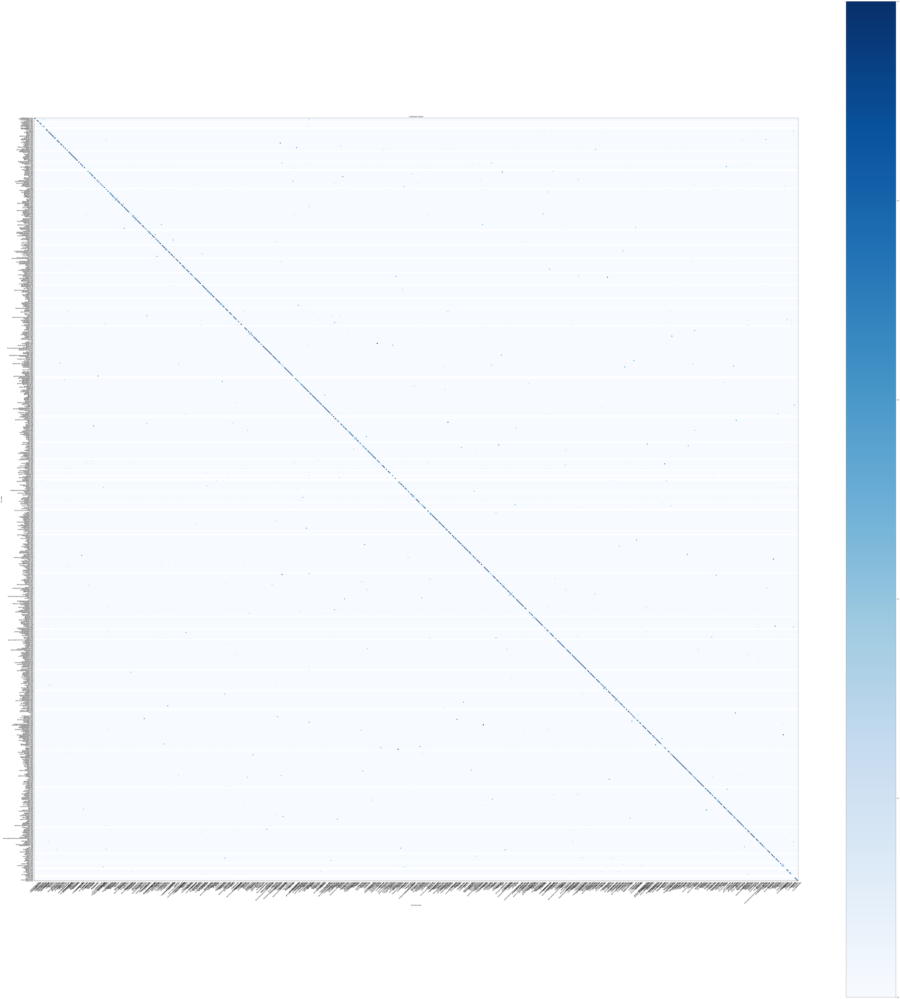

In [61]:
import itertools
print_conf_mat_info(conf_matrix_ip, output_size_ipdataset, le_labels.classes_)
print(le_labels.classes_, len(le_labels.classes_))
fig = plt.gcf()
fig.set_size_inches(100, 100)
fig.savefig("ip_new_"+add_name+str(datetime.date(datetime.now()))+".png", dpi=100)
plot_confusion_matrix(conf_matrix_ip, le_labels.classes_, "ip", True)

In [ ]:
print(conf_matrix_ip.diag())

print(labels_to_predicted_ip)

fig = plt.gcf()
fig.set_size_inches(100, 100)
fig.savefig("asn_new_"+add_name+str(datetime.date(datetime.now()))+".png", dpi=100)
plot_confusion_matrix(conf_matrix, le_labels.classes_, "asn", True)

print(labels_to_predicted_asn)

tensor([2.1000e+01, 6.0000e+00, 0.0000e+00, 3.0000e+01, 4.5000e+01, 0.0000e+00,
        4.4000e+01, 6.0000e+00, 0.0000e+00, 2.0000e+00, 4.5000e+01, 0.0000e+00,
        0.0000e+00, 3.6000e+01, 1.4000e+01, 6.0000e+00, 2.0000e+00, 4.4000e+01,
        7.2000e+01, 7.0000e+00, 4.5000e+01, 1.8000e+01, 1.8000e+01, 2.1000e+01,
        4.0000e+00, 3.6000e+01, 5.4000e+01, 2.7000e+01, 1.1000e+01, 9.9000e+01,
        2.7000e+01, 8.0000e+00, 3.2000e+01, 1.6000e+01, 6.0000e+00, 0.0000e+00,
        3.4000e+01, 0.0000e+00, 3.4000e+01, 6.3000e+01, 2.9000e+01, 8.1000e+01,
        2.7000e+01, 1.8000e+01, 3.6000e+01, 4.6000e+01, 2.7000e+01, 3.9600e+02,
        0.0000e+00, 2.4000e+01, 4.0000e+00, 2.7000e+01, 4.0000e+01, 3.7000e+01,
        9.0000e+00, 2.7000e+01, 0.0000e+00, 0.0000e+00, 0.0000e+00, 4.2000e+01,
        1.3000e+01, 9.0000e+00, 3.4000e+01, 4.5000e+01, 1.8000e+01, 1.3000e+01,
        3.6000e+01, 4.5000e+01, 0.0000e+00, 3.0000e+01, 1.6000e+01, 2.7000e+01,
        1.5000e+01, 4.5000e+01, 2.7000e+

Normalized confusion matrix
tensor([[0.3636, 0.2273, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [   nan,    nan,    nan,  ...,    nan,    nan,    nan],
        [   nan,    nan,    nan,  ...,    nan,    nan,    nan],
        ...,
        [0.0000, 0.0000, 0.0000,  ..., 1.0000, 0.0000, 0.0000],
        [0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.1053, 0.0000],
        [0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.5714]])


In [ ]:
import json

for key in labels_to_predicted_ip:
    labels_to_predicted_ip[key] = list(labels_to_predicted_ip[key])
    
for key in labels_to_predicted_asn:
    labels_to_predicted_asn[key] = list(labels_to_predicted_asn[key])
    
with open('ip_new_'+add_name+str(datetime.date(datetime.now()))+".json", 'w') as json_file:
  json.dump(labels_to_predicted_ip, json_file)

with open('asn_new_'+add_name+str(datetime.date(datetime.now()))+".json", 'w') as json_file:
  json.dump(labels_to_predicted_asn, json_file)

In [ ]:
with open('mapping_top5_ip_new_'+add_name+str(datetime.date(datetime.now()))+".txt", "w") as f:
    for i in range(len(top_elems_list_ip)):
        f.write(str(top_elems_list_ip[i])+":"+str(corresponding_target_ip[i])+"\n")

with open('mapping_top5_asn_new_'+add_name+str(datetime.date(datetime.now()))+".txt", "w") as f:
    for i in range(len(top_elems_list_asn)):
        f.write(str(top_elems_list_asn[i])+":"+str(corresponding_target_asn[i])+"\n")